# Logistic Regression with a Neural Network mindset

Welcome to your first (required) programming assignment! You will build a logistic regression classifier to recognize  cats. This assignment will step you through how to do this with a Neural Network mindset, and so will also hone your intuitions about deep learning.

**Instructions:**
- Do not use loops (for/while) in your code, unless the instructions explicitly ask you to do so.

**You will learn to:**
- Build the general architecture of a learning algorithm, including:
    - Initializing parameters
    - Calculating the cost function and its gradient
    - Using an optimization algorithm (gradient descent) 
- Gather all three functions above into a main model function, in the right order.

## <font color='darkblue'>Updates</font>
This notebook has been updated over the past few months.  The prior version was named "v5", and the current versionis now named '6a'

#### If you were working on a previous version:
* You can find your prior work by looking in the file directory for the older files (named by version name).
* To view the file directory, click on the "Coursera" icon in the top left corner of this notebook.
* Please copy your work from the older versions to the new version, in order to submit your work for grading.

#### List of Updates
* Forward propagation formula, indexing now starts at 1 instead of 0.
* Optimization function comment now says "print cost every 100 training iterations" instead of "examples".
* Fixed grammar in the comments.
* Y_prediction_test variable name is used consistently.
* Plot's axis label now says "iterations (hundred)" instead of "iterations".
* When testing the model, the test image is normalized by dividing by 255.

## 1 - Packages ##

First, let's run the cell below to import all the packages that you will need during this assignment. 
- [numpy](www.numpy.org) is the fundamental package for scientific computing with Python.
- [h5py](http://www.h5py.org) is a common package to interact with a dataset that is stored on an H5 file.
- [matplotlib](http://matplotlib.org) is a famous library to plot graphs in Python.
- [PIL](http://www.pythonware.com/products/pil/) and [scipy](https://www.scipy.org/) are used here to test your model with your own picture at the end.

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import h5py
import scipy
from PIL import Image
from scipy import ndimage
from lr_utils import load_dataset

%matplotlib inline

## 2 - Overview of the Problem set ##

**Problem Statement**: You are given a dataset ("data.h5") containing:
    - a training set of m_train images labeled as cat (y=1) or non-cat (y=0)
    - a test set of m_test images labeled as cat or non-cat
    - each image is of shape (num_px, num_px, 3) where 3 is for the 3 channels (RGB). Thus, each image is square (height = num_px) and (width = num_px).

You will build a simple image-recognition algorithm that can correctly classify pictures as cat or non-cat.

Let's get more familiar with the dataset. Load the data by running the following code.

In [7]:
# Loading the data (cat/non-cat)
train_set_x_orig, train_set_y, test_set_x_orig, test_set_y, classes = load_dataset()

We added "_orig" at the end of image datasets (train and test) because we are going to preprocess them. After preprocessing, we will end up with train_set_x and test_set_x (the labels train_set_y and test_set_y don't need any preprocessing).

Each line of your train_set_x_orig and test_set_x_orig is an array representing an image. You can visualize an example by running the following code. Feel free also to change the `index` value and re-run to see other images. 

y = [0], it's a 'non-cat' picture.


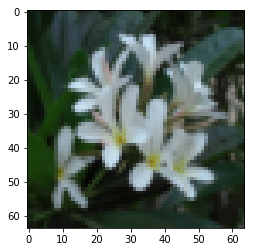

In [8]:
# Example of a picture
index = 28
plt.imshow(train_set_x_orig[index])
print ("y = " + str(train_set_y[:, index]) + ", it's a '" + classes[np.squeeze(train_set_y[:, index])].decode("utf-8") +  "' picture.")

Many software bugs in deep learning come from having matrix/vector dimensions that don't fit. If you can keep your matrix/vector dimensions straight you will go a long way toward eliminating many bugs. 

**Exercise:** Find the values for:
    - m_train (number of training examples)
    - m_test (number of test examples)
    - num_px (= height = width of a training image)
Remember that `train_set_x_orig` is a numpy-array of shape (m_train, num_px, num_px, 3). For instance, you can access `m_train` by writing `train_set_x_orig.shape[0]`.

In [9]:
### START CODE HERE ### (≈ 3 lines of code)
m_train = train_set_x_orig.shape[0]
m_test = test_set_x_orig.shape[0]
num_px = train_set_x_orig.shape[1]
### END CODE HERE ###

print ("Number of training examples: m_train = " + str(m_train))
print ("Number of testing examples: m_test = " + str(m_test))
print ("Height/Width of each image: num_px = " + str(num_px))
print ("Each image is of size: (" + str(num_px) + ", " + str(num_px) + ", 3)")
print ("train_set_x shape: " + str(train_set_x_orig.shape))
print ("train_set_y shape: " + str(train_set_y.shape))
print ("test_set_x shape: " + str(test_set_x_orig.shape))
print ("test_set_y shape: " + str(test_set_y.shape))

Number of training examples: m_train = 209
Number of testing examples: m_test = 50
Height/Width of each image: num_px = 64
Each image is of size: (64, 64, 3)
train_set_x shape: (209, 64, 64, 3)
train_set_y shape: (1, 209)
test_set_x shape: (50, 64, 64, 3)
test_set_y shape: (1, 50)


**Expected Output for m_train, m_test and num_px**: 
<table style="width:15%">
  <tr>
    <td>**m_train**</td>
    <td> 209 </td> 
  </tr>
  
  <tr>
    <td>**m_test**</td>
    <td> 50 </td> 
  </tr>
  
  <tr>
    <td>**num_px**</td>
    <td> 64 </td> 
  </tr>
  
</table>


For convenience, you should now reshape images of shape (num_px, num_px, 3) in a numpy-array of shape (num_px $*$ num_px $*$ 3, 1). After this, our training (and test) dataset is a numpy-array where each column represents a flattened image. There should be m_train (respectively m_test) columns.

**Exercise:** Reshape the training and test data sets so that images of size (num_px, num_px, 3) are flattened into single vectors of shape (num\_px $*$ num\_px $*$ 3, 1).

A trick when you want to flatten a matrix X of shape (a,b,c,d) to a matrix X_flatten of shape (b$*$c$*$d, a) is to use: 
```python
X_flatten = X.reshape(X.shape[0], -1).T      # X.T is the transpose of X
```

In [10]:
# Reshape the training and test examples

### START CODE HERE ### (≈ 2 lines of code)
train_set_x_flatten = train_set_x_orig.reshape(train_set_x_orig.shape[0],-1).T
test_set_x_flatten = test_set_x_orig.reshape(test_set_x_orig.shape[0],-1).T
### END CODE HERE ###
print ("train_set_x_flatten shape: " + str(train_set_x_flatten.shape))
print ("train_set_y shape: " + str(train_set_y.shape))
print ("test_set_x_flatten shape: " + str(test_set_x_flatten.shape))
print ("test_set_y shape: " + str(test_set_y.shape))
print ("sanity check after reshaping: " + str(train_set_x_flatten[0:5,0]))

train_set_x_flatten shape: (12288, 209)
train_set_y shape: (1, 209)
test_set_x_flatten shape: (12288, 50)
test_set_y shape: (1, 50)
sanity check after reshaping: [17 31 56 22 33]


**Expected Output**: 

<table style="width:35%">
  <tr>
    <td>**train_set_x_flatten shape**</td>
    <td> (12288, 209)</td> 
  </tr>
  <tr>
    <td>**train_set_y shape**</td>
    <td>(1, 209)</td> 
  </tr>
  <tr>
    <td>**test_set_x_flatten shape**</td>
    <td>(12288, 50)</td> 
  </tr>
  <tr>
    <td>**test_set_y shape**</td>
    <td>(1, 50)</td> 
  </tr>
  <tr>
  <td>**sanity check after reshaping**</td>
  <td>[17 31 56 22 33]</td> 
  </tr>
</table>

To represent color images, the red, green and blue channels (RGB) must be specified for each pixel, and so the pixel value is actually a vector of three numbers ranging from 0 to 255.

One common preprocessing step in machine learning is to center and standardize your dataset, meaning that you substract the mean of the whole numpy array from each example, and then divide each example by the standard deviation of the whole numpy array. But for picture datasets, it is simpler and more convenient and works almost as well to just divide every row of the dataset by 255 (the maximum value of a pixel channel).

<!-- During the training of your model, you're going to multiply weights and add biases to some initial inputs in order to observe neuron activations. Then you backpropogate with the gradients to train the model. But, it is extremely important for each feature to have a similar range such that our gradients don't explode. You will see that more in detail later in the lectures. !--> 

Let's standardize our dataset.

In [11]:
train_set_x = train_set_x_flatten/255.
test_set_x = test_set_x_flatten/255.

<font color='blue'>
**What you need to remember:**

Common steps for pre-processing a new dataset are:
- Figure out the dimensions and shapes of the problem (m_train, m_test, num_px, ...)
- Reshape the datasets such that each example is now a vector of size (num_px \* num_px \* 3, 1)
- "Standardize" the data

## 3 - General Architecture of the learning algorithm ##

It's time to design a simple algorithm to distinguish cat images from non-cat images.

You will build a Logistic Regression, using a Neural Network mindset. The following Figure explains why **Logistic Regression is actually a very simple Neural Network!**

<img src="images/LogReg_kiank.png" style="width:650px;height:400px;">

**Mathematical expression of the algorithm**:

For one example $x^{(i)}$:
$$z^{(i)} = w^T x^{(i)} + b \tag{1}$$
$$\hat{y}^{(i)} = a^{(i)} = sigmoid(z^{(i)})\tag{2}$$ 
$$ \mathcal{L}(a^{(i)}, y^{(i)}) =  - y^{(i)}  \log(a^{(i)}) - (1-y^{(i)} )  \log(1-a^{(i)})\tag{3}$$

The cost is then computed by summing over all training examples:
$$ J = \frac{1}{m} \sum_{i=1}^m \mathcal{L}(a^{(i)}, y^{(i)})\tag{6}$$

**Key steps**:
In this exercise, you will carry out the following steps: 
    - Initialize the parameters of the model
    - Learn the parameters for the model by minimizing the cost  
    - Use the learned parameters to make predictions (on the test set)
    - Analyse the results and conclude

## 4 - Building the parts of our algorithm ## 

The main steps for building a Neural Network are:
1. Define the model structure (such as number of input features) 
2. Initialize the model's parameters
3. Loop:
    - Calculate current loss (forward propagation)
    - Calculate current gradient (backward propagation)
    - Update parameters (gradient descent)

You often build 1-3 separately and integrate them into one function we call `model()`.

### 4.1 - Helper functions

**Exercise**: Using your code from "Python Basics", implement `sigmoid()`. As you've seen in the figure above, you need to compute $sigmoid( w^T x + b) = \frac{1}{1 + e^{-(w^T x + b)}}$ to make predictions. Use np.exp().

In [12]:
# GRADED FUNCTION: sigmoid

def sigmoid(z):
    """
    Compute the sigmoid of z

    Arguments:
    z -- A scalar or numpy array of any size.

    Return:
    s -- sigmoid(z)
    """

    ### START CODE HERE ### (≈ 1 line of code)
    s = 1/(1+np.exp(-z))
    ### END CODE HERE ###
    
    return s

In [13]:
print ("sigmoid([0, 2]) = " + str(sigmoid(np.array([0,2]))))

sigmoid([0, 2]) = [ 0.5         0.88079708]


**Expected Output**: 

<table>
  <tr>
    <td>**sigmoid([0, 2])**</td>
    <td> [ 0.5         0.88079708]</td> 
  </tr>
</table>

### 4.2 - Initializing parameters

**Exercise:** Implement parameter initialization in the cell below. You have to initialize w as a vector of zeros. If you don't know what numpy function to use, look up np.zeros() in the Numpy library's documentation.

In [14]:
# GRADED FUNCTION: initialize_with_zeros

def initialize_with_zeros(dim):
    """
    This function creates a vector of zeros of shape (dim, 1) for w and initializes b to 0.
    
    Argument:
    dim -- size of the w vector we want (or number of parameters in this case)
    
    Returns:
    w -- initialized vector of shape (dim, 1)
    b -- initialized scalar (corresponds to the bias)
    """
    
    ### START CODE HERE ### (≈ 1 line of code)
    w = np.zeros((dim,1))
    b = 0
    ### END CODE HERE ###

    assert(w.shape == (dim, 1))
    assert(isinstance(b, float) or isinstance(b, int))
    
    return w, b

In [15]:
dim = 2
w, b = initialize_with_zeros(dim)
print ("w = " + str(w))
print ("b = " + str(b))

w = [[ 0.]
 [ 0.]]
b = 0


**Expected Output**: 


<table style="width:15%">
    <tr>
        <td>  ** w **  </td>
        <td> [[ 0.]
 [ 0.]] </td>
    </tr>
    <tr>
        <td>  ** b **  </td>
        <td> 0 </td>
    </tr>
</table>

For image inputs, w will be of shape (num_px $\times$ num_px $\times$ 3, 1).

### 4.3 - Forward and Backward propagation

Now that your parameters are initialized, you can do the "forward" and "backward" propagation steps for learning the parameters.

**Exercise:** Implement a function `propagate()` that computes the cost function and its gradient.

**Hints**:

Forward Propagation:
- You get X
- You compute $A = \sigma(w^T X + b) = (a^{(1)}, a^{(2)}, ..., a^{(m-1)}, a^{(m)})$
- You calculate the cost function: $J = -\frac{1}{m}\sum_{i=1}^{m}y^{(i)}\log(a^{(i)})+(1-y^{(i)})\log(1-a^{(i)})$

Here are the two formulas you will be using: 

$$ \frac{\partial J}{\partial w} = \frac{1}{m}X(A-Y)^T\tag{7}$$
$$ \frac{\partial J}{\partial b} = \frac{1}{m} \sum_{i=1}^m (a^{(i)}-y^{(i)})\tag{8}$$

In [16]:
# GRADED FUNCTION: propagate

def propagate(w, b, X, Y):
    """
    Implement the cost function and its gradient for the propagation explained above

    Arguments:
    w -- weights, a numpy array of size (num_px * num_px * 3, 1)
    b -- bias, a scalar
    X -- data of size (num_px * num_px * 3, number of examples)
    Y -- true "label" vector (containing 0 if non-cat, 1 if cat) of size (1, number of examples)

    Return:
    cost -- negative log-likelihood cost for logistic regression
    dw -- gradient of the loss with respect to w, thus same shape as w
    db -- gradient of the loss with respect to b, thus same shape as b
    
    Tips:
    - Write your code step by step for the propagation. np.log(), np.dot()
    """
    
    m = X.shape[1]
    
    # FORWARD PROPAGATION (FROM X TO COST)
    ### START CODE HERE ### (≈ 2 lines of code)
    A = sigmoid(w.T@(X)+b)                                  # compute activation
    cost = -1/m *np.sum((Y*np.log(A)+(1-Y)*np.log(1-A)))                          # compute cost
    ### END CODE HERE ###
    print(A)
    print(cost)
    # BACKWARD PROPAGATION (TO FIND GRAD)
    ### START CODE HERE ### (≈ 2 lines of code)
    dw = 1/m * X @ (A - Y).T
    db = (np.sum(A-Y))/m
    ### END CODE HERE ###
    print(dw.shape)
    print(db)
    assert(dw.shape == w.shape)
    assert(db.dtype == float)
    cost = np.squeeze(cost)
    assert(cost.shape == ())
    
    grads = {"dw": dw,
             "db": db}
    
    return grads, cost

In [17]:
w, b, X, Y = np.array([[1.],[2.]]), 2., np.array([[1.,2.,-1.],[3.,4.,-3.2]]), np.array([[1,0,1]])
grads, cost = propagate(w, b, X, Y)
print ("dw = " + str(grads["dw"]))
print ("db = " + str(grads["db"]))
print ("cost = " + str(cost))

[[ 0.99987661  0.99999386  0.00449627]]
5.80154531939
(2, 1)
0.00145557813678
dw = [[ 0.99845601]
 [ 2.39507239]]
db = 0.00145557813678
cost = 5.80154531939


**Expected Output**:

<table style="width:50%">
    <tr>
        <td>  ** dw **  </td>
      <td> [[ 0.99845601]
     [ 2.39507239]]</td>
    </tr>
    <tr>
        <td>  ** db **  </td>
        <td> 0.00145557813678 </td>
    </tr>
    <tr>
        <td>  ** cost **  </td>
        <td> 5.801545319394553 </td>
    </tr>

</table>

### 4.4 - Optimization
- You have initialized your parameters.
- You are also able to compute a cost function and its gradient.
- Now, you want to update the parameters using gradient descent.

**Exercise:** Write down the optimization function. The goal is to learn $w$ and $b$ by minimizing the cost function $J$. For a parameter $\theta$, the update rule is $ \theta = \theta - \alpha \text{ } d\theta$, where $\alpha$ is the learning rate.

In [18]:
# GRADED FUNCTION: optimize

def optimize(w, b, X, Y, num_iterations, learning_rate, print_cost = False):
    """
    This function optimizes w and b by running a gradient descent algorithm
    
    Arguments:
    w -- weights, a numpy array of size (num_px * num_px * 3, 1)
    b -- bias, a scalar
    X -- data of shape (num_px * num_px * 3, number of examples)
    Y -- true "label" vector (containing 0 if non-cat, 1 if cat), of shape (1, number of examples)
    num_iterations -- number of iterations of the optimization loop
    learning_rate -- learning rate of the gradient descent update rule
    print_cost -- True to print the loss every 100 steps
    
    Returns:
    params -- dictionary containing the weights w and bias b
    grads -- dictionary containing the gradients of the weights and bias with respect to the cost function
    costs -- list of all the costs computed during the optimization, this will be used to plot the learning curve.
    
    Tips:
    You basically need to write down two steps and iterate through them:
        1) Calculate the cost and the gradient for the current parameters. Use propagate().
        2) Update the parameters using gradient descent rule for w and b.
    """
    
    costs = []
    
    for i in range(num_iterations):
        
        
        # Cost and gradient calculation (≈ 1-4 lines of code)
        ### START CODE HERE ### 
        grads, cost = propagate(w, b, X, Y)
        ### END CODE HERE ###
        
        # Retrieve derivatives from grads
        dw = grads["dw"]
        db = grads["db"]
        
        # update rule (≈ 2 lines of code)
        ### START CODE HERE ###
        w = w-learning_rate*dw
        b = b-learning_rate*db
        ### END CODE HERE ###
        
        # Record the costs
        if i % 100 == 0:
            costs.append(cost)
        
        # Print the cost every 100 training iterations
        if print_cost and i % 100 == 0:
            print ("Cost after iteration %i: %f" %(i, cost))
    
    params = {"w": w,
              "b": b}
    
    grads = {"dw": dw,
             "db": db}
    
    return params, grads, costs

In [19]:
params, grads, costs = optimize(w, b, X, Y, num_iterations= 100, learning_rate = 0.009, print_cost = False)

print ("w = " + str(params["w"]))
print ("b = " + str(params["b"]))
print ("dw = " + str(grads["dw"]))
print ("db = " + str(grads["db"]))

[[ 0.99987661  0.99999386  0.00449627]]
5.80154531939
(2, 1)
0.00145557813678
[[ 0.99986717  0.99999318  0.00485901]]
5.74095050281
(2, 1)
0.00157312278839
[[ 0.99985702  0.99999243  0.00525079]]
5.6803754269
(2, 1)
0.00170008264684
[[ 0.9998461  0.9999916  0.0056739]]
5.61982166718
(2, 1)
0.0018371991376
[[ 0.99983434  0.99999068  0.00613079]]
5.55929092263
(2, 1)
0.00198526996242
[[ 0.99982169  0.99998966  0.00662412]]
5.49878502486
(2, 1)
0.00214515301968
[[ 0.99980807  0.99998852  0.00715672]]
5.43830594807
(2, 1)
0.00231777053822
[[ 0.99979342  0.99998726  0.00773166]]
5.37785581961
(2, 1)
0.00250411342605
[[ 0.99977765  0.99998587  0.00835222]]
5.31743693119
(2, 1)
0.00270524583259
[[ 0.99976068  0.99998432  0.00902193]]
5.25705175093
(2, 1)
0.00292230992026
[[ 0.99974243  0.9999826   0.00974457]]
5.19670293604
(2, 1)
0.00315653083819
[[ 0.99972278  0.99998069  0.01052419]]
5.13639334635
(2, 1)
0.00340922188635
[[ 0.99970165  0.99997857  0.01136515]]
5.07612605863
(2, 1)
0.003681

**Expected Output**: 

<table style="width:40%">
    <tr>
       <td> **w** </td>
       <td>[[ 0.19033591]
 [ 0.12259159]] </td>
    </tr>
    
    <tr>
       <td> **b** </td>
       <td> 1.92535983008 </td>
    </tr>
    <tr>
       <td> **dw** </td>
       <td> [[ 0.67752042]
 [ 1.41625495]] </td>
    </tr>
    <tr>
       <td> **db** </td>
       <td> 0.219194504541 </td>
    </tr>

</table>

**Exercise:** The previous function will output the learned w and b. We are able to use w and b to predict the labels for a dataset X. Implement the `predict()` function. There are two steps to computing predictions:

1. Calculate $\hat{Y} = A = \sigma(w^T X + b)$

2. Convert the entries of a into 0 (if activation <= 0.5) or 1 (if activation > 0.5), stores the predictions in a vector `Y_prediction`. If you wish, you can use an `if`/`else` statement in a `for` loop (though there is also a way to vectorize this). 

In [20]:
# GRADED FUNCTION: predict

def predict(w, b, X):
    '''
    Predict whether the label is 0 or 1 using learned logistic regression parameters (w, b)
    
    Arguments:
    w -- weights, a numpy array of size (num_px * num_px * 3, 1)
    b -- bias, a scalar
    X -- data of size (num_px * num_px * 3, number of examples)
    
    Returns:
    Y_prediction -- a numpy array (vector) containing all predictions (0/1) for the examples in X
    '''
    
    m = X.shape[1]
    Y_prediction = np.zeros((1,m))
    w = w.reshape(X.shape[0], 1)
    
    # Compute vector "A" predicting the probabilities of a cat being present in the picture
    ### START CODE HERE ### (≈ 1 line of code)
    A = sigmoid(w.T @ X +b)
    ### END CODE HERE ###
    for i in range(A.shape[0]):
        
        # Convert probabilities A[0,i] to actual predictions p[0,i]
        ### START CODE HERE ### (≈ 4 lines of code)
        for j in range(A.shape[1]):
            if(A[i][j]<=0.5):
                Y_prediction[i][j]=0
            else:
                Y_prediction[i][j]=1
            
        ### END CODE HERE ###
    assert(Y_prediction.shape == (1, m))
    
    return Y_prediction

In [21]:
w = np.array([[0.1124579],[0.23106775]])
b = -0.3
X = np.array([[1.,-1.1,-3.2],[1.2,2.,0.1]])
print ("predictions = " + str(predict(w, b, X)))

predictions = [[ 1.  1.  0.]]


**Expected Output**: 

<table style="width:30%">
    <tr>
         <td>
             **predictions**
         </td>
          <td>
            [[ 1.  1.  0.]]
         </td>  
   </tr>

</table>


<font color='blue'>
**What to remember:**
You've implemented several functions that:
- Initialize (w,b)
- Optimize the loss iteratively to learn parameters (w,b):
    - computing the cost and its gradient 
    - updating the parameters using gradient descent
- Use the learned (w,b) to predict the labels for a given set of examples

## 5 - Merge all functions into a model ##

You will now see how the overall model is structured by putting together all the building blocks (functions implemented in the previous parts) together, in the right order.

**Exercise:** Implement the model function. Use the following notation:
    - Y_prediction_test for your predictions on the test set
    - Y_prediction_train for your predictions on the train set
    - w, costs, grads for the outputs of optimize()

In [24]:
# GRADED FUNCTION: model

def model(X_train, Y_train, X_test, Y_test, num_iterations = 2000, learning_rate = 0.5, print_cost = False):
    """
    Builds the logistic regression model by calling the function you've implemented previously
    
    Arguments:
    X_train -- training set represented by a numpy array of shape (num_px * num_px * 3, m_train)
    Y_train -- training labels represented by a numpy array (vector) of shape (1, m_train)
    X_test -- test set represented by a numpy array of shape (num_px * num_px * 3, m_test)
    Y_test -- test labels represented by a numpy array (vector) of shape (1, m_test)
    num_iterations -- hyperparameter representing the number of iterations to optimize the parameters
    learning_rate -- hyperparameter representing the learning rate used in the update rule of optimize()
    print_cost -- Set to true to print the cost every 100 iterations
    
    Returns:
    d -- dictionary containing information about the model.
    """
    
    ### START CODE HERE ###
    
    # initialize parameters with zeros (≈ 1 line of code)
    w, b = np.zeros((X_train.shape[0],1)),0

    # Gradient descent (≈ 1 line of code)
    parameters, grads, costs = optimize(w, b, X_train, Y_train, num_iterations, learning_rate, print_cost = False)
    
    # Retrieve parameters w and b from dictionary "parameters"
    w = parameters["w"]
    b = parameters["b"]
    
    # Predict test/train set examples (≈ 2 lines of code)
    Y_prediction_test = predict(w,b,X_test)
    Y_prediction_train = predict(w,b,X_train)

    ### END CODE HERE ###

    # Print train/test Errors
    print("train accuracy: {} %".format(100 - np.mean(np.abs(Y_prediction_train - Y_train)) * 100))
    print("test accuracy: {} %".format(100 - np.mean(np.abs(Y_prediction_test - Y_test)) * 100))

    
    d = {"costs": costs,
         "Y_prediction_test": Y_prediction_test, 
         "Y_prediction_train" : Y_prediction_train, 
         "w" : w, 
         "b" : b,
         "learning_rate" : learning_rate,
         "num_iterations": num_iterations}
    
    return d

Run the following cell to train your model.

In [25]:
d = model(train_set_x, train_set_y, test_set_x, test_set_y, num_iterations = 2000, learning_rate = 0.005, print_cost = True)

[[ 0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0

[[ 0.57652568  0.61392146  0.6588243   0.49555502  0.53729787  0.5541146
   0.54470278  0.58367141  0.59456033  0.57521474  0.65279993  0.60596237
   0.58963787  0.6342729   0.61479617  0.66387685  0.62290615  0.63565372
   0.62493446  0.57532261  0.59813168  0.54286005  0.67349441  0.67435801
   0.64452235  0.54091049  0.5782681   0.61242678  0.55229481  0.57034336
   0.52542409  0.66817592  0.6377985   0.64372135  0.53614904  0.59833375
   0.57915793  0.66916414  0.52852214  0.61638847  0.5731261   0.50988269
   0.6326743   0.62467728  0.58379751  0.56348345  0.61589062  0.60724462
   0.50747355  0.60231683  0.6729743   0.62696882  0.61216346  0.67872589
   0.58154488  0.64027333  0.6177354   0.70134117  0.53679052  0.59088781
   0.61032707  0.60189217  0.61103299  0.57667194  0.6917043   0.5696443
   0.67746165  0.59275667  0.6355449   0.62903691  0.63643274  0.6092042
   0.5304389   0.60963619  0.62682391  0.64137665  0.53725191  0.57104383
   0.55128319  0.52072065  0.54986611  0.

[[ 0.19285406  0.08087328  0.06631323  0.13565189  0.16252475  0.20768551
   0.16821374  0.16117513  0.10292354  0.12738858  0.05927817  0.08609849
   0.14664338  0.04471606  0.05986532  0.04208143  0.04444506  0.02267495
   0.06873128  0.25677084  0.06925115  0.14970205  0.02684875  0.0406099
   0.06509943  0.29116131  0.08692294  0.08798602  0.13314419  0.09574897
   0.20422643  0.07900483  0.10163957  0.07691046  0.11306235  0.18431636
   0.10181913  0.03397533  0.39172802  0.12859002  0.08918907  0.23580895
   0.08559644  0.05673774  0.07993443  0.19549462  0.08785498  0.15801087
   0.10058314  0.11588756  0.04043371  0.08274434  0.06790055  0.042457
   0.14960323  0.03720633  0.14328262  0.02979201  0.25043478  0.19704665
   0.1967177   0.10525241  0.05295845  0.11353364  0.03091025  0.1702197
   0.06776701  0.09684615  0.07296188  0.05493679  0.07959697  0.169203
   0.21089111  0.16908192  0.09842524  0.06727008  0.09883024  0.11978316
   0.1191382   0.26784296  0.0684419   0.069

(12288, 1)
-0.2354040667
[[ 0.58723912  0.59880646  0.6945201   0.36081974  0.4801731   0.53974235
   0.49289843  0.60087414  0.57294422  0.54680674  0.67526496  0.59612686
   0.59489839  0.62665456  0.58508907  0.66838585  0.57619835  0.5642866
   0.61772547  0.61507004  0.55328463  0.4820251   0.67238655  0.69336351
   0.66679012  0.54179041  0.52321257  0.61122589  0.50094861  0.51326438
   0.47121756  0.71532914  0.67533236  0.66769523  0.45025464  0.6279266
   0.53751656  0.67296289  0.53885572  0.64420022  0.50719975  0.44740166
   0.65286284  0.60122254  0.52716338  0.55444041  0.6136133   0.63545944
   0.37202903  0.60454613  0.69369404  0.63650253  0.59033204  0.71292087
   0.57872179  0.6019016   0.66101806  0.73884607  0.50990061  0.62707988
   0.6619034   0.6007583   0.56201283  0.54379838  0.71186591  0.55901515
   0.72070991  0.5698622   0.6451465   0.60990232  0.65040962  0.6570645
   0.48224463  0.65143414  0.64601729  0.65760378  0.43007341  0.54118422
   0.48078265  0

(12288, 1)
-0.23454249024
[[ 0.59354423  0.59012117  0.71146226  0.30151817  0.45615595  0.53522447
   0.46801435  0.61663348  0.56227532  0.53449488  0.68810556  0.59571168
   0.59927691  0.63104956  0.57238864  0.66796373  0.55546115  0.53264643
   0.61398484  0.63778396  0.53167506  0.45416104  0.67416459  0.70115386
   0.6799154   0.5458339   0.49817208  0.61242804  0.48066829  0.49000073
   0.44902364  0.73116595  0.69501269  0.67779091  0.41474858  0.64050103
   0.51654595  0.67439398  0.54501492  0.65714167  0.47551425  0.42074436
   0.66509389  0.58968606  0.49992399  0.55243116  0.61293809  0.64750739
   0.31534118  0.60653169  0.70382801  0.64218934  0.58245087  0.73005838
   0.58172833  0.58190576  0.68397881  0.75553392  0.49671576  0.64843527
   0.68470699  0.60450754  0.53824833  0.53039914  0.7186783   0.55522015
   0.73392759  0.56137269  0.64967565  0.60033325  0.65518019  0.68313029
   0.46137541  0.67072247  0.65329491  0.66730641  0.37901281  0.53152141
   0.4479523

[[ 0.20842962  0.07724434  0.08514064  0.07300693  0.13354439  0.20372586
   0.13743861  0.19123668  0.0961518   0.11694417  0.07233597  0.08924159
   0.15726037  0.04949871  0.05509551  0.0444152   0.0378221   0.01735059
   0.06923021  0.31394925  0.05821142  0.11851175  0.02931549  0.04738745
   0.07923174  0.30369141  0.07058734  0.09274706  0.11320898  0.07913348
   0.1712168   0.10043184  0.13118826  0.09006145  0.08216823  0.21215825
   0.086049    0.03678331  0.40981757  0.15149513  0.06782778  0.19035197
   0.10190816  0.05286039  0.06353851  0.19619188  0.09087283  0.1826243
   0.05573336  0.12228099  0.04854833  0.09172829  0.06552512  0.05595616
   0.15812054  0.03189398  0.18645183  0.04003859  0.22834497  0.24427813
   0.24987579  0.11325477  0.04363916  0.10322434  0.03602385  0.16856466
   0.0841559   0.09246511  0.08023226  0.05223197  0.08761486  0.22382014
   0.17931512  0.20929437  0.11051211  0.07856566  0.06061451  0.11271348
   0.08955318  0.23322922  0.04459484  

[[ 0.60113061  0.57350783  0.73179598  0.22822079  0.42592543  0.53014673
   0.43256963  0.64459495  0.54468617  0.51683574  0.70539683  0.59794284
   0.60511697  0.64344015  0.55408035  0.66070545  0.52716667  0.49023939
   0.60524668  0.67096439  0.49899145  0.41609676  0.67561149  0.70699102
   0.69755074  0.55477531  0.46351437  0.61339957  0.45640339  0.46219608
   0.42183609  0.74272276  0.72165965  0.68708491  0.37141032  0.65343187
   0.4836048   0.67199064  0.55447599  0.67190134  0.43073393  0.38713493
   0.68261578  0.57043581  0.46057521  0.55107064  0.60970418  0.66024207
   0.24773105  0.60754586  0.7149315   0.6487977   0.57185541  0.75129692
   0.58961175  0.54960819  0.71549675  0.77400509  0.47696855  0.6803438
   0.71180232  0.61232589  0.50284629  0.51254422  0.72172183  0.54921647
   0.74165098  0.55022856  0.65303062  0.58315994  0.65639584  0.71986226
   0.43467831  0.69370559  0.65795224  0.68009382  0.30979845  0.52095185
   0.40293597  0.43537916  0.34155197  

(12288, 1)
-0.229084905456
[[ 0.60412403  0.56282778  0.74074     0.1956763   0.41209358  0.52797427
   0.41430017  0.66121748  0.53435923  0.50745177  0.71395772  0.60047973
   0.60780404  0.65261246  0.54457953  0.653722    0.51341568  0.46985622
   0.59901033  0.68818917  0.48110146  0.39715679  0.67580649  0.70757658
   0.70611391  0.56086482  0.44612346  0.61356625  0.44592244  0.4506674
   0.40962851  0.74378745  0.73479158  0.68957066  0.35213727  0.65762144
   0.46490936  0.66853915  0.55974245  0.67782468  0.40798559  0.37160864
   0.69182506  0.55914313  0.44015219  0.5510797   0.60690067  0.66486517
   0.21857098  0.60701263  0.71930521  0.65161401  0.5665842   0.76093824
   0.59548697  0.53122313  0.73118064  0.78144009  0.46621235  0.69739479
   0.72346521  0.61739431  0.48397099  0.50373251  0.72046157  0.54557336
   0.74090769  0.54480649  0.65337694  0.57241503  0.65432792  0.73848367
   0.4223682   0.70340859  0.65758972  0.68628992  0.27620516  0.51650811
   0.380593 

[[ 0.60554608  0.55555162  0.74572362  0.17754879  0.40422582  0.52672924
   0.40316936  0.67195884  0.52758443  0.50155279  0.71906234  0.60251365
   0.60927757  0.65911153  0.53878265  0.64828902  0.50534966  0.45795294
   0.59457298  0.69864121  0.46979821  0.38582264  0.67569956  0.70707981
   0.71113579  0.56506889  0.43567819  0.61357196  0.44017455  0.44467982
   0.40271416  0.7427737   0.74255643  0.69030801  0.3413204   0.65925897
   0.45286446  0.66561759  0.56309982  0.68086301  0.39426396  0.36268718
   0.69750706  0.55177375  0.42769384  0.55131425  0.60476927  0.66705422
   0.20254242  0.60624665  0.72155635  0.65315117  0.56339225  0.76639939
   0.59970537  0.51941707  0.74053702  0.78535232  0.45942299  0.7079487
   0.72984548  0.62077364  0.47228145  0.49842734  0.71878626  0.54307497
   0.73891564  0.54156215  0.65312263  0.56513837  0.65209666  0.74968084
   0.41536944  0.70856806  0.65638664  0.68994244  0.25654386  0.51396952
   0.36727386  0.4151103   0.30493428  

[[ 0.22507386  0.07397875  0.1078773   0.04239985  0.1201061   0.20779833
   0.11707135  0.24420935  0.09181181  0.11211349  0.09121649  0.10067695
   0.17220703  0.06333812  0.0543578   0.04538397  0.03583816  0.0154733
   0.07047192  0.38341892  0.0513167   0.0999943   0.03388198  0.05397496
   0.09907477  0.32953895  0.06210609  0.10138038  0.10695492  0.07494834
   0.15586384  0.11136436  0.1707704   0.10212777  0.06870574  0.23281897
   0.07406244  0.03985134  0.43170285  0.17424934  0.05541683  0.16530528
   0.12614353  0.05097787  0.05393113  0.20552776  0.0955638   0.20393288
   0.0361699   0.13041904  0.05876898  0.10409861  0.06773261  0.07419738
   0.17969244  0.02856755  0.24260092  0.05259516  0.21125109  0.30886545
   0.29927489  0.1302227   0.03842094  0.10014938  0.04043357  0.17057402
   0.09163791  0.0940167   0.0886414   0.05066972  0.09315445  0.29662263
   0.16341987  0.24730983  0.11893252  0.09461027  0.03945834  0.11472454
   0.0724578   0.21056278  0.03517874  

(12288, 1)
0.233743134865
[[ 0.22913075  0.07318989  0.11457817  0.0372287   0.118286    0.20964852
   0.11299223  0.26157794  0.09094728  0.11137666  0.09726139  0.10506129
   0.17656606  0.0687452   0.05472888  0.04545063  0.03589656  0.01534017
   0.07088712  0.4026317   0.04995409  0.0965134   0.0354209   0.05563603
   0.10524829  0.33806527  0.06074773  0.10431734  0.10681919  0.07546511
   0.15362883  0.11242219  0.18267815  0.10510925  0.0667702   0.23663394
   0.07132075  0.04066903  0.43795607  0.18007692  0.05314102  0.16089397
   0.13397647  0.05076277  0.05220717  0.20913418  0.09700389  0.20907056
   0.03306904  0.132587    0.0619      0.10797203  0.06889574  0.07987227
   0.18751254  0.02794928  0.25931844  0.056377    0.20736238  0.32839405
   0.31129952  0.13594987  0.03754951  0.1001133   0.04158251  0.17130035
   0.0924096   0.09513548  0.09107439  0.05036426  0.09417755  0.31835184
   0.16119542  0.25632038  0.12050042  0.09968622  0.03558923  0.1160016
   0.06930542

(12288, 1)
-0.219697512224
[[ 0.6073766   0.52608943  0.76023677  0.12507631  0.38051102  0.52234911
   0.36542403  0.71085105  0.50140093  0.47978173  0.73560667  0.61231016
   0.61288631  0.68605458  0.51920408  0.6223377   0.47959253  0.42025037
   0.5754945   0.73329025  0.42880533  0.34839762  0.6735895   0.69998499
   0.7269109   0.58204557  0.40097533  0.61330638  0.42393233  0.43086828
   0.38161213  0.72927232  0.76703556  0.68828835  0.30913303  0.65880591
   0.40792305  0.65037462  0.57541635  0.68784703  0.34849255  0.33507639
   0.71706617  0.52376667  0.38555565  0.55321258  0.59474498  0.67108026
   0.15686153  0.60040383  0.72701535  0.65741684  0.5522787   0.78260537
   0.61770267  0.47558557  0.77103557  0.79552528  0.43476763  0.74435995
   0.7476394   0.63331472  0.43166404  0.48023109  0.7080788   0.53229478
   0.72335742  0.5304646   0.6495289   0.53557642  0.6383636   0.78651497
   0.39455772  0.72148021  0.64628345  0.70160567  0.19493896  0.504975
   0.32374932

[[ 0.60701836  0.51877321  0.76288708  0.11557234  0.37600624  0.52124983
   0.35738186  0.71942273  0.49508373  0.47462762  0.73892449  0.61499439
   0.61327537  0.69270625  0.5150775   0.61511246  0.47433341  0.41265071
   0.57053878  0.74040976  0.41946499  0.34059817  0.6726703   0.69723766
   0.72998879  0.58618036  0.39368856  0.61326249  0.42103715  0.42933963
   0.37746074  0.72420223  0.77174573  0.68691964  0.3030297   0.657312
   0.39747905  0.64590036  0.57823763  0.68864583  0.33886306  0.32965162
   0.72124494  0.51714166  0.37663356  0.55377786  0.59195477  0.67129372
   0.14866666  0.59834159  0.72776215  0.65813723  0.54975949  0.78557895
   0.62226459  0.46538765  0.77726237  0.79713239  0.42913121  0.75217253
   0.75070543  0.6360682   0.42282568  0.47618881  0.70479472  0.5293841
   0.7182316   0.52798357  0.64818683  0.52814367  0.63404973  0.79407687
   0.39071885  0.72323418  0.64282804  0.70392445  0.18290034  0.50269409
   0.31479769  0.38466155  0.2614055   0.

   0.71684758  0.41746748  0.60739037  0.36397857  0.53391089]]
0.636854049384
(12288, 1)
0.226027272325
[[ 0.23706221  0.07168874  0.13024301  0.0286505   0.11619508  0.21420664
   0.10569936  0.30281924  0.08944174  0.11023704  0.11188579  0.11658018
   0.1863085   0.08340451  0.05633533  0.04543876  0.03668991  0.01544037
   0.07197633  0.44395031  0.04752717  0.09051119  0.03922533  0.0591191
   0.11996579  0.35826076  0.05877877  0.11182164  0.1081252   0.07868726
   0.15050932  0.11270818  0.20973556  0.11144393  0.06408561  0.24237452
   0.06595642  0.0424711   0.4519272   0.19248119  0.04926329  0.15360301
   0.15297175  0.05070453  0.04942786  0.21818342  0.1003892   0.21989931
   0.02812173  0.13708967  0.06946572  0.11732669  0.07212116  0.09346001
   0.20730663  0.02691701  0.29763715  0.06544758  0.19974472  0.37322135
   0.33594721  0.14975666  0.03627767  0.10081721  0.04424242  0.1728611
   0.09310591  0.09835967  0.09675068  0.049841    0.09588573  0.36780534
   0.1586

[[ 0.23898001  0.07134918  0.13476494  0.02682195  0.11600263  0.2155068
   0.10406162  0.31457694  0.08912412  0.11000826  0.11618018  0.12017003
   0.18897957  0.08810642  0.0569615   0.04541731  0.03704175  0.01554747
   0.07232801  0.45485188  0.04698501  0.08920871  0.04036218  0.06003669
   0.12425631  0.36401738  0.05844944  0.11414928  0.10879423  0.0800355
   0.14998762  0.11242833  0.21718984  0.11315756  0.06364517  0.24334671
   0.06464725  0.04297169  0.45576013  0.19579728  0.04842647  0.15208461
   0.15855347  0.05078713  0.0488828   0.22086009  0.10136575  0.22282144
   0.02710981  0.13824193  0.07171618  0.12008909  0.07314556  0.09743597
   0.21327118  0.02670382  0.30837256  0.06813674  0.19787473  0.38573849
   0.34231342  0.15375441  0.03606944  0.10115917  0.04502663  0.17325922
   0.09316671  0.09939687  0.09839476  0.04973503  0.09625345  0.38151495
   0.15846475  0.27827367  0.12381533  0.11555318  0.02743966  0.12000008
   0.06277808  0.19625382  0.03227748  0

(12288, 1)
-0.210369068335
[[ 0.60373905  0.49370462  0.77014487  0.08963412  0.36314537  0.51700243
   0.33259693  0.74577973  0.47367924  0.4570282   0.74841118  0.62458516
   0.61325898  0.7148917   0.50256304  0.58844041  0.45814318  0.3897238
   0.55301616  0.76144842  0.38910831  0.31686817  0.66830227  0.68539962
   0.73872824  0.59993001  0.37131557  0.61343591  0.41302409  0.42808913
   0.3650224   0.70302403  0.7846037   0.68048119  0.28543494  0.64886085
   0.36332198  0.62881132  0.58737218  0.68946931  0.30929602  0.31375067
   0.73391966  0.49507257  0.34935695  0.55559239  0.58153494  0.67067649
   0.12630498  0.58955124  0.72915314  0.65988972  0.54129803  0.79354959
   0.63778572  0.43167421  0.7957454   0.8009676   0.4107385   0.77611317
   0.75866347  0.64421943  0.39519086  0.46291572  0.69240404  0.51853527
   0.69821855  0.51971762  0.64264291  0.5022032   0.6171183   0.8165499
   0.38020641  0.7261052   0.62896298  0.71056703  0.14837636  0.49384673
   0.28790893

[[ 0.60151469  0.48329216  0.77251414  0.08114152  0.35865585  0.5149297
   0.32331383  0.75544188  0.46483668  0.44960534  0.75157009  0.62866766
   0.61266611  0.72373321  0.49798345  0.57656343  0.45190492  0.38117343
   0.54550083  0.76889343  0.3770703   0.3080811   0.66590445  0.67944513
   0.74167343  0.60541712  0.36291816  0.61370588  0.41026106  0.42903883
   0.36039315  0.69273037  0.78860351  0.67715803  0.27919771  0.64396392
   0.34978124  0.62095187  0.59095538  0.68909984  0.29820929  0.30806846
   0.738508    0.48610516  0.33924854  0.55619695  0.57680416  0.67000389
   0.11894715  0.58511953  0.72930826  0.66033194  0.53774139  0.79601186
   0.6440948   0.41804958  0.80235624  0.801984    0.4034089   0.78494772
   0.76108842  0.64698443  0.38468362  0.45749298  0.68684943  0.51359501
   0.68902509  0.51627062  0.63997404  0.49116651  0.60919623  0.82458572
   0.37676839  0.72608468  0.62242518  0.71280215  0.13648269  0.48953412
   0.27811188  0.36244073  0.23748001  

[[ 0.24540177  0.07039339  0.15326278  0.02125522  0.11642744  0.22049153
   0.09895822  0.36055407  0.08828549  0.1093398   0.13377656  0.13572572
   0.1992082   0.10914869  0.06012658  0.04535913  0.03882852  0.01622367
   0.07395885  0.494674    0.04531521  0.08529744  0.04512114  0.06348138
   0.14186424  0.38663702  0.05786865  0.12437276  0.11230454  0.08698185
   0.14891139  0.11056223  0.2453993   0.11987863  0.06279947  0.24500755
   0.06021595  0.04497849  0.47040951  0.20843125  0.04589535  0.14771382
   0.1814314   0.05149523  0.04751991  0.23167716  0.10533569  0.23432904
   0.02417517  0.14233573  0.08123281  0.13157849  0.07759595  0.11379207
   0.23808006  0.0261171   0.35023844  0.07951522  0.19146361  0.43408256
   0.36573379  0.16974755  0.0357605   0.10292183  0.04839498  0.1746404
   0.09335409  0.10391112  0.10518303  0.04948879  0.09743857  0.434085
   0.15925848  0.29298143  0.12595217  0.13047509  0.02285098  0.12306716
   0.0593603   0.19067142  0.03226493  0.

(12288, 1)
0.211652692176
[[ 0.24738125  0.07020046  0.16041986  0.01969377  0.11695235  0.22224396
   0.09752508  0.37716267  0.08813654  0.10916019  0.14052012  0.14202379
   0.2028782   0.11794553  0.06157192  0.0453716   0.03961899  0.0165607
   0.07467176  0.50815828  0.04485788  0.08425543  0.04699426  0.06470992
   0.14867562  0.3948881   0.05789338  0.12860888  0.11386723  0.09015976
   0.14880685  0.10973102  0.25524753  0.1224094   0.06275901  0.24489832
   0.05884164  0.04575005  0.47563233  0.21299817  0.04520361  0.1466167
   0.19020922  0.05190229  0.04728506  0.23571925  0.10685708  0.23870059
   0.02340879  0.14368591  0.08504631  0.13607703  0.07939155  0.12012251
   0.24767221  0.02598685  0.36547185  0.08408887  0.18943414  0.45141178
   0.37389425  0.17570606  0.03582617  0.10370214  0.04977924  0.175084
   0.09350088  0.10572857  0.10784402  0.0494671   0.09782088  0.4527881
   0.16006982  0.29763779  0.12670362  0.13627576  0.02153366  0.12403303
   0.05846958  0.

-0.198406239057
[[ 0.59369028  0.45668544  0.7772836   0.0636587   0.34855185  0.50855368
   0.30159235  0.77702611  0.44220454  0.42994932  0.75767888  0.63910917
   0.60963201  0.74505026  0.48757917  0.54426052  0.43624311  0.36070179
   0.52563379  0.78512654  0.34732832  0.28768699  0.65805971  0.66150891
   0.74772187  0.61874838  0.34305088  0.615039    0.40386043  0.43442738
   0.3492957   0.6630043   0.79561194  0.66725401  0.26499089  0.62799895
   0.31665919  0.59886381  0.59962062  0.68662513  0.2720589   0.29524066
   0.74861132  0.46342343  0.31588542  0.55704384  0.56353369  0.66770556
   0.10362244  0.57165177  0.72880335  0.66073611  0.52817121  0.80039709
   0.65958335  0.38373539  0.81701613  0.80344952  0.38519962  0.80505789
   0.76563357  0.65230094  0.35974159  0.44338634  0.67174341  0.49970172
   0.66372208  0.50707908  0.63229946  0.46211182  0.58675055  0.84237554
   0.3696889   0.72328227  0.60395223  0.71724508  0.11095204  0.47636789
   0.25580455  0.34829

[[ 0.59137018  0.4503121   0.77818976  0.0601842   0.34631809  0.50676538
   0.29673732  0.78157832  0.43675781  0.42505159  0.75872259  0.64157824
   0.6085799   0.74985063  0.48532196  0.53612331  0.43243062  0.35595994
   0.52072039  0.78849229  0.34036457  0.28315554  0.65578329  0.65661701
   0.74888847  0.62178366  0.33854158  0.61550266  0.40237083  0.43624242
   0.34672339  0.65520821  0.79663509  0.66460178  0.26184319  0.62344958
   0.30901424  0.59313585  0.60159721  0.68573504  0.26615099  0.29245135
   0.75070316  0.45799839  0.31072516  0.55705773  0.56007911  0.66708768
   0.10052885  0.56794987  0.72850387  0.66066992  0.52572805  0.80106656
   0.6631259   0.37556768  0.82011412  0.80358918  0.38091343  0.80940302
   0.76643702  0.65319116  0.35409367  0.43989623  0.66793031  0.49608776
   0.65731711  0.50475424  0.63028389  0.4549502   0.58091196  0.8461277
   0.36826842  0.72206072  0.59917077  0.71804333  0.10569624  0.47270858
   0.25094521  0.34513165  0.22236762  

(12288, 1)
0.203787754241
[[ 0.25131336  0.07009647  0.17770353  0.01679572  0.11868959  0.22606389
   0.09495358  0.41421661  0.08811695  0.10884675  0.15648679  0.15763969
   0.21116288  0.14032937  0.06547334  0.04551982  0.04164879  0.0174913
   0.07656589  0.53691613  0.04407211  0.08249889  0.05156531  0.06751332
   0.16508301  0.41354717  0.05834331  0.13940678  0.11784199  0.09866045
   0.14898592  0.10784541  0.27660521  0.1284715   0.06306418  0.24353075
   0.05613993  0.04763167  0.48728158  0.22348387  0.04397826  0.14489338
   0.21105971  0.05312159  0.0471981   0.24500761  0.11049258  0.24929215
   0.02209607  0.14652171  0.09454693  0.14699061  0.08381871  0.13533673
   0.27042792  0.02583429  0.39999483  0.09553584  0.18534687  0.48999589
   0.39208455  0.18947765  0.03629461  0.10569689  0.05331855  0.17601178
   0.09416484  0.11019258  0.11436443  0.04956204  0.09869836  0.49417518
   0.16273717  0.30710756  0.12850599  0.15025826  0.01905735  0.12589045
   0.05701726

[[ 0.58504185  0.43487576  0.78004476  0.05266485  0.34104454  0.50196742
   0.28542049  0.7916859   0.42350021  0.41282667  0.76055323  0.6474463
   0.60549839  0.76093226  0.48016488  0.51580117  0.42291565  0.34454878
   0.50853842  0.79590962  0.32367353  0.27262523  0.64956809  0.64376413
   0.75129923  0.62886408  0.32788785  0.61685478  0.3986853   0.44131572
   0.34053838  0.63531632  0.7980867   0.65773916  0.25447643  0.61126516
   0.29092316  0.57853244  0.60623049  0.68312757  0.25226055  0.28604651
   0.75526417  0.44479924  0.29879074  0.55671944  0.55121831  0.66555992
   0.09374526  0.55817736  0.72749467  0.66021632  0.51948774  0.80209337
   0.67138585  0.35579499  0.82703784  0.80360938  0.37060007  0.81924587
   0.76800844  0.65471765  0.34081493  0.43117554  0.65835305  0.48685046
   0.6412867   0.49886095  0.62511314  0.43725027  0.56602792  0.85450401
   0.36513369  0.71824656  0.58702686  0.7195416   0.09409766  0.46297009
   0.23981692  0.3377524   0.21659765  

(12288, 1)
0.198087569102
[[ 0.25366634  0.0703148   0.1906103   0.01519971  0.12024141  0.22857483
   0.09365531  0.43911262  0.08837428  0.10870329  0.16804167  0.16954499
   0.21689429  0.15784556  0.0687126   0.0457501   0.04322737  0.01826799
   0.07812262  0.55540309  0.04371467  0.08171429  0.05501717  0.06950233
   0.17729157  0.42633796  0.05894437  0.14793514  0.12087378  0.10560511
   0.14939225  0.10668147  0.29049717  0.13300015  0.06354602  0.24184367
   0.05458453  0.04906954  0.49517063  0.23092272  0.04336381  0.1442376
   0.22625163  0.05420865  0.04747136  0.25147447  0.11317338  0.25732043
   0.0214643   0.14832871  0.1019025   0.15514658  0.08717491  0.1465987
   0.28687456  0.0258379   0.4237745   0.1044509   0.18290521  0.51592621
   0.40457397  0.19920581  0.03686696  0.10723911  0.05613887  0.17662069
   0.09496318  0.11356177  0.11932826  0.04975365  0.09936974  0.52179562
   0.16514868  0.31290674  0.12990009  0.16063875  0.01768071  0.12690803
   0.05642191 

(12288, 1)
0.194628874724
[[ 0.25494174  0.07056145  0.19859798  0.0143846   0.12125803  0.23000408
   0.09305357  0.45340748  0.08863457  0.10864921  0.17501727  0.17697502
   0.22027896  0.16893408  0.07083988  0.04594496  0.04421819  0.01877659
   0.07913989  0.56577426  0.0435706   0.0813991   0.05717066  0.07070458
   0.18483016  0.43379518  0.05940061  0.15338881  0.12274454  0.11010457
   0.14972594  0.10609141  0.29831442  0.13581593  0.06391967  0.24062753
   0.05378159  0.04997852  0.49974324  0.2353947   0.04307858  0.14403331
   0.23548365  0.0549432   0.04775171  0.25527711  0.11481974  0.26235883
   0.02117889  0.14934438  0.10656367  0.16018431  0.08926508  0.15351902
   0.29677911  0.02588044  0.4376931   0.11012177  0.18160618  0.53083072
   0.41193223  0.20500912  0.03729626  0.10820344  0.05795739  0.17697916
   0.09558023  0.11565482  0.1224435   0.0499183   0.09980776  0.53760263
   0.16674938  0.31607495  0.13079617  0.16702824  0.01697633  0.12741237
   0.0562138

   0.67792584  0.41956542  0.54732802  0.30851764  0.50302051]]
0.553354291554
(12288, 1)
0.192305522572
[[ 0.25574623  0.07077383  0.20402883  0.01389092  0.12196312  0.23092806
   0.09271791  0.46267172  0.08885175  0.1086271   0.17968122  0.18204437
   0.2225182   0.17655703  0.07233606  0.04610007  0.0448956   0.01913328
   0.07985317  0.57241402  0.04350155  0.08124689  0.05864315  0.07151333
   0.18994939  0.43867713  0.0597413   0.15716719  0.12400819  0.1132395
   0.14998203  0.10574945  0.3033209   0.13773836  0.06420008  0.23975037
   0.05329606  0.05060608  0.50272801  0.23838599  0.04291894  0.14396755
   0.24168712  0.05546646  0.0479834   0.25777851  0.11593435  0.26581714
   0.02102184  0.14999782  0.10977979  0.16360262  0.09069062  0.15820195
   0.30338856  0.02592477  0.44682826  0.11404312  0.18080356  0.54049741
   0.41679489  0.2088683   0.03761646  0.10886124  0.05922488  0.17721905
   0.09604973  0.11708049  0.12458117  0.05004897  0.10011823  0.54782809
   0.167

(12288, 1)
0.189967306471
[[ 0.25651972  0.07102449  0.20954628  0.01343261  0.12268621  0.23183096
   0.09243067  0.47172641  0.08910364  0.10861664  0.1843539   0.18720464
   0.22474658  0.18435798  0.0738957   0.04627616  0.04558604  0.01950415
   0.08059478  0.57884803  0.04345304  0.08113778  0.06014668  0.07232976
   0.19514581  0.44348849  0.06010976  0.1610608   0.12528278  0.11648112
   0.15026342  0.10545121  0.30817028  0.13969902  0.0645039   0.23882924
   0.0528481   0.05125215  0.50566375  0.2413883   0.04278179  0.14395431
   0.24792989  0.0560163   0.04824923  0.2602526   0.1170633   0.26935805
   0.02088872  0.15063492  0.11308588  0.16706865  0.09214214  0.16294117
   0.30999903  0.02598153  0.45584943  0.11808061  0.18004884  0.54995091
   0.42162942  0.21272257  0.03796307  0.10953047  0.0605379   0.17746167
   0.09656571  0.11853088  0.12676962  0.05019652  0.10044528  0.55780797
   0.169028    0.31999225  0.13207062  0.1757398   0.01615488  0.12797958
   0.0560915

   0.07849311  0.31121689  0.10837969  0.22072307  0.2281131 ]]
0.583214238649
(12288, 1)
-0.176681756602
[[ 0.56737467  0.40065458  0.78248578  0.03953811  0.32921708  0.48871044
   0.26202485  0.80979902  0.39366365  0.38365387  0.76075168  0.6594967
   0.59582515  0.78242513  0.46993221  0.46780633  0.39950007  0.31881462
   0.47982951  0.80907596  0.28720157  0.25098527  0.63177075  0.60975055
   0.75461673  0.6430792   0.30499929  0.62086859  0.38937773  0.45514462
   0.32668183  0.58644357  0.79604182  0.64016939  0.23882804  0.57822456
   0.25279279  0.54221663  0.61571325  0.67503049  0.22294651  0.27320472
   0.76285452  0.41481008  0.27452912  0.55367218  0.5287039   0.66230756
   0.08142972  0.53210906  0.72367666  0.65739931  0.50354055  0.80124633
   0.68779711  0.3117472   0.83976806  0.80194559  0.3478189   0.83793118
   0.76986254  0.65482609  0.31278846  0.41002237  0.63501009  0.46377502
   0.60304761  0.48411669  0.61206047  0.39608995  0.52917423  0.86989769
   0.35

[[ 0.56415537  0.39531894  0.7826496   0.03784012  0.32726165  0.4862861
   0.25853031  0.81212245  0.38894371  0.37882745  0.76024289  0.66120173
   0.59393863  0.78535143  0.46844031  0.45998044  0.39546182  0.31466709
   0.47510131  0.81076194  0.28154799  0.24776759  0.62842904  0.60369701
   0.75487729  0.6450953   0.30145447  0.62159027  0.38769984  0.45752067
   0.3244674   0.57826823  0.79503995  0.63710468  0.23641487  0.5723027
   0.24707648  0.53602968  0.61708922  0.67346178  0.21850065  0.27133192
   0.76371957  0.40999127  0.27094751  0.55285687  0.52478485  0.66183982
   0.07976697  0.52745264  0.72285281  0.65668092  0.50072985  0.80069313
   0.69008427  0.30483492  0.84145203  0.80144268  0.34424911  0.84048165
   0.76996533  0.65442207  0.3085255   0.40644343  0.63104412  0.45983632
   0.5967174   0.48156598  0.60980346  0.38942401  0.52293188  0.87194028
   0.35810925  0.70277715  0.55206066  0.7203024   0.07025302  0.43198504
   0.21466075  0.32027447  0.20384272  0

(12288, 1)
0.18165621778
[[ 0.25904511  0.07220358  0.22956058  0.01206307  0.12532021  0.23485054
   0.09176567  0.50182221  0.0902574   0.10867937  0.20075514  0.20595887
   0.23249448  0.21297613  0.0798706   0.04706721  0.04810245  0.02091674
   0.08341742  0.599904    0.0434347   0.08106267  0.06567498  0.07527011
   0.21396873  0.45978977  0.06160426  0.17560774  0.12980915  0.12865201
   0.15143377  0.10477495  0.32399892  0.14688477  0.06573705  0.23535758
   0.05155195  0.05367497  0.51557633  0.25201584  0.0424602   0.14428352
   0.27009443  0.05814892  0.04943179  0.26869758  0.12113752  0.28242964
   0.02058522  0.15276652  0.12540324  0.17957354  0.09743328  0.17998226
   0.33310317  0.02627531  0.48654292  0.13316815  0.17775435  0.58140128
   0.43838915  0.22621341  0.03937773  0.11195955  0.06551075  0.17835515
   0.09873463  0.12381008  0.13485517  0.05084885  0.10174025  0.59086892
   0.17332426  0.32615165  0.13454235  0.19152933  0.01498271  0.12874385
   0.05626004

[[ 0.55582658  0.38240435  0.78277751  0.03404668  0.32230926  0.47998529
   0.25019063  0.81721073  0.37743094  0.36682397  0.75832012  0.6650647
   0.58891484  0.79190705  0.46489187  0.44068769  0.38516114  0.30440757
   0.46332651  0.81446333  0.26787815  0.24010452  0.61962385  0.5881311
   0.75520001  0.6497299   0.2928382   0.62339342  0.3832978   0.46340372
   0.31901641  0.55790511  0.79179805  0.62927157  0.23055639  0.55708933
   0.2334835   0.52042999  0.62029639  0.66928767  0.20783473  0.2669115
   0.76543987  0.39811166  0.26243268  0.55043917  0.51478143  0.66075961
   0.07596371  0.51547141  0.72055121  0.65455491  0.49349398  0.79882622
   0.69527543  0.28805195  0.8452042   0.79989748  0.33556282  0.84626671
   0.77000691  0.65295521  0.29825848  0.39741117  0.6209923   0.4499044
   0.58092756  0.4750632   0.60405648  0.37301223  0.5072497   0.87651043
   0.35580974  0.69580406  0.53931635  0.7194416   0.06392208  0.41990991
   0.20728419  0.31490609  0.20001531  0.3

[[ 0.26074283  0.07333534  0.2445477   0.01126599  0.12726364  0.23690433
   0.09157428  0.52188276  0.09134043  0.10882927  0.21249451  0.21998881
   0.23801915  0.23455727  0.08465433  0.04781002  0.0499954   0.02204057
   0.08565571  0.61372362  0.04355674  0.08126965  0.06990639  0.07747572
   0.22804957  0.47094677  0.06285508  0.18688597  0.13308692  0.13811715
   0.15243509  0.10466216  0.33433448  0.15235068  0.06676805  0.2327439
   0.05086024  0.0555792   0.52233977  0.25975526  0.04236438  0.14484032
   0.28623418  0.05987161  0.05050149  0.27453166  0.12417784  0.29243551
   0.02049838  0.15423044  0.13495834  0.18886023  0.10142377  0.19260096
   0.34953855  0.02657414  0.50765193  0.14490433  0.17641507  0.60236935
   0.45026347  0.23590265  0.04057555  0.11377636  0.06944697  0.17906093
   0.10062474  0.12778676  0.14106867  0.05144896  0.1028294   0.61279316
   0.17657162  0.33012     0.13651122  0.20324803  0.0143124   0.12916443
   0.05664915  0.18343788  0.03891638  

[[ 0.54714034  0.37005804  0.78251105  0.03079584  0.31721541  0.47336386
   0.24233982  0.82137614  0.36629859  0.35492439  0.75547933  0.66834335
   0.58347417  0.7974281   0.46153532  0.42181323  0.37455492  0.29426407
   0.4515924   0.81751489  0.25482188  0.23291175  0.61018469  0.57198322
   0.75507171  0.65381519  0.28450992  0.62513652  0.3785726   0.46910464
   0.31366463  0.53772028  0.78755943  0.62118209  0.22490427  0.54137614
   0.22080511  0.50466371  0.62318956  0.66476041  0.19774283  0.26281491
   0.76656552  0.38642671  0.254445    0.54748541  0.50448405  0.65978816
   0.07257999  0.50304187  0.71788887  0.65193782  0.48594597  0.79628092
   0.69974559  0.27194988  0.84836263  0.79792506  0.32718174  0.85128885
   0.76976195  0.65088775  0.28846134  0.38824649  0.61070274  0.4398714
   0.56515686  0.46837282  0.59815061  0.35696659  0.49148903  0.88039531
   0.35346696  0.68815154  0.52644588  0.71801218  0.05841444  0.40745706
   0.20054365  0.30989339  0.19640185  

0.538498628996
(12288, 1)
-0.159754079477
[[ 0.54357606  0.36526721  0.78229477  0.0296236   0.31512723  0.47063103
   0.23931726  0.82280965  0.3619434   0.35019717  0.75408746  0.66948782
   0.58118606  0.79936027  0.46022887  0.41438611  0.37022535  0.29023
   0.44690318  0.81857367  0.2497587   0.23014809  0.60623326  0.5653699
   0.75489735  0.65530346  0.28124389  0.62580103  0.37658637  0.47130965
   0.31154613  0.52971199  0.78559749  0.61787005  0.2226912   0.53497239
   0.21596823  0.49831551  0.62426373  0.66285119  0.19385079  0.26125476
   0.76685756  0.38179569  0.25137258  0.54615542  0.50028246  0.65942312
   0.07132398  0.49795413  0.7167176   0.65074765  0.4828358   0.7950744
   0.7013403   0.26569169  0.84947396  0.79701068  0.32390574  0.85310407
   0.76958769  0.64990515  0.28465206  0.38454095  0.60650823  0.43583457
   0.5588437   0.46564188  0.59574009  0.35065144  0.4851696   0.88177684
   0.3525021   0.68490723  0.521261    0.71728266  0.05640882  0.40238882
 

0.503672535119
(12288, 1)
0.166871804387
[[ 0.26308139  0.0753342   0.26653045  0.01034391  0.13002399  0.23969252
   0.09164485  0.54813903  0.09322228  0.10920803  0.22894134  0.24047184
   0.24581121  0.26614216  0.0921312   0.04912153  0.05278795  0.02379072
   0.08911604  0.63165049  0.04390638  0.0818802   0.07629033  0.08076139
   0.24870579  0.48594263  0.06485045  0.2039362   0.13772023  0.15242925
   0.15405646  0.1050503   0.34767754  0.16051638  0.06841108  0.22905583
   0.05018239  0.05852872  0.53141785  0.27085615  0.04239603  0.14602066
   0.30927798  0.06257107  0.05229563  0.28244383  0.12864521  0.30740332
   0.02052434  0.15626048  0.14948739  0.20235972  0.10733258  0.21092513
   0.3724103   0.02711782  0.53611449  0.16276777  0.17491291  0.62976747
   0.46682971  0.24964686  0.04251356  0.11643904  0.07555039  0.18018704
   0.10374115  0.13367214  0.15044623  0.05248918  0.10462015  0.64130397
   0.18129145  0.33522599  0.13957455  0.22030399  0.01355907  0.129658

[[ 0.26375662  0.07599637  0.27303007  0.01011493  0.13081651  0.2404792
   0.09173065  0.55527967  0.09383941  0.10935608  0.23364225  0.24649767
   0.24806059  0.27542446  0.09444534  0.04955841  0.05361882  0.02433197
   0.09017803  0.63650761  0.04404389  0.08211843  0.07822452  0.08175076
   0.25481727  0.49010339  0.06547227  0.20908016  0.13905269  0.15674369
   0.15456592  0.10528189  0.35128496  0.16296718  0.06892297  0.22801643
   0.05004644  0.05943927  0.53393609  0.27409334  0.04243851  0.14643827
   0.31596071  0.06340634  0.05287025  0.28465439  0.12997201  0.31188672
   0.02055944  0.1568458   0.15390076  0.20632467  0.10909514  0.21630801
   0.37891229  0.02730065  0.54402176  0.1681927   0.17455786  0.63719978
   0.47155961  0.25362939  0.04312411  0.11722695  0.07743139  0.18054464
   0.1047321   0.13542742  0.15328207  0.05283173  0.10519427  0.64901233
   0.18266818  0.33660969  0.14051923  0.2253226   0.01337769  0.12979158
   0.05786117  0.18424331  0.04188434  

[[ 0.53073993  0.34910019  0.7810387   0.02599895  0.30755003  0.46071074
   0.22918334  0.82689069  0.34709161  0.33381264  0.74806163  0.6727252
   0.57269117  0.80494158  0.45573323  0.38895506  0.35468201  0.27617762
   0.4304741   0.82163639  0.23269708  0.22090447  0.59161346  0.54156918
   0.75373827  0.65989367  0.27003889  0.62789948  0.36918173  0.47858135
   0.3042053   0.50203543  0.77757783  0.60590422  0.21511794  0.51212594
   0.1999906   0.47592693  0.62767214  0.65572059  0.18081122  0.25609324
   0.76719712  0.36572541  0.24105862  0.54083904  0.48520097  0.65820601
   0.06728351  0.47966963  0.71210424  0.64590394  0.47152229  0.78999854
   0.7060926   0.24456977  0.85273821  0.79320711  0.31274112  0.8586734
   0.76864415  0.6458179   0.27171285  0.37138186  0.59140814  0.42161685
   0.53666691  0.45582324  0.58706048  0.32901048  0.46300868  0.88591938
   0.34893406  0.6727515   0.50293645  0.71401875  0.05013715  0.38434403
   0.18970041  0.30160727  0.1902082   0

(12288, 1)
-0.147052841165
[[ 0.52508057  0.34243049  0.78025742  0.02464067  0.30416305  0.45629782
   0.22502216  0.82823129  0.34089249  0.32687115  0.74492357  0.67373969
   0.56882274  0.80679266  0.45380975  0.37832393  0.34783818  0.27017384
   0.42341014  0.82267142  0.22567784  0.21711834  0.58496914  0.53107154
   0.75297821  0.66158004  0.2653205   0.62865906  0.36578699  0.48144798
   0.30108439  0.49035707  0.77360441  0.60058341  0.21193957  0.50216472
   0.19355723  0.46625529  0.62897403  0.65244588  0.17547638  0.25400405
   0.76702487  0.35888318  0.23680736  0.53824759  0.47855594  0.65769219
   0.06569341  0.47162209  0.70986527  0.64349064  0.46646204  0.78741026
   0.70774924  0.23587388  0.85385843  0.79127086  0.30808387  0.86071713
   0.76808161  0.64377392  0.26631862  0.36564791  0.58470974  0.41548607
   0.52709935  0.45148469  0.58321215  0.31995333  0.45349775  0.88739286
   0.34729147  0.66716696  0.49499214  0.71227823  0.04775786  0.37649572
   0.186386

(12288, 1)
0.153916682171
[[ 0.26656252  0.07906723  0.300022    0.00932336  0.13399169  0.24362741
   0.092339    0.58240387  0.09667116  0.11014587  0.25246709  0.27134106
   0.25721775  0.31351334  0.10456149  0.05160697  0.05710842  0.02670267
   0.09477557  0.65494355  0.04476189  0.08333698  0.08652387  0.08598073
   0.2802337   0.50625271  0.06819242  0.23087742  0.1444255   0.17499658
   0.15680911  0.10676565  0.36499702  0.17334006  0.07116328  0.22401412
   0.04974102  0.06342627  0.54371684  0.28737935  0.04275148  0.14844583
   0.3431455   0.06705043  0.05544282  0.2933052   0.13553607  0.33073799
   0.02080764  0.15926081  0.17280864  0.22267826  0.11651103  0.23853775
   0.40477322  0.02816046  0.57470113  0.19139684  0.17344375  0.6653026
   0.49050246  0.26990124  0.04582928  0.12051258  0.08563015  0.18216649
   0.10914898  0.14281155  0.16538726  0.0544204   0.10779897  0.67806456
   0.18826656  0.34191372  0.14462992  0.24608378  0.01277877  0.13034271
   0.05945796

(12288, 1)
-0.1404686577
[[ 0.515455    0.33161318  0.77861759  0.02259248  0.29831867  0.44873792
   0.21828573  0.82997222  0.33074716  0.31541282  0.73893609  0.6749201
   0.56207354  0.80918593  0.45055407  0.36095386  0.33619659  0.26017289
   0.41158155  0.82406538  0.21433735  0.21099938  0.57338089  0.5131996
   0.75135094  0.66403634  0.25753313  0.62968773  0.35982732  0.48583765
   0.29590032  0.47115054  0.76627844  0.59143087  0.20671012  0.48539037
   0.18332764  0.45003674  0.63094442  0.64668344  0.16688861  0.25065676
   0.76631892  0.34750697  0.22988782  0.53351263  0.46723308  0.65680798
   0.06319361  0.45795131  0.70575143  0.63899245  0.45773216  0.78252728
   0.71002452  0.22183004  0.8553785   0.7875989   0.30046735  0.86370818
   0.76692975  0.63999699  0.2574761   0.35595942  0.57319635  0.40522265
   0.51102786  0.44406683  0.57660163  0.30514124  0.43763526  0.88948461
   0.34437134  0.65736509  0.48161806  0.70891102  0.04413725  0.36330673
   0.18113328  

[[ 0.26844989  0.08134634  0.31771316  0.0089139   0.13597952  0.24562843
   0.0929218   0.59830481  0.0987467   0.11081584  0.26427212  0.28745166
   0.26311192  0.33797347  0.11164008  0.05315302  0.05944264  0.02837143
   0.09795469  0.66577414  0.04535076  0.08430693  0.09222856  0.08888358
   0.29693398  0.51598666  0.07008823  0.24550012  0.14782751  0.18721246
   0.15838057  0.10816383  0.37311847  0.18032392  0.07272643  0.22169403
   0.04973496  0.06623416  0.54962274  0.2959917   0.04306271  0.14996561
   0.36051581  0.06959199  0.05727672  0.29858247  0.13924969  0.34326041
   0.02104279  0.1608661   0.18571437  0.23331687  0.1214737   0.25303694
   0.4208258   0.02880889  0.59314136  0.20717938  0.17298423  0.68164085
   0.50238342  0.2804176   0.04774539  0.12268783  0.09135825  0.18335828
   0.11228856  0.14775096  0.17362475  0.05560579  0.10970114  0.69489001
   0.19182448  0.34511044  0.1474894   0.25965173  0.01249436  0.1307417
   0.06069792  0.18683935  0.04702199  

(12288, 1)
0.144427555705
[[ 0.26924356  0.08233987  0.32496947  0.00876571  0.13677634  0.24644297
   0.0931967   0.60446312  0.09964567  0.11112541  0.26900965  0.29401864
   0.2655155   0.34787362  0.11464821  0.05383389  0.06041403  0.02908422
   0.09929773  0.66997948  0.04561776  0.08473894  0.09463656  0.09010942
   0.30379527  0.51981198  0.07089081  0.25156596  0.14920065  0.19227329
   0.15904665  0.10882912  0.37629876  0.18323448  0.0733887   0.22081561
   0.04977106  0.06743408  0.55194692  0.299511    0.04321247  0.15062949
   0.36754826  0.07067012  0.05806043  0.30067168  0.14079263  0.34842736
   0.02115291  0.16153676  0.19112695  0.23766704  0.12353695  0.25897667
   0.42722636  0.029094    0.60036752  0.21378099  0.17284958  0.68793243
   0.50714931  0.28471377  0.04856361  0.1235875   0.09379324  0.18387829
   0.11362958  0.14980365  0.17707686  0.05612517  0.11052668  0.70135735
   0.19325836  0.34637813  0.14870092  0.26521481  0.01239771  0.13092087
   0.0612461

[[ 0.27006266  0.08338199  0.33232957  0.00862564  0.13757478  0.24726797
   0.09349511  0.61051405  0.10058516  0.11146007  0.27375922  0.30065509
   0.26794852  0.3578324   0.1177626   0.05455252  0.06140885  0.02982487
   0.1006838   0.67411911  0.04590335  0.08519608  0.09712227  0.09137559
   0.31076203  0.52360146  0.07171962  0.25775622  0.1505821   0.19743423
   0.15973463  0.10955689  0.37944955  0.18621543  0.07407293  0.21996881
   0.04982893  0.06868122  0.55425144  0.30307569  0.04337695  0.15132521
   0.37462983  0.0717853   0.05887353  0.30275085  0.14237098  0.35368401
   0.02127193  0.16222651  0.19668835  0.24207342  0.12564784  0.26500024
   0.4336168   0.02939457  0.60751091  0.22055214  0.17274263  0.69409158
   0.51192441  0.28906637  0.04941279  0.12450542  0.09631573  0.18442479
   0.11502094  0.15190301  0.18062338  0.0566719   0.1113913   0.70768249
   0.1946981   0.34764445  0.14995323  0.27085878  0.01231022  0.13111381
   0.06182451  0.18795407  0.04882145 

0.471985675106
(12288, 1)
-0.128146872106
[[ 0.49755819  0.31291271  0.7745284   0.01946312  0.28714605  0.43450625
   0.20665576  0.8316863   0.312947    0.29513525  0.72567958  0.67537955
   0.54895946  0.81138294  0.4443448   0.33072248  0.31453642  0.24212581
   0.39002745  0.82563401  0.19494961  0.20045742  0.55084133  0.4799063
   0.74722289  0.66739975  0.24364973  0.63061444  0.34813439  0.49234658
   0.28656749  0.43738603  0.75087498  0.57394455  0.19744145  0.45481654
   0.16627787  0.42052095  0.63389924  0.63528477  0.15228393  0.24496386
   0.76371168  0.32700885  0.21777443  0.52367512  0.44604273  0.65497952
   0.05906116  0.43259965  0.69699887  0.62929067  0.44102912  0.7718405
   0.71264396  0.19787732  0.85707888  0.77942814  0.28713646  0.86790077
   0.76414945  0.63206341  0.24186002  0.33808402  0.55119534  0.3866057
   0.48156046  0.43006917  0.56397303  0.27933443  0.40905229  0.89220508
   0.33845229  0.63816437  0.45707326  0.70131585  0.03851967  0.33935289

[[ 0.4934848   0.30886315  0.7734056   0.01884867  0.28454729  0.43123664
   0.20413893  0.83183607  0.30905117  0.2906878   0.72228111  0.67517953
   0.54587153  0.81150885  0.442872    0.3241715   0.30960617  0.23809775
   0.38517724  0.82583116  0.19080444  0.19817798  0.54552572  0.47232001
   0.74608195  0.66797021  0.24057197  0.6306298   0.34536552  0.49352403
   0.28448397  0.43001748  0.74705995  0.56986093  0.1953962   0.44797906
   0.16269896  0.41390154  0.63445746  0.63255898  0.14917238  0.24374271
   0.76289182  0.32243322  0.21511583  0.52125734  0.44118669  0.65450593
   0.05819245  0.42684558  0.69479128  0.62683525  0.43713428  0.76911205
   0.71297434  0.1927719   0.85728172  0.77730925  0.28422788  0.8686397
   0.7634006   0.63010259  0.23841789  0.33403223  0.54605277  0.38244192
   0.47489551  0.42683505  0.56101846  0.27374133  0.40269353  0.89264009
   0.33700906  0.63362334  0.45152747  0.69934571  0.03740281  0.33400989
   0.17048966  0.28627518  0.17721657  

(12288, 1)
0.131613166041
[[ 0.27316108  0.08743211  0.35891709  0.0081932   0.1403915   0.25026153
   0.09472359  0.6309215   0.10420676  0.11284274  0.29051524  0.32442661
   0.27672839  0.39308368  0.12955572  0.05738773  0.06509615  0.03265853
   0.10589878  0.68814991  0.04705668  0.08699554  0.10649499  0.09616074
   0.3359949   0.53661322  0.07483852  0.28040759  0.15549747  0.2162919
   0.162321    0.11261766  0.39033524  0.19724088  0.07665023  0.2172831
   0.05020239  0.07345465  0.56218282  0.31593967  0.04407262  0.15401149
   0.39981198  0.07600147  0.06196045  0.30997308  0.14820151  0.37278306
   0.02175704  0.16481881  0.21738464  0.25796307  0.13344341  0.28678429
   0.45592182  0.03057706  0.63188912  0.24563286  0.17258445  0.71466974
   0.5287242   0.30479581  0.05264458  0.12787702  0.10589165  0.18656372
   0.12030759  0.15964716  0.19382863  0.05881731  0.11474797  0.72877438
   0.19978442  0.35211312  0.15468048  0.29128379  0.01207133  0.13192194
   0.06409087 

[[ 0.48314877  0.29886236  0.770227    0.01742036  0.27786531  0.42289259
   0.19792792  0.83186101  0.29937363  0.27965668  0.71302581  0.67417668
   0.5378628   0.81124787  0.43898939  0.30803409  0.29710494  0.22798501
   0.37293243  0.82609725  0.18067785  0.1925524   0.53172153  0.45306697
   0.74284441  0.66912397  0.2328664   0.63031805  0.33816967  0.49600056
   0.27924498  0.41179201  0.7368826   0.55929984  0.19028965  0.4308472
   0.15404546  0.39724693  0.63570247  0.62541166  0.14158528  0.24073868
   0.7604409   0.31093606  0.20848511  0.51483853  0.42880161  0.65317149
   0.05608072  0.41228131  0.68880415  0.62018593  0.42708764  0.76168337
   0.71340413  0.18033284  0.85751385  0.77147258  0.2770236   0.87019845
   0.76130409  0.6248784   0.22982278  0.32377111  0.53274165  0.37198445
   0.45801392  0.41853335  0.55335823  0.25997007  0.38677949  0.8934723
   0.33318127  0.62182755  0.4375021   0.69394127  0.03478645  0.32064264
   0.16594609  0.28254335  0.17359981  0

[[ 0.27563272  0.09073675  0.37870741  0.00793295  0.14243875  0.2525301
   0.09577751  0.64485085  0.10713151  0.11404968  0.3026642   0.34192451
   0.28329245  0.41856934  0.13890406  0.05974927  0.06795452  0.03494302
   0.11000478  0.69780143  0.04803785  0.08847508  0.11391284  0.09996365
   0.35484963  0.54570524  0.07729048  0.29753304  0.15910579  0.23052828
   0.16434707  0.1153238   0.3980835   0.20573097  0.07867836  0.21566281
   0.05063327  0.0773031   0.56774437  0.3255365   0.04469028  0.15617237
   0.41818977  0.07934091  0.06440942  0.31511137  0.15269483  0.38708591
   0.02216808  0.16687527  0.23341636  0.26979319  0.13944365  0.30306832
   0.47182061  0.03155842  0.64874245  0.26492186  0.17267714  0.7285112
   0.54082462  0.31656551  0.0552229   0.13045742  0.11352272  0.18832951
   0.12451126  0.1655949   0.20407984  0.06059343  0.11749097  0.74292905
   0.20346758  0.35539812  0.15841669  0.30655756  0.01196018  0.13265507
   0.06594838  0.19215591  0.05492285  0

[[ 0.27723545  0.09289805  0.39090558  0.00779399  0.14368851  0.25395629
   0.09648196  0.65298471  0.10903169  0.11486993  0.31005257  0.35263222
   0.28736639  0.43395696  0.14491779  0.06131629  0.06977347  0.03643299
   0.1126377   0.70346958  0.04869507  0.08944327  0.11869232  0.10242245
   0.3665042   0.55109555  0.07885964  0.30818981  0.16131991  0.23938213
   0.16563856  0.11717085  0.40276726  0.21109502  0.07997668  0.21482342
   0.05095891  0.07981191  0.57104999  0.33147589  0.04511262  0.15756781
   0.42937827  0.08149037  0.06598393  0.31820071  0.1555398   0.395929
   0.02244065  0.16820685  0.24356883  0.27710096  0.14323765  0.31315451
   0.48135832  0.03220816  0.65864503  0.27707038  0.17281582  0.73650389
   0.54813282  0.32386817  0.05688916  0.13208459  0.11845622  0.18949443
   0.12722015  0.16934827  0.21058792  0.06176775  0.11928956  0.75109196
   0.20570126  0.35743179  0.16081766  0.31601645  0.01191574  0.13316991
   0.0671629   0.19340659  0.05663099  0

(12288, 1)
-0.105924082528
[[ 0.46614702  0.28310046  0.76392951  0.01540927  0.26662746  0.40903001
   0.18816672  0.8308901   0.2839836   0.26224432  0.69582929  0.67100128
   0.52414249  0.80909073  0.43202672  0.28284863  0.27661121  0.21164135
   0.35292297  0.82587169  0.16511817  0.18369945  0.5080132   0.42143803
   0.73641541  0.67017656  0.22044652  0.62864316  0.32583677  0.4984671
   0.27073042  0.3831428   0.71862997  0.54124055  0.18209415  0.40339211
   0.14097425  0.37024901  0.63725852  0.61290001  0.12996312  0.2360211
   0.75525177  0.29230222  0.19783269  0.50343264  0.40822274  0.65046143
   0.05283792  0.38847407  0.67766872  0.6079209   0.41003684  0.74783523
   0.71290963  0.16134029  0.85706101  0.76034125  0.26564765  0.87186852
   0.75722669  0.61551707  0.21601715  0.30694867  0.50994084  0.35508746
   0.43026879  0.40454452  0.54016708  0.23852153  0.36124217  0.89406836
   0.32636569  0.60160974  0.41453843  0.68376452  0.03104762  0.29927283
   0.15890022

(12288, 1)
-0.102767857276
[[ 0.46180397  0.27918221  0.76209845  0.01495165  0.26371409  0.4054638
   0.18574908  0.83045557  0.28013736  0.25793203  0.69104274  0.6698885
   0.5205275   0.80820716  0.43011105  0.27665912  0.27139954  0.20751795
   0.34782873  0.82569244  0.16134136  0.18150233  0.50175553  0.41337859
   0.73454503  0.67028897  0.21731386  0.62797141  0.32259488  0.49877514
   0.26856817  0.37606373  0.71367243  0.536479    0.18003212  0.39653149
   0.13783823  0.36342517  0.6375652   0.60954678  0.12714782  0.23484825
   0.75369321  0.28758633  0.1951457   0.50035751  0.40292455  0.649648
   0.05204634  0.38243014  0.67455065  0.60451953  0.4055753   0.74396141
   0.71255549  0.1567578   0.8567858   0.75717282  0.26282372  0.872132
   0.75605601  0.61297221  0.21254114  0.30266312  0.50392182  0.3508266
   0.42317742  0.4008987   0.53666444  0.23326374  0.35483855  0.89407839
   0.32452233  0.59629079  0.4086885   0.68090277  0.03018651  0.2939414
   0.15716457  0.27

(12288, 1)
-0.0995598191872
[[ 0.45742253  0.27526555  0.76015626  0.01451002  0.26075975  0.40185659
   0.18333726  0.8299444   0.27628659  0.25363451  0.68605158  0.66864215
   0.51683486  0.80718147  0.42811539  0.27050783  0.26615495  0.20337813
   0.34269444  0.8254643   0.15760679  0.17930805  0.49535963  0.4052608
   0.73256123  0.67034136  0.21416724  0.62718966  0.31928933  0.49895302
   0.26638989  0.36901294  0.70855146  0.53161116  0.17796229  0.3896755
   0.13475007  0.35656968  0.63783924  0.60609714  0.124366    0.23367474
   0.75202368  0.28284429  0.19244481  0.49719114  0.39756297  0.64877193
   0.05126049  0.37635098  0.67128679  0.6009766   0.40103077  0.73991063
   0.71210751  0.15223907  0.85644406  0.75383576  0.26000512  0.87233471
   0.75482048  0.61034099  0.20905139  0.2983452   0.49776588  0.34654949
   0.41602059  0.39718926  0.53307144  0.22804524  0.34842581  0.89403302
   0.32262135  0.59086413  0.40279256  0.67790566  0.02935143  0.28861655
   0.1554341

(12288, 1)
0.105002892986
[[ 0.28266594  0.10026817  0.42896629  0.00744538  0.14757734  0.25859478
   0.09893336  0.67654224  0.1154477   0.11780962  0.33282045  0.38570973
   0.30029561  0.48043733  0.16497658  0.06678722  0.07578186  0.04153243
   0.12139922  0.72003243  0.05100929  0.0927296   0.13474312  0.11073056
   0.40304212  0.56705285  0.08405838  0.34188718  0.16824212  0.2673788
   0.16987996  0.12381148  0.41720078  0.22853867  0.08427681  0.21296738
   0.05225072  0.08838206  0.58087538  0.35020633  0.04663428  0.16221433
   0.46369504  0.08868304  0.07122796  0.32757608  0.16484526  0.42361602
   0.02337856  0.17272569  0.27660149  0.30007012  0.15561443  0.34497586
   0.51002518  0.03446985  0.68747755  0.31622559  0.17361414  0.75922049
   0.57031018  0.34699512  0.06249428  0.13737989  0.13508019  0.19351945
   0.13628494  0.18154339  0.23188499  0.06584637  0.12545756  0.77425418
   0.21253725  0.36394646  0.16882701  0.34582866  0.01187737  0.13511625
   0.07128615

[[ 0.44629675  0.26545917  0.75478479  0.0134701   0.25319769  0.39265682
   0.17732406  0.82832957  0.26662511  0.24295086  0.67264649  0.66492117
   0.50725143  0.8039775   0.42274394  0.25528466  0.25290959  0.19295494
   0.32967543  0.82467959  0.14844712  0.17382417  0.47874762  0.38472319
   0.72707704  0.67020991  0.20623202  0.62472543  0.31074749  0.49880661
   0.26086616  0.35149471  0.69501452  0.51895248  0.17274605  0.37256674
   0.12722535  0.33928904  0.63838217  0.59703038  0.11755068  0.23072779
   0.74734102  0.27086733  0.18562002  0.4888705   0.38387705  0.64628077
   0.04931568  0.36100558  0.66244782  0.59147539  0.38929689  0.72896649
   0.71057022  0.14121525  0.85529157  0.74470479  0.25297389  0.872577
   0.75143301  0.60336855  0.20025714  0.28740931  0.48174896  0.33578111
   0.39783591  0.38762469  0.52366609  0.21516465  0.33235139  0.89367659
   0.31761199  0.57682121  0.3878457   0.66979185  0.02736803  0.27534059
   0.1511155   0.27015757  0.16002976  0

[[ 0.28613767  0.10499594  0.45104692  0.00729109  0.14985709  0.26144675
   0.10052468  0.68917412  0.11951907  0.11978372  0.34596498  0.40470836
   0.30799798  0.50638856  0.17756047  0.07039487  0.07953691  0.04484296
   0.12689724  0.72900717  0.05254145  0.09481691  0.14493571  0.1160454
   0.42436765  0.57582577  0.08730046  0.3617219   0.17230815  0.28387818
   0.17249044  0.12828117  0.42560269  0.23919612  0.0869549   0.21240298
   0.05318289  0.09392474  0.58630381  0.36126271  0.04766015  0.16510462
   0.48324923  0.09322458  0.0745131   0.33290398  0.17058199  0.43972783
   0.0239807   0.17563001  0.29672331  0.31357514  0.16321968  0.36375192
   0.52601862  0.03595687  0.70296237  0.33979307  0.17431157  0.77110475
   0.58281236  0.36071223  0.0660522   0.14062976  0.14565822  0.19613486
   0.14199963  0.18899413  0.24497329  0.06852019  0.12944289  0.7863506
   0.21644252  0.36791638  0.17386058  0.3633844   0.01191519  0.13649814
   0.07390928  0.20031795  0.06575602  0

   0.50877799  0.42655769  0.36622501  0.25316725  0.38238224]]
0.401699397741
(12288, 1)
0.0911211510558
[[ 0.28839163  0.10806984  0.46459901  0.00721054  0.15127458  0.26326435
   0.10156113  0.6966219   0.12214996  0.12109438  0.35405366  0.41631582
   0.31281498  0.52197017  0.18564779  0.07277924  0.08195353  0.04701893
   0.13043657  0.73432955  0.0535535   0.09616323  0.15154657  0.11950696
   0.43750616  0.58107079  0.08937881  0.37399436  0.17483516  0.29410219
   0.17414816  0.13125385  0.43081456  0.2459499   0.08866941  0.21223448
   0.05381921  0.0975559   0.58955892  0.36813535  0.0483426   0.16694759
   0.4951416   0.09615853  0.07662351  0.33615621  0.17424009  0.44963229
   0.02437084  0.17752412  0.30942726  0.32195197  0.16806089  0.37541404
   0.53564343  0.03693802  0.71207645  0.35456108  0.17481828  0.7780058
   0.59037717  0.36926059  0.06835733  0.14269799  0.15252089  0.19784462
   0.14568509  0.19371847  0.25329001  0.07028096  0.13204462  0.79336817
   0.21

(12288, 1)
-0.0773212645462
[[ 0.42797337  0.24963875  0.74451055  0.01197246  0.24060031  0.37739513
   0.16771693  0.82473483  0.2510105   0.22602569  0.64830332  0.65707235
   0.49082454  0.79685414  0.41287076  0.23135603  0.2313926   0.17607631
   0.30828708  0.82278389  0.13429142  0.16501393  0.45027026  0.35123919
   0.71660651  0.66922204  0.19331065  0.61913784  0.29627098  0.49672105
   0.25176445  0.32373754  0.67108833  0.49714898  0.16424855  0.3453497
   0.11571491  0.3112353   0.63883268  0.5811164   0.10703463  0.2259283
   0.73822215  0.25133198  0.17444625  0.47433897  0.36114209  0.64127731
   0.0462429   0.33606624  0.64609075  0.57425432  0.36939226  0.70881879
   0.70683808  0.12437742  0.85252456  0.72750316  0.24173766  0.87218337
   0.7450558   0.59096397  0.1859543   0.26951351  0.45415698  0.3183166
   0.36788376  0.37141102  0.50724123  0.19503574  0.30651636  0.89237797
   0.30882023  0.55293125  0.3633124   0.65482786  0.02446463  0.25425328
   0.14416408

   0.49100468  0.42478328  0.3515695   0.25067218  0.37243661]]
0.393193190103
(12288, 1)
0.0819438666087
[[ 0.29244346  0.11360901  0.48763907  0.00709445  0.15372584  0.26647911
   0.10342509  0.70883338  0.12686113  0.12349582  0.36789358  0.43598207
   0.32117943  0.54789149  0.20006314  0.07714868  0.08627579  0.05099449
   0.13676118  0.74310531  0.05540274  0.09856558  0.16345489  0.12576592
   0.45993536  0.58978982  0.09307544  0.39503115  0.17920076  0.31166617
   0.17706386  0.1367165   0.43981542  0.25782577  0.09171372  0.21224197
   0.05501048  0.10416094  0.59498729  0.37999224  0.04959575  0.17020058
   0.51519469  0.10142022  0.08038486  0.34167857  0.18071574  0.46650187
   0.02506968  0.18094615  0.33164948  0.33637635  0.17661988  0.39550847
   0.55172425  0.0387323   0.72696556  0.38018631  0.17580744  0.78914333
   0.60307923  0.38404411  0.07250368  0.1463527   0.16487834  0.20093493
   0.15227805  0.20203455  0.2679491   0.07349426  0.13674882  0.80468221
   0.2

(12288, 1)
0.0781657186071
[[ 0.29416714  0.1159733   0.49699001  0.0070538   0.15473709  0.26782942
   0.10421721  0.7136481   0.12886088  0.12453211  0.37355397  0.44394668
   0.32464121  0.55821746  0.2061625   0.07904076  0.08811143  0.05271445
   0.13944371  0.74658208  0.05620018  0.09958107  0.16854201  0.12844688
   0.46907322  0.59326931  0.09463655  0.40363234  0.18100046  0.31886478
   0.17828192  0.13908259  0.44352714  0.26279273  0.09299728  0.21234441
   0.05553239  0.10700546  0.59716017  0.38487153  0.05013766  0.17156387
   0.52328064  0.10365889  0.0819763   0.34392246  0.1834399   0.47336192
   0.02536594  0.18240804  0.3408938   0.34230359  0.18021839  0.40376557
   0.55816311  0.03950752  0.73281     0.39076835  0.17625156  0.79347286
   0.60818547  0.39014032  0.07427261  0.14788774  0.17015358  0.20225451
   0.1550753   0.20551708  0.27409226  0.07488014  0.13876079  0.80907589
   0.22452295  0.37679929  0.18533085  0.4006866   0.01211035  0.13999794
   0.079923

(12288, 1)
-0.064302150122
[[ 0.41144794  0.23561773  0.73367373  0.01080404  0.2291446   0.36353101
   0.1593094   0.82057379  0.23717886  0.21141535  0.62399139  0.64821236
   0.4753401   0.7885041   0.40282686  0.21089473  0.21241079  0.16120508
   0.28907897  0.82048829  0.12241701  0.15724461  0.423511    0.32156665
   0.70560425  0.66759363  0.18180012  0.61247694  0.28285805  0.49295711
   0.24351922  0.29974291  0.64782328  0.47647119  0.15665495  0.32182596
   0.10614462  0.28641415  0.63882153  0.56571001  0.09822088  0.22160322
   0.72848731  0.23393197  0.16441562  0.46042036  0.3404869   0.63575659
   0.04358047  0.31399025  0.62935833  0.55708435  0.35089075  0.68831769
   0.70227504  0.11048689  0.84913938  0.70956648  0.231904    0.87106717
   0.7384484   0.57879718  0.17324045  0.25353969  0.42803516  0.30283034
   0.34095569  0.35631254  0.49140105  0.17795194  0.28388855  0.89050845
   0.30036037  0.53065822  0.34130197  0.63961433  0.02215687  0.23606414
   0.137987

(12288, 1)
0.0684762634945
[[ 0.29871697  0.12225033  0.52059162  0.00696465  0.15733131  0.27135179
   0.10630301  0.725495    0.13413855  0.12730088  0.3879765   0.46402899
   0.33355924  0.58381253  0.22222989  0.08413669  0.09296501  0.05735237
   0.1465255   0.75517728  0.05833371  0.10224593  0.18207487  0.13559018
   0.49223281  0.60193589  0.09873819  0.42551396  0.18561868  0.33723439
   0.18144216  0.14544181  0.45305729  0.27572066  0.09636406  0.21283119
   0.05694427  0.11463134  0.60259131  0.39737104  0.05158913  0.17511608
   0.54357342  0.10958774  0.08616713  0.34960124  0.19056943  0.49072342
   0.02614539  0.18628009  0.36480584  0.35746988  0.1896403   0.4248767
   0.57423211  0.04158841  0.74710782  0.41792683  0.17746901  0.80397671
   0.62097219  0.40579239  0.07897202  0.15189714  0.18417002  0.2057467
   0.16245479  0.21459759  0.29011665  0.07859473  0.14410408  0.81972224
   0.22867983  0.38171939  0.19177023  0.42031382  0.01226166  0.14211592
   0.08331483

(12288, 1)
0.062524893215
[[ 0.30158907  0.12625153  0.53480952  0.0069182   0.15891871  0.2735465
   0.10761448  0.73245111  0.13747849  0.12906865  0.39676316  0.4761268
   0.33905749  0.598926    0.23239696  0.08743553  0.09604493  0.06036497
   0.15101272  0.76025164  0.05970086  0.10391895  0.1907274   0.1401579
   0.50625513  0.60709797  0.10132193  0.43882447  0.18845128  0.3484546
   0.18340131  0.14954035  0.45890563  0.28378367  0.09848142  0.21325988
   0.0578563   0.11954664  0.60584159  0.40503202  0.05251874  0.17733366
   0.55572806  0.11335786  0.08881548  0.35303179  0.19503968  0.50122535
   0.02663594  0.18872969  0.37961009  0.36675564  0.19555931  0.43778015
   0.58381092  0.04292821  0.75543811  0.43458452  0.17825863  0.81004701
   0.6286187   0.41541483  0.08197231  0.15440329  0.19311561  0.20795465
   0.16712037  0.22027564  0.30014151  0.08098406  0.14750275  0.82586417
   0.23118814  0.38479097  0.19582672  0.43230147  0.01236604  0.14348516
   0.08545976  0

[[ 0.30354754  0.12900377  0.54425803  0.0068894   0.15998005  0.27503055
   0.10850583  0.73701066  0.13976446  0.13028081  0.40264053  0.48417225
   0.34276234  0.60884988  0.23936726  0.08972511  0.09815645  0.06246321
   0.15408777  0.76358947  0.06064176  0.10505699  0.19669259  0.14330252
   0.5156053   0.6105131   0.10308544  0.4477291   0.19035181  0.35598308
   0.18472351  0.15237369  0.46282993  0.2892563   0.0999256   0.21358852
   0.05848551  0.12295065  0.60799962  0.41017762  0.05315753  0.17884002
   0.56378018  0.11594716  0.09062769  0.35531241  0.19808101  0.50822826
   0.02697003  0.19039956  0.3896129   0.37298956  0.19959609  0.44642898
   0.59014509  0.0438536   0.7608687   0.44577056  0.17880087  0.81398831
   0.63368232  0.42189383  0.08403893  0.15610361  0.19927407  0.2094602
   0.17030946  0.22413733  0.3069632   0.0826345   0.14983243  0.82984658
   0.23285501  0.38686905  0.19859244  0.44033706  0.01243981  0.14442806
   0.08692798  0.21311266  0.08272283  

[[ 0.38744231  0.21559466  0.71536912  0.00933315  0.21242966  0.34323866
   0.14743116  0.81320421  0.21746531  0.19117436  0.58494262  0.63262355
   0.45181421  0.77334145  0.38652775  0.18297297  0.18578812  0.14038977
   0.26146989  0.81634292  0.10650308  0.14617435  0.38331636  0.27974076
   0.68715642  0.66423251  0.16534919  0.60035458  0.26293011  0.4847277
   0.23143293  0.26648117  0.6113014   0.44489982  0.14572923  0.28925851
   0.09338846  0.25139357  0.63827744  0.54164947  0.08639546  0.21527323
   0.71192181  0.20915729  0.14996244  0.43896848  0.31040227  0.62616427
   0.03985575  0.28270859  0.60185829  0.52960797  0.32334942  0.65464128
   0.69392421  0.09230298  0.84288059  0.67943263  0.21797778  0.86839228
   0.72750673  0.55962726  0.15517293  0.23071339  0.38839395  0.28072916
   0.30227329  0.33372543  0.46682918  0.15481414  0.25217188  0.88679193
   0.28728118  0.49722622  0.30962826  0.61477074  0.01920152  0.21098559
   0.12909125  0.25119696  0.13571256  

(12288, 1)
0.0484832496379
[[ 0.30850921  0.13609766  0.5675179   0.00682148  0.16258902  0.27874127
   0.11075021  0.74805889  0.14560966  0.13336754  0.41720159  0.50401755
   0.35203985  0.63289555  0.25729852  0.09569161  0.1035628   0.06797015
   0.1619685   0.77172     0.06305546  0.10793586  0.21212155  0.15139443
   0.53874058  0.61890179  0.10757646  0.46987886  0.19506871  0.37479693
   0.18803062  0.15970422  0.47256673  0.30310464  0.10360311  0.21448266
   0.06009897  0.13180089  0.6133337   0.42301992  0.05478935  0.18266063
   0.58352729  0.1226025   0.09526459  0.3609019   0.20578557  0.52557682
   0.02781602  0.19461177  0.41478751  0.38854096  0.20988279  0.46794164
   0.60567092  0.04624095  0.77392031  0.4736684   0.18016548  0.82342306
   0.64610515  0.43814332  0.08937719  0.16038563  0.21516378  0.21326656
   0.17843298  0.2339439   0.3243159   0.08690044  0.15578169  0.8393573
   0.23694203  0.39205864  0.20561007  0.46035012  0.01263117  0.1468273
   0.09068753

(12288, 1)
-0.0349634438862
[[ 0.37566456  0.20596384  0.70546841  0.00868204  0.20420107  0.3332059
   0.1417142   0.80916633  0.20798347  0.18162098  0.5643206   0.62404159
   0.43989988  0.76480098  0.37807489  0.17007191  0.17322913  0.13063672
   0.24815884  0.81408206  0.0992191   0.14082019  0.36334896  0.25993587
   0.67727419  0.66230981  0.15742853  0.59364859  0.25300887  0.47981552
   0.22544336  0.25084469  0.5922449   0.42890762  0.14043341  0.27385992
   0.08755433  0.2348072   0.63789999  0.52922813  0.08096394  0.2121633
   0.7029149   0.19731137  0.14297306  0.42794722  0.29569624  0.62098202
   0.03808063  0.26770281  0.58724197  0.51520934  0.30971431  0.63657638
   0.68930349  0.0841813   0.83936719  0.6630869   0.2112285   0.86676862
   0.72168001  0.54975666  0.14655902  0.21970926  0.36850465  0.27002969
   0.28362191  0.32248409  0.45432114  0.14416311  0.23712818  0.88465711
   0.28055618  0.48038061  0.29427301  0.60158655  0.01788302  0.19921112
   0.1247683

(12288, 1)
0.0386812696037
[[ 0.31334892  0.14327378  0.58970757  0.00675184  0.16499951  0.28227531
   0.11291142  0.75842516  0.1514412   0.13638127  0.43108389  0.52303073
   0.36104157  0.65535873  0.27551685  0.10179478  0.10894519  0.07368491
   0.16986104  0.77941503  0.06544784  0.1107505   0.22781027  0.15949594
   0.5609881   0.62694182  0.11202596  0.49137571  0.19954663  0.39319042
   0.19120842  0.1671069   0.48180116  0.31675832  0.10725621  0.21529321
   0.06168517  0.14083831  0.61850772  0.43546     0.05638984  0.18645513
   0.6022773   0.12929182  0.09990297  0.36611345  0.21334736  0.54233329
   0.02864261  0.19864952  0.43950482  0.40359925  0.22012753  0.48866542
   0.62046504  0.04862774  0.78601718  0.50068347  0.18143332  0.8321467
   0.65792764  0.45406051  0.09479156  0.16452954  0.23124988  0.21694901
   0.18644766  0.24367605  0.34163234  0.09119856  0.16165565  0.84811234
   0.24076633  0.39696318  0.21249255  0.47972371  0.01281418  0.14912819
   0.0944587

[[ 0.31517429  0.14608378  0.59810608  0.00672108  0.1658605   0.28357689
   0.11371524  0.76232046  0.15369665  0.13751133  0.43627516  0.53025399
   0.36446036  0.66374742  0.28272435  0.10419238  0.11101357  0.07596118
   0.17292263  0.78232781  0.06635846  0.1118183   0.23397638  0.16261851
   0.56946091  0.63001382  0.11373559  0.49962811  0.20120351  0.40029023
   0.19239736  0.16998337  0.48521561  0.3220104   0.10866674  0.21552853
   0.06228127  0.1443892   0.62050715  0.44019481  0.05699178  0.18792897
   0.60935219  0.13189148  0.10170251  0.36801599  0.21622779  0.54874965
   0.02895533  0.20013418  0.44902674  0.40932934  0.2240956   0.49651981
   0.62608237  0.04954182  0.79052368  0.51098267  0.18187556  0.83539988
   0.66240166  0.46019459  0.09691344  0.16608242  0.23754751  0.21832178
   0.18950354  0.24744198  0.34838364  0.09286323  0.16389114  0.85136412
   0.24217072  0.39874697  0.21510528  0.4871143   0.01287873  0.14996431
   0.09592813  0.22138174  0.0945007  

(12288, 1)
-0.022122222994
[[ 0.36024074  0.19368625  0.69210399  0.00787101  0.19334598  0.31994525
   0.13429536  0.80376222  0.19583824  0.16942627  0.53607366  0.61238451
   0.42406595  0.75302971  0.36720281  0.15405015  0.15737056  0.11849835
   0.23113422  0.81114549  0.09015152  0.13388123  0.33748702  0.23488246
   0.66409752  0.65981443  0.14726433  0.58478125  0.23988912  0.47313964
   0.21752687  0.23110735  0.56617462  0.40777308  0.13361643  0.25404251
   0.08026741  0.21390627  0.63752342  0.51258957  0.07416539  0.20816639
   0.69067134  0.1822479   0.13401422  0.41301485  0.27660348  0.6142236
   0.03580124  0.24833338  0.56762771  0.49577162  0.29200211  0.61176883
   0.68318944  0.07427961  0.83463571  0.64072965  0.20235948  0.86460758
   0.71388933  0.53680202  0.13565858  0.20550425  0.34251542  0.25611288
   0.25966988  0.30783932  0.43800705  0.1309105   0.21796159  0.88179997
   0.27145283  0.45782502  0.27441078  0.58378309  0.01624895  0.18421526
   0.1192110

[[ 0.31924202  0.15270197  0.61745336  0.00663059  0.16761946  0.2863722
   0.11546592  0.77127281  0.15892268  0.13998789  0.44786412  0.54695868
   0.37225395  0.68285033  0.3000624   0.10981744  0.1157344   0.08140301
   0.18003765  0.78908225  0.06839765  0.11422628  0.2485548   0.16975982
   0.58911245  0.63720678  0.11765846  0.51895448  0.20481629  0.41700697
   0.19503365  0.17664451  0.4926632   0.33416657  0.11193573  0.21570947
   0.06358495  0.15273773  0.62525943  0.45106769  0.05831396  0.19139844
   0.62559805  0.13793672  0.10589039  0.37210162  0.22276055  0.5637537
   0.02965574  0.20328355  0.47126758  0.42248351  0.23333692  0.51448346
   0.63912352  0.05160027  0.80079924  0.53477553  0.18271306  0.84284849
   0.67271903  0.47455877  0.10190385  0.1695093   0.25236261  0.22131452
   0.19641034  0.25622549  0.36434454  0.0966922   0.16891779  0.85877258
   0.24522202  0.40248029  0.22098492  0.50420225  0.01300059  0.15167974
   0.09937678  0.22439219  0.09910431  0

(12288, 1)
-0.0142166140492
[[ 0.35054925  0.18630091  0.6840046   0.00736868  0.18640727  0.31148974
   0.12964034  0.80058228  0.18844131  0.16190567  0.51773424  0.60528706
   0.41409707  0.74580182  0.36109534  0.14456324  0.14778461  0.11136346
   0.22080045  0.80954607  0.08470112  0.12956483  0.32179981  0.21973071
   0.65626877  0.65852252  0.14103975  0.57978789  0.23154893  0.4693563
   0.21249831  0.21920418  0.54912635  0.39463395  0.12945192  0.24159334
   0.07585573  0.20140818  0.63756078  0.50213759  0.07004483  0.20578876
   0.68314377  0.17314162  0.12856778  0.40329869  0.26476634  0.61047994
   0.03439122  0.23624768  0.55565212  0.4834934   0.28115589  0.59588523
   0.6797382   0.06845092  0.83188785  0.6267455   0.19667582  0.86347695
   0.70919138  0.52906992  0.1291276   0.19668395  0.32658446  0.24737888
   0.24495486  0.29887896  0.42827956  0.12299803  0.20622978  0.8802018
   0.26554037  0.44327035  0.26210025  0.57271534  0.01525521  0.17494822
   0.1158450

[[ 0.32231183  0.15837563  0.63391908  0.00651326  0.1686411   0.28827889
   0.11670533  0.77892215  0.16325489  0.1417528   0.45684264  0.56124504
   0.37857897  0.69888044  0.31575493  0.11453599  0.11947651  0.08614736
   0.18596052  0.79494915  0.06992995  0.1161044   0.26113376  0.17543042
   0.60602494  0.64354759  0.12083609  0.53587583  0.20741819  0.43174771
   0.19701871  0.18210117  0.49805517  0.34432546  0.11465726  0.21507049
   0.06449947  0.15979429  0.62957011  0.46009674  0.05925748  0.19442006
   0.63934319  0.14295829  0.10939177  0.37495173  0.22792144  0.57688349
   0.0301903   0.20531731  0.49044993  0.43339594  0.24111694  0.52932974
   0.6504361   0.05315748  0.80949236  0.55494457  0.18303164  0.84922193
   0.68152118  0.48703735  0.10614843  0.17202538  0.26502176  0.22342993
   0.20177767  0.26367687  0.37835119  0.09976721  0.17276275  0.86505554
   0.24742756  0.40480879  0.22552443  0.51869136  0.01304297  0.15264239
   0.10232639  0.22686841  0.10312474 

[[ 0.34234853  0.18040331  0.67797366  0.00693185  0.18036714  0.30419241
   0.12566648  0.79835689  0.18240892  0.15558288  0.50196082  0.59996514
   0.40577298  0.74040312  0.35707884  0.13696682  0.13992324  0.10574865
   0.21240425  0.80861379  0.08021381  0.12593933  0.30927054  0.20731616
   0.65062026  0.65790227  0.13590853  0.57664728  0.22438583  0.46703386
   0.2081929   0.20951245  0.53425057  0.38386879  0.12605664  0.23083552
   0.07218781  0.19137075  0.6379989   0.49354363  0.06661967  0.20396996
   0.67738644  0.16574639  0.12413979  0.394802    0.25489672  0.60819259
   0.03320629  0.22596696  0.54646207  0.47335859  0.27235492  0.58269527
   0.67755816  0.06372628  0.83005775  0.61568879  0.19169282  0.86294412
   0.70568261  0.52328241  0.1238931   0.18925365  0.31371074  0.23993979
   0.2327324   0.29165938  0.42093366  0.11656795  0.19647903  0.87924349
   0.26037945  0.43058944  0.25179635  0.56392728  0.01441518  0.16709703
   0.11314963  0.23645638  0.1170483  

[[ 0.32414871  0.1627706   0.64717545  0.00636441  0.16879197  0.28911196
   0.1173191   0.78516935  0.16642481  0.1426311   0.46272617  0.57277469
   0.38311826  0.71164974  0.32918762  0.11799052  0.12194246  0.08985373
   0.19031251  0.79984784  0.07081081  0.11732183  0.27097264  0.17916825
   0.61982734  0.64892794  0.12305488  0.54999548  0.20880722  0.44411457
   0.19821506  0.1859522   0.50100858  0.35197519  0.11667418  0.21343154
   0.06492224  0.1650538   0.63337294  0.46691473  0.05972454  0.19687551
   0.65030949  0.14661406  0.11198693  0.37635473  0.23135812  0.58785725
   0.03051708  0.2059858   0.50593793  0.44161512  0.2470016   0.54052119
   0.65983147  0.05405628  0.81653899  0.57090742  0.18272667  0.85448819
   0.68862509  0.49724091  0.10936832  0.17341527  0.2747723   0.22446487
   0.20518178  0.26942162  0.38985661  0.10183656  0.17510278  0.87018932
   0.24864143  0.40544284  0.22837928  0.53012258  0.01298815  0.15267909
   0.10461651  0.22869004  0.10634773 

[[ 0.33575826  0.17606488  0.67440631  0.00655629  0.1752808   0.29815014
   0.12240278  0.79725788  0.1778032   0.15047902  0.48919082  0.59675389
   0.39928697  0.73724145  0.3554282   0.13123544  0.13378281  0.10164909
   0.20602004  0.80845246  0.0766643   0.12304097  0.30011901  0.19764212
   0.64752825  0.65806502  0.13191018  0.57567027  0.21848998  0.46645241
   0.20467418  0.20206162  0.52192635  0.37573339  0.12347564  0.22179169
   0.0692459   0.18381781  0.63889593  0.48707585  0.06387675  0.20276826
   0.67374837  0.16010153  0.12077195  0.38769026  0.24710341  0.6075905
   0.03225225  0.21754056  0.54052628  0.46569317  0.2657474   0.57273216
   0.67687126  0.06003686  0.82932154  0.60815187  0.18745073  0.86311698
   0.70356725  0.51971695  0.11998386  0.18326008  0.30414028  0.23386261
   0.22306437  0.28633285  0.41626578  0.1115925   0.18873663  0.87904499
   0.25606509  0.41998837  0.24358713  0.55781516  0.01372104  0.16066432
   0.11116935  0.23442505  0.11487229  

(12288, 1)
-0.00114133838087
[[ 0.33253291  0.1741504   0.67342913  0.00635673  0.17265431  0.29509211
   0.12075797  0.79712749  0.17566977  0.14794896  0.48293481  0.59582056
   0.39623734  0.73641304  0.3555285   0.12859147  0.13083654  0.0998381
   0.20307332  0.8087128   0.07493211  0.12162413  0.29613452  0.19301523
   0.64686977  0.65852806  0.13000785  0.57609065  0.21552055  0.46692027
   0.20291784  0.19856308  0.51573535  0.37204825  0.12228943  0.21711634
   0.06778943  0.18035797  0.63964636  0.48418077  0.06252219  0.2023297
   0.67256875  0.15747566  0.11921649  0.38406251  0.24334902  0.60800981
   0.03178045  0.21329765  0.53848693  0.46223922  0.26276345  0.56828402
   0.67715879  0.05825086  0.82939368  0.60530122  0.18523657  0.86354873
   0.70295063  0.51860968  0.11821427  0.18029436  0.29987771  0.23082149
   0.21837584  0.2839903   0.41469847  0.10922574  0.18496236  0.87928187
   0.25386377  0.41458099  0.23958542  0.5554039   0.01336574  0.15741873
   0.110299

[[ 0.33065143  0.17312284  0.67321189  0.00623294  0.17105839  0.29326195
   0.11977489  0.79723747  0.1744754   0.14645454  0.47928843  0.59556809
   0.3945148   0.73626161  0.35599857  0.12711071  0.12913506  0.09886115
   0.20142752  0.8090179   0.07391821  0.12079626  0.29402536  0.19035045
   0.64687522  0.65897232  0.12891838  0.57674212  0.21374808  0.46753434
   0.20187667  0.19657916  0.51206072  0.37003023  0.12163032  0.21427303
   0.06692816  0.1784337   0.640225    0.4826162   0.06172298  0.20214191
   0.67215737  0.15599759  0.11834672  0.38188079  0.24118078  0.60857643
   0.03150199  0.21076324  0.53769351  0.46036051  0.26113078  0.56589239
   0.67761057  0.05720933  0.82963204  0.60402793  0.18388163  0.86395677
   0.70278215  0.51825528  0.11724066  0.1785448   0.29757418  0.22901443
   0.21564938  0.28274033  0.41411067  0.10786713  0.18275871  0.87957136
   0.25253836  0.41132963  0.23725185  0.55426487  0.01315053  0.15547609
   0.10983588  0.23295118  0.11351937 

(12288, 1)
0.00638328633247
[[ 0.32428221  0.1676061   0.66503597  0.00598646  0.1666621   0.28772416
   0.11675132  0.79395692  0.16927305  0.14183936  0.46573156  0.58821829
   0.38705005  0.72870837  0.34901102  0.12094789  0.12305966  0.09387533
   0.19425625  0.80704723  0.07065643  0.11782638  0.28214936  0.18085116
   0.6389156   0.6570498   0.12462925  0.57036521  0.20813624  0.46199716
   0.19834211  0.18878233  0.50005727  0.35987959  0.11860334  0.20739884
   0.06434169  0.1699498   0.63956012  0.47423161  0.05928342  0.20012002
   0.66473658  0.14974921  0.11441221  0.3750944   0.2331863   0.60378908
   0.03056182  0.20344654  0.5263695   0.45032805  0.25306838  0.55266613
   0.6734418   0.05389348  0.82638414  0.59119907  0.18036395  0.8621701
   0.69819978  0.51115501  0.11260877  0.17294123  0.28533287  0.22342889
   0.2062019   0.27580909  0.40544972  0.1029272   0.17536451  0.87753544
   0.24826609  0.40191043  0.22916261  0.54438684  0.01260776  0.1501336
   0.1071801

(12288, 1)
0.00172321019814
[[ 0.32672765  0.17125804  0.67391955  0.00595031  0.16751386  0.28928833
   0.11764033  0.79807853  0.17213693  0.14326864  0.47169181  0.59599817
   0.39110129  0.73704021  0.35833146  0.12419932  0.12562086  0.09706398
   0.19821624  0.81015435  0.07178004  0.11905814  0.29030893  0.18487277
   0.6481637   0.660472    0.12670003  0.57942436  0.20990911  0.46992763
   0.19964404  0.19260486  0.50420184  0.36623924  0.12035806  0.20795979
   0.06508483  0.17469755  0.64189571  0.4797578   0.06001926  0.2019755
   0.67221045  0.1530698   0.1166431   0.37710977  0.23671568  0.61080557
   0.03090748  0.20526991  0.53734015  0.45688026  0.25806408  0.56157943
   0.67948697  0.05502033  0.83076887  0.60266415  0.18084388  0.86531391
   0.70305794  0.51847953  0.11538638  0.17481861  0.29334561  0.22512856
   0.20996317  0.28050438  0.4139622   0.10508618  0.17813562  0.8806687
   0.24962995  0.4042305   0.23236961  0.55277093  0.01267378  0.15125221
   0.1090027

(12288, 1)
0.00236249950678
[[ 0.32479433  0.17050654  0.67500166  0.00579566  0.16562502  0.28722626
   0.11653039  0.79888044  0.17107396  0.14165103  0.46794398  0.5968113
   0.38952578  0.7381161   0.36034006  0.12286432  0.12389976  0.09632033
   0.19676327  0.81102934  0.07070572  0.1181894   0.28889596  0.18220841
   0.64960398  0.66157577  0.12563323  0.58157604  0.207919    0.47180431
   0.19849922  0.19073776  0.50020628  0.36462365  0.11979258  0.20460724
   0.0641425   0.17301536  0.64301523  0.47859978  0.05915324  0.20203811
   0.67281135  0.15171282  0.11586518  0.37461048  0.23454248  0.61255985
   0.03060376  0.20242472  0.53798707  0.45543144  0.25675673  0.55987855
   0.68100439  0.05392296  0.83172962  0.60281245  0.17920911  0.86629838
   0.70358906  0.51920466  0.11457507  0.17292556  0.29161007  0.22313362
   0.20714563  0.27962932  0.41457675  0.10373938  0.17582935  0.88151945
   0.24809666  0.40052766  0.22994308  0.55259106  0.01242041  0.1490574
   0.1086727

(12288, 1)
0.00429317430391
[[ 0.32213152  0.16873811  0.67378138  0.00564621  0.16342774  0.28465325
   0.11513476  0.79863733  0.1691986   0.13959505  0.46241007  0.59558014
   0.38678667  0.73704478  0.3599324   0.12061269  0.12143604  0.09468953
   0.1941903   0.81112649  0.06929805  0.11695141  0.28522826  0.17838331
   0.64866325  0.66182701  0.12396616  0.58140844  0.20536464  0.47162713
   0.19694826  0.18777937  0.4949098   0.36122     0.11873194  0.20099531
   0.06297149  0.16999573  0.64357334  0.47590029  0.05806404  0.20161029
   0.67145141  0.14941008  0.11445171  0.3714439   0.23133754  0.61252383
   0.03019431  0.19899037  0.53573101  0.45214188  0.25404895  0.55570135
   0.68099744  0.05249716  0.83157933  0.59991698  0.17737381  0.86650017
   0.70285379  0.51801965  0.11298288  0.17045667  0.28763805  0.22060134
   0.20321951  0.27745075  0.4129506   0.10177103  0.17270062  0.88158952
   0.2461147   0.39604063  0.22656176  0.55015875  0.01214178  0.14649188
   0.10783

[[ 0.32143848  0.16880525  0.67554333  0.00556055  0.16251373  0.28374612
   0.11464665  0.79962876  0.16900076  0.13892539  0.46115006  0.59702915
   0.38646109  0.73872785  0.36226335  0.12032431  0.12084722  0.09470329
   0.19392855  0.81201418  0.06887266  0.11663656  0.28554038  0.17749186
   0.65067202  0.66288784  0.12365434  0.58374549  0.20450835  0.47365005
   0.1964863   0.18728528  0.49331074  0.36116751  0.11865658  0.19931473
   0.06256754  0.16970907  0.64450304  0.47599521  0.05770151  0.20190077
   0.67275886  0.14910614  0.11431206  0.37033432  0.23063303  0.61438252
   0.0300722   0.19771544  0.53752842  0.4521918   0.25399414  0.55595162
   0.68262995  0.05206059  0.83266953  0.60152713  0.17655178  0.86743788
   0.70378447  0.51941229  0.11290248  0.16968512  0.28773403  0.21975293
   0.20219785  0.27758993  0.41444647  0.10133355  0.17182991  0.88246258
   0.24543387  0.39436412  0.22567629  0.55116827  0.01201569  0.14548101
   0.10788551  0.23047599  0.11188477 

[[ 0.32071296  0.16881825  0.67719831  0.00547545  0.16157744  0.28280814
   0.11413951  0.80057523  0.16875967  0.13823369  0.4597871   0.5983777
   0.38607218  0.74031044  0.36449135  0.11998735  0.12021693  0.09467006
   0.19360782  0.81286739  0.06842901  0.11629879  0.2857394   0.17653915
   0.65257161  0.66391479  0.12330735  0.5859702   0.20361431  0.47556987
   0.1959968   0.18673429  0.49164246  0.36101842  0.11855537  0.19762731
   0.062151    0.16935006  0.64541381  0.47601022  0.05732752  0.2021722
   0.67397241  0.14874877  0.11413494  0.36917786  0.22987286  0.61615438
   0.02994291  0.19640866  0.53918892  0.45213965  0.25386545  0.55607684
   0.68419751  0.05160554  0.83370527  0.6029971   0.17571449  0.86833662
   0.70465599  0.52072616  0.11277893  0.1688801   0.28771076  0.21887343
   0.2011134   0.27766131  0.41585051  0.10086219  0.17091396  0.88329919
   0.24471747  0.39264401  0.22473706  0.55206985  0.01188809  0.14445245
   0.10790868  0.23037894  0.112051    0

[[ 0.32015163  0.16917075  0.67987635  0.0053782   0.16060455  0.28190687
   0.11365032  0.80202194  0.16875685  0.13760058  0.45881614  0.60060354
   0.38601465  0.74285012  0.36788172  0.11991191  0.11974574  0.09492787
   0.19361903  0.81410986  0.06803685  0.11603039  0.28673186  0.17584935
   0.65555853  0.66539032  0.12310549  0.58928663  0.20276913  0.47843902
   0.19556177  0.18647752  0.49018592  0.3614395   0.11860651  0.19582382
   0.06175501  0.16938563  0.6466601   0.47654445  0.05697991  0.20266068
   0.67602391  0.1486506   0.11413583  0.36806008  0.22935355  0.61877636
   0.02982755  0.19512515  0.54207748  0.45268033  0.25418667  0.55705775
   0.68652016  0.05119788  0.83525879  0.60572794  0.17482141  0.86962095
   0.70608461  0.52290762  0.11289437  0.16815346  0.28842568  0.21805052
   0.20024528  0.27817918  0.41825551  0.1005339   0.1701475   0.88451884
   0.24402399  0.39095335  0.22398409  0.55386884  0.0117517   0.14341816
   0.10809984  0.2304026   0.11246732 

[[ 0.31883661  0.16888164  0.6817665   0.00525051  0.15906106  0.28030277
   0.11277619  0.8031887   0.16814076  0.13641268  0.45615964  0.60208046
   0.3850605   0.74467327  0.37064426  0.11911859  0.1185516   0.09460926
   0.19278966  0.8152031   0.06725593  0.11539185  0.28637363  0.17404188
   0.65780301  0.66674328  0.12238316  0.59203041  0.20120666  0.48078279
   0.19467097  0.18530499  0.48723263  0.3606635   0.11830361  0.19318127
   0.06104682  0.16842683  0.64792031  0.47610533  0.05634183  0.2029517
   0.67732403  0.14780706  0.113661    0.36605029  0.22787512  0.62097583
   0.02959325  0.192944    0.54379929  0.45202881  0.25356666  0.55651856
   0.68851339  0.05040001  0.8365257   0.60712894  0.17346422  0.8707706
   0.70706237  0.52441421  0.11246378  0.16673722  0.28771408  0.21653174
   0.19823783  0.27789688  0.41981508  0.09962186  0.1684921   0.88558168
   0.24275583  0.38807166  0.2222474   0.55460598  0.01154844  0.14173645
   0.107977    0.23011681  0.11251096  0

(12288, 1)
0.00318921792429
[[ 0.31758895  0.1686238   0.68370225  0.0051273   0.15755645  0.27874552
   0.11192541  0.80437559  0.16756089  0.13527301  0.45359559  0.60358958
   0.38415507  0.74653864  0.37344993  0.11837129  0.11740803  0.09432211
   0.19201176  0.81630285  0.06650611  0.11477298  0.28609409  0.17231893
   0.66008789  0.66810987  0.12168899  0.59478507  0.19968455  0.48313014
   0.19380054  0.18419416  0.48438679  0.35994605  0.11802274  0.19063689
   0.06036435  0.1675253   0.64918727  0.47571761  0.05572994  0.20326525
   0.67866313  0.14700304  0.11320631  0.36408288  0.2264624   0.62317976
   0.029365    0.19083899  0.5455876   0.45142659  0.25299823  0.55606594
   0.69053157  0.04963365  0.83779913  0.60861995  0.17213898  0.87191654
   0.70806451  0.52598171  0.11206056  0.16536865  0.28707658  0.21506165
   0.19630747  0.27765534  0.42145305  0.0987506   0.16690233  0.88664942
   0.24150614  0.38528082  0.22057649  0.55540572  0.01135171  0.14011718
   0.10786

(12288, 1)
0.00325552343686
[[ 0.316526    0.16835577  0.68520906  0.00502648  0.15629047  0.27742455
   0.11120281  0.80531878  0.16703814  0.13431089  0.45136499  0.60474578
   0.38334071  0.74799564  0.37568     0.11770661  0.1164246   0.09403898
   0.19131034  0.81718251  0.06587028  0.11423807  0.28575198  0.17083873
   0.66187995  0.66921454  0.12108016  0.59696107  0.19838721  0.48497642
   0.19305106  0.18321965  0.48195969  0.35925403  0.11776566  0.18853104
   0.05978882  0.16670879  0.65022292  0.47531588  0.05521485  0.20351087
   0.67968481  0.14628463  0.11279207  0.36240255  0.22524045  0.62492181
   0.02916922  0.18906913  0.546941    0.45082258  0.25245449  0.55556688
   0.69214787  0.04898485  0.83880369  0.60972725  0.17102655  0.87282931
   0.70883943  0.52721201  0.11168416  0.16420385  0.28643256  0.21381373
   0.19465109  0.27738697  0.42273106  0.09799852  0.16554564  0.88750162
   0.24043311  0.38292581  0.21914191  0.55596577  0.01118814  0.13876343
   0.10774

[[ 0.31561676  0.1682251   0.6869583   0.00493078  0.15511418  0.2762227
   0.11054367  0.80636525  0.16664029  0.13345294  0.44944402  0.60611643
   0.38270503  0.74967583  0.37815458  0.11718753  0.11557816  0.0938799
   0.19078199  0.81812841  0.06530641  0.11376856  0.28571782  0.16957633
   0.66391208  0.67039549  0.1205689   0.59933978  0.1972079   0.48700149
   0.19237607  0.18242835  0.47980895  0.35881132  0.11758369  0.1865749
   0.05926907  0.1660942   0.65130057  0.47512604  0.05475424  0.2038221
   0.68091945  0.14571095  0.11246875  0.36086162  0.22420437  0.62681536
   0.02899325  0.18745787  0.54862306  0.45046412  0.25211063  0.55540865
   0.69390716  0.04840724  0.839905    0.61120136  0.16998417  0.87379873
   0.70974902  0.52866606  0.11141907  0.1631612   0.28609651  0.21268706
   0.19320497  0.27729395  0.42428294  0.09735851  0.16435448  0.88841843
   0.23944427  0.3807767   0.21788926  0.55680048  0.01103566  0.13752604
   0.10769126  0.22939456  0.11267123  0.0

(12288, 1)
0.00313663915061
[[ 0.31464981  0.1680099   0.68854465  0.00483595  0.15390739  0.2749715
   0.10985756  0.80734072  0.1661747   0.13255986  0.44735998  0.60733661
   0.38196912  0.75120667  0.38046493  0.11659386  0.11467148  0.09364925
   0.19016163  0.81902117  0.06471603  0.11326574  0.28550452  0.16822175
   0.66577507  0.67152444  0.1200059   0.60155097  0.19597454  0.48887581
   0.19166084  0.18154689  0.47754135  0.35821782  0.11736208  0.18460111
   0.05873044  0.16536905  0.65234784  0.474809    0.05427683  0.20410376
   0.68201024  0.14505645  0.11208987  0.3592493   0.22308269  0.62857766
   0.02880758  0.18579663  0.55009266  0.44994745  0.25165165  0.55505058
   0.69556695  0.04780414  0.84092622  0.61245623  0.16891911  0.87471174
   0.71056688  0.52999264  0.11108871  0.16206763  0.2855789   0.21151085
   0.19166505  0.27709363  0.42568602  0.09666772  0.16309537  0.88928177
   0.23840613  0.37855314  0.21655461  0.55746576  0.01088129  0.1362591
   0.1075937

(12288, 1)
0.00307283092177
[[ 0.31374214  0.16783468  0.6901951   0.00474424  0.1527373   0.2737648
   0.10919513  0.80834216  0.16574908  0.13170865  0.44537768  0.60861195
   0.38128927  0.75279663  0.38284142  0.11604841  0.11381441  0.09345682
   0.18959751  0.81992751  0.06415369  0.11278503  0.28538516  0.16694723
   0.66769785  0.67267329  0.11947488  0.60380341  0.19478358  0.49078653
   0.19096996  0.1807275   0.47537598  0.35769815  0.11716515  0.18270039
   0.05821418  0.16470813  0.65340515  0.47455489  0.05382202  0.20440946
   0.68315729  0.14444738  0.11173784  0.35768381  0.22202687  0.63036791
   0.02862884  0.1842006   0.55165368  0.44949966  0.25125424  0.55479568
   0.69726274  0.04722896  0.84196644  0.61382005  0.16788303  0.87563184
   0.71141993  0.53138808  0.11079221  0.16101951  0.28515492  0.21038004
   0.19020067  0.27694456  0.42717717  0.09601672  0.16189811  0.89015756
   0.23739436  0.37641078  0.21528515  0.55821067  0.01073216  0.13504273
   0.107514

(12288, 1)
0.00303972325123
[[ 0.31282849  0.16763147  0.69178598  0.00465437  0.15156746  0.27255099
   0.10852897  0.80931633  0.16530447  0.13085671  0.44335218  0.60983102
   0.38057994  0.75433234  0.38515808  0.11548403  0.11294709  0.09324284
   0.18900856  0.8208111   0.06358953  0.11229641  0.28521022  0.16565848
   0.66955552  0.6738028   0.11893042  0.60598439  0.19358273  0.49263322
   0.19026851  0.17988663  0.47319164  0.35712973  0.11695778  0.18082121
   0.05769762  0.16401609  0.6544503   0.47425956  0.05336815  0.20470996
   0.68425155  0.14381502  0.11136808  0.35610075  0.22095394  0.63210004
   0.02844812  0.18260613  0.55314031  0.44899705  0.25082193  0.55447776
   0.69892046  0.04665259  0.84297212  0.61511322  0.16684769  0.87652494
   0.71223898  0.53274433  0.11047572  0.15996415  0.28467472  0.20924241
   0.18871942  0.27676002  0.42862614  0.095356    0.16069166  0.89101009
   0.23636855  0.37426341  0.21400042  0.55889893  0.01058437  0.13383235
   0.10742

(12288, 1)
0.00299139107787
[[ 0.31194258  0.1674368   0.69338364  0.00456691  0.15041735  0.27135735
   0.10787382  0.81029138  0.16487229  0.1300261   0.44136105  0.61105441
   0.37988694  0.75587458  0.387483    0.1149364   0.11210125  0.09303949
   0.18843805  0.82169141  0.06303917  0.11181609  0.28505974  0.16440516
   0.67141501  0.674934    0.11839698  0.60815553  0.19240013  0.49447159
   0.18957549  0.17906845  0.47105207  0.35657854  0.11675877  0.17898885
   0.05719254  0.16334391  0.65549508  0.47397878  0.05292646  0.20502108
   0.68535168  0.14319621  0.11100481  0.35453474  0.21990791  0.633821
   0.02827029  0.18104619  0.55464182  0.44850647  0.25040651  0.55418567
   0.70057956  0.04609024  0.84397222  0.61643174  0.16582803  0.87740966
   0.71306127  0.53411872  0.11016829  0.15892947  0.28421911  0.20812544
   0.18727031  0.27658656  0.43010235  0.09471173  0.15951348  0.89185854
   0.2353511   0.37215609  0.21274316  0.55960358  0.0104399   0.13265071
   0.1073304

[[ 0.31124099  0.16727418  0.69464306  0.00449843  0.14950452  0.27040697
   0.10735243  0.81106182  0.16452417  0.12936867  0.43976503  0.6120151
   0.37932785  0.75709148  0.38932463  0.11449748  0.11142861  0.09287304
   0.18797938  0.8223864   0.06260308  0.11143212  0.28492819  0.16340992
   0.67288006  0.67583265  0.11796953  0.6098641   0.19145724  0.49591745
   0.18902052  0.17841416  0.46934904  0.35612651  0.11659884  0.17754632
   0.05679238  0.16280223  0.65632635  0.4737446   0.0525777   0.20527201
   0.6862152   0.14269783  0.11071044  0.35328191  0.21907449  0.63517348
   0.02812844  0.17981073  0.55582198  0.44809905  0.25006786  0.55393856
   0.70189364  0.0456449   0.84475821  0.61747031  0.16501816  0.87810506
   0.71370823  0.53521038  0.10991861  0.15810651  0.28384368  0.20723665
   0.1861165   0.27643912  0.4312777   0.09419866  0.15857766  0.89252763
   0.23453563  0.37048227  0.2117417   0.56015291  0.01032597  0.13171735
   0.10725421  0.22831158  0.11287333  

[[ 0.31037672  0.16706701  0.69620247  0.0044147   0.148375    0.26922801
   0.106706    0.81201637  0.16408997  0.12855822  0.43777596  0.61320144
   0.37862894  0.75859925  0.39161256  0.11395228  0.11059677  0.0926644
   0.18740865  0.8232461   0.06206508  0.11095461  0.28475991  0.16218114
   0.67469181  0.67695076  0.11743749  0.61197272  0.19028623  0.49770148
   0.18832865  0.17760204  0.46723865  0.35555615  0.1164004   0.17577466
   0.05629844  0.16212668  0.65736125  0.47344701  0.05214876  0.20559025
   0.68728144  0.14207538  0.11034099  0.35172029  0.21804236  0.6368401
   0.0279523   0.17828578  0.55728237  0.44757978  0.24964326  0.55362408
   0.70352468  0.04509573  0.84572694  0.61876032  0.16401499  0.87896139
   0.71450816  0.53657219  0.10960563  0.15708726  0.2833711   0.20613496
   0.18468718  0.27624992  0.43274848  0.09356347  0.15742083  0.89335438
   0.23351755  0.36841036  0.21050062  0.56083083  0.01018583  0.13056807
   0.10715652  0.22808126  0.11290283  0

(12288, 1)
0.00287621237847
[[ 0.30952824  0.16685796  0.69774981  0.00433306  0.14725949  0.26806067
   0.10606644  0.81296321  0.16365885  0.12776147  0.43579859  0.61437603
   0.377933    0.76009622  0.39388948  0.11341312  0.1097768   0.09245729
   0.1868436   0.82409709  0.06153583  0.11048092  0.2845926   0.16097223
   0.67648633  0.67806447  0.11690964  0.61405589  0.18912554  0.49946411
   0.1876402   0.17679902  0.46515238  0.35498434  0.1162048   0.17403863
   0.05581205  0.16145615  0.65839221  0.47314769  0.05172819  0.20591467
   0.68833707  0.14145596  0.10997163  0.3501659   0.21702364  0.6384836
   0.02777783  0.17678401  0.55873238  0.44705409  0.24922069  0.55330915
   0.70514539  0.04455572  0.84668248  0.62004746  0.16302289  0.87980482
   0.71530093  0.53793446  0.10929367  0.1560802   0.28290035  0.20504522
   0.18327524  0.27605838  0.43422537  0.09293667  0.1562806   0.89417178
   0.23250262  0.36636354  0.20927413  0.56150385  0.0100483   0.12943913
   0.107057

[[ 0.30869242  0.16664441  0.69928039  0.00425339  0.14615651  0.26690276
   0.10543271  0.8139002   0.16322841  0.12697643  0.43382717  0.61553486
   0.37723664  0.76157803  0.39615046  0.11287731  0.10896626  0.09224939
   0.186281    0.82493806  0.06101403  0.11000995  0.28442025  0.15977921
   0.67825891  0.67917222  0.11638426  0.61610981  0.18797316  0.50120215
   0.1869539   0.17600163  0.46308487  0.3544064   0.11601064  0.17233518
   0.05533223  0.16078691  0.65941833  0.4728425   0.05131499  0.20624414
   0.689378    0.14083695  0.10960079  0.3486163   0.21601487  0.64010112
   0.0276047   0.17530249  0.56016563  0.44651733  0.2487964   0.55298708
   0.7067528   0.04402363  0.84762301  0.62132455  0.16204065  0.88063431
   0.71608394  0.53929264  0.1089807   0.15508318  0.28242565  0.20396518
   0.18187698  0.27586114  0.4357029   0.09231621  0.15515398  0.89497856
   0.23148961  0.36433794  0.20805894  0.56216658  0.0099132   0.12832835
   0.1069559   0.22761716  0.11295111 

(12288, 1)
0.00279591412027
[[ 0.30786995  0.16642776  0.70079677  0.00417567  0.14506668  0.26575513
   0.10480534  0.81482833  0.16279976  0.12620355  0.43186456  0.61668055
   0.37654156  0.76304698  0.39839815  0.11234606  0.10816614  0.09204194
   0.18572239  0.82576983  0.06050008  0.10954229  0.28424577  0.15860354
   0.68001217  0.6802748   0.11586228  0.61813735  0.18683013  0.50291843
   0.18627057  0.17521132  0.46103795  0.3538249   0.11581858  0.1706642
   0.05485924  0.16012081  0.66044005  0.47253351  0.05090939  0.20657926
   0.69040655  0.14021972  0.10922951  0.3470728   0.21501744  0.64169489
   0.02743314  0.1738419   0.56158561  0.44597224  0.24837231  0.55266108
   0.7083483   0.04349985  0.84854982  0.62259506  0.16106872  0.88145078
   0.71685871  0.5406486   0.10866789  0.1540971   0.28195011  0.20289566
   0.18049398  0.27565995  0.43718337  0.09170291  0.15404208  0.89577552
   0.23047961  0.36233477  0.20685647  0.56282168  0.00978054  0.12723604
   0.106852

[[ 0.30722086  0.16625184  0.70199903  0.00411485  0.14420401  0.26484401
   0.10430787  0.81556411  0.16245775  0.12559355  0.43029996  0.61758723
   0.37598592  0.76421225  0.40018605  0.1119239   0.1075331   0.09187598
   0.18527785  0.82642847  0.06009429  0.10917041  0.28410373  0.15767471
   0.68140028  0.6811529   0.11544691  0.61974014  0.18592213  0.50427568
   0.18572592  0.17458358  0.45941418  0.35335651  0.1156662   0.16934983
   0.05448554  0.15958962  0.66125409  0.47228298  0.05059014  0.20685126
   0.69121999  0.13972686  0.108932    0.34584206  0.21422703  0.64295264
   0.02729699  0.17268781  0.56271119  0.44552962  0.24803266  0.5523964
   0.70961566  0.04308656  0.84928125  0.62360562  0.16029838  0.88209457
   0.7174723   0.54173097  0.10841749  0.15331573  0.28156826  0.2020472
   0.17939794  0.27549569  0.43836891  0.09121704  0.15316258  0.89640588
   0.22967375  0.36074756  0.20590308  0.56333948  0.00967613  0.12637494
   0.10676858  0.22719478  0.11298149  0

0.307947894137
(12288, 1)
0.0027101181266
[[ 0.30610341  0.16593889  0.70408064  0.00401126  0.142714    0.2632645
   0.10344686  0.81683759  0.16186135  0.12454346  0.42757435  0.61915391
   0.37501488  0.76623101  0.40329371  0.11119139  0.10644041  0.09158589
   0.18450527  0.82756699  0.05939553  0.1085246   0.28385054  0.15607423
   0.68379942  0.6826813   0.114725    0.62250538  0.18434714  0.50661878
   0.1847774   0.17349483  0.45660182  0.35253086  0.11540239  0.16709626
   0.05384151  0.15866411  0.66267164  0.47183791  0.05004249  0.20733579
   0.69262421  0.13886668  0.10841079  0.34369738  0.21285997  0.64511803
   0.02706113  0.17069848  0.56465982  0.44474203  0.24743798  0.55192565
   0.7118145   0.04237546  0.8505405   0.62536236  0.15896561  0.88320173
   0.71853332  0.54362014  0.10797937  0.15196444  0.28089787  0.20057762
   0.17750217  0.27520166  0.44044627  0.090377    0.15164487  0.89749395
   0.22826866  0.35800246  0.20425316  0.56423282  0.00949699  0.124894

[[ 0.30531909  0.16571152  0.7055504   0.00393941  0.14166492  0.26214777
   0.1028393   0.81773625  0.16143701  0.12380662  0.42563733  0.6202579
   0.37432243  0.76765721  0.40549722  0.11067301  0.10567155  0.09137903
   0.18395761  0.82836942  0.0589051   0.10806722  0.28366618  0.15495014
   0.68549007  0.68376659  0.11421333  0.62445049  0.18323308  0.50826835
   0.18410362  0.17272468  0.45461532  0.35193676  0.11521615  0.16552171
   0.05338907  0.15800627  0.66367872  0.47151498  0.04965971  0.20768856
   0.69361256  0.13825421  0.10803826  0.34217269  0.21189591  0.64663765
   0.02689458  0.16930063  0.56603562  0.44416976  0.24701311  0.5515836
   0.7133703   0.04187685  0.85142416  0.62660814  0.15802548  0.88397776
   0.71928151  0.54496552  0.10766663  0.15101167  0.28041761  0.19953964
   0.17616532  0.2749867   0.44193199  0.08978482  0.15057722  0.89825958
   0.22726941  0.35606657  0.20308896  0.56486109  0.00937179  0.12385773
   0.10651031  0.22662588  0.11300495  0

[[ 0.30454581  0.16548102  0.70700607  0.00386928  0.14062837  0.26104047
   0.10223794  0.81862578  0.161014    0.12308047  0.42370852  0.62134968
   0.37363095  0.76907033  0.40768726  0.11015861  0.10491221  0.0911725
   0.18341338  0.82916299  0.05842173  0.10761312  0.28347885  0.15384161
   0.68716177  0.68484653  0.11370497  0.62637116  0.1821281   0.50989854
   0.18343306  0.17196067  0.45264695  0.35133917  0.1150317   0.16397546
   0.05294279  0.15735111  0.66468123  0.47118789  0.04928373  0.20804691
   0.6945889   0.13764339  0.10766566  0.34065409  0.21094196  0.64813524
   0.02672964  0.16792155  0.56739822  0.44358966  0.24658818  0.55123668
   0.71491375  0.04138584  0.85229493  0.62784633  0.15709508  0.88474174
   0.72002182  0.54630732  0.10735412  0.15006914  0.27993624  0.19851124
   0.17484265  0.27476767  0.44341897  0.08919905  0.14952301  0.89901572
   0.22627403  0.35415099  0.2019365   0.56548118  0.00924883  0.12283718
   0.10640021  0.22638721  0.11300958  

(12288, 1)
0.00259003017226
[[ 0.30363192  0.16520045  0.70873462  0.00378734  0.13940089  0.259724
   0.10152443  0.81968125  0.16050814  0.12222283  0.42140494  0.62264422
   0.37280256  0.77074901  0.41029775  0.10954653  0.10401339  0.09092516
   0.18276482  0.83010378  0.05785082  0.10707254  0.28325022  0.15253155
   0.68914326  0.68613543  0.11309939  0.62864452  0.18081413  0.5118301
   0.18263274  0.17105189  0.45030838  0.35061778  0.11481269  0.16215617
   0.05241526  0.15656853  0.66587825  0.47079001  0.04884135  0.2084843
   0.69574506  0.13691268  0.10721866  0.33883994  0.20981036  0.649904
   0.02653386  0.16629088  0.56901633  0.44288363  0.24607833  0.55081404
   0.71674963  0.04080649  0.85332323  0.62932224  0.15599134  0.88564301
   0.72090004  0.5479126   0.10697956  0.1489515   0.27935735  0.19728962
   0.17327404  0.27449966  0.44520483  0.08850444  0.14827543  0.89991074
   0.225085    0.35187866  0.20056892  0.56621462  0.00910417  0.12163369
   0.10626637  0

[[ 0.30303088  0.16501106  0.70987608  0.00373403  0.13859239  0.25885371
   0.10105366  0.82037768  0.16017194  0.1216592   0.41987593  0.62349803
   0.37225118  0.77185786  0.41202752  0.1091416   0.10342158  0.0907606
   0.18233518  0.83072412  0.05747565  0.1067148   0.2830955   0.15167019
   0.69044959  0.68699044  0.11269838  0.63014147  0.17994539  0.51310332
   0.18210189  0.17045084  0.4487633   0.35013439  0.11466808  0.16096463
   0.05206831  0.15604902  0.66667262  0.47052156  0.04855163  0.20878038
   0.69650664  0.13642695  0.10692082  0.33763552  0.20906379  0.65106638
   0.02640465  0.16521816  0.57008493  0.44240714  0.24573851  0.55052847
   0.71796372  0.04042613  0.85399889  0.63030019  0.15526314  0.88623465
   0.72147951  0.54897974  0.10673018  0.14821445  0.27897076  0.19648266
   0.17223944  0.27431791  0.44639613  0.08804633  0.14745414  0.90050005
   0.22429575  0.35037951  0.19966643  0.56669717  0.00900944  0.1208439
   0.10617618  0.22590745  0.11301063  0

[[ 0.30228851  0.16477177  0.7112908   0.0036688   0.13759272  0.25777401
   0.10047069  0.82124017  0.15975286  0.12096358  0.41797228  0.62455522
   0.37156299  0.77323248  0.41417795  0.10863892  0.10269     0.0905553
   0.18180118  0.83149198  0.05701266  0.10627059  0.28289952  0.15060676
   0.69206626  0.68805444  0.11220017  0.63199218  0.17886761  0.51467902
   0.18144142  0.16970487  0.44684739  0.34952753  0.11448885  0.15949851
   0.05163987  0.15540213  0.66766152  0.47018248  0.04819521  0.2091555
   0.69744851  0.13582144  0.10654881  0.33613569  0.20813925  0.65250089
   0.02624461  0.16389313  0.57140949  0.44180523  0.24531386  0.55016729
   0.71947031  0.03995718  0.8548326   0.63151593  0.15436138  0.88696408
   0.72219724  0.55031013  0.10641888  0.14730209  0.27848686  0.19548224
   0.17095862  0.27408737  0.44788593  0.08747918  0.14643908  0.90122849
   0.2233132   0.34852298  0.19854857  0.5672932   0.00889294  0.11987045
   0.10606243  0.22566649  0.11300736  0

(12288, 1)
0.00248941094801
[[ 0.30155576  0.16452972  0.71269227  0.00360513  0.13660507  0.25670329
   0.09989378  0.82209378  0.15933505  0.12027766  0.41607714  0.62560146
   0.370876    0.77459447  0.41631538  0.10814009  0.10196741  0.09035048
   0.18127055  0.83225154  0.0565562   0.10582969  0.28270072  0.14955782
   0.69366512  0.68911316  0.11170538  0.63382058  0.17779883  0.51623763
   0.18078446  0.16896478  0.44494837  0.34891791  0.11431131  0.15805762
   0.05121716  0.15475804  0.6686459   0.46983955  0.04784501  0.20953623
   0.69837935  0.1352178   0.10617721  0.33464227  0.20722419  0.65391532
   0.02608621  0.16258539  0.57272183  0.44119654  0.24488941  0.54980145
   0.72096468  0.03949534  0.85565446  0.63272426  0.15346895  0.8876825
   0.7229078   0.5516365   0.10610812  0.14639959  0.2780023   0.1944909
   0.16969149  0.27385318  0.44937631  0.08691804  0.1454367   0.90194796
   0.22233525  0.34668555  0.19744201  0.56788137  0.0087785   0.118912
   0.10594764 

[[ 0.30097628  0.16433415  0.71380403  0.00355527  0.13582353  0.25585311
   0.09943659  0.82277033  0.15900172  0.11973576  0.41456721  0.62643077
   0.3703273   0.77567504  0.41801604  0.10774377  0.10139571  0.09018698
   0.18084846  0.83285332  0.05619565  0.10547933  0.28253967  0.14872894
   0.69493159  0.68995634  0.111312    0.63526758  0.17695027  0.51747256
   0.18026143  0.16837691  0.44344112  0.34842834  0.11417047  0.15692261
   0.05088303  0.15424479  0.66943016  0.46956248  0.04756925  0.20984483
   0.69911623  0.13473627  0.10588029  0.33345218  0.20649888  0.65503271
   0.02596067  0.16155142  0.57376305  0.44070486  0.24455002  0.54950547
   0.72215142  0.03913089  0.85630359  0.63368562  0.15276167  0.88824948
   0.72347118  0.55269465  0.10585992  0.14568461  0.27761426  0.19370428
   0.16868754  0.27366327  0.45056892  0.08647339  0.14464378  0.90251717
   0.22155629  0.34522916  0.19656481  0.56834628  0.00868841  0.11815581
   0.10585511  0.2252312   0.11299564 

(12288, 1)
0.0024131317573
[[ 0.29997605  0.1639879   0.7157298   0.00347027  0.13447392  0.25437879
   0.09864569  0.82394085  0.15842034  0.11880168  0.41193813  0.62786605
   0.36936909  0.77754691  0.42097245  0.10705605  0.10040865  0.08990167
   0.18011491  0.8338941   0.05557434  0.10487128  0.2822536   0.14729994
   0.69712135  0.69142382  0.11062887  0.63776693  0.17547906  0.51960884
   0.17935167  0.16735703  0.44082861  0.34756782  0.11392651  0.15497309
   0.0503068   0.15335099  0.6707957   0.46907193  0.04709582  0.2103935
   0.7003895   0.13389659  0.10536161  0.3313796   0.20524373  0.65695857
   0.02574351  0.15976759  0.57556702  0.43983469  0.24395652  0.54898053
   0.72420956  0.03850368  0.85742206  0.63535672  0.15153796  0.88922546
   0.72444654  0.55453996  0.10542656  0.14444827  0.27693443  0.19234133
   0.16695127  0.2733256   0.45265637  0.08570423  0.14327511  0.90349986
   0.22020062  0.34270903  0.19504673  0.56914797  0.0085338   0.11685457
   0.1056918

(12288, 1)
0.0023792401917
[[ 0.29927206  0.16373758  0.71709015  0.00341126  0.13352384  0.2533361
   0.09808786  0.82476658  0.15800655  0.11814532  0.41007067  0.62887909
   0.36868627  0.77886918  0.42306891  0.10656932  0.09971388  0.08969854
   0.17959492  0.83462809  0.05513792  0.10444087  0.282046    0.14629569
   0.69866511  0.69246573  0.11014503  0.63952714  0.17443885  0.52111597
   0.17870621  0.16663541  0.43898182  0.34695042  0.11375417  0.1536084
   0.04990168  0.152716    0.67176572  0.4687172   0.04676463  0.21079209
   0.70128658  0.13329921  0.10499195  0.3299071   0.20435803  0.65831169
   0.02559035  0.15851297  0.57684167  0.43920581  0.24353299  0.54860022
   0.72566521  0.03806375  0.85820764  0.63654163  0.15067471  0.88991024
   0.72513521  0.55585291  0.10511785  0.14357662  0.27644836  0.19137828
   0.16572699  0.27308037  0.4541475   0.08516171  0.142312    0.90419149
   0.21923826  0.34093085  0.1939755   0.56971143  0.0084257   0.11594192
   0.10557416

[[ 0.29871493  0.16353557  0.71816946  0.00336503  0.13277201  0.25250809
   0.09764581  0.82542102  0.15767642  0.11762657  0.408583    0.62968242
   0.36814102  0.77991822  0.42473699  0.10618262  0.09916412  0.08953644
   0.17918128  0.83520972  0.05479311  0.10409889  0.28187799  0.14550198
   0.69988811  0.6932955   0.10976041  0.6409206   0.17361306  0.52231073
   0.17819249  0.16606221  0.43751579  0.34645495  0.11361743  0.15253288
   0.0495814   0.15221007  0.67253853  0.46843087  0.04650376  0.21111497
   0.70199696  0.13282277  0.10469678  0.3287339   0.20365587  0.659381
   0.025469    0.15752076  0.57785322  0.43869848  0.24319442  0.5482928
   0.7268211   0.03771657  0.85882829  0.63748434  0.1499905   0.89045083
   0.72568144  0.55690014  0.1048714   0.14288608  0.27605926  0.19061403
   0.164757    0.27288183  0.45534035  0.08473175  0.14155007  0.90473872
   0.21847203  0.33952125  0.19312629  0.57015676  0.00834058  0.11522166
   0.1054795   0.22445324  0.11295819  0.

(12288, 1)
0.00231287817988
[[ 0.29788904  0.16322975  0.71977367  0.0032973   0.13165784  0.25127622
   0.0969897   0.82639255  0.1571827   0.1168588   0.40636206  0.63087583
   0.36732487  0.78147725  0.42722403  0.10560701  0.09834943  0.08929399
   0.17856471  0.83607308  0.05428298  0.10358981  0.28162282  0.14432728
   0.70170291  0.69453392  0.10918759  0.64298679  0.1723849   0.52408512
   0.17742634  0.16520915  0.43533545  0.34570935  0.11341415  0.15094594
   0.04910722  0.15145465  0.67369243  0.46799721  0.04611911  0.21160595
   0.70305066  0.13211059  0.10425504  0.32698216  0.20261312  0.66096347
   0.02528892  0.15605124  0.57935714  0.43793066  0.24268704  0.54782647
   0.72854064  0.03720358  0.85974649  0.6388898   0.14897475  0.89124993
   0.72649314  0.55846571  0.10450266  0.14186147  0.2754753   0.18947787
   0.16331758  0.2725802   0.45712933  0.08409346  0.14042125  0.90554958
   0.2173289   0.33742813  0.19186528  0.57081575  0.00821513  0.11415733
   0.10533

(12288, 1)
0.00228685261389
[[ 0.2973448   0.16302405  0.72083345  0.00325319  0.13092399  0.25046165
   0.09655688  0.82703356  0.15685452  0.1163537   0.40488852  0.63166388
   0.36678195  0.78250701  0.42887208  0.10522621  0.09781283  0.08913283
   0.17815624  0.83664269  0.05394753  0.103253    0.28145061  0.14355454
   0.70289984  0.69535539  0.10880843  0.64434854  0.17157312  0.52525649
   0.17691856  0.16464491  0.4338942   0.34521077  0.11327984  0.14990511
   0.04879519  0.15095336  0.67445816  0.46770538  0.04586701  0.2119377
   0.70374537  0.13163749  0.10396128  0.32581975  0.20192484  0.66200441
   0.02517015  0.15508387  0.58035097  0.43741438  0.24234912  0.54751217
   0.72967753  0.03686669  0.86035028  0.63982105  0.14830454  0.89177496
   0.72702928  0.55950584  0.10425747  0.14118577  0.27508582  0.18872716
   0.16236823  0.27237664  0.45832169  0.0836723   0.13967794  0.90608359
   0.21657101  0.33604673  0.19103306  0.57124914  0.00813296  0.11345828
   0.105240

0.29176916846
(12288, 1)
0.00225472903248
[[ 0.29667145  0.16276495  0.72214743  0.00319919  0.13001659  0.24945087
   0.09602098  0.82782739  0.1564454   0.11572976  0.4030546   0.63264064
   0.36610467  0.7837835   0.43092096  0.1047535   0.09714931  0.08893193
   0.17764854  0.83734811  0.05353333  0.10283486  0.28123304  0.1426001
   0.70438166  0.69637756  0.10833754  0.64603342  0.17056621  0.52670803
   0.1762872   0.16394461  0.43210629  0.34458596  0.11311328  0.14862286
   0.04840967  0.15032937  0.67541137  0.46733761  0.04555667  0.21235735
   0.7046052   0.13104802  0.10359494  0.32437287  0.20107214  0.66329014
   0.02502313  0.15388825  0.58158352  0.43676423  0.24192712  0.54711552
   0.73108804  0.03645123  0.86109582  0.64097873  0.14747449  0.89242277
   0.72769396  0.56080195  0.10395174  0.14034935  0.27459883  0.18779624
   0.16119297  0.27211946  0.45981167  0.0831507   0.13875905  0.90674384
   0.21562844  0.33433553  0.19000217  0.57178427  0.00803185  0.112596

[[ 0.29600561  0.16250371  0.72344963  0.00314642  0.12912008  0.24844825
   0.09549071  0.82861305  0.15603749  0.11511392  0.40122962  0.63360836
   0.36542894  0.78504819  0.4329575   0.10428441  0.09649369  0.08873164
   0.17714399  0.83804633  0.0531247   0.10241989  0.28101295  0.14165822
   0.70584779  0.69739459  0.10787003  0.64769941  0.16956793  0.52814583
   0.1756596   0.16324982  0.43033338  0.34395949  0.11294818  0.14736099
   0.04802908  0.14970831  0.6763602   0.46696658  0.04525152  0.2127825
   0.70545571  0.1304607   0.10322962  0.32293285  0.20022779  0.66455903
   0.02487769  0.15270747  0.58280544  0.43610893  0.24150559  0.54671472
   0.73248686  0.03604194  0.86183134  0.64212936  0.14665294  0.89306135
   0.72835268  0.5620935   0.10364687  0.13952195  0.27411175  0.18687354
   0.16003027  0.27185934  0.46130101  0.08263441  0.13785137  0.90739613
   0.21469124  0.33264139  0.18898161  0.57231212  0.00793249  0.11174639
   0.10499992  0.22347525  0.11288592  

[[ 0.29534708  0.1622404   0.72474022  0.00309484  0.12823429  0.2474537
   0.094966    0.82939066  0.15563077  0.114506    0.3994136   0.63456724
   0.36475481  0.78630119  0.43498177  0.10381891  0.09584586  0.08853197
   0.17664259  0.83873748  0.05272154  0.10200807  0.28079035  0.14072867
   0.70729847  0.69840647  0.10740589  0.64934686  0.16857823  0.52957023
   0.17503579  0.1625605   0.42857524  0.3433315   0.11278449  0.14611899
   0.04765333  0.14909018  0.67730467  0.46659235  0.04495145  0.21321312
   0.7062971   0.12987556  0.10286539  0.32149974  0.19939168  0.66581145
   0.02473383  0.15154128  0.5840169   0.43544863  0.24108454  0.54630986
   0.73387406  0.03563871  0.86255705  0.64327297  0.14583976  0.8936909
   0.72900556  0.56338044  0.10334289  0.13870346  0.2736246   0.18595895
   0.15887999  0.27159634  0.46278956  0.08212335  0.13695473  0.90804057
   0.21375947  0.33096408  0.18797125  0.57283277  0.00783485  0.11090908
   0.10487862  0.22323003  0.11286402  0

(12288, 1)
0.00216100868778
[[ 0.29469564  0.16197511  0.72601937  0.00304443  0.1273591   0.24646713
   0.09444679  0.8301603   0.15522526  0.11390584  0.39760659  0.63551746
   0.36408229  0.78754259  0.43699384  0.10335699  0.09520568  0.08833294
   0.17614429  0.83942167  0.05232374  0.10159938  0.28056531  0.13981123
   0.70873393  0.69941324  0.10694509  0.65097615  0.16759703  0.53098154
   0.17441576  0.1618766   0.4268317   0.34270208  0.11262221  0.14489637
   0.04728235  0.14847501  0.67824481  0.466215    0.04465634  0.21364921
   0.70712956  0.12929263  0.10250227  0.32007357  0.19856367  0.66704773
   0.02459152  0.1503894   0.58521807  0.43478352  0.240664    0.54590099
   0.73524972  0.03524143  0.86327315  0.64440962  0.14503487  0.89431161
   0.72965273  0.56466274  0.10303983  0.13789376  0.27313745  0.18505237
   0.15774199  0.27133056  0.4642772   0.08161743  0.13606897  0.90867729
   0.21283317  0.32930339  0.18697097  0.57334629  0.00773888  0.11008385
   0.10475

(12288, 1)
0.00213062773645
[[ 0.29405111  0.16170789  0.72728725  0.00299516  0.12649435  0.24548844
   0.09393301  0.83092209  0.15482093  0.11331328  0.39580861  0.6364592
   0.36341144  0.78877251  0.43899376  0.10289862  0.09457303  0.08813454
   0.17564908  0.84009903  0.05193121  0.10119379  0.28033785  0.13890568
   0.71015442  0.70041491  0.10648763  0.6525876   0.16662428  0.53238007
   0.17379952  0.16119809  0.42510257  0.34207135  0.11246129  0.14369265
   0.04691603  0.14786279  0.67918063  0.4658346   0.04436609  0.21409072
   0.70795327  0.12871192  0.10214033  0.31865438  0.19774366  0.66826823
   0.02445077  0.14925159  0.58640911  0.43411374  0.24024399  0.5454882
   0.73661394  0.03485     0.86397983  0.64553936  0.14423814  0.89492368
   0.73029432  0.56594035  0.10273769  0.13709276  0.27265034  0.18415372
   0.15661612  0.27106206  0.4657638   0.08111657  0.13519392  0.90930641
   0.21191239  0.32765909  0.18598066  0.57385277  0.00764456  0.10927046
   0.1046346

[[ 0.29354033  0.16149278  0.72829354  0.00295653  0.12580997  0.24471109
   0.09352585  0.83152593  0.15449833  0.11284459  0.39437676  0.63720661
   0.36287597  0.78974825  0.440585    0.10253446  0.09407226  0.08797628
   0.1752551   0.84063609  0.0516209   0.10087153  0.28015417  0.13818966
   0.71128019  0.70121259  0.10612405  0.65386415  0.16585212  0.53348991
   0.17330926  0.16065914  0.42372952  0.34156588  0.11233352  0.14274299
   0.04662629  0.14737514  0.6799262   0.46552811  0.04413731  0.21444783
   0.70860606  0.12824897  0.10185165  0.31752409  0.19709331  0.66923348
   0.02433926  0.1483513   0.58735477  0.43357467  0.23990836  0.54515517
   0.73769713  0.034541    0.86453852  0.64643821  0.14360657  0.89540723
   0.73080366  0.56695904  0.10249667  0.13645814  0.27226071  0.18344044
   0.15572407  0.27084535  0.46695225  0.08071949  0.13450147  0.90980431
   0.21117977  0.32635531  0.18519551  0.57425292  0.00757025  0.10862811
   0.10453657  0.22254226  0.11279556 

(12288, 1)
0.00207699026252
[[ 0.29290777  0.16122226  0.72954152  0.00290921  0.12496365  0.24374636
   0.09302169  0.83227383  0.15409614  0.11226531  0.39259512  0.63813354
   0.36220817  0.79095777  0.44256324  0.10208241  0.09345286  0.08777904
   0.17476534  0.84130146  0.05123759  0.10047144  0.27992246  0.13730498
   0.71267431  0.70220514  0.10567253  0.65544433  0.16489442  0.53486619
   0.17269987  0.15999025  0.42202588  0.34093304  0.11217499  0.14157216
   0.04626819  0.14676826  0.68085431  0.46514237  0.04385553  0.21489906
   0.70941447  0.12767232  0.10149193  0.31611757  0.19628737  0.67042636
   0.02420124  0.14723818  0.588528    0.43289689  0.23948932  0.54473547
   0.73904096  0.03415984  0.86522874  0.64755562  0.1428243   0.89600419
   0.73143552  0.56822814  0.10219626  0.13567251  0.27177378  0.18255581
   0.15461969  0.27057214  0.46843666  0.08022757  0.13364528  0.91042003
   0.210269    0.32473999  0.18422283  0.57474689  0.0074788   0.10783542
   0.10441

[[ 0.29228162  0.16095001  0.73077867  0.00286294  0.12412737  0.24278925
   0.09252278  0.83301415  0.15369512  0.11169321  0.39082259  0.63905247
   0.36154212  0.79215609  0.44452951  0.10163384  0.09284066  0.08758244
   0.17427858  0.84196034  0.05085927  0.10007437  0.27968844  0.13643162
   0.71405408  0.70319263  0.1052243   0.65700759  0.16394499  0.53623051
   0.17209427  0.15932663  0.42033614  0.34029915  0.11201775  0.140419
   0.04591453  0.14616436  0.68177817  0.46475375  0.04357831  0.21535566
   0.71021463  0.12709796  0.10113348  0.31471813  0.19548908  0.67160435
   0.02406472  0.14613845  0.58969155  0.43221486  0.23907085  0.54431203
   0.7403736   0.03378424  0.86591006  0.64866625  0.14204991  0.89659301
   0.73206214  0.56949246  0.10189683  0.13489527  0.271287    0.18167883
   0.15352704  0.27029641  0.46991969  0.07974051  0.13279935  0.91102847
   0.20936382  0.32314048  0.18325979  0.57523402  0.00738889  0.10705391
   0.10429039  0.22205016  0.11274078  0

[[ 0.29166172  0.16067607  0.73200515  0.00281769  0.12330099  0.24183968
   0.09202905  0.83374701  0.15329528  0.11112813  0.38905919  0.63996357
   0.36087783  0.79334334  0.44648389  0.10118872  0.09223553  0.0873865
   0.17379478  0.84261283  0.05048585  0.09968029  0.27945216  0.13556938
   0.71541974  0.7041751   0.10477931  0.65855422  0.16300377  0.53758313
   0.17149247  0.15866826  0.41866016  0.33966432  0.11186177  0.13928308
   0.04556524  0.14556343  0.6826978   0.46436231  0.04330555  0.2158176
   0.7110067   0.12652589  0.10077635  0.3133258   0.19469833  0.67276775
   0.02392969  0.14505188  0.59084558  0.43152874  0.23865294  0.54388492
   0.74169513  0.0334141   0.86658267  0.64977015  0.1412833   0.89717385
   0.73268363  0.57075199  0.1015984   0.13412631  0.27080041  0.18080943
   0.152446    0.27001823  0.47140122  0.07925824  0.13196351  0.91162974
   0.20846427  0.32155657  0.18230626  0.57571437  0.0073005   0.10628336
   0.10416682  0.22180392  0.11271171  0

0.281607060963
(12288, 1)
0.00198485485582
[[ 0.29092587  0.16034522  0.73346304  0.00276469  0.12232219  0.24071002
   0.09144331  0.83461672  0.15281703  0.11045911  0.38695518  0.64104674
   0.36008305  0.79475355  0.44881353  0.1006591   0.09151856  0.08715222
   0.17321808  0.84338755  0.05004407  0.0992113   0.2791657   0.13454907
   0.71704019  0.70534747  0.10424959  0.66038865  0.16188504  0.53919118
   0.17077532  0.15788509  0.41666689  0.3389014   0.11167623  0.13794218
   0.04515175  0.14484625  0.6837958   0.46388896  0.04298399  0.21637893
   0.71194673  0.12584248  0.10034958  0.31166442  0.19375924  0.67414496
   0.02376958  0.14376504  0.59221804  0.43070017  0.23815223  0.54336764
   0.74326643  0.03297702  0.86737856  0.65108601  0.14037351  0.89786058
   0.7334228   0.57225706  0.10124162  0.13321435  0.27021681  0.17977602
   0.15116387  0.26968127  0.47317691  0.07868574  0.13097361  0.91234195
   0.20739223  0.31967621  0.18117442  0.57628197  0.00719639  0.1053

(12288, 1)
0.00196244491628
[[ 0.29044005  0.16012341  0.73442667  0.00273013  0.12167735  0.2399628
   0.09105686  0.83519071  0.15249912  0.1100185   0.38555984  0.64176284
   0.35955465  0.795685    0.45035721  0.10030873  0.09104605  0.08699656
   0.17283593  0.8438991   0.04975332  0.09890098  0.27897297  0.13387744
   0.71810954  0.70612506  0.103899    0.66159879  0.16114568  0.54025427
   0.17030024  0.15736711  0.41534878  0.33839218  0.1115535   0.1370614
   0.04487946  0.14437053  0.68452446  0.46357124  0.04277302  0.21675737
   0.71256722  0.12538873  0.10006617  0.31056256  0.19313903  0.67505191
   0.02366399  0.14291731  0.59312564  0.43014473  0.2378189   0.54301996
   0.74430524  0.03268984  0.86790246  0.65195795  0.13977304  0.8983123
   0.73391165  0.57325656  0.10100457  0.13261283  0.26982795  0.17909299
   0.15031817  0.26945478  0.47435933  0.07830778  0.1303215   0.9128112
   0.20668206  0.31843479  0.18042729  0.57665508  0.00712815  0.10477424
   0.10391884 

(12288, 1)
0.0019347740198
[[ 0.28983797  0.1598448   0.73562201  0.00268777  0.12087981  0.23903532
   0.09057828  0.83590177  0.15210279  0.10947369  0.38382392  0.64265131
   0.35889581  0.79683964  0.45227628  0.09987382  0.09046148  0.08680257
   0.17236082  0.84453309  0.04939405  0.09851569  0.27873014  0.13304737
   0.71943411  0.70709258  0.10346363  0.6630973   0.16022867  0.54157328
   0.1697098   0.15672425  0.41371308  0.33775504  0.11140115  0.13597486
   0.04454283  0.14377856  0.68543154  0.46317172  0.04251307  0.21723515
   0.713336    0.12482367  0.09971316  0.30919171  0.19237026  0.67617325
   0.0235333   0.14186889  0.59425196  0.42944711  0.23740277  0.54258224
   0.74559401  0.03233553  0.86854997  0.65304194  0.13902919  0.89887021
   0.73451841  0.57450157  0.1007092   0.1318681   0.26934214  0.17824577
   0.14927111  0.26916964  0.47583569  0.07783946  0.12951502  0.91339162
   0.20579942  0.31689652  0.17950161  0.57711557  0.00704412  0.10403527
   0.103794

[[ 0.28936039  0.15962087  0.73657101  0.00265454  0.12024852  0.23829852
   0.09019895  0.83646551  0.15178656  0.10904253  0.3824418   0.64335686
   0.35837008  0.79775567  0.45380314  0.0995283   0.0899986   0.08664785
   0.17198278  0.84503599  0.0491099   0.09820952  0.27853435  0.13239077
   0.72048419  0.70786303  0.10311761  0.66428494  0.15950079  0.54262076
   0.16924016  0.15621363  0.41241396  0.33724488  0.11128011  0.13511697
   0.04427647  0.14330714  0.68615422  0.46285024  0.04230805  0.21762114
   0.71394564  0.12437332  0.09943178  0.30810021  0.19176037  0.67706062
   0.02342976  0.14103901  0.59514657  0.42888643  0.2370703   0.54222961
   0.7466173   0.03205575  0.86906219  0.65390442  0.13843943  0.89931126
   0.73500042  0.57549406  0.10047365  0.13127797  0.26895373  0.1775732
   0.14844142  0.26893994  0.4770154   0.07746805  0.12887669  0.91385109
   0.20509738  0.31567659  0.17876759  0.5774793   0.0069779   0.10345138
   0.10369484  0.22086732  0.11259205  

[[ 0.28876841  0.1593397   0.73774829  0.0026138   0.1194677   0.23738394
   0.08972917  0.83716392  0.15139232  0.10850932  0.38072242  0.64423237
   0.3577146   0.79889119  0.45570127  0.09909939  0.08942588  0.08645504
   0.17151275  0.84565934  0.04875875  0.09782937  0.27828776  0.13157921
   0.72178498  0.70882167  0.1026879   0.66575577  0.15859803  0.54392062
   0.1686565   0.15557992  0.41080176  0.33660669  0.11112983  0.13405848
   0.04394712  0.14272056  0.68705386  0.46244612  0.04205538  0.2181083
   0.7147011   0.12381251  0.09908136  0.30674233  0.19100434  0.67815791
   0.0233016   0.14001256  0.59625687  0.42818246  0.23665527  0.54178581
   0.74788683  0.03171053  0.86969535  0.65497668  0.13770881  0.8998561
   0.73559877  0.57673028  0.10018015  0.13054732  0.26846853  0.17673893
   0.14741414  0.26865089  0.47848821  0.0770078   0.12808719  0.91441945
   0.20422491  0.31416488  0.17785814  0.57792818  0.00689635  0.10273047
   0.10357011  0.22062069  0.11255834  0

(12288, 1)
0.00185926503529
[[ 0.28818184  0.15905718  0.73891573  0.00257393  0.11869598  0.2364764
   0.08926418  0.83785543  0.15099924  0.10798239  0.37901224  0.64510087
   0.35706102  0.80001626  0.45758787  0.09867379  0.0888596   0.08626287
   0.17104551  0.84627691  0.04841199  0.09745203  0.27803913  0.13077767
   0.72307285  0.70977541  0.1022613   0.66721159  0.15770308  0.54521015
   0.16807658  0.15495123  0.4092024   0.33596803  0.11098067  0.13301507
   0.04362173  0.14213696  0.6879494   0.46203952  0.04180663  0.21860064
   0.71544938  0.12325409  0.0987324   0.30539169  0.19025523  0.67924222
   0.02317481  0.13899805  0.59735845  0.42747514  0.23624085  0.54133873
   0.74914581  0.03137024  0.87032075  0.65604249  0.13698541  0.90039387
   0.73619261  0.5779616   0.09988769  0.12982434  0.26798371  0.17591172
   0.14639768  0.26835974  0.47995891  0.07655196  0.12730692  0.91498126
   0.20335809  0.31266767  0.17695754  0.57837071  0.00681615  0.10201934
   0.103445

[[ 0.28771641  0.15883024  0.73984269  0.00254264  0.11808506  0.23575539
   0.0888956   0.83840374  0.15068561  0.10756529  0.37765073  0.6457907
   0.35653953  0.80090884  0.45908888  0.09833568  0.08841114  0.08610961
   0.17067369  0.84676688  0.0481377   0.09715216  0.27783878  0.13014355
   0.72409395  0.71053488  0.10192225  0.6683656   0.15699271  0.54623447
   0.16761533  0.15445187  0.40793207  0.33545682  0.11086213  0.13219099
   0.04336422  0.14167224  0.68866291  0.46171249  0.04161041  0.21899821
   0.71604291  0.12280908  0.0984543   0.30431638  0.18966087  0.68010047
   0.02307436  0.1381949   0.59823353  0.42690694  0.23590976  0.54097875
   0.75014546  0.03110151  0.8708156   0.65689052  0.13641183  0.9008191
   0.73666447  0.57894311  0.09965449  0.12925143  0.26759614  0.175255
   0.1455922   0.26812535  0.48113388  0.0761904   0.12668926  0.91542605
   0.2026687   0.31148021  0.17624336  0.57872022  0.00675294  0.10145733
   0.10334517  0.22017664  0.11249552  0.0

[[ 0.28702448  0.15848833  0.74122163  0.0024967   0.11717931  0.23468214
   0.08834834  0.83921817  0.15021655  0.10694689  0.37561949  0.64681732
   0.35575961  0.80223541  0.46132668  0.09783241  0.08774595  0.08588048
   0.17011924  0.84749512  0.04773136  0.09670567  0.27753591  0.129204
   0.72561054  0.71166826  0.10141733  0.6700792   0.15593637  0.54775902
   0.16692792  0.15370878  0.40604167  0.33468959  0.1106856   0.13097221
   0.04298255  0.14097876  0.6897283   0.46121911  0.04132059  0.21960071
   0.71692491  0.12214444  0.09803894  0.30271214  0.18877742  0.68137285
   0.0229253   0.13700403  0.59953599  0.42605088  0.23541388  0.54043498
   0.7516325   0.03070411  0.8715489   0.65815494  0.1355599   0.9014488
   0.73736706  0.58040948  0.09930596  0.12840103  0.2670153   0.17427821
   0.14439665  0.2677714   0.48289359  0.0756532   0.12577351  0.91608562
   0.20164137  0.309716    0.17518247  0.57923702  0.00665967  0.10062561
   0.10319494  0.21988057  0.11245219  0.

(12288, 1)
0.00177639286277
[[ 0.28633984  0.15814471  0.74258697  0.00245192  0.11628609  0.2336187
   0.0878077   0.8400231   0.14974916  0.10633704  0.37360151  0.64783439
   0.35498248  0.80354736  0.46354813  0.0973338   0.08708959  0.08565229
   0.16956865  0.84821547  0.04733101  0.09626309  0.27723028  0.12827815
   0.72710931  0.71279467  0.10091678  0.67177224  0.15489099  0.54926956
   0.16624583  0.15297276  0.40416915  0.33392197  0.11051056  0.12977377
   0.04260629  0.14028957  0.69078789  0.46072238  0.04103608  0.22021051
   0.71779715  0.12148327  0.09762576  0.30111836  0.18790354  0.68262758
   0.02277814  0.13582953  0.60082644  0.42519047  0.2349189   0.53988676
   0.75310476  0.03031346  0.87227168  0.65941028  0.13471796  0.90206894
   0.73806352  0.58186874  0.09895896  0.12756125  0.26643513  0.17331127
   0.14321609  0.26741467  0.48464984  0.07512207  0.12487044  0.91673618
   0.20062214  0.30797188  0.17413386  0.57974497  0.00656821  0.09980717
   0.103044

[[ 0.28577473  0.15785712  0.74371453  0.00241545  0.11555116  0.23273988
   0.08736216  0.84068672  0.14936093  0.10583522  0.37192998  0.64867478
   0.35433704  0.80462962  0.46538692  0.0969218   0.08654926  0.08546284
   0.16911274  0.84880984  0.04700187  0.09589723  0.27697352  0.12751688
   0.72834491  0.71372805  0.10050295  0.6731677   0.15402813  0.55051788
   0.16568148  0.15236477  0.40262222  0.33328209  0.11036582  0.12879023
   0.04229679  0.13971854  0.69166648  0.46030595  0.04080293  0.22072424
   0.71851673  0.12093497  0.09728313  0.2997982   0.18718249  0.68365999
   0.02265695  0.13486304  0.60189279  0.42447028  0.23450711  0.53942658
   0.75432047  0.02999295  0.87286612  0.66044951  0.13402386  0.90257858
   0.73863934  0.58307935  0.09867097  0.12686943  0.26595219  0.1725129
   0.14224359  0.26711534  0.48611065  0.07468403  0.12412741  0.91727155
   0.19977894  0.30653359  0.17326926  0.5801616   0.00649334  0.09913505
   0.10291908  0.21933774  0.11236995  

[[ 0.28510295  0.15751058  0.74505551  0.00237269  0.11468036  0.23169406
   0.08683339  0.84147464  0.14889658  0.10524055  0.36993628  0.64967482
   0.3535651   0.80591525  0.46757864  0.0964316   0.08590866  0.08523634
   0.16856912  0.84951611  0.04661219  0.0954617   0.27666299  0.12661544
   0.72981184  0.71484179  0.10001027  0.67482412  0.15300254  0.55200356
   0.16500909  0.15164155  0.40078189  0.33251406  0.11019344  0.12762773
   0.04193018  0.13903723  0.69271555  0.45980333  0.04052778  0.22134732
   0.71937167  0.12028021  0.096874    0.29822363  0.18632573  0.6848834
   0.02251321  0.13371772  0.60316177  0.42360238  0.2340138   0.53887047
   0.75576608  0.02961427  0.87357022  0.66168842  0.13319984  0.90318178
   0.73932496  0.58452556  0.09832679  0.12604869  0.26537333  0.17156364
   0.14108995  0.26675376  0.4878602   0.07416375  0.12324701  0.91790602
   0.19877449  0.30482555  0.17224269  0.58065365  0.0064051   0.09834017
   0.10276841  0.21904166  0.11232365  

[[ 0.2845483   0.15722067  0.74616307  0.00233785  0.11396382  0.23082975
   0.08639758  0.84212431  0.14851088  0.10475113  0.36828496  0.65050131
   0.35292401  0.80697583  0.46939281  0.09602655  0.08538124  0.08504829
   0.16811894  0.85009895  0.04629178  0.09510164  0.27640224  0.12587413
   0.73102132  0.71576467  0.09960294  0.6761896   0.15215601  0.55323159
   0.16445277  0.15104412  0.39926147  0.33187397  0.11005086  0.12667344
   0.04162857  0.13847276  0.69358543  0.45938211  0.04030226  0.22187202
   0.72007713  0.11973726  0.09653477  0.2969195   0.18561874  0.68589027
   0.02239482  0.13277512  0.60421051  0.42287619  0.23360341  0.53840387
   0.75695982  0.02930356  0.87414943  0.66271407  0.13252047  0.90367761
   0.73989194  0.58572529  0.09804116  0.1253725   0.26489154  0.17077982
   0.14013957  0.26645051  0.48931521  0.07373462  0.12252254  0.91842822
   0.19794357  0.30341691  0.17139621  0.58105719  0.00633285  0.09768729
   0.10264278  0.21879495  0.11228432 

(12288, 1)
0.00167287465937
[[ 0.28399826  0.15692977  0.74726173  0.00230373  0.11325543  0.22997191
   0.0859661   0.84276779  0.14812634  0.10426718  0.36664283  0.65132164
   0.35228492  0.80802671  0.47119587  0.09562462  0.08485953  0.08486087
   0.16767133  0.8506767   0.04597521  0.09474416  0.27613974  0.12514164
   0.7322192   0.71668282  0.09919853  0.67754181  0.15131679  0.55445067
   0.16390007  0.15045144  0.39775288  0.33123389  0.10990922  0.12573201
   0.04133046  0.13791126  0.69445138  0.45895878  0.04008009  0.22240167
   0.72077638  0.11919675  0.0961971   0.29562265  0.184918    0.68688586
   0.02227767  0.13184312  0.60525142  0.42214744  0.23319365  0.53793444
   0.75814372  0.02899717  0.87472192  0.66373363  0.13184765  0.90416737
   0.74045504  0.58692006  0.0977566   0.12470326  0.26441031  0.1700025
   0.13919905  0.26614556  0.49076745  0.07330944  0.1218063   0.91894458
   0.1971182   0.30202148  0.17055779  0.58145488  0.00626176  0.09704289
   0.102517

[[ 0.28345271  0.15663794  0.74835161  0.00227031  0.11255508  0.22912047
   0.08553889  0.84340516  0.14774295  0.10378861  0.36500986  0.65213593
   0.35164784  0.80906801  0.47298791  0.09522578  0.08434345  0.08467408
   0.16722624  0.85124944  0.04566244  0.09438925  0.27587552  0.12441782
   0.73340564  0.71759624  0.09879699  0.67888095  0.15048482  0.55566097
   0.16335096  0.14986346  0.39625601  0.33059386  0.1097685   0.12480317
   0.04103579  0.13735274  0.69531343  0.4585334   0.03986121  0.22293622
   0.72146951  0.1186587   0.095861    0.29433308  0.18422342  0.6878704
   0.02216175  0.13092153  0.60628462  0.42141622  0.23278454  0.53746225
   0.75931789  0.02869504  0.87528781  0.66474714  0.13118129  0.90465116
   0.74101432  0.58810988  0.09747311  0.12404088  0.26392967  0.16923161
   0.13826826  0.26583895  0.49221685  0.07288817  0.12109817  0.91945518
   0.19629835  0.3006391   0.16972735  0.5818468   0.00619179  0.09640681
   0.10239133  0.21830159  0.11220374  

[[ 0.28280386  0.15628657  0.74964803  0.00223109  0.11172511  0.22810708
   0.08503178  0.84416206  0.14728439  0.1032213   0.36306238  0.65310523
   0.350886    0.81030506  0.47512387  0.09475121  0.08373147  0.08445076
   0.16669543  0.85193021  0.04529201  0.09396668  0.27555625  0.12356049
   0.73481451  0.71868617  0.09831892  0.68047097  0.14949592  0.55710196
   0.16269675  0.14916404  0.39447504  0.32982597  0.10960082  0.12370481
   0.04068664  0.13668642  0.69634278  0.45802029  0.03960278  0.22358412
   0.72229339  0.11801627  0.09545977  0.29279521  0.18339794  0.68903754
   0.02202424  0.12982916  0.60751441  0.42053564  0.23229444  0.53689205
   0.76071418  0.02833799  0.87595836  0.66595544  0.13039008  0.90522401
   0.74168054  0.58953111  0.09713434  0.12325495  0.26335368  0.16831491
   0.13716399  0.2654689   0.49395227  0.07238773  0.12025894  0.92006043
   0.19532181  0.29899723  0.16874119  0.58230956  0.00610929  0.09565429
   0.10224038  0.21800565  0.11215421 

(12288, 1)
0.00159778911864
[[ 0.28226789  0.15599284  0.750719    0.00219913  0.11104205  0.22726947
   0.08461375  0.84478629  0.14690353  0.10275423  0.36144953  0.65390657
   0.35025336  0.81132563  0.47689184  0.09435908  0.08322748  0.08426534
   0.1662558   0.85249218  0.04498734  0.09361729  0.27528838  0.12285525
   0.73597637  0.7195893   0.09792363  0.68178209  0.14867965  0.55829349
   0.16215548  0.14858627  0.39300349  0.32918625  0.10946206  0.12280277
   0.04039934  0.13613441  0.69719632  0.45759055  0.03939088  0.22412936
   0.7229735   0.11748362  0.09512714  0.29152166  0.18271663  0.68999846
   0.02191096  0.12892994  0.608531    0.41979932  0.23188672  0.53641398
   0.76186726  0.02804496  0.87651018  0.6669558   0.12973766  0.90569509
   0.7422317   0.59071002  0.09685321  0.12260733  0.26287439  0.16755789
   0.13625419  0.26515881  0.49539515  0.07197486  0.1195682   0.92055869
   0.19451404  0.29764298  0.16792792  0.58268899  0.00604172  0.095036
   0.1021145

(12288, 1)
0.00157043924535
[[ 0.28163027  0.1556393   0.75199305  0.00216162  0.11023247  0.22627247
   0.08411749  0.84552768  0.14644801  0.10220045  0.35952615  0.65486062
   0.34949688  0.8125381   0.4789991   0.0938925   0.08262975  0.08404366
   0.16573147  0.85316028  0.04462645  0.09320127  0.27496483  0.12201981
   0.7373562   0.72066695  0.09745298  0.68333906  0.14770941  0.55971239
   0.16151062  0.14789898  0.39125257  0.32841888  0.10929667  0.12173586
   0.04005888  0.1354759   0.69821553  0.45707233  0.03914064  0.22478999
   0.72378205  0.11684768  0.09473009  0.29000298  0.18190684  0.69113782
   0.02177657  0.12786395  0.60974117  0.41891287  0.23139831  0.53583689
   0.76323852  0.02769864  0.87716418  0.66814846  0.12896293  0.90625301
   0.74288838  0.59211816  0.09651728  0.12183885  0.26230008  0.16665764
   0.13517476  0.2647847   0.49712253  0.07148436  0.11874951  0.92114937
   0.19355192  0.29603442  0.16696208  0.58313696  0.00596203  0.09430439
   0.10196

[[ 0.2812085   0.155403    0.75283577  0.00213711  0.1096988   0.22561268
   0.08378986  0.84601734  0.14614524  0.10183526  0.35825118  0.65549214
   0.34899419  0.81333909  0.48039532  0.09358383  0.08223548  0.08389636
   0.16538384  0.85360192  0.04438867  0.09292587  0.27474788  0.1214693
   0.73826747  0.72138169  0.09714142  0.68436726  0.14706814  0.56065181
   0.16108351  0.14744442  0.39009423  0.32790752  0.10918708  0.12103382
   0.03983447  0.13503925  0.69889196  0.45672535  0.03897621  0.22523423
   0.72431659  0.1164257   0.09446667  0.28899634  0.18137163  0.69188923
   0.02168789  0.1271611   0.61054213  0.41832024  0.23107322  0.53545014
   0.76414524  0.02747091  0.87759531  0.66893889  0.12845133  0.90662057
   0.74332336  0.59305295  0.09629418  0.1213317   0.26191773  0.16606237
   0.13446252  0.26453412  0.4982716   0.0711603   0.11820978  0.92153885
   0.19291484  0.29497195  0.16632423  0.58343119  0.00590973  0.09382281
   0.10186287  0.21726608  0.11202678  

(12288, 1)
0.00153021413479
[[ 0.28068492  0.15510698  0.7538818   0.00210701  0.1090384   0.22479337
   0.08338389  0.84662432  0.14576782  0.10138318  0.35666565  0.65627656
   0.34836767  0.81433217  0.48213095  0.09320065  0.08174731  0.08371278
   0.16495145  0.85414983  0.04409457  0.09258379  0.27447532  0.12078831
   0.73939701  0.72227098  0.09675445  0.68564169  0.14627277  0.56181888
   0.16055275  0.14688026  0.38865628  0.3272686   0.10905083  0.12016644
   0.03955681  0.13449608  0.69973409  0.45628999  0.03877333  0.22579379
   0.72497978  0.11590044  0.09413882  0.28774457  0.18070779  0.69281945
   0.02157808  0.12629118  0.61153687  0.41757765  0.23066743  0.53496449
   0.76527031  0.02718975  0.87812885  0.66992169  0.12781727  0.90707517
   0.743864    0.59421699  0.09601626  0.12070351  0.26144042  0.16532372
   0.13358041  0.26421961  0.49970504  0.0707585   0.11754185  0.92202092
   0.19212334  0.29365485  0.16553363  0.58379409  0.00584527  0.09322764
   0.10173

(12288, 1)
0.00150827315285
[[ 0.2801653   0.15481027  0.75491972  0.00207751  0.10838534  0.22398002
   0.08298183  0.84722571  0.14539155  0.10093593  0.35508918  0.65705552
   0.3477432   0.81531629  0.48385592  0.09282041  0.08126426  0.08352982
   0.16452141  0.8546932   0.04380387  0.09224409  0.27420126  0.12011514
   0.74051607  0.7231557   0.09637018  0.68690427  0.14548422  0.56297808
   0.16002546  0.14632057  0.38722929  0.32663004  0.10891538  0.11931017
   0.03928225  0.13395584  0.70057246  0.45585284  0.03857333  0.22635805
   0.72563753  0.11537765  0.09381257  0.28650004  0.18004962  0.69373981
   0.02146938  0.12543073  0.61252452  0.41683315  0.23026227  0.53447641
   0.76638624  0.02691242  0.87865651  0.67089874  0.12718918  0.90752449
   0.74440125  0.59537607  0.09573942  0.12008163  0.26096379  0.16459107
   0.13270731  0.26390371  0.50113519  0.0703603   0.1168813   0.92249776
   0.19133721  0.29234984  0.16475039  0.58415159  0.0057818   0.0926399
   0.101611

[[ 0.27975242  0.15457244  0.7557443   0.00205432  0.1078681   0.2233336
   0.08266295  0.84770285  0.14509137  0.10058155  0.35383451  0.65767481
   0.3472451   0.8160972   0.48522826  0.09251831  0.08088144  0.08338388
   0.16417906  0.85512467  0.04357372  0.09197402  0.27398095  0.11958215
   0.74140388  0.72386021  0.09606471  0.68790591  0.14485827  0.56389986
   0.15960609  0.14587599  0.38609551  0.32611948  0.10880757  0.118633
   0.03906482  0.13352576  0.70124047  0.45550186  0.03841538  0.22681283
   0.72615989  0.1149612   0.09355272  0.28550962  0.17952712  0.69446911
   0.02138322  0.1247491   0.6133096   0.41623622  0.22993861  0.53408424
   0.76727245  0.02669326  0.87907447  0.67167626  0.12669095  0.9078802
   0.74482867  0.59629978  0.09551871  0.1195886   0.26058301  0.16400921
   0.13201524  0.26365001  0.50227691  0.07004428  0.11635809  0.92287552
   0.19071216  0.29131442  0.16412904  0.58443376  0.00573173  0.09217497
   0.10151053  0.21657629  0.11190349  0.0

(12288, 1)
0.00146949389395
[[ 0.27923976  0.1542746   0.7567679   0.00202585  0.10722798  0.22253082
   0.08226779  0.84829437  0.14471716  0.10014279  0.3522743   0.65844416
   0.34662433  0.81706544  0.4869342   0.09214328  0.0804074   0.08320199
   0.1637532   0.85566003  0.04328901  0.09163854  0.27370429  0.11892273
   0.74250445  0.72473677  0.09568528  0.6891476   0.14408186  0.56504522
   0.15908496  0.14532422  0.38468796  0.32548167  0.10867351  0.11779618
   0.03879575  0.13299078  0.70207213  0.45506159  0.03822043  0.22738549
   0.7268081   0.11444285  0.09322935  0.2842781   0.17887896  0.69537215
   0.0212765   0.12390534  0.61428472  0.41548847  0.2295346   0.53359194
   0.76837214  0.02642264  0.87959182  0.67264305  0.1260734   0.90832025
   0.74536     0.59744997  0.09524378  0.11897784  0.26010768  0.16328717
   0.13115806  0.26333171  0.503701    0.06965242  0.11571053  0.92334314
   0.18993561  0.29003078  0.16335882  0.58478172  0.00567     0.09160027
   0.10138

[[ 0.27883234  0.1540359   0.75758115  0.00200347  0.10672096  0.22189277
   0.08195437  0.84876372  0.14441863  0.0997951   0.35103262  0.65905587
   0.3461292   0.81783376  0.4882914   0.09184532  0.0800317   0.08305691
   0.16341415  0.85608518  0.04306358  0.09137181  0.27348194  0.11840058
   0.74337764  0.72543477  0.09538363  0.69013275  0.14346552  0.56595608
   0.15867049  0.14488594  0.38356959  0.32497176  0.10856679  0.1171343
   0.03858264  0.1325649   0.7027348   0.45470816  0.03806644  0.22784693
   0.72732295  0.11402995  0.0929718   0.28329807  0.17836438  0.69608783
   0.0211919   0.12323689  0.61505989  0.41488904  0.22921186  0.53319646
   0.76924549  0.02620878  0.88000167  0.67341242  0.1255835   0.90866868
   0.74578276  0.59836656  0.0950246   0.11849361  0.25972794  0.16271371
   0.13047857  0.26307614  0.50483779  0.06934142  0.11519757  0.92371362
   0.18931818  0.28901228  0.16274777  0.58505632  0.0056213   0.09114561
   0.10128411  0.21613314  0.11182215  

(12288, 1)
0.00143161228203
[[ 0.2783264   0.15373703  0.75859075  0.00197597  0.10609343  0.22110036
   0.08156593  0.84934564  0.1440465   0.09936457  0.3494886   0.65981587
   0.34551214  0.81878642  0.48997851  0.09147542  0.07956642  0.08287609
   0.16299238  0.85661276  0.04278468  0.09104045  0.27320278  0.11775451
   0.74446017  0.72630325  0.09500893  0.69135411  0.14270103  0.56708799
   0.15815544  0.14434197  0.38218112  0.32433483  0.10843405  0.11631625
   0.03831889  0.13203515  0.70355982  0.4542649   0.03787636  0.22842787
   0.72796194  0.11351606  0.09265131  0.2820795   0.17772602  0.6969741
   0.0210871   0.12240938  0.61602278  0.41413829  0.228809    0.5327001
   0.77032925  0.02594468  0.88050903  0.6743691   0.12497625  0.90909977
   0.74630837  0.59950786  0.09475158  0.11789371  0.25925395  0.16200207
   0.12963696  0.26275556  0.50625562  0.06895575  0.11456265  0.92417227
   0.18855112  0.28774954  0.16199029  0.58539492  0.00556125  0.09058355
   0.1011583

[[ 0.27792426  0.15349756  0.75939292  0.00195436  0.10559636  0.22047052
   0.08125781  0.84980739  0.14374962  0.09902336  0.34825983  0.66042022
   0.34501998  0.81954241  0.49132072  0.09118154  0.07919763  0.08273186
   0.16265658  0.85703177  0.04256383  0.09077699  0.27297848  0.11724288
   0.74531911  0.72699481  0.09471104  0.69232322  0.14209415  0.56798826
   0.15774581  0.14390987  0.38107787  0.32382568  0.10832838  0.11566913
   0.03810998  0.13161344  0.7042172   0.45390912  0.03772619  0.22889591
   0.72846952  0.11310672  0.09239607  0.28110982  0.17721917  0.69767658
   0.02100402  0.12175376  0.61678828  0.41353657  0.22848718  0.53230143
   0.77118996  0.02573594  0.88091102  0.67513044  0.12449449  0.90944114
   0.74672663  0.60041735  0.09453393  0.11741806  0.2588753   0.16143686
   0.12896979  0.26249821  0.50738733  0.06864965  0.11405967  0.92453567
   0.18794124  0.28674757  0.16138931  0.58566212  0.00551386  0.09013883
   0.10105779  0.21569023  0.11173926 

[[ 0.27742481  0.15319777  0.76038883  0.00192781  0.1049811   0.21968827
   0.08087593  0.85037994  0.14337956  0.09860082  0.34673191  0.66117113
   0.34440664  0.82047981  0.49298919  0.0908167   0.07874089  0.08255209
   0.16223883  0.85755178  0.04229058  0.09044967  0.27269692  0.11660978
   0.74638404  0.72785528  0.09434099  0.69352479  0.14134138  0.56910711
   0.15723676  0.14337357  0.37970812  0.32318975  0.10819691  0.11486922
   0.03785142  0.1310889   0.70503566  0.45346298  0.0375408   0.22948502
   0.72909956  0.11259727  0.09207845  0.27990416  0.17659036  0.69854662
   0.0209011   0.12094208  0.61773922  0.41278307  0.22808547  0.53180117
   0.77225807  0.02547817  0.88140872  0.67607715  0.12389731  0.90986357
   0.7472467   0.60154979  0.09426281  0.11682875  0.25840269  0.16073541
   0.12814339  0.26217547  0.50879872  0.06827004  0.11343705  0.92498558
   0.18718356  0.28550528  0.16064427  0.58599155  0.00545543  0.089589
   0.10093211  0.21544429  0.11169258  0

[[ 0.27692888  0.15289752  0.76137727  0.00190176  0.10437253  0.21891157
   0.08049761  0.85094737  0.14301064  0.09818262  0.34521289  0.6619171
   0.34379536  0.82140885  0.4946474   0.09045463  0.07828879  0.08237291
   0.16182326  0.85806766  0.04202039  0.09012456  0.27241407  0.11598371
   0.74743936  0.72871133  0.09397349  0.69471558  0.14059504  0.57021886
   0.15673101  0.14284148  0.37834863  0.32255443  0.10806612  0.11407913
   0.03759568  0.13056724  0.70585049  0.4530153   0.03735796  0.23007863
   0.72972477  0.11209029  0.09176243  0.27870564  0.17596678  0.69940785
   0.0207992   0.12013901  0.61868363  0.41202814  0.2276844   0.53129882
   0.77331761  0.02522382  0.88190117  0.67701838  0.12330561  0.9102813
   0.74776377  0.60267731  0.09399274  0.11624522  0.25793087  0.16003955
   0.12732529  0.26185157  0.51020646  0.06789372  0.11282113  0.92543075
   0.18643104  0.28427416  0.15990603  0.58631596  0.00539787  0.08904581
   0.10080649  0.21519843  0.11164544  0

[[ 0.2764364   0.15259684  0.76235832  0.0018762   0.10377053  0.21814037
   0.08012282  0.85150977  0.14264288  0.09776869  0.34370275  0.66265821
   0.34318615  0.82232964  0.4962954   0.09009531  0.07784126  0.08219431
   0.16140987  0.85857949  0.04175321  0.08980164  0.27212998  0.11536458
   0.74848523  0.72956299  0.09360852  0.69589577  0.13985504  0.57132363
   0.15622854  0.14231356  0.37699927  0.32191975  0.107936    0.11329868
   0.03734271  0.13004844  0.70666173  0.4525661   0.0371776   0.2306767
   0.73034521  0.11158577  0.09144801  0.27751425  0.17534834  0.70026044
   0.0206983   0.11934443  0.61962161  0.41127186  0.22728396  0.53079441
   0.77436867  0.02497285  0.88238847  0.67795419  0.12271933  0.91069443
   0.7482779   0.60379993  0.09372372  0.11566739  0.25745985  0.15934919
   0.12651539  0.26152655  0.51161049  0.06752066  0.1122118   0.92587124
   0.18568366  0.28305406  0.15917449  0.58663542  0.00534118  0.08850914
   0.10068092  0.21495266  0.11159787  

(12288, 1)
0.001330898304
[[ 0.2758499   0.1522355   0.76352595  0.00184616  0.10305669  0.2172221
   0.07967765  0.85217811  0.14220309  0.09727751  0.34190226  0.66354121
   0.34245783  0.82342381  0.49825962  0.08966772  0.07731017  0.08198073
   0.16091663  0.8591884   0.04143651  0.08941698  0.27178745  0.11463061
   0.74972794  0.73057922  0.09317384  0.6972982   0.13897536  0.57264028
   0.15562986  0.1416855   0.37539328  0.32115903  0.10778071  0.1123746
   0.03704275  0.12942966  0.70763051  0.45202512  0.03696438  0.23140024
   0.73108357  0.11098361  0.0910728   0.27609395  0.17461292  0.70127234
   0.02057853  0.11840195  0.6207388   0.41036263  0.22680427  0.53018648
   0.77561887  0.02467605  0.88296657  0.67907004  0.12202286  0.91118423
   0.74889104  0.60514061  0.09340228  0.1149814   0.2568957   0.15852797
   0.1255542   0.2611351   0.51329037  0.06707723  0.11148917  0.92639374
   0.18479353  0.28160432  0.15830538  0.5870123   0.00527425  0.08787357
   0.10053031 

[[ 0.2753648   0.15193398  0.76449107  0.00182164  0.10246884  0.21646279
   0.07931043  0.85272968  0.14183786  0.09687273  0.34041155  0.66427186
   0.34185317  0.82432676  0.4998854   0.08931435  0.07687247  0.08180338
   0.16050794  0.8596915   0.0411758   0.08909878  0.27150071  0.11402634
   0.75075341  0.7314213   0.09281433  0.69845558  0.13824913  0.57373004
   0.1551345   0.14116661  0.37406588  0.32052588  0.107652    0.11161471
   0.03679574  0.12891713  0.70843391  0.45157272  0.03678932  0.23200801
   0.73169383  0.11048451  0.09076187  0.27491816  0.17400558  0.70210643
   0.0204798   0.11762561  0.62166289  0.40960361  0.22640523  0.52967773
   0.77665158  0.0244323   0.88344285  0.67999404  0.12144827  0.91158751
   0.74939887  0.60625246  0.09313555  0.11441584  0.25642648  0.15784954
   0.12476199  0.26080774  0.51468607  0.06671119  0.11089401  0.92682417
   0.18405731  0.28040802  0.1575883   0.58732103  0.00521939  0.08735085
   0.10040487  0.21441229  0.11149171 

[[ 0.27488295  0.15163212  0.76544908  0.00179758  0.10188728  0.21570878
   0.07894657  0.85327643  0.14147378  0.09647201  0.33892962  0.66499787
   0.34125057  0.82522173  0.50150116  0.08896366  0.07643913  0.08162659
   0.16010133  0.86019073  0.04091795  0.08878268  0.27121281  0.11342865
   0.7517698   0.73225907  0.09245727  0.69960284  0.13752907  0.57481315
   0.15464234  0.14065177  0.37274828  0.31989347  0.10752389  0.11086392
   0.03655137  0.12840745  0.70923379  0.45111892  0.03661659  0.23262014
   0.73229958  0.10998788  0.09045253  0.27374942  0.17340319  0.70293233
   0.02038202  0.11685737  0.62258081  0.40884346  0.22600682  0.52916707
   0.77767609  0.02419176  0.88391426  0.68091275  0.12087888  0.91198645
   0.74990392  0.60735944  0.09286986  0.11385572  0.2559581   0.15717644
   0.12397766  0.26047936  0.51607791  0.06634828  0.11030513  0.92725014
   0.18332612  0.27922232  0.15687767  0.58762498  0.00516533  0.08683429
   0.1002795   0.21416683  0.1114428  

[[ 0.27440432  0.15132995  0.76640007  0.00177396  0.1013119   0.21496002
   0.07858604  0.85381844  0.14111086  0.09607527  0.33745643  0.6657193
   0.34065003  0.82610883  0.50310698  0.08861561  0.07601009  0.08145036
   0.1596968   0.86068614  0.04066293  0.08846867  0.27092379  0.11283744
   0.75277724  0.73309254  0.09210263  0.70074011  0.1368151   0.5758897
   0.15415335  0.14014093  0.37144039  0.31926184  0.10739639  0.11012204
   0.03630961  0.12790058  0.71003016  0.45066375  0.03644616  0.2332366
   0.73290091  0.1094937   0.09014476  0.27258772  0.17280568  0.70375019
   0.02028519  0.11609711  0.62349261  0.40808223  0.22560904  0.52865454
   0.77869248  0.02395435  0.88438088  0.68182621  0.12031463  0.91238112
   0.75040623  0.60846155  0.09260521  0.11330099  0.25549056  0.15650861
   0.12320111  0.26015     0.51746585  0.06598846  0.10972245  0.92767171
   0.18259991  0.27804711  0.1561734   0.5879242   0.00511206  0.0863238
   0.1001542   0.21392146  0.11139347  0.0

[[ 0.27392883  0.15102751  0.76734413  0.00175077  0.10074262  0.21421645
   0.07822878  0.85435576  0.14074909  0.09568247  0.33599195  0.66643622
   0.34005156  0.82698814  0.50470292  0.08827019  0.07558529  0.08127469
   0.15929433  0.86117779  0.04041068  0.08815671  0.27063367  0.11225261
   0.75377585  0.73392175  0.09175038  0.70186753  0.13610717  0.57695979
   0.1536675   0.13963406  0.37014212  0.31863101  0.10726946  0.10938891
   0.03607041  0.12739653  0.71082305  0.45020725  0.03627797  0.23385735
   0.73349789  0.10900198  0.08983858  0.27143302  0.172213    0.70456014
   0.02018928  0.11534472  0.62439837  0.40731999  0.22521189  0.52814021
   0.77970084  0.02372005  0.8848428   0.68273445  0.11975545  0.91277159
   0.75090586  0.6095588   0.09234158  0.11275156  0.25502389  0.15584598
   0.12243225  0.25981968  0.51884983  0.06563169  0.10914587  0.92808895
   0.18187866  0.27688224  0.15547542  0.58821873  0.00505957  0.08581926
   0.10002898  0.21367619  0.11134376 

(12288, 1)
0.00123279257177
[[ 0.27336232  0.15066424  0.76846796  0.0017235   0.10006742  0.21333095
   0.07780433  0.85499446  0.14031648  0.0952162   0.33424603  0.66729067
   0.33933611  0.82803315  0.50660508  0.0878591   0.07508104  0.08106461
   0.15881404  0.86176288  0.04011159  0.08778505  0.27028413  0.11155909
   0.75496267  0.7349112   0.09133081  0.70320765  0.13526554  0.57823549
   0.15308859  0.13903099  0.36859673  0.31787511  0.1071179   0.10852051
   0.03578671  0.12679537  0.71176994  0.44965772  0.03607905  0.23460786
   0.73420862  0.10841514  0.08947323  0.27005659  0.17150806  0.70552184
   0.02007541  0.1144521   0.62547743  0.40640406  0.22473615  0.52752066
   0.78090038  0.02344289  0.88539098  0.68381753  0.11909104  0.91323472
   0.75150192  0.61086911  0.09202658  0.11209916  0.25446502  0.15505763
   0.12151962  0.25942209  0.52050534  0.06520754  0.1084619   0.928584
   0.18101964  0.2754979   0.15464602  0.58856607  0.00499759  0.08522155
   0.0998788

   0.30158614  0.34473841  0.17041449  0.2156842   0.24378658]]
0.249157443247
(12288, 1)
0.00121466042185
[[ 0.27289357  0.15036127  0.76939704  0.00170123  0.09951126  0.21259861
   0.07745412  0.8555217   0.13995725  0.09483182  0.3328006   0.6679979
   0.33874217  0.82889562  0.50817949  0.08751936  0.07466535  0.08089015
   0.158416    0.86224643  0.0398653   0.08747754  0.26999171  0.11098795
   0.75594223  0.73573111  0.09098376  0.70431392  0.13457069  0.57929168
   0.15260957  0.13853272  0.36731925  0.31724614  0.10699221  0.10780612
   0.03555303  0.12629747  0.71255524  0.44919838  0.03591565  0.23523794
   0.73479627  0.1079288   0.08917049  0.26891722  0.17092578  0.70631487
   0.0199815   0.11371664  0.62637018  0.40563982  0.2243404   0.52700247
   0.78189135  0.02321522  0.88584281  0.68471445  0.1185428   0.91361622
   0.75199579  0.61195571  0.09176521  0.11156116  0.25400027  0.15440628
   0.12076732  0.25908978  0.52188049  0.06485734  0.10789844  0.92899192
   0.1

(12288, 1)
0.00119675701725
[[ 0.27242779  0.1500581   0.77031944  0.00167937  0.09896093  0.2118713
   0.07710703  0.85604446  0.13959917  0.09445118  0.33136376  0.66870082
   0.33815028  0.82975058  0.50974422  0.08718216  0.0742537   0.08071623
   0.15801994  0.86272639  0.03962165  0.08717202  0.26969828  0.11042289
   0.75691331  0.73654683  0.09063902  0.70541077  0.13388168  0.58034169
   0.15213361  0.13803828  0.36605107  0.31661806  0.10686705  0.10710001
   0.03532179  0.12580235  0.71333711  0.4487378   0.03575437  0.23587219
   0.73537981  0.10744491  0.08886932  0.26778476  0.17034813  0.7071004
   0.01988849  0.11298871  0.62725713  0.40487476  0.22394527  0.5264826
   0.78287456  0.02299048  0.88629017  0.6856063   0.11799944  0.91399375
   0.75248711  0.61303749  0.09150485  0.11102825  0.25353641  0.15375996
   0.12002241  0.2587566   0.52325156  0.06451008  0.1073408   0.92939571
   0.1796035   0.2732228   0.15328318  0.58913038  0.00489665  0.08424366
   0.0996288 

(12288, 1)
0.00117557027658
[[ 0.27187273  0.14969407  0.77141761  0.00165364  0.0983081   0.21100506
   0.07669461  0.85666593  0.139171    0.09399927  0.32965086  0.66953873
   0.33744272  0.83076673  0.5116092   0.08678084  0.07376498  0.08050824
   0.15754727  0.86329766  0.03933271  0.08680798  0.26934488  0.10975268
   0.75806757  0.73752019  0.09022837  0.70671477  0.13306251  0.58159367
   0.15156647  0.13744999  0.3645414   0.31586557  0.10671754  0.10626339
   0.03504749  0.12521185  0.71427088  0.44818351  0.03556356  0.23663878
   0.7360747   0.10686744  0.08850997  0.26643492  0.16966099  0.70803334
   0.01977802  0.11212497  0.62831389  0.4039557   0.22347195  0.52585659
   0.78404425  0.02272461  0.88682121  0.68666987  0.11735374  0.91444164
   0.7530734   0.61432929  0.09119376  0.11039537  0.25298096  0.15299094
   0.11913814  0.2583557   0.5248914   0.06409718  0.10667919  0.92987488
   0.17876306  0.27187669  0.15247696  0.58946035  0.00483747  0.08366763
   0.09947

(12288, 1)
0.00116162342424
[[ 0.27150499  0.14945127  0.77214451  0.0016368   0.0978774   0.2104315
   0.0764221   0.85707676  0.13888647  0.09370089  0.32851575  0.67009399
   0.33697265  0.83143829  0.51284487  0.0865153   0.07344232  0.08037
   0.15723371  0.86367571  0.03914212  0.08656684  0.26910853  0.10931059
   0.75883047  0.73816578  0.08995642  0.70757679  0.13252098  0.58242353
   0.15119078  0.1370608   0.36354223  0.31536466  0.10661827  0.10571204
   0.03486653  0.12482038  0.71489069  0.44781304  0.03543798  0.23715314
   0.73653478  0.10648441  0.08827164  0.26554052  0.16920652  0.70864951
   0.01970506  0.11155499  0.62901387  0.40334244  0.2231569   0.52543797
   0.78481796  0.02254964  0.88717178  0.68737491  0.11692708  0.91473718
   0.75346229  0.61518665  0.09098717  0.1099774   0.25261139  0.1524822
   0.11855438  0.25808779  0.52598131  0.0638242   0.10624265  0.93019111
   0.17820657  0.27098706  0.15194419  0.5896768   0.00479858  0.08328798
   0.09937913  

   0.29951384  0.34145942  0.16781768  0.21480284  0.24220692]]
0.245681836919
(12288, 1)
0.0011409655746
[[ 0.27095677  0.14908692  0.77322713  0.00161198  0.09723804  0.20957699
   0.07601693  0.85768784  0.13846107  0.09325759  0.32682325  0.67092192
   0.33626999  0.83243692  0.51468699  0.08611995  0.07296296  0.08016329
   0.15676566  0.86423865  0.03885927  0.08620743  0.26875289  0.10865438
   0.75996504  0.73912923  0.08955119  0.70885901  0.13171548  0.58366121
   0.15063083  0.1364815   0.36205428  0.31461444  0.10646996  0.10489441
   0.03459789  0.12423647  0.71581638  0.44725596  0.035252    0.23792956
   0.73722019  0.10591278  0.087916    0.26420711  0.16853016  0.70956524
   0.01959665  0.11070866  0.63005714  0.40242179  0.22268509  0.52480816
   0.7859695   0.02229052  0.88769256  0.68842654  0.11629271  0.91517597
   0.75404272  0.61646695  0.09067849  0.10935631  0.25205813  0.15172493
   0.11768726  0.25768499  0.52761113  0.06341812  0.1055945   0.93066072
   0.1

(12288, 1)
0.00112398785638
[[ 0.27050298  0.14878319  0.7741223   0.0015917   0.09671128  0.20887017
   0.07568255  0.85819242  0.13810784  0.09289204  0.32542213  0.6716074
   0.33568669  0.83326122  0.51621172  0.08579318  0.0725677   0.07999161
   0.15637772  0.86470403  0.03862629  0.08591001  0.26845555  0.10811381
   0.76090168  0.7399276   0.08921596  0.70991776  0.13105041  0.58468618
   0.15016746  0.13600281  0.36082412  0.31399035  0.10634689  0.10422153
   0.03437655  0.12375288  0.71658412  0.44679049  0.03509916  0.23858104
   0.73778712  0.10543908  0.08762132  0.26310342  0.16797137  0.71032066
   0.01950722  0.1100112   0.63092044  0.40165394  0.22229261  0.52428165
   0.78692093  0.02207761  0.88812195  0.68929749  0.11576915  0.91553756
   0.7545238   0.61752862  0.09042236  0.10884402  0.25159809  0.15109917
   0.11697238  0.2573485   0.52896468  0.06308278  0.10506041  0.93104778
   0.17669178  0.26857208  0.15049815  0.59025768  0.00469388  0.08226154
   0.099104

(12288, 1)
0.00110722249153
[[ 0.27005192  0.14847938  0.77501118  0.00157178  0.09618992  0.20816811
   0.07535109  0.85869281  0.13775577  0.09252993  0.32402941  0.67228887
   0.33510542  0.83407843  0.51772709  0.08546884  0.07217619  0.07982046
   0.15599166  0.86516606  0.03839575  0.08561446  0.26815735  0.10757885
   0.76183038  0.74072191  0.08888293  0.71096776  0.13039088  0.5857054
   0.14970703  0.13552778  0.35960278  0.31336727  0.10622429  0.10355621
   0.03415749  0.123272    0.71734855  0.44632394  0.03494823  0.23923654
   0.73835027  0.1049678   0.08732818  0.26200651  0.16741694  0.71106921
   0.01941862  0.10932073  0.63177828  0.40088557  0.22190075  0.52375365
   0.787865    0.02186741  0.88854724  0.69016357  0.11525016  0.91589553
   0.75500254  0.61858553  0.09016723  0.10833647  0.25113899  0.15047817
   0.11626443  0.25701128  0.53031396  0.06275019  0.10453172  0.93143099
   0.17601071  0.26748939  0.14984996  0.59051486  0.00464737  0.08180332
   0.098980

(12288, 1)
0.00109066649402
[[ 0.26960355  0.14817552  0.77589384  0.0015522   0.09567389  0.20747074
   0.0750225   0.85918907  0.13740484  0.09217123  0.32264505  0.67296638
   0.33452617  0.83488863  0.51923316  0.0851469   0.07178839  0.07964982
   0.15560746  0.86562479  0.03816762  0.08532077  0.26785831  0.1070494
   0.76275124  0.74151217  0.08855208  0.71200912  0.12973686  0.58671894
   0.14924951  0.13505636  0.35839017  0.31274522  0.10610213  0.10289833
   0.03394066  0.12279382  0.71810968  0.44585632  0.03479919  0.23989601
   0.7389097   0.10449892  0.08703656  0.26091633  0.16686681  0.71181101
   0.01933082  0.10863717  0.63263073  0.40011672  0.22150952  0.52322421
   0.78880177  0.02165986  0.88896849  0.69102481  0.11473568  0.91624992
   0.75547898  0.61963771  0.08991308  0.1078336   0.25068082  0.14986187
   0.11556331  0.25667337  0.53165895  0.06242033  0.10400835  0.93181043
   0.17533425  0.26641595  0.14920736  0.59076781  0.0046015   0.08135019
   0.098856

[[ 0.26915783  0.14787163  0.77677034  0.00153297  0.09516312  0.20677803
   0.07469675  0.85968126  0.13705508  0.09181588  0.32126901  0.67364
   0.33394896  0.8356919   0.52072998  0.08482735  0.07140425  0.07947971
   0.1552251   0.86608026  0.03794185  0.08502891  0.26755846  0.1065254
   0.76366437  0.74229841  0.08822339  0.71304197  0.12908827  0.58772687
   0.14879486  0.13458851  0.35718619  0.31212421  0.10598042  0.10224777
   0.03372605  0.12231833  0.71886754  0.44538766  0.03465199  0.24055943
   0.73946545  0.10403245  0.08674646  0.25983286  0.16632092  0.71254615
   0.01924383  0.10796041  0.63347785  0.39934746  0.22111891  0.52269336
   0.78973134  0.02145493  0.88938577  0.69188126  0.11422565  0.91660081
   0.75595315  0.62068516  0.08965993  0.10733535  0.2502236   0.14925024
   0.11486894  0.25633478  0.53299962  0.06209314  0.10349023  0.93218613
   0.17466237  0.26535164  0.14857027  0.59101658  0.00455627  0.08090208
   0.09873174  0.21113201  0.11080445  0.0

[[ 0.26871472  0.14756772  0.77764076  0.00151407  0.09465753  0.20608991
   0.07437381  0.86016944  0.13670647  0.09146384  0.31990125  0.67430976
   0.33337376  0.83648832  0.52221763  0.08451014  0.07102371  0.07931011
   0.15484457  0.8665325   0.03771842  0.08473886  0.26725782  0.10600676
   0.76456985  0.74308065  0.08789685  0.71406641  0.12844506  0.58872926
   0.14834308  0.13412422  0.35599076  0.31150427  0.10585913  0.10160441
   0.0335136   0.12184552  0.71962215  0.44491799  0.0345066   0.24122678
   0.7400176   0.10356837  0.08645788  0.25875607  0.16577923  0.71327477
   0.01915762  0.10729037  0.63431969  0.39857783  0.22072894  0.52216113
   0.79065377  0.02125257  0.88979915  0.69273295  0.11372003  0.91694824
   0.75642509  0.62172789  0.08940776  0.10684165  0.24976733  0.14864322
   0.11418125  0.25599554  0.53433594  0.06176861  0.10297728  0.93255816
   0.17399503  0.26429636  0.14793865  0.59126122  0.00451166  0.08045891
   0.09860755  0.21088806  0.11075056 

(12288, 1)
0.0010422256032
[[ 0.26827416  0.14726382  0.77850516  0.00149549  0.09415705  0.20540636
   0.07405363  0.86065365  0.13635902  0.09111504  0.31854174  0.67497573
   0.33280057  0.83727796  0.52369616  0.08419528  0.07064673  0.07914101
   0.15446585  0.86698157  0.0374973   0.08445061  0.26695643  0.10549339
   0.76546779  0.74385892  0.08757242  0.71508256  0.12780719  0.58972619
   0.14789414  0.13366343  0.35480379  0.31088542  0.10573826  0.10096812
   0.03330331  0.12137537  0.72037352  0.44444734  0.03436299  0.241898
   0.74056619  0.10310669  0.08617079  0.25768592  0.1652417   0.71399694
   0.0190722   0.10662696  0.63515632  0.39780788  0.22033959  0.52162756
   0.79156913  0.02105275  0.89020867  0.69357991  0.11321875  0.91729228
   0.75689484  0.62276593  0.08915656  0.10635245  0.24931202  0.14804077
   0.11350014  0.25565568  0.53566788  0.06144671  0.10246942  0.93292656
   0.17333219  0.26324999  0.14731241  0.59150176  0.00446768  0.08002059
   0.09848346

0.240106045883
(12288, 1)
0.00102647821796
[[ 0.26783613  0.14695995  0.77936361  0.00147723  0.09366161  0.20472731
   0.07373618  0.86113394  0.13601272  0.09076946  0.31719042  0.67563795
   0.33222939  0.8380609   0.52516564  0.08388272  0.07027325  0.07897243
   0.15408891  0.8674275   0.03727844  0.08416413  0.26665429  0.10498523
   0.76635827  0.74463324  0.0872501   0.71609053  0.1271746   0.59071771
   0.14744801  0.13320611  0.35362521  0.31026768  0.10561778  0.1003388
   0.03309512  0.12090788  0.72112168  0.44397572  0.03422113  0.24257308
   0.74111128  0.10264739  0.08588521  0.25662239  0.16470826  0.71471279
   0.01898753  0.10597008  0.63598779  0.39703766  0.21995087  0.52109269
   0.7924775   0.02085542  0.89061441  0.6944222   0.11272176  0.91763297
   0.75736243  0.62379928  0.08890634  0.10586769  0.24885768  0.14744283
   0.11282555  0.25531521  0.53699543  0.06112739  0.1019666   0.93329138
   0.17267383  0.26221243  0.14669149  0.59173827  0.0044243   0.07958

[[ 0.2674875   0.14671689  0.78004613  0.00146284  0.09326883  0.20418728
   0.07348416  0.86151539  0.13573651  0.09049527  0.31611524  0.67616506
   0.33177388  0.83868247  0.52633475  0.08363433  0.06997697  0.07883792
   0.15378864  0.86778202  0.03710496  0.08393622  0.26641207  0.1045824
   0.76706535  0.74524986  0.08699373  0.71689109  0.12667229  0.59150708
   0.14709311  0.13284274  0.35268831  0.30977429  0.10552169  0.09984028
   0.03293008  0.12053578  0.7217179   0.44359775  0.03410887  0.24311589
   0.74154488  0.10228166  0.08565782  0.2557763   0.16428443  0.71528098
   0.01892034  0.10544922  0.63664929  0.39642132  0.21964034  0.52066388
   0.79319922  0.02069933  0.89093631  0.69509268  0.11232723  0.91790316
   0.75773496  0.6246226   0.08870687  0.10548303  0.2484949   0.14696769
   0.11229051  0.25504241  0.53805428  0.06087379  0.10156791  0.9335807
   0.17215033  0.26138866  0.14619854  0.59192458  0.00439002  0.07924361
   0.09826035  0.21020567  0.11059787  0

[[ 0.26714044  0.14647386  0.78072492  0.00144865  0.0928792   0.20365009
   0.07323385  0.86189439  0.13546104  0.09022307  0.31504526  0.67668982
   0.33131966  0.83929984  0.52749813  0.0833874   0.06968287  0.07870374
   0.15348949  0.86813458  0.03693289  0.08370941  0.2661694   0.1041828
   0.76776776  0.74586398  0.08673869  0.71768654  0.12617329  0.59229307
   0.14673999  0.13248154  0.35175667  0.30928163  0.10542584  0.09934608
   0.03276636  0.12016536  0.72231209  0.4432192   0.0339977   0.24366113
   0.74197629  0.10191745  0.08543138  0.2549344   0.16386316  0.71584523
   0.01885363  0.10493245  0.63730756  0.39580486  0.21933022  0.52023426
   0.79391654  0.02054479  0.89125585  0.69576021  0.11193538  0.91817127
   0.75810614  0.62544295  0.08850801  0.10510115  0.24813275  0.14649539
   0.11175954  0.25476926  0.53911029  0.06062181  0.10117236  0.93386778
   0.17162966  0.26057041  0.14570892  0.59210836  0.00435612  0.07890314
   0.0981613   0.21001089  0.11055376  

(12288, 1)
0.000986441749319
[[ 0.26670878  0.14617015  0.78156819  0.00143119  0.09239652  0.20298254
   0.07292333  0.86236473  0.13511774  0.08988561  0.31371507  0.67734252
   0.33075367  0.8400657   0.52894435  0.08308076  0.0693183   0.07853646
   0.15311713  0.86857254  0.03671978  0.08342746  0.26586546  0.10368782
   0.76863928  0.74662813  0.08642172  0.71867374  0.12555417  0.59327086
   0.14630105  0.13203309  0.35059947  0.30866684  0.10530636  0.09873434
   0.03256354  0.11970469  0.72305197  0.4427452   0.03386023  0.24434607
   0.74251254  0.10146431  0.08514966  0.2538879   0.16334016  0.71654508
   0.01877091  0.10429216  0.6381259   0.39503415  0.21894313  0.51969615
   0.79480707  0.02035377  0.891652    0.69659049  0.11144932  0.91850354
   0.75856826  0.62646419  0.08826031  0.10462766  0.24768093  0.14590897
   0.11110151  0.25442732  0.54042628  0.06030909  0.10068228  0.93422354
   0.17098275  0.25955527  0.14510154  0.59233454  0.00431426  0.07848167
   0.0980

[[ 0.26619395  0.14580582  0.78257258  0.00141061  0.09182362  0.20218722
   0.07255413  0.86292422  0.13470731  0.08948467  0.31212945  0.67812104
   0.3300771   0.84097624  0.53066816  0.08271574  0.06888522  0.07833637
   0.15267257  0.86909415  0.03646687  0.08309138  0.26549987  0.10310034
   0.76967569  0.74754001  0.08604404  0.71984809  0.12481794  0.59443738
   0.14577793  0.13149937  0.34922148  0.30793063  0.10516346  0.09800891
   0.03232281  0.11915532  0.72393568  0.44217525  0.03369742  0.24517292
   0.74315167  0.10092366  0.08481355  0.25264065  0.16271775  0.71737703
   0.0186726   0.10353202  0.63910137  0.39410917  0.21847945  0.51904885
   0.79586681  0.02012765  0.89212266  0.69758082  0.11087146  0.91889809
   0.75912009  0.62768359  0.08796433  0.10406505  0.24714006  0.145211
   0.11032009  0.2540163   0.54199954  0.05993712  0.10010048  0.93464596
   0.17021219  0.25834825  0.14437939  0.59260083  0.00426477  0.07798187
   0.09788927  0.20947568  0.11043138  0

(12288, 1)
0.000956512953176
[[ 0.2658526   0.14556302  0.78323764  0.00139713  0.09144547  0.20166044
   0.07231005  0.86329426  0.13443461  0.08921977  0.31107878  0.67863723
   0.32962763  0.84157817  0.53181035  0.08247416  0.06859913  0.07820338
   0.15237757  0.86943953  0.03629997  0.08286867  0.26525565  0.10271257
   0.770361    0.74814485  0.08579385  0.72062484  0.12433115  0.59521098
   0.14543134  0.1311462   0.34830921  0.30744077  0.10506847  0.09753045
   0.0321639   0.11879115  0.72452232  0.44179461  0.03359016  0.24572711
   0.74357516  0.1005651   0.08459064  0.25181432  0.16230591  0.71792696
   0.01860763  0.10303017  0.63974776  0.39349247  0.21817083  0.51861639
   0.79656798  0.01997876  0.89243362  0.69823744  0.11048946  0.91915865
   0.75948636  0.62849283  0.08776778  0.10369331  0.24678027  0.14474913
   0.10980406  0.25374189  0.54304478  0.05969109  0.09971638  0.9349249
   0.16970193  0.25755024  0.14390198  0.59277527  0.00423223  0.07765221
   0.09779

[[ 0.26551273  0.1453203   0.78389912  0.00138382  0.09107029  0.20113639
   0.0720676   0.86366197  0.13416265  0.08895677  0.31003319  0.67915119
   0.32917943  0.84217608  0.53294697  0.08223399  0.06831512  0.07807069
   0.15208365  0.86978304  0.0361344   0.08264704  0.26501103  0.10232788
   0.77104186  0.74874724  0.08554494  0.72139672  0.12384755  0.59598134
   0.14508647  0.13079513  0.34740201  0.30695167  0.10497371  0.09705606
   0.03200626  0.11842862  0.72510697  0.44141343  0.03348391  0.24628366
   0.74399659  0.10020805  0.08436867  0.2509921   0.16189653  0.71847318
   0.01854312  0.1025322   0.64039106  0.39287576  0.21786261  0.51818322
   0.79726493  0.01983134  0.89274235  0.69889118  0.11011003  0.91941726
   0.75985136  0.62929913  0.08757184  0.10332421  0.24642111  0.14428998
   0.10929192  0.25346716  0.54408712  0.05944663  0.09933525  0.93520172
   0.1691944   0.2567575   0.14342775  0.59294727  0.00420003  0.07732535
   0.09769175  0.20908685  0.11034138 

[[ 0.26508995  0.14501703  0.78472097  0.00136743  0.09060546  0.20048512
   0.07176678  0.86411837  0.13382374  0.08863064  0.30873335  0.67979053
   0.32862095  0.84291784  0.53435994  0.08193574  0.06796301  0.07790528
   0.15171777  0.87020983  0.0359293   0.08237148  0.26470473  0.10185127
   0.77188672  0.74949681  0.08523558  0.72235482  0.1232475   0.5969398
   0.14465778  0.13035922  0.34627506  0.30634139  0.10485554  0.09646873
   0.03181093  0.11797778  0.72583499  0.44093624  0.0333525   0.24698261
   0.74452052  0.09976384  0.08409251  0.24997007  0.16138822  0.71915083
   0.01846311  0.10191514  0.64119086  0.39210489  0.21747791  0.51764076
   0.79813022  0.01964908  0.89312517  0.69970436  0.10963932  0.9197378
   0.76030585  0.63030288  0.08732776  0.10286651  0.24597306  0.14371985
   0.10865716  0.25312334  0.54538596  0.05914321  0.09886298  0.93554479
   0.16856381  0.25577393  0.1428394   0.59315888  0.00416027  0.07692067
   0.09756844  0.20884401  0.11028471  0

[[ 0.26458559  0.14465332  0.78569994  0.00134813  0.09005365  0.19970911
   0.07140907  0.86466135  0.13341857  0.0882431   0.30718393  0.68055325
   0.32795335  0.84379983  0.53604416  0.08158068  0.06754465  0.07770742
   0.15128091  0.8707182   0.03568587  0.08204298  0.26433643  0.10128549
   0.77289157  0.7503913   0.08486691  0.72349474  0.1225339   0.59808342
   0.14414683  0.12984038  0.34493298  0.30561066  0.10471418  0.09577209
   0.03157907  0.11744013  0.72670456  0.44036257  0.03319683  0.24782612
   0.74514512  0.09923386  0.08376303  0.24875203  0.16078322  0.71995657
   0.018368    0.10118248  0.64214435  0.39117992  0.21701709  0.51698839
   0.79916003  0.01943331  0.89358009  0.70067435  0.10907964  0.92011855
   0.76084867  0.63150135  0.08703611  0.10232258  0.24543673  0.1430412
   0.1079033   0.25271016  0.54693855  0.05878225  0.09830222  0.93595223
   0.16781265  0.25460429  0.14213978  0.59340787  0.00411326  0.07644065
   0.09742062  0.20855279  0.11021629  

(12288, 1)
0.000898833420289
[[ 0.26416772  0.14435041  0.78650978  0.00133233  0.08959873  0.19906698
   0.07111366  0.86510996  0.13308219  0.08792326  0.30590137  0.68118515
   0.32739917  0.8445281   0.53743829  0.08128714  0.06719947  0.07754306
   0.15091868  0.87113875  0.03548522  0.08177102  0.26402891  0.10081907
   0.77372154  0.75113258  0.08456182  0.72443662  0.12194455  0.59903106
   0.14372391  0.12941151  0.34382304  0.30500308  0.10459671  0.09519823
   0.03138792  0.11699488  0.72742584  0.43988367  0.03306874  0.24853298
   0.74566225  0.09879476  0.08349004  0.24774394  0.16028314  0.72062195
   0.01828949  0.10057834  0.64293377  0.39040923  0.21663377  0.51644361
   0.80001116  0.01925591  0.89395554  0.70147785  0.1086175   0.92043262
   0.76129892  0.63249508  0.0867941   0.10187367  0.24499089  0.1424802
   0.10728154  0.25236537  0.54822733  0.05848403  0.09783983  0.93628827
   0.16719127  0.25363836  0.14156205  0.5936113   0.00407465  0.07604523
   0.09729

(12288, 1)
0.000882077554219
[[ 0.26366915  0.14398718  0.7874745   0.00131371  0.08905864  0.19830182
   0.07076235  0.86564374  0.13268006  0.08754315  0.30437256  0.68193905
   0.32673672  0.84539409  0.53910006  0.08093768  0.06678931  0.07734646
   0.15048615  0.87163974  0.03524704  0.08144678  0.2636592   0.10026534
   0.77470876  0.75201718  0.08419824  0.72555736  0.12124366  0.60016187
   0.14321982  0.12890103  0.34250113  0.30427564  0.10445615  0.09451749
   0.03116098  0.11646391  0.72828736  0.43930802  0.03291698  0.24938589
   0.7462788   0.09827089  0.08316434  0.24654251  0.15968788  0.72141323
   0.01819616  0.09986096  0.64387494  0.38948459  0.21617461  0.51578855
   0.80102415  0.01904585  0.89440175  0.70243633  0.10806797  0.92080574
   0.76183675  0.63368157  0.08650493  0.10134014  0.24445721  0.14181239
   0.10654307  0.2519511   0.54976781  0.05812923  0.09729075  0.93668738
   0.16645107  0.25248961  0.14087501  0.59385059  0.004029    0.07557615
   0.0971

(12288, 1)
0.000868302163372
[[ 0.26325603  0.14368472  0.7882726   0.00129847  0.08861333  0.19766863
   0.07047219  0.86608479  0.13234622  0.08722942  0.30310707  0.68256371
   0.3261868   0.84610921  0.54047563  0.08064877  0.06645086  0.07718316
   0.1501275   0.87205422  0.0350507   0.08117833  0.26335057  0.09980879
   0.77552424  0.75275027  0.08389733  0.72648349  0.12066479  0.60109897
   0.14280257  0.12847904  0.3414078   0.30367083  0.10433933  0.09395666
   0.03097387  0.11602419  0.72900198  0.43882753  0.03279209  0.25010049
   0.74678933  0.09783687  0.08289449  0.24554818  0.15919581  0.72206675
   0.01811911  0.09926939  0.64465421  0.38871427  0.21579268  0.51524159
   0.80186143  0.01887313  0.89477006  0.70323034  0.10761418  0.92111357
   0.7622829   0.63466536  0.08626497  0.10089978  0.2440136   0.14126033
   0.10593396  0.25160544  0.55104647  0.05783609  0.09683795  0.93701658
   0.16583874  0.25154087  0.14030762  0.59404603  0.0039915   0.07518969
   0.0970

(12288, 1)
0.000854695080395
[[ 0.26284503  0.14338247  0.78906545  0.00128348  0.08817229  0.19703944
   0.07018438  0.86652247  0.13201353  0.08691841  0.30184926  0.68318513
   0.32563881  0.84681845  0.54184285  0.08036192  0.0661154   0.07702032
   0.14977044  0.87246599  0.03485628  0.08091144  0.26304146  0.09935664
   0.77633324  0.75347967  0.0835983   0.72740259  0.12009061  0.60203135
   0.14238786  0.12806013  0.34032192  0.30306729  0.10422279  0.09340161
   0.03078856  0.11558697  0.7297136   0.43834634  0.03266862  0.25081857
   0.74729692  0.09740514  0.08262604  0.24456006  0.15870732  0.72271501
   0.0180427   0.0986834   0.64542895  0.38794418  0.21541137  0.51469368
   0.80269251  0.01870249  0.89513519  0.70402007  0.10716411  0.92141862
   0.76272723  0.63564466  0.08602595  0.10046323  0.243571    0.14071226
   0.1053305   0.25125942  0.55232051  0.05754521  0.09638942  0.93734273
   0.16523046  0.2505998   0.13974485  0.5942379   0.0039545   0.07480721
   0.0969

0.230553130679
(12288, 1)
0.000841254049486
[[ 0.2624361   0.14308047  0.7898531   0.00126872  0.08773548  0.19641421
   0.06989887  0.86695683  0.13168199  0.08661007  0.3005991   0.68380337
   0.32509274  0.84752187  0.5432018   0.08007712  0.0657829   0.07685795
   0.14941497  0.87287508  0.03466375  0.08064611  0.26273189  0.09890881
   0.77713586  0.75420541  0.08330112  0.72831477  0.11952106  0.60295908
   0.14197567  0.12764427  0.33924339  0.30246504  0.10410653  0.09285226
   0.03060503  0.11515222  0.73042224  0.43786447  0.03254654  0.25154008
   0.74780163  0.09697569  0.082359    0.24357809  0.15822237  0.72335809
   0.01796694  0.09810294  0.6461992   0.38717436  0.21503069  0.51414486
   0.80351746  0.0185339   0.8954972   0.70480557  0.10671773  0.92172095
   0.76316975  0.63661948  0.08578784  0.10003043  0.24312943  0.14016815
   0.10473262  0.25091305  0.5535899   0.05725658  0.09594509  0.93766589
   0.16462622  0.2496663   0.13918663  0.59442623  0.00391797  0.074

(12288, 1)
0.000825340878295
[[ 0.26194808  0.14271839  0.7907915   0.00125133  0.08721678  0.19566911
   0.06955927  0.86747371  0.13128565  0.08624354  0.29910893  0.68454109
   0.32443998  0.84835839  0.54482169  0.07973804  0.06538775  0.07666372
   0.14899049  0.87336251  0.03443518  0.08032974  0.26235984  0.09837704
   0.77809066  0.75507149  0.08294694  0.72940035  0.11884366  0.60406626
   0.14148433  0.12714921  0.33795878  0.30174405  0.10396735  0.09220042
   0.0303871   0.11463378  0.7312687   0.43728538  0.03240184  0.2524104
   0.74840353  0.09646337  0.0820404   0.24240782  0.15764504  0.72412307
   0.01787686  0.09741356  0.64711764  0.38625098  0.21457472  0.51348509
   0.8044994   0.01833425  0.89592754  0.70574263  0.10618686  0.92208019
   0.76369844  0.63778338  0.08550332  0.09951596  0.24260089  0.13952038
   0.10402242  0.25049698  0.55510703  0.05691314  0.09541737  0.93804977
   0.16390638  0.248556    0.13852271  0.59464761  0.00387477  0.07397945
   0.09663

(12288, 1)
0.000812257398403
[[ 0.26154362  0.14241695  0.79156791  0.00123709  0.08678904  0.19505245
   0.06927875  0.86790088  0.13095663  0.08594096  0.29787542  0.68515244
   0.3238981   0.84904924  0.54616262  0.07945768  0.06506162  0.07650238
   0.14863846  0.87376582  0.03424672  0.08006777  0.26204934  0.09793853
   0.77887947  0.75578925  0.08265379  0.73029758  0.11828415  0.60498391
   0.1410776   0.12673994  0.33689619  0.30114467  0.10385165  0.09166329
   0.03020739  0.11420444  0.73197084  0.43680211  0.03228274  0.25313936
   0.74890204  0.09603892  0.08177643  0.24143928  0.15716774  0.72475505
   0.01780247  0.09684499  0.64787819  0.38548188  0.21419543  0.51293434
   0.80531108  0.01817005  0.89628283  0.70651894  0.10574842  0.92237665
   0.76413709  0.63874843  0.08526723  0.09909126  0.24216157  0.13898483
   0.10343657  0.2501499   0.55636618  0.05662934  0.0949821   0.93836647
   0.16331087  0.24763888  0.13797434  0.5948283   0.00383928  0.07360928
   0.0965

(12288, 1)
0.000796767012301
[[ 0.26106088  0.14205559  0.79249297  0.00122029  0.08628108  0.19431753
   0.06894505  0.86840926  0.13056332  0.08558125  0.29640511  0.68588201
   0.32325035  0.84987085  0.54776107  0.07912387  0.06467401  0.07630937
   0.14821807  0.87424641  0.03402295  0.07975539  0.26167622  0.09741777
   0.77981792  0.75664582  0.08230438  0.73136547  0.11761866  0.60607913
   0.14059276  0.12625271  0.3356305   0.30042716  0.10371313  0.09102588
   0.02999398  0.11369245  0.73280956  0.43622137  0.03214154  0.25401853
   0.7494966   0.09553256  0.08146147  0.24028501  0.15659948  0.72550691
   0.01771401  0.0961697   0.64878511  0.38455946  0.21374113  0.51227234
   0.80627726  0.01797559  0.89670524  0.70744506  0.10522697  0.92272898
   0.7646612   0.63990065  0.08498511  0.09858638  0.24163575  0.13834722
   0.10274063  0.24973303  0.55787099  0.05629164  0.09446509  0.93874271
   0.16260142  0.24654797  0.13732208  0.5950406   0.00379729  0.07317001
   0.0963

(12288, 1)
0.000784030711581
[[ 0.26066075  0.14175478  0.79325839  0.00120654  0.08586215  0.19370927
   0.06866937  0.86882944  0.13023682  0.08528426  0.29518804  0.68648665
   0.32271263  0.85054943  0.54908428  0.07884786  0.06435408  0.07614903
   0.14786942  0.87464409  0.03383845  0.07949671  0.26136488  0.09698828
   0.78059327  0.7573557   0.08201517  0.73224815  0.11706896  0.60698692
   0.1401914   0.12584988  0.33458351  0.2998307   0.10359796  0.09050057
   0.02981799  0.11326846  0.73350528  0.43573678  0.0320253   0.25475479
   0.74998909  0.09511307  0.08120052  0.23932972  0.15612964  0.72612813
   0.01764096  0.09561269  0.64953617  0.38379124  0.21336323  0.51171978
   0.80707596  0.01781565  0.89705402  0.70821232  0.10479627  0.92301976
   0.76509609  0.640856    0.08475101  0.09816955  0.2411987   0.13782004
   0.10216651  0.24938534  0.55911984  0.05601258  0.0940386   0.93905312
   0.16201448  0.24564681  0.13678329  0.59521381  0.0037628   0.07280798
   0.0962

(12288, 1)
0.000771448887939
[[ 0.26026254  0.14145427  0.79401889  0.001193    0.08544713  0.19310476
   0.06839585  0.8692465   0.12991147  0.08498976  0.29397837  0.68708829
   0.32217679  0.85122253  0.55039953  0.0785738   0.06403691  0.07598914
   0.14752229  0.87503927  0.03365569  0.0792395   0.26105319  0.09656281
   0.78136262  0.75806203  0.08172773  0.73312435  0.11652366  0.60789031
   0.13979244  0.12544993  0.33354349  0.29923557  0.10348301  0.08998051
   0.02964365  0.11284687  0.73419812  0.43525163  0.03191032  0.25549432
   0.7504789   0.09469582  0.08094093  0.23838039  0.15566313  0.72674458
   0.01756851  0.09506084  0.65028298  0.38302348  0.21298598  0.51116644
   0.80786886  0.01765759  0.89739991  0.70897553  0.10436903  0.92330803
   0.76552929  0.64180697  0.08451781  0.09775624  0.24076269  0.1372966
   0.10159761  0.24903739  0.560364    0.05573562  0.09361604  0.93936074
   0.16143138  0.24475278  0.13624878  0.59538367  0.00372874  0.07244957
   0.09612

(12288, 1)
0.000759019504832
[[ 0.25986623  0.14115408  0.79477451  0.00117968  0.08503599  0.19250398
   0.06812447  0.86966047  0.12958726  0.08469772  0.29277606  0.68768698
   0.32164282  0.85189021  0.55170687  0.07830167  0.06372246  0.07582971
   0.14717666  0.87543196  0.03347468  0.07898375  0.26074116  0.0961413
   0.78212603  0.75876483  0.08144203  0.73399415  0.11598271  0.60878933
   0.13939586  0.12505283  0.33251038  0.2986418   0.10336828  0.08946563
   0.02947094  0.11242767  0.73488809  0.43476592  0.03179659  0.25623709
   0.75096607  0.0942808   0.0806827   0.23743699  0.15519991  0.72735634
   0.01749664  0.09451408  0.65102559  0.38225621  0.21260936  0.51061235
   0.808656    0.0175014   0.89774294  0.70973471  0.1039452   0.92359382
   0.76596085  0.64275359  0.08428551  0.09734639  0.24032771  0.13677687
   0.10103388  0.24868919  0.56160345  0.05546076  0.09319733  0.93966561
   0.1608521   0.24386579  0.1357185   0.59555022  0.00369512  0.07209471
   0.09599

(12288, 1)
0.000746740557573
[[ 0.25947179  0.14085422  0.79552532  0.00116656  0.08462866  0.19190687
   0.06785518  0.87007141  0.12926419  0.0844081   0.29158106  0.68828275
   0.3211107   0.85255252  0.55300636  0.07803144  0.06341071  0.07567073
   0.14683252  0.87582219  0.03329537  0.07872944  0.26042882  0.09572371
   0.78288358  0.75946413  0.08115807  0.73485763  0.11544606  0.60968403
   0.13900165  0.12465856  0.33148412  0.29804939  0.10325376  0.08895584
   0.02929984  0.11201085  0.73557521  0.43427968  0.03168408  0.25698306
   0.75145065  0.093868    0.08042581  0.23649948  0.15473996  0.72796346
   0.01742535  0.09397233  0.65176405  0.38148945  0.21223337  0.51005752
   0.80943746  0.01734704  0.89808317  0.71048989  0.10352475  0.92387717
   0.76639076  0.64369586  0.0840541   0.09693996  0.23989377  0.13626081
   0.10047526  0.24834078  0.5628382   0.05518796  0.09278242  0.93996775
   0.1602766   0.24298577  0.13519239  0.5957135   0.00366192  0.07174335
   0.0958

[[ 0.25907919  0.14055469  0.79627135  0.00115364  0.08422509  0.19131342
   0.06758798  0.87047933  0.12894226  0.08412088  0.29039332  0.68887562
   0.32058044  0.85320953  0.55429806  0.07776311  0.06310161  0.0755122
   0.14648986  0.87621     0.03311775  0.07847657  0.26011618  0.09530996
   0.78363531  0.76015995  0.08087582  0.73571485  0.11491366  0.61057445
   0.13860978  0.12426707  0.33046462  0.29745835  0.10313944  0.08845108
   0.02913033  0.11159639  0.73625948  0.43379292  0.03157278  0.2577322
   0.75193265  0.0934574   0.08017027  0.23556782  0.15428323  0.72856602
   0.01735463  0.09343555  0.65249838  0.38072325  0.21185803  0.50950199
   0.81021329  0.01719449  0.89842061  0.71124111  0.10310763  0.9241581
   0.76681907  0.64463381  0.08382357  0.09653691  0.23946087  0.13574839
   0.09992169  0.24799215  0.56406823  0.05491721  0.09237128  0.94026721
   0.15970485  0.24211263  0.13467042  0.59587353  0.00362914  0.07139545
   0.09575643  0.20526733  0.10940954  0.

[[ 0.25861047  0.14019573  0.79716035  0.0011384   0.08374571  0.19060604
   0.06727006  0.87096492  0.12855744  0.08377932  0.28897757  0.6895833
   0.31994656  0.85399102  0.5558379   0.07744358  0.06273415  0.07532254
   0.14608059  0.8766722   0.03290681  0.07817498  0.25974064  0.09481849
   0.78452983  0.76099036  0.08053937  0.73673538  0.11428036  0.61163737
   0.1381426   0.12380094  0.32925007  0.29675091  0.10300252  0.0878519
   0.028929    0.11110215  0.73707688  0.43320816  0.03144077  0.25863531
   0.75250772  0.0929676   0.07986537  0.23445751  0.15373936  0.72928317
   0.01727051  0.09279787  0.65337421  0.37980457  0.21140845  0.50883445
   0.81113692  0.01701377  0.89882194  0.71213738  0.10261145  0.92449209
   0.76733092  0.64575368  0.08354811  0.09605765  0.23894277  0.13513822
   0.09926398  0.24757354  0.56553804  0.05459498  0.0918828   0.94062306
   0.15902364  0.24107383  0.13404943  0.59606134  0.00359034  0.07098246
   0.09561059  0.20497884  0.10933567  0

[[ 0.25829942  0.13995671  0.79774928  0.0011284   0.08342905  0.19013732
   0.06705973  0.87128629  0.12830181  0.08355347  0.28803947  0.69005283
   0.31952544  0.85450786  0.55685832  0.07723205  0.06249125  0.07519646
   0.14580891  0.87697843  0.03276749  0.07797505  0.25949007  0.09449384
   0.78512164  0.76154121  0.08031642  0.73741086  0.11386149  0.61234263
   0.13783298  0.12349237  0.32844568  0.29628039  0.10291139  0.08745635
   0.02879601  0.11077453  0.73761958  0.43281794  0.0313537   0.25923986
   0.75288911  0.09264281  0.07966316  0.23372192  0.1533793   0.72975773
   0.01721487  0.09237662  0.65395487  0.37919261  0.21110925  0.50838889
   0.81174826  0.01689469  0.89908734  0.71273177  0.10228326  0.92471287
   0.7676709   0.64649682  0.08336518  0.09574077  0.23859821  0.13473429
   0.09882945  0.24729432  0.56651413  0.05438176  0.09156007  0.9408582
   0.15857246  0.24038669  0.13363866  0.596184    0.0035648   0.07070981
   0.09551344  0.20478665  0.10928618  

0.22253932769
(12288, 1)
0.000696767750457
[[ 0.25783497  0.13959863  0.79862711  0.00111362  0.0829584   0.18943848
   0.06674663  0.87176488  0.12791972  0.08321746  0.28664087  0.69075377
   0.31889595  0.85527696  0.55837981  0.07691696  0.06212997  0.07500787
   0.14540311  0.87743496  0.03256046  0.07767681  0.25911392  0.0940113
   0.78600264  0.76236339  0.079984    0.73841685  0.11323815  0.61339554
   0.1373713   0.12303276  0.32724697  0.29557627  0.10277491  0.0868688
   0.02859836  0.11028587  0.73843027  0.43223205  0.03122446  0.26015039
   0.75345824  0.09215826  0.07936142  0.23262541  0.15284295  0.73046434
   0.01713207  0.09175047  0.65482108  0.37827545  0.21066121  0.50771978
   0.81265872  0.01671815  0.89948224  0.71361871  0.10179485  0.92504129
   0.768179    0.64760643  0.08309182  0.09526936  0.23808262  0.13413263
   0.09818349  0.2468753   0.56797259  0.0540643   0.0910803   0.94120781
   0.15790005  0.23936394  0.1330273   0.59636423  0.00352697  0.070304

(12288, 1)
0.000685239938842
[[ 0.25744985  0.13930064  0.7993536   0.00110151  0.08257011  0.18885997
   0.0664879   0.87216054  0.12760256  0.08293994  0.28548315  0.69133485
   0.31837338  0.8559123   0.55963941  0.07665638  0.06183167  0.07485119
   0.14506652  0.87781286  0.03238969  0.07742979  0.25880022  0.09361319
   0.78673071  0.7630448   0.0797088   0.73924863  0.11272319  0.61426845
   0.13698905  0.1226527   0.3262552   0.29499105  0.10266137  0.08638437
   0.02843532  0.10988121  0.7391028   0.43174333  0.031118    0.26091251
   0.75392984  0.09175685  0.07911141  0.23171792  0.15239939  0.73104846
   0.01706367  0.09123385  0.65553857  0.37751188  0.21028855  0.50716152
   0.81341149  0.0165729   0.89980844  0.71435361  0.10139133  0.92531247
   0.76860073  0.64852644  0.08286499  0.09488005  0.23765411  0.13363507
   0.09765049  0.24652595  0.56918277  0.05380191  0.09068441  0.94149635
   0.1573437   0.23851887  0.13252215  0.59651099  0.00349588  0.06997087
   0.0952

[[ 0.25706644  0.13900305  0.80007554  0.00108958  0.08218533  0.18828493
   0.06623112  0.87255338  0.12728653  0.08266466  0.28433247  0.69191321
   0.31785261  0.85654262  0.56089151  0.07639761  0.06153587  0.07469495
   0.14473134  0.87818846  0.03222051  0.07718413  0.25848629  0.09321869
   0.7874533   0.76372283  0.07943523  0.74007455  0.11221227  0.61513728
   0.13660904  0.12227528  0.32526987  0.29440723  0.102548    0.08590462
   0.02827376  0.10947883  0.73977257  0.43125418  0.03101265  0.26167763
   0.75439905  0.0913576   0.07886271  0.2308161   0.15195887  0.73162836
   0.0169958   0.09072189  0.65625215  0.37674902  0.20991654  0.50660266
   0.81415892  0.01642932  0.90013206  0.71508469  0.10099097  0.92558141
   0.76902093  0.64944222  0.08263902  0.09449391  0.23722665  0.13314097
   0.09712223  0.24617647  0.57038822  0.05354145  0.09029203  0.94178238
   0.15679093  0.2376803   0.1320209   0.59665468  0.00346516  0.06964015
   0.09512559  0.20401895  0.10908636 

[[ 0.25668472  0.13870587  0.80079299  0.00107783  0.08180402  0.18771334
   0.06597627  0.87294342  0.12697164  0.08239159  0.28318877  0.69248887
   0.31733365  0.85716798  0.56213618  0.07614062  0.06124252  0.07453914
   0.14439756  0.87856179  0.03205287  0.07693982  0.25817218  0.09282773
   0.78817048  0.76439751  0.07916329  0.74089466  0.11170536  0.61600208
   0.13623125  0.12190048  0.3242909   0.29382482  0.10243478  0.08542946
   0.02811367  0.10907874  0.74043961  0.43076462  0.03090837  0.26244573
   0.7548659   0.09096051  0.07861529  0.22991989  0.15152137  0.73220409
   0.01692846  0.09021452  0.65696185  0.37598689  0.20954516  0.50604323
   0.81490105  0.0162874   0.90045313  0.715812    0.10059371  0.92584815
   0.76943964  0.65035379  0.08241392  0.0941109   0.23680024  0.13265029
   0.09659867  0.24582687  0.57158892  0.05328291  0.08990311  0.94206593
   0.15624171  0.23684815  0.13152348  0.59679532  0.00343483  0.06931258
   0.09500462  0.2037794   0.1090233  

0.000651481450641
[[ 0.25630468  0.13840909  0.80150599  0.00106625  0.08142614  0.18714514
   0.06572333  0.87333069  0.12665787  0.08212069  0.28205201  0.69306186
   0.31681647  0.85778843  0.56337346  0.07588539  0.06095161  0.07438376
   0.14406518  0.87893287  0.03188678  0.07669684  0.25785788  0.09244028
   0.78888231  0.76506885  0.07889296  0.74170904  0.11120241  0.61686289
   0.13585566  0.12152827  0.32331825  0.29324382  0.10232173  0.08495885
   0.02795503  0.10868091  0.74110392  0.43027466  0.03080517  0.26321678
   0.75533042  0.09056556  0.07836915  0.22902927  0.15108685  0.73277571
   0.01686164  0.08971169  0.65766773  0.37522551  0.20917443  0.50548325
   0.81563793  0.0161471   0.90077169  0.71653555  0.10019952  0.92611271
   0.76985686  0.65126118  0.08218968  0.09373097  0.23637488  0.13216299
   0.09607975  0.24547715  0.57278489  0.05302627  0.08951761  0.94234703
   0.15569602  0.23602234  0.13102987  0.59693295  0.00340486  0.06898812
   0.09488376  0.203

0.219255978965
(12288, 1)
0.000640497718655
[[ 0.25592628  0.13811273  0.80221458  0.00105485  0.08105163  0.18658033
   0.06547227  0.87371523  0.12634523  0.08185195  0.28092215  0.69363221
   0.31630108  0.85840401  0.5646034   0.07563192  0.0606631   0.07422881
   0.14373417  0.87930174  0.0317222   0.07645518  0.25754342  0.09205628
   0.78958884  0.76573687  0.07862423  0.74251774  0.11070338  0.61771973
   0.13548226  0.12115863  0.32235184  0.29266424  0.10220882  0.08449271
   0.02779782  0.10828534  0.74176552  0.42978433  0.03070302  0.26399074
   0.75579264  0.09017274  0.07812429  0.22814419  0.15065529  0.73334329
   0.01679532  0.08921333  0.6583698   0.37446492  0.20880435  0.50492274
   0.81636962  0.0160084   0.90108776  0.71725538  0.09980837  0.92637512
   0.77027262  0.65216441  0.08196629  0.0933541   0.23595058  0.13167904
   0.09556542  0.24512735  0.57397612  0.0527715   0.08913549  0.94262571
   0.15515383  0.23520281  0.13054002  0.59706759  0.00337527  0.068

(12288, 1)
0.000631805618882
[[ 0.25562473  0.13787595  0.8027783   0.00104585  0.08075442  0.18613088
   0.06527276  0.87402091  0.12609592  0.08163849  0.28002319  0.69408661
   0.31589004  0.85889302  0.56558212  0.0754304   0.060434    0.07410516
   0.14347036  0.87959525  0.03159161  0.0762628   0.25729174  0.09175154
   0.7901503   0.76626892  0.07841038  0.74316067  0.11030696  0.61840238
   0.13518509  0.12086475  0.32158317  0.29220161  0.10211859  0.08412297
   0.02767308  0.10797049  0.74229286  0.42939181  0.03062204  0.26461199
   0.75616077  0.08986002  0.07792932  0.2274401   0.15031214  0.73379447
   0.01674264  0.08881784  0.65892875  0.37385702  0.20850875  0.50447396
   0.81695128  0.01589858  0.90133885  0.71782859  0.09949762  0.92658353
   0.77060418  0.652884    0.0817882   0.09305478  0.23561189  0.13129427
   0.09515722  0.24484744  0.57492569  0.05256902  0.0888322   0.94284693
   0.15472257  0.23455166  0.13015081  0.59717317  0.00335185  0.06841181
   0.0946

[[ 0.25532422  0.13763945  0.80333925  0.00103695  0.08045933  0.18568356
   0.06507444  0.87432488  0.12584734  0.08142637  0.2791286   0.69453935
   0.31548013  0.85937898  0.56655621  0.07522997  0.0602064   0.07398178
   0.14320741  0.87988736  0.03146198  0.07607126  0.25703997  0.09144896
   0.79070843  0.76679887  0.07819753  0.74380005  0.10991301  0.61908253
   0.1348893   0.12057248  0.32081843  0.29173989  0.10202846  0.08375604
   0.02754923  0.10765708  0.74281848  0.42899906  0.03054172  0.26523506
   0.75652747  0.08954865  0.07773515  0.22673952  0.14997084  0.73424314
   0.01669028  0.08842516  0.65948531  0.37324966  0.20821356  0.50402486
   0.81752966  0.01578976  0.90158839  0.71839944  0.09918877  0.9267906
   0.77093482  0.65360094  0.08161065  0.09275737  0.23527387  0.13091161
   0.09475189  0.24456749  0.57587223  0.05236773  0.08853101  0.94306663
   0.15429351  0.23390444  0.12976396  0.59727687  0.00332865  0.0681588
   0.09457005  0.20291849  0.1087939   0

[[ 0.25495001  0.13734423  0.80403656  0.00102598  0.0800934   0.18512737
   0.06482818  0.87470245  0.12553761  0.0811631   0.27801646  0.69510298
   0.31496933  0.85998217  0.56776736  0.07498098  0.059924    0.07382794
   0.14287995  0.88025056  0.03130126  0.07583298  0.25672515  0.09107375
   0.79140147  0.76745836  0.07793288  0.74459433  0.109424    0.61992925
   0.13452149  0.12020939  0.31986799  0.29116404  0.10191591  0.08330125
   0.02739566  0.1072673   0.74347312  0.42850782  0.03044222  0.26601646
   0.75698385  0.08916133  0.07749358  0.22586869  0.14954681  0.73480046
   0.01662527  0.08793821  0.66017768  0.37249122  0.20784516  0.50346306
   0.81824809  0.01565513  0.90189816  0.71910972  0.09880537  0.92704757
   0.77134683  0.65449342  0.08138947  0.09238827  0.2348523   0.13043622
   0.09424924  0.2442175   0.57705114  0.05211775  0.08815747  0.94333916
   0.15376026  0.23310091  0.12928368  0.59740388  0.00329998  0.0678452
   0.09444959  0.20267976  0.10872952  

(12288, 1)
0.000602034504954
[[ 0.25457737  0.13704945  0.80472961  0.00101517  0.0797307   0.18457445
   0.06458372  0.8750774   0.12522901  0.08090188  0.27691105  0.69566406
   0.31446029  0.86058069  0.56897137  0.07473368  0.05964389  0.07367452
   0.14255383  0.88061162  0.03114198  0.07559599  0.25641022  0.09070183
   0.79208941  0.76811461  0.07766977  0.74538317  0.10893878  0.62077212
   0.13415579  0.11984877  0.31892358  0.29058962  0.10180349  0.08285071
   0.02724347  0.10687974  0.74412509  0.42801625  0.03034372  0.26680065
   0.75743803  0.08877611  0.07725325  0.22500328  0.14912562  0.73535393
   0.01656075  0.08745554  0.66086638  0.37173365  0.20747741  0.5029008
   0.81896151  0.01552201  0.90220556  0.71981639  0.09842488  0.9273025
   0.77175744  0.6553818   0.08116914  0.09202209  0.23443178  0.12996407
   0.093751    0.24386746  0.57822531  0.05186958  0.08778715  0.94360937
   0.1532304   0.23230341  0.12880701  0.59752801  0.00327165  0.06753451
   0.094329

[[ 0.25428037  0.13681396  0.80528101  0.00100663  0.07944283  0.18413444
   0.06438944  0.87537548  0.12498293  0.08069437  0.27603155  0.69611112
   0.3140543   0.86105617  0.56992948  0.07453705  0.05942144  0.07355209
   0.14229389  0.88089894  0.03101559  0.07540731  0.2561582   0.09040664
   0.79263614  0.76863729  0.07746038  0.74601037  0.1085533   0.62144368
   0.13386475  0.11956204  0.31817236  0.29013112  0.10171364  0.08249332
   0.02712269  0.10657126  0.74464477  0.42762278  0.03026562  0.26743001
   0.75779981  0.08846944  0.07706188  0.22431483  0.14879069  0.73579398
   0.01650948  0.08707247  0.66141473  0.37112823  0.20718368  0.50245067
   0.81952868  0.01541661  0.90244979  0.72037913  0.09812257  0.92750499
   0.77208492  0.65608957  0.08099348  0.09173123  0.23409612  0.12958865
   0.09335553  0.24358741  0.57916124  0.05167234  0.08749318  0.94382389
   0.15280893  0.23166971  0.12842824  0.59762526  0.00324923  0.06728804
   0.09423304  0.2022505   0.10861292 

   0.27870706  0.31014558  0.14534561  0.20582967  0.22855834]]
0.215943033004
(12288, 1)
0.00058546727051
[[ 0.25398436  0.13657876  0.80582972  0.0009982   0.07915698  0.18369648
   0.06419629  0.87567192  0.12473757  0.08048815  0.2751563   0.69655658
   0.31364943  0.86152871  0.57088308  0.07434148  0.05920044  0.07342992
   0.1420348   0.88118492  0.03089011  0.07521944  0.25590613  0.09011352
   0.79317968  0.76915791  0.07725197  0.74663416  0.10817021  0.62211283
   0.13357504  0.11927686  0.31742493  0.28967355  0.10162386  0.08213858
   0.02700276  0.10626418  0.74516277  0.42722912  0.03018813  0.26806112
   0.75816021  0.0881641   0.0768713   0.2236298   0.14845755  0.73623163
   0.01645852  0.08669208  0.66196076  0.37052341  0.20689037  0.50200027
   0.82009269  0.01531215  0.90269255  0.72093958  0.0978221   0.92770621
   0.77241151  0.65679474  0.08081835  0.09144219  0.23376114  0.12921527
   0.09296283  0.24330733  0.58009414  0.05147623  0.08720124  0.94403697
   0.

(12288, 1)
0.000577302304087
[[ 0.25368932  0.13634387  0.80637577  0.00098986  0.07887312  0.18326056
   0.06400427  0.87596673  0.12449291  0.0802832   0.2742853   0.69700046
   0.31324566  0.86199834  0.57183221  0.07414698  0.05898086  0.07330803
   0.14177656  0.88146957  0.03076552  0.07503236  0.25565401  0.08982244
   0.79372005  0.76967649  0.07704453  0.74725457  0.10778947  0.62277957
   0.13328665  0.11899322  0.31668126  0.28921691  0.10153417  0.08178647
   0.02688369  0.10595849  0.7456791   0.42683527  0.03011125  0.26869397
   0.75851926  0.08786009  0.07668151  0.22294817  0.14812617  0.73666691
   0.01640787  0.08631435  0.6625045   0.36991917  0.20659747  0.50154961
   0.82065357  0.01520863  0.90293384  0.72149776  0.09752343  0.92790616
   0.77273722  0.65749732  0.08064376  0.09115497  0.23342683  0.12884392
   0.09257286  0.24302725  0.58102401  0.05128125  0.08691129  0.94424861
   0.15197239  0.23041362  0.12767747  0.59781433  0.00320504  0.06680053
   0.0940

[[ 0.25339524  0.13610927  0.80691918  0.00098162  0.07859124  0.18282667
   0.06381336  0.87625992  0.12424897  0.08007952  0.2734185   0.69744278
   0.312843    0.86246508  0.57277689  0.07395352  0.05876269  0.0731864
   0.14151915  0.88175289  0.03064182  0.07484608  0.25540184  0.08953338
   0.79425728  0.77019304  0.07683804  0.74787164  0.10741108  0.62344393
   0.13299958  0.11871111  0.31594134  0.2887612   0.10144454  0.08143697
   0.02676546  0.10565419  0.74619376  0.42644125  0.03003498  0.26932855
   0.75887696  0.0875574   0.0764925   0.22226993  0.14779656  0.73709984
   0.01635751  0.08593926  0.66304596  0.36931555  0.20630499  0.50109868
   0.82121135  0.01510604  0.90317368  0.72205369  0.09722657  0.92810487
   0.77306207  0.65819731  0.0804697   0.09086955  0.2330932   0.12847456
   0.0921856   0.24274716  0.58195086  0.05108739  0.08662331  0.94445883
   0.15155729  0.22979117  0.12730543  0.59790618  0.00318326  0.06655946
   0.09394486  0.20167909  0.10845602  

[[ 0.25310211  0.13587499  0.80745996  0.00097347  0.07831131  0.18239479
   0.06362354  0.87655151  0.12400575  0.07987708  0.2725559   0.69788353
   0.31244143  0.86292895  0.57371714  0.0737611   0.05854592  0.07306503
   0.14126257  0.8820349   0.03051901  0.07466059  0.25514965  0.08924633
   0.79479139  0.77070756  0.07663251  0.74848539  0.10703501  0.62410592
   0.13271382  0.11843052  0.31520512  0.28830642  0.10135498  0.08109005
   0.02664805  0.10535126  0.74670676  0.42604706  0.0299593   0.26996484
   0.75923332  0.08725603  0.07630427  0.22159506  0.14746868  0.73753045
   0.01630745  0.08556678  0.66358517  0.36871254  0.20601293  0.50064752
   0.82176605  0.01500437  0.90341208  0.72260737  0.09693149  0.92830234
   0.77338605  0.65889474  0.08029617  0.0905859   0.23276023  0.12810719
   0.09180102  0.24246707  0.58287468  0.05089464  0.0863373   0.94466765
   0.15114427  0.2291724   0.12693559  0.59799627  0.00316168  0.06632015
   0.09384894  0.20148885  0.10840336 

(12288, 1)
0.000549334249888
[[ 0.25266419  0.13552415  0.80826625  0.00096142  0.07789504  0.1817507
   0.06334087  0.87698592  0.12364223  0.07957575  0.27126981  0.69854178
   0.31184112  0.86361945  0.5751193   0.07347442  0.05822336  0.07288348
   0.14087926  0.88245549  0.03033641  0.07438382  0.2547713   0.08881945
   0.79558679  0.77147556  0.07632599  0.74939986  0.10647522  0.6250945
   0.13228761  0.11801245  0.31410768  0.287626    0.10122076  0.08057443
   0.02647349  0.10489943  0.74747317  0.42545548  0.02984687  0.27092246
   0.75976539  0.08680642  0.07602337  0.22058902  0.1469801   0.73817207
   0.01623291  0.08501289  0.66438978  0.36780921  0.20557563  0.49997033
   0.82259239  0.01485356  0.90376703  0.7234337   0.09649218  0.92859626
   0.77387041  0.65993608  0.08003687  0.09016374  0.23226206  0.12755984
   0.09122914  0.24204695  0.58425475  0.05060758  0.0859119   0.94497826
   0.15052865  0.2282511   0.12638492  0.5981281   0.0031297   0.06596445
   0.093705

[[ 0.25230084  0.13523233  0.80893373  0.00095154  0.07755143  0.18121735
   0.06310715  0.87734523  0.12334052  0.07932673  0.27020518  0.6990877
   0.31134274  0.86419004  0.57628027  0.07323727  0.05795692  0.07273264
   0.14056124  0.88280377  0.03018572  0.07415451  0.25445599  0.08846707
   0.79624437  0.77211213  0.07607216  0.75015634  0.10601264  0.62591431
   0.13193464  0.11766661  0.31319941  0.28706059  0.10110902  0.08014906
   0.02632942  0.10452524  0.74810903  0.42496224  0.02975417  0.27172334
   0.76020655  0.08643399  0.07579061  0.21975637  0.14657588  0.73870288
   0.0161713   0.08455571  0.66505648  0.36705755  0.20521193  0.49940561
   0.8232758   0.01472942  0.90406041  0.72411851  0.09612909  0.92883912
   0.77427259  0.66079949  0.07982169  0.08981492  0.23184807  0.12710707
   0.09075709  0.24169687  0.58539962  0.05037023  0.08556068  0.94523475
   0.15001916  0.22748955  0.12592973  0.59823497  0.0031034   0.06567099
   0.09358552  0.20096635  0.10825763  

(12288, 1)
0.00052800819861
[[  2.51866722e-01   1.34882800e-01   8.09729438e-01   9.39864703e-04
    7.71429752e-02   1.80581364e-01   6.28288886e-02   8.77773199e-01
    1.22979919e-01   7.90303979e-02   2.68936092e-01   6.99739701e-01
    3.10746901e-01   8.64869023e-01   5.77664519e-01   7.29547852e-02
    5.76399647e-02   7.25521723e-02   1.40181292e-01   8.83219077e-01
    3.00066455e-02   7.38809165e-02   2.54077588e-01   8.80481904e-02
    7.97027266e-01   7.72871904e-01   7.57694872e-02   7.51057504e-01
    1.05462205e-01   6.26893315e-01   1.31513713e-01   1.17254629e-01
    3.12116902e-01   2.86384037e-01   1.00975048e-01   7.96437209e-02
    2.61581960e-02   1.04079002e-01   7.48868688e-01   4.24370058e-01
    2.96440986e-02   2.72687807e-01   7.60733282e-01   8.59897513e-02
    7.55128811e-02   2.18763982e-01   1.46094302e-01   7.39335253e-01
    1.60979494e-02   8.40122839e-02   6.65851993e-01   3.66156912e-01
    2.04776367e-01   4.98727522e-01   8.24089744e-01   1.45822

[[  2.51506506e-01   1.34592087e-01   8.10388183e-01   9.30286690e-04
    7.68057857e-02   1.80054702e-01   6.25988077e-02   8.78127210e-01
    1.22680630e-01   7.87854973e-02   2.67885526e-01   7.00280468e-01
    3.10252217e-01   8.65430128e-01   5.78810698e-01   7.27211041e-02
    5.73781307e-02   7.24022303e-02   1.39866058e-01   8.83563006e-01
    2.98588504e-02   7.36542317e-02   2.53762256e-01   8.77023882e-02
    7.97674556e-01   7.73501658e-01   7.55188392e-02   7.51803033e-01
    1.05007340e-01   6.27705219e-01   1.31165108e-01   1.16913812e-01
    3.11220941e-01   2.85821856e-01   1.00863504e-01   7.92267976e-02
    2.60168660e-02   1.03709442e-01   7.49498954e-01   4.23876345e-01
    2.95533271e-02   2.73494330e-01   7.61170048e-01   8.56217685e-02
    7.52827426e-02   2.17942616e-01   1.45695852e-01   7.39858467e-01
    1.60373106e-02   8.35637000e-02   6.66511183e-01   3.65407537e-01
    2.04414120e-01   4.98162101e-01   8.24762942e-01   1.44611344e-02
    9.04698275e-01  

[[  2.51291046e-01   1.34417906e-01   8.10781549e-01   9.24604521e-04
    7.66048474e-02   1.79740144e-01   6.24615386e-02   8.78338478e-01
    1.22501583e-01   7.86394389e-02   2.67258224e-01   7.00603821e-01
    3.09956208e-01   8.65764753e-01   5.79495215e-01   7.25816412e-02
    5.72220195e-02   7.23124600e-02   1.39677520e-01   8.83768428e-01
    2.97707931e-02   7.35187864e-02   2.53573062e-01   8.74963151e-02
    7.98060718e-01   7.73878037e-01   7.53691350e-02   7.52248000e-01
    1.04736077e-01   6.28190658e-01   1.30956885e-01   1.16710402e-01
    3.10686013e-01   2.85485254e-01   1.00796618e-01   7.89784508e-02
    2.59326550e-02   1.03488707e-01   7.49875904e-01   4.23580024e-01
    2.94992753e-02   2.73979453e-01   7.61431167e-01   8.54019419e-02
    7.51452257e-02   2.17452235e-01   1.45458022e-01   7.40170772e-01
    1.60011367e-02   8.32963938e-02   6.66905080e-01   3.64958426e-01
    2.04197088e-01   4.97822705e-01   8.25164663e-01   1.43890945e-02
    9.04870463e-01  

(12288, 1)
0.000507236063006
[[  2.51076084e-01   1.34243911e-01   8.11173515e-01   9.18970180e-04
    7.64049312e-02   1.79426658e-01   6.23248492e-02   8.78548901e-01
    1.22322931e-01   7.84940361e-02   2.66633191e-01   7.00926349e-01
    3.09660799e-01   8.66097860e-01   5.80177352e-01   7.24427338e-02
    5.70666440e-02   7.22228355e-02   1.39489429e-01   8.83973154e-01
    2.96831964e-02   7.33837627e-02   2.53383875e-01   8.72912885e-02
    7.98445234e-01   7.74253317e-01   7.52199410e-02   7.52691218e-01
    1.04466049e-01   6.28674826e-01   1.30749362e-01   1.16507796e-01
    3.10153058e-01   2.85149181e-01   1.00729761e-01   7.87314466e-02
    2.58488806e-02   1.03268718e-01   7.50251951e-01   4.23283637e-01
    2.94455282e-02   2.74465475e-01   7.61691586e-01   8.51828350e-02
    7.50081314e-02   2.16963673e-01   1.45221114e-01   7.40481873e-01
    1.59651184e-02   8.30304587e-02   6.67297772e-01   3.64509705e-01
    2.03980295e-01   4.97483206e-01   8.25564746e-01   1.4317

(12288, 1)
0.000501665069833
[[  2.50861615e-01   1.34070104e-01   8.11564087e-01   9.13383145e-04
    7.62060295e-02   1.79114240e-01   6.21887358e-02   8.78758482e-01
    1.22144673e-01   7.83492843e-02   2.66010415e-01   7.01248058e-01
    3.09365986e-01   8.66429460e-01   5.80857121e-01   7.23043788e-02
    5.69119992e-02   7.21333563e-02   1.39301786e-01   8.84177188e-01
    2.95960571e-02   7.32491584e-02   2.53194698e-01   8.70873007e-02
    7.98828113e-01   7.74627502e-01   7.50712547e-02   7.53132699e-01
    1.04197248e-01   6.29157729e-01   1.30542536e-01   1.16305989e-01
    3.09622065e-01   2.84813639e-01   1.00662932e-01   7.84857745e-02
    2.57655394e-02   1.03049474e-01   7.50627098e-01   4.22987186e-01
    2.93920831e-02   2.74952389e-01   7.61951310e-01   8.49644456e-02
    7.48714583e-02   2.16476922e-01   1.44985124e-01   7.40791778e-01
    1.59292547e-02   8.27658853e-02   6.67689267e-01   3.64061378e-01
    2.03763741e-01   4.97143607e-01   8.25963202e-01   1.4246

(12288, 1)
0.00049064210326
[[  2.50434143e-01   1.33723059e-01   8.12341080e-01   9.02348930e-04
    7.58112391e-02   1.78492581e-01   6.19182211e-02   8.79175144e-01
    1.21789337e-01   7.80617151e-02   2.64771601e-01   7.01889034e-01
    3.08778144e-01   8.67088174e-01   5.82209595e-01   7.20293141e-02
    5.66048812e-02   7.19548328e-02   1.38927831e-01   8.84583196e-01
    2.94231370e-02   7.29811992e-02   2.52816384e-01   8.66824107e-02
    7.99589006e-01   7.75372599e-01   7.47753949e-02   7.54010495e-01
    1.03663298e-01   6.30119764e-01   1.30130960e-01   1.15904753e-01
    3.08565921e-01   2.84144149e-01   1.00529355e-01   7.79983857e-02
    2.56001447e-02   1.02613207e-01   7.51374702e-01   4.22394104e-01
    2.92860878e-02   2.75928866e-01   7.62468695e-01   8.45298107e-02
    7.45993691e-02   2.15508824e-01   1.44515872e-01   7.41408041e-01
    1.58579863e-02   8.22407853e-02   6.68468688e-01   3.63165921e-01
    2.03331347e-01   4.96464124e-01   8.26755266e-01   1.41056

[[  2.50079393e-01   1.33434439e-01   8.12984381e-01   8.93293795e-04
    7.54852807e-02   1.77977741e-01   6.16945182e-02   8.79519839e-01
    1.21494423e-01   7.78240229e-02   2.63746074e-01   7.02420718e-01
    3.08290084e-01   8.67632577e-01   5.83329515e-01   7.18017548e-02
    5.63511379e-02   7.18065043e-02   1.38617551e-01   8.84919455e-01
    2.92804052e-02   7.27591624e-02   2.52501175e-01   8.63481091e-02
    8.00218175e-01   7.75990200e-01   7.45303739e-02   7.54736782e-01
    1.03222025e-01   6.30917648e-01   1.29790080e-01   1.15572789e-01
    3.07691697e-01   2.83587866e-01   1.00418119e-01   7.75962090e-02
    2.54636127e-02   1.02251901e-01   7.51994981e-01   4.21899699e-01
    2.91986567e-02   2.76745266e-01   7.62897769e-01   8.41697882e-02
    7.43739011e-02   2.14707543e-01   1.44127583e-01   7.41918025e-01
    1.57990582e-02   8.18072792e-02   6.69114601e-01   3.62420946e-01
    2.02971750e-01   4.95897613e-01   8.27410427e-01   1.39897530e-02
    9.05832169e-01  

(12288, 1)
0.000476188196931
[[  2.49867180e-01   1.33261525e-01   8.13368546e-01   8.87920796e-04
    7.52910140e-02   1.77670226e-01   6.15610418e-02   8.79725567e-01
    1.21317996e-01   7.76822486e-02   2.63133714e-01   7.02738663e-01
    3.07998033e-01   8.67957262e-01   5.83998372e-01   7.16659380e-02
    5.61998367e-02   7.17176991e-02   1.38431967e-01   8.85120312e-01
    2.91953565e-02   7.26264868e-02   2.52312078e-01   8.61488683e-02
    8.00593555e-01   7.76359323e-01   7.43840231e-02   7.55170305e-01
    1.02958854e-01   6.31394727e-01   1.29586460e-01   1.15374647e-01
    3.07169714e-01   2.83254807e-01   1.00351410e-01   7.73566192e-02
    2.53822532e-02   1.02036093e-01   7.52365965e-01   4.21602987e-01
    2.91465845e-02   2.77236256e-01   7.63154316e-01   8.39547187e-02
    7.42391726e-02   2.14229145e-01   1.43895800e-01   7.42222478e-01
    1.57639009e-02   8.15489356e-02   6.69500590e-01   3.61974509e-01
    2.02756311e-01   4.95557594e-01   8.27801408e-01   1.3920

(12288, 1)
0.000470838684201
[[  2.49655440e-01   1.33088805e-01   8.13751360e-01   8.82592265e-04
    7.50977199e-02   1.77363746e-01   6.14281199e-02   8.79930483e-01
    1.21141960e-01   7.75410997e-02   2.62523561e-01   7.03055816e-01
    3.07706568e-01   8.68280492e-01   5.84664922e-01   7.15306566e-02
    5.60492383e-02   7.16290373e-02   1.38246819e-01   8.85320498e-01
    2.91107467e-02   7.24942185e-02   2.52123005e-01   8.59506237e-02
    8.00967356e-01   7.76727372e-01   7.42381657e-02   7.55602154e-01
    1.02696870e-01   6.31870574e-01   1.29383518e-01   1.15177278e-01
    3.06649630e-01   2.82922280e-01   1.00284725e-01   7.71183047e-02
    2.53013098e-02   1.01821013e-01   7.52736066e-01   4.21306226e-01
    2.90947989e-02   2.77728102e-01   7.63410195e-01   8.37403544e-02
    7.41048564e-02   2.13752514e-01   1.43664903e-01   7.42525790e-01
    1.57288919e-02   8.12919007e-02   6.69885416e-01   3.61528488e-01
    2.02541112e-01   4.95217493e-01   8.28190812e-01   1.3852

(12288, 1)
0.000462007396487
[[  2.49303582e-01   1.32801374e-01   8.14386397e-01   8.73808901e-04
    7.47777045e-02   1.76855232e-01   6.12078056e-02   8.80270223e-01
    1.20849433e-01   7.73072295e-02   2.61511515e-01   7.03582654e-01
    3.07222092e-01   8.68815996e-01   5.85770740e-01   7.13063695e-02
    5.57997894e-02   7.14815855e-02   1.37939203e-01   8.85652664e-01
    2.89706970e-02   7.22746711e-02   2.51807943e-01   8.56224099e-02
    8.01586876e-01   7.77338413e-01   7.39961599e-02   7.56318211e-01
    1.02262848e-01   6.32660932e-01   1.29046777e-01   1.14850032e-01
    3.05787016e-01   2.82369254e-01   1.00173632e-01   7.67239215e-02
    2.51673209e-02   1.01464159e-01   7.53350945e-01   4.20811524e-01
    2.90091192e-02   2.78549727e-01   7.63835189e-01   8.33846419e-02
    7.38819082e-02   2.12962040e-01   1.43282030e-01   7.43028795e-01
    1.56708702e-02   8.08663933e-02   6.70524227e-01   3.60786054e-01
    2.02182980e-01   4.94650488e-01   8.28836342e-01   1.3739

(12288, 1)
0.000456758903037
[[  2.49093087e-01   1.32629178e-01   8.14765639e-01   8.68596627e-04
    7.45869686e-02   1.76551486e-01   6.10763445e-02   8.80473002e-01
    1.20674436e-01   7.71677271e-02   2.60907200e-01   7.03897714e-01
    3.06932182e-01   8.69135386e-01   5.86431189e-01   7.11725017e-02
    5.56510415e-02   7.13933047e-02   1.37755208e-01   8.85851083e-01
    2.88872422e-02   7.21434790e-02   2.51618946e-01   8.54267863e-02
    8.01956515e-01   7.77703619e-01   7.38516062e-02   7.56745648e-01
    1.02003995e-01   6.33133522e-01   1.28845624e-01   1.14654699e-01
    3.05271946e-01   2.82038150e-01   1.00107005e-01   7.64889605e-02
    2.50874729e-02   1.01251009e-01   7.53718704e-01   4.20514646e-01
    2.89580851e-02   2.79043821e-01   7.64089310e-01   8.31721478e-02
    7.37486841e-02   2.12490088e-01   1.43053471e-01   7.43329106e-01
    1.56362514e-02   8.06128047e-02   6.70905984e-01   3.60341160e-01
    2.01968422e-01   4.94310188e-01   8.29221588e-01   1.3671

(12288, 1)
0.000449818990438
[[  2.48813143e-01   1.32399893e-01   8.15269233e-01   8.61713341e-04
    7.43341250e-02   1.76148069e-01   6.09019044e-02   8.80742143e-01
    1.20441711e-01   7.69826714e-02   2.60104825e-01   7.04316588e-01
    3.06546536e-01   8.69559025e-01   5.87308260e-01   7.09948270e-02
    5.54537763e-02   7.12758181e-02   1.37510550e-01   8.86114621e-01
    2.87766334e-02   7.19691779e-02   2.51367002e-01   8.51674620e-02
    8.02446968e-01   7.78188913e-01   7.36596211e-02   7.57313023e-01
    1.01660662e-01   6.33761760e-01   1.28578455e-01   1.14395429e-01
    3.04588079e-01   2.81597509e-01   1.00018201e-01   7.61776066e-02
    2.49816390e-02   1.00967926e-01   7.54207692e-01   4.20118749e-01
    2.88904703e-02   2.79703905e-01   7.64427127e-01   8.28899067e-02
    7.35716844e-02   2.11863526e-01   1.42750073e-01   7.43727796e-01
    1.55903177e-02   8.02766699e-02   6.71413222e-01   3.59748636e-01
    2.01682719e-01   4.93856347e-01   8.29732850e-01   1.3582

(12288, 1)
0.000444657256116
[[  2.48603718e-01   1.32228162e-01   8.15645391e-01   8.56600094e-04
    7.41455867e-02   1.75846683e-01   6.07717007e-02   8.80943081e-01
    1.20267620e-01   7.68445848e-02   2.59505565e-01   7.04629843e-01
    3.06257975e-01   8.69875107e-01   5.87963432e-01   7.08621791e-02
    5.53066204e-02   7.11878687e-02   1.37327555e-01   8.86311514e-01
    2.86941713e-02   7.18389157e-02   2.51178085e-01   8.49740902e-02
    8.02813021e-01   7.78551654e-01   7.35161940e-02   7.57736662e-01
    1.01404508e-01   6.34231533e-01   1.28378849e-01   1.14201851e-01
    3.04077334e-01   2.81267652e-01   9.99516208e-02   7.59455247e-02
    2.49027326e-02   1.00756449e-01   7.54573418e-01   4.19821785e-01
    2.88400789e-02   2.80199929e-01   7.64679736e-01   8.26790363e-02
    7.34394070e-02   2.11395624e-01   1.42523529e-01   7.44025532e-01
    1.55560344e-02   8.00260450e-02   6.71792329e-01   3.59304748e-01
    2.01468723e-01   4.93515890e-01   8.30114508e-01   1.3516

    2.24114732e-01]]
0.206579019858
(12288, 1)
0.000439532245705
[[  2.48394746e-01   1.32056633e-01   8.16020238e-01   8.51528537e-04
    7.39579787e-02   1.75546299e-01   6.06420299e-02   8.81143238e-01
    1.20093916e-01   7.67070979e-02   2.58908458e-01   7.04942333e-01
    3.05969990e-01   8.70189784e-01   5.88616359e-01   7.07300493e-02
    5.51601391e-02   7.11000608e-02   1.37144985e-01   8.86507760e-01
    2.86121295e-02   7.17090487e-02   2.50989206e-01   8.47816718e-02
    8.03177552e-01   7.78913343e-01   7.33732458e-02   7.58158690e-01
    1.01149499e-01   6.34700107e-01   1.28179901e-01   1.14009018e-01
    3.03568426e-01   2.80938330e-01   9.98850598e-02   7.57146613e-02
    2.48242250e-02   1.00545683e-01   7.54938279e-01   4.19524787e-01
    2.87899589e-02   2.80696768e-01   7.64931704e-01   8.24688582e-02
    7.33075327e-02   2.10929447e-01   1.42297839e-01   7.44322180e-01
    1.55218932e-02   7.97766759e-02   6.72170310e-01   3.58861297e-01
    2.01254968e-01   4.93

[[  2.48047456e-01   1.31771199e-01   8.16642090e-01   8.43167385e-04
    7.36473476e-02   1.75047875e-01   6.04270871e-02   8.81475112e-01
    1.19805267e-01   7.64792748e-02   2.57918036e-01   7.05461459e-01
    3.05491287e-01   8.70711150e-01   5.89699612e-01   7.05109766e-02
    5.49174906e-02   7.09540280e-02   1.36841642e-01   8.86833408e-01
    2.84763193e-02   7.14934766e-02   2.50674500e-01   8.44630746e-02
    8.03781751e-01   7.79513836e-01   7.31360566e-02   7.58858520e-01
    1.00727012e-01   6.35478416e-01   1.27849773e-01   1.13689272e-01
    3.02724299e-01   2.80390648e-01   9.97741648e-02   7.53325721e-02
    2.46942578e-02   1.00195983e-01   7.55544462e-01   4.19029724e-01
    2.87070218e-02   2.81526631e-01   7.65350239e-01   8.21200940e-02
    7.30886343e-02   2.10156293e-01   1.41923576e-01   7.44814196e-01
    1.54653042e-02   7.93638278e-02   6.72797793e-01   3.58123192e-01
    2.00899247e-01   4.92607710e-01   8.31124840e-01   1.33418644e-02
    9.07419841e-01  

(12288, 1)
0.000426043030871
[[  2.47839676e-01   1.31600210e-01   8.17013476e-01   8.38204853e-04
    7.34621873e-02   1.74750140e-01   6.02988208e-02   8.81673211e-01
    1.19632592e-01   7.63433672e-02   2.57326623e-01   7.05771927e-01
    3.05204827e-01   8.71022125e-01   5.90346606e-01   7.03802146e-02
    5.47727863e-02   7.08665960e-02   1.36660198e-01   8.87027945e-01
    2.83953841e-02   7.13646539e-02   2.50485735e-01   8.42731653e-02
    8.04142272e-01   7.79872743e-01   7.29943739e-02   7.59276303e-01
    1.00475026e-01   6.35943821e-01   1.27652562e-01   1.13498403e-01
    3.02220238e-01   2.80062752e-01   9.97076509e-02   7.51049136e-02
    2.46168003e-02   9.99871042e-02   7.55907026e-01   4.18732649e-01
    2.86576134e-02   2.82025617e-01   7.65600519e-01   8.19117516e-02
    7.29578279e-02   2.09694675e-01   1.41700142e-01   7.45107982e-01
    1.54315370e-02   7.91177654e-02   6.73172800e-01   3.57680923e-01
    2.00686137e-01   4.92267041e-01   8.31500955e-01   1.3277

[[  2.47632336e-01   1.31429425e-01   8.17383576e-01   8.33282418e-04
    7.32779328e-02   1.74453389e-01   6.01710749e-02   8.81870547e-01
    1.19460301e-01   7.62080445e-02   2.56737329e-01   7.06081645e-01
    3.04918935e-01   8.71331728e-01   5.90991393e-01   7.02499604e-02
    5.46287403e-02   7.07793044e-02   1.36479172e-01   8.87221847e-01
    2.83148585e-02   7.12362193e-02   2.50297016e-01   8.40841844e-02
    8.04501306e-01   7.80230614e-01   7.28531614e-02   7.59692513e-01
    1.00224161e-01   6.36408046e-01   1.27455997e-01   1.13308263e-01
    3.01717976e-01   2.79735392e-01   9.96411533e-02   7.48784407e-02
    2.45397315e-02   9.97789275e-02   7.56268734e-01   4.18435551e-01
    2.86084675e-02   2.82525394e-01   7.65850175e-01   8.17040935e-02
    7.28274193e-02   2.09234753e-01   1.41477544e-01   7.45400710e-01
    1.53979083e-02   7.88729275e-02   6.73546703e-01   3.57239102e-01
    2.00473270e-01   4.91926320e-01   8.31875578e-01   1.32128248e-02
    9.07740340e-01  

(12288, 1)
0.000416093178439
[[  2.47425435e-01   1.31258846e-01   8.17752397e-01   8.28399658e-04
    7.30945774e-02   1.74157617e-01   6.00438462e-02   8.82067125e-01
    1.19288395e-01   7.60733026e-02   2.56150145e-01   7.06390617e-01
    3.04633609e-01   8.71639965e-01   5.91633984e-01   7.01202113e-02
    5.44853481e-02   7.06921528e-02   1.36298564e-01   8.87415119e-01
    2.82347395e-02   7.11081708e-02   2.50108345e-01   8.38961255e-02
    8.04858862e-01   7.80587451e-01   7.27124170e-02   7.60107160e-01
    9.99744101e-02   6.36871098e-01   1.27260075e-01   1.13118847e-01
    3.01217503e-01   2.79408567e-01   9.95746716e-02   7.46531444e-02
    2.44630487e-02   9.95714505e-02   7.56629588e-01   4.18138431e-01
    2.85595817e-02   2.83025958e-01   7.66099209e-01   8.14971176e-02
    7.26974069e-02   2.08776521e-01   1.41255778e-01   7.45692389e-01
    1.53644170e-02   7.86293059e-02   6.73919507e-01   3.56797734e-01
    2.00260645e-01   4.91585552e-01   8.32248718e-01   1.3148

(12288, 1)
0.000411171203738
[[  2.47218968e-01   1.31088473e-01   8.18119945e-01   8.23556157e-04
    7.29121146e-02   1.73862818e-01   5.99171311e-02   8.82262949e-01
    1.19116872e-01   7.59391376e-02   2.55565063e-01   7.06698847e-01
    3.04348848e-01   8.71946847e-01   5.92274389e-01   6.99909644e-02
    5.43426053e-02   7.06051411e-02   1.36118371e-01   8.87607763e-01
    2.81550244e-02   7.09805065e-02   2.49919726e-01   8.37089818e-02
    8.05214949e-01   7.80943260e-01   7.25721383e-02   7.60520254e-01
    9.97257680e-02   6.37332981e-01   1.27064791e-01   1.12930151e-01
    3.00718809e-01   2.79082278e-01   9.95082051e-02   7.44290161e-02
    2.43867493e-02   9.93646707e-02   7.56989593e-01   4.17841291e-01
    2.85109537e-02   2.83527302e-01   7.66347626e-01   8.12908218e-02
    7.25677892e-02   2.08319970e-01   1.41034839e-01   7.45983026e-01
    1.53310623e-02   7.83868923e-02   6.74291218e-01   3.56356821e-01
    2.00048263e-01   4.91244738e-01   8.32620383e-01   1.3085

    2.23018387e-01]]
0.204306861218
(12288, 1)
0.00040628418394
[[  2.47012933e-01   1.30918307e-01   8.18486227e-01   8.18751505e-04
    7.27305380e-02   1.73568988e-01   5.97909265e-02   8.82458024e-01
    1.18945732e-01   7.58055455e-02   2.54982074e-01   7.07006339e-01
    3.04064650e-01   8.72252380e-01   5.92912619e-01   6.98622172e-02
    5.42005078e-02   7.05182688e-02   1.35938592e-01   8.87799783e-01
    2.80757104e-02   7.08532247e-02   2.49731159e-01   8.35227468e-02
    8.05569576e-01   7.81298044e-01   7.24323230e-02   7.60931803e-01
    9.94782278e-02   6.37793700e-01   1.26870144e-01   1.12742171e-01
    3.00221884e-01   2.78756525e-01   9.94417531e-02   7.42060472e-02
    2.43108305e-02   9.91585853e-02   7.57348750e-01   4.17544134e-01
    2.84625813e-02   2.84029419e-01   7.66595430e-01   8.10852039e-02
    7.24385648e-02   2.07865093e-01   1.40814721e-01   7.46272629e-01
    1.52978432e-02   7.81456785e-02   6.74661841e-01   3.55916367e-01
    1.99836123e-01   4.909

[[  2.46738885e-01   1.30691743e-01   8.18972644e-01   8.12405035e-04
    7.24898033e-02   1.73178713e-01   5.96234420e-02   8.82716967e-01
    1.18718140e-01   7.56283074e-02   2.54207995e-01   7.07415187e-01
    3.03686592e-01   8.72657674e-01   5.93760224e-01   6.96913267e-02
    5.40120406e-02   7.04026556e-02   1.35699528e-01   8.88054844e-01
    2.79705772e-02   7.06841070e-02   2.49479823e-01   8.32758359e-02
    8.06040155e-01   7.81769500e-01   7.22466196e-02   7.61478151e-01
    9.91498772e-02   6.38406191e-01   1.26611599e-01   1.12492636e-01
    2.99562053e-01   2.78323021e-01   9.93531720e-02   7.39105440e-02
    2.42101932e-02   9.88848805e-02   7.57826312e-01   4.17147903e-01
    2.83984783e-02   2.84700101e-01   7.66924889e-01   8.08120976e-02
    7.22668748e-02   2.07261184e-01   1.40522501e-01   7.46657174e-01
    1.52537602e-02   7.78259125e-02   6.75154323e-01   3.55329812e-01
    1.99553650e-01   4.90449347e-01   8.33481909e-01   1.29388779e-02
    9.08425711e-01  

(12288, 1)
0.000395015634647
[[  2.46533845e-01   1.30522065e-01   8.19335997e-01   8.07689465e-04
    7.23102696e-02   1.72887123e-01   5.94984158e-02   8.82910312e-01
    1.18547890e-01   7.54960372e-02   2.53629854e-01   7.07720974e-01
    3.03403700e-01   8.72960092e-01   5.94393416e-01   6.95637346e-02
    5.38714319e-02   7.03161076e-02   1.35520708e-01   8.88245421e-01
    2.78921880e-02   7.05577101e-02   2.49291388e-01   8.30916963e-02
    8.06391410e-01   7.82121905e-01   7.21078769e-02   7.61886136e-01
    9.89048833e-02   6.38864214e-01   1.26418424e-01   1.12306310e-01
    2.99069218e-01   2.77998519e-01   9.92867515e-02   7.36902472e-02
    2.41351526e-02   9.86804053e-02   7.58183501e-01   4.16850716e-01
    2.83506933e-02   2.85203998e-01   7.67171278e-01   8.06080531e-02
    7.21385624e-02   2.06810187e-01   1.40304283e-01   7.46944397e-01
    1.52208538e-02   7.75874669e-02   6.75522430e-01   3.54890439e-01
    1.99342079e-01   4.90108403e-01   8.33848716e-01   1.2876

(12288, 1)
0.000390243288134
[[  2.46329227e-01   1.30352596e-01   8.19698104e-01   8.03011414e-04
    7.21316009e-02   1.72596485e-01   5.93738892e-02   8.83102923e-01
    1.18378022e-01   7.53643271e-02   2.53053777e-01   7.08026036e-01
    3.03121365e-01   8.73261188e-01   5.95024466e-01   6.94366332e-02
    5.37314543e-02   7.02296982e-02   1.35342297e-01   8.88435386e-01
    2.78141905e-02   7.04316894e-02   2.49103013e-01   8.29084440e-02
    8.06741233e-01   7.82473297e-01   7.19695902e-02   7.62292609e-01
    9.86609701e-02   6.39321091e-01   1.26225875e-01   1.12120684e-01
    2.98578120e-01   2.77674552e-01   9.92203437e-02   7.34710816e-02
    2.40604840e-02   9.84766157e-02   7.58539852e-01   4.16553519e-01
    2.83031563e-02   2.85708648e-01   7.67417068e-01   8.04046794e-02
    7.20106383e-02   2.06360840e-01   1.40086871e-01   7.47230613e-01
    1.51880798e-02   7.73501943e-02   6.75889468e-01   3.54451533e-01
    1.99130751e-01   4.89767426e-01   8.34214082e-01   1.2814

(12288, 1)
0.000385504798875
[[  2.46125027e-01   1.30183338e-01   8.20058973e-01   7.98370493e-04
    7.19537912e-02   1.72306795e-01   5.92498590e-02   8.83294805e-01
    1.18208533e-01   7.52331735e-02   2.52479755e-01   7.08330378e-01
    3.02839585e-01   8.73560971e-01   5.95653384e-01   6.93100198e-02
    5.35921036e-02   7.01434270e-02   1.35164292e-01   8.88624740e-01
    2.77365821e-02   7.03060430e-02   2.48914700e-01   8.27260729e-02
    8.07089634e-01   7.82823680e-01   7.18317572e-02   7.62697579e-01
    9.84181314e-02   6.39776825e-01   1.26033949e-01   1.11935757e-01
    2.98088749e-01   2.77351121e-01   9.91539478e-02   7.32530390e-02
    2.39861848e-02   9.82735092e-02   7.58895368e-01   4.16256315e-01
    2.82558652e-02   2.86214043e-01   7.67662261e-01   8.02019743e-02
    7.18831012e-02   2.05913137e-01   1.39870259e-01   7.47515830e-01
    1.51554374e-02   7.71140869e-02   6.76255443e-01   3.54013099e-01
    1.98919668e-01   4.89426420e-01   8.34578017e-01   1.2753

    2.21991458e-01]]
0.202193772186
(12288, 1)
0.000376128403394
[[  2.45717872e-01   1.29845458e-01   8.20777021e-01   7.89198516e-04
    7.16007237e-02   1.71730236e-01   5.90032755e-02   8.83676399e-01
    1.17870692e-01   7.49725205e-02   2.51337841e-01   7.08936916e-01
    3.02277683e-01   8.74156627e-01   5.96904862e-01   6.90582463e-02
    5.33152665e-02   6.99712981e-02   1.34809496e-01   8.89001635e-01
    2.75825216e-02   7.00558662e-02   2.48538268e-01   8.23639492e-02
    8.07782204e-01   7.83521432e-01   7.15574440e-02   7.63503050e-01
    9.79356528e-02   6.40684886e-01   1.25651953e-01   1.11567977e-01
    2.97115151e-01   2.76705868e-01   9.90211899e-02   7.28202900e-02
    2.38386848e-02   9.78693351e-02   7.59603902e-01   4.15661895e-01
    2.81620120e-02   2.87227045e-01   7.68150876e-01   7.97985613e-02
    7.16291820e-02   2.05022632e-01   1.39439422e-01   7.48083295e-01
    1.50905436e-02   7.66453363e-02   6.76984222e-01   3.53137655e-01
    1.98498235e-01   4.88

    2.21830564e-01]]
0.201864079195
(12288, 1)
0.000371490007933
[[  2.45514910e-01   1.29676838e-01   8.21134211e-01   7.84666709e-04
    7.14254539e-02   1.71443358e-01   5.88807159e-02   8.83866119e-01
    1.17702339e-01   7.48430137e-02   2.50769932e-01   7.09239120e-01
    3.01997556e-01   8.74452516e-01   5.97527443e-01   6.89330811e-02
    5.31777720e-02   6.98854398e-02   1.34632702e-01   8.89189180e-01
    2.75060641e-02   6.99313322e-02   2.48350153e-01   8.21841843e-02
    8.08126390e-01   7.83868808e-01   7.14209594e-02   7.63903569e-01
    9.76960005e-02   6.41137223e-01   1.25461877e-01   1.11385118e-01
    2.96630904e-01   2.76384046e-01   9.89548267e-02   7.26055675e-02
    2.37654789e-02   9.76682622e-02   7.59956926e-01   4.15364683e-01
    2.81154456e-02   2.87734640e-01   7.68394304e-01   7.95978492e-02
    7.15027971e-02   2.04579816e-01   1.39225187e-01   7.48365559e-01
    1.50582905e-02   7.64126777e-02   6.77347038e-01   3.52700651e-01
    1.98287886e-01   4.88

[[  2.45177544e-01   1.29396280e-01   8.21726835e-01   7.77192689e-04
    7.11351892e-02   1.70967287e-01   5.86775241e-02   8.84180740e-01
    1.17422589e-01   7.46283711e-02   2.49827903e-01   7.09741229e-01
    3.01531896e-01   8.74942816e-01   5.98560431e-01   6.87255323e-02
    5.29499697e-02   6.97426473e-02   1.34338934e-01   8.89500433e-01
    2.73794746e-02   6.97245907e-02   2.48036784e-01   8.18864767e-02
    8.08696953e-01   7.84445559e-01   7.11944731e-02   7.64567847e-01
    9.72989104e-02   6.41888625e-01   1.25146439e-01   1.11081863e-01
    2.95827575e-01   2.75848866e-01   9.88442430e-02   7.22501166e-02
    2.36442668e-02   9.73346344e-02   7.60543468e-01   4.14869336e-01
    2.80383613e-02   2.88582229e-01   7.68798729e-01   7.92647945e-02
    7.12930019e-02   2.03845375e-01   1.38869865e-01   7.48833849e-01
    1.50048194e-02   7.60274303e-02   6.77949417e-01   3.51973383e-01
    1.97937848e-01   4.87834735e-01   8.36257680e-01   1.24724147e-02
    9.09608948e-01  

(12288, 1)
0.000359281044031
[[  2.44975662e-01   1.29228232e-01   8.22080802e-01   7.72755082e-04
    7.09621318e-02   1.70682873e-01   5.85562486e-02   8.84368572e-01
    1.17255240e-01   7.45003009e-02   2.49265363e-01   7.10041562e-01
    3.01253226e-01   8.75235300e-01   5.99177452e-01   6.86016348e-02
    5.28140949e-02   6.96571540e-02   1.34163204e-01   8.89686395e-01
    2.73040204e-02   6.96010321e-02   2.47848859e-01   8.17089828e-02
    8.09037455e-01   7.84790290e-01   7.10591707e-02   7.64964477e-01
    9.70620446e-02   6.42337978e-01   1.24957985e-01   1.10900811e-01
    2.95347813e-01   2.75528473e-01   9.87779050e-02   7.20382853e-02
    2.35720140e-02   9.71353497e-02   7.60894297e-01   4.14572134e-01
    2.79924232e-02   2.89091731e-01   7.69040617e-01   7.90658377e-02
    7.11676304e-02   2.03406850e-01   1.38657707e-01   7.49113544e-01
    1.49729057e-02   7.57977797e-02   6.78309464e-01   3.51537670e-01
    1.97728153e-01   4.87493608e-01   8.36613650e-01   1.2413

[[  2.44640077e-01   1.28948632e-01   8.22668088e-01   7.65435934e-04
    7.06755197e-02   1.70210882e-01   5.83551789e-02   8.84680070e-01
    1.16977159e-01   7.42880313e-02   2.48332232e-01   7.10540575e-01
    3.00789982e-01   8.75719972e-01   6.00201233e-01   6.83961838e-02
    5.25889686e-02   6.95149681e-02   1.33871201e-01   8.89995026e-01
    2.71790877e-02   6.93959060e-02   2.47535819e-01   8.14150249e-02
    8.09601926e-01   7.85362653e-01   7.08346424e-02   7.65622327e-01
    9.66695629e-02   6.43084434e-01   1.24645234e-01   1.10600546e-01
    2.94551903e-01   2.74995675e-01   9.86673603e-02   7.16876069e-02
    2.34523760e-02   9.68046869e-02   7.61477197e-01   4.14076816e-01
    2.79163739e-02   2.89942462e-01   7.69442495e-01   7.87356959e-02
    7.09595157e-02   2.02679518e-01   1.38305822e-01   7.49577594e-01
    1.49199952e-02   7.54175012e-02   6.78907261e-01   3.50812570e-01
    1.97379207e-01   4.86925037e-01   8.37203870e-01   1.23154131e-02
    9.10012011e-01  

(12288, 1)
0.000347301379437
[[  2.44439254e-01   1.28781161e-01   8.23018875e-01   7.61089992e-04
    7.05046332e-02   1.69928899e-01   5.82351660e-02   8.84866043e-01
    1.16810810e-01   7.41613723e-02   2.47775001e-01   7.10839063e-01
    3.00512756e-01   8.76009106e-01   6.00812764e-01   6.82735360e-02
    5.24546856e-02   6.94298378e-02   1.33696524e-01   8.90179427e-01
    2.71046184e-02   6.92733105e-02   2.47348099e-01   8.12397598e-02
    8.09938803e-01   7.85704764e-01   7.07005073e-02   7.66015132e-01
    9.64354411e-02   6.43530835e-01   1.24458381e-01   1.10421274e-01
    2.94076559e-01   2.74676711e-01   9.86010440e-02   7.14786116e-02
    2.33810593e-02   9.66071720e-02   7.61825852e-01   4.13779640e-01
    2.78710496e-02   2.90453826e-01   7.69682868e-01   7.85384792e-02
    7.08351473e-02   2.02245234e-01   1.38095709e-01   7.49854772e-01
    1.48884148e-02   7.51908056e-02   6.79264577e-01   3.50378167e-01
    1.97170167e-01   4.86583882e-01   8.37556178e-01   1.2257

[[  2.44172100e-01   1.28558205e-01   8.23484753e-01   7.55347827e-04
    7.02780336e-02   1.69554326e-01   5.80758765e-02   8.85112936e-01
    1.16589591e-01   7.39933064e-02   2.47035098e-01   7.11235982e-01
    3.00143958e-01   8.76392686e-01   6.01624965e-01   6.81107270e-02
    5.22765585e-02   6.93165417e-02   1.33464232e-01   8.90424392e-01
    2.70058931e-02   6.91104065e-02   2.47097929e-01   8.10073557e-02
    8.10385882e-01   7.86159395e-01   7.05223352e-02   7.66536666e-01
    9.61248615e-02   6.44124330e-01   1.24210170e-01   1.10183271e-01
    2.93445318e-01   2.74252258e-01   9.85126334e-02   7.12015827e-02
    2.32865091e-02   9.63448437e-02   7.62289463e-01   4.13383425e-01
    2.78109692e-02   2.91136713e-01   7.70002490e-01   7.82765322e-02
    7.06699039e-02   2.01668642e-01   1.37816740e-01   7.50222895e-01
    1.48464996e-02   7.48902463e-02   6.79739422e-01   3.49799734e-01
    1.96891831e-01   4.86129001e-01   8.38023807e-01   1.21801849e-02
    9.10361196e-01  

[[  2.43972188e-01   1.28391244e-01   8.23832790e-01   7.51080080e-04
    7.01090133e-02   1.69274443e-01   5.79569514e-02   8.85297307e-01
    1.16424112e-01   7.38678621e-02   2.46482463e-01   7.11532878e-01
    2.99867985e-01   8.76678931e-01   6.02231748e-01   6.79891581e-02
    5.21436460e-02   6.92317276e-02   1.33290468e-01   8.90607444e-01
    2.69322711e-02   6.89886438e-02   2.46910398e-01   8.08340073e-02
    8.10719634e-01   7.86499234e-01   7.03892095e-02   7.66926173e-01
    9.58931064e-02   6.44568176e-01   1.24024702e-01   1.10005533e-01
    2.92973788e-01   2.73934543e-01   9.84463332e-02   7.09950250e-02
    2.32159976e-02   9.61488628e-02   7.62636229e-01   4.13086283e-01
    2.77661705e-02   2.91649671e-01   7.70241557e-01   7.80808257e-02
    7.05464052e-02   2.01238029e-01   1.37608392e-01   7.50497910e-01
    1.48152061e-02   7.46660938e-02   6.80094378e-01   3.49366491e-01
    1.96683366e-01   4.85787837e-01   8.38372953e-01   1.21228342e-02
    9.10509861e-01  

[[  2.43772662e-01   1.28224501e-01   8.24179659e-01   7.46845284e-04
    6.99407835e-02   1.68995453e-01   5.78384876e-02   8.85480998e-01
    1.16259005e-01   7.37429327e-02   2.45931784e-01   7.11829097e-01
    2.99592546e-01   8.76963950e-01   6.02836512e-01   6.78680476e-02
    5.20113145e-02   6.91470484e-02   1.33117093e-01   8.90789924e-01
    2.68590080e-02   6.88672353e-02   2.46722950e-01   8.06614708e-02
    8.11052059e-01   7.86838105e-01   7.02565130e-02   7.67314283e-01
    9.56623559e-02   6.45010934e-01   1.23839822e-01   1.09828447e-01
    2.92503878e-01   2.73617363e-01   9.83800394e-02   7.07894996e-02
    2.31458273e-02   9.59535350e-02   7.62982190e-01   4.12789158e-01
    2.77215937e-02   2.92163302e-01   7.70480070e-01   7.78857629e-02
    7.04232770e-02   2.00808977e-01   1.37400793e-01   7.50772010e-01
    1.47840341e-02   7.44430191e-02   6.80448332e-01   3.48933749e-01
    1.96475148e-01   4.85446673e-01   8.38720757e-01   1.20658419e-02
    9.10657941e-01  

    2.20239584e-01]]
0.198624722498
(12288, 1)
0.000326875495686
[[  2.43507224e-01   1.28002520e-01   8.24640344e-01   7.41249576e-04
    6.97176972e-02   1.68624847e-01   5.76812487e-02   8.85724869e-01
    1.16039440e-01   7.35771553e-02   2.45200574e-01   7.12223009e-01
    2.99226121e-01   8.77342081e-01   6.03639739e-01   6.77072754e-02
    5.18357700e-02   6.90343524e-02   1.32886528e-01   8.91032343e-01
    2.67618782e-02   6.87059053e-02   2.46473155e-01   8.04326755e-02
    8.11493244e-01   7.87288434e-01   7.00802483e-02   7.67829600e-01
    9.53562415e-02   6.45599593e-01   1.23594226e-01   1.09593338e-01
    2.91879835e-01   2.73195289e-01   9.82916565e-02   7.05170588e-02
    2.30527937e-02   9.56941096e-02   7.63442223e-01   4.12393024e-01
    2.76625000e-02   2.92849177e-01   7.70797231e-01   7.76266768e-02
    7.02596797e-02   2.00239326e-01   1.37125153e-01   7.51136066e-01
    1.47426591e-02   7.41472508e-02   6.80918718e-01   3.48357544e-01
    1.96197909e-01   4.84

[[  2.43242461e-01   1.27780932e-01   8.25098975e-01   7.35711089e-04
    6.94959934e-02   1.68255809e-01   5.75248182e-02   8.85967548e-01
    1.15820532e-01   7.34122794e-02   2.44472806e-01   7.12615733e-01
    2.98860638e-01   8.77718062e-01   6.04439416e-01   6.75473080e-02
    5.16612431e-02   6.89218955e-02   1.32656648e-01   8.91273756e-01
    2.66653765e-02   6.85451981e-02   2.46223516e-01   8.02053007e-02
    8.11932103e-01   7.87737057e-01   6.99047383e-02   7.68342466e-01
    9.50518894e-02   6.46186337e-01   1.23349665e-01   1.09359372e-01
    2.91258636e-01   2.72774166e-01   9.82032830e-02   7.02464231e-02
    2.29603574e-02   9.54358350e-02   7.63900836e-01   4.11996931e-01
    2.76037932e-02   2.93536223e-01   7.71113422e-01   7.73687263e-02
    7.00967353e-02   1.99672422e-01   1.36850826e-01   7.51498522e-01
    1.47014969e-02   7.38533695e-02   6.81387341e-01   3.47782239e-01
    1.95921109e-01   4.84536922e-01   8.39641727e-01   1.19155935e-02
    9.11049987e-01  

[[  2.43044329e-01   1.27614999e-01   8.25441609e-01   7.31594317e-04
    6.93306150e-02   1.67980054e-01   5.74080219e-02   8.86148781e-01
    1.15656782e-01   7.32892095e-02   2.43929228e-01   7.12909500e-01
    2.98587141e-01   8.77998647e-01   6.05036857e-01   6.74278570e-02
    5.15310106e-02   6.88377092e-02   1.32484685e-01   8.91454160e-01
    2.65934090e-02   6.84250740e-02   2.46036392e-01   8.00356938e-02
    8.12259732e-01   7.88072410e-01   6.97735982e-02   7.68725518e-01
    9.48247739e-02   6.46625143e-01   1.23166919e-01   1.09184641e-01
    2.90794589e-01   2.72458947e-01   9.81370085e-02   7.00446207e-02
    2.28914188e-02   9.52428806e-02   7.64243867e-01   4.11699891e-01
    2.75600142e-02   2.94052265e-01   7.71349933e-01   7.71760056e-02
    6.99749533e-02   1.99249038e-01   1.36645937e-01   7.51769324e-01
    1.46707637e-02   7.36341870e-02   6.81737658e-01   3.47351354e-01
    1.95713798e-01   4.84195779e-01   8.39984672e-01   1.18598917e-02
    9.11195953e-01  

(12288, 1)
0.000312694518663
[[  2.42846571e-01   1.27449287e-01   8.25783102e-01   7.27508989e-04
    6.91660017e-02   1.67705171e-01   5.72916739e-02   8.86329352e-01
    1.15493400e-01   7.31666390e-02   2.43387568e-01   7.13202608e-01
    2.98314170e-01   8.78278039e-01   6.05632322e-01   6.73088530e-02
    5.14013420e-02   6.87536567e-02   1.32313105e-01   8.91634004e-01
    2.65217893e-02   6.83052965e-02   2.45849360e-01   7.98668733e-02
    8.12586072e-01   7.88406810e-01   6.96428780e-02   7.69107210e-01
    9.45986365e-02   6.47062882e-01   1.22984748e-01   1.09010545e-01
    2.90332122e-01   2.72144263e-01   9.80707383e-02   6.98438171e-02
    2.28228109e-02   9.50505678e-02   7.64586105e-01   4.11402878e-01
    2.75164485e-02   2.94568952e-01   7.71585906e-01   7.69839187e-02
    6.98535353e-02   1.98827184e-01   1.36441778e-01   7.52039242e-01
    1.46401483e-02   7.34160498e-02   6.82086995e-01   3.46920981e-01
    1.95506735e-01   4.83854647e-01   8.40326308e-01   1.1804

(12288, 1)
0.000308505246739
[[  2.42649184e-01   1.27283799e-01   8.26123457e-01   7.23454793e-04
    6.90021481e-02   1.67431156e-01   5.71757714e-02   8.86509266e-01
    1.15330386e-01   7.30445648e-02   2.42847817e-01   7.13495058e-01
    2.98041723e-01   8.78556245e-01   6.06225821e-01   6.71902937e-02
    5.12722339e-02   6.86697378e-02   1.32141905e-01   8.91813292e-01
    2.64505151e-02   6.81858639e-02   2.45662422e-01   7.96988336e-02
    8.12911128e-01   7.88740263e-01   6.95125756e-02   7.69487550e-01
    9.43734718e-02   6.47499558e-01   1.22803151e-01   1.08837079e-01
    2.89871226e-01   2.71830113e-01   9.80044721e-02   6.96440052e-02
    2.27545316e-02   9.48588940e-02   7.64927552e-01   4.11105894e-01
    2.74730942e-02   2.95086275e-01   7.71821343e-01   7.67924636e-02
    6.97324799e-02   1.98406853e-01   1.36238343e-01   7.52308283e-01
    1.46096500e-02   7.31989511e-02   6.82435357e-01   3.46491122e-01
    1.95299920e-01   4.83513529e-01   8.40666642e-01   1.1749

[[  2.42386575e-01   1.27063495e-01   8.26575507e-01   7.18097093e-04
    6.87848494e-02   1.67067145e-01   5.70219232e-02   8.86748135e-01
    1.15113605e-01   7.28825656e-02   2.42131105e-01   7.13883976e-01
    2.97679272e-01   8.78925354e-01   6.07014110e-01   6.70329022e-02
    5.11009552e-02   6.85580533e-02   1.31914227e-01   8.92051482e-01
    2.63560162e-02   6.80271543e-02   2.45413320e-01   7.94759861e-02
    8.13342555e-01   7.89183397e-01   6.93394859e-02   7.69992582e-01
    9.40747557e-02   6.48080146e-01   1.22561906e-01   1.08606764e-01
    2.89259125e-01   2.71412077e-01   9.79161227e-02   6.93791201e-02
    2.26639996e-02   9.46043187e-02   7.65381590e-01   4.10709966e-01
    2.74156144e-02   2.95777020e-01   7.72134433e-01   7.65381691e-02
    6.95716345e-02   1.97848769e-01   1.35968219e-01   7.52665650e-01
    1.45691664e-02   7.29110900e-02   6.82898329e-01   3.45918780e-01
    1.95024552e-01   4.83058730e-01   8.41118409e-01   1.16767004e-02
    9.11678428e-01  

[[  2.42190046e-01   1.26898528e-01   8.26913232e-01   7.14114346e-04
    6.86227482e-02   1.66795138e-01   5.69070498e-02   8.86926530e-01
    1.14951447e-01   7.27616370e-02   2.41595778e-01   7.14174907e-01
    2.97408041e-01   8.79200820e-01   6.07603056e-01   6.69153712e-02
    5.09731408e-02   6.84744451e-02   1.31743909e-01   8.92229482e-01
    2.62855390e-02   6.79085204e-02   2.45226608e-01   7.93097479e-02
    8.13664648e-01   7.89514650e-01   6.92101511e-02   7.70369799e-01
    9.38518390e-02   6.48514357e-01   1.22381634e-01   1.08434755e-01
    2.88801860e-01   2.71099172e-01   9.78498643e-02   6.91815955e-02
    2.25964783e-02   9.44141264e-02   7.65721202e-01   4.10413059e-01
    2.73727465e-02   2.96295807e-01   7.72368634e-01   7.63481798e-02
    6.94514200e-02   1.97431967e-01   1.35766461e-01   7.52932667e-01
    1.45389383e-02   7.26963883e-02   6.83244433e-01   3.45490128e-01
    1.94818317e-01   4.82717653e-01   8.41455735e-01   1.16224771e-02
    9.11821961e-01  

(12288, 1)
0.000294753780177
[[  2.41993881e-01   1.26733785e-01   8.27249840e-01   7.10161718e-04
    6.84613893e-02   1.66523984e-01   5.67926130e-02   8.87104280e-01
    1.14789653e-01   7.26411940e-02   2.41062332e-01   7.14465191e-01
    2.97137328e-01   8.79475122e-01   6.08190066e-01   6.67982771e-02
    5.08458751e-02   6.83909696e-02   1.31573967e-01   8.92406936e-01
    2.62153996e-02   6.77902262e-02   2.45039994e-01   7.91442729e-02
    8.13985483e-01   7.89844966e-01   6.90812277e-02   7.70745690e-01
    9.36298767e-02   6.48947518e-01   1.22201926e-01   1.08263363e-01
    2.88346138e-01   2.70786801e-01   9.77836088e-02   6.89850398e-02
    2.25292783e-02   9.42245649e-02   7.66060031e-01   4.10116188e-01
    2.73300842e-02   2.96815210e-01   7.72602311e-01   7.61588152e-02
    6.93315636e-02   1.97016665e-01   1.35565414e-01   7.53198828e-01
    1.45088247e-02   7.24827028e-02   6.83589577e-01   3.45061997e-01
    1.94612330e-01   4.82376597e-01   8.41791782e-01   1.1568

[[  2.41732887e-01   1.26514478e-01   8.27696920e-01   7.04937890e-04
    6.82473902e-02   1.66163766e-01   5.66407051e-02   8.87340284e-01
    1.14574496e-01   7.24813537e-02   2.40353987e-01   7.14851238e-01
    2.96777180e-01   8.79839061e-01   6.08969751e-01   6.66428273e-02
    5.06770350e-02   6.82798750e-02   1.31347960e-01   8.92642694e-01
    2.61224021e-02   6.76330264e-02   2.44791334e-01   7.89248181e-02
    8.14411320e-01   7.90283935e-01   6.89099667e-02   7.71244831e-01
    9.33354023e-02   6.49523442e-01   1.21963187e-01   1.08035796e-01
    2.87740893e-01   2.70371135e-01   9.76952718e-02   6.87244611e-02
    2.24401743e-02   9.39727933e-02   7.66510592e-01   4.09720419e-01
    2.72735178e-02   2.97508697e-01   7.72913069e-01   7.59072974e-02
    6.91723098e-02   1.96465253e-01   1.35298453e-01   7.53552388e-01
    1.44688502e-02   7.21993580e-02   6.84048284e-01   3.44491968e-01
    1.94338068e-01   4.81921892e-01   8.42237869e-01   1.14972516e-02
    9.12154733e-01  

    2.18679560e-01]]
0.195486444493
(12288, 1)
0.000285319430754
[[  2.41537560e-01   1.26350261e-01   8.28030939e-01   7.01054397e-04
    6.80877438e-02   1.65894588e-01   5.65272768e-02   8.87516544e-01
    1.14413552e-01   7.23620320e-02   2.39824902e-01   7.15140029e-01
    2.96507669e-01   8.80110675e-01   6.09552280e-01   6.65267436e-02
    5.05510361e-02   6.81967083e-02   1.31178889e-01   8.92818882e-01
    2.60530421e-02   6.75155189e-02   2.44604958e-01   7.87611042e-02
    8.14729248e-01   7.90612078e-01   6.87819960e-02   7.71617660e-01
    9.31156459e-02   6.49954171e-01   1.21784784e-01   1.07865833e-01
    2.87288737e-01   2.70060007e-01   9.76290215e-02   6.85301402e-02
    2.23737158e-02   9.37846942e-02   7.66847606e-01   4.09423639e-01
    2.72313283e-02   2.98029515e-01   7.73145533e-01   7.57193824e-02
    6.90532838e-02   1.96053428e-01   1.35099051e-01   7.53816574e-01
    1.44390009e-02   7.19880181e-02   6.84391206e-01   3.44065060e-01
    1.94132662e-01   4.81

0.194972878417
(12288, 1)
0.000278675567302
[[  2.41212804e-01   1.26077069e-01   8.28585196e-01   6.94646542e-04
    6.78232763e-02   1.65447821e-01   5.63391792e-02   8.87808907e-01
    1.14146117e-01   7.21642178e-02   2.38947216e-01   7.15619936e-01
    2.96059622e-01   8.80560834e-01   6.10518930e-01   6.63342234e-02
    5.03422303e-02   6.80583901e-02   1.30897929e-01   8.93111334e-01
    2.59381753e-02   6.73204157e-02   2.44294566e-01   7.84899035e-02
    8.15256392e-01   7.91156927e-01   6.85696111e-02   7.72236158e-01
    9.27514638e-02   6.50669754e-01   1.21488677e-01   1.07583908e-01
    2.86538508e-01   2.69542643e-01   9.75186079e-02   6.82083726e-02
    2.22636489e-02   9.34725785e-02   7.67407577e-01   4.08929101e-01
    2.71614557e-02   2.98898868e-01   7.73531831e-01   7.54075626e-02
    6.88556925e-02   1.95370336e-01   1.34768266e-01   7.54255030e-01
    1.43895009e-02   7.16379914e-02   6.84960646e-01   3.43354718e-01
    1.93790874e-01   4.81012629e-01   8.431233

[[  2.40889025e-01   1.25804506e-01   8.29136421e-01   6.88318345e-04
    6.75608012e-02   1.65003367e-01   5.61522582e-02   8.88099531e-01
    1.13879687e-01   7.19677104e-02   2.38074647e-01   7.16098094e-01
    2.95612990e-01   8.81007853e-01   6.11480326e-01   6.61428852e-02
    5.01349014e-02   6.79204373e-02   1.30617994e-01   8.93402305e-01
    2.58242161e-02   6.71262350e-02   2.43984470e-01   7.82207526e-02
    8.15780141e-01   7.91699220e-01   6.83583430e-02   7.72851081e-01
    9.23898587e-02   6.51382478e-01   1.21194099e-01   1.07303651e-01
    2.85792449e-01   2.69026756e-01   9.74081978e-02   6.78892047e-02
    2.21544455e-02   9.31621813e-02   7.67965409e-01   4.08434689e-01
    2.70921303e-02   2.99769850e-01   7.73916715e-01   7.50974492e-02
    6.86590774e-02   1.94691323e-01   1.34439402e-01   7.54691190e-01
    1.43403089e-02   7.12906975e-02   6.85527483e-01   3.42645848e-01
    1.93449779e-01   4.80444453e-01   8.43672240e-01   1.12694075e-02
    9.12764922e-01  

(12288, 1)
0.000268207374449
[[  2.40695222e-01   1.25641272e-01   8.29465710e-01   6.84559128e-04
    6.74042631e-02   1.64737798e-01   5.60406656e-02   8.88273077e-01
    1.13720310e-01   7.18504276e-02   2.37553548e-01   7.16384155e-01
    2.95345687e-01   8.81274571e-01   6.12054660e-01   6.60286452e-02
    5.00112067e-02   6.78378406e-02   1.30450522e-01   8.93576181e-01
    2.57562720e-02   6.70101665e-02   2.43798558e-01   7.80602364e-02
    8.16092776e-01   7.92023375e-01   6.82321146e-02   7.73218334e-01
    9.21741225e-02   6.51808748e-01   1.21018081e-01   1.07136292e-01
    2.85346801e-01   2.68717932e-01   9.73419527e-02   6.76989396e-02
    2.20893340e-02   9.29767634e-02   7.68299085e-01   4.08138105e-01
    2.70507947e-02   3.00293209e-01   7.74146971e-01   7.49121963e-02
    6.85415746e-02   1.94285860e-01   1.34243000e-01   7.54951796e-01
    1.43109402e-02   7.10836208e-02   6.85866345e-01   3.42221237e-01
    1.93245455e-01   4.80103595e-01   8.43999942e-01   1.1217

[[  2.40372984e-01   1.25369722e-01   8.30012134e-01   6.78355726e-04
    6.71449291e-02   1.64297006e-01   5.58556031e-02   8.88560951e-01
    1.13455479e-01   7.16559828e-02   2.36689093e-01   7.16859544e-01
    2.94901303e-01   8.81716630e-01   6.13007736e-01   6.58391765e-02
    4.98062092e-02   6.77004700e-02   1.30172214e-01   8.93864806e-01
    2.56437441e-02   6.68174474e-02   2.43488953e-01   7.77943177e-02
    8.16611163e-01   7.92561609e-01   6.80226158e-02   7.73827609e-01
    9.18165905e-02   6.52516937e-01   1.20725925e-01   1.06858672e-01
    2.84607340e-01   2.68204406e-01   9.72315453e-02   6.73838699e-02
    2.19814927e-02   9.26690931e-02   7.68853518e-01   4.07643911e-01
    2.69823293e-02   3.01166738e-01   7.74529617e-01   7.46047933e-02
    6.83465091e-02   1.93613310e-01   1.33917175e-01   7.55384341e-01
    1.42622341e-02   7.07406387e-02   6.86429061e-01   3.41514741e-01
    1.92905472e-01   4.79535582e-01   8.44543389e-01   1.11321725e-02
    9.13135473e-01  

(12288, 1)
0.000257935248804
[[  2.40180098e-01   1.25207096e-01   8.30338561e-01   6.74670423e-04
    6.69902587e-02   1.64033620e-01   5.57451167e-02   8.88732859e-01
    1.13297058e-01   7.15399271e-02   2.36172834e-01   7.17143954e-01
    2.94635343e-01   8.81980394e-01   6.13577108e-01   6.57260505e-02
    4.96839017e-02   6.76182218e-02   1.30005714e-01   8.94037283e-01
    2.55766514e-02   6.67022507e-02   2.43303341e-01   7.76357235e-02
    8.16920605e-01   7.92883340e-01   6.78974426e-02   7.74191498e-01
    9.16032799e-02   6.52940499e-01   1.20551351e-01   1.06692883e-01
    2.84165621e-01   2.67896997e-01   9.71653009e-02   6.71960413e-02
    2.19171914e-02   9.24853028e-02   7.69185163e-01   4.07347465e-01
    2.69415039e-02   3.01691604e-01   7.74758541e-01   7.44211593e-02
    6.82299313e-02   1.93211703e-01   1.33722582e-01   7.55642798e-01
    1.42331545e-02   7.05361270e-02   6.86765466e-01   3.41091560e-01
    1.92701815e-01   4.79194830e-01   8.44867834e-01   1.1081

[[  2.39987552e-01   1.25044700e-01   8.30663924e-01   6.71012352e-04
    6.68362799e-02   1.63771045e-01   5.56350406e-02   8.88904161e-01
    1.13138995e-01   7.14243264e-02   2.35658376e-01   7.17427751e-01
    2.94369884e-01   8.82243063e-01   6.14144636e-01   6.56133382e-02
    4.95621085e-02   6.75361038e-02   1.29839576e-01   8.94209242e-01
    2.55098740e-02   6.65873782e-02   2.43117843e-01   7.74778414e-02
    8.17228861e-01   7.93204169e-01   6.77726618e-02   7.74554140e-01
    9.13908695e-02   6.53363054e-01   1.20377314e-01   1.06527676e-01
    2.83725363e-01   2.67590118e-01   9.70990563e-02   6.70091151e-02
    2.18531903e-02   9.23021185e-02   7.69516052e-01   4.07051074e-01
    2.69008669e-02   3.02217024e-01   7.74986971e-01   7.42381285e-02
    6.81136981e-02   1.92811529e-01   1.33528660e-01   7.55900459e-01
    1.42041820e-02   7.03325660e-02   6.87100957e-01   3.40668919e-01
    1.92498410e-01   4.78854120e-01   8.45191071e-01   1.10307007e-02
    9.13410959e-01  

(12288, 1)
0.000250357592945
[[  2.39795343e-01   1.24882533e-01   8.30988228e-01   6.67381249e-04
    6.66829882e-02   1.63509278e-01   5.55253725e-02   8.89074858e-01
    1.12981289e-01   7.13091777e-02   2.35145711e-01   7.17710938e-01
    2.94104923e-01   8.82504641e-01   6.14710328e-01   6.55010375e-02
    4.94408266e-02   6.74541159e-02   1.29673798e-01   8.94380683e-01
    2.54434099e-02   6.64728284e-02   2.42932462e-01   7.73206665e-02
    8.17535940e-01   7.93524097e-01   6.76482716e-02   7.74915541e-01
    9.11793543e-02   6.53784604e-01   1.20203811e-01   1.06363049e-01
    2.83286556e-01   2.67283769e-01   9.70328113e-02   6.68230850e-02
    2.17894874e-02   9.21195378e-02   7.69846185e-01   4.06754739e-01
    2.68604168e-02   3.02742991e-01   7.75214909e-01   7.40556990e-02
    6.79978081e-02   1.92412783e-01   1.33335407e-01   7.56157331e-01
    1.41753160e-02   7.01299495e-02   6.87435539e-01   3.40246818e-01
    1.92295255e-01   4.78513456e-01   8.45513105e-01   1.0980

[[  2.39475740e-01   1.24612765e-01   8.31526395e-01   6.61388645e-04
    6.64290160e-02   1.63074783e-01   5.53434923e-02   8.89358020e-01
    1.12719235e-01   7.11182602e-02   2.34295235e-01   7.18181567e-01
    2.93664425e-01   8.82938200e-01   6.15649091e-01   6.53147784e-02
    4.92398174e-02   6.73177577e-02   1.29398300e-01   8.94665277e-01
    2.53333272e-02   6.62826257e-02   2.42623755e-01   7.70602674e-02
    8.18045139e-01   7.94055322e-01   6.74418178e-02   7.75515139e-01
    9.08288048e-02   6.54484966e-01   1.19915820e-01   1.06089950e-01
    2.82558417e-01   2.66774362e-01   9.69224012e-02   6.65150101e-02
    2.16839734e-02   9.18165719e-02   7.70394736e-01   4.06260978e-01
    2.67934111e-02   3.03620806e-01   7.75593722e-01   7.37529805e-02
    6.78054175e-02   1.91751362e-01   1.33014792e-01   7.56583709e-01
    1.41274408e-02   6.97943382e-02   6.87991167e-01   3.39544524e-01
    1.91957222e-01   4.77945789e-01   8.46047174e-01   1.08973089e-02
    9.13775087e-01  

(12288, 1)
0.000240419720534
[[  2.39284421e-01   1.24451212e-01   8.31847899e-01   6.57828209e-04
    6.62775338e-02   1.62815150e-01   5.52349003e-02   8.89527123e-01
    1.12562476e-01   7.10043033e-02   2.33787315e-01   7.18463141e-01
    2.93400787e-01   8.83196903e-01   6.16209929e-01   6.52035647e-02
    4.91198833e-02   6.72361155e-02   1.29233477e-01   8.94835352e-01
    2.52676888e-02   6.61689299e-02   2.42438691e-01   7.69049557e-02
    8.18349109e-01   7.94372868e-01   6.73184605e-02   7.75873267e-01
    9.06196524e-02   6.54903857e-01   1.19743730e-01   1.05926852e-01
    2.82123444e-01   2.66469423e-01   9.68561538e-02   6.63313405e-02
    2.16210564e-02   9.16355895e-02   7.70722868e-01   4.05964803e-01
    2.67534518e-02   3.04148206e-01   7.75820363e-01   7.35721443e-02
    6.76904367e-02   1.91356393e-01   1.32823302e-01   7.56838502e-01
    1.40988555e-02   6.95942114e-02   6.88323345e-01   3.39123874e-01
    1.91754738e-01   4.77605256e-01   8.46366033e-01   1.0847

0.000234303261712
[[  2.38966288e-01   1.24182469e-01   8.32381429e-01   6.51951892e-04
    6.60265506e-02   1.62384190e-01   5.50547995e-02   8.89807647e-01
    1.12301997e-01   7.08153558e-02   2.32944701e-01   7.18931099e-01
    2.92962483e-01   8.83625706e-01   6.17140652e-01   6.50191048e-02
    4.89211022e-02   6.71003321e-02   1.28959564e-01   8.95117683e-01
    2.51589701e-02   6.59801420e-02   2.42130520e-01   7.66476346e-02
    8.18853166e-01   7.94900139e-01   6.71137180e-02   7.76467451e-01
    9.02730115e-02   6.55599808e-01   1.19458080e-01   1.05656282e-01
    2.81401649e-01   2.65962364e-01   9.67457385e-02   6.60271644e-02
    2.15168410e-02   9.13352736e-02   7.71268097e-01   4.05471317e-01
    2.66872552e-02   3.05028371e-01   7.76197028e-01   7.32720692e-02
    6.74995538e-02   1.90701229e-01   1.32505605e-01   7.57261447e-01
    1.40514441e-02   6.92627146e-02   6.88874992e-01   3.38424006e-01
    1.91417822e-01   4.77037819e-01   8.46894847e-01   1.07660529e-02
  

[[  2.38712435e-01   1.23967938e-01   8.32806186e-01   6.47302150e-04
    6.58270907e-02   1.62040997e-01   5.49115102e-02   8.90030894e-01
    1.12094319e-01   7.06650730e-02   2.32274117e-01   7.19304275e-01
    2.92612820e-01   8.83966633e-01   6.17881647e-01   6.48723379e-02
    4.87630674e-02   6.69919631e-02   1.28741141e-01   8.95342540e-01
    2.50726009e-02   6.58297426e-02   2.41884230e-01   7.64431442e-02
    8.19254124e-01   7.95320190e-01   6.69506869e-02   7.76940389e-01
    8.99974376e-02   6.56154600e-01   1.19230602e-01   1.05440952e-01
    2.80827039e-01   2.65557771e-01   9.66574031e-02   6.57855538e-02
    2.14340454e-02   9.10962039e-02   7.71702794e-01   4.05076660e-01
    2.66346560e-02   3.05733538e-01   7.76497406e-01   7.30331903e-02
    6.73475207e-02   1.90179887e-01   1.32252746e-01   7.57598280e-01
    1.40137212e-02   6.89993446e-02   6.89314536e-01   3.37865210e-01
    1.91148793e-01   4.76583981e-01   8.47315559e-01   1.07012126e-02
    9.14314572e-01  

(12288, 1)
0.000224665971839
[[  2.38459158e-01   1.23753818e-01   8.33229118e-01   6.42697399e-04
    6.56287986e-02   1.61699194e-01   5.47689181e-02   8.90253107e-01
    1.11887266e-01   7.05155614e-02   2.31606631e-01   7.19676401e-01
    2.92264024e-01   8.84305694e-01   6.18619479e-01   6.47262777e-02
    4.86059050e-02   6.68838226e-02   1.28523345e-01   8.95566507e-01
    2.49867649e-02   6.56799005e-02   2.41638163e-01   7.62398568e-02
    8.19653067e-01   7.95738679e-01   6.67883297e-02   7.77411205e-01
    8.97233968e-02   6.56707650e-01   1.19004046e-01   1.05226613e-01
    2.80254919e-01   2.65154115e-01   9.65690644e-02   6.55454665e-02
    2.13517575e-02   9.08581798e-02   7.72136177e-01   4.04682123e-01
    2.65823712e-02   3.06439607e-01   7.76796941e-01   7.27953561e-02
    6.71960829e-02   1.89661010e-01   1.32001032e-01   7.57933772e-01
    1.39761797e-02   6.87375844e-02   6.89752512e-01   3.37307394e-01
    1.90880211e-01   4.76130247e-01   8.47734207e-01   1.0636

[[  2.38143363e-01   1.23486749e-01   8.33755235e-01   6.37003870e-04
    6.53825600e-02   1.61273882e-01   5.45916506e-02   8.90529429e-01
    1.11629326e-01   7.03297467e-02   2.30776604e-01   7.20140090e-01
    2.91829242e-01   8.84726919e-01   6.19537349e-01   6.45446889e-02
    4.84106679e-02   6.67489675e-02   1.28251976e-01   8.95845223e-01
    2.48802130e-02   6.54933767e-02   2.41330896e-01   7.59874236e-02
    8.20148933e-01   7.96259607e-01   6.65863245e-02   7.77996764e-01
    8.93829847e-02   6.57396528e-01   1.18722137e-01   1.04960074e-01
    2.79543248e-01   2.64650859e-01   9.64586356e-02   6.52474787e-02
    2.12496053e-02   9.05621118e-02   7.72676064e-01   4.04189127e-01
    2.65174522e-02   3.07323444e-01   7.77170185e-01   7.24995254e-02
    6.70076183e-02   1.89015857e-01   1.31687986e-01   7.58351272e-01
    1.39295059e-02   6.84126272e-02   6.90297795e-01   3.36611506e-01
    1.90545115e-01   4.75563232e-01   8.48254638e-01   1.05572085e-02
    9.14714011e-01  

[[  2.37954311e-01   1.23326817e-01   8.34069554e-01   6.33620622e-04
    6.52356767e-02   1.61019724e-01   5.44858047e-02   8.90694459e-01
    1.11475028e-01   7.02188264e-02   2.30280883e-01   7.20417526e-01
    2.91569018e-01   8.84978277e-01   6.20085728e-01   6.44362581e-02
    4.82941690e-02   6.66682251e-02   1.28089619e-01   8.96011794e-01
    2.48166747e-02   6.53818755e-02   2.41146708e-01   7.58368496e-02
    8.20444964e-01   7.96571003e-01   6.64656205e-02   7.78346531e-01
    8.91798696e-02   6.57808561e-01   1.18553673e-01   1.04800884e-01
    2.79118087e-01   2.64349606e-01   9.63923752e-02   6.50698075e-02
    2.11886881e-02   9.03852469e-02   7.72999020e-01   4.03893426e-01
    2.64787315e-02   3.07854402e-01   7.77393509e-01   7.23228030e-02
    6.68949814e-02   1.88630591e-01   1.31501004e-01   7.58600785e-01
    1.39016354e-02   6.82188392e-02   6.90623805e-01   3.36194713e-01
    1.90344394e-01   4.75223108e-01   8.48565371e-01   1.05097799e-02
    9.14846187e-01  

(12288, 1)
0.000211708610572
[[  2.37765574e-01   1.23167119e-01   8.34382865e-01   6.30261744e-04
    6.50894330e-02   1.60766334e-01   5.43803421e-02   8.90858920e-01
    1.11321078e-01   7.01083293e-02   2.29786876e-01   7.20694382e-01
    2.91309275e-01   8.85228609e-01   6.20632361e-01   6.43282166e-02
    4.81781491e-02   6.65876103e-02   1.27927610e-01   8.96177874e-01
    2.47534287e-02   6.52706823e-02   2.40962649e-01   7.56869349e-02
    8.20739887e-01   7.96881534e-01   6.63452889e-02   7.78695131e-01
    8.89775980e-02   6.58219630e-01   1.18385717e-01   1.04642239e-01
    2.78694298e-01   2.64048878e-01   9.63261123e-02   6.48929705e-02
    2.11280493e-02   9.02089609e-02   7.73321244e-01   4.03597799e-01
    2.64401819e-02   3.08385844e-01   7.77616370e-01   7.21466602e-02
    6.67826744e-02   1.88246686e-01   1.31314652e-01   7.58849565e-01
    1.38738646e-02   6.80259342e-02   6.90948950e-01   3.35778476e-01
    1.90143926e-01   4.74883050e-01   8.48874968e-01   1.0462

[[  2.37514413e-01   1.22954550e-01   8.34799055e-01   6.25820756e-04
    6.48954292e-02   1.60429667e-01   5.42403177e-02   8.91077321e-01
    1.11116352e-01   6.99616538e-02   2.29130852e-01   7.21062626e-01
    2.90963696e-01   8.85560800e-01   6.21358502e-01   6.41847635e-02
    4.80241958e-02   6.64803221e-02   1.27712136e-01   8.96398554e-01
    2.46695523e-02   6.51229017e-02   2.40717443e-01   7.54880668e-02
    8.21131403e-01   7.97294233e-01   6.61854229e-02   7.79158127e-01
    8.87092064e-02   6.58766227e-01   1.18162564e-01   1.04431556e-01
    2.78131369e-01   2.63648722e-01   9.62377574e-02   6.46584761e-02
    2.10476277e-02   8.99748099e-02   7.73749745e-01   4.03203748e-01
    2.63890464e-02   3.09095178e-01   7.77912800e-01   7.19127014e-02
    6.66334427e-02   1.87736922e-01   1.31067157e-01   7.59180138e-01
    1.38369907e-02   6.77700914e-02   6.91381138e-01   3.35224362e-01
    1.89877027e-01   4.74429746e-01   8.49286006e-01   1.04002095e-02
    9.15152738e-01  

[[  2.37326406e-01   1.22795397e-01   8.35110034e-01   6.22517862e-04
    6.47506618e-02   1.60178053e-01   5.41357409e-02   8.91240467e-01
    1.10963212e-01   6.98521343e-02   2.28640814e-01   7.21338139e-01
    2.90705070e-01   8.85808761e-01   6.21901091e-01   6.40776229e-02
    4.79092822e-02   6.64000044e-02   1.27550933e-01   8.96563497e-01
    2.46069811e-02   6.50124223e-02   2.40533694e-01   7.53396737e-02
    8.21423763e-01   7.97602756e-01   6.60659535e-02   7.79504028e-01
    8.85088847e-02   6.59175057e-01   1.17995786e-01   1.04274173e-01
    2.77710755e-01   2.63349216e-01   9.61714879e-02   6.44835644e-02
    2.09876317e-02   8.97998663e-02   7.74070274e-01   4.02908301e-01
    2.63508910e-02   3.09627729e-01   7.78134588e-01   7.17379033e-02
    6.65219006e-02   1.87356171e-01   1.30882263e-01   7.59427226e-01
    1.38094499e-02   6.75792252e-02   6.91704280e-01   3.34809429e-01
    1.89677149e-01   4.74089849e-01   8.49592975e-01   1.03537156e-02
    9.15283327e-01  

(12288, 1)
0.000199083633241
[[  2.37076210e-01   1.22583555e-01   8.35523130e-01   6.18150711e-04
    6.45586111e-02   1.59843742e-01   5.39968897e-02   8.91457126e-01
    1.10759563e-01   6.97067530e-02   2.27990055e-01   7.21704603e-01
    2.90360974e-01   8.86137811e-01   6.22621869e-01   6.39353636e-02
    4.77567937e-02   6.62931115e-02   1.27336529e-01   8.96782670e-01
    2.45239978e-02   6.48655886e-02   2.40288903e-01   7.51428191e-02
    8.21811884e-01   7.98012788e-01   6.59072314e-02   7.79963447e-01
    8.82430763e-02   6.59718682e-01   1.17774194e-01   1.04065161e-01
    2.77152034e-01   2.62950688e-01   9.60831239e-02   6.42516172e-02
    2.09080608e-02   8.95674969e-02   7.74496522e-01   4.02514494e-01
    2.63002762e-02   3.10338519e-01   7.78429597e-01   7.15057301e-02
    6.63736845e-02   1.86850590e-01   1.30636698e-01   7.59755561e-01
    1.37728806e-02   6.73260810e-02   6.92133811e-01   3.34257057e-01
    1.89411037e-01   4.73636766e-01   8.50000529e-01   1.0292

(12288, 1)
0.00019569702076
[[  2.36888922e-01   1.22424947e-01   8.35831801e-01   6.14902595e-04
    6.44152974e-02   1.59593884e-01   5.38931869e-02   8.91618972e-01
    1.10607228e-01   6.95981974e-02   2.27503946e-01   7.21978788e-01
    2.90103456e-01   8.86383432e-01   6.23160457e-01   6.38291130e-02
    4.76429709e-02   6.62130897e-02   1.27176125e-01   8.96946489e-01
    2.44620914e-02   6.47558159e-02   2.40105468e-01   7.49959248e-02
    8.22101714e-01   7.98319318e-01   6.57886154e-02   7.80306684e-01
    8.80446795e-02   6.60125294e-01   1.17608581e-01   1.03909023e-01
    2.76734557e-01   2.62652402e-01   9.60168471e-02   6.40786013e-02
    2.08486982e-02   8.93938836e-02   7.74815368e-01   4.02219235e-01
    2.62625076e-02   3.10872146e-01   7.78650326e-01   7.13322659e-02
    6.62629009e-02   1.86472961e-01   1.30453242e-01   7.60000982e-01
    1.37455666e-02   6.71372241e-02   6.92454972e-01   3.33843433e-01
    1.89211749e-01   4.73297040e-01   8.50304901e-01   1.02462

(12288, 1)
0.000192334328166
[[  2.36701938e-01   1.22266573e-01   8.36139491e-01   6.11677595e-04
    6.42725998e-02   1.59344774e-01   5.37898551e-02   8.91780267e-01
    1.10455238e-01   6.94900506e-02   2.27019509e-01   7.22252408e-01
    2.89846409e-01   8.86628059e-01   6.23697345e-01   6.37232405e-02
    4.75296111e-02   6.61331943e-02   1.27016062e-01   8.97109830e-01
    2.44004670e-02   6.46463439e-02   2.39922171e-01   7.48496659e-02
    8.22390470e-01   7.98625000e-01   6.56703625e-02   7.80648790e-01
    8.78471000e-02   6.60530960e-01   1.17443464e-01   1.03753414e-01
    2.76318412e-01   2.62354637e-01   9.59505670e-02   6.39063890e-02
    2.07896041e-02   8.92208366e-02   7.75133496e-01   4.01924058e-01
    2.62249025e-02   3.11406225e-01   7.78870605e-01   7.11593699e-02
    6.61524402e-02   1.86096660e-01   1.30270397e-01   7.60245698e-01
    1.37183489e-02   6.69492195e-02   6.92775289e-01   3.33430373e-01
    1.89012714e-01   4.72957390e-01   8.50608169e-01   1.0200

[[  2.36390973e-01   1.22003138e-01   8.36650138e-01   6.06353385e-04
    6.40361290e-02   1.58931241e-01   5.36184542e-02   8.92047875e-01
    1.10202683e-01   6.93107081e-02   2.26215809e-01   7.22707195e-01
    2.89419043e-01   8.87033578e-01   6.24588398e-01   6.35476215e-02
    4.73416992e-02   6.60003158e-02   1.26750043e-01   8.97381008e-01
    2.42983813e-02   6.44645553e-02   2.39616982e-01   7.46073020e-02
    8.22869360e-01   7.99132592e-01   6.54740769e-02   7.81216469e-01
    8.75196051e-02   6.61204978e-01   1.17169363e-01   1.03495234e-01
    2.75627780e-01   2.61859521e-01   9.58400925e-02   6.36211401e-02
    2.06917062e-02   8.89336775e-02   7.75662121e-01   4.01432286e-01
    2.61625874e-02   3.12297345e-01   7.79236742e-01   7.08724676e-02
    6.59690537e-02   1.85472427e-01   1.29967005e-01   7.60652001e-01
    1.36731982e-02   6.66377579e-02   6.93307290e-01   3.32743193e-01
    1.88681553e-01   4.72391481e-01   8.51111179e-01   1.01253445e-02
    9.15929273e-01  

(12288, 1)
0.000183482816063
[[  2.36204794e-01   1.21845390e-01   8.36955232e-01   6.03188992e-04
    6.38950551e-02   1.58684106e-01   5.35161016e-02   8.92207714e-01
    1.10051605e-01   6.92036399e-02   2.25735796e-01   7.22979322e-01
    2.89163248e-01   8.87275582e-01   6.25120787e-01   6.34427481e-02
    4.72295603e-02   6.59207566e-02   1.26590883e-01   8.97543085e-01
    2.42374999e-02   6.43558790e-02   2.39434054e-01   7.44627177e-02
    8.23155281e-01   7.99436026e-01   6.53567844e-02   7.81555588e-01
    8.73241834e-02   6.61608140e-01   1.17005555e-01   1.03341021e-01
    2.75215156e-01   2.61563145e-01   9.57738030e-02   6.34510452e-02
    2.06333202e-02   8.87621300e-02   7.75978345e-01   4.01137338e-01
    2.61254122e-02   3.12832600e-01   7.79455833e-01   7.07010776e-02
    6.58594485e-02   1.85099638e-01   1.29785773e-01   7.60894857e-01
    1.36462342e-02   6.64520002e-02   6.93625379e-01   3.32331641e-01
    1.88483195e-01   4.72052042e-01   8.51411533e-01   1.0080

(12288, 1)
0.00017911941604
[[  2.35957020e-01   1.21635426e-01   8.37360524e-01   5.99004527e-04
    6.37078918e-02   1.58355735e-01   5.33801963e-02   8.92419993e-01
    1.09850699e-01   6.90615041e-02   2.25098336e-01   7.23341294e-01
    2.88822913e-01   8.87596741e-01   6.25828039e-01   6.33034938e-02
    4.70807458e-02   6.58148732e-02   1.26379192e-01   8.97758457e-01
    2.41567528e-02   6.42114377e-02   2.39190371e-01   7.42709034e-02
    8.23534873e-01   7.99839302e-01   6.52009499e-02   7.82006024e-01
    8.70648665e-02   6.62144239e-01   1.16787903e-01   1.03136210e-01
    2.74667023e-01   2.61168786e-01   9.56854112e-02   6.32254717e-02
    2.05558800e-02   8.85342681e-02   7.76398875e-01   4.00744211e-01
    2.60760922e-02   3.13546942e-01   7.79747266e-01   7.04734300e-02
    6.57138038e-02   1.84604619e-01   1.29545063e-01   7.61217594e-01
    1.36104285e-02   6.62056183e-02   6.94048209e-01   3.31783786e-01
    1.88219111e-01   4.71599586e-01   8.51810322e-01   1.00210

[[  2.35771535e-01   1.21478227e-01   8.37663373e-01   5.95891958e-04
    6.35682157e-02   1.58110308e-01   5.32786883e-02   8.92578575e-01
    1.09700417e-01   6.89553656e-02   2.24622152e-01   7.23612130e-01
    2.88568204e-01   8.87836482e-01   6.26356538e-01   6.31994835e-02
    4.69696595e-02   6.57356069e-02   1.26220815e-01   8.97919441e-01
    2.40965113e-02   6.41034503e-02   2.39007774e-01   7.41277610e-02
    8.23818347e-01   8.00140786e-01   6.50844886e-02   7.82342566e-01
    8.68713070e-02   6.62545229e-01   1.16625229e-01   1.02983202e-01
    2.74257440e-01   2.60873622e-01   9.56191128e-02   6.30571996e-02
    2.04981037e-02   8.83640200e-02   7.76713446e-01   4.00449472e-01
    2.60392857e-02   3.14083193e-01   7.79965329e-01   7.03033462e-02
    6.56049404e-02   1.84234870e-01   1.29365224e-01   7.61458850e-01
    1.35836833e-02   6.60217965e-02   6.94364369e-01   3.31373558e-01
    1.88021345e-01   4.71260343e-01   8.52108159e-01   9.97680572e-03
    9.16353548e-01  

    2.13968584e-01]]
0.186255659847
(12288, 1)
0.000172651172303
[[  2.35586344e-01   1.21321263e-01   8.37965267e-01   5.92801263e-04
    6.34291322e-02   1.57865608e-01   5.31775390e-02   8.92736624e-01
    1.09550473e-01   6.88496215e-02   2.24147597e-01   7.23882415e-01
    2.88313957e-01   8.88075262e-01   6.26883383e-01   6.30958399e-02
    4.68590198e-02   6.56564659e-02   1.26062772e-01   8.98079960e-01
    2.40365411e-02   6.39957562e-02   2.38825321e-01   7.39852300e-02
    8.24100783e-01   8.00441439e-01   6.49683809e-02   7.82678013e-01
    8.66785384e-02   6.62945294e-01   1.16463037e-01   1.02830706e-01
    2.73849148e-01   2.60578976e-01   9.55528106e-02   6.28897003e-02
    2.04405860e-02   8.81943250e-02   7.77027314e-01   4.00154825e-01
    2.60026351e-02   3.14619861e-01   7.80182956e-01   7.01338188e-02
    6.54963929e-02   1.83866414e-01   1.29185978e-01   7.61699427e-01
    1.35570308e-02   6.58387959e-02   6.94679710e-01   3.30963900e-01
    1.87823833e-01   4.70

(12288, 1)
0.000169451286668
[[  2.35401446e-01   1.21164535e-01   8.38266211e-01   5.89732242e-04
    6.32906375e-02   1.57621631e-01   5.30767463e-02   8.92894142e-01
    1.09400868e-01   6.87442696e-02   2.23674664e-01   7.24152154e-01
    2.88060172e-01   8.88313086e-01   6.27408581e-01   6.29925612e-02
    4.67488242e-02   6.55774499e-02   1.25905061e-01   8.98240016e-01
    2.39768407e-02   6.38883540e-02   2.38643013e-01   7.38433065e-02
    8.24382186e-01   8.00741264e-01   6.48526254e-02   7.83012372e-01
    8.64865564e-02   6.63344437e-01   1.16301325e-01   1.02678718e-01
    2.73442142e-01   2.60284848e-01   9.54865044e-02   6.27229689e-02
    2.03833254e-02   8.80251811e-02   7.77340478e-01   3.99860271e-01
    2.59661392e-02   3.15156940e-01   7.80400149e-01   6.99648461e-02
    6.53881601e-02   1.83499246e-01   1.29007320e-01   7.61939331e-01
    1.35304706e-02   6.56566114e-02   6.94994234e-01   3.30554812e-01
    1.87626575e-01   4.70582116e-01   8.52700630e-01   9.8890

[[  2.35032521e-01   1.20851788e-01   8.38865262e-01   5.83658440e-04
    6.30153992e-02   1.57135833e-01   5.28762229e-02   8.93207596e-01
    1.09102669e-01   6.85347329e-02   2.22733638e-01   7.24690000e-01
    2.87553979e-01   8.88785888e-01   6.28454067e-01   6.27870911e-02
    4.65297547e-02   6.54197922e-02   1.25590634e-01   8.98558748e-01
    2.38582419e-02   6.36744208e-02   2.38278833e-01   7.35612667e-02
    8.24941915e-01   8.01338444e-01   6.46221644e-02   7.83677847e-01
    8.61049346e-02   6.64139971e-01   1.15979333e-01   1.02376260e-01
    2.72631960e-01   2.59698144e-01   9.53538798e-02   6.23917895e-02
    2.02695687e-02   8.76885380e-02   7.77964708e-01   3.99271448e-01
    2.58936066e-02   3.16232311e-01   7.80833241e-01   6.96285567e-02
    6.51726341e-02   1.82768748e-01   1.28651757e-01   7.62417134e-01
    1.34776248e-02   6.52946710e-02   6.95620847e-01   3.29738351e-01
    1.87232822e-01   4.69904248e-01   8.53288866e-01   9.80235878e-03
    9.16856130e-01  

(12288, 1)
0.000157910629275
[[  2.34725963e-01   1.20591886e-01   8.39361605e-01   5.78661449e-04
    6.27877999e-02   1.56733182e-01   5.27101922e-02   8.93467210e-01
    1.08855197e-01   6.83612968e-02   2.21954347e-01   7.25136555e-01
    2.87133547e-01   8.89177015e-01   6.29320341e-01   6.26169648e-02
    4.63485307e-02   6.52887909e-02   1.25329618e-01   8.98822963e-01
    2.37602187e-02   6.34970246e-02   2.37975801e-01   7.33280560e-02
    8.25405249e-01   8.01833590e-01   6.44311761e-02   7.84229136e-01
    8.57892821e-02   6.64800127e-01   1.15712453e-01   1.02125742e-01
    2.71960679e-01   2.59210800e-01   9.52433465e-02   6.21181095e-02
    2.01755428e-02   8.74096668e-02   7.78482771e-01   3.98781060e-01
    2.58336249e-02   3.17129660e-01   7.81192843e-01   6.93499930e-02
    6.49939806e-02   1.82163884e-01   1.28357226e-01   7.62813283e-01
    1.34338638e-02   6.49955041e-02   6.96140562e-01   3.29059719e-01
    1.86905473e-01   4.69339641e-01   8.53775861e-01   9.7308

(12288, 1)
0.000154814921736
[[  2.34542408e-01   1.20436260e-01   8.39658168e-01   5.75691011e-04
    6.26520031e-02   1.56492535e-01   5.26110377e-02   8.93622288e-01
    1.08707161e-01   6.82577445e-02   2.21488894e-01   7.25403773e-01
    2.86881894e-01   8.89410449e-01   6.29837954e-01   6.25153647e-02
    4.62403732e-02   6.52103556e-02   1.25173446e-01   8.98980887e-01
    2.37017544e-02   6.33909690e-02   2.37794180e-01   7.31889170e-02
    8.25681905e-01   8.02129592e-01   6.43170437e-02   7.84558492e-01
    8.56009140e-02   6.65195011e-01   1.15552952e-01   1.01976093e-01
    2.71559586e-01   2.58919081e-01   9.51770209e-02   6.19548963e-02
    2.01194605e-02   8.72430662e-02   7.78792685e-01   3.98486960e-01
    2.57978350e-02   3.17668585e-01   7.81408038e-01   6.91835827e-02
    6.48872013e-02   1.81802649e-01   1.28181274e-01   7.63050100e-01
    1.34077270e-02   6.48170629e-02   6.96451323e-01   3.28653305e-01
    1.86709402e-01   4.69001003e-01   8.54066671e-01   9.6883

(12288, 1)
0.000149703966289
[[  2.34237112e-01   1.20177409e-01   8.40150383e-01   5.70785943e-04
    6.24269351e-02   1.56093022e-01   5.24465470e-02   8.93879607e-01
    1.08461174e-01   6.80859990e-02   2.20716655e-01   7.25847953e-01
    2.86463477e-01   8.89797448e-01   6.30697083e-01   6.23468181e-02
    4.60610638e-02   6.50799053e-02   1.24913883e-01   8.99243093e-01
    2.36048915e-02   6.32148430e-02   2.37491813e-01   7.29583193e-02
    8.26140776e-01   8.02621126e-01   6.41275856e-02   7.85105075e-01
    8.52886599e-02   6.65851145e-01   1.15288156e-01   1.01727774e-01
    2.70893870e-01   2.58434025e-01   9.50664685e-02   6.16845171e-02
    2.00265407e-02   8.69665952e-02   7.79307674e-01   3.97997019e-01
    2.57385135e-02   3.18567634e-01   7.81765759e-01   6.89074395e-02
    6.47099202e-02   1.81203377e-01   1.27889288e-01   7.63443354e-01
    1.33643637e-02   6.45214104e-02   6.96967492e-01   3.27977228e-01
    1.86383184e-01   4.68436824e-01   8.54549060e-01   9.6179

(12288, 1)
0.000144653097963
[[  2.33932594e-01   1.19919216e-01   8.40640043e-01   5.65937217e-04
    6.22034273e-02   1.55695451e-01   5.22830074e-02   8.94135509e-01
    1.08216111e-01   6.79152966e-02   2.19948783e-01   7.26290661e-01
    2.86046310e-01   8.90181897e-01   6.31551790e-01   6.21792483e-02
    4.58829360e-02   6.49497981e-02   1.24655223e-01   8.99504056e-01
    2.35087439e-02   6.30395038e-02   2.37189867e-01   7.27293324e-02
    8.26596891e-01   8.03110421e-01   6.39390750e-02   7.85648753e-01
    8.49785048e-02   6.66504783e-01   1.15024650e-01   1.01480814e-01
    2.70231593e-01   2.57950395e-01   9.49559041e-02   6.14161726e-02
    1.99343031e-02   8.66916115e-02   7.79820755e-01   3.97507365e-01
    2.56795976e-02   3.19467711e-01   7.82122318e-01   6.86327975e-02
    6.45334900e-02   1.80607567e-01   1.27598875e-01   7.63834823e-01
    1.33212458e-02   6.42279257e-02   6.97481465e-01   3.27302754e-01
    1.86057675e-01   4.67872921e-01   8.55028603e-01   9.5482

(12288, 1)
0.000138670392966
[[  2.33568192e-01   1.19610253e-01   8.41224288e-01   5.60191940e-04
    6.19372545e-02   1.55220908e-01   5.20880030e-02   8.94440736e-01
    1.07923250e-01   6.77118166e-02   2.19033058e-01   7.26819986e-01
    2.85547350e-01   8.90639903e-01   6.32571651e-01   6.19794421e-02
    4.56707263e-02   6.47941213e-02   1.24346015e-01   8.99815584e-01
    2.33943008e-02   6.28301278e-02   2.36828095e-01   7.24566510e-02
    8.27140625e-01   8.03694636e-01   6.37141036e-02   7.86297365e-01
    8.46090628e-02   6.67285875e-01   1.14710132e-01   1.01186237e-01
    2.69441361e-01   2.57371917e-01   9.48232107e-02   6.10968147e-02
    1.98245085e-02   8.63635808e-02   7.80433945e-01   3.96920168e-01
    2.56094267e-02   3.20549124e-01   7.82548666e-01   6.83051963e-02
    6.43228896e-02   1.79897128e-01   1.27252436e-01   7.64302257e-01
    1.32698250e-02   6.38785748e-02   6.98095358e-01   3.26495504e-01
    1.85667998e-01   4.67196612e-01   8.55600331e-01   9.4654

    2.12227252e-01]]
0.182942871795
(12288, 1)
0.00013571074152
[[  2.33386403e-01   1.19456127e-01   8.41515052e-01   5.57348832e-04
    6.18049929e-02   1.54984669e-01   5.19910050e-02   8.94592598e-01
    1.07777314e-01   6.76106291e-02   2.18577520e-01   7.27083865e-01
    2.85298538e-01   8.90867553e-01   6.33079231e-01   6.18800576e-02
    4.55652474e-02   6.47164672e-02   1.24191892e-01   8.99970686e-01
    2.33374576e-02   6.27258589e-02   2.36647441e-01   7.23211622e-02
    8.27411030e-01   8.03985548e-01   6.36021223e-02   7.86620130e-01
    8.44254551e-02   6.67675089e-01   1.14553559e-01   1.01039669e-01
    2.69048072e-01   2.57083444e-01   9.47568573e-02   6.09382114e-02
    1.97699721e-02   8.62003582e-02   7.80739520e-01   3.96626732e-01
    2.55745547e-02   3.21090358e-01   7.82761222e-01   6.81421969e-02
    6.42180433e-02   1.79543750e-01   1.27080051e-01   7.64535031e-01
    1.32442445e-02   6.37050465e-02   6.98401137e-01   3.26092748e-01
    1.85473543e-01   4.668

[[  2.33144443e-01   1.19250995e-01   8.41901335e-01   5.53588254e-04
    6.16294920e-02   1.54670749e-01   5.18621931e-02   8.94794305e-01
    1.07583244e-01   6.74762805e-02   2.17972533e-01   7.27434898e-01
    2.84967477e-01   8.91169697e-01   6.33753581e-01   6.17480789e-02
    4.54252524e-02   6.46131191e-02   1.23986893e-01   9.00176808e-01
    2.32620557e-02   6.25872659e-02   2.36406811e-01   7.21413859e-02
    8.27770067e-01   8.04372198e-01   6.34533337e-02   7.87048896e-01
    8.41817901e-02   6.68192666e-01   1.14345502e-01   1.00844987e-01
    2.68525566e-01   2.56699608e-01   9.46683792e-02   6.07278457e-02
    1.96976278e-02   8.59835455e-02   7.81145899e-01   3.96235653e-01
    2.55282777e-02   3.21812538e-01   7.83043994e-01   6.79256910e-02
    6.40787164e-02   1.79074478e-01   1.26851063e-01   7.64844427e-01
    1.32102710e-02   6.34748548e-02   6.98807638e-01   3.25556643e-01
    1.85214666e-01   4.66408117e-01   8.56262266e-01   9.37008634e-03
    9.18122529e-01  

[[  2.32963290e-01   1.19097423e-01   8.42190003e-01   5.50790272e-04
    6.14984975e-02   1.54436102e-01   5.17659709e-02   8.94945009e-01
    1.07438074e-01   6.73759425e-02   2.17520580e-01   7.27697571e-01
    2.84719696e-01   8.91395267e-01   6.34257537e-01   6.16494930e-02
    4.53207358e-02   6.45357508e-02   1.23833516e-01   9.00330891e-01
    2.32057939e-02   6.24836437e-02   2.36226523e-01   7.20072057e-02
    8.28038223e-01   8.04661263e-01   6.33421303e-02   7.87369287e-01
    8.39998953e-02   6.68579823e-01   1.14189987e-01   1.00699528e-01
    2.68135090e-01   2.56412325e-01   9.46020154e-02   6.05708947e-02
    1.96436458e-02   8.58215464e-02   7.81449896e-01   3.95942475e-01
    2.54937327e-02   3.22354566e-01   7.83255598e-01   6.77639291e-02
    6.39745710e-02   1.78723941e-01   1.26679963e-01   7.65075753e-01
    1.31848904e-02   6.33030896e-02   6.99111615e-01   3.25155241e-01
    1.85020806e-01   4.66070370e-01   8.56544292e-01   9.32960890e-03
    9.18242712e-01  

0.000125995645089
[[  2.32782406e-01   1.18944088e-01   8.42477779e-01   5.48011346e-04
    6.13680405e-02   1.54202133e-01   5.16700782e-02   8.95095220e-01
    1.07293230e-01   6.72759651e-02   2.17070154e-01   7.27959730e-01
    2.84472355e-01   8.91619954e-01   6.34759953e-01   6.15512467e-02
    4.52166277e-02   6.44585047e-02   1.23680455e-01   9.00484541e-01
    2.31497787e-02   6.23802969e-02   2.36046392e-01   7.18735807e-02
    8.28305424e-01   8.04949542e-01   6.32312580e-02   7.87688670e-01
    8.38187281e-02   6.68966102e-01   1.14034922e-01   1.00554540e-01
    2.67745808e-01   2.56125551e-01   9.45356472e-02   6.04146444e-02
    1.95898992e-02   8.56600682e-02   7.81753220e-01   3.95649408e-01
    2.54593260e-02   3.22896926e-01   7.83466797e-01   6.76026944e-02
    6.38707241e-02   1.78374611e-01   1.26509409e-01   7.65306464e-01
    1.31595948e-02   6.31320725e-02   6.99414826e-01   3.24754422e-01
    1.84827202e-01   4.65732733e-01   8.56825329e-01   9.28936363e-03
  

(12288, 1)
0.000121223672367
[[  2.32481528e-01   1.18689057e-01   8.42955434e-01   5.43421695e-04
    6.11517971e-02   1.53813681e-01   5.15109844e-02   8.95344487e-01
    1.07052549e-01   6.71101317e-02   2.16322815e-01   7.28395526e-01
    2.84061093e-01   8.91992482e-01   6.35593906e-01   6.13882524e-02
    4.50440157e-02   6.43300321e-02   1.23426058e-01   9.00739664e-01
    2.30569640e-02   6.22086609e-02   2.35746528e-01   7.16520964e-02
    8.28748650e-01   8.05428267e-01   6.30472026e-02   7.88218750e-01
    8.35183889e-02   6.69607961e-01   1.13777475e-01   1.00313934e-01
    2.67099647e-01   2.55648723e-01   9.44250237e-02   6.01557724e-02
    1.95008402e-02   8.53920901e-02   7.82257270e-01   3.95161218e-01
    2.54022862e-02   3.23801582e-01   7.83817901e-01   6.73351363e-02
    6.36983064e-02   1.77795066e-01   1.26226357e-01   7.65689627e-01
    1.31176225e-02   6.28486942e-02   6.99918483e-01   3.24087683e-01
    1.84505096e-01   4.65170254e-01   8.57291540e-01   9.2227

(12288, 1)
0.000116507874866
[[  2.32181388e-01   1.18434686e-01   8.43430642e-01   5.38883747e-04
    6.09370216e-02   1.53427088e-01   5.13527927e-02   8.95592405e-01
    1.06812770e-01   6.69452847e-02   2.15579667e-01   7.28829912e-01
    2.83651041e-01   8.92362590e-01   6.36423631e-01   6.12261886e-02
    4.48725213e-02   6.42018976e-02   1.23172534e-01   9.00993597e-01
    2.29648232e-02   6.20377815e-02   2.35447108e-01   7.14321286e-02
    8.29189260e-01   8.05904826e-01   6.28640565e-02   7.88746068e-01
    8.32200420e-02   6.70247407e-01   1.13521264e-01   1.00074617e-01
    2.66456762e-01   2.55173303e-01   9.43143879e-02   5.98988145e-02
    1.94124242e-02   8.51255441e-02   7.82759466e-01   3.94673349e-01
    2.53456228e-02   3.24707117e-01   7.84167895e-01   6.70690289e-02
    6.35267098e-02   1.77218838e-01   1.25944801e-01   7.66071112e-01
    1.30758824e-02   6.25673610e-02   7.00420037e-01   3.23422565e-01
    1.84183700e-01   4.64608090e-01   8.57755041e-01   9.1568

[[  2.31881979e-01   1.18180975e-01   8.43903419e-01   5.34396752e-04
    6.07236989e-02   1.53042340e-01   5.11954950e-02   8.95838988e-01
    1.06573889e-01   6.67814148e-02   2.14840679e-01   7.29262898e-01
    2.83242194e-01   8.92730301e-01   6.37249161e-01   6.10650475e-02
    4.47021339e-02   6.40741001e-02   1.22919880e-01   9.01246348e-01
    2.28733494e-02   6.18676536e-02   2.35148138e-01   7.12136619e-02
    8.29627277e-01   8.06379234e-01   6.26818132e-02   7.89270649e-01
    8.29236694e-02   6.70884452e-01   1.13266279e-01   9.98365793e-02
    2.65817128e-01   2.54699287e-01   9.42037399e-02   5.96437510e-02
    1.93246446e-02   8.48604207e-02   7.83259817e-01   3.94185808e-01
    2.52893313e-02   3.25613508e-01   7.84516786e-01   6.68043635e-02
    6.33559295e-02   1.76645901e-01   1.25664727e-01   7.66450937e-01
    1.30343723e-02   6.22880525e-02   7.00919501e-01   3.22759069e-01
    1.83863015e-01   4.64046248e-01   8.58215854e-01   9.09156229e-03
    9.18955311e-01  

(12288, 1)
0.000109077833602
[[  2.31702682e-01   1.18029066e-01   8.44185927e-01   5.31728705e-04
    6.05963964e-02   1.52812371e-01   5.11015423e-02   8.95986301e-01
    1.06430990e-01   6.66835579e-02   2.14399271e-01   7.29522021e-01
    2.82997460e-01   8.92949786e-01   6.37742478e-01   6.09688025e-02
    4.46004284e-02   6.39975830e-02   1.22768704e-01   9.01397435e-01
    2.28187825e-02   6.17659355e-02   2.34968973e-01   7.10832960e-02
    8.29888853e-01   8.06662851e-01   6.25728980e-02   7.89584094e-01
    8.27467863e-02   6.71265534e-01   1.13113874e-01   9.96943656e-02
    2.65434895e-01   2.54415551e-01   9.41373454e-02   5.94916140e-02
    1.92722797e-02   8.47020257e-02   7.83559146e-01   3.93893443e-01
    2.52557329e-02   3.26157742e-01   7.84725595e-01   6.66462529e-02
    6.32538509e-02   1.76303710e-01   1.25497389e-01   7.66678042e-01
    1.30095757e-02   6.21214310e-02   7.01218184e-01   3.22361751e-01
    1.83670945e-01   4.63709301e-01   8.58491061e-01   9.0526

(12288, 1)
0.00010632768489
[[  2.31523645e-01   1.17877394e-01   8.44467569e-01   5.29078578e-04
    6.04696083e-02   1.52583058e-01   5.10079068e-02   8.96133140e-01
    1.06288413e-01   6.65860475e-02   2.13959343e-01   7.29780646e-01
    2.82753156e-01   8.93168420e-01   6.38234303e-01   6.08728854e-02
    4.44991155e-02   6.39211868e-02   1.22617837e-01   9.01548102e-01
    2.27644519e-02   6.16644851e-02   2.34789971e-01   7.09534616e-02
    8.30149509e-01   8.06945700e-01   6.24643042e-02   7.89896567e-01
    8.25706039e-02   6.71645759e-01   1.12961904e-01   9.95526057e-02
    2.65053818e-01   2.54132319e-01   9.40709466e-02   5.93401477e-02
    1.92201403e-02   8.45441375e-02   7.83857816e-01   3.93601199e-01
    2.52222656e-02   3.26702270e-01   7.84934013e-01   6.64886566e-02
    6.31520634e-02   1.75962690e-01   1.25330577e-01   7.66904558e-01
    1.29848606e-02   6.19555268e-02   7.01516122e-01   3.21965019e-01
    1.83479130e-01   4.63372473e-01   8.58765313e-01   9.01401

(12288, 1)
0.000103597024881
[[  2.31344866e-01   1.17725959e-01   8.44748351e-01   5.26446216e-04
    6.03433314e-02   1.52354399e-01   5.09145869e-02   8.96279507e-01
    1.06146155e-01   6.64888815e-02   2.13520890e-01   7.30038774e-01
    2.82509280e-01   8.93386208e-01   6.38724643e-01   6.07772945e-02
    4.43981929e-02   6.38449113e-02   1.22467280e-01   9.01698349e-01
    2.27103561e-02   6.15633014e-02   2.34611134e-01   7.08241555e-02
    8.30409250e-01   8.07227785e-01   6.23560305e-02   7.90208073e-01
    8.23951185e-02   6.72025131e-01   1.12810369e-01   9.94112972e-02
    2.64673889e-01   2.53849589e-01   9.40045435e-02   5.91893479e-02
    1.91682249e-02   8.43867542e-02   7.84155829e-01   3.93309077e-01
    2.51889286e-02   3.27247087e-01   7.85142040e-01   6.63315726e-02
    6.30505657e-02   1.75622836e-01   1.25164290e-01   7.67130491e-01
    1.29602267e-02   6.17903359e-02   7.01813321e-01   3.21568873e-01
    1.83287572e-01   4.63035767e-01   8.59038616e-01   8.9755

(12288, 1)
9.81936342293e-05
[[  2.30988076e-01   1.17423804e-01   8.45307347e-01   5.21234173e-04
    6.00922986e-02   1.51899028e-01   5.07288871e-02   8.96570834e-01
    1.05862599e-01   6.62955752e-02   2.12648381e-01   7.30553550e-01
    2.82022808e-01   8.93819263e-01   6.39700894e-01   6.05870847e-02
    4.41975099e-02   6.36927214e-02   1.22167091e-01   9.01997596e-01
    2.26028633e-02   6.13617295e-02   2.34253956e-01   7.05671154e-02
    8.30926005e-01   8.07789671e-01   6.21404378e-02   7.90828204e-01
    8.20462238e-02   6.72781327e-01   1.12508596e-01   9.91300253e-02
    2.63917455e-01   2.53285638e-01   9.38717247e-02   5.88897318e-02
    1.90650611e-02   8.40734943e-02   7.84749891e-01   3.92725206e-01
    2.51226410e-02   3.28337562e-01   7.85556931e-01   6.60189344e-02
    6.28484358e-02   1.74946606e-01   1.24833274e-01   7.67580616e-01
    1.29112002e-02   6.14620767e-02   7.02405510e-01   3.20778340e-01
    1.82905223e-01   4.62362722e-01   8.59582390e-01   8.8993

(12288, 1)
9.37491797124e-05
[[  2.30691528e-01   1.17172734e-01   8.45770579e-01   5.16943744e-04
    5.98846391e-02   1.51521524e-01   5.05750869e-02   8.96812186e-01
    1.05627274e-01   6.61355221e-02   2.11925741e-01   7.30981031e-01
    2.81618710e-01   8.94177597e-01   6.40509958e-01   6.04295592e-02
    4.40314474e-02   6.35662635e-02   1.21917870e-01   9.02245705e-01
    2.25139911e-02   6.11945585e-02   2.33956816e-01   7.03545013e-02
    8.31353881e-01   8.08255596e-01   6.19617434e-02   7.91342069e-01
    8.17575752e-02   6.73408909e-01   1.12258429e-01   9.88969907e-02
    2.63290554e-01   2.52817209e-01   9.37610299e-02   5.86420524e-02
    1.89797643e-02   8.38139696e-02   7.85242953e-01   3.92239030e-01
    2.50677906e-02   3.29247125e-01   7.85901498e-01   6.57599521e-02
    6.26808708e-02   1.74386600e-01   1.24559005e-01   7.67953966e-01
    1.28705886e-02   6.11906696e-02   7.02896766e-01   3.20121357e-01
    1.82587381e-01   4.61802232e-01   8.60032674e-01   8.8364

(12288, 1)
8.93571417478e-05
[[  2.30395679e-01   1.16922325e-01   8.46231467e-01   5.12700709e-04
    5.96783594e-02   1.51145797e-01   5.04221418e-02   8.97052258e-01
    1.05392829e-01   6.59764009e-02   2.11207115e-01   7.31407160e-01
    2.81215783e-01   8.94533638e-01   6.41314984e-01   6.02729190e-02
    4.38664410e-02   6.34401384e-02   1.21669496e-01   9.02492674e-01
    2.24257529e-02   6.10281146e-02   2.33660143e-01   7.01433135e-02
    8.31779277e-01   8.08719431e-01   6.17839209e-02   7.91853313e-01
    8.14708152e-02   6.74034158e-01   1.12009444e-01   9.86651798e-02
    2.62666771e-01   2.52350168e-01   9.36503240e-02   5.83961721e-02
    1.88950727e-02   8.35558218e-02   7.85734215e-01   3.91753209e-01
    2.50132893e-02   3.30157419e-01   7.86245002e-01   6.55023695e-02
    6.25140974e-02   1.73829767e-01   1.24286157e-01   7.68325738e-01
    1.28301965e-02   6.09211897e-02   7.03386007e-01   3.19466007e-01
    1.82270250e-01   4.61242096e-01   8.60480379e-01   8.7741

(12288, 1)
8.5016920665e-05
[[  2.30100523e-01   1.16672575e-01   8.46690029e-01   5.08504394e-04
    5.94734456e-02   1.50771835e-01   5.02700444e-02   8.97291061e-01
    1.05159260e-01   6.58182030e-02   2.10492475e-01   7.31831946e-01
    2.80814021e-01   8.94887406e-01   6.42116003e-01   6.01171570e-02
    4.37024809e-02   6.33143452e-02   1.21421965e-01   9.02738512e-01
    2.23381426e-02   6.08623932e-02   2.33363939e-01   6.99335376e-02
    8.32202216e-01   8.09181189e-01   6.16069642e-02   7.92361957e-01
    8.11859269e-02   6.74657087e-01   1.11761634e-01   9.84345821e-02
    2.62046083e-01   2.51884512e-01   9.35396072e-02   5.81520725e-02
    1.88109805e-02   8.32990420e-02   7.86223685e-01   3.91267748e-01
    2.49591328e-02   3.31068420e-01   7.86587454e-01   6.52461783e-02
    6.23481108e-02   1.73276084e-01   1.24014717e-01   7.68695948e-01
    1.27900219e-02   6.06536181e-02   7.03873246e-01   3.18812292e-01
    1.81953831e-01   4.60682320e-01   8.60925528e-01   8.71245

[[  2.29806055e-01   1.16423486e-01   8.47146280e-01   5.04354137e-04
    5.92698837e-02   1.50399625e-01   5.01187873e-02   8.97528606e-01
    1.04926563e-01   6.56609198e-02   2.09781793e-01   7.32255397e-01
    2.80413417e-01   8.95238923e-01   6.42913044e-01   5.99622661e-02
    4.35395574e-02   6.31888830e-02   1.21175273e-01   9.02983226e-01
    2.22511538e-02   6.06973895e-02   2.33068207e-01   6.97251594e-02
    8.32622718e-01   8.09640882e-01   6.14308675e-02   7.92868023e-01
    8.09028940e-02   6.75277708e-01   1.11514989e-01   9.82051871e-02
    2.61428462e-01   2.51420238e-01   9.34288800e-02   5.79097356e-02
    1.87274817e-02   8.30436212e-02   7.86711374e-01   3.90782652e-01
    2.49053168e-02   3.31980104e-01   7.86928860e-01   6.49913700e-02
    6.21829064e-02   1.72725529e-01   1.23744673e-01   7.69064612e-01
    1.27500627e-02   6.03879363e-02   7.04358498e-01   3.18160213e-01
    1.81638123e-01   4.60122908e-01   8.61368141e-01   8.65132048e-03
    9.20300648e-01  

(12288, 1)
7.81788703642e-05
[[  2.29629702e-01   1.16274350e-01   8.47418929e-01   5.01885820e-04
    5.91483899e-02   1.50177135e-01   5.00284333e-02   8.97670533e-01
    1.04787362e-01   6.55669855e-02   2.09357272e-01   7.32508831e-01
    2.80173608e-01   8.95448760e-01   6.43389373e-01   5.98697467e-02
    4.34422969e-02   6.31137643e-02   1.21027658e-01   9.03129519e-01
    2.21992562e-02   6.05987299e-02   2.32890996e-01   6.96007975e-02
    8.32873858e-01   8.09915711e-01   6.13256197e-02   7.93170435e-01
    8.07339581e-02   6.75648979e-01   1.11367558e-01   9.80681231e-02
    2.61059352e-01   2.51142335e-01   9.33624387e-02   5.77651722e-02
    1.86776648e-02   8.28910173e-02   7.87003135e-01   3.90491772e-01
    2.48731890e-02   3.32527433e-01   7.87133204e-01   6.48391455e-02
    6.20841572e-02   1.72396687e-01   1.23583313e-01   7.69285075e-01
    1.27261898e-02   6.02294266e-02   7.04648701e-01   3.17769752e-01
    1.81449040e-01   4.59787438e-01   8.61632500e-01   8.6149

    2.09020484e-01]]
0.17698927893
(12288, 1)
7.3970619247e-05
[[  2.29336321e-01   1.16026317e-01   8.47871519e-01   4.97807907e-04
    5.89469629e-02   1.49807701e-01   4.98785054e-02   8.97906086e-01
    1.04556054e-01   6.54111484e-02   2.08652864e-01   7.32930167e-01
    2.79774845e-01   8.95796714e-01   6.44180113e-01   5.97162347e-02
    4.32810121e-02   6.29888301e-02   1.20782297e-01   9.03372452e-01
    2.21132490e-02   6.04348650e-02   2.32596027e-01   6.93946266e-02
    8.33290506e-01   8.10372124e-01   6.11508865e-02   7.93672422e-01
    8.04538599e-02   6.76265936e-01   1.11122761e-01   9.78406308e-02
    2.60446589e-01   2.50680264e-01   9.32516955e-02   5.75256187e-02
    1.85951034e-02   8.26377526e-02   7.87487989e-01   3.90007271e-01
    2.48199093e-02   3.33440160e-01   7.87472953e-01   6.45865330e-02
    6.19201942e-02   1.71851087e-01   1.23315480e-01   7.69651297e-01
    1.26865714e-02   5.99667304e-02   7.05130802e-01   3.17120293e-01
    1.81134471e-01   4.5922

(12288, 1)
7.06398428174e-05
[[  2.29102101e-01   1.15828366e-01   8.48231957e-01   4.94577567e-04
    5.87867702e-02   1.49513393e-01   4.97591549e-02   8.98093642e-01
    1.04371628e-01   6.52871220e-02   2.08092137e-01   7.33266291e-01
    2.79456657e-01   8.96073491e-01   6.44809897e-01   5.95940394e-02
    4.31527134e-02   6.28891195e-02   1.20586605e-01   9.03566004e-01
    2.20448796e-02   6.03042815e-02   2.32360397e-01   6.92306709e-02
    8.33622109e-01   8.10735789e-01   6.10117084e-02   7.94072195e-01
    8.02310878e-02   6.76757864e-01   1.10927748e-01   9.76594843e-02
    2.59958543e-01   2.50311595e-01   9.31630940e-02   5.73352129e-02
    1.85294709e-02   8.24361033e-02   7.87874606e-01   3.89619942e-01
    2.47775232e-02   3.34170789e-01   7.87744012e-01   6.43854237e-02
    6.17895783e-02   1.71416818e-01   1.23102198e-01   7.69943189e-01
    1.26550282e-02   5.97579008e-02   7.05515076e-01   3.16601907e-01
    1.80883329e-01   4.58781842e-01   8.62420188e-01   8.5069

(12288, 1)
6.81624672378e-05
[[  2.28926716e-01   1.15680179e-01   8.48501338e-01   4.92173264e-04
    5.86671747e-02   1.49293379e-01   4.96699848e-02   8.98233794e-01
    1.04233670e-01   6.51944747e-02   2.07673215e-01   7.33517836e-01
    2.79218493e-01   8.96280156e-01   6.45280606e-01   5.95027489e-02
    4.30569115e-02   6.28144745e-02   1.20440182e-01   9.03710707e-01
    2.19938550e-02   6.02066389e-02   2.32183878e-01   6.91082718e-02
    8.33869817e-01   8.11007687e-01   6.09076778e-02   7.94370973e-01
    8.00647654e-02   6.77125858e-01   1.10781965e-01   9.75241152e-02
    2.59593762e-01   2.50035669e-01   9.30966391e-02   5.71931244e-02
    1.84804877e-02   8.22854248e-02   7.88163832e-01   3.89329605e-01
    2.47458709e-02   3.34719015e-01   7.87946878e-01   6.42351611e-02
    6.16919384e-02   1.71092398e-01   1.22942807e-01   7.70161479e-01
    1.26314587e-02   5.96020471e-02   7.05802467e-01   3.16213807e-01
    1.80695270e-01   4.58446919e-01   8.62680970e-01   8.4713

[[  2.28693242e-01   1.15482967e-01   8.48859257e-01   4.88991876e-04
    5.85084408e-02   1.49000981e-01   4.95515457e-02   8.98419984e-01
    1.04050206e-01   6.50714384e-02   2.07116806e-01   7.33852503e-01
    2.78901577e-01   8.96554492e-01   6.45906059e-01   5.93815002e-02
    4.29297348e-02   6.27151312e-02   1.20245411e-01   9.03903034e-01
    2.19261564e-02   6.00768403e-02   2.31948789e-01   6.89458244e-02
    8.34198778e-01   8.11369089e-01   6.07694386e-02   7.94767948e-01
    7.98440047e-02   6.77615254e-01   1.10588223e-01   9.73442734e-02
    2.59109051e-01   2.49668532e-01   9.30080276e-02   5.70046203e-02
    1.84154960e-02   8.20852612e-02   7.88548488e-01   3.88942706e-01
    2.47038492e-02   3.35450310e-01   7.88216797e-01   6.40355668e-02
    6.15621790e-02   1.70661537e-01   1.22731041e-01   7.70451701e-01
    1.26001489e-02   5.93952593e-02   7.06184573e-01   3.15697258e-01
    1.80444925e-01   4.58000571e-01   8.63027304e-01   8.42416052e-03
    9.21009672e-01  

[[  2.28518414e-01   1.15335334e-01   8.49126757e-01   4.86623927e-04
    5.83899317e-02   1.48782393e-01   4.94630550e-02   8.98559118e-01
    1.03912966e-01   6.49795289e-02   2.06701107e-01   7.34102960e-01
    2.78664363e-01   8.96759337e-01   6.46373538e-01   5.92909156e-02
    4.28347691e-02   6.26407611e-02   1.20099676e-01   9.04046822e-01
    2.18756316e-02   5.99797838e-02   2.31772677e-01   6.88245488e-02
    8.34444517e-01   8.11639296e-01   6.06661089e-02   7.95064638e-01
    7.96791816e-02   6.77981357e-01   1.10443390e-01   9.72098770e-02
    2.58746758e-01   2.49393753e-01   9.29415654e-02   5.68639480e-02
    1.83669901e-02   8.19356920e-02   7.88836248e-01   3.88652694e-01
    2.46724679e-02   3.35999021e-01   7.88418811e-01   6.38864356e-02
    6.14651787e-02   1.70339660e-01   1.22572780e-01   7.70668749e-01
    1.25767533e-02   5.92409266e-02   7.06470344e-01   3.15310536e-01
    1.80257465e-01   4.57665975e-01   8.63286031e-01   8.38902090e-03
    9.21120300e-01  

[[  2.28343822e-01   1.15187939e-01   8.49393458e-01   4.84271341e-04
    5.82718836e-02   1.48564411e-01   4.93748529e-02   8.98697819e-01
    1.03776034e-01   6.48879327e-02   2.06286779e-01   7.34352954e-01
    2.78427555e-01   8.96963409e-01   6.46839642e-01   5.92006312e-02
    4.27401584e-02   6.25665086e-02   1.19954235e-01   9.04190222e-01
    2.18253188e-02   5.98829768e-02   2.31596741e-01   6.87037498e-02
    8.34689419e-01   8.11908784e-01   6.05630774e-02   7.95360442e-01
    7.95149956e-02   6.78346654e-01   1.10298960e-01   9.70758940e-02
    2.58385523e-01   2.49119465e-01   9.28751002e-02   5.67238766e-02
    1.83186868e-02   8.17865950e-02   7.89123384e-01   3.88362824e-01
    2.46412014e-02   3.36547931e-01   7.88620463e-01   6.37377865e-02
    6.13684508e-02   1.70018865e-01   1.22415000e-01   7.70885268e-01
    1.25534315e-02   5.90872394e-02   7.06755427e-01   3.14924405e-01
    1.80070261e-01   4.57331521e-01   8.63543883e-01   8.35407595e-03
    9.21230573e-01  

[[  2.28169465e-01   1.15040781e-01   8.49659361e-01   4.81933990e-04
    5.81542938e-02   1.48347033e-01   4.92869381e-02   8.98836089e-01
    1.03639408e-01   6.47966481e-02   2.05873816e-01   7.34602487e-01
    2.78191150e-01   8.97166711e-01   6.47304378e-01   5.91106454e-02
    4.26459009e-02   6.24923735e-02   1.19809086e-01   9.04333233e-01
    2.17752168e-02   5.97864186e-02   2.31420981e-01   6.85834247e-02
    8.34933489e-01   8.12177553e-01   6.04603430e-02   7.95655364e-01
    7.93514432e-02   6.78711147e-01   1.10154933e-01   9.69423222e-02
    2.58025340e-01   2.48845666e-01   9.28086322e-02   5.65844025e-02
    1.82705849e-02   8.16379685e-02   7.89409896e-01   3.88073095e-01
    2.46100488e-02   3.37097036e-01   7.88821755e-01   6.35896176e-02
    6.12719945e-02   1.69699147e-01   1.22257698e-01   7.71101262e-01
    1.25301833e-02   5.89341941e-02   7.07039824e-01   3.14538866e-01
    1.79883313e-01   4.56997210e-01   8.63800867e-01   8.31932434e-03
    9.21340492e-01  

[[  2.27995342e-01   1.14893860e-01   8.49924471e-01   4.79611747e-04
    5.80371594e-02   1.48130257e-01   4.91993090e-02   8.98973930e-01
    1.03503087e-01   6.47056734e-02   2.05462213e-01   7.34851560e-01
    2.77955148e-01   8.97369249e-01   6.47767753e-01   5.90209568e-02
    4.25519946e-02   6.24183556e-02   1.19664230e-01   9.04475859e-01
    2.17253243e-02   5.96901080e-02   2.31245398e-01   6.84635706e-02
    8.35176731e-01   8.12445606e-01   6.03579046e-02   7.95949407e-01
    7.91885211e-02   6.79074839e-01   1.10011305e-01   9.68091595e-02
    2.57666204e-01   2.48572356e-01   9.27421615e-02   5.64455222e-02
    1.82226833e-02   8.14898105e-02   7.89695787e-01   3.87783510e-01
    2.45790093e-02   3.37646330e-01   7.89022688e-01   6.34419273e-02
    6.11758086e-02   1.69380503e-01   1.22100872e-01   7.71316735e-01
    1.25070081e-02   5.87817870e-02   7.07323537e-01   3.14153918e-01
    1.79696621e-01   4.56663044e-01   8.64056985e-01   8.28476472e-03
    9.21450060e-01  

(12288, 1)
5.28765077708e-05
[[  2.27821453e-01   1.14747176e-01   8.50188791e-01   4.77304486e-04
    5.79204779e-02   1.47914079e-01   4.91119641e-02   8.99111345e-01
    1.03367071e-01   6.46150069e-02   2.05051964e-01   7.35100175e-01
    2.77719546e-01   8.97571025e-01   6.48229771e-01   5.89315639e-02
    4.24584375e-02   6.23444546e-02   1.19519664e-01   9.04618100e-01
    2.16756402e-02   5.95940441e-02   2.31069992e-01   6.83441847e-02
    8.35419149e-01   8.12712947e-01   6.02557608e-02   7.96242577e-01
    7.90262261e-02   6.79437734e-01   1.09868076e-01   9.66764039e-02
    2.57308111e-01   2.48299534e-01   9.26756881e-02   5.63072322e-02
    1.81749806e-02   8.13421194e-02   7.89981059e-01   3.87494068e-01
    2.45480820e-02   3.38195809e-01   7.89223262e-01   6.32947137e-02
    6.10798923e-02   1.69062926e-01   1.21944519e-01   7.71531690e-01
    1.24839057e-02   5.86300144e-02   7.07606569e-01   3.13769562e-01
    1.79510186e-01   4.56329023e-01   8.64312243e-01   8.2503

(12288, 1)
5.05255335135e-05
[[  2.27647795e-01   1.14600730e-01   8.50452323e-01   4.75012083e-04
    5.78042464e-02   1.47698497e-01   4.90249020e-02   8.99248336e-01
    1.03231358e-01   6.45246470e-02   2.04643063e-01   7.35348334e-01
    2.77484345e-01   8.97772045e-01   6.48690441e-01   5.88424654e-02
    4.23652279e-02   6.22706706e-02   1.19375389e-01   9.04759959e-01
    2.16261632e-02   5.94982261e-02   2.30894764e-01   6.82252644e-02
    8.35660748e-01   8.12979578e-01   6.01539105e-02   7.96534878e-01
    7.88645548e-02   6.79799832e-01   1.09725244e-01   9.65440533e-02
    2.56951055e-01   2.48027200e-01   9.26092123e-02   5.61695288e-02
    1.81274759e-02   8.11948931e-02   7.90265713e-01   3.87204771e-01
    2.45172662e-02   3.38745467e-01   7.89423481e-01   6.31479752e-02
    6.09842446e-02   1.68746412e-01   1.21788637e-01   7.71746129e-01
    1.24608755e-02   5.84788727e-02   7.07888924e-01   3.13385797e-01
    1.79324007e-01   4.55995149e-01   8.64566644e-01   8.2162

(12288, 1)
4.66444071757e-05
[[  2.27358877e-01   1.14357178e-01   8.50889805e-01   4.71224096e-04
    5.76115204e-02   1.47340511e-01   4.88804231e-02   8.99475715e-01
    1.03005842e-01   6.43747237e-02   2.03964543e-01   7.35760925e-01
    2.77093226e-01   8.98105405e-01   6.49455241e-01   5.86946181e-02
    4.22106455e-02   6.21479563e-02   1.19135571e-01   9.04995543e-01
    2.15441585e-02   5.93390731e-02   2.30603115e-01   6.80280908e-02
    8.36061603e-01   8.13422390e-01   5.99848091e-02   7.97020125e-01
    7.85964801e-02   6.80401568e-01   1.09488069e-01   9.63243635e-02
    2.56358253e-01   2.47574390e-01   9.24984140e-02   5.59413175e-02
    1.80487380e-02   8.09505444e-02   7.90738769e-01   3.86722935e-01
    2.44661521e-02   3.39661949e-01   7.89756390e-01   6.29044621e-02
    6.08254259e-02   1.68221240e-01   1.21529875e-01   7.72102389e-01
    1.24226516e-02   5.82283620e-02   7.08358017e-01   3.12747505e-01
    1.79014277e-01   4.55439022e-01   8.64988753e-01   8.1596

0.173741950409
(12288, 1)
4.28092789564e-05
[[  2.27070595e-01   1.14114284e-01   8.51325125e-01   4.67476477e-04
    5.74200251e-02   1.46984162e-01   4.87367192e-02   8.99701931e-01
    1.02781165e-01   6.42256398e-02   2.03289725e-01   7.36172261e-01
    2.76703209e-01   8.98436692e-01   6.50216337e-01   5.85475780e-02
    4.20570142e-02   6.20255653e-02   1.18896553e-01   9.05230075e-01
    2.14627201e-02   5.91805961e-02   2.30311963e-01   6.78321901e-02
    8.36460213e-01   8.13863247e-01   5.98165142e-02   7.97502989e-01
    7.83301143e-02   6.81001113e-01   1.09251983e-01   9.61057835e-02
    2.55768297e-01   2.47122927e-01   9.23876098e-02   5.57147102e-02
    1.79705414e-02   8.07074737e-02   7.91210122e-01   3.86241509e-01
    2.44153417e-02   3.40578893e-01   7.90088321e-01   6.26622560e-02
    6.06673460e-02   1.67698987e-01   1.21272404e-01   7.72457238e-01
    1.23846259e-02   5.79795772e-02   7.08825248e-01   3.12110857e-01
    1.78705260e-01   4.54883310e-01   8.654085

[[  2.26840423e-01   1.13920441e-01   8.51671835e-01   4.64507076e-04
    5.72677070e-02   1.46700254e-01   4.86223096e-02   8.99882073e-01
    1.02602023e-01   6.41069719e-02   2.02752519e-01   7.36500434e-01
    2.76391984e-01   8.98700241e-01   6.50822566e-01   5.84305227e-02
    4.19347883e-02   6.19278846e-02   1.18705912e-01   9.05416949e-01
    2.13979734e-02   5.90542985e-02   2.30079402e-01   6.76763775e-02
    8.36777497e-01   8.14214533e-01   5.96824553e-02   7.97887577e-01
    7.81182420e-02   6.81479179e-01   1.09063895e-01   9.59317124e-02
    2.55298366e-01   2.46762725e-01   9.22989624e-02   5.55345688e-02
    1.79083703e-02   8.05139318e-02   7.91585984e-01   3.85856666e-01
    2.43749097e-02   3.41312765e-01   7.90353166e-01   6.24694268e-02
    6.05414112e-02   1.67283272e-01   1.21067349e-01   7.72740111e-01
    1.23543467e-02   5.77817810e-02   7.09197701e-01   3.11602722e-01
    1.78458557e-01   4.54439043e-01   8.65742641e-01   8.05917762e-03
    9.22171663e-01  

[[  2.26610653e-01   1.13727020e-01   8.52017179e-01   4.61562878e-04
    5.71161627e-02   1.46417380e-01   4.85083885e-02   9.00061480e-01
    1.02423413e-01   6.39888324e-02   2.02217653e-01   7.36827813e-01
    2.76081456e-01   8.98962482e-01   6.51426457e-01   5.83139766e-02
    4.18131613e-02   6.18304100e-02   1.18515777e-01   9.05603158e-01
    2.13335830e-02   5.89284286e-02   2.29847163e-01   6.75213653e-02
    8.37093366e-01   8.14564580e-01   5.95489063e-02   7.98270662e-01
    7.79074465e-02   6.81955857e-01   1.08876495e-01   9.57583409e-02
    2.54830230e-01   2.46403382e-01   9.22103119e-02   5.53554359e-02
    1.78465397e-02   8.03211983e-02   7.91960766e-01   3.85472090e-01
    2.43346679e-02   3.42046906e-01   7.90617391e-01   6.22774250e-02
    6.04159440e-02   1.66869402e-01   1.20863109e-01   7.73022097e-01
    1.23241924e-02   5.75850706e-02   7.09568976e-01   3.11095640e-01
    1.78212311e-01   4.53995048e-01   8.66075288e-01   8.01504363e-03
    9.22314167e-01  

    2.06633958e-01]]
0.172685081386
(12288, 1)
3.30494919084e-05
[[  2.26324000e-01   1.13485833e-01   8.52446950e-01   4.57917654e-04
    5.69278114e-02   1.46065234e-01   4.83666691e-02   9.00284715e-01
    1.02200896e-01   6.38418956e-02   2.01552341e-01   7.37235928e-01
    2.75694273e-01   8.99288460e-01   6.52178053e-01   5.81690050e-02
    4.16619634e-02   6.17088556e-02   1.18278819e-01   9.05834990e-01
    2.12535916e-02   5.87716896e-02   2.29557317e-01   6.73287160e-02
    8.37486228e-01   8.15000407e-01   5.93826832e-02   7.98747419e-01
    7.76454549e-02   6.82549760e-01   1.08643208e-01   9.55426035e-02
    2.54247567e-01   2.45955407e-01   9.20994949e-02   5.51329260e-02
    1.77697263e-02   8.00814118e-02   7.92427731e-01   3.84991750e-01
    2.42846304e-02   3.42964944e-01   7.90946808e-01   6.20385802e-02
    6.02597645e-02   1.66354640e-01   1.20608946e-01   7.73373341e-01
    1.22866736e-02   5.73406970e-02   7.10031425e-01   3.10463268e-01
    1.77905142e-01   4.53

(12288, 1)
2.93756830316e-05
[[  2.26037964e-01   1.13245302e-01   8.52874612e-01   4.54310853e-04
    5.67406483e-02   1.45714683e-01   4.82257016e-02   9.00506819e-01
    1.01979204e-01   6.36957714e-02   2.00890640e-01   7.37642818e-01
    2.75308170e-01   8.99612428e-01   6.52926045e-01   5.80248177e-02
    4.15116863e-02   6.15876216e-02   1.18042646e-01   9.06065796e-01
    2.11741470e-02   5.86156116e-02   2.29267978e-01   6.71372955e-02
    8.37876912e-01   8.15434320e-01   5.92172473e-02   7.99221861e-01
    7.73851199e-02   6.83141514e-01   1.08410984e-01   9.53279429e-02
    2.53667670e-01   2.45508766e-01   9.19886742e-02   5.49119643e-02
    1.76934357e-02   7.98428738e-02   7.92893022e-01   3.84511836e-01
    2.42348840e-02   3.43883361e-01   7.91275268e-01   6.18010142e-02
    6.01043080e-02   1.65842722e-01   1.20356036e-01   7.73723222e-01
    1.22493468e-02   5.70979913e-02   7.10492056e-01   3.09832541e-01
    1.77598684e-01   4.52886266e-01   8.66900483e-01   7.9061

[[  2.25809578e-01   1.13053349e-01   8.53215235e-01   4.51452728e-04
    5.65917656e-02   1.45435383e-01   4.81134647e-02   9.00683695e-01
    1.01802441e-01   6.35794523e-02   2.00363861e-01   7.37967453e-01
    2.75000061e-01   8.99870166e-01   6.53521861e-01   5.79100283e-02
    4.13921223e-02   6.14908645e-02   1.17854270e-01   9.06249707e-01
    2.11109816e-02   5.84912224e-02   2.29036873e-01   6.69850359e-02
    8.38187905e-01   8.15780079e-01   5.90854619e-02   7.99599762e-01
    7.71780349e-02   6.83613378e-01   1.08225966e-01   9.51569838e-02
    2.53205729e-01   2.45152411e-01   9.19000153e-02   5.47362996e-02
    1.76327763e-02   7.96529368e-02   7.93264056e-01   3.84128213e-01
    2.41952940e-02   3.44618353e-01   7.91537353e-01   6.16118769e-02
    5.99804605e-02   1.65435222e-01   1.20154605e-01   7.74002154e-01
    1.22196225e-02   5.69050170e-02   7.10859261e-01   3.09329143e-01
    1.77354030e-01   4.52443242e-01   8.67228016e-01   7.86308273e-03
    9.22808265e-01  

0.171560778939
(12288, 1)
2.28724938341e-05
[[  2.25524643e-01   1.12813997e-01   8.53639139e-01   4.47913784e-04
    5.64067123e-02   1.45087677e-01   4.79738348e-02   9.00903788e-01
    1.01582223e-01   6.34347727e-02   1.99708594e-01   7.38372158e-01
    2.74615887e-01   9.00190558e-01   6.54263432e-01   5.77672371e-02
    4.12434824e-02   6.13702052e-02   1.17619500e-01   9.06478684e-01
    2.10325082e-02   5.83363239e-02   2.28748450e-01   6.67957973e-02
    8.38574717e-01   8.16210573e-01   5.89214300e-02   8.00070085e-01
    7.69206457e-02   6.84201293e-01   1.07995637e-01   9.49442393e-02
    2.52630756e-01   2.44708163e-01   9.17891896e-02   5.45180870e-02
    1.75574144e-02   7.94166255e-02   7.93726356e-01   3.83649075e-01
    2.41460628e-02   3.45537398e-01   7.91864110e-01   6.13765933e-02
    5.98262946e-02   1.64928371e-01   1.19903926e-01   7.74349613e-01
    1.21826372e-02   5.66652741e-02   7.11316653e-01   3.08701376e-01
    1.77048852e-01   4.51889859e-01   8.676354

(12288, 1)
2.00268336434e-05
[[  2.25297130e-01   1.12622987e-01   8.53976774e-01   4.45109285e-04
    5.62595027e-02   1.44810638e-01   4.78626600e-02   9.01079067e-01
    1.01406636e-01   6.33196001e-02   1.99186930e-01   7.38695054e-01
    2.74309313e-01   9.00445459e-01   6.54854146e-01   5.76535566e-02
    4.11252176e-02   6.12739067e-02   1.17432242e-01   9.06661141e-01
    2.09701130e-02   5.82128732e-02   2.28518080e-01   6.66452680e-02
    8.38882635e-01   8.16553611e-01   5.87907611e-02   8.00444713e-01
    7.67158994e-02   6.84670100e-01   1.07812124e-01   9.47748017e-02
    2.52172727e-01   2.44353717e-01   9.17005277e-02   5.43446023e-02
    1.74974916e-02   7.92284594e-02   7.94095007e-01   3.83266079e-01
    2.41068807e-02   3.46272864e-01   7.92124839e-01   6.11892720e-02
    5.97034739e-02   1.64524898e-01   1.19704266e-01   7.74626623e-01
    1.21531840e-02   5.64746502e-02   7.11681281e-01   3.08200346e-01
    1.76805220e-01   4.51447475e-01   8.67959716e-01   7.7674

[[  2.25070002e-01   1.12432394e-01   8.54313093e-01   4.42328205e-04
    5.61130276e-02   1.44534596e-01   4.77519523e-02   9.01253643e-01
    1.01231568e-01   6.32049312e-02   1.98667518e-01   7.39017184e-01
    2.74003418e-01   9.00699111e-01   6.55442614e-01   5.75403638e-02
    4.10075237e-02   6.11778115e-02   1.17245478e-01   9.06842956e-01
    2.09080559e-02   5.80898361e-02   2.28288039e-01   6.64954982e-02
    8.39189202e-01   8.16895450e-01   5.86605841e-02   8.00817903e-01
    7.65121809e-02   6.85137558e-01   1.07629276e-01   9.46060330e-02
    2.51716419e-01   2.44000117e-01   9.16118650e-02   5.41720743e-02
    1.74378922e-02   7.90410738e-02   7.94462605e-01   3.82883365e-01
    2.40678772e-02   3.47008522e-01   7.92384971e-01   6.10027514e-02
    5.95811062e-02   1.64123197e-01   1.19505385e-01   7.74902789e-01
    1.21238499e-02   5.62850581e-02   7.12044775e-01   3.07700368e-01
    1.76562044e-01   4.51005378e-01   8.68282603e-01   7.72538887e-03
    9.23260691e-01  

[[  2.24899907e-01   1.12289725e-01   8.54564472e-01   4.40257612e-04
    5.60036498e-02   1.44328214e-01   4.76692261e-02   9.01384117e-01
    1.01100606e-01   6.31192580e-02   1.98279431e-01   7.39258281e-01
    2.73774440e-01   9.00888537e-01   6.55882500e-01   5.74557875e-02
    4.09196254e-02   6.11058731e-02   1.17105728e-01   9.06978900e-01
    2.08617333e-02   5.79978287e-02   2.28115724e-01   6.63836657e-02
    8.39418245e-01   8.17151044e-01   5.85632726e-02   8.01096856e-01
    7.63600623e-02   6.85487270e-01   1.07492572e-01   9.44798929e-02
    2.51375311e-01   2.43735471e-01   9.15453677e-02   5.40433017e-02
    1.73934034e-02   7.89010443e-02   7.94737615e-01   3.82596515e-01
    2.40387406e-02   3.47560385e-01   7.92579679e-01   6.08633841e-02
    5.94896262e-02   1.63823080e-01   1.19356733e-01   7.75109364e-01
    1.21019271e-02   5.61435366e-02   7.12316654e-01   3.07326075e-01
    1.76379959e-01   4.50673996e-01   8.68523841e-01   7.69406963e-03
    9.23364239e-01  

0.170450584167
(12288, 1)
1.30308099375e-05
[[  2.24730027e-01   1.12147290e-01   8.54815119e-01   4.38199947e-04
    5.58946796e-02   1.44122387e-01   4.75867595e-02   9.01514200e-01
    1.00969935e-01   6.30338647e-02   1.97892598e-01   7.39498950e-01
    2.73545840e-01   9.01077270e-01   6.56321135e-01   5.73714826e-02
    4.08320444e-02   6.10340486e-02   1.16966253e-01   9.07114486e-01
    2.08155984e-02   5.79060521e-02   2.27943596e-01   6.62722547e-02
    8.39646538e-01   8.17405969e-01   5.84662354e-02   8.01375008e-01
    7.62085151e-02   6.85836228e-01   1.07356238e-01   9.43541247e-02
    2.51035160e-01   2.43471298e-01   9.14788704e-02   5.39150601e-02
    1.73490941e-02   7.87614499e-02   7.95012037e-01   3.82309826e-01
    2.40097029e-02   3.48112345e-01   7.92774055e-01   6.07244635e-02
    5.93983989e-02   1.63523949e-01   1.19208514e-01   7.75315470e-01
    1.20800705e-02   5.60025880e-02   7.12587900e-01   3.06952374e-01
    1.76198130e-01   4.50342779e-01   8.687642

9.59517758093e-06
[[  2.24447365e-01   1.11910420e-01   8.55231241e-01   4.34798951e-04
    5.57139620e-02   1.43780568e-01   4.74498889e-02   9.01730141e-01
    1.00752793e-01   6.28921605e-02   1.97250650e-01   7.39899120e-01
    2.73165678e-01   9.01390294e-01   6.57049432e-01   5.72315739e-02
    4.06867762e-02   6.09145938e-02   1.16734406e-01   9.07339673e-01
    2.07391209e-02   5.77536015e-02   2.27657128e-01   6.60874997e-02
    8.40025366e-01   8.17829363e-01   5.83051129e-02   8.01836827e-01
    7.59571979e-02   6.86416158e-01   1.07129833e-01   9.41453327e-02
    2.50470359e-01   2.43032060e-01   9.13680418e-02   5.37024955e-02
    1.72756413e-02   7.85297545e-02   7.95468105e-01   3.81832370e-01
    2.39615244e-02   3.49032481e-01   7.93097277e-01   6.04939171e-02
    5.92469123e-02   1.63027581e-01   1.18962440e-01   7.75657945e-01
    1.20437890e-02   5.57689381e-02   7.13038578e-01   3.06330852e-01
    1.75895650e-01   4.49791117e-01   8.69163294e-01   7.61137321e-03
  

[[  2.24278051e-01   1.11768611e-01   8.55479947e-01   4.32775255e-04
    5.56060673e-02   1.43576209e-01   4.73681086e-02   9.01859191e-01
    1.00622892e-01   6.28075064e-02   1.96867137e-01   7.40138658e-01
    2.72938081e-01   9.01577195e-01   6.57484761e-01   5.71479864e-02
    4.06000327e-02   6.08430722e-02   1.16595663e-01   9.07474315e-01
    2.06934810e-02   5.76624361e-02   2.27485497e-01   6.59772009e-02
    8.40251674e-01   8.18082514e-01   5.82088015e-02   8.02112864e-01
    7.58071599e-02   6.86763119e-01   1.06994477e-01   9.40205476e-02
    2.50132741e-01   2.42769145e-01   9.13015452e-02   5.35756548e-02
    1.72318057e-02   7.83913118e-02   7.95740967e-01   3.81546113e-01
    2.39327469e-02   3.49584677e-01   7.93290770e-01   6.03561795e-02
    5.91563542e-02   1.62731062e-01   1.18815367e-01   7.75862814e-01
    1.20221074e-02   5.56295017e-02   7.13308149e-01   3.05958727e-01
    1.75714502e-01   4.49460342e-01   8.69401655e-01   7.58066695e-03
    9.23741208e-01  

(12288, 1)
5.52644774153e-06
[[  2.24108947e-01   1.11627037e-01   8.55727931e-01   4.30764111e-04
    5.54985718e-02   1.43372396e-01   4.72865834e-02   9.01987857e-01
    1.00493279e-01   6.27231268e-02   1.96484860e-01   7.40377773e-01
    2.72710859e-01   9.01763415e-01   6.57918860e-01   5.70646655e-02
    4.05136004e-02   6.07716639e-02   1.16457193e-01   9.07608604e-01
    2.06480250e-02   5.75714984e-02   2.27314052e-01   6.58673147e-02
    8.40477244e-01   8.18335004e-01   5.81127603e-02   8.02388114e-01
    7.56576826e-02   6.87109335e-01   1.06859486e-01   9.38961278e-02
    2.49796064e-01   2.42506702e-01   9.12350491e-02   5.34493338e-02
    1.71881459e-02   7.82532979e-02   7.96013247e-01   3.81260020e-01
    2.39040656e-02   3.50136953e-01   7.93483935e-01   6.02188825e-02
    5.90660454e-02   1.62435515e-01   1.18668719e-01   7.76067223e-01
    1.20004908e-02   5.54906265e-02   7.13577098e-01   3.05587193e-01
    1.75533610e-01   4.49129735e-01   8.69639240e-01   7.5501

[[  2.23883801e-01   1.11438635e-01   8.56057458e-01   4.28101940e-04
    5.53558613e-02   1.43101491e-01   4.71782776e-02   9.02158817e-01
    1.00320907e-01   6.26110454e-02   1.95977071e-01   7.40695941e-01
    2.72408476e-01   9.02010657e-01   6.58495756e-01   5.69539837e-02
    4.03988384e-02   6.06766287e-02   1.16272990e-01   9.07787112e-01
    2.05877009e-02   5.74506010e-02   2.27085752e-01   6.57214377e-02
    8.40776864e-01   8.18670632e-01   5.79851239e-02   8.02753896e-01
    7.54592467e-02   6.87569804e-01   1.06680061e-01   9.37308000e-02
    2.49348619e-01   2.42157507e-01   9.11463888e-02   5.32817093e-02
    1.71302047e-02   7.80699436e-02   7.96375384e-01   3.80878818e-01
    2.38659726e-02   3.50873438e-01   7.93740980e-01   6.00365026e-02
    5.89460200e-02   1.62042957e-01   1.18473848e-01   7.76339058e-01
    1.19717692e-02   5.53063273e-02   7.13934730e-01   3.05092733e-01
    1.75292817e-01   4.48689188e-01   8.69954818e-01   7.50965710e-03
    9.23978907e-01  

[[  2.23715185e-01   1.11297607e-01   8.56303767e-01   4.26119698e-04
    5.52492883e-02   1.42898944e-01   4.70973427e-02   9.02286594e-01
    1.00191961e-01   6.25273009e-02   1.95597656e-01   7.40934078e-01
    2.72182122e-01   9.02195303e-01   6.58927007e-01   5.68712803e-02
    4.03131257e-02   6.06054840e-02   1.16135154e-01   9.07920586e-01
    2.05426694e-02   5.73601914e-02   2.26914745e-01   6.56125053e-02
    8.41000727e-01   8.18921589e-01   5.78897091e-02   8.03027325e-01
    7.53110666e-02   6.87914292e-01   1.06545913e-01   9.36072257e-02
    2.49014122e-01   2.41896158e-01   9.10798947e-02   5.31565896e-02
    1.70869513e-02   7.79329238e-02   7.96646312e-01   3.80593109e-01
    2.38375135e-02   3.51425882e-01   7.93933383e-01   5.99002277e-02
    5.88562895e-02   1.61749661e-01   1.18328186e-01   7.76542405e-01
    1.19503031e-02   5.51687497e-02   7.14202233e-01   3.04722578e-01
    1.75112519e-01   4.48358976e-01   8.70190606e-01   7.47949516e-03
    9.24080263e-01  

(12288, 1)
-2.43722976578e-06
[[  2.23434620e-01   1.11063079e-01   8.56712702e-01   4.22843078e-04
    5.50725357e-02   1.42562562e-01   4.69630080e-02   9.02498716e-01
    9.99776847e-02   6.23883257e-02   1.94968004e-01   7.41330049e-01
    2.71805687e-01   9.02501562e-01   6.59643068e-01   5.67340241e-02
    4.01709498e-02   6.04871599e-02   1.15906027e-01   9.08142271e-01
    2.04680172e-02   5.72100083e-02   2.26630154e-01   6.54318500e-02
    8.41372224e-01   8.19338398e-01   5.77312767e-02   8.03481320e-01
    7.50653234e-02   6.88486804e-01   1.06323131e-01   9.34020666e-02
    2.48458687e-01   2.41461616e-01   9.09690738e-02   5.29491886e-02
    1.70152453e-02   7.77054974e-02   7.97096579e-01   3.80117298e-01
    2.37902905e-02   3.52346765e-01   7.94253334e-01   5.96740694e-02
    5.87072857e-02   1.61262960e-01   1.18086346e-01   7.76880315e-01
    1.19146681e-02   5.49406766e-02   7.14646705e-01   3.04106963e-01
    1.74812591e-01   4.47809003e-01   8.70581889e-01   7.429

(12288, 1)
-5.68821873726e-06
[[  2.23154627e-01   1.10829201e-01   8.57119671e-01   4.19599966e-04
    5.48968608e-02   1.42227667e-01   4.68293648e-02   9.02709797e-01
    9.97641961e-02   6.22500936e-02   1.94341713e-01   7.41724870e-01
    2.71430276e-01   9.02805978e-01   6.60355789e-01   5.65974915e-02
    4.00296158e-02   6.03691480e-02   1.15677647e-01   9.08362999e-01
    2.03938610e-02   5.70604465e-02   2.26346087e-01   6.52523088e-02
    8.41741722e-01   8.19753402e-01   5.75735804e-02   8.03933181e-01
    7.48210985e-02   6.89057279e-01   1.06101339e-01   9.31978978e-02
    2.47905807e-01   2.41028369e-01   9.08582570e-02   5.27431907e-02
    1.69440142e-02   7.74792391e-02   7.97545252e-01   3.79641952e-01
    2.37433261e-02   3.53267806e-01   7.94572389e-01   5.94491130e-02
    5.85589622e-02   1.60778901e-01   1.17845661e-01   7.77216983e-01
    1.18792093e-02   5.47141200e-02   7.15089479e-01   3.03492988e-01
    1.74513370e-01   4.47259508e-01   8.70971065e-01   7.380

(12288, 1)
-8.90032346587e-06
[[  2.22875203e-01   1.10595970e-01   8.57524687e-01   4.16389925e-04
    5.47222535e-02   1.41894247e-01   4.66964075e-02   9.02919844e-01
    9.95514917e-02   6.21125981e-02   1.93718760e-01   7.42118547e-01
    2.71055882e-01   9.03108567e-01   6.61065194e-01   5.64616770e-02
    3.98891165e-02   6.02514476e-02   1.15450011e-01   9.08582775e-01
    2.03201962e-02   5.69115021e-02   2.26062546e-01   6.50738713e-02
    8.42109239e-01   8.20166612e-01   5.74166153e-02   8.04382924e-01
    7.45783793e-02   6.89625730e-01   1.05880532e-01   9.29947115e-02
    2.47355464e-01   2.40596413e-01   9.07474450e-02   5.25385826e-02
    1.68732536e-02   7.72541414e-02   7.97992339e-01   3.79167075e-01
    2.36966173e-02   3.54188985e-01   7.94890554e-01   5.92253513e-02
    5.84113149e-02   1.60297464e-01   1.17606121e-01   7.77552419e-01
    1.18439253e-02   5.44890659e-02   7.15530567e-01   3.02880651e-01
    1.74214857e-01   4.46710496e-01   8.71358152e-01   7.331

[[  2.22596344e-01   1.10363387e-01   8.57927763e-01   4.13212521e-04
    5.45487038e-02   1.41562295e-01   4.65641305e-02   9.03128865e-01
    9.93395681e-02   6.19758331e-02   1.93099121e-01   7.42511087e-01
    2.70682501e-01   9.03409344e-01   6.61771306e-01   5.63265749e-02
    3.97494447e-02   6.01340579e-02   1.15223115e-01   9.08801606e-01
    2.02470183e-02   5.67631716e-02   2.25779532e-01   6.48965270e-02
    8.42474791e-01   8.20578037e-01   5.72603769e-02   8.04830566e-01
    7.43371530e-02   6.90192166e-01   1.05660702e-01   9.27924997e-02
    2.46807638e-01   2.40165745e-01   9.06366388e-02   5.23353513e-02
    1.68029591e-02   7.70301968e-02   7.98437846e-01   3.78692670e-01
    2.36501611e-02   3.55110281e-01   7.95207834e-01   5.90027769e-02
    5.82643399e-02   1.59818631e-01   1.17367718e-01   7.77886634e-01
    1.18088145e-02   5.42655007e-02   7.15969978e-01   3.02269950e-01
    1.73917052e-01   4.46161971e-01   8.71743165e-01   7.28247758e-03
    9.24748201e-01  

[[  2.22429297e-01   1.10224147e-01   8.58168683e-01   4.11321568e-04
    5.44450776e-02   1.41363823e-01   4.64850886e-02   9.03253789e-01
    9.92127872e-02   6.18941220e-02   1.92728918e-01   7.42746069e-01
    2.70458956e-01   9.03588947e-01   6.62193403e-01   5.62458534e-02
    3.96660359e-02   6.00637729e-02   1.15087332e-01   9.08932453e-01
    2.02033433e-02   5.66744664e-02   2.25609978e-01   6.47906409e-02
    8.42693186e-01   8.20824040e-01   5.71669806e-02   8.05098149e-01
    7.41931287e-02   6.90531065e-01   1.05529271e-01   9.26716372e-02
    2.46480144e-01   2.39907960e-01   9.05701583e-02   5.22140679e-02
    1.67610044e-02   7.68963804e-02   7.98704396e-01   3.78408256e-01
    2.36224076e-02   3.55663106e-01   7.95397779e-01   5.88697992e-02
    5.81764759e-02   1.59532573e-01   1.17225218e-01   7.78086582e-01
    1.17878307e-02   5.41320706e-02   7.16232825e-01   3.01904315e-01
    1.73738707e-01   4.45833091e-01   8.71973183e-01   7.25352267e-03
    9.24847244e-01  

[[  2.22206881e-01   1.10038855e-01   8.58488836e-01   4.08818181e-04
    5.43074924e-02   1.41100005e-01   4.63800754e-02   9.03419787e-01
    9.90441801e-02   6.17855772e-02   1.92237150e-01   7.43058747e-01
    2.70161457e-01   9.03827416e-01   6.62754379e-01   5.61386184e-02
    3.95552809e-02   5.99702329e-02   1.14906698e-01   9.09106392e-01
    2.01453784e-02   5.65565331e-02   2.25384202e-01   6.46500621e-02
    8.42983294e-01   8.21151055e-01   5.70428547e-02   8.05453765e-01
    7.40019207e-02   6.90981812e-01   1.05354570e-01   9.25110256e-02
    2.46044876e-01   2.39564965e-01   9.04815215e-02   5.20531156e-02
    1.67053218e-02   7.67185974e-02   7.99058919e-01   3.78029305e-01
    2.35855417e-02   3.56400253e-01   7.95650549e-01   5.86931538e-02
    5.80596967e-02   1.59152603e-01   1.17035847e-01   7.78352506e-01
    1.17599479e-02   5.39549848e-02   7.16582359e-01   3.01417716e-01
    1.73501311e-01   4.45394861e-01   8.72278729e-01   7.21515390e-03
    9.24978841e-01  

(12288, 1)
-1.89228118612e-05
[[  2.21984821e-01   1.09853977e-01   8.58807768e-01   4.06335038e-04
    5.41705692e-02   1.40837111e-01   4.62754894e-02   9.03585141e-01
    9.88760672e-02   6.16774904e-02   1.91747468e-01   7.43370708e-01
    2.69864599e-01   9.04064749e-01   6.63313284e-01   5.60318311e-02
    3.94450448e-02   5.98768906e-02   1.14726533e-01   9.09279736e-01
    2.00877181e-02   5.64389872e-02   2.25158766e-01   6.45101674e-02
    8.43272169e-01   8.21476943e-01   5.69191867e-02   8.05808060e-01
    7.38116491e-02   6.91431286e-01   1.05180484e-01   9.23510259e-02
    2.45611191e-01   2.39222788e-01   9.03928898e-02   5.18930248e-02
    1.66499310e-02   7.65415408e-02   7.99412442e-01   3.77650661e-01
    2.35488333e-02   3.57137442e-01   7.95902760e-01   5.85172573e-02
    5.79433417e-02   1.58774271e-01   1.16847188e-01   7.78617664e-01
    1.17321740e-02   5.37788313e-02   7.16930838e-01   3.00932164e-01
    1.73264366e-01   4.44956949e-01   8.72582971e-01   7.177

[[  2.21707743e-01   1.09623458e-01   8.59204725e-01   4.03259257e-04
    5.40003385e-02   1.40509784e-01   4.61453534e-02   9.03790933e-01
    9.86666184e-02   6.15430210e-02   1.91138281e-01   7.43759656e-01
    2.69494422e-01   9.04359829e-01   6.64009024e-01   5.58989721e-02
    3.93079738e-02   5.97604900e-02   1.14501982e-01   9.09495583e-01
    2.00160676e-02   5.62925966e-02   2.24877450e-01   6.43362532e-02
    8.43631541e-01   8.21882727e-01   5.67652419e-02   8.06249086e-01
    7.35751169e-02   6.91991345e-01   1.04963738e-01   9.21518808e-02
    2.45071295e-01   2.38796214e-01   9.02821079e-02   5.16941127e-02
    1.65810995e-02   7.63212362e-02   7.99852947e-01   3.77177792e-01
    2.35031670e-02   3.58058975e-01   7.96217243e-01   5.82984341e-02
    5.77984913e-02   1.58303645e-01   1.16612363e-01   7.78948044e-01
    1.16976085e-02   5.35599399e-02   7.17364959e-01   3.00326692e-01
    1.72968820e-01   4.44410008e-01   8.72961454e-01   7.12980616e-03
    9.25273035e-01  

[[  2.21486475e-01   1.09439507e-01   8.59520932e-01   4.00820900e-04
    5.38648868e-02   1.40248949e-01   4.60417186e-02   9.03954852e-01
    9.84996112e-02   6.14359533e-02   1.90653250e-01   7.44070016e-01
    2.69198994e-01   9.04594633e-01   6.64563316e-01   5.57931817e-02
    3.91988921e-02   5.96675909e-02   1.14322864e-01   9.09667597e-01
    1.99590845e-02   5.61759155e-02   2.24652781e-01   6.41978791e-02
    8.43917672e-01   8.22206100e-01   5.66425954e-02   8.06600440e-01
    7.33869295e-02   6.92437973e-01   1.04791026e-01   9.19932436e-02
    2.44641136e-01   2.38455870e-01   9.01934893e-02   5.15359364e-02
    1.65263575e-02   7.61458007e-02   8.00204236e-01   3.76799847e-01
    2.34668077e-02   3.58796225e-01   7.96468207e-01   5.81242092e-02
    5.76830834e-02   1.57928963e-01   1.16425294e-01   7.79211500e-01
    1.16700767e-02   5.33858591e-02   7.17711081e-01   2.99843489e-01
    1.72732891e-01   4.43972817e-01   8.73262794e-01   7.09230489e-03
    9.25402951e-01  

(12288, 1)
-2.61897055655e-05
[[  2.21320754e-01   1.09301813e-01   8.59757299e-01   3.99004988e-04
    5.37637224e-02   1.40053919e-01   4.59642673e-02   9.04077377e-01
    9.83746764e-02   6.13559466e-02   1.90290822e-01   7.44302322e-01
    2.68977837e-01   9.04770005e-01   6.64977702e-01   5.57141269e-02
    3.91174140e-02   5.95980455e-02   1.14188830e-01   9.09796224e-01
    1.99165424e-02   5.60886550e-02   2.24484503e-01   6.40945370e-02
    8.44131477e-01   8.22447901e-01   5.65509061e-02   8.06863106e-01
    7.32463906e-02   6.92772119e-01   1.04661889e-01   9.18746592e-02
    2.44319535e-01   2.38201145e-01   9.01270296e-02   5.14178562e-02
    1.64854880e-02   7.60146931e-02   8.00467054e-01   3.76516594e-01
    2.34396386e-02   3.59349169e-01   7.96656068e-01   5.79940245e-02
    5.75968016e-02   1.57649008e-01   1.16285452e-01   7.79408601e-01
    1.16494979e-02   5.32558963e-02   7.17969991e-01   2.99481772e-01
    1.72556241e-01   4.43645136e-01   8.73487960e-01   7.064

[[  2.21100096e-01   1.09118581e-01   8.60071410e-01   3.96600751e-04
    5.36293984e-02   1.39794668e-01   4.58613630e-02   9.04240193e-01
    9.82085228e-02   6.12496608e-02   1.89809369e-01   7.44611448e-01
    2.68683512e-01   9.05002867e-01   6.65528448e-01   5.56091025e-02
    3.90092181e-02   5.95054899e-02   1.14010521e-01   9.09967215e-01
    1.98600782e-02   5.59726402e-02   2.24260432e-01   6.39573281e-02
    8.44415501e-01   8.22769336e-01   5.64290460e-02   8.07212201e-01
    7.30598027e-02   6.93216553e-01   1.04490232e-01   9.17170683e-02
    2.43892085e-01   2.37862220e-01   9.00384227e-02   5.12611470e-02
    1.64312431e-02   7.58405054e-02   8.00816618e-01   3.76139198e-01
    2.34035460e-02   3.60086429e-01   7.96906071e-01   5.78210871e-02
    5.74821233e-02   1.57277133e-01   1.16099605e-01   7.79670751e-01
    1.16221521e-02   5.30834044e-02   7.18314299e-01   2.99000394e-01
    1.72321101e-01   4.43208513e-01   8.73787070e-01   7.02730671e-03
    9.25629078e-01  

[[  2.20934830e-01   1.08981427e-01   8.60306212e-01   3.94810199e-04
    5.35290744e-02   1.39600820e-01   4.57844566e-02   9.04361895e-01
    9.80842263e-02   6.11702371e-02   1.89449611e-01   7.44842832e-01
    2.68463180e-01   9.05176792e-01   6.65940187e-01   5.55306191e-02
    3.89284004e-02   5.94362016e-02   1.13877090e-01   9.10095078e-01
    1.98179228e-02   5.58858774e-02   2.24092603e-01   6.38548541e-02
    8.44627735e-01   8.23009689e-01   5.63379440e-02   8.07473181e-01
    7.29204565e-02   6.93549059e-01   1.04361884e-01   9.15992644e-02
    2.43572506e-01   2.37608557e-01   8.99719724e-02   5.11441599e-02
    1.63907442e-02   7.57103295e-02   8.01078147e-01   3.75856358e-01
    2.33765754e-02   3.60639369e-01   7.97093216e-01   5.76918638e-02
    5.73963866e-02   1.56999273e-01   1.15960674e-01   7.79866879e-01
    1.16017119e-02   5.29546258e-02   7.18571854e-01   2.98640044e-01
    1.72145042e-01   4.42881261e-01   8.74010573e-01   6.99969296e-03
    9.25725515e-01  

[[  2.20769758e-01   1.08844503e-01   8.60540347e-01   3.93030378e-04
    5.34291072e-02   1.39407476e-01   4.57077819e-02   9.04483247e-01
    9.79602020e-02   6.10910613e-02   1.89090990e-01   7.45073823e-01
    2.68243199e-01   9.05350102e-01   6.66350801e-01   5.54523786e-02
    3.88478633e-02   5.93670232e-02   1.13743918e-01   9.10222616e-01
    1.97759316e-02   5.57993267e-02   2.23924968e-01   6.37527489e-02
    8.44839301e-01   8.23249425e-01   5.62470919e-02   8.07733445e-01
    7.27816172e-02   6.93880865e-01   1.04233871e-01   9.14817922e-02
    2.43253787e-01   2.37355347e-01   8.99055264e-02   5.10276370e-02
    1.63504027e-02   7.55805502e-02   8.01339126e-01   3.75573697e-01
    2.33496890e-02   3.61192301e-01   7.97280054e-01   5.75630501e-02
    5.73108820e-02   1.56722303e-01   1.15822130e-01   7.80062592e-01
    1.15813308e-02   5.28263501e-02   7.18828833e-01   2.98280280e-01
    1.71969236e-01   4.42554193e-01   8.74233368e-01   6.97222339e-03
    9.25821670e-01  

0.164732409911
(12288, 1)
-3.44053591509e-05
[[  2.20549963e-01   1.08662296e-01   8.60851496e-01   3.90673830e-04
    5.32963695e-02   1.39150463e-01   4.56059075e-02   9.04644509e-01
    9.77952586e-02   6.09858767e-02   1.88614589e-01   7.45381203e-01
    2.67950437e-01   9.05580230e-01   6.66896543e-01   5.53484342e-02
    3.87409147e-02   5.92749561e-02   1.13566755e-01   9.10392162e-01
    1.97201972e-02   5.56842543e-02   2.23701754e-01   6.36171785e-02
    8.45120357e-01   8.23568117e-01   5.61263432e-02   8.08079353e-01
    7.25972822e-02   6.94322190e-01   1.04063707e-01   9.13256762e-02
    2.42830160e-01   2.37018438e-01   8.98169390e-02   5.08729906e-02
    1.62968573e-02   7.54081255e-02   8.01686246e-01   3.75197095e-01
    2.33139704e-02   3.61929523e-01   7.97528697e-01   5.73919330e-02
    5.71972357e-02   1.56354391e-01   1.15638004e-01   7.80322903e-01
    1.15542471e-02   5.26560935e-02   7.19170578e-01   2.97801504e-01
    1.71735222e-01   4.42118391e-01   8.74529

[[  2.20275698e-01   1.08435112e-01   8.61238783e-01   3.87754472e-04
    5.31313277e-02   1.38830444e-01   4.54791372e-02   9.04845221e-01
    9.75897555e-02   6.08550079e-02   1.88021899e-01   7.45764454e-01
    2.67585356e-01   9.05866370e-01   6.67575937e-01   5.52191043e-02
    3.86079220e-02   5.91601460e-02   1.13345941e-01   9.10603290e-01
    1.96509341e-02   5.55409395e-02   2.23423221e-01   6.34486247e-02
    8.45470026e-01   8.23964952e-01   5.59760266e-02   8.08509965e-01
    7.23681155e-02   6.94872111e-01   1.03851833e-01   9.11313513e-02
    2.42302752e-01   2.36598431e-01   8.97062168e-02   5.06808274e-02
    1.62303137e-02   7.51935770e-02   8.02118779e-01   3.74726792e-01
    2.32695291e-02   3.62851002e-01   7.97838743e-01   5.71790514e-02
    5.70557533e-02   1.55896706e-01   1.15408804e-01   7.80647271e-01
    1.15205383e-02   5.24445136e-02   7.19596331e-01   2.97204497e-01
    1.71443338e-01   4.41574106e-01   8.74897541e-01   6.89067053e-03
    9.26108455e-01  

[[  2.20111394e-01   1.08299109e-01   8.61470279e-01   3.86016756e-04
    5.30327687e-02   1.38639094e-01   4.54033785e-02   9.04965190e-01
    9.74668130e-02   6.07768107e-02   1.87667778e-01   7.45993887e-01
    2.67366770e-01   9.06037249e-01   6.67982096e-01   5.51418247e-02
    3.85284934e-02   5.90914056e-02   1.13213793e-01   9.10729539e-01
    1.96095906e-02   5.54552297e-02   2.23256360e-01   6.33479738e-02
    8.45678954e-01   8.24202241e-01   5.58861652e-02   8.08767393e-01
    7.22312787e-02   6.95201142e-01   1.03725149e-01   9.10151910e-02
    2.41987435e-01   2.36347027e-01   8.96397904e-02   5.05661354e-02
    1.61905931e-02   7.50653692e-02   8.02377573e-01   3.74444852e-01
    2.32429738e-02   3.63403857e-01   7.98024368e-01   5.70518610e-02
    5.69711694e-02   1.55623264e-01   1.15271791e-01   7.80841350e-01
    1.15003903e-02   5.23182227e-02   7.19851024e-01   2.96847071e-01
    1.71268544e-01   4.41247786e-01   8.75117539e-01   6.86376845e-03
    9.26203495e-01  

(12288, 1)
-4.06677104496e-05
[[  2.19947281e-01   1.08163335e-01   8.61701122e-01   3.84289365e-04
    5.29345570e-02   1.38448237e-01   4.53278461e-02   9.05084817e-01
    9.73441390e-02   6.06988552e-02   1.87314769e-01   7.46222935e-01
    2.67148531e-01   9.06207527e-01   6.68387154e-01   5.50647827e-02
    3.84493386e-02   5.90227743e-02   1.13081899e-01   9.10855469e-01
    1.95684069e-02   5.53697282e-02   2.23089692e-01   6.32476815e-02
    8.45887229e-01   8.24438923e-01   5.57965491e-02   8.09024119e-01
    7.20949365e-02   6.95529484e-01   1.03598795e-01   9.08993548e-02
    2.41672959e-01   2.36096073e-01   8.95733694e-02   5.04518949e-02
    1.61510257e-02   7.49375503e-02   8.02635825e-01   3.74163093e-01
    2.32164999e-02   3.63956682e-01   7.98209692e-01   5.69250727e-02
    5.68868136e-02   1.55350695e-01   1.15135157e-01   7.81035026e-01
    1.14802998e-02   5.21924214e-02   7.20105152e-01   2.96490230e-01
    1.71094003e-01   4.40921653e-01   8.75336844e-01   6.837

(12288, 1)
-4.29037687554e-05
[[  2.19728757e-01   1.07982659e-01   8.62007902e-01   3.82002106e-04
    5.28041451e-02   1.38194526e-01   4.52274867e-02   9.05243790e-01
    9.71809902e-02   6.05952883e-02   1.86845815e-01   7.46527733e-01
    2.66858082e-01   9.06433637e-01   6.68925526e-01   5.49624276e-02
    3.83442220e-02   5.89314354e-02   1.12906436e-01   9.11022882e-01
    1.95137421e-02   5.52560492e-02   2.22867771e-01   6.31145128e-02
    8.46163922e-01   8.24753560e-01   5.56774411e-02   8.09365336e-01
    7.19139117e-02   6.95966206e-01   1.03430832e-01   9.07454081e-02
    2.41254960e-01   2.35762164e-01   8.94848169e-02   5.03002721e-02
    1.60985059e-02   7.47677278e-02   8.02979319e-01   3.73787699e-01
    2.31813271e-02   3.64693728e-01   7.98456324e-01   5.67566447e-02
    5.67746927e-02   1.54988621e-01   1.14953563e-01   7.81292636e-01
    1.14536017e-02   5.20254433e-02   7.20443113e-01   2.96015347e-01
    1.70861675e-01   4.40487105e-01   8.75628181e-01   6.801

(12288, 1)
-4.56684308608e-05
[[  2.19456074e-01   1.07757388e-01   8.62389758e-01   3.79168372e-04
    5.26419870e-02   1.37878609e-01   4.51025968e-02   9.05441662e-01
    9.69777212e-02   6.04664265e-02   1.86262378e-01   7.46907773e-01
    2.66495880e-01   9.06714792e-01   6.69595766e-01   5.48350708e-02
    3.82135022e-02   5.88175334e-02   1.12687737e-01   9.11231358e-01
    1.94458052e-02   5.51144671e-02   2.22590855e-01   6.29489366e-02
    8.46508177e-01   8.25145352e-01   5.55291636e-02   8.09790124e-01
    7.16888520e-02   6.96510399e-01   1.03221693e-01   9.05537760e-02
    2.40734542e-01   2.35345897e-01   8.93741410e-02   5.01118571e-02
    1.60332340e-02   7.45564131e-02   8.03407341e-01   3.73318915e-01
    2.31375614e-02   3.65614937e-01   7.98763869e-01   5.65471059e-02
    5.66351071e-02   1.54538186e-01   1.14727507e-01   7.81613652e-01
    1.14203714e-02   5.18179287e-02   7.20864162e-01   2.95423201e-01
    1.70571895e-01   4.39944396e-01   8.75990643e-01   6.757

(12288, 1)
-4.7311154114e-05
[[  2.19292714e-01   1.07622530e-01   8.62618014e-01   3.77481511e-04
    5.25451458e-02   1.37689707e-01   4.50279594e-02   9.05559937e-01
    9.68561142e-02   6.03894257e-02   1.85913777e-01   7.47135288e-01
    2.66279015e-01   9.06882699e-01   6.69996465e-01   5.47589680e-02
    3.81354284e-02   5.87493368e-02   1.12556854e-01   9.11356025e-01
    1.94052517e-02   5.50297921e-02   2.22424965e-01   6.28500591e-02
    8.46713877e-01   8.25379629e-01   5.54405196e-02   8.10044078e-01
    7.15544633e-02   6.96836008e-01   1.03096643e-01   9.04392213e-02
    2.40423394e-01   2.35096731e-01   8.93077438e-02   4.99993976e-02
    1.59942710e-02   7.44301354e-02   8.03663438e-01   3.73037890e-01
    2.31114079e-02   3.66167602e-01   7.98948000e-01   5.64219114e-02
    5.65516558e-02   1.54269070e-01   1.14592369e-01   7.81805733e-01
    1.14005087e-02   5.16940597e-02   7.21116047e-01   2.95068690e-01
    1.70398364e-01   4.39619026e-01   8.76207213e-01   6.7313

(12288, 1)
-5.00224955355e-05
[[  2.19020862e-01   1.07398274e-01   8.62997018e-01   3.74692132e-04
    5.23844941e-02   1.37375944e-01   4.49040548e-02   9.05756319e-01
    9.66540242e-02   6.02616140e-02   1.85335196e-01   7.47513638e-01
    2.65918331e-01   9.07161245e-01   6.70661905e-01   5.46326452e-02
    3.80058977e-02   5.86359164e-02   1.12339272e-01   9.11563107e-01
    1.93380073e-02   5.48891219e-02   2.22148916e-01   6.26860377e-02
    8.47055298e-01   8.25768766e-01   5.52933140e-02   8.10465813e-01
    7.13315529e-02   6.97377183e-01   1.02888941e-01   9.02489998e-02
    2.39906641e-01   2.34682444e-01   8.91970963e-02   4.98129399e-02
    1.59296634e-02   7.42205199e-02   8.04089078e-01   3.72569927e-01
    2.30679937e-02   3.67088597e-01   7.99254227e-01   5.62141305e-02
    5.64130682e-02   1.53822440e-01   1.14367960e-01   7.82124995e-01
    1.13675291e-02   5.14886692e-02   7.21534624e-01   2.94479129e-01
    1.70109705e-01   4.39077170e-01   8.76566663e-01   6.687

(12288, 1)
-5.16335124358e-05
[[  2.18857999e-01   1.07264024e-01   8.63223571e-01   3.73031616e-04
    5.22885502e-02   1.37188328e-01   4.48300049e-02   9.05873706e-01
    9.65331220e-02   6.01852391e-02   1.84989493e-01   7.47740144e-01
    2.65702373e-01   9.07327598e-01   6.71059740e-01   5.45571591e-02
    3.79285327e-02   5.85680083e-02   1.12209055e-01   9.11686941e-01
    1.92978663e-02   5.48049916e-02   2.21983546e-01   6.25880864e-02
    8.47259309e-01   8.26001457e-01   5.52053098e-02   8.10717945e-01
    7.11984453e-02   6.97700987e-01   1.02764747e-01   9.01352863e-02
    2.39597680e-01   2.34434463e-01   8.91307168e-02   4.97016462e-02
    1.58910961e-02   7.40952565e-02   8.04343752e-01   3.72289397e-01
    2.30420493e-02   3.67641119e-01   7.99437571e-01   5.60899856e-02
    5.63302130e-02   1.53555593e-01   1.14233804e-01   7.82316031e-01
    1.13478159e-02   5.13660655e-02   7.21785034e-01   2.94126168e-01
    1.69936845e-01   4.38752314e-01   8.76781437e-01   6.662

[[  2.18641135e-01   1.07085379e-01   8.63524656e-01   3.70832740e-04
    5.21611432e-02   1.36938918e-01   4.47316115e-02   9.06029708e-01
    9.63723280e-02   6.00837676e-02   1.84530232e-01   7.48041567e-01
    2.65414955e-01   9.07548502e-01   6.71588531e-01   5.44568675e-02
    3.78257888e-02   5.84776317e-02   1.12035821e-01   9.11851572e-01
    1.92445830e-02   5.46931334e-02   2.21763357e-01   6.24580192e-02
    8.47530346e-01   8.26310794e-01   5.50883415e-02   8.11053069e-01
    7.10217087e-02   6.98131681e-01   1.02599653e-01   8.99841546e-02
    2.39186996e-01   2.34104511e-01   8.90422219e-02   4.95539275e-02
    1.58399015e-02   7.39288259e-02   8.04682491e-01   3.71915647e-01
    2.30075772e-02   3.68377720e-01   7.99681573e-01   5.59250669e-02
    5.62200846e-02   1.53201111e-01   1.14055498e-01   7.82570142e-01
    1.13216181e-02   5.12033246e-02   7.22118058e-01   2.93656454e-01
    1.69706757e-01   4.38319475e-01   8.77066764e-01   6.62782406e-03
    9.27046607e-01  

[[  2.18478702e-01   1.06951661e-01   8.63749733e-01   3.69194847e-04
    5.20659741e-02   1.36752417e-01   4.46580698e-02   9.06146327e-01
    9.62520383e-02   6.00079337e-02   1.84187039e-01   7.48267196e-01
    2.65199784e-01   9.07713510e-01   6.71983887e-01   5.43819150e-02
    3.77490363e-02   5.84099749e-02   1.11906185e-01   9.11974685e-01
    1.92047980e-02   5.46094756e-02   2.21598443e-01   6.23608673e-02
    8.47732895e-01   8.26542109e-01   5.50008920e-02   8.11303626e-01
    7.08897084e-02   6.98453920e-01   1.02476202e-01   8.98711687e-02
    2.38879927e-01   2.33857562e-01   8.89758593e-02   4.94436400e-02
    1.58016759e-02   7.38044415e-02   8.04935928e-01   3.71635553e-01
    2.29818128e-02   3.68930094e-01   7.99864234e-01   5.58018320e-02
    5.61377463e-02   1.52936229e-01   1.13922192e-01   7.82760274e-01
    1.13020342e-02   5.10818136e-02   7.22367189e-01   2.93304846e-01
    1.69534484e-01   4.37995073e-01   8.77279984e-01   6.60227804e-03
    9.27138950e-01  

(12288, 1)
-5.69191929077e-05
[[  2.18316452e-01   1.06818169e-01   8.63974183e-01   3.67566528e-04
    5.19711341e-02   1.36566390e-01   4.45847443e-02   9.06262618e-01
    9.61320098e-02   5.99323297e-02   1.83844914e-01   7.48492452e-01
    2.64984950e-01   9.07877947e-01   6.72378189e-01   5.43071893e-02
    3.76725441e-02   5.83424255e-02   1.11776796e-01   9.12097491e-01
    1.91651643e-02   5.45260192e-02   2.21433725e-01   6.22640549e-02
    8.47934824e-01   8.26772839e-01   5.49136787e-02   8.11553512e-01
    7.07581788e-02   6.98775490e-01   1.02353069e-01   8.97584923e-02
    2.38573663e-01   2.33611053e-01   8.89095042e-02   4.93337799e-02
    1.57635954e-02   7.36804313e-02   8.05188838e-01   3.71355648e-01
    2.29561248e-02   3.69482398e-01   8.00046603e-01   5.56789846e-02
    5.60556283e-02   1.52672184e-01   1.13789248e-01   7.82950022e-01
    1.12825053e-02   5.09607668e-02   7.22615774e-01   2.92953816e-01
    1.69362463e-01   4.37670867e-01   8.77492543e-01   6.576

(12288, 1)
-5.84798851848e-05
[[  2.18154385e-01   1.06684905e-01   8.64198007e-01   3.65947713e-04
    5.18766215e-02   1.36380835e-01   4.45116340e-02   9.06378584e-01
    9.60122419e-02   5.98569547e-02   1.83503853e-01   7.48717336e-01
    2.64770450e-01   9.08041815e-01   6.72771440e-01   5.42326896e-02
    3.75963111e-02   5.82749834e-02   1.11647654e-01   9.12219992e-01
    1.91256810e-02   5.44427634e-02   2.21269202e-01   6.21675802e-02
    8.48136134e-01   8.27002984e-01   5.48267007e-02   8.11802730e-01
    7.06271176e-02   6.99096395e-01   1.02230250e-01   8.96461238e-02
    2.38268200e-01   2.33364985e-01   8.88431569e-02   4.92243448e-02
    1.57256593e-02   7.35567940e-02   8.05441221e-01   3.71075930e-01
    2.29305125e-02   3.70034627e-01   8.00228683e-01   5.55565235e-02
    5.59737298e-02   1.52408971e-01   1.13656663e-01   7.83139388e-01
    1.12630311e-02   5.08401816e-02   7.22863816e-01   2.92603366e-01
    1.69190692e-01   4.37346857e-01   8.77704443e-01   6.551

-6.10557287638e-05
[[  2.17884677e-01   1.06463302e-01   8.64569663e-01   3.63270615e-04
    5.17198232e-02   1.36072623e-01   4.43902590e-02   9.06571142e-01
    9.58132059e-02   5.97318351e-02   1.82937770e-01   7.49091319e-01
    2.64413692e-01   9.08313673e-01   6.73424537e-01   5.41090227e-02
    3.74698283e-02   5.81628179e-02   1.11432964e-01   9.12423482e-01
    1.90602075e-02   5.43044479e-02   2.20995433e-01   6.20075345e-02
    8.48470286e-01   8.27385267e-01   5.46822580e-02   8.12216619e-01
    7.04097168e-02   6.99629762e-01   1.02026249e-01   8.94595238e-02
    2.37760869e-01   2.32955846e-01   8.87325960e-02   4.90428912e-02
    1.56627512e-02   7.33515563e-02   8.05860695e-01   3.70610156e-01
    2.28879928e-02   3.70954834e-01   8.00531506e-01   5.53532760e-02
    5.58377179e-02   1.51972124e-01   1.13436484e-01   7.83454152e-01
    1.12306952e-02   5.06402258e-02   7.23276019e-01   2.92020566e-01
    1.68904966e-01   4.36807279e-01   8.78056156e-01   6.50972265e-03
 

(12288, 1)
-6.25861730157e-05
[[  2.17723094e-01   1.06330641e-01   8.64791830e-01   3.61676798e-04
    5.16261750e-02   1.35888320e-01   4.43177176e-02   9.06686248e-01
    9.56941293e-02   5.96570648e-02   1.82599524e-01   7.49315216e-01
    2.64200081e-01   9.08476038e-01   6.73815010e-01   5.40351205e-02
    3.73942799e-02   5.80956612e-02   1.11304477e-01   9.12545172e-01
    1.90211213e-02   5.42217240e-02   2.20831433e-01   6.19119513e-02
    8.48669962e-01   8.27613864e-01   5.45959033e-02   8.12464072e-01
    7.02798935e-02   6.99948901e-01   1.01904265e-01   8.93479699e-02
    2.37457528e-01   2.32710947e-01   8.86662706e-02   4.89345783e-02
    1.56251963e-02   7.32289061e-02   8.06111682e-01   3.70330944e-01
    2.28625805e-02   3.71506846e-01   8.00712815e-01   5.52318377e-02
    5.57564009e-02   1.51711115e-01   1.13304851e-01   7.83642507e-01
    1.12113658e-02   5.05208600e-02   7.23522623e-01   2.91671656e-01
    1.68733864e-01   4.36483797e-01   8.78266316e-01   6.484

(12288, 1)
-6.41054132686e-05
[[  2.17561692e-01   1.06198207e-01   8.65013380e-01   3.60092228e-04
    5.15328479e-02   1.35704482e-01   4.42453879e-02   9.06801033e-01
    9.55753106e-02   5.95825193e-02   1.82262327e-01   7.49538745e-01
    2.63986801e-01   9.08637845e-01   6.74204449e-01   5.39614405e-02
    3.73189860e-02   5.80286111e-02   1.11176234e-01   9.12666560e-01
    1.89821826e-02   5.41391982e-02   2.20667630e-01   6.18166993e-02
    8.48869032e-01   8.27841884e-01   5.45097807e-02   8.12710868e-01
    7.01505302e-02   7.00267381e-01   1.01782591e-01   8.92367189e-02
    2.37154975e-01   2.32466484e-01   8.85999538e-02   4.88266821e-02
    1.55877830e-02   7.31066235e-02   8.06362149e-01   3.70051923e-01
    2.28372423e-02   3.72058770e-01   8.00893838e-01   5.51107806e-02
    5.56753006e-02   1.51450925e-01   1.13173571e-01   7.83830486e-01
    1.11920902e-02   5.04019471e-02   7.23768691e-01   2.91323323e-01
    1.68563013e-01   4.36160513e-01   8.78475828e-01   6.459

[[  2.17346768e-01   1.06021979e-01   8.65307824e-01   3.57993735e-04
    5.14089083e-02   1.35460088e-01   4.41492758e-02   9.06953585e-01
    9.54172858e-02   5.94834732e-02   1.81814353e-01   7.49836214e-01
    2.63702940e-01   9.08852724e-01   6.74722100e-01   5.38635445e-02
    3.72189878e-02   5.79393767e-02   1.11005622e-01   9.12827943e-01
    1.89304923e-02   5.40294711e-02   2.20449530e-01   6.16902084e-02
    8.49133517e-01   8.28145017e-01   5.43953102e-02   8.13038913e-01
    6.99787576e-02   7.00691001e-01   1.01620841e-01   8.90888530e-02
    2.36752794e-01   2.32141212e-01   8.85115452e-02   4.86834646e-02
    1.55381175e-02   7.29441494e-02   8.06695296e-01   3.69680193e-01
    2.28035725e-02   3.72794525e-01   8.01134757e-01   5.49499612e-02
    5.55675026e-02   1.51105274e-01   1.12999080e-01   7.84080544e-01
    1.11664729e-02   5.02440969e-02   7.24095953e-01   2.90859775e-01
    1.68335601e-01   4.35729778e-01   8.78754176e-01   6.42707401e-03
    9.27778064e-01  

(12288, 1)
-6.8596657521e-05
[[  2.17078560e-01   1.05802258e-01   8.65674353e-01   3.55393321e-04
    5.12547761e-02   1.35155748e-01   4.40296590e-02   9.07143482e-01
    9.52203952e-02   5.93602208e-02   1.81256980e-01   7.50207138e-01
    2.63348937e-01   9.09119942e-01   6.75366606e-01   5.37417240e-02
    3.70946187e-02   5.78280994e-02   1.10792964e-01   9.13028925e-01
    1.88662433e-02   5.38928036e-02   2.20177397e-01   6.15329116e-02
    8.49462623e-01   8.28522502e-01   5.42527971e-02   8.13447344e-01
    6.97651785e-02   7.01218891e-01   1.01419422e-01   8.89047696e-02
    2.36252020e-01   2.31735708e-01   8.84010574e-02   4.85054708e-02
    1.54763852e-02   7.27419670e-02   8.07110437e-01   3.69216010e-01
    2.27616677e-02   3.73713973e-01   8.01435194e-01   5.47498811e-02
    5.54332923e-02   1.50675239e-01   1.12781841e-01   7.84392187e-01
    1.11345843e-02   5.00479019e-02   7.24503703e-01   2.90281779e-01
    1.68051962e-01   4.35191862e-01   8.79100509e-01   6.3862

(12288, 1)
-7.00718266859e-05
[[  2.16917872e-01   1.05670725e-01   8.65893459e-01   3.53845062e-04
    5.11627164e-02   1.34973756e-01   4.39581662e-02   9.07257001e-01
    9.51026011e-02   5.92865637e-02   1.80923932e-01   7.50429207e-01
    2.63136972e-01   9.09279541e-01   6.75751953e-01   5.36689231e-02
    3.70203303e-02   5.77614745e-02   1.10665692e-01   9.13149117e-01
    1.88278865e-02   5.38110641e-02   2.20014379e-01   6.14389661e-02
    8.49659292e-01   8.28748234e-01   5.41675945e-02   8.13691541e-01
    6.96376332e-02   7.01534758e-01   1.01298979e-01   8.87947166e-02
    2.35952591e-01   2.31492984e-01   8.83347773e-02   4.83992189e-02
    1.54395308e-02   7.26211405e-02   8.07358834e-01   3.68937758e-01
    2.27366213e-02   3.74265505e-01   8.01615078e-01   5.46303341e-02
    5.53530512e-02   1.50418294e-01   1.12651961e-01   7.84578681e-01
    1.11155217e-02   4.99307769e-02   7.24747649e-01   2.89935748e-01
    1.67882111e-01   4.34869380e-01   8.79307460e-01   6.361

(12288, 1)
-7.25064019575e-05
[[  2.16650454e-01   1.05452004e-01   8.66257293e-01   3.51284401e-04
    5.10099777e-02   1.34671451e-01   4.38394709e-02   9.07445504e-01
    9.49068427e-02   5.91642889e-02   1.80371132e-01   7.50798520e-01
    2.62784421e-01   9.09544331e-01   6.76391952e-01   5.35480706e-02
    3.68970675e-02   5.76506683e-02   1.10454107e-01   9.13348779e-01
    1.87642772e-02   5.36752642e-02   2.19743119e-01   6.12831055e-02
    8.49985755e-01   8.29123194e-01   5.40260959e-02   8.14097109e-01
    6.94260546e-02   7.02059761e-01   1.01098918e-01   8.86119522e-02
    2.35455257e-01   2.31089404e-01   8.82243322e-02   4.82230326e-02
    1.53784129e-02   7.24205637e-02   8.07771689e-01   3.68474434e-01
    2.26950367e-02   3.75184484e-01   8.01914257e-01   5.44319196e-02
    5.52197889e-02   1.49991834e-01   1.12436263e-01   7.84888689e-01
    1.10838677e-02   4.97365478e-02   7.25153058e-01   2.89360306e-01
    1.67599581e-01   4.34332360e-01   8.79650971e-01   6.321

(12288, 1)
-7.49112169228e-05
[[  2.16383525e-01   1.05233905e-01   8.66619456e-01   3.48748194e-04
    5.08581002e-02   1.34370407e-01   4.37213461e-02   9.07633143e-01
    9.47117876e-02   5.90426187e-02   1.79821164e-01   7.51166832e-01
    2.62432773e-01   9.09807618e-01   6.77029159e-01   5.34278172e-02
    3.67744890e-02   5.75401554e-02   1.10243189e-01   9.13547624e-01
    1.87010632e-02   5.35400028e-02   2.19472406e-01   6.11281322e-02
    8.50310584e-01   8.29496587e-01   5.38852264e-02   8.14500904e-01
    6.92157132e-02   7.02582972e-01   1.00899697e-01   8.84300042e-02
    2.34960053e-01   2.30687021e-01   8.81139152e-02   4.80479630e-02
    1.53176747e-02   7.22209819e-02   8.08183123e-01   3.68011649e-01
    2.26536495e-02   3.76103147e-01   8.02212656e-01   5.42345379e-02
    5.50871147e-02   1.49567588e-01   1.12221519e-01   7.85197686e-01
    1.10523588e-02   4.95435335e-02   7.25557015e-01   2.88786455e-01
    1.67317745e-01   4.33795904e-01   8.79992737e-01   6.281

[[  2.16170334e-01   1.05059874e-01   8.66907992e-01   3.46736634e-04
    5.07372132e-02   1.34130475e-01   4.36272541e-02   9.07782637e-01
    9.45562477e-02   5.89457147e-02   1.79383217e-01   7.51460766e-01
    2.62152100e-01   9.10017174e-01   6.77536928e-01   5.33320430e-02
    3.66769151e-02   5.74519558e-02   1.10074932e-01   9.13706115e-01
    1.86507741e-02   5.34321792e-02   2.19256230e-01   6.10047871e-02
    8.50569279e-01   8.29794179e-01   5.37729810e-02   8.14822673e-01
    6.90483243e-02   7.03000257e-01   1.00740922e-01   8.82850294e-02
    2.34565414e-01   2.30365974e-01   8.80256026e-02   4.79087045e-02
    1.52693554e-02   7.20620287e-02   8.08511251e-01   3.67641812e-01
    2.26206805e-02   3.76837838e-01   8.02450815e-01   5.40773718e-02
    5.49813965e-02   1.49229775e-01   1.12050405e-01   7.85444160e-01
    1.10272555e-02   4.93899897e-02   7.25879141e-01   2.88328520e-01
    1.67092774e-01   4.33367147e-01   8.80264901e-01   6.25010159e-03
    9.28434262e-01  

(12288, 1)
-7.9165941434e-05
[[  2.15904280e-01   1.04842894e-01   8.67267176e-01   3.44243696e-04
    5.05868670e-02   1.33831681e-01   4.35101454e-02   9.07968738e-01
    9.43624505e-02   5.88251207e-02   1.78838300e-01   7.51827291e-01
    2.61802065e-01   9.10277788e-01   6.78169161e-01   5.32128570e-02
    3.65555544e-02   5.73419692e-02   1.09865206e-01   9.13903500e-01
    1.85882627e-02   5.32978793e-02   2.18986502e-01   6.08513913e-02
    8.50891198e-01   8.30164774e-01   5.36332340e-02   8.15223309e-01
    6.88401851e-02   7.03520264e-01   1.00543202e-01   8.81045356e-02
    2.34074008e-01   2.29965736e-01   8.79152389e-02   4.77356199e-02
    1.52092924e-02   7.18642221e-02   8.08920144e-01   3.67180005e-01
    2.25796436e-02   3.77755889e-01   8.02747817e-01   5.38818332e-02
    5.48497723e-02   1.48809475e-01   1.11837360e-01   7.85751355e-01
    1.09960053e-02   4.91991358e-02   7.26280507e-01   2.87757529e-01
    1.66812182e-01   4.32831714e-01   8.80603555e-01   6.2107

    1.98236943e-01]]
0.158410458663
(12288, 1)
-8.05633224662e-05
[[  2.15744880e-01   1.04713003e-01   8.67481898e-01   3.42759295e-04
    5.04970633e-02   1.33653000e-01   4.34401487e-02   9.08079992e-01
    9.42465056e-02   5.87530484e-02   1.78512686e-01   7.52046733e-01
    2.61592470e-01   9.10433450e-01   6.78547186e-01   5.31416275e-02
    3.64830595e-02   5.72761170e-02   1.09739687e-01   9.14021546e-01
    1.85509411e-02   5.32175540e-02   2.18824928e-01   6.07597697e-02
    8.51083581e-01   8.30386390e-01   5.35496828e-02   8.15462857e-01
    6.87158828e-02   7.03831419e-01   1.00424967e-01   8.79966234e-02
    2.33780167e-01   2.29726163e-01   8.78490355e-02   4.76322926e-02
    1.51734327e-02   7.17460077e-02   8.09164806e-01   3.66903183e-01
    2.25551136e-02   3.78306545e-01   8.02925649e-01   5.37649976e-02
    5.47710757e-02   1.48558338e-01   1.11709982e-01   7.85935196e-01
    1.09773235e-02   4.90851933e-02   7.26520641e-01   2.87415696e-01
    1.66644158e-01   4.3

    1.98110329e-01]]
0.15820550901
(12288, 1)
-8.19503892439e-05
[[  2.15585652e-01   1.04583335e-01   8.67696032e-01   3.41283340e-04
    5.04075605e-02   1.33474763e-01   4.33703522e-02   9.08190942e-01
    9.41308099e-02   5.86811879e-02   1.78188067e-01   7.52265821e-01
    2.61383196e-01   9.10588586e-01   6.78924230e-01   5.30706082e-02
    3.64108042e-02   5.72103696e-02   1.09614404e-01   9.14139302e-01
    1.85137575e-02   5.31374189e-02   2.18663551e-01   6.06684580e-02
    8.51275391e-01   8.30607453e-01   5.34663533e-02   8.15701781e-01
    6.85920140e-02   7.04141939e-01   1.00307028e-01   8.78889978e-02
    2.33487076e-01   2.29487016e-01   8.77828436e-02   4.75293553e-02
    1.51377058e-02   7.16281438e-02   8.09408965e-01   3.66626559e-01
    2.25306523e-02   3.78857068e-01   8.03103204e-01   5.36485263e-02
    5.46925867e-02   1.48307980e-01   1.11582938e-01   7.86118683e-01
    1.09586926e-02   4.89716754e-02   7.26760263e-01   2.87074433e-01
    1.66476383e-01   4.32

(12288, 1)
-8.42394334854e-05
[[  2.15320657e-01   1.04367717e-01   8.68051621e-01   3.38842017e-04
    5.02590541e-02   1.33178685e-01   4.32544673e-02   9.08375190e-01
    9.39385359e-02   5.85618885e-02   1.77649241e-01   7.52630185e-01
    2.61035112e-01   9.10845983e-01   6.79550468e-01   5.29527078e-02
    3.62909083e-02   5.71010229e-02   1.09406123e-01   9.14334926e-01
    1.84520898e-02   5.30042813e-02   2.18395028e-01   6.05169563e-02
    8.51593808e-01   8.30974666e-01   5.33279615e-02   8.16098612e-01
    6.83865234e-02   7.04658069e-01   1.00111118e-01   8.77102550e-02
    2.33000246e-01   2.29089382e-01   8.76725497e-02   4.73586543e-02
    1.50784539e-02   7.14324792e-02   8.09814780e-01   3.66165957e-01
    2.24900348e-02   3.79774296e-01   8.03398518e-01   5.34552128e-02
    5.45622310e-02   1.47892436e-01   1.11371939e-01   7.86423710e-01
    1.09277539e-02   4.87834168e-02   7.27158501e-01   2.86506925e-01
    1.66197308e-01   4.31655778e-01   8.81342589e-01   6.125

[[  2.15161889e-01   1.04238642e-01   8.68264197e-01   3.37388288e-04
    5.01703466e-02   1.33001625e-01   4.31852005e-02   9.08485338e-01
    9.38235015e-02   5.84905881e-02   1.77327261e-01   7.52848335e-01
    2.60826684e-01   9.10999728e-01   6.79924917e-01   5.28822449e-02
    3.62192867e-02   5.70355539e-02   1.09281467e-01   9.14451919e-01
    1.84152708e-02   5.29246503e-02   2.18234177e-01   6.04264632e-02
    8.51784103e-01   8.31194263e-01   5.32452194e-02   8.16335888e-01
    6.82638002e-02   7.04966907e-01   9.99939635e-02   8.76033872e-02
    2.32709136e-01   2.28851367e-01   8.76063893e-02   4.72567470e-02
    1.50430775e-02   7.13155434e-02   8.10057603e-01   3.65889861e-01
    2.24657545e-02   3.80324441e-01   8.03575340e-01   5.33397059e-02
    5.44842921e-02   1.47644137e-01   1.11245782e-01   7.86606258e-01
    1.09092579e-02   4.86710208e-02   7.27396767e-01   2.86167179e-01
    1.66030194e-01   4.31335552e-01   8.81542723e-01   6.10244514e-03
    9.28990332e-01  

    1.97647185e-01]]
0.157458378545
(12288, 1)
-8.6949164499e-05
[[  2.15003292e-01   1.04109788e-01   8.68476193e-01   3.35942782e-04
    5.00819345e-02   1.32825002e-01   4.31161308e-02   9.08595187e-01
    9.37087139e-02   5.84194958e-02   1.77006262e-01   7.53066136e-01
    2.60618573e-01   9.11152956e-01   6.80298399e-01   5.28119891e-02
    3.61479005e-02   5.69701891e-02   1.09157046e-01   9.14568628e-01
    1.83785873e-02   5.28452072e-02   2.18073523e-01   6.03362741e-02
    8.51973835e-01   8.31413312e-01   5.31626962e-02   8.16572551e-01
    6.81415028e-02   7.05275118e-01   9.98771012e-02   8.74968014e-02
    2.32418763e-01   2.28613775e-01   8.75402411e-02   4.71552223e-02
    1.50078313e-02   7.11989532e-02   8.10299926e-01   3.65613963e-01
    2.24415413e-02   3.80874439e-01   8.03751889e-01   5.32245582e-02
    5.44065581e-02   1.47396604e-01   1.11119953e-01   7.86788457e-01
    1.08908121e-02   4.85590414e-02   7.27634527e-01   2.85828000e-01
    1.65863328e-01   4.31

(12288, 1)
-8.82890011164e-05
[[  2.14844866e-01   1.03981157e-01   8.68687611e-01   3.34505442e-04
    4.99938163e-02   1.32648817e-01   4.30472572e-02   9.08704740e-01
    9.35941723e-02   5.83486108e-02   1.76686242e-01   7.53283588e-01
    2.60410776e-01   9.11305670e-01   6.80670920e-01   5.27419393e-02
    3.60767487e-02   5.69049282e-02   1.09032858e-01   9.14685054e-01
    1.83420384e-02   5.27659514e-02   2.17913067e-01   6.02463875e-02
    8.52163006e-01   8.31631817e-01   5.30803909e-02   8.16808604e-01
    6.80196293e-02   7.05582703e-01   9.97605299e-02   8.73904962e-02
    2.32129125e-01   2.28376606e-01   8.74741055e-02   4.70540781e-02
    1.49727146e-02   7.10827073e-02   8.10541753e-01   3.65338265e-01
    2.24173947e-02   3.81424285e-01   8.03928165e-01   5.31097684e-02
    5.43290284e-02   1.47149835e-01   1.10994453e-01   7.86970309e-01
    1.08724162e-02   4.84474767e-02   7.27871785e-01   2.85489389e-01
    1.65696709e-01   4.30695728e-01   8.81941185e-01   6.056

0.15698646118
(12288, 1)
-9.00600144522e-05
[[  2.14633895e-01   1.03809992e-01   8.68968606e-01   3.32601588e-04
    4.98767799e-02   1.32414579e-01   4.29557294e-02   9.08850349e-01
    9.34418317e-02   5.82544180e-02   1.76261062e-01   7.53572984e-01
    2.60134203e-01   9.11508491e-01   6.81166125e-01   5.26488586e-02
    3.59822424e-02   5.68180751e-02   1.08867636e-01   9.14839848e-01
    1.82935149e-02   5.26605673e-02   2.17699432e-01   6.01270063e-02
    8.52414366e-01   8.31922313e-01   5.29709882e-02   8.17122396e-01
    6.78577870e-02   7.05991846e-01   9.96055523e-02   8.72491904e-02
    2.31744077e-01   2.28061034e-01   8.73859445e-02   4.69198076e-02
    1.49260928e-02   7.09282460e-02   8.10863417e-01   3.64970979e-01
    2.23853024e-02   3.82157172e-01   8.04162777e-01   5.29572699e-02
    5.42259719e-02   1.46821991e-01   1.10827627e-01   7.87212240e-01
    1.08479657e-02   4.82993650e-02   7.28187348e-01   2.85038788e-01
    1.65474935e-01   4.30269644e-01   8.822054

(12288, 1)
-9.18135309057e-05
[[  2.14423225e-01   1.03639220e-01   8.69248582e-01   3.30712010e-04
    4.97602599e-02   1.32181110e-01   4.28645469e-02   9.08995436e-01
    9.32899257e-02   5.81605896e-02   1.75837604e-01   7.53861764e-01
    2.59858186e-01   9.11710407e-01   6.81659637e-01   5.25561404e-02
    3.58881482e-02   5.67314062e-02   1.08702827e-01   9.14994144e-01
    1.82452280e-02   5.25555135e-02   2.17486148e-01   6.00081562e-02
    8.52664741e-01   8.32211848e-01   5.28619698e-02   8.17435112e-01
    6.76966898e-02   7.06399885e-01   9.94510876e-02   8.71083784e-02
    2.31360323e-01   2.27746210e-01   8.72978067e-02   4.67862054e-02
    1.48796985e-02   7.07743913e-02   8.11184203e-01   3.64604049e-01
    2.23533271e-02   3.82889776e-01   8.04396908e-01   5.28054023e-02
    5.41232756e-02   1.46495490e-01   1.10661378e-01   7.87453560e-01
    1.08236031e-02   4.81519816e-02   7.28502023e-01   2.84589193e-01
    1.65253601e-01   4.29843934e-01   8.82468748e-01   5.996

(12288, 1)
-9.35497058725e-05
[[  2.14212856e-01   1.03468839e-01   8.69527546e-01   3.28836569e-04
    4.96442528e-02   1.31948406e-01   4.27737075e-02   9.09140002e-01
    9.31384526e-02   5.80671232e-02   1.75415860e-01   7.54149932e-01
    2.59582724e-01   9.11911425e-01   6.82151465e-01   5.24637828e-02
    3.57944635e-02   5.66449211e-02   1.08538429e-01   9.15147942e-01
    1.81971760e-02   5.24507888e-02   2.17273215e-01   5.98898335e-02
    8.52914135e-01   8.32500427e-01   5.27533339e-02   8.17746760e-01
    6.75363330e-02   7.06806823e-01   9.92971331e-02   8.69680575e-02
    2.30977854e-01   2.27432131e-01   8.72096926e-02   4.66532667e-02
    1.48335303e-02   7.06211401e-02   8.11504113e-01   3.64237477e-01
    2.23214677e-02   3.83622087e-01   8.04630559e-01   5.26541624e-02
    5.40209378e-02   1.46170326e-01   1.10495703e-01   7.87694272e-01
    1.07993279e-02   4.80053216e-02   7.28815816e-01   2.84140602e-01
    1.65032705e-01   4.29418600e-01   8.82730949e-01   5.966

(12288, 1)
-9.56957725603e-05
[[  2.13950314e-01   1.03256414e-01   8.69874832e-01   3.26511946e-04
    4.94999597e-02   1.31658597e-01   4.26606380e-02   9.09319983e-01
    9.29497177e-02   5.79507959e-02   1.74891073e-01   7.54509284e-01
    2.59239172e-01   9.12161441e-01   6.82763896e-01   5.23488395e-02
    3.56779296e-02   5.65370725e-02   1.08333508e-01   9.15339494e-01
    1.81374387e-02   5.23203433e-02   2.17007543e-01   5.97426661e-02
    8.53224510e-01   8.32859811e-01   5.26180738e-02   8.18134826e-01
    6.73369211e-02   7.07313956e-01   9.91054037e-02   8.67933423e-02
    2.30501565e-01   2.27040576e-01   8.70995842e-02   4.64880196e-02
    1.47761355e-02   7.04304201e-02   8.11902776e-01   3.63779767e-01
    2.22818052e-02   3.84537054e-01   8.04921951e-01   5.24659908e-02
    5.38935173e-02   1.45765738e-01   1.10289411e-01   7.87994313e-01
    1.07691061e-02   4.78230062e-02   7.29206820e-01   2.83581274e-01
    1.64757201e-01   4.28887462e-01   8.83057231e-01   5.929

(12288, 1)
-9.6970645863e-05
[[  2.13793012e-01   1.03129252e-01   8.70082452e-01   3.25127568e-04
    4.94137631e-02   1.31485279e-01   4.25930506e-02   9.09427586e-01
    9.28367989e-02   5.78812676e-02   1.74577472e-01   7.54724439e-01
    2.59033454e-01   9.12310785e-01   6.83130107e-01   5.22801406e-02
    3.56083124e-02   5.64725007e-02   1.08210861e-01   9.15454056e-01
    1.81017700e-02   5.22423205e-02   2.16848403e-01   5.96547556e-02
    8.53410009e-01   8.33074732e-01   5.25372017e-02   8.18366874e-01
    6.72178219e-02   7.07617417e-01   9.89907448e-02   8.66888770e-02
    2.30216745e-01   2.26806198e-01   8.70335378e-02   4.63893618e-02
    1.47418657e-02   7.03164359e-02   8.12141321e-01   3.63505411e-01
    2.22580933e-02   3.85085802e-01   8.05096429e-01   5.23535538e-02
    5.38173314e-02   1.45523976e-01   1.10166060e-01   7.88173888e-01
    1.07510378e-02   4.77141519e-02   7.29440767e-01   2.83246427e-01
    1.64592226e-01   4.28569063e-01   8.83252221e-01   5.9078

[[  2.13583535e-01   1.02960044e-01   8.70358406e-01   3.23293744e-04
    4.92992738e-02   1.31254849e-01   4.25032291e-02   9.09570610e-01
    9.26866150e-02   5.77888739e-02   1.74160811e-01   7.55010784e-01
    2.58759641e-01   9.12509139e-01   6.83616940e-01   5.21888519e-02
    3.55158409e-02   5.63865646e-02   1.08047688e-01   9.15606376e-01
    1.80544129e-02   5.21385742e-02   2.16636523e-01   5.95379932e-02
    8.53656500e-01   8.33360466e-01   5.24297018e-02   8.18675351e-01
    6.70596583e-02   7.08021082e-01   9.88383059e-02   8.65500118e-02
    2.29838091e-01   2.26494341e-01   8.69454982e-02   4.62583863e-02
    1.46963663e-02   7.01649768e-02   8.12458625e-01   3.63139918e-01
    2.22265764e-02   3.85817189e-01   8.05328652e-01   5.22041790e-02
    5.37160594e-02   1.45202776e-01   1.10002087e-01   7.88412798e-01
    1.07270219e-02   4.75696326e-02   7.29751935e-01   2.82800840e-01
    1.64372643e-01   4.28144863e-01   8.83511303e-01   5.87861399e-03
    9.29848958e-01  

(12288, 1)
-9.9908526465e-05
[[  2.13426621e-01   1.02833393e-01   8.70564719e-01   3.21927314e-04
    4.92137346e-02   1.31082518e-01   4.24360831e-02   9.09677543e-01
    9.25742572e-02   5.77198105e-02   1.73849416e-01   7.55225146e-01
    2.58554641e-01   9.12657329e-01   6.83980983e-01   5.21206167e-02
    3.54467495e-02   5.63222322e-02   1.07925574e-01   9.15720297e-01
    1.80190451e-02   5.20609766e-02   2.16477843e-01   5.94507583e-02
    8.53840740e-01   8.33574150e-01   5.23493232e-02   8.18906022e-01
    6.69415096e-02   7.08323119e-01   9.87243051e-02   8.64461779e-02
    2.29554926e-01   2.26260932e-01   8.68794854e-02   4.61605785e-02
    1.46623861e-02   7.00517707e-02   8.12696036e-01   3.62866036e-01
    2.22030125e-02   3.86365518e-01   8.05502509e-01   5.20925520e-02
    5.36403366e-02   1.44962734e-01   1.09879474e-01   7.88591592e-01
    1.07090661e-02   4.74617054e-02   7.29984742e-01   2.82467305e-01
    1.64208242e-01   4.27826962e-01   8.83704941e-01   5.8568

-0.000101975798907
[[  2.13165466e-01   1.02622794e-01   8.70907338e-01   3.19666799e-04
    4.90717895e-02   1.30796234e-01   4.23245902e-02   9.09855134e-01
    9.23875254e-02   5.76051438e-02   1.73332509e-01   7.55581666e-01
    2.58213653e-01   9.12903223e-01   6.84585674e-01   5.20073292e-02
    3.53320934e-02   5.62152390e-02   1.07722556e-01   9.15909557e-01
    1.79603825e-02   5.19320500e-02   2.16213816e-01   5.93060038e-02
    8.54146619e-01   8.33929121e-01   5.22158255e-02   8.19289174e-01
    6.67454922e-02   7.08825166e-01   9.85349260e-02   8.62737177e-02
    2.29084549e-01   2.25872835e-01   8.67694973e-02   4.59983671e-02
    1.46060258e-02   6.98638295e-02   8.13090647e-01   3.62410019e-01
    2.21638789e-02   3.87278984e-01   8.05791682e-01   5.19072730e-02
    5.35145699e-02   1.44564289e-01   1.09675817e-01   7.88888842e-01
    1.06792460e-02   4.72827013e-02   7.30371674e-01   2.81912658e-01
    1.63934786e-01   4.27297605e-01   8.84026391e-01   5.82077678e-03
 

[[  2.13008993e-01   1.02496726e-01   8.71112171e-01   3.18320522e-04
    4.89869922e-02   1.30625021e-01   4.22579434e-02   9.09961310e-01
    9.22758041e-02   5.75366057e-02   1.73023610e-01   7.55795129e-01
    2.58009467e-01   9.13050109e-01   6.84947267e-01   5.19396180e-02
    3.52635959e-02   5.61511793e-02   1.07601048e-01   9.16022750e-01
    1.79253541e-02   5.18549346e-02   2.16055663e-01   5.92195310e-02
    8.54329438e-01   8.34141405e-01   5.21360057e-02   8.19518290e-01
    6.66284170e-02   7.09125587e-01   9.84216703e-02   8.61705976e-02
    2.28803256e-01   2.25640527e-01   8.67035246e-02   4.59015182e-02
    1.45723724e-02   6.97515041e-02   8.13326771e-01   3.62136682e-01
    2.21404817e-02   3.87826809e-01   8.05964834e-01   5.17965632e-02
    5.34393718e-02   1.44326192e-01   1.09554039e-01   7.89066752e-01
    1.06614173e-02   4.71758203e-02   7.30603190e-01   2.81580617e-01
    1.63771040e-01   4.26980278e-01   8.84218499e-01   5.79928318e-03
    9.30158019e-01  

[[  2.12852684e-01   1.02370875e-01   8.71316453e-01   3.16981705e-04
    4.89024706e-02   1.30454225e-01   4.21914823e-02   9.10067206e-01
    9.21643203e-02   5.74682629e-02   1.72715640e-01   7.56008256e-01
    2.57805584e-01   9.13196511e-01   6.85307947e-01   5.18721019e-02
    3.51953192e-02   5.60872215e-02   1.07479765e-01   9.16135673e-01
    1.78904518e-02   5.17779989e-02   2.15897707e-01   5.91333413e-02
    8.54511727e-01   8.34353166e-01   5.20563942e-02   8.19746826e-01
    6.65117408e-02   7.09425407e-01   9.83086920e-02   8.60677430e-02
    2.28522661e-01   2.25408630e-01   8.66375674e-02   4.58050254e-02
    1.45388406e-02   6.96395067e-02   8.13562414e-01   3.61863549e-01
    2.21171464e-02   3.88374440e-01   8.06137723e-01   5.16861951e-02
    5.33643691e-02   1.44088820e-01   1.09432571e-01   7.89244333e-01
    1.06436360e-02   4.70693280e-02   7.30834224e-01   2.81249134e-01
    1.63607538e-01   4.26663166e-01   8.84410038e-01   5.77789511e-03
    9.30241783e-01  

[[  2.12644528e-01   1.02203413e-01   8.71587976e-01   3.15208129e-04
    4.87902017e-02   1.30227141e-01   4.21031549e-02   9.10207963e-01
    9.20160436e-02   5.73774413e-02   1.72306453e-01   7.56291906e-01
    2.57534213e-01   9.13390963e-01   6.85787441e-01   5.17823822e-02
    3.51046253e-02   5.60021027e-02   1.07318406e-01   9.16285818e-01
    1.78441103e-02   5.16756965e-02   2.15687407e-01   5.90188596e-02
    8.54753962e-01   8.34634706e-01   5.19505680e-02   8.20050645e-01
    6.63567901e-02   7.09824231e-01   9.81584842e-02   8.59310147e-02
    2.28149613e-01   2.25100073e-01   8.65496488e-02   4.56769193e-02
    1.44943192e-02   6.94906849e-02   8.13875859e-01   3.61499693e-01
    2.20861283e-02   3.89104307e-01   8.06367833e-01   5.15395668e-02
    5.32646686e-02   1.43773444e-01   1.09271095e-01   7.89480599e-01
    1.06200009e-02   4.69279397e-02   7.31141523e-01   2.80808026e-01
    1.63389915e-01   4.26240688e-01   8.84664542e-01   5.74954074e-03
    9.30353121e-01  

    1.95604711e-01]]
0.154211189508
(12288, 1)
-0.000107628422966
[[  2.12436661e-01   1.02036337e-01   8.71858527e-01   3.13447599e-04
    4.86784172e-02   1.30000790e-01   4.20151544e-02   9.10348225e-01
    9.18681863e-02   5.72869632e-02   1.71898902e-01   7.56574964e-01
    2.57263378e-01   9.13584562e-01   6.86265329e-01   5.16930057e-02
    3.50143196e-02   5.59171645e-02   1.07157445e-01   9.16435485e-01
    1.77979904e-02   5.15737113e-02   2.15477457e-01   5.89048752e-02
    8.54995266e-01   8.34915325e-01   5.18451088e-02   8.20353443e-01
    6.62025412e-02   7.10221992e-01   9.80087655e-02   8.57947538e-02
    2.27777792e-01   2.24792243e-01   8.64617586e-02   4.55494388e-02
    1.44500113e-02   6.93424409e-02   8.14188456e-01   3.61136203e-01
    2.20552186e-02   3.89833814e-01   8.06597479e-01   5.13935406e-02
    5.31653128e-02   1.43459343e-01   1.09110164e-01   7.89716286e-01
    1.05964491e-02   4.67872342e-02   7.31447975e-01   2.80367908e-01
    1.63172728e-01   4.2

(12288, 1)
-0.000109599594875
[[  2.12177235e-01   1.01828034e-01   8.72195358e-01   3.11265096e-04
    4.85393629e-02   1.29718878e-01   4.19056106e-02   9.10522859e-01
    9.16839522e-02   5.71743454e-02   1.71391752e-01   7.56927956e-01
    2.56925586e-01   9.13825372e-01   6.86860444e-01   5.15817646e-02
    3.49019800e-02   5.58112452e-02   1.06956804e-01   9.16621900e-01
    1.77406495e-02   5.14466736e-02   2.15215513e-01   5.87630889e-02
    8.55295597e-01   8.35264809e-01   5.17137984e-02   8.20730516e-01
    6.60107101e-02   7.10717704e-01   9.78223011e-02   8.56250809e-02
    2.27314732e-01   2.24408476e-01   8.63519367e-02   4.53909614e-02
    1.43949241e-02   6.91579442e-02   8.14578012e-01   3.60682356e-01
    2.20167328e-02   3.90745181e-01   8.06883885e-01   5.12118503e-02
    5.30416007e-02   1.43068499e-01   1.08909765e-01   7.90010087e-01
    1.05671258e-02   4.66123060e-02   7.31829852e-01   2.79819152e-01
    1.62901853e-01   4.25291523e-01   8.85233523e-01   5.686

(12288, 1)
-0.000110770462247
[[  2.12021795e-01   1.01703340e-01   8.72396736e-01   3.09965190e-04
    4.84562887e-02   1.29550276e-01   4.18401265e-02   9.10627272e-01
    9.15737239e-02   5.71070291e-02   1.71088675e-01   7.57139311e-01
    2.56723310e-01   9.13969226e-01   6.87216322e-01   5.15152743e-02
    3.48348637e-02   5.57478284e-02   1.06836717e-01   9.16733395e-01
    1.77064088e-02   5.13706867e-02   2.15058609e-01   5.86783848e-02
    8.55475106e-01   8.35473816e-01   5.16352847e-02   8.20956004e-01
    6.58961310e-02   7.11014339e-01   9.77107855e-02   8.55236235e-02
    2.27037806e-01   2.24178758e-01   8.62860658e-02   4.52963375e-02
    1.43620297e-02   6.90476750e-02   8.14811114e-01   3.60410324e-01
    2.19937213e-02   3.91291720e-01   8.07055383e-01   5.11032831e-02
    5.29676296e-02   1.42834937e-01   1.08789929e-01   7.90185939e-01
    1.05495936e-02   4.65078542e-02   7.32058348e-01   2.79490640e-01
    1.62739653e-01   4.24975572e-01   8.85422067e-01   5.665

(12288, 1)
-0.000111932524934
[[  2.11866517e-01   1.01578863e-01   8.72597575e-01   3.08672419e-04
    4.83734817e-02   1.29382080e-01   4.17748232e-02   9.10731411e-01
    9.14637289e-02   5.70399025e-02   1.70786505e-01   7.57350337e-01
    2.56521333e-01   9.14112610e-01   6.87571311e-01   5.14489737e-02
    3.47679619e-02   5.56845126e-02   1.06716852e-01   9.16844626e-01
    1.76722901e-02   5.12948759e-02   2.14901902e-01   5.85939547e-02
    8.55654102e-01   8.35682312e-01   5.15569744e-02   8.21180927e-01
    6.57819392e-02   7.11310383e-01   9.75995410e-02   8.54224246e-02
    2.26761560e-01   2.23949447e-01   8.62202117e-02   4.52020584e-02
    1.43292528e-02   6.89377259e-02   8.15043744e-01   3.60138500e-01
    2.19707695e-02   3.91838043e-01   8.07226622e-01   5.09950497e-02
    5.28938498e-02   1.42602081e-01   1.08670396e-01   7.90361470e-01
    1.05321075e-02   4.64037789e-02   7.32286373e-01   2.79162681e-01
    1.62577696e-01   4.24659839e-01   8.85610058e-01   5.644

(12288, 1)
-0.000113849888985
[[  2.11608077e-01   1.01371880e-01   8.72931116e-01   3.06533522e-04
    4.82360601e-02   1.29102653e-01   4.16663840e-02   9.10904369e-01
    9.12809208e-02   5.69284440e-02   1.70284891e-01   7.57701318e-01
    2.56185366e-01   9.14350544e-01   6.88160995e-01   5.13388922e-02
    3.46569325e-02   5.55792102e-02   1.06517569e-01   9.17029424e-01
    1.76156950e-02   5.11689144e-02   2.14641163e-01   5.84538432e-02
    8.55951293e-01   8.36028673e-01   5.14269077e-02   8.21554552e-01
    6.55924756e-02   7.11802480e-01   9.74147330e-02   8.52543311e-02
    2.26302651e-01   2.23568160e-01   8.61104932e-02   4.50456878e-02
    1.42748845e-02   6.87551856e-02   8.15430413e-01   3.59685923e-01
    2.19326480e-02   3.92748097e-01   8.07511448e-01   5.08153991e-02
    5.27713070e-02   1.42215548e-01   1.08471842e-01   7.90653316e-01
    1.05030660e-02   4.62311518e-02   7.32665374e-01   2.78617315e-01
    1.62308309e-01   4.24134105e-01   8.85922151e-01   5.610

(12288, 1)
-0.00011498875773
[[  2.11453227e-01   1.01247977e-01   8.73130530e-01   3.05259537e-04
    4.81539590e-02   1.28935534e-01   4.16015591e-02   9.11007781e-01
    9.11715448e-02   5.68618190e-02   1.69985118e-01   7.57911470e-01
    2.55984180e-01   9.14492684e-01   6.88513632e-01   5.12730936e-02
    3.45905976e-02   5.55161628e-02   1.06398293e-01   9.17139953e-01
    1.75818987e-02   5.10935705e-02   2.14484982e-01   5.83701372e-02
    8.56128931e-01   8.36235814e-01   5.13491367e-02   8.21777982e-01
    6.54793080e-02   7.12096956e-01   9.73042064e-02   8.51538160e-02
    2.26028202e-01   2.23339927e-01   8.60446854e-02   4.49523195e-02
    1.42424184e-02   6.86460843e-02   8.15661789e-01   3.59414654e-01
    2.19098534e-02   3.93293832e-01   8.07682000e-01   5.07080498e-02
    5.26980342e-02   1.41984558e-01   1.08353108e-01   7.90828001e-01
    1.04857019e-02   4.61280716e-02   7.32892152e-01   2.78290832e-01
    1.62147001e-01   4.23818958e-01   8.86108675e-01   5.5900

(12288, 1)
-0.000116119034576
[[  2.11298538e-01   1.01124290e-01   8.73329413e-01   3.03992508e-04
    4.80721204e-02   1.28768816e-01   4.15369120e-02   9.11110924e-01
    9.10623999e-02   5.67953805e-02   1.69686239e-01   7.58121297e-01
    2.55783291e-01   9.14634361e-01   6.88865394e-01   5.12074818e-02
    3.45244735e-02   5.54532158e-02   1.06279238e-01   9.17250221e-01
    1.75482221e-02   5.10184006e-02   2.14328998e-01   5.82867001e-02
    8.56306063e-01   8.36442450e-01   5.12715665e-02   8.22000856e-01
    6.53665212e-02   7.12390846e-01   9.71939471e-02   8.50535553e-02
    2.25754423e-01   2.23112096e-01   8.59788954e-02   4.48592894e-02
    1.42100678e-02   6.85372987e-02   8.15892696e-01   3.59143594e-01
    2.18871172e-02   3.93839341e-01   8.07852297e-01   5.06010298e-02
    5.26249504e-02   1.41754264e-01   1.08234672e-01   7.91002371e-01
    1.04683833e-02   4.60253610e-02   7.33118466e-01   2.77964901e-01
    1.61985935e-01   4.23504032e-01   8.86294655e-01   5.569

(12288, 1)
-0.00011724077664
[[  2.11144007e-01   1.01000816e-01   8.73527767e-01   3.02732386e-04
    4.79905428e-02   1.28602498e-01   4.14724423e-02   9.11213798e-01
    9.09534853e-02   5.67291277e-02   1.69388249e-01   7.58330799e-01
    2.55582696e-01   9.14775578e-01   6.89216285e-01   5.11420560e-02
    3.44585592e-02   5.53903691e-02   1.06160403e-01   9.17360228e-01
    1.75146647e-02   5.09434042e-02   2.14173211e-01   5.82035307e-02
    8.56482692e-01   8.36648583e-01   5.11941966e-02   8.22223177e-01
    6.52541135e-02   7.12684153e-01   9.70839543e-02   8.49535481e-02
    2.25481311e-01   2.22884668e-01   8.59131233e-02   4.47665960e-02
    1.41778321e-02   6.84288277e-02   8.16123138e-01   3.58872744e-01
    2.18644391e-02   3.94384620e-01   8.08022339e-01   5.04943379e-02
    5.25520549e-02   1.41524661e-01   1.08116531e-01   7.91176427e-01
    1.04511098e-02   4.59230184e-02   7.33344316e-01   2.77639522e-01
    1.61825111e-01   4.23189327e-01   8.86480091e-01   5.5494

(12288, 1)
-0.000119091534473
[[  2.10886810e-01   1.00795504e-01   8.73857186e-01   3.00647402e-04
    4.78551570e-02   1.28326185e-01   4.13653845e-02   9.11384660e-01
    9.07724709e-02   5.66191169e-02   1.68893565e-01   7.58679250e-01
    2.55249024e-01   9.15009923e-01   6.89799174e-01   5.10334241e-02
    3.43491659e-02   5.52858467e-02   1.05962830e-01   9.17542997e-01
    1.74589988e-02   5.08187944e-02   2.13914004e-01   5.80655061e-02
    8.56775962e-01   8.36991024e-01   5.10656894e-02   8.22592487e-01
    6.50676048e-02   7.13171707e-01   9.69012224e-02   8.47874294e-02
    2.25027597e-01   2.22506512e-01   8.58035439e-02   4.46128504e-02
    1.41243598e-02   6.82487382e-02   8.16506173e-01   3.58421793e-01
    2.18267702e-02   3.95292901e-01   8.08305175e-01   5.03172439e-02
    5.24309791e-02   1.41143519e-01   1.07920284e-01   7.91465827e-01
    1.04224208e-02   4.57532599e-02   7.33719709e-01   2.77098446e-01
    1.61557610e-01   4.22665312e-01   8.86787950e-01   5.515

[[  2.10630054e-01   1.00590785e-01   8.74185149e-01   2.98581255e-04
    4.77204870e-02   1.28050972e-01   4.12588135e-02   9.11554782e-01
    9.05920916e-02   5.65096156e-02   1.68401325e-01   7.59026805e-01
    2.54916165e-01   9.15243004e-01   6.90379668e-01   5.09253030e-02
    3.42403483e-02   5.51816015e-02   1.05765864e-01   9.17725050e-01
    1.74036595e-02   5.06946624e-02   2.13655343e-01   5.79282148e-02
    8.57067851e-01   8.37332079e-01   5.09377331e-02   8.22960275e-01
    6.48821360e-02   7.13657652e-01   9.67192232e-02   8.46220067e-02
    2.24575716e-01   2.22129465e-01   8.56940162e-02   4.44600273e-02
    1.40712024e-02   6.80695136e-02   8.16887921e-01   3.57971427e-01
    2.17892602e-02   3.96200521e-01   8.08587307e-01   5.01410524e-02
    5.23104216e-02   1.40764279e-01   1.07724851e-01   7.91754364e-01
    1.03938560e-02   4.55845099e-02   7.34093827e-01   2.76558896e-01
    1.61290780e-01   4.22141913e-01   8.87094318e-01   5.48255352e-03
    9.31418324e-01  

(12288, 1)
-0.000122004410916
[[  2.10476210e-01   1.00468238e-01   8.74381233e-01   2.97350518e-04
    4.76400263e-02   1.27886370e-01   4.11951032e-02   9.11656503e-01
    9.04841676e-02   5.64441579e-02   1.68107148e-01   7.59234910e-01
    2.54716837e-01   9.15382250e-01   6.90726821e-01   5.08606740e-02
    3.41753324e-02   5.51191872e-02   1.05647974e-01   9.17833940e-01
    1.73706115e-02   5.06204115e-02   2.13500408e-01   5.78461895e-02
    8.57242326e-01   8.37536050e-01   5.08612223e-02   8.23180223e-01
    6.47713506e-02   7.13948451e-01   9.66103737e-02   8.45230851e-02
    2.24305462e-01   2.21903769e-01   8.56283248e-02   4.43687730e-02
    1.40394581e-02   6.79623917e-02   8.17116355e-01   3.57701488e-01
    2.17668297e-02   3.96744770e-01   8.08756249e-01   5.00357685e-02
    5.22383347e-02   1.40537642e-01   1.07607979e-01   7.91927076e-01
    1.03767764e-02   4.54837406e-02   7.34317690e-01   2.76235897e-01
    1.61131004e-01   4.21828171e-01   8.87277426e-01   5.462

(12288, 1)
-0.000123081582929
[[  2.10322524e-01   1.00345905e-01   8.74576798e-01   2.96126440e-04
    4.75598200e-02   1.27722159e-01   4.11315662e-02   9.11757961e-01
    9.03764705e-02   5.63788815e-02   1.67813841e-01   7.59442695e-01
    2.54517801e-01   9.15521047e-01   6.91073122e-01   5.07962268e-02
    3.41105213e-02   5.50568722e-02   1.05530300e-01   9.17942574e-01
    1.73376794e-02   5.05463313e-02   2.13345670e-01   5.77644248e-02
    8.57416310e-01   8.37739527e-01   5.07849079e-02   8.23399628e-01
    6.46609349e-02   7.14238675e-01   9.65017854e-02   8.44244113e-02
    2.24035860e-01   2.21678470e-01   8.55626527e-02   4.42778464e-02
    1.40078258e-02   6.78555779e-02   8.17344328e-01   3.57431760e-01
    2.17444556e-02   3.97288774e-01   8.08924939e-01   4.99308062e-02
    5.21664327e-02   1.40311682e-01   1.07491396e-01   7.92099480e-01
    1.03597411e-02   4.53833295e-02   7.34541098e-01   2.75913445e-01
    1.60971469e-01   4.21514653e-01   8.87460004e-01   5.442

(12288, 1)
-0.000124150573025
[[  2.10168994e-01   1.00223783e-01   8.74771846e-01   2.94908973e-04
    4.74798668e-02   1.27558339e-01   4.10682018e-02   9.11859156e-01
    9.02689997e-02   5.63137856e-02   1.67521401e-01   7.59650161e-01
    2.54319054e-01   9.15659397e-01   6.91418572e-01   5.07319607e-02
    3.40459140e-02   5.49946565e-02   1.05412843e-01   9.18050953e-01
    1.73048628e-02   5.04724211e-02   2.13191129e-01   5.76829192e-02
    8.57589805e-01   8.37942512e-01   5.07087892e-02   8.23618493e-01
    6.45508873e-02   7.14528327e-01   9.63934574e-02   8.43259841e-02
    2.23766909e-01   2.21453568e-01   8.54970000e-02   4.41872457e-02
    1.39763047e-02   6.77490712e-02   8.17571843e-01   3.57162244e-01
    2.17221374e-02   3.97832530e-01   8.09093378e-01   4.98261646e-02
    5.20947150e-02   1.40086396e-01   1.07375101e-01   7.92271578e-01
    1.03427499e-02   4.52832750e-02   7.34764052e-01   2.75591541e-01
    1.60812174e-01   4.21201358e-01   8.87642052e-01   5.423

(12288, 1)
-0.000125211435546
[[  2.10015622e-01   1.00101875e-01   8.74966378e-01   2.93698073e-04
    4.74001656e-02   1.27394908e-01   4.10050094e-02   9.11960091e-01
    9.01617545e-02   5.62488693e-02   1.67229826e-01   7.59857310e-01
    2.54120595e-01   9.15797302e-01   6.91763177e-01   5.06678748e-02
    3.39815097e-02   5.49325398e-02   1.05295601e-01   9.18159079e-01
    1.72721609e-02   5.03986805e-02   2.13036784e-01   5.76016715e-02
    8.57762814e-01   8.38145005e-01   5.06328655e-02   8.23836821e-01
    6.44412060e-02   7.14817408e-01   9.62853888e-02   8.42278027e-02
    2.23498605e-01   2.21229062e-01   8.54313670e-02   4.40969694e-02
    1.39448945e-02   6.76428704e-02   8.17798900e-01   3.56892940e-01
    2.16998749e-02   3.98376033e-01   8.09261567e-01   4.97218423e-02
    5.20231809e-02   1.39861781e-01   1.07259094e-01   7.92443372e-01
    1.03258026e-02   4.51835753e-02   7.34986555e-01   2.75270182e-01
    1.60653121e-01   4.20888288e-01   8.87823574e-01   5.403

(12288, 1)
-0.000126264224468
[[  2.09862405e-01   9.99801780e-02   8.75160398e-01   2.92493695e-04
    4.73207152e-02   1.27231865e-01   4.09419880e-02   9.12060766e-01
    9.00547343e-02   5.61841318e-02   1.66939110e-01   7.60064141e-01
    2.53922425e-01   9.15934764e-01   6.92106939e-01   5.06039684e-02
    3.39173075e-02   5.48705220e-02   1.05178574e-01   9.18266951e-01
    1.72395733e-02   5.03251088e-02   2.12882635e-01   5.75206805e-02
    8.57935338e-01   8.38347008e-01   5.05571362e-02   8.24054614e-01
    6.43318894e-02   7.15105919e-01   9.61775786e-02   8.41298659e-02
    2.23230946e-01   2.21004951e-01   8.53657539e-02   4.40070158e-02
    1.39135946e-02   6.75369743e-02   8.18025500e-01   3.56623848e-01
    2.16776678e-02   3.98919282e-01   8.09429505e-01   4.96178383e-02
    5.19518299e-02   1.39637836e-01   1.07143372e-01   7.92614863e-01
    1.03088990e-02   4.50842287e-02   7.35208609e-01   2.74949368e-01
    1.60494307e-01   4.20575442e-01   8.88004571e-01   5.384

[[  2.09607390e-01   9.97778207e-02   8.75482629e-01   2.90500772e-04
    4.71888517e-02   1.26960984e-01   4.08373310e-02   9.12227982e-01
    8.98768657e-02   5.60766314e-02   1.66456487e-01   7.60408156e-01
    2.53592779e-01   9.16162888e-01   6.92678012e-01   5.04978547e-02
    3.38107501e-02   5.47673785e-02   1.04984006e-01   9.18446180e-01
    1.71855129e-02   5.02028635e-02   2.12626156e-01   5.73862621e-02
    8.58221807e-01   8.38682598e-01   5.04313506e-02   8.24416418e-01
    6.41505009e-02   7.15585511e-01   9.59984667e-02   8.39671788e-02
    2.22786274e-01   2.20632308e-01   8.52564437e-02   4.38578059e-02
    1.38616716e-02   6.73611548e-02   8.18402157e-01   3.56175834e-01
    2.16407781e-02   3.99824124e-01   8.09708849e-01   4.94452022e-02
    5.18333166e-02   1.39266071e-01   1.06951134e-01   7.92900010e-01
    1.02808231e-02   4.49194308e-02   7.35577701e-01   2.74415888e-01
    1.60230152e-01   4.20054533e-01   8.88305073e-01   5.35202292e-03
    9.31950699e-01  

0.150530396084
(12288, 1)
-0.000129032597217
[[  2.09454589e-01   9.96566880e-02   8.75675290e-01   2.89313571e-04
    4.71100640e-02   1.26798968e-01   4.07747627e-02   9.12327969e-01
    8.97704425e-02   5.60123670e-02   1.66168049e-01   7.60614146e-01
    2.53395373e-01   9.16299178e-01   6.93019543e-01   5.04344233e-02
    3.37470822e-02   5.47056237e-02   1.04867550e-01   9.18553382e-01
    1.71532271e-02   5.01297399e-02   2.12472530e-01   5.73059490e-02
    8.58393049e-01   8.38883304e-01   5.03561362e-02   8.24632793e-01
    6.40421486e-02   7.15872512e-01   9.58913410e-02   8.38698895e-02
    2.22520322e-01   2.20409246e-01   8.51908849e-02   4.37687050e-02
    1.38306631e-02   6.72560656e-02   8.18627546e-01   3.55907309e-01
    2.16187171e-02   4.00366681e-01   8.09876124e-01   4.93420410e-02
    5.17624506e-02   1.39043895e-01   1.06836169e-01   7.93070697e-01
    1.02640353e-02   4.48210173e-02   7.35798562e-01   2.74096525e-01
    1.60071978e-01   4.19742289e-01   8.88484

[[  2.09200263e-01   9.94552688e-02   8.75995267e-01   2.87349016e-04
    4.69792981e-02   1.26529792e-01   4.06708566e-02   9.12494045e-01
    8.95935652e-02   5.59056503e-02   1.65689202e-01   7.60956765e-01
    2.53066996e-01   9.16525362e-01   6.93586919e-01   5.03290969e-02
    3.36414100e-02   5.46029175e-02   1.04673929e-01   9.18731499e-01
    1.70996664e-02   5.00082383e-02   2.12216923e-01   5.71726532e-02
    8.58677395e-01   8.39216740e-01   5.02312048e-02   8.24992247e-01
    6.38623574e-02   7.16349597e-01   9.57133645e-02   8.37082757e-02
    2.22078481e-01   2.20038347e-01   8.50816665e-02   4.36209068e-02
    1.37792226e-02   6.70815843e-02   8.19002191e-01   3.55460243e-01
    2.15820692e-02   4.01270351e-01   8.10154365e-01   4.91708029e-02
    5.16447421e-02   1.38675064e-01   1.06645185e-01   7.93354513e-01
    1.02361513e-02   4.46577644e-02   7.36165677e-01   2.73565458e-01
    1.59808888e-01   4.19222384e-01   8.88782883e-01   5.30096953e-03
    9.32161097e-01  

-0.000131744941718
[[  2.09047873e-01   9.93346979e-02   8.76186582e-01   2.86178682e-04
    4.69011648e-02   1.26368794e-01   4.06087364e-02   9.12593351e-01
    8.94877345e-02   5.58418534e-02   1.65403018e-01   7.61161919e-01
    2.52870349e-01   9.16660495e-01   6.93926244e-01   5.02661352e-02
    3.35782700e-02   5.45414247e-02   1.04558040e-01   9.18838037e-01
    1.70676784e-02   4.99355591e-02   2.12063819e-01   5.70930092e-02
    8.58847370e-01   8.39416161e-01   5.01565005e-02   8.25207219e-01
    6.37549576e-02   7.16635099e-01   9.56069169e-02   8.36116267e-02
    2.21814220e-01   2.19816328e-01   8.50161635e-02   4.35326472e-02
    1.37485017e-02   6.69772940e-02   8.19226378e-01   3.55192289e-01
    2.15601522e-02   4.01812194e-01   8.10320981e-01   4.90684764e-02
    5.15743569e-02   1.38454639e-01   1.06530967e-01   7.93524407e-01
    1.02194780e-02   4.45602718e-02   7.36385356e-01   2.73247539e-01
    1.59651352e-01   4.18910743e-01   8.88961119e-01   5.28199175e-03
 

    1.92742831e-01]]
0.149789852587
(12288, 1)
-0.000133080412239
[[  2.08844926e-01   9.91742634e-02   8.76440888e-01   2.84627947e-04
    4.67973653e-02   1.26154719e-01   4.05261688e-02   9.12725365e-01
    8.93469708e-02   5.57570612e-02   1.65022744e-01   7.61434973e-01
    2.52608593e-01   9.16840003e-01   6.94377399e-01   5.01824581e-02
    3.34943885e-02   5.44595864e-02   1.04403850e-01   9.18979704e-01
    1.70251998e-02   4.98389111e-02   2.11859986e-01   5.69872038e-02
    8.59073272e-01   8.39681309e-01   5.00571903e-02   8.25493038e-01
    6.36123086e-02   7.17014900e-01   9.54653794e-02   8.34831320e-02
    2.21462849e-01   2.19520909e-01   8.49288595e-02   4.34154539e-02
    1.37077068e-02   6.68387028e-02   8.19524595e-01   3.54835349e-01
    2.15310126e-02   4.02534228e-01   8.10542753e-01   4.89325246e-02
    5.14807885e-02   1.38161752e-01   1.06379110e-01   7.93750471e-01
    1.01973133e-02   4.44308138e-02   7.36677576e-01   2.72824488e-01
    1.59441676e-01   4.1

(12288, 1)
-0.000134073058161
[[  2.08692895e-01   9.90541823e-02   8.76631036e-01   2.83472123e-04
    4.67197978e-02   1.25994603e-01   4.04644367e-02   9.12824082e-01
    8.92416550e-02   5.56936688e-02   1.64738513e-01   7.61639402e-01
    2.52412606e-01   9.16974135e-01   6.94714812e-01   5.01199032e-02
    3.34317052e-02   5.43983218e-02   1.04288454e-01   9.19085667e-01
    1.69934691e-02   4.97666177e-02   2.11707339e-01   5.69081380e-02
    8.59242152e-01   8.39879613e-01   4.99829284e-02   8.25706795e-01
    6.35057327e-02   7.17299101e-01   9.53595196e-02   8.33870377e-02
    2.21200051e-01   2.19299799e-01   8.48634068e-02   4.33279215e-02
    1.36772345e-02   6.67351050e-02   8.19747737e-01   3.54567895e-01
    2.15092199e-02   4.03075430e-01   8.10708795e-01   4.88309218e-02
    5.14108203e-02   1.37942843e-01   1.06265541e-01   7.93919676e-01
    1.01807393e-02   4.43341173e-02   7.36896230e-01   2.72507829e-01
    1.59284697e-01   4.18184466e-01   8.89375019e-01   5.238

(12288, 1)
-0.00013505808327
[[  2.08541017e-01   9.89343104e-02   8.76820686e-01   2.82322449e-04
    4.66424708e-02   1.25834863e-01   4.04028697e-02   9.12922548e-01
    8.91365589e-02   5.56304485e-02   1.64455113e-01   7.61843521e-01
    2.52216899e-01   9.17107841e-01   6.95051412e-01   5.00575214e-02
    3.33692162e-02   5.43371547e-02   1.04173269e-01   9.19191384e-01
    1.69618479e-02   4.96944888e-02   2.11554887e-01   5.68293180e-02
    8.59410565e-01   8.40077441e-01   4.99088550e-02   8.25920036e-01
    6.33995074e-02   7.17582747e-01   9.52539103e-02   8.32911794e-02
    2.20937877e-01   2.19079076e-01   8.47979759e-02   4.32406980e-02
    1.36468679e-02   6.66318020e-02   8.19970432e-01   3.54300656e-01
    2.14874799e-02   4.03616354e-01   8.10874593e-01   4.87296273e-02
    5.13410298e-02   1.37724580e-01   1.06152246e-01   7.94088588e-01
    1.01642075e-02   4.42377592e-02   7.37114447e-01   2.72191709e-01
    1.59127956e-01   4.17873584e-01   8.89551560e-01   5.2193

(12288, 1)
-0.00013700547294
[[  2.08237718e-01   9.86951936e-02   8.77198502e-01   2.80041384e-04
    4.64885341e-02   1.25516506e-01   4.02802288e-02   9.13118730e-01
    8.89270231e-02   5.55045211e-02   1.63890795e-01   7.62250833e-01
    2.51826328e-01   9.17373984e-01   6.95722182e-01   4.99332741e-02
    3.32448177e-02   5.42151126e-02   1.03943526e-01   9.19402086e-01
    1.68989313e-02   4.95507224e-02   2.11250570e-01   5.66724103e-02
    8.59746002e-01   8.40471678e-01   4.97612712e-02   8.26344972e-01
    6.31881016e-02   7.18148379e-01   9.50434395e-02   8.31001671e-02
    2.20415390e-01   2.18638791e-01   8.46671808e-02   4.30671721e-02
    1.35864499e-02   6.64260763e-02   8.20414488e-01   3.53766824e-01
    2.14441572e-02   4.04697354e-01   8.11205458e-01   4.85279586e-02
    5.12019798e-02   1.37289980e-01   1.05926481e-01   7.94425537e-01
    1.01312701e-02   4.40460518e-02   7.37549576e-01   2.71561082e-01
    1.58815187e-01   4.17252506e-01   8.89903131e-01   5.1822

[[  2.07985433e-01   9.84965665e-02   8.77511846e-01   2.78158924e-04
    4.63609786e-02   1.25252345e-01   4.01785268e-02   9.13281458e-01
    8.87530757e-02   5.54001009e-02   1.63423042e-01   7.62589322e-01
    2.51501704e-01   9.17594485e-01   6.96278699e-01   4.98302572e-02
    3.31417384e-02   5.41137076e-02   1.03752713e-01   9.19576929e-01
    1.68468302e-02   4.94314151e-02   2.10997568e-01   5.65423943e-02
    8.60024125e-01   8.40798768e-01   4.96388549e-02   8.26697523e-01
    6.30129869e-02   7.18618057e-01   9.48688045e-02   8.29417030e-02
    2.19981868e-01   2.18273065e-01   8.45582538e-02   4.29234980e-02
    1.35364199e-02   6.62555295e-02   8.20783182e-01   3.53322623e-01
    2.14082136e-02   4.05597310e-01   8.11480436e-01   4.83608334e-02
    5.10866426e-02   1.36929763e-01   1.05739175e-01   7.94705442e-01
    1.01039499e-02   4.38873153e-02   7.37910862e-01   2.71037198e-01
    1.58555272e-01   4.16735642e-01   8.90194579e-01   5.15164807e-03
    9.32783753e-01  

[[  2.07783909e-01   9.83380806e-02   8.77761543e-01   2.76664884e-04
    4.62594051e-02   1.25041756e-01   4.00974896e-02   9.13411147e-01
    8.86143515e-02   5.53169020e-02   1.63050473e-01   7.62859501e-01
    2.51242562e-01   9.17770052e-01   6.96722315e-01   4.97481834e-02
    3.30596558e-02   5.40327773e-02   1.03600478e-01   9.19716319e-01
    1.68053632e-02   4.93362937e-02   2.10795557e-01   5.64388620e-02
    8.60245710e-01   8.41059503e-01   4.95412930e-02   8.26978547e-01
    6.28735816e-02   7.18992703e-01   9.47295893e-02   8.28153951e-02
    2.19636275e-01   2.17981251e-01   8.44711581e-02   4.28091630e-02
    1.34966028e-02   6.61196718e-02   8.21077256e-01   3.52967696e-01
    2.13795617e-02   4.06316692e-01   8.11699935e-01   4.82277396e-02
    5.09947229e-02   1.36642856e-01   1.05589871e-01   7.94928791e-01
    1.00821768e-02   4.37609882e-02   7.38199029e-01   2.70619161e-01
    1.58347814e-01   4.16322610e-01   8.90426744e-01   5.12730784e-03
    9.32886304e-01  

[[  2.07632941e-01   9.82194583e-02   8.77948247e-01   2.75551250e-04
    4.61834979e-02   1.24884244e-01   4.00368998e-02   9.13508128e-01
    8.85105604e-02   5.52546985e-02   1.62771994e-01   7.63061780e-01
    2.51048528e-01   9.17901243e-01   6.97054099e-01   4.96868250e-02
    3.29983147e-02   5.39721923e-02   1.03486543e-01   9.19820582e-01
    1.67743869e-02   4.92651411e-02   2.10644275e-01   5.63614913e-02
    8.60411369e-01   8.41254510e-01   4.94683371e-02   8.27188726e-01
    6.27694257e-02   7.19273051e-01   9.46254640e-02   8.27209330e-02
    2.19377792e-01   2.17762838e-01   8.44058633e-02   4.27237619e-02
    1.34668598e-02   6.60181150e-02   8.21297299e-01   3.52701752e-01
    2.13581324e-02   4.06855884e-01   8.11864278e-01   4.81282712e-02
    5.09259865e-02   1.36428412e-01   1.05478208e-01   7.95095968e-01
    1.00658951e-02   4.36666266e-02   7.38414655e-01   2.70306257e-01
    1.58192497e-01   4.16013104e-01   8.90600291e-01   5.10915309e-03
    9.32962992e-01  

(12288, 1)
-0.000141744080569
[[  2.07482125e-01   9.81010432e-02   8.78134467e-01   2.74443482e-04
    4.61078235e-02   1.24727098e-01   3.99764706e-02   9.13604865e-01
    8.84069847e-02   5.51926619e-02   1.62494324e-01   7.63263756e-01
    2.50854770e-01   9.18032022e-01   6.97385092e-01   4.96256348e-02
    3.29371619e-02   5.39117038e-02   1.03372816e-01   9.19924605e-01
    1.67435163e-02   4.91941494e-02   2.10493188e-01   5.62843581e-02
    8.60576575e-01   8.41449052e-01   4.93955651e-02   8.27398401e-01
    6.26656092e-02   7.19552854e-01   9.45215829e-02   8.26267004e-02
    2.19119915e-01   2.17544807e-01   8.43405921e-02   4.26386593e-02
    1.34372189e-02   6.59168454e-02   8.21516904e-01   3.52436026e-01
    2.13367540e-02   4.07394778e-01   8.12028380e-01   4.80291032e-02
    5.08574236e-02   1.36214595e-01   1.05366812e-01   7.95262860e-01
    1.00496546e-02   4.35725922e-02   7.38629855e-01   2.69993885e-01
    1.58037416e-01   4.15703829e-01   8.90773347e-01   5.091

(12288, 1)
-0.000142669930984
[[  2.07331458e-01   9.79828348e-02   8.78320204e-01   2.73341544e-04
    4.60323807e-02   1.24570318e-01   3.99162013e-02   9.13701359e-01
    8.83036238e-02   5.51307915e-02   1.62217460e-01   7.63465428e-01
    2.50661288e-01   9.18162390e-01   6.97715297e-01   4.95646120e-02
    3.28761966e-02   5.38513116e-02   1.03259295e-01   9.20028389e-01
    1.67127507e-02   4.91233183e-02   2.10342296e-01   5.62074611e-02
    8.60741331e-01   8.41643131e-01   4.93229764e-02   8.27607574e-01
    6.25621307e-02   7.19832115e-01   9.44179452e-02   8.25326962e-02
    2.18862643e-01   2.17327158e-01   8.42753445e-02   4.25538537e-02
    1.34076798e-02   6.58158620e-02   8.21736072e-01   3.52170517e-01
    2.13154260e-02   4.07933372e-01   8.12192243e-01   4.79302347e-02
    5.07890337e-02   1.36001403e-01   1.05255682e-01   7.95429468e-01
    1.00334550e-02   4.34788834e-02   7.38844629e-01   2.69682046e-01
    1.57882571e-01   4.15394786e-01   8.90945912e-01   5.073

(12288, 1)
-0.00014358860356
[[  2.07180942e-01   9.78648330e-02   8.78505460e-01   2.72245394e-04
    4.59571686e-02   1.24413902e-01   3.98560913e-02   9.13797611e-01
    8.82004771e-02   5.50690865e-02   1.61941398e-01   7.63666798e-01
    2.50468081e-01   9.18292350e-01   6.98044717e-01   4.95037560e-02
    3.28154180e-02   5.37910156e-02   1.03145979e-01   9.20131935e-01
    1.66820898e-02   4.90526471e-02   2.10191598e-01   5.61307992e-02
    8.60905639e-01   8.41836748e-01   4.92505705e-02   8.27816248e-01
    6.24589885e-02   7.20110835e-01   9.43145501e-02   8.24389197e-02
    2.18605974e-01   2.17109888e-01   8.42101208e-02   4.24693437e-02
    1.33782418e-02   6.57151637e-02   8.21954804e-01   3.51905226e-01
    2.12941484e-02   4.08471663e-01   8.12355866e-01   4.78316644e-02
    5.07208163e-02   1.35788834e-01   1.05144819e-01   7.95595792e-01
    1.00172962e-02   4.33854986e-02   7.39058979e-01   2.69370739e-01
    1.57727962e-01   4.15085973e-01   8.91117990e-01   5.0551

(12288, 1)
-0.000145103902858
[[  2.06930414e-01   9.76686213e-02   8.78813154e-01   2.70431240e-04
    4.58323245e-02   1.24154015e-01   3.97562602e-02   9.13957495e-01
    8.80290403e-02   5.49666105e-02   1.61483071e-01   7.64001746e-01
    2.50146677e-01   9.18508046e-01   6.98592014e-01   4.94026979e-02
    3.27145330e-02   5.36907355e-02   1.02957576e-01   9.20303985e-01
    1.66312193e-02   4.89352159e-02   2.09940866e-01   5.60035488e-02
    8.61178495e-01   8.42158421e-01   4.91302983e-02   8.28162933e-01
    6.22878284e-02   7.20574171e-01   9.41427614e-02   8.22831286e-02
    2.18179523e-01   2.16748616e-01   8.41014685e-02   4.23291466e-02
    1.33294022e-02   6.55479637e-02   8.22318393e-01   3.51463557e-01
    2.12587966e-02   4.09368134e-01   8.12628041e-01   4.76680404e-02
    5.06075022e-02   1.35435928e-01   1.04960633e-01   7.95872374e-01
    9.99045522e-03   4.32305732e-02   7.39415291e-01   2.68853073e-01
    1.57470803e-01   4.14571801e-01   8.91403708e-01   5.025

    1.91095693e-01]]
0.147311643667
(12288, 1)
-0.000146003666287
[[  2.06780296e-01   9.75511686e-02   8.78997134e-01   2.69350343e-04
    4.57577221e-02   1.23998564e-01   3.96965718e-02   9.14053106e-01
    8.79264619e-02   5.49053431e-02   1.61209135e-01   7.64202315e-01
    2.49954198e-01   9.18636924e-01   6.98919355e-01   4.93422831e-02
    3.26542483e-02   5.36306951e-02   1.02844806e-01   9.20406901e-01
    1.66008348e-02   4.88649690e-02   2.09790685e-01   5.59275083e-02
    8.61341617e-01   8.42350814e-01   4.90583765e-02   8.28370284e-01
    6.21855759e-02   7.20851456e-01   9.40400087e-02   8.21899544e-02
    2.17924448e-01   2.16532357e-01   8.40363097e-02   4.22454178e-02
    1.33002318e-02   6.54480203e-02   8.22535969e-01   3.51198847e-01
    2.12376517e-02   4.09905604e-01   8.12791029e-01   4.75702602e-02
    5.05397418e-02   1.35225006e-01   1.04850473e-01   7.96037949e-01
    9.97440451e-03   4.31380450e-02   7.39628517e-01   2.68543179e-01
    1.57316821e-01   4.1

[[  2.06530430e-01   9.73558702e-02   8.79302714e-01   2.67561385e-04
    4.56338879e-02   1.23740277e-01   3.95974397e-02   9.14211928e-01
    8.77559687e-02   5.48035924e-02   1.60754331e-01   7.64535931e-01
    2.49634005e-01   9.18850828e-01   6.99463206e-01   4.92419563e-02
    3.25541817e-02   5.35308403e-02   1.02657310e-01   9.20577905e-01
    1.65504221e-02   4.87482420e-02   2.09540815e-01   5.58012868e-02
    8.61612508e-01   8.42670455e-01   4.89389074e-02   8.28714776e-01
    6.20158896e-02   7.21312408e-01   9.38692859e-02   8.20351620e-02
    2.17500641e-01   2.16172764e-01   8.39277667e-02   4.21065141e-02
    1.32518352e-02   6.52820723e-02   8.22897637e-01   3.50758149e-01
    2.12025196e-02   4.10800691e-01   8.13062148e-01   4.74079467e-02
    5.04271859e-02   1.34874832e-01   1.04667453e-01   7.96313287e-01
    9.94774266e-03   4.29845382e-02   7.39982965e-01   2.68027864e-01
    1.57060706e-01   4.13750468e-01   8.91858071e-01   4.97859931e-03
    9.33519518e-01  

(12288, 1)
-0.000148661112391
[[  2.06330834e-01   9.72000411e-02   8.79546232e-01   2.66141404e-04
    4.55352707e-02   1.23534362e-01   3.95184460e-02   9.14338512e-01
    8.76199963e-02   5.47225152e-02   1.60392062e-01   7.64802229e-01
    2.49378393e-01   9.19021153e-01   6.99896749e-01   4.91620213e-02
    3.24744933e-02   5.34511471e-02   1.02507719e-01   9.20714240e-01
    1.65102959e-02   4.86551753e-02   2.09341306e-01   5.57007681e-02
    8.61828345e-01   8.42925261e-01   4.88436911e-02   8.28989391e-01
    6.18807977e-02   7.21680104e-01   9.37331837e-02   8.19117737e-02
    2.17162777e-01   2.15885842e-01   8.38409824e-02   4.19959675e-02
    1.32133154e-02   6.51498730e-02   8.23186112e-01   3.50406028e-01
    2.11745117e-02   4.11516128e-01   8.13278570e-01   4.72786812e-02
    5.03374802e-02   1.34595912e-01   1.04521558e-01   7.96533002e-01
    9.92649319e-03   4.28623648e-02   7.40265689e-01   2.67616668e-01
    1.56856283e-01   4.13340422e-01   8.92083977e-01   4.955

[[  2.06081709e-01   9.70057656e-02   8.79849456e-01   2.64380267e-04
    4.54125578e-02   1.23277858e-01   3.94200914e-02   9.14496152e-01
    8.74505564e-02   5.46215704e-02   1.59941179e-01   7.65134359e-01
    2.49059552e-01   9.19233068e-01   7.00436766e-01   4.90625079e-02
    3.23753358e-02   5.33517685e-02   1.02321237e-01   9.20884078e-01
    1.64603910e-02   4.85392337e-02   2.09092403e-01   5.55756884e-02
    8.62097053e-01   8.43242638e-01   4.87251169e-02   8.29331442e-01
    6.17127485e-02   7.22138398e-01   9.35636480e-02   8.17580921e-02
    2.16741914e-01   2.15528127e-01   8.37325656e-02   4.18584990e-02
    1.31654105e-02   6.49853186e-02   8.23545635e-01   3.49966425e-01
    2.11396230e-02   4.12409624e-01   8.13548510e-01   4.71178268e-02
    5.02257693e-02   1.34248776e-01   1.04339834e-01   7.96806956e-01
    9.90003076e-03   4.27104324e-02   7.40618059e-01   2.67103987e-01
    1.56601339e-01   4.12828450e-01   8.92365173e-01   4.92647162e-03
    9.33744268e-01  

[[  2.05932431e-01   9.68894722e-02   8.80030766e-01   2.63330901e-04
    4.53392262e-02   1.23124428e-01   3.93612843e-02   9.14590423e-01
    8.73491716e-02   5.45612165e-02   1.59671686e-01   7.65333242e-01
    2.48868606e-01   9.19359692e-01   7.00759762e-01   4.90030149e-02
    3.23160816e-02   5.32922679e-02   1.02209616e-01   9.20985673e-01
    1.64305821e-02   4.84698768e-02   2.08943319e-01   5.55009419e-02
    8.62257700e-01   8.43432465e-01   4.86542093e-02   8.29536027e-01
    6.16123514e-02   7.22412669e-01   9.34622408e-02   8.16661768e-02
    2.16490175e-01   2.15313996e-01   8.36675498e-02   4.17763967e-02
    1.31367975e-02   6.48869547e-02   8.23760780e-01   3.49702956e-01
    2.11187541e-02   4.12945290e-01   8.13710160e-01   4.70217002e-02
    5.01589666e-02   1.34041298e-01   1.04231143e-01   7.96970963e-01
    9.88420606e-03   4.26196886e-02   7.40828930e-01   2.66797079e-01
    1.56448684e-01   4.12521578e-01   8.92533261e-01   4.90925735e-03
    9.33818813e-01  

(12288, 1)
-0.000151825297802
[[  2.05783300e-01   9.67733823e-02   8.80211612e-01   2.62286978e-04
    4.52661154e-02   1.22971349e-01   3.93026306e-02   9.14684461e-01
    8.72479956e-02   5.45010215e-02   1.59402968e-01   7.65531832e-01
    2.48677928e-01   9.19485923e-01   7.01082002e-01   4.89436823e-02
    3.22570066e-02   5.32328620e-02   1.02098197e-01   9.21087036e-01
    1.64008732e-02   4.84006755e-02   2.08794427e-01   5.54264202e-02
    8.62417917e-01   8.43621843e-01   4.85834786e-02   8.29740130e-01
    6.15122768e-02   7.22686414e-01   9.33610682e-02   8.15744808e-02
    2.16239017e-01   2.15100238e-01   8.36025600e-02   4.16945768e-02
    1.31082812e-02   6.47888660e-02   8.23975500e-01   3.49439707e-01
    2.10979330e-02   4.13480629e-01   8.13871576e-01   4.69258619e-02
    5.00923310e-02   1.33834419e-01   1.04122707e-01   7.97134695e-01
    9.86842075e-03   4.25292547e-02   7.41039390e-01   2.66490695e-01
    1.56296263e-01   4.12214941e-01   8.92700879e-01   4.892

(12288, 1)
-0.000152672528249
[[  2.05634315e-01   9.66574956e-02   8.80391993e-01   2.61248463e-04
    4.51932245e-02   1.22818623e-01   3.92441298e-02   9.14778267e-01
    8.71470276e-02   5.44409847e-02   1.59135021e-01   7.65730127e-01
    2.48487518e-01   9.19611764e-01   7.01403488e-01   4.88845095e-02
    3.21981101e-02   5.31735507e-02   1.01986978e-01   9.21188170e-01
    1.63712637e-02   4.83316291e-02   2.08645729e-01   5.53521220e-02
    8.62577706e-01   8.43810776e-01   4.85129242e-02   8.29943753e-01
    6.14125234e-02   7.22959633e-01   9.32601294e-02   8.14830031e-02
    2.15988438e-01   2.14886853e-01   8.35375963e-02   4.16130380e-02
    1.30798613e-02   6.46910516e-02   8.24189796e-01   3.49176678e-01
    2.10771595e-02   4.14015640e-01   8.14032759e-01   4.68303108e-02
    5.00258619e-02   1.33628138e-01   1.04014526e-01   7.97298156e-01
    9.85267467e-03   4.24391294e-02   7.41249441e-01   2.66184835e-01
    1.56144074e-01   4.11908538e-01   8.92868030e-01   4.875

(12288, 1)
-0.000153513101831
[[  2.05485477e-01   9.65418117e-02   8.80571912e-01   2.60215321e-04
    4.51205524e-02   1.22666246e-01   3.91857812e-02   9.14871841e-01
    8.70462672e-02   5.43811055e-02   1.58867841e-01   7.65928129e-01
    2.48297375e-01   9.19737216e-01   7.01724223e-01   4.88254958e-02
    3.21393912e-02   5.31143338e-02   1.01875959e-01   9.21289075e-01
    1.63417533e-02   4.82627373e-02   2.08497223e-01   5.52780464e-02
    8.62737068e-01   8.43999263e-01   4.84425456e-02   8.30146898e-01
    6.13130897e-02   7.23232329e-01   9.31594237e-02   8.13917430e-02
    2.15738436e-01   2.14673838e-01   8.34726590e-02   4.15317789e-02
    1.30515373e-02   6.45935104e-02   8.24403669e-01   3.48913869e-01
    2.10564333e-02   4.14550319e-01   8.14193709e-01   4.67350459e-02
    4.99595589e-02   1.33422452e-01   1.03906599e-01   7.97461345e-01
    9.83696769e-03   4.23493110e-02   7.41459083e-01   2.65879497e-01
    1.55992118e-01   4.11602371e-01   8.93034714e-01   4.858

(12288, 1)
-0.000154899384392
[[  2.05237739e-01   9.63494552e-02   8.80870754e-01   2.58505261e-04
    4.49999158e-02   1.22413059e-01   3.90888703e-02   9.15027286e-01
    8.68787929e-02   5.42816550e-02   1.58424241e-01   7.66257483e-01
    2.47981059e-01   9.19945445e-01   7.02257121e-01   4.87274916e-02
    3.20419192e-02   5.30158484e-02   1.01691371e-01   9.21456743e-01
    1.62927877e-02   4.81482598e-02   2.08250141e-01   5.51550787e-02
    8.63001727e-01   8.44312424e-01   4.83256367e-02   8.30484414e-01
    6.11480733e-02   7.23685661e-01   9.29920963e-02   8.12401237e-02
    2.15323043e-01   2.14319637e-01   8.33644893e-02   4.13969648e-02
    1.30045424e-02   6.44315461e-02   8.24759186e-01   3.48476344e-01
    2.10219943e-02   4.15440708e-01   8.14461442e-01   4.65769043e-02
    4.98494212e-02   1.33080956e-01   1.03727282e-01   7.97732726e-01
    9.81087584e-03   4.22002921e-02   7.41807583e-01   2.65371759e-01
    1.55739374e-01   4.11092615e-01   8.93311491e-01   4.829

(12288, 1)
-0.000155722421099
[[  2.05089290e-01   9.62343107e-02   8.81049448e-01   2.57486276e-04
    4.49278224e-02   1.22261610e-01   3.90309249e-02   9.15120247e-01
    8.67785832e-02   5.42221926e-02   1.58159096e-01   7.66454707e-01
    2.47791624e-01   9.20069869e-01   7.02575868e-01   4.86688992e-02
    3.19836703e-02   5.29568825e-02   1.01580883e-01   9.21557041e-01
    1.62635388e-02   4.80797779e-02   2.08102148e-01   5.50815914e-02
    8.63159960e-01   8.44499731e-01   4.82557237e-02   8.30686292e-01
    6.10494851e-02   7.23956967e-01   9.28920080e-02   8.11494394e-02
    2.15074569e-01   2.14107609e-01   8.32996234e-02   4.13164450e-02
    1.29764720e-02   6.43347286e-02   8.24971936e-01   3.48214124e-01
    2.10013933e-02   4.15974492e-01   8.14621773e-01   4.64823974e-02
    4.97835582e-02   1.32876845e-01   1.03620026e-01   7.97895197e-01
    9.79527239e-03   4.21112854e-02   7.42016143e-01   2.65067811e-01
    1.55588037e-01   4.10787076e-01   8.93476941e-01   4.813

[[  2.04842200e-01   9.60428513e-02   8.81346259e-01   2.55799606e-04
    4.48081444e-02   1.22009961e-01   3.89346823e-02   9.15274676e-01
    8.66120232e-02   5.41234329e-02   1.57718869e-01   7.66782769e-01
    2.47476485e-01   9.20276395e-01   7.03105470e-01   4.85715933e-02
    3.18869772e-02   5.28588146e-02   1.01397178e-01   9.21723702e-01
    1.62150065e-02   4.79659807e-02   2.07855920e-01   5.49595979e-02
    8.63422749e-01   8.44810934e-01   4.81395874e-02   8.31021708e-01
    6.08858696e-02   7.24407993e-01   9.27257048e-02   8.09987748e-02
    2.14661710e-01   2.13755046e-01   8.31915741e-02   4.11828552e-02
    1.29298971e-02   6.41739643e-02   8.25325588e-01   3.47777581e-01
    2.09671614e-02   4.16863375e-01   8.14888477e-01   4.63255131e-02
    4.96741506e-02   1.32537960e-01   1.03441822e-01   7.98165385e-01
    9.76935224e-03   4.19636108e-02   7.42362847e-01   2.64562384e-01
    1.55336324e-01   4.10278368e-01   8.93751672e-01   4.78543531e-03
    9.34359897e-01  

[[  2.04694138e-01   9.59282438e-02   8.81523740e-01   2.54794534e-04
    4.47366227e-02   1.21859431e-01   3.88771358e-02   9.15367030e-01
    8.65123600e-02   5.40643827e-02   1.57455737e-01   7.66979220e-01
    2.47287752e-01   9.20399804e-01   7.03422250e-01   4.85134176e-02
    3.18291931e-02   5.28000987e-02   1.01287218e-01   9.21823398e-01
    1.61860158e-02   4.78979054e-02   2.07708439e-01   5.48866914e-02
    8.63579865e-01   8.44997072e-01   4.80701359e-02   8.31222332e-01
    6.07881170e-02   7.24677920e-01   9.26262281e-02   8.09086603e-02
    2.14414749e-01   2.13543998e-01   8.31267812e-02   4.11030651e-02
    1.29020769e-02   6.40778632e-02   8.25537223e-01   3.47515951e-01
    2.09466838e-02   4.17396248e-01   8.15048193e-01   4.62317570e-02
    4.96087237e-02   1.32335407e-01   1.03335231e-01   7.98327143e-01
    9.75385129e-03   4.18754056e-02   7.42570334e-01   2.64259820e-01
    1.55185604e-01   4.09973459e-01   8.93915902e-01   4.76887405e-03
    9.34432929e-01  

[[  2.04546222e-01   9.58138373e-02   8.81700769e-01   2.53794617e-04
    4.46653135e-02   1.21709243e-01   3.88197378e-02   9.15459159e-01
    8.64129008e-02   5.40054857e-02   1.57193354e-01   7.67175383e-01
    2.47099282e-01   9.20522835e-01   7.03738297e-01   4.84553969e-02
    3.17715818e-02   5.27414763e-02   1.01177455e-01   9.21922870e-01
    1.61571212e-02   4.78299816e-02   2.07561150e-01   5.48140007e-02
    8.63736566e-01   8.45182774e-01   4.80008564e-02   8.31422489e-01
    6.06906751e-02   7.24947332e-01   9.25269793e-02   8.08187579e-02
    2.14168352e-01   2.13333317e-01   8.30620160e-02   4.10235464e-02
    1.28743499e-02   6.39820289e-02   8.25748442e-01   3.47254542e-01
    2.09262520e-02   4.17928774e-01   8.15207678e-01   4.61382806e-02
    4.95434593e-02   1.32133433e-01   1.03228888e-01   7.98488636e-01
    9.73838852e-03   4.17874985e-02   7.42777421e-01   2.63957772e-01
    1.55035115e-01   4.09668787e-01   8.94079677e-01   4.75238906e-03
    9.34505783e-01  

(12288, 1)
-0.00015947805142
[[  2.04398450e-01   9.56996311e-02   8.81877347e-01   2.52799822e-04
    4.45942161e-02   1.21559397e-01   3.87624877e-02   9.15551063e-01
    8.63136449e-02   5.39467415e-02   1.56931718e-01   7.67371258e-01
    2.46911074e-01   9.20645490e-01   7.04053614e-01   4.83975308e-02
    3.17141427e-02   5.26829472e-02   1.01067889e-01   9.22022119e-01
    1.61283220e-02   4.77622091e-02   2.07414052e-01   5.47415250e-02
    8.63892854e-01   8.45368042e-01   4.79317482e-02   8.31622181e-01
    6.05935427e-02   7.25216232e-01   9.24279576e-02   8.07290669e-02
    2.13922516e-01   2.13123000e-01   8.29972787e-02   4.09442976e-02
    1.28467156e-02   6.38864605e-02   8.25959245e-01   3.46993356e-01
    2.09058658e-02   4.18460952e-01   8.15366935e-01   4.60450828e-02
    4.94783569e-02   1.31932038e-01   1.03122790e-01   7.98649865e-01
    9.72296380e-03   4.16998879e-02   7.42984109e-01   2.63656241e-01
    1.54884857e-01   4.09364352e-01   8.94243000e-01   4.7359

(12288, 1)
-0.000160264838152
[[  2.04250823e-01   9.55856252e-02   8.82053477e-01   2.51810117e-04
    4.45233293e-02   1.21409890e-01   3.87053850e-02   9.15642742e-01
    8.62145918e-02   5.38881494e-02   1.56670826e-01   7.67566847e-01
    2.46723126e-01   9.20767770e-01   7.04368204e-01   4.83398185e-02
    3.16568750e-02   5.26245112e-02   1.00958519e-01   9.22121145e-01
    1.60996180e-02   4.76945872e-02   2.07267145e-01   5.46692631e-02
    8.64048730e-01   8.45552876e-01   4.78628108e-02   8.31821409e-01
    6.04967183e-02   7.25484620e-01   9.23291622e-02   8.06395863e-02
    2.13677239e-01   2.12913049e-01   8.29325696e-02   4.08653175e-02
    1.28191734e-02   6.37911569e-02   8.26169634e-01   3.46732391e-01
    2.08855250e-02   4.18992779e-01   8.15525963e-01   4.59521626e-02
    4.94134160e-02   1.31731217e-01   1.03016939e-01   7.98810830e-01
    9.70757697e-03   4.16125726e-02   7.43190399e-01   2.63355226e-01
    1.54734829e-01   4.09060155e-01   8.94405872e-01   4.719

    1.88957688e-01]]
0.144165389576
(12288, 1)
-0.000161045368289
[[  2.04103339e-01   9.54718191e-02   8.82229159e-01   2.50825468e-04
    4.44526523e-02   1.21260723e-01   3.86484290e-02   9.15734199e-01
    8.61157410e-02   5.38297087e-02   1.56410675e-01   7.67762149e-01
    2.46535440e-01   9.20889678e-01   7.04682071e-01   4.82822594e-02
    3.15997780e-02   5.25661683e-02   1.00849344e-01   9.22219948e-01
    1.60710085e-02   4.76271157e-02   2.07120429e-01   5.45972140e-02
    8.64204195e-01   8.45737279e-01   4.77940437e-02   8.32020175e-01
    6.04002005e-02   7.25752498e-01   9.22305924e-02   8.05503155e-02
    2.13432520e-01   2.12703461e-01   8.28678888e-02   4.07866049e-02
    1.27917231e-02   6.36961172e-02   8.26379611e-01   3.46471648e-01
    2.08652294e-02   4.19524253e-01   8.15684763e-01   4.58595191e-02
    4.93486360e-02   1.31530971e-01   1.02911331e-01   7.98971532e-01
    9.69222790e-03   4.15255511e-02   7.43396294e-01   2.63054726e-01
    1.54585031e-01   4.0

(12288, 1)
-0.000162332460684
[[  2.03857853e-01   9.52825854e-02   8.82520973e-01   2.49195536e-04
    4.43353209e-02   1.21012860e-01   3.85538272e-02   9.15886132e-01
    8.59514375e-02   5.37326422e-02   1.55978729e-01   7.68087019e-01
    2.46223205e-01   9.21092033e-01   7.05203579e-01   4.81866665e-02
    3.15049936e-02   5.24691362e-02   1.00667820e-01   9.22384130e-01
    1.60235351e-02   4.75149958e-02   2.06876327e-01   5.44776025e-02
    8.64462398e-01   8.46043661e-01   4.76798085e-02   8.32350431e-01
    6.02400155e-02   7.26197831e-01   9.20668085e-02   8.04019945e-02
    2.13025888e-01   2.12354954e-01   8.27601512e-02   4.06560079e-02
    1.27461753e-02   6.35383015e-02   8.26728657e-01   3.46037572e-01
    2.08315030e-02   4.20409254e-01   8.15948923e-01   4.57057251e-02
    4.92410256e-02   1.31198493e-01   1.02735860e-01   7.99238789e-01
    9.66672966e-03   4.13811646e-02   7.43738574e-01   2.62555035e-01
    1.54335878e-01   4.08250124e-01   8.94838006e-01   4.676

[[  2.03710752e-01   9.51693105e-02   8.82695470e-01   2.48224214e-04
    4.42651986e-02   1.20864591e-01   3.84972600e-02   9.15976997e-01
    8.58531232e-02   5.36746022e-02   1.55720540e-01   7.68281562e-01
    2.46036210e-01   9.21212955e-01   7.05515528e-01   4.81295131e-02
    3.14483482e-02   5.24110405e-02   1.00559164e-01   9.22482346e-01
    1.59951758e-02   4.74479227e-02   2.06730120e-01   5.44061161e-02
    8.64616779e-01   8.46226919e-01   4.76114926e-02   8.32547974e-01
    6.01443091e-02   7.26464356e-01   9.19688364e-02   8.03132788e-02
    2.12782644e-01   2.12146333e-01   8.26955471e-02   4.05780021e-02
    1.27189677e-02   6.34439607e-02   8.26937537e-01   3.45777423e-01
    2.08113267e-02   4.20939777e-01   8.16107117e-01   4.56138143e-02
    4.91766722e-02   1.30999764e-01   1.02630900e-01   7.99398797e-01
    9.65148062e-03   4.12949201e-02   7.43943419e-01   2.62255904e-01
    1.54186692e-01   4.07946800e-01   8.94999239e-01   4.66039383e-03
    9.34915293e-01  

(12288, 1)
-0.000164105747189
[[  2.03514840e-01   9.50185863e-02   8.82927446e-01   2.46936794e-04
    4.41720231e-02   1.20667419e-01   3.84220620e-02   9.16097809e-01
    8.57223488e-02   5.35974473e-02   1.55377424e-01   7.68540511e-01
    2.45787284e-01   9.21373613e-01   7.05930350e-01   4.80535433e-02
    3.13730822e-02   5.23337234e-02   1.00414592e-01   9.22612959e-01
    1.59575079e-02   4.73587232e-02   2.06535473e-01   5.43111261e-02
    8.64821992e-01   8.46470600e-01   4.75206660e-02   8.32810657e-01
    6.00171696e-02   7.26818937e-01   9.18385532e-02   8.01953128e-02
    2.12459175e-01   2.11868733e-01   8.26094536e-02   4.04744030e-02
    1.26828312e-02   6.33185777e-02   8.27215408e-01   3.45430905e-01
    2.07844938e-02   4.21646578e-01   8.16317689e-01   4.54916910e-02
    4.90911148e-02   1.30735670e-01   1.02491328e-01   7.99611737e-01
    9.63120649e-03   4.11803765e-02   7.44215936e-01   2.61857859e-01
    1.53988134e-01   4.07542738e-01   8.95213529e-01   4.639

(12288, 1)
-0.000164855610182
[[  2.03368072e-01   9.49057745e-02   8.83100915e-01   2.45976947e-04
    4.41023808e-02   1.20519929e-01   3.83658316e-02   9.16188161e-01
    8.56245008e-02   5.35397542e-02   1.55120936e-01   7.68734393e-01
    2.45600890e-01   9.21493681e-01   7.06240637e-01   4.79967412e-02
    3.13168278e-02   5.22758431e-02   1.00306388e-01   9.22710664e-01
    1.59293648e-02   4.72919962e-02   2.06389710e-01   5.42401262e-02
    8.64975433e-01   8.46652865e-01   4.74527414e-02   8.33007140e-01
    5.99221652e-02   7.27084286e-01   9.17410995e-02   8.01070782e-02
    2.12217212e-01   2.11660952e-01   8.25449178e-02   4.03970084e-02
    1.26558335e-02   6.32248428e-02   8.27423335e-01   3.45171277e-01
    2.07644205e-02   4.22176256e-01   8.16475355e-01   4.54004155e-02
    4.90271316e-02   1.30538255e-01   1.02386928e-01   7.99771141e-01
    9.61604417e-03   4.10948039e-02   7.44419868e-01   2.61559921e-01
    1.53839482e-01   4.07239971e-01   8.95373733e-01   4.623

    1.88174649e-01]]
0.143032603998
(12288, 1)
-0.000166092041127
[[  2.03123776e-01   9.47181943e-02   8.83389058e-01   2.44387999e-04
    4.39867638e-02   1.20274850e-01   3.82724328e-02   9.16338265e-01
    8.54618625e-02   5.34439269e-02   1.54695064e-01   7.69056905e-01
    2.45290803e-01   9.21692988e-01   7.06756210e-01   4.79024032e-02
    3.12234397e-02   5.21795806e-02   1.00126477e-01   9.22873022e-01
    1.58826638e-02   4.71811125e-02   2.06147193e-01   5.41222525e-02
    8.65230280e-01   8.46955699e-01   4.73399042e-02   8.33333608e-01
    5.97644876e-02   7.27525420e-01   9.15791673e-02   7.99604756e-02
    2.11815150e-01   2.11315449e-01   8.24374240e-02   4.02685944e-02
    1.26110355e-02   6.30691910e-02   8.27768977e-01   3.44739059e-01
    2.07310624e-02   4.23058237e-01   8.16737632e-01   4.52488907e-02
    4.89208432e-02   1.30210473e-01   1.02213459e-01   8.00036244e-01
    9.59085567e-03   4.09528174e-02   7.44758894e-01   2.61064491e-01
    1.53592235e-01   4.0

(12288, 1)
-0.000166825959972
[[  2.02977388e-01   9.46059093e-02   8.83561363e-01   2.43441057e-04
    4.39176640e-02   1.20128243e-01   3.82165837e-02   9.16428038e-01
    8.53645437e-02   5.33866262e-02   1.54440501e-01   7.69250037e-01
    2.45105091e-01   9.21812091e-01   7.07064616e-01   4.78459987e-02
    3.11676273e-02   5.21219456e-02   1.00018787e-01   9.22970148e-01
    1.58547650e-02   4.71147783e-02   2.06001936e-01   5.40518022e-02
    8.65382659e-01   8.47136838e-01   4.72724232e-02   8.33528891e-01
    5.96702767e-02   7.27789435e-01   9.14823010e-02   7.98727857e-02
    2.11574636e-01   2.11108625e-01   8.23729676e-02   4.01918902e-02
    1.25842750e-02   6.29761421e-02   8.27975822e-01   3.44480027e-01
    2.07111055e-02   4.23586934e-01   8.16894699e-01   4.51583348e-02
    4.88572795e-02   1.30014547e-01   1.02109695e-01   8.00194964e-01
    9.57579157e-03   4.08680039e-02   7.44961793e-01   2.60767911e-01
    1.53444191e-01   4.06433762e-01   8.95798803e-01   4.581

0.142696090518
(12288, 1)
-0.000167553972179
[[  2.02831141e-01   9.44938214e-02   8.83733233e-01   2.42498900e-04
    4.38487661e-02   1.19981965e-01   3.81608765e-02   9.16517594e-01
    8.52674223e-02   5.33294715e-02   1.54186654e-01   7.69442889e-01
    2.44919634e-01   9.21930835e-01   7.07372322e-01   4.77897421e-02
    3.11119795e-02   5.20644023e-02   9.99112875e-02   9.23067058e-01
    1.58269569e-02   4.70485904e-02   2.05856869e-01   5.39815562e-02
    8.65534643e-01   8.47317557e-01   4.72051075e-02   8.33723726e-01
    5.95763611e-02   7.28052951e-01   9.13856537e-02   7.97852986e-02
    2.11334662e-01   2.10902158e-01   8.23085413e-02   4.01154426e-02
    1.25576027e-02   6.28833488e-02   8.28182263e-01   3.44221219e-01
    2.06911919e-02   4.24115259e-01   8.17051542e-01   4.50680469e-02
    4.87938722e-02   1.29819174e-01   1.02006166e-01   8.00353430e-01
    9.56076407e-03   4.07834727e-02   7.45164307e-01   2.60471839e-01
    1.53296375e-01   4.06131874e-01   8.95957

(12288, 1)
-0.000168754306053
[[  2.02587712e-01   9.43074450e-02   8.84018724e-01   2.40939185e-04
    4.37343821e-02   1.19738897e-01   3.80683453e-02   9.16666378e-01
    8.51059907e-02   5.32345366e-02   1.53765163e-01   7.69763690e-01
    2.44611104e-01   9.22127948e-01   7.07883615e-01   4.76963086e-02
    3.10195968e-02   5.19687001e-02   9.97325469e-02   9.23228098e-01
    1.57808107e-02   4.69386016e-02   2.05615510e-01   5.38649311e-02
    8.65787074e-01   8.47617825e-01   4.70932806e-02   8.34047461e-01
    5.94204875e-02   7.28491043e-01   9.12250593e-02   7.96399353e-02
    2.10935900e-01   2.10558837e-01   8.22012318e-02   3.99885969e-02
    1.25133436e-02   6.27292586e-02   8.28525437e-01   3.43790370e-01
    2.06580980e-02   4.24994970e-01   8.17312450e-01   4.49181600e-02
    4.86885394e-02   1.29494778e-01   1.01834141e-01   8.00616977e-01
    9.53579917e-03   4.06432110e-02   7.45500977e-01   2.59979512e-01
    1.53050518e-01   4.05629260e-01   8.96220786e-01   4.539

[[  2.02441842e-01   9.41958808e-02   8.84189444e-01   2.40009636e-04
    4.36660180e-02   1.19593492e-01   3.80130141e-02   9.16755363e-01
    8.50093931e-02   5.31777684e-02   1.53513215e-01   7.69955799e-01
    2.44426324e-01   9.22245742e-01   7.08189466e-01   4.76404438e-02
    3.09643842e-02   5.19114005e-02   9.96255564e-02   9.23324437e-01
    1.57532427e-02   4.68728022e-02   2.05470947e-01   5.37952253e-02
    8.65938011e-01   8.47797431e-01   4.70264031e-02   8.34241112e-01
    5.93273528e-02   7.28753239e-01   9.11289920e-02   7.95529851e-02
    2.10697356e-01   2.10353318e-01   8.21368869e-02   3.99128277e-02
    1.24869045e-02   6.26371421e-02   8.28730807e-01   3.43532159e-01
    2.06382986e-02   4.25522295e-01   8.17468699e-01   4.48285822e-02
    4.86255466e-02   1.29300872e-01   1.01731238e-01   8.00774768e-01
    9.52086859e-03   4.05594262e-02   7.45702470e-01   2.59684790e-01
    1.52903307e-01   4.05328012e-01   8.96378241e-01   4.52422961e-03
    9.35530869e-01  

[[  2.02296114e-01   9.40845124e-02   8.84359736e-01   2.39084760e-04
    4.35978523e-02   1.19448411e-01   3.79578229e-02   9.16844135e-01
    8.49129911e-02   5.31211440e-02   1.53261974e-01   7.70147631e-01
    2.44241797e-01   9.22363184e-01   7.08494625e-01   4.75847249e-02
    3.09093337e-02   5.18541921e-02   9.95187558e-02   9.23420562e-01
    1.57257639e-02   4.68071476e-02   2.05326572e-01   5.37257204e-02
    8.66088559e-01   8.47976622e-01   4.69596889e-02   8.34434321e-01
    5.92345086e-02   7.29014943e-01   9.10331410e-02   7.94662350e-02
    2.10459345e-01   2.10148153e-01   8.20725729e-02   3.98373107e-02
    1.24605521e-02   6.25452777e-02   8.28935776e-01   3.43274173e-01
    2.06185417e-02   4.26049241e-01   8.17624725e-01   4.47392688e-02
    4.85627083e-02   1.29107511e-01   1.01628568e-01   8.00932308e-01
    9.50597413e-03   4.04759188e-02   7.45903582e-01   2.59390573e-01
    1.52756322e-01   4.05027006e-01   8.96535268e-01   4.50886107e-03
    9.35601079e-01  

(12288, 1)
-0.000171106792799
[[  2.02102028e-01   9.39363252e-02   8.84586129e-01   2.37858811e-04
    4.35072721e-02   1.19255474e-01   3.78844515e-02   9.16962167e-01
    8.47847581e-02   5.30458675e-02   1.52928081e-01   7.70402976e-01
    2.43996152e-01   9.22519225e-01   7.08900435e-01   4.75106590e-02
    3.08361837e-02   5.17780557e-02   9.93766497e-02   9.23548399e-01
    1.56892635e-02   4.67198328e-02   2.05134366e-01   5.36333580e-02
    8.66288687e-01   8.48214900e-01   4.68709897e-02   8.34691249e-01
    5.91111660e-02   7.29363117e-01   9.09056746e-02   7.93508779e-02
    2.10142823e-01   2.09875149e-01   8.19868692e-02   3.97370118e-02
    1.24255497e-02   6.24231824e-02   8.29208447e-01   3.42930541e-01
    2.05922649e-02   4.26751242e-01   8.17832414e-01   4.46205941e-02
    4.84791634e-02   1.28850544e-01   1.01492036e-01   8.01141972e-01
    9.48617079e-03   4.03650052e-02   7.46171141e-01   2.58999067e-01
    1.52560694e-01   4.04626039e-01   8.96743974e-01   4.488

(12288, 1)
-0.000172259298509
[[  2.01859771e-01   9.37515787e-02   8.84868057e-01   2.36337880e-04
    4.33945379e-02   1.19015109e-01   3.77930840e-02   9.17109180e-01
    8.46249522e-02   5.29521278e-02   1.52512466e-01   7.70721468e-01
    2.43689723e-01   9.22713403e-01   7.09405987e-01   4.74184376e-02
    3.07451472e-02   5.16831121e-02   9.91994889e-02   9.23707666e-01
    1.56438586e-02   4.66110488e-02   2.04894579e-01   5.35184015e-02
    8.66537883e-01   8.48511719e-01   4.67605207e-02   8.35011317e-01
    5.89577063e-02   7.29797110e-01   9.07468776e-02   7.92071769e-02
    2.09748490e-01   2.09534776e-01   8.18798181e-02   3.96122614e-02
    1.23820112e-02   6.22711878e-02   8.29548292e-01   3.42501563e-01
    2.05595238e-02   4.27627784e-01   8.18091475e-01   4.44729060e-02
    4.83751153e-02   1.28530686e-01   1.01321947e-01   8.01403427e-01
    9.46150611e-03   4.02270493e-02   7.46504645e-01   2.58510940e-01
    1.52316723e-01   4.04125433e-01   8.97003797e-01   4.463

-0.000172943306209
[[  2.01714604e-01   9.36409901e-02   8.85036650e-01   2.35431405e-04
    4.33271578e-02   1.18871318e-01   3.77384475e-02   9.17197108e-01
    8.45293266e-02   5.28960728e-02   1.52264026e-01   7.70912197e-01
    2.43506199e-01   9.22829446e-01   7.09708409e-01   4.73632964e-02
    3.06907378e-02   5.16262668e-02   9.90934433e-02   9.23802946e-01
    1.56167326e-02   4.65459695e-02   2.04750957e-01   5.34496907e-02
    8.66686890e-01   8.48689263e-01   4.66944542e-02   8.35202777e-01
    5.88660116e-02   7.30056856e-01   9.06518840e-02   7.91212191e-02
    2.09512591e-01   2.09331020e-01   8.18156296e-02   3.95377416e-02
    1.23560017e-02   6.21803225e-02   8.29751671e-01   3.42244476e-01
    2.05399347e-02   4.28153193e-01   8.18246617e-01   4.43846411e-02
    4.83128900e-02   1.28339489e-01   1.01220199e-01   8.01559970e-01
    9.44675481e-03   4.01446395e-02   7.46704245e-01   2.58218734e-01
    1.52170641e-01   4.03825392e-01   8.97159128e-01   4.44807787e-03
 

(12288, 1)
-0.000173621737564
[[  2.01569576e-01   9.35305958e-02   8.85204821e-01   2.34529459e-04
    4.32599718e-02   1.18727847e-01   3.76839484e-02   9.17284827e-01
    8.44338937e-02   5.28401587e-02   1.52016280e-01   7.71102652e-01
    2.43322925e-01   9.22945144e-01   7.10010154e-01   4.73082982e-02
    3.06364871e-02   5.15695117e-02   9.89875854e-02   9.23898016e-01
    1.55896937e-02   4.64810328e-02   2.04607523e-01   5.33811761e-02
    8.66835516e-01   8.48866400e-01   4.66285484e-02   8.35393804e-01
    5.87746011e-02   7.30316117e-01   9.05571029e-02   7.90354575e-02
    2.09277215e-01   2.09127615e-01   8.17514729e-02   3.94634682e-02
    1.23300770e-02   6.20897047e-02   8.29954654e-01   3.41987615e-01
    2.05203871e-02   4.28678214e-01   8.18401539e-01   4.42966359e-02
    4.82508166e-02   1.28148827e-01   1.01118681e-01   8.01716265e-01
    9.43203898e-03   4.00625009e-02   7.46903471e-01   2.57927027e-01
    1.52024783e-01   4.03525593e-01   8.97314040e-01   4.433

(12288, 1)
-0.000174740164719
[[  2.01328174e-01   9.33470357e-02   8.85484176e-01   2.33036201e-04
    4.31484247e-02   1.18489436e-01   3.75934204e-02   9.17430562e-01
    8.42752659e-02   5.27472800e-02   1.51604904e-01   7.71419470e-01
    2.43018021e-01   9.23137210e-01   7.10511563e-01   4.72169507e-02
    3.05464200e-02   5.14751205e-02   9.88115713e-02   9.24056002e-01
    1.55448214e-02   4.63731212e-02   2.04368884e-01   5.32674188e-02
    8.67082382e-01   8.49160723e-01   4.65190607e-02   8.35711224e-01
    5.86228785e-02   7.30747141e-01   9.03996047e-02   7.88929557e-02
    2.08886080e-01   2.08789383e-01   8.16446165e-02   3.93402236e-02
    1.22870565e-02   6.19392225e-02   8.30292085e-01   3.41560014e-01
    2.04878993e-02   4.29552380e-01   8.18659256e-01   4.41505352e-02
    4.81476973e-02   1.27832242e-01   1.00949988e-01   8.01976210e-01
    9.40759108e-03   3.99262027e-02   7.47234684e-01   2.57441960e-01
    1.51782187e-01   4.03026467e-01   8.97571299e-01   4.408

(12288, 1)
-0.000175403905549
[[  2.01183518e-01   9.32371575e-02   8.85651232e-01   2.32146192e-04
    4.30817526e-02   1.18346812e-01   3.75392851e-02   9.17517727e-01
    8.41803446e-02   5.26917388e-02   1.51358995e-01   7.71609197e-01
    2.42835409e-01   9.23251993e-01   7.10811513e-01   4.71623310e-02
    3.04925891e-02   5.14186058e-02   9.87062115e-02   9.24150516e-01
    1.55180129e-02   4.63085631e-02   2.04225949e-01   5.31994231e-02
    8.67229998e-01   8.49336777e-01   4.64535806e-02   8.35901103e-01
    5.85322200e-02   7.31005112e-01   9.03053868e-02   7.88077138e-02
    2.08652091e-01   2.08586908e-01   8.15805458e-02   3.92666016e-02
    1.22613560e-02   6.18492602e-02   8.30494020e-01   3.41303754e-01
    2.04684613e-02   4.30076354e-01   8.18813595e-01   4.40632181e-02
    4.80860268e-02   1.27642998e-01   1.00849074e-01   8.02131850e-01
    9.39296924e-03   3.98447814e-02   7.47432916e-01   2.57151584e-01
    1.51636928e-01   4.02727314e-01   8.97725100e-01   4.393

(12288, 1)
-0.000176062204137
[[  2.01039001e-01   9.31274722e-02   8.85817872e-01   2.31260609e-04
    4.30152717e-02   1.18204503e-01   3.74852853e-02   9.17604686e-01
    8.40856140e-02   5.26363364e-02   1.51113770e-01   7.71798653e-01
    2.42653044e-01   9.23366436e-01   7.11110794e-01   4.71078523e-02
    3.04389144e-02   5.13621809e-02   9.86010378e-02   9.24244823e-01
    1.54912901e-02   4.62441463e-02   2.04083202e-01   5.31316204e-02
    8.67377239e-01   8.49512427e-01   4.63882590e-02   8.36090554e-01
    5.84418413e-02   7.31262603e-01   9.02113788e-02   7.87226654e-02
    2.08418618e-01   2.08384781e-01   8.15165077e-02   3.91932218e-02
    1.22357389e-02   6.17595421e-02   8.30695563e-01   3.41047719e-01
    2.04490640e-02   4.30599933e-01   8.18967715e-01   4.39761573e-02
    4.80245064e-02   1.27454282e-01   1.00748385e-01   8.02287245e-01
    9.37838241e-03   3.97636268e-02   7.47630778e-01   2.56861705e-01
    1.51491893e-01   4.02428404e-01   8.97878487e-01   4.378

[[  2.00798448e-01   9.29450913e-02   8.86094685e-01   2.29794396e-04
    4.29048927e-02   1.17968022e-01   3.73955853e-02   9.17749162e-01
    8.39281525e-02   5.25443059e-02   1.50706575e-01   7.72113811e-01
    2.42349651e-01   9.23556422e-01   7.11608118e-01   4.70173661e-02
    3.03498020e-02   5.12683386e-02   9.84261603e-02   9.24401542e-01
    1.54469415e-02   4.61370977e-02   2.03845705e-01   5.30190422e-02
    8.67621811e-01   8.49804284e-01   4.62797409e-02   8.36405361e-01
    5.82918285e-02   7.31690688e-01   9.00551634e-02   7.85813463e-02
    2.08030639e-01   2.08048673e-01   8.14098503e-02   3.90714574e-02
    1.21932278e-02   6.16105521e-02   8.31030602e-01   3.40621498e-01
    2.04168252e-02   4.31471680e-01   8.19224099e-01   4.38316230e-02
    4.79223049e-02   1.27140923e-01   1.00581069e-01   8.02545697e-01
    9.35414852e-03   3.96289588e-02   7.47959726e-01   2.56379678e-01
    1.51250664e-01   4.01930762e-01   8.98133217e-01   4.35405134e-03
    9.36316914e-01  

(12288, 1)
-0.000177791333603
[[  2.00654301e-01   9.28359190e-02   8.86260223e-01   2.28920479e-04
    4.28389175e-02   1.17826551e-01   3.73419443e-02   9.17835575e-01
    8.38339283e-02   5.24892708e-02   1.50463162e-01   7.72302546e-01
    2.42167943e-01   9.23669964e-01   7.11905628e-01   4.69632605e-02
    3.02965408e-02   5.12121526e-02   9.83214805e-02   9.24495300e-01
    1.54204452e-02   4.60730555e-02   2.03703455e-01   5.29517497e-02
    8.67768058e-01   8.49978865e-01   4.62148399e-02   8.36593680e-01
    5.82021900e-02   7.31946902e-01   8.99617118e-02   7.84968105e-02
    2.07798535e-01   2.07847469e-01   8.13459000e-02   3.89987181e-02
    1.21678312e-02   6.15214808e-02   8.31231107e-01   3.40366066e-01
    2.03975356e-02   4.31994194e-01   8.19377641e-01   4.37452412e-02
    4.78611825e-02   1.26953605e-01   1.00480977e-01   8.02700446e-01
    9.33965448e-03   3.95485097e-02   7.48156605e-01   2.56091122e-01
    1.51106224e-01   4.01632500e-01   8.98285508e-01   4.339

    1.85968410e-01]]
0.139895880598
(12288, 1)
-0.000179063357297
[[  2.00366420e-01   9.26181492e-02   8.86590069e-01   2.27185595e-04
    4.27075307e-02   1.17544543e-01   3.72350627e-02   9.18007792e-01
    8.36460462e-02   5.23796103e-02   1.49978358e-01   7.72679209e-01
    2.41805261e-01   9.23896046e-01   7.12498674e-01   4.68554656e-02
    3.01904794e-02   5.11000481e-02   9.81126734e-02   9.24682201e-01
    1.53677050e-02   4.59453897e-02   2.03419514e-01   5.28177329e-02
    8.68059443e-01   8.50326831e-01   4.60855075e-02   8.36969053e-01
    5.80237378e-02   7.32457904e-01   8.97754297e-02   7.83283110e-02
    2.07335853e-01   2.07446094e-01   8.12180993e-02   3.88539526e-02
    1.21172835e-02   6.13440599e-02   8.31630953e-01   3.39855882e-01
    2.03590762e-02   4.33038013e-01   8.19684074e-01   4.35732355e-02
    4.77393825e-02   1.26580527e-01   1.00281458e-01   8.03009219e-01
    9.31076999e-03   3.93883974e-02   7.48549266e-01   2.55515492e-01
    1.50818012e-01   4.0

[[  2.00174806e-01   9.24733941e-02   8.86809059e-01   2.26038512e-04
    4.26203544e-02   1.17357227e-01   3.71641033e-02   9.18122154e-01
    8.35212093e-02   5.23068049e-02   1.49656644e-01   7.72929722e-01
    2.41564015e-01   9.24046029e-01   7.12892582e-01   4.67839089e-02
    3.01201112e-02   5.10255097e-02   9.79738768e-02   9.24806349e-01
    1.53327305e-02   4.58605881e-02   2.03230632e-01   5.27288066e-02
    8.68252885e-01   8.50557927e-01   4.59996322e-02   8.37218370e-01
    5.79053770e-02   7.32797519e-01   8.96516996e-02   7.82163995e-02
    2.07028525e-01   2.07179275e-01   8.11329736e-02   3.87579671e-02
    1.20837658e-02   6.12263112e-02   8.31896660e-01   3.39516262e-01
    2.03335249e-02   4.33732990e-01   8.19887884e-01   4.34591235e-02
    4.76585103e-02   1.26332958e-01   1.00148935e-01   8.03214534e-01
    9.29159001e-03   3.92822342e-02   7.48810230e-01   2.55132834e-01
    1.50626364e-01   4.00640056e-01   8.98790208e-01   4.29123853e-03
    9.36611965e-01  

[[  2.00031256e-01   9.23650503e-02   8.86972828e-01   2.25183146e-04
    4.25551887e-02   1.17217100e-01   3.71110378e-02   9.18207691e-01
    8.34278000e-02   5.22523584e-02   1.49416137e-01   7.73117295e-01
    2.41383365e-01   9.24158131e-01   7.13187252e-01   4.67304014e-02
    3.00675123e-02   5.09697094e-02   9.78699928e-02   9.24899224e-01
    1.53065964e-02   4.57971484e-02   2.03089188e-01   5.26623300e-02
    8.68397540e-01   8.50730788e-01   4.59354066e-02   8.37404871e-01
    5.78169233e-02   7.33051680e-01   8.95591414e-02   7.81326859e-02
    2.06798617e-01   2.06979559e-01   8.10691688e-02   3.86862518e-02
    1.20587218e-02   6.11382775e-02   8.32095491e-01   3.39261812e-01
    2.03144074e-02   4.34253747e-01   8.20040490e-01   4.33738312e-02
    4.75980274e-02   1.26147880e-01   1.00049800e-01   8.03368242e-01
    9.27724491e-03   3.92029134e-02   7.49005530e-01   2.54846413e-01
    1.50482887e-01   4.00342851e-01   8.98940743e-01   4.27691500e-03
    9.36679631e-01  

(12288, 1)
-0.000181136943445
[[  1.99887843e-01   9.22568967e-02   8.87136192e-01   2.24331990e-04
    4.24902076e-02   1.17077281e-01   3.70581038e-02   9.18293028e-01
    8.33345775e-02   5.21980462e-02   1.49176293e-01   7.73304601e-01
    2.41202957e-01   9.24269903e-01   7.13481274e-01   4.66770305e-02
    3.00150645e-02   5.09139979e-02   9.77662913e-02   9.24991897e-01
    1.52805449e-02   4.57338466e-02   2.02947928e-01   5.25960393e-02
    8.68541831e-01   8.50903256e-01   4.58713355e-02   8.37590957e-01
    5.77287398e-02   7.33305370e-01   8.94667875e-02   7.80491601e-02
    2.06569211e-01   2.06780186e-01   8.10053981e-02   3.86147698e-02
    1.20337583e-02   6.10504808e-02   8.32293939e-01   3.39007588e-01
    2.02953291e-02   4.34774093e-01   8.20192882e-01   4.32887880e-02
    4.75376908e-02   1.25963314e-01   9.99508824e-02   8.03521712e-01
    9.26293386e-03   3.91238500e-02   7.49200468e-01   2.54560484e-01
    1.50339631e-01   4.00045891e-01   8.99090876e-01   4.262

    1.85470412e-01]]
0.139198877419
(12288, 1)
-0.000181747853949
[[  1.99744567e-01   9.21489332e-02   8.87299152e-01   2.23485019e-04
    4.24254105e-02   1.16937769e-01   3.70053008e-02   9.18378166e-01
    8.32415411e-02   5.21438678e-02   1.48937111e-01   7.73491642e-01
    2.41022791e-01   9.24381349e-01   7.13774650e-01   4.66237957e-02
    2.99627672e-02   5.08583748e-02   9.76627719e-02   9.25084369e-01
    1.52545756e-02   4.56706824e-02   2.02806854e-01   5.25299339e-02
    8.68685761e-01   8.51075332e-01   4.58074184e-02   8.37776629e-01
    5.76408255e-02   7.33558592e-01   8.93746372e-02   7.79658216e-02
    2.06340305e-01   2.06581153e-01   8.09416616e-02   3.85435201e-02
    1.20088748e-02   6.09629204e-02   8.32492004e-01   3.38753592e-01
    2.02762899e-02   4.35294027e-01   8.20345060e-01   4.32039928e-02
    4.74775000e-02   1.25779258e-01   9.98521828e-02   8.03674945e-01
    9.24865675e-03   3.90450426e-02   7.49395046e-01   2.54275045e-01
    1.50196597e-01   3.9

    1.85355759e-01]]
0.13903897469
(12288, 1)
-0.000182353671754
[[  1.99601429e-01   9.20411593e-02   8.87461711e-01   2.22642207e-04
    4.23607964e-02   1.16798561e-01   3.69526284e-02   9.18463104e-01
    8.31486904e-02   5.20898227e-02   1.48698588e-01   7.73678418e-01
    2.40842866e-01   9.24492468e-01   7.14067381e-01   4.65706964e-02
    2.99106199e-02   5.08028400e-02   9.75594342e-02   9.25176640e-01
    1.52286880e-02   4.56076554e-02   2.02665964e-01   5.24640127e-02
    8.68829330e-01   8.51247017e-01   4.57436548e-02   8.37961888e-01
    5.75531792e-02   7.33811345e-01   8.92826899e-02   7.78826695e-02
    2.06111898e-01   2.06382460e-01   8.08779597e-02   3.84725017e-02
    1.19840711e-02   6.08755953e-02   8.32689687e-01   3.38499822e-01
    2.02572896e-02   4.35813547e-01   8.20497025e-01   4.31194449e-02
    4.74174546e-02   1.25595710e-01   9.97537000e-02   8.03827942e-01
    9.23441346e-03   3.89664903e-02   7.49589265e-01   2.53990094e-01
    1.50053783e-01   3.99

(12288, 1)
-0.000183153565056
[[  1.99410789e-01   9.18977553e-02   8.87677834e-01   2.21524882e-04
    4.22749278e-02   1.16613426e-01   3.68826007e-02   9.18576049e-01
    8.30251774e-02   5.20179689e-02   1.48381578e-01   7.73927041e-01
    2.40603341e-01   9.24640122e-01   7.14456691e-01   4.65001073e-02
    2.98413223e-02   5.07289308e-02   9.74219324e-02   9.25299357e-01
    1.51942979e-02   4.55238320e-02   2.02478398e-01   5.23764031e-02
    8.69020198e-01   8.51475324e-01   4.56588746e-02   8.38208261e-01
    5.74367323e-02   7.34147625e-01   8.91604080e-02   7.77720890e-02
    2.05808127e-01   2.06118063e-01   8.07930776e-02   3.83781685e-02
    1.19511228e-02   6.07595266e-02   8.32952673e-01   3.38161816e-01
    2.02320159e-02   4.36505595e-01   8.20699312e-01   4.30070974e-02
    4.73376192e-02   1.25351766e-01   9.96227256e-02   8.04031571e-01
    9.21547482e-03   3.88621484e-02   7.49847667e-01   2.53610919e-01
    1.49863707e-01   3.99057791e-01   8.99588442e-01   4.215

(12288, 1)
-0.000184140904809
[[  1.99172831e-01   9.17189724e-02   8.87946991e-01   2.20138468e-04
    4.21680450e-02   1.16382763e-01   3.67953894e-02   9.18716737e-01
    8.28712473e-02   5.19284817e-02   1.47986947e-01   7.74237161e-01
    2.40304534e-01   9.24823884e-01   7.14941734e-01   4.64122066e-02
    2.97550714e-02   5.06367643e-02   9.72505068e-02   9.25452255e-01
    1.51515124e-02   4.54193934e-02   2.02244402e-01   5.22673469e-02
    8.69257890e-01   8.51759739e-01   4.55532800e-02   8.38515204e-01
    5.72918368e-02   7.34566812e-01   8.90080590e-02   7.76343253e-02
    2.05429650e-01   2.05788414e-01   8.06870623e-02   3.82608237e-02
    1.19101345e-02   6.06150240e-02   8.33280457e-01   3.37739877e-01
    2.02005199e-02   4.37369609e-01   8.20951640e-01   4.28672756e-02
    4.72381855e-02   1.25048094e-01   9.94595447e-02   8.04285520e-01
    9.19188535e-03   3.87323516e-02   7.50169779e-01   2.53138168e-01
    1.49626662e-01   3.98564762e-01   8.99835577e-01   4.192

(12288, 1)
-0.000185114468776
[[  1.98935252e-01   9.15407126e-02   8.88215046e-01   2.18763326e-04
    4.20616623e-02   1.16152939e-01   3.67085355e-02   9.18856881e-01
    8.27178273e-02   5.18393588e-02   1.47594120e-01   7.74546551e-01
    2.40006392e-01   9.25006755e-01   7.15425013e-01   4.63246766e-02
    2.96692302e-02   5.05448416e-02   9.70795810e-02   9.25604603e-01
    1.51089501e-02   4.53153313e-02   2.02010916e-01   5.21587934e-02
    8.69494598e-01   8.52043081e-01   4.54481062e-02   8.38821018e-01
    5.71476730e-02   7.34984714e-01   8.88562664e-02   7.74970722e-02
    2.05052539e-01   2.05459700e-01   8.05811447e-02   3.81441096e-02
    1.18693638e-02   6.04711657e-02   8.33607192e-01   3.37318569e-01
    2.01691299e-02   4.38232455e-01   8.21203380e-01   4.27281308e-02
    4.71391502e-02   1.24745810e-01   9.92969571e-02   8.04538821e-01
    9.16838855e-03   3.86032505e-02   7.50490904e-01   2.52666765e-01
    1.49390227e-01   3.98072415e-01   9.00081622e-01   4.169

(12288, 1)
-0.000185692057904
[[  1.98792885e-01   9.14340073e-02   8.88375354e-01   2.17943604e-04
    4.19980712e-02   1.16015444e-01   3.66565937e-02   9.18940708e-01
    8.26260192e-02   5.17860589e-02   1.47359285e-01   7.74731836e-01
    2.39827824e-01   9.25116053e-01   7.15714139e-01   4.62723355e-02
    2.96179210e-02   5.04898046e-02   9.69772647e-02   9.25695749e-01
    1.50835190e-02   4.52530741e-02   2.01871069e-01   5.20939012e-02
    8.69636152e-01   8.52212575e-01   4.53852030e-02   8.39003967e-01
    5.70615239e-02   7.35234841e-01   8.87654565e-02   7.74149640e-02
    2.04826924e-01   2.05262920e-01   8.05176414e-02   3.80743819e-02
    1.18450051e-02   6.03851584e-02   8.33802731e-01   3.37066088e-01
    2.01503464e-02   4.38749599e-01   8.21354141e-01   4.26449671e-02
    4.70799195e-02   1.24565103e-01   9.91996878e-02   8.04690492e-01
    9.15433472e-03   3.85261216e-02   7.50683109e-01   2.52384569e-01
    1.49248658e-01   3.97777334e-01   9.00228729e-01   4.155

[[  1.98555908e-01   9.12565814e-02   8.88641660e-01   2.16586259e-04
    4.18924812e-02   1.15786951e-01   3.65703068e-02   9.19079989e-01
    8.24734106e-02   5.16975139e-02   1.46969320e-01   7.75040065e-01
    2.39530739e-01   9.25297513e-01   7.16194620e-01   4.61853937e-02
    2.95327296e-02   5.03982705e-02   9.68071347e-02   9.25847222e-01
    1.50413101e-02   4.51496110e-02   2.01638398e-01   5.19861444e-02
    8.69871297e-01   8.52494214e-01   4.52806977e-02   8.39307986e-01
    5.69185203e-02   7.35650699e-01   8.86145476e-02   7.72785212e-02
    2.04451982e-01   2.04935698e-01   8.04118818e-02   3.79586672e-02
    1.18045791e-02   6.02423230e-02   8.34127795e-01   3.36645792e-01
    2.01191243e-02   4.39610561e-01   8.21604943e-01   4.25068969e-02
    4.69815173e-02   1.24265024e-01   9.90380419e-02   8.04942763e-01
    9.13098508e-03   3.83981229e-02   7.51002669e-01   2.51915317e-01
    1.49013196e-01   3.97286079e-01   9.00473045e-01   4.13256889e-03
    9.37369746e-01  

(12288, 1)
-0.000187208563244
[[  1.98413902e-01   9.11503752e-02   8.88800923e-01   2.15777128e-04
    4.18293630e-02   1.15650251e-01   3.65187036e-02   9.19163300e-01
    8.23820875e-02   5.16445589e-02   1.46736193e-01   7.75224656e-01
    2.39352804e-01   9.25405968e-01   7.16482075e-01   4.61334037e-02
    2.94818082e-02   5.03434662e-02   9.67052943e-02   9.25937846e-01
    1.50160898e-02   4.50877117e-02   2.01499039e-01   5.19217273e-02
    8.70011919e-01   8.52662689e-01   4.52181938e-02   8.39489863e-01
    5.68330634e-02   7.35899604e-01   8.85242657e-02   7.71968969e-02
    2.04227663e-01   2.04739810e-01   8.03484740e-02   3.78895355e-02
    1.17804261e-02   6.01569265e-02   8.34322335e-01   3.36393918e-01
    2.01004410e-02   4.40126568e-01   8.21755144e-01   4.24243749e-02
    4.69226648e-02   1.24085633e-01   9.89413349e-02   8.05093818e-01
    9.11701916e-03   3.83216515e-02   7.51193937e-01   2.51634408e-01
    1.48872209e-01   3.96991655e-01   9.00619120e-01   4.118

(12288, 1)
-0.000187768444553
[[  1.98272032e-01   9.10443557e-02   8.88959796e-01   2.14971925e-04
    4.17664209e-02   1.15513848e-01   3.64672265e-02   9.19246420e-01
    8.22909455e-02   5.15917324e-02   1.46503703e-01   7.75408987e-01
    2.39175105e-01   9.25514111e-01   7.16768907e-01   4.60815445e-02
    2.94310312e-02   5.02887488e-02   9.66036317e-02   9.26028274e-01
    1.49909479e-02   4.50259460e-02   2.01359863e-01   5.18574869e-02
    8.70152194e-01   8.52830785e-01   4.51558388e-02   8.39671342e-01
    5.67478640e-02   7.36148053e-01   8.84341805e-02   7.71154528e-02
    2.04003827e-01   2.04544255e-01   8.02851023e-02   3.78206254e-02
    1.17563495e-02   6.00717575e-02   8.34516503e-01   3.36142272e-01
    2.00817949e-02   4.40642146e-01   8.21905135e-01   4.23420920e-02
    4.68639532e-02   1.23906732e-01   9.88448372e-02   8.05244643e-01
    9.10308599e-03   3.82454247e-02   7.51384857e-01   2.51353981e-01
    1.48731440e-01   3.96697477e-01   9.00764810e-01   4.105

(12288, 1)
-0.0001883235708
[[  1.98130296e-01   9.09385223e-02   8.89118281e-01   2.14170626e-04
    4.17036540e-02   1.15377741e-01   3.64158752e-02   9.19329348e-01
    8.21999839e-02   5.15390337e-02   1.46271846e-01   7.75593060e-01
    2.38997641e-01   9.25621941e-01   7.17055120e-01   4.60298155e-02
    2.93803979e-02   5.02341183e-02   9.65021464e-02   9.26118509e-01
    1.49658840e-02   4.49643135e-02   2.01220870e-01   5.17934225e-02
    8.70292123e-01   8.52998503e-01   4.50936322e-02   8.39852422e-01
    5.66629211e-02   7.36396047e-01   8.83442915e-02   7.70341883e-02
    2.03780471e-01   2.04349032e-01   8.02217669e-02   3.77519359e-02
    1.17323490e-02   5.99868152e-02   8.34710298e-01   3.35890855e-01
    2.00631859e-02   4.41157294e-01   8.22054917e-01   4.22600473e-02
    4.68053822e-02   1.23728318e-01   9.87485481e-02   8.05395240e-01
    9.08918547e-03   3.81694414e-02   7.51575429e-01   2.51074033e-01
    1.48590889e-01   3.96403545e-01   9.00910118e-01   4.09188

[[  1.97941525e-01   9.07977004e-02   8.89328993e-01   2.13108259e-04
    4.16202362e-02   1.15196722e-01   3.63476013e-02   9.19439622e-01
    8.20789818e-02   5.14689668e-02   1.45963687e-01   7.75838088e-01
    2.38761389e-01   9.25765232e-01   7.17435775e-01   4.59610452e-02
    2.93131094e-02   5.01614124e-02   9.63671078e-02   9.26238520e-01
    1.49325862e-02   4.48823432e-02   2.01035828e-01   5.17082755e-02
    8.70478160e-01   8.53221540e-01   4.50109200e-02   8.40093246e-01
    5.65500609e-02   7.36726001e-01   8.82247434e-02   7.69261138e-02
    2.03483409e-01   2.04089252e-01   8.01373765e-02   3.76606914e-02
    1.17004663e-02   5.98739099e-02   8.34968116e-01   3.35555986e-01
    2.00384312e-02   4.41843484e-01   8.22254301e-01   4.21510234e-02
    4.67275053e-02   1.23491190e-01   9.86204858e-02   8.05595681e-01
    9.07070204e-03   3.80685072e-02   7.51828985e-01   2.50701516e-01
    1.48403825e-01   3.96012020e-01   9.01103267e-01   4.07396851e-03
    9.37654308e-01  

-0.000189600549821
[[  1.97800103e-01   9.06923004e-02   8.89486578e-01   2.12315977e-04
    4.15578754e-02   1.15061300e-01   3.62965414e-02   9.19522107e-01
    8.19884395e-02   5.14165646e-02   1.45733301e-01   7.76021559e-01
    2.38584473e-01   9.25872339e-01   7.17720549e-01   4.59096182e-02
    2.92628093e-02   5.01069839e-02   9.62660347e-02   9.26328304e-01
    1.49077030e-02   4.48210198e-02   2.00897259e-01   5.16446185e-02
    8.70617288e-01   8.53388380e-01   4.49490577e-02   8.40273403e-01
    5.64657122e-02   7.36972939e-01   8.81353095e-02   7.68452658e-02
    2.03261170e-01   2.03894802e-01   8.00741265e-02   3.75925129e-02
    1.16766423e-02   5.97894934e-02   8.35161047e-01   3.35305100e-01
    2.00199081e-02   4.42357621e-01   8.22403597e-01   4.20695312e-02
    4.66692604e-02   1.23313909e-01   9.85246805e-02   8.05745746e-01
    9.05687727e-03   3.79930879e-02   7.52018749e-01   2.50422686e-01
    1.48263780e-01   3.95718664e-01   9.01247687e-01   4.06060286e-03
 

[[  1.97658816e-01   9.05870856e-02   8.89643779e-01   2.11527520e-04
    4.14956875e-02   1.14926170e-01   3.62456056e-02   9.19604402e-01
    8.18980761e-02   5.13642886e-02   1.45503541e-01   7.76204773e-01
    2.38407790e-01   9.25979139e-01   7.18004711e-01   4.58583197e-02
    2.92126511e-02   5.00526417e-02   9.61651375e-02   9.26417896e-01
    1.48828966e-02   4.47598283e-02   2.00758872e-01   5.15811349e-02
    8.70756076e-01   8.53554845e-01   4.48873422e-02   8.40453167e-01
    5.63816163e-02   7.37219427e-01   8.80460696e-02   7.67645953e-02
    2.03039406e-01   2.03700682e-01   8.00109133e-02   3.75245516e-02
    1.16528932e-02   5.97053007e-02   8.35353610e-01   3.35054443e-01
    2.00014215e-02   4.42871322e-01   8.22552684e-01   4.19882743e-02
    4.66111545e-02   1.23137110e-01   9.84290812e-02   8.05895585e-01
    9.04308478e-03   3.79179085e-02   7.52208168e-01   2.50144333e-01
    1.48123952e-01   3.95425555e-01   9.01391728e-01   4.04729560e-03
    9.37784699e-01  

(12288, 1)
-0.000190852206395
[[  1.97470642e-01   9.04470866e-02   8.89852786e-01   2.10482156e-04
    4.14130378e-02   1.14746450e-01   3.61778836e-02   9.19713837e-01
    8.17778689e-02   5.12947827e-02   1.45198165e-01   7.76448660e-01
    2.38172576e-01   9.26121062e-01   7.18382644e-01   4.57901210e-02
    2.91459931e-02   4.99803195e-02   9.60308808e-02   9.26537053e-01
    1.48499405e-02   4.46784442e-02   2.00574638e-01   5.14967583e-02
    8.70940597e-01   8.53776218e-01   4.48052824e-02   8.40692243e-01
    5.62698800e-02   7.37547378e-01   8.79273836e-02   7.66573095e-02
    2.02744458e-01   2.03442368e-01   7.99266868e-02   3.74342730e-02
    1.16213441e-02   5.95933909e-02   8.35609788e-01   3.34720589e-01
    1.99768292e-02   4.43555576e-01   8.22751145e-01   4.18802965e-02
    4.65338956e-02   1.22902123e-01   9.83019347e-02   8.06095019e-01
    9.02474483e-03   3.78180406e-02   7.52460194e-01   2.49773937e-01
    1.47937850e-01   3.95035128e-01   9.01583196e-01   4.029

    1.83534913e-01]]
0.136527578169
(12288, 1)
-0.000191380975552
[[  1.97329668e-01   9.03423026e-02   8.90009097e-01   2.09702537e-04
    4.13512503e-02   1.14611998e-01   3.61272358e-02   9.19795694e-01
    8.16879209e-02   5.12427993e-02   1.44969858e-01   7.76631277e-01
    2.37996437e-01   9.26227148e-01   7.18665384e-01   4.57391207e-02
    2.90961636e-02   4.99261782e-02   9.59303926e-02   9.26626199e-01
    1.48253121e-02   4.46175589e-02   2.00436674e-01   5.14336762e-02
    8.71078594e-01   8.53941815e-01   4.47439076e-02   8.40871095e-01
    5.61863701e-02   7.37792819e-01   8.78385939e-02   7.65770505e-02
    2.02523798e-01   2.03249016e-01   7.98635603e-02   3.73668151e-02
    1.15977689e-02   5.95097177e-02   8.35801494e-01   3.34470465e-01
    1.99584272e-02   4.44068254e-01   8.22899749e-01   4.17995856e-02
    4.64761123e-02   1.22726441e-01   9.82068133e-02   8.06244333e-01
    9.01102724e-03   3.77434169e-02   7.52648814e-01   2.49496695e-01
    1.47798525e-01   3.9

(12288, 1)
-0.000191905195531
[[  1.97188827e-01   9.02377026e-02   8.90165028e-01   2.08926667e-04
    4.12896333e-02   1.14477836e-01   3.60767107e-02   9.19877364e-01
    8.15981502e-02   5.11909404e-02   1.44742170e-01   7.76813640e-01
    2.37820530e-01   9.26332932e-01   7.18947520e-01   4.56882473e-02
    2.90464741e-02   4.98721227e-02   9.58300789e-02   9.26715154e-01
    1.48007594e-02   4.45568044e-02   2.00298890e-01   5.13707648e-02
    8.71216254e-01   8.54107041e-01   4.46826780e-02   8.41049558e-01
    5.61031095e-02   7.38037814e-01   8.77499959e-02   7.64969668e-02
    2.02303607e-01   2.03055991e-01   7.98004714e-02   3.72995712e-02
    1.15742677e-02   5.94262658e-02   8.35992834e-01   3.34220570e-01
    1.99400611e-02   4.44580491e-01   8.23048147e-01   4.17191072e-02
    4.64184667e-02   1.22551235e-01   9.81118954e-02   8.06393421e-01
    8.99734158e-03   3.76690297e-02   7.52837092e-01   2.49219927e-01
    1.47659416e-01   3.94450311e-01   9.01869151e-01   4.003

(12288, 1)
-0.000192768867888
[[  1.96954390e-01   9.00637775e-02   8.90424074e-01   2.07641821e-04
    4.11873151e-02   1.14254872e-01   3.59927735e-02   9.20013068e-01
    8.14489249e-02   5.11047845e-02   1.44364057e-01   7.77117013e-01
    2.37527866e-01   9.26508566e-01   7.19416406e-01   4.56037392e-02
    2.89639678e-02   4.97822207e-02   9.56632764e-02   9.26862993e-01
    1.47600056e-02   4.44558360e-02   2.00069652e-01   5.12662900e-02
    8.71444943e-01   8.54381597e-01   4.45809500e-02   8.41346137e-01
    5.59648932e-02   7.38445149e-01   8.76027574e-02   7.63638819e-02
    2.01937664e-01   2.02735009e-01   7.96954067e-02   3.71879712e-02
    1.15352624e-02   5.92876689e-02   8.36310924e-01   3.33804585e-01
    1.99095306e-02   4.45433237e-01   8.23295018e-01   4.15854912e-02
    4.63226950e-02   1.22260277e-01   9.79541491e-02   8.06641407e-01
    8.97460280e-03   3.75455735e-02   7.53150136e-01   2.48759701e-01
    1.47428045e-01   3.93963721e-01   9.02106308e-01   3.981

(12288, 1)
-0.000193281103371
[[  1.96813905e-01   8.99596668e-02   8.90578999e-01   2.06875840e-04
    4.11261491e-02   1.14121476e-01   3.59425734e-02   9.20094244e-01
    8.13596246e-02   5.10532554e-02   1.44138007e-01   7.77298698e-01
    2.37352575e-01   9.26613546e-01   7.19696938e-01   4.55532021e-02
    2.89146488e-02   4.97283934e-02   9.55634263e-02   9.26951444e-01
    1.47356531e-02   4.43954280e-02   1.99932349e-01   5.12038304e-02
    8.71581712e-01   8.54545841e-01   4.45201053e-02   8.41523570e-01
    5.58822925e-02   7.38688959e-01   8.75146680e-02   7.62842627e-02
    2.01718720e-01   2.02542854e-01   7.96324184e-02   3.71212936e-02
    1.15119569e-02   5.92048031e-02   8.36501294e-01   3.33555300e-01
    1.98912598e-02   4.45944292e-01   8.23442867e-01   4.15056289e-02
    4.62654139e-02   1.22086331e-01   9.78597703e-02   8.06789901e-01
    8.96100175e-03   3.74718117e-02   7.53337510e-01   2.48484194e-01
    1.47289509e-01   3.93672097e-01   9.02248109e-01   3.968

    1.83008605e-01]]
0.135811382636
(12288, 1)
-0.0001937888991
[[  1.96673553e-01   8.98557389e-02   8.90733550e-01   2.06113527e-04
    4.10651510e-02   1.13988366e-01   3.58924943e-02   9.20175235e-01
    8.12704997e-02   5.10018492e-02   1.43912567e-01   7.77480131e-01
    2.37177514e-01   9.26718227e-01   7.19976872e-01   4.55027901e-02
    2.88654677e-02   4.96746514e-02   9.54637494e-02   9.27039707e-01
    1.47113751e-02   4.43351492e-02   1.99795226e-01   5.11415388e-02
    8.71718150e-01   8.54709719e-01   4.44594041e-02   8.41700619e-01
    5.57999373e-02   7.38932326e-01   8.74267683e-02   7.62048166e-02
    2.01500240e-01   2.02351024e-01   7.95694681e-02   3.70548265e-02
    1.14887241e-02   5.91221557e-02   8.36691301e-01   3.33306243e-01
    1.98730244e-02   4.46454901e-01   8.23590511e-01   4.14259962e-02
    4.62082688e-02   1.21912855e-01   9.77655923e-02   8.06938174e-01
    8.94743224e-03   3.73982825e-02   7.53524548e-01   2.48209160e-01
    1.47151187e-01   3.933

**Expected Output**: 

<table style="width:40%"> 

    <tr>
        <td> **Cost after iteration 0 **  </td> 
        <td> 0.693147 </td>
    </tr>
      <tr>
        <td> <center> $\vdots$ </center> </td> 
        <td> <center> $\vdots$ </center> </td> 
    </tr>  
    <tr>
        <td> **Train Accuracy**  </td> 
        <td> 99.04306220095694 % </td>
    </tr>

    <tr>
        <td>**Test Accuracy** </td> 
        <td> 70.0 % </td>
    </tr>
</table> 




**Comment**: Training accuracy is close to 100%. This is a good sanity check: your model is working and has high enough capacity to fit the training data. Test accuracy is 68%. It is actually not bad for this simple model, given the small dataset we used and that logistic regression is a linear classifier. But no worries, you'll build an even better classifier next week!

Also, you see that the model is clearly overfitting the training data. Later in this specialization you will learn how to reduce overfitting, for example by using regularization. Using the code below (and changing the `index` variable) you can look at predictions on pictures of the test set.

y = 1, you predicted that it is a "cat" picture.


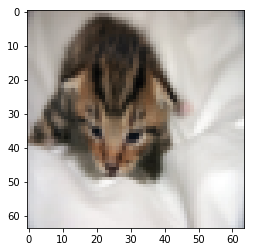

In [26]:
# Example of a picture that was wrongly classified.
index = 1
plt.imshow(test_set_x[:,index].reshape((num_px, num_px, 3)))
print ("y = " + str(test_set_y[0,index]) + ", you predicted that it is a \"" + classes[d["Y_prediction_test"][0,index]].decode("utf-8") +  "\" picture.")

Let's also plot the cost function and the gradients.

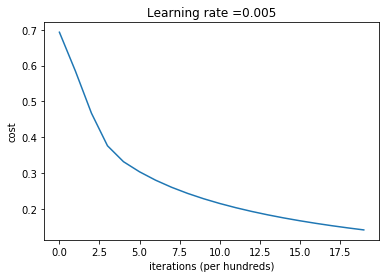

In [27]:
# Plot learning curve (with costs)
costs = np.squeeze(d['costs'])
plt.plot(costs)
plt.ylabel('cost')
plt.xlabel('iterations (per hundreds)')
plt.title("Learning rate =" + str(d["learning_rate"]))
plt.show()

**Interpretation**:
You can see the cost decreasing. It shows that the parameters are being learned. However, you see that you could train the model even more on the training set. Try to increase the number of iterations in the cell above and rerun the cells. You might see that the training set accuracy goes up, but the test set accuracy goes down. This is called overfitting. 

## 6 - Further analysis (optional/ungraded exercise) ##

Congratulations on building your first image classification model. Let's analyze it further, and examine possible choices for the learning rate $\alpha$. 

#### Choice of learning rate ####

**Reminder**:
In order for Gradient Descent to work you must choose the learning rate wisely. The learning rate $\alpha$  determines how rapidly we update the parameters. If the learning rate is too large we may "overshoot" the optimal value. Similarly, if it is too small we will need too many iterations to converge to the best values. That's why it is crucial to use a well-tuned learning rate.

Let's compare the learning curve of our model with several choices of learning rates. Run the cell below. This should take about 1 minute. Feel free also to try different values than the three we have initialized the `learning_rates` variable to contain, and see what happens. 

learning rate is: 0.01
[[ 0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5

[[ 0.87587794  0.95418972  0.97942873  0.73445555  0.81891089  0.82681678
   0.8262796   0.90142862  0.93117102  0.89989421  0.97885464  0.94877287
   0.91074914  0.97794538  0.96299103  0.98493591  0.97082916  0.98403435
   0.96528019  0.85044142  0.94873638  0.83624436  0.99046851  0.9876543
   0.97539507  0.75406107  0.92288415  0.9529435   0.86506241  0.90901978
   0.76374214  0.97945312  0.96232814  0.97158338  0.8506747   0.9067694
   0.91776143  0.98819335  0.66013058  0.94258938  0.91393057  0.70101702
   0.96379401  0.96842804  0.93106449  0.84882263  0.95376071  0.92469342
   0.80245103  0.93463656  0.98761418  0.96200278  0.95881488  0.98853316
   0.89850437  0.9795408   0.94056322  0.99352487  0.761515    0.89573614
   0.91800192  0.93825155  0.96281191  0.90921909  0.99190919  0.87345329
   0.98326363  0.93326606  0.96869935  0.97106617  0.96711938  0.92648843
   0.76922381  0.92577816  0.95799409  0.9730598   0.85897827  0.90162938
   0.86842511  0.70745374  0.90264953  0

[[  2.71281759e-03   5.44620352e-05   1.43724171e-05   1.70627659e-03
    2.09852398e-03   4.86653801e-03   2.26144424e-03   1.11768654e-03
    1.72308207e-04   4.96848297e-04   1.01165412e-05   7.36698597e-05
    7.32825177e-04   4.44108065e-06   1.71903883e-05   2.57179523e-06
    5.21958351e-06   3.89123334e-07   2.53860035e-05   9.69345352e-03
    3.63578830e-05   1.42501414e-03   4.33885407e-07   1.96214573e-06
    1.57576929e-05   2.65944276e-02   1.08682746e-04   7.48561608e-05
    7.72684003e-04   1.73208274e-04   6.39012929e-03   2.55031842e-05
    9.34669699e-05   3.07566342e-05   4.90098832e-04   1.73926096e-03
    1.99062813e-04   1.09996327e-06   1.32653028e-01   3.14594443e-04
    1.28396133e-04   1.44549060e-02   5.13763974e-05   1.25481180e-05
    7.43124480e-05   3.37015433e-03   7.18222993e-05   8.20153043e-04
    4.40884326e-04   2.47276165e-04   1.93842338e-06   4.95321196e-05
    2.79435933e-05   2.11764023e-06   8.68804906e-04   2.23343370e-06
    4.68580219e-04  

(12288, 1)
-0.340511169823
[[ 0.25660663  0.10763598  0.13714031  0.06986048  0.14256072  0.22792131
   0.15155217  0.22705476  0.12390209  0.13957295  0.11013647  0.11667561
   0.19752806  0.07155135  0.07558686  0.07324382  0.04867701  0.02304324
   0.10093943  0.3703894   0.07616228  0.13089322  0.04851967  0.08146656
   0.12039429  0.32627851  0.08424441  0.13016417  0.12409385  0.08902586
   0.17607651  0.17607717  0.17981247  0.14057164  0.08477789  0.27708214
   0.1096214   0.06320128  0.42904387  0.21130963  0.07777537  0.18977246
   0.13891997  0.07537525  0.07727836  0.22262998  0.12571731  0.24532353
   0.05233634  0.16262632  0.08205429  0.13022264  0.08763495  0.09613385
   0.18502489  0.04563108  0.25092429  0.07777731  0.24977384  0.29817549
   0.33727368  0.1432078   0.05812331  0.12378447  0.06723973  0.20142177
   0.15025537  0.11667208  0.11901115  0.07642568  0.13162902  0.29176486
   0.18635326  0.28314366  0.16665399  0.11670056  0.06567351  0.13220334
   0.099947

-0.340453501158
[[ 0.27303357  0.11223051  0.16101557  0.05609458  0.13585776  0.23186091
   0.14421924  0.24946417  0.12673188  0.14029291  0.12674609  0.12474441
   0.21065939  0.08032287  0.0780954   0.08094535  0.04833652  0.02228121
   0.10811496  0.40548292  0.07549268  0.12366901  0.05481951  0.09399313
   0.13840719  0.33652699  0.08137339  0.14114901  0.12044997  0.08597606
   0.16801069  0.20600225  0.20568     0.15923064  0.07737138  0.30162199
   0.10829768  0.07142155  0.43908509  0.23514531  0.07259649  0.17721174
   0.15516728  0.07843632  0.07415083  0.22869219  0.1346652   0.26884213
   0.04260223  0.17430984  0.09543801  0.14331912  0.09160506  0.11558268
   0.19482169  0.04606809  0.28633074  0.09601533  0.24638503  0.33040826
   0.37846978  0.15379278  0.05738838  0.12448861  0.07846735  0.20773954
   0.17491287  0.12039253  0.13144731  0.08044509  0.14517719  0.33253736
   0.17832625  0.31688006  0.1852847   0.13181773  0.05643934  0.13439766
   0.0929439   0.23135

(12288, 1)
-0.176657193223
[[ 0.85585391  0.91064376  0.97584342  0.32149403  0.65118619  0.75889786
   0.66476368  0.8931064   0.86922757  0.815451    0.97034776  0.91306264
   0.88163965  0.95961662  0.9139299   0.97011457  0.90910485  0.92606603
   0.93527565  0.87948044  0.86774673  0.66191957  0.97911067  0.97978959
   0.9668234   0.72757003  0.80383701  0.92608255  0.727591    0.78030756
   0.59698185  0.9782098   0.95898491  0.96235956  0.62127139  0.90417524
   0.82002131  0.97674796  0.66325187  0.93600518  0.75762763  0.5046496
   0.95069527  0.92707711  0.81245177  0.79253902  0.92335517  0.91863432
   0.39698028  0.9050696   0.98043938  0.94312903  0.91372813  0.98504791
   0.85790083  0.93565367  0.94696632  0.99132816  0.6591098   0.90701887
   0.93598084  0.90652406  0.88998629  0.82345027  0.98594924  0.81687471
   0.98014752  0.8741296   0.95132384  0.93562287  0.9507454   0.94107933
   0.6114245   0.93292301  0.94568932  0.96098505  0.55838563  0.82166508
   0.6813432

[[ 0.83153247  0.87426463  0.96628692  0.24220446  0.5895648   0.72267049
   0.59943897  0.87720666  0.82560225  0.7663877   0.95796495  0.88444758
   0.85464821  0.94220959  0.87501184  0.95247983  0.85998268  0.87307666
   0.90726626  0.87114867  0.81149358  0.59312361  0.96572547  0.96852179
   0.95395972  0.7078766   0.73630767  0.90079042  0.66801532  0.71491414
   0.54483945  0.96894526  0.94709033  0.94747699  0.54036221  0.88544326
   0.76076967  0.96269076  0.6528313   0.9192004   0.67519215  0.45474221
   0.93387082  0.8914273   0.7415012   0.75827205  0.89544624  0.89990708
   0.30307385  0.877612    0.96997777  0.92233438  0.87832829  0.97776654
   0.82838894  0.89510064  0.93668471  0.98624417  0.61663965  0.89546776
   0.92598895  0.8800052   0.83485019  0.77377631  0.97681917  0.78021115
   0.97047668  0.8337524   0.9314838   0.90366831  0.93070834  0.93265816
   0.5583796   0.92010906  0.92706728  0.94549134  0.45145095  0.77717679
   0.60180143  0.5221045   0.5383762  

[[ 0.75879407  0.75571948  0.92351805  0.15165219  0.46959065  0.63462288
   0.47236212  0.82078445  0.70013129  0.64108756  0.90440409  0.78892972
   0.77176666  0.86987504  0.74483792  0.87371668  0.69730577  0.67786988
   0.80644086  0.83402658  0.65010144  0.45972458  0.89943382  0.91449638
   0.89962497  0.65458125  0.57076936  0.81281996  0.53735629  0.56050047
   0.44838902  0.9273134   0.8993174   0.8869173   0.39385204  0.82321211
   0.60995878  0.89568298  0.62223448  0.85822919  0.49466049  0.374049
   0.86945448  0.76604009  0.56557669  0.67007515  0.80008079  0.83596794
   0.18548722  0.7888672   0.91971771  0.84531169  0.76041873  0.94149678
   0.74174897  0.74325204  0.89510362  0.95779991  0.53031602  0.85078738
   0.88614568  0.79319409  0.66488286  0.6443909   0.92872515  0.68332249
   0.92588077  0.71478431  0.85505576  0.78698147  0.85417304  0.89645478
   0.45952526  0.87197426  0.85762979  0.88241702  0.28674566  0.65970577
   0.44620353  0.44479696  0.35068919  0

0.847369442436
(12288, 1)
-0.252856261916
[[ 0.91055121  0.9498276   0.99127104  0.29498357  0.72279309  0.82753923
   0.71456391  0.95187897  0.92000339  0.87849258  0.98957275  0.95985819
   0.93329327  0.98738513  0.95737865  0.98733814  0.9557081   0.96861775
   0.96835362  0.93528647  0.92057406  0.72150684  0.99344414  0.99270096
   0.98802174  0.79986292  0.87080886  0.96455237  0.81017488  0.86055591
   0.66261978  0.99004424  0.98396421  0.98348197  0.70686302  0.94319559
   0.87531388  0.9915752   0.71187671  0.96803356  0.8213771   0.54406304
   0.9798591   0.96351729  0.87348591  0.85896706  0.96099755  0.95442345
   0.42366297  0.9489065   0.99341651  0.97429287  0.95841167  0.99552678
   0.92122575  0.96852307  0.97765511  0.99759887  0.70266329  0.95525045
   0.9667521   0.95564538  0.938724    0.89013294  0.99509812  0.87781315
   0.99087335  0.930703    0.97814268  0.96865892  0.97614054  0.97526389
   0.66709689  0.96582436  0.97280084  0.9848028   0.583709    0.89549

(12288, 1)
-0.152160745243
[[ 0.83272898  0.84813096  0.96755049  0.15124818  0.54806892  0.71530098
   0.53578349  0.90112269  0.79689161  0.7379608   0.95994223  0.88443732
   0.85392237  0.94815017  0.85363819  0.94055737  0.82828243  0.83301434
   0.89238481  0.89581992  0.76325838  0.53153161  0.96233125  0.96473246
   0.9563653   0.7250996   0.6834788   0.8959559   0.63972623  0.68200698
   0.51369534  0.96398059  0.95347257  0.94370302  0.48382617  0.88432324
   0.7050931   0.95638212  0.66527108  0.91956695  0.59633595  0.41208687
   0.93734067  0.86716898  0.67630234  0.75432094  0.88461126  0.89836597
   0.21344464  0.87103041  0.96844375  0.91949603  0.86477176  0.97893945
   0.8355763   0.85874971  0.94722167  0.98614915  0.58045684  0.91492441
   0.93307804  0.88401499  0.78767151  0.74962136  0.97228465  0.7670976
   0.96402856  0.819299    0.92582432  0.88201499  0.92129183  0.9474117
   0.51955466  0.92545547  0.92026226  0.94603264  0.32672655  0.76756914
   0.52684567

[[ 0.65899464  0.52996201  0.82879044  0.06387779  0.32589445  0.52493131
   0.30740728  0.76968864  0.49351916  0.45961469  0.79219036  0.63688273
   0.65011259  0.73762847  0.50733634  0.6530197   0.41580866  0.33341175
   0.59954804  0.80846558  0.38761978  0.2928674   0.71130311  0.75937478
   0.79005927  0.6074914   0.34199532  0.65565671  0.37826018  0.36697759
   0.33578544  0.81008076  0.82207881  0.75100419  0.2352034   0.72470758
   0.37867871  0.7019758   0.5971485   0.7526022   0.26501286  0.27646221
   0.75639132  0.51509095  0.31735952  0.55884337  0.62193188  0.73022468
   0.08116152  0.63996654  0.78388423  0.69880757  0.55148607  0.84898553
   0.63299507  0.42627598  0.84130462  0.86623912  0.41347503  0.80977194
   0.83051953  0.66428386  0.37823046  0.46029539  0.76483999  0.54644258
   0.79081279  0.53018315  0.69439221  0.54016004  0.68483673  0.85985613
   0.33940149  0.79907993  0.71382537  0.75453206  0.11992762  0.50128905
   0.2566383   0.3438621   0.16950948 

(12288, 1)
-0.339464539523
[[ 0.41797899  0.16430209  0.40705458  0.02279019  0.15220453  0.31475394
   0.13496565  0.54310955  0.17597188  0.1882693   0.34577715  0.26471462
   0.35406741  0.27947117  0.13565235  0.15424498  0.07785766  0.03780534
   0.19232148  0.67267091  0.09724302  0.12134702  0.16354407  0.23118366
   0.36771497  0.46891751  0.09874434  0.27723781  0.16037936  0.12066042
   0.18485989  0.3697256   0.4785898   0.32290794  0.0839226   0.45797813
   0.12311852  0.17332127  0.52115895  0.42625275  0.07035585  0.16611105
   0.35881205  0.1283807   0.08218417  0.32505767  0.23625861  0.43145929
   0.02513719  0.29822469  0.26403515  0.29362287  0.17191027  0.36823816
   0.34824563  0.0671123   0.59462416  0.32860325  0.25315341  0.61910637
   0.62061398  0.31750254  0.07741137  0.18170988  0.19243757  0.29257855
   0.30608594  0.20160363  0.26359821  0.13566843  0.25796984  0.66721411
   0.18534417  0.54747909  0.32661604  0.32017755  0.03239245  0.22222886
   0.086647

[[ 0.79138749  0.73996253  0.94461764  0.08519333  0.46741362  0.66333403
   0.42392212  0.89752018  0.69032998  0.64162079  0.93446487  0.8371888
   0.80651313  0.92601909  0.75618847  0.86564827  0.6967602   0.67350788
   0.81323865  0.89509815  0.61795372  0.42208808  0.92124689  0.92397027
   0.93169218  0.71351554  0.54789512  0.84335522  0.55877874  0.58206321
   0.4515561   0.92245646  0.93370122  0.89984132  0.38696164  0.83951746
   0.56541223  0.90464431  0.65660909  0.88181757  0.43685039  0.35741457
   0.90595699  0.76014871  0.51945035  0.7012694   0.81332288  0.85371521
   0.13538704  0.81072703  0.93723546  0.87182673  0.7859773   0.96141682
   0.79797388  0.70776631  0.93496126  0.9699768   0.50493536  0.90891451
   0.91309089  0.84408793  0.63515478  0.66113179  0.9308362   0.70069551
   0.91576833  0.74137661  0.87168755  0.77994585  0.85608024  0.94169283
   0.44869443  0.90002603  0.86536244  0.91218903  0.18960567  0.7033654
   0.39415451  0.41669194  0.33331484  0

[[ 0.22607116  0.04066015  0.10934996  0.00926076  0.07353413  0.17916962
   0.05987813  0.33796511  0.05401283  0.07086636  0.08881945  0.08704631
   0.15884496  0.06876119  0.03045292  0.02274157  0.01481212  0.00490491
   0.04447383  0.52292557  0.02253211  0.05150918  0.02173397  0.03649739
   0.10182218  0.36011968  0.02868421  0.08514428  0.06918705  0.04228381
   0.10657192  0.08309853  0.19269286  0.08299377  0.03349126  0.22837727
   0.03603278  0.02418329  0.45758549  0.17180022  0.02033445  0.10516384
   0.11874574  0.02583154  0.02153687  0.1782147   0.06710266  0.19402604
   0.00948081  0.10690904  0.04570021  0.08570607  0.0434814   0.07462913
   0.17184267  0.00989919  0.32456226  0.04741338  0.15120704  0.42005306
   0.37027306  0.12204049  0.01527733  0.06578447  0.02336886  0.13819131
   0.05804963  0.06586211  0.06648109  0.02609129  0.06330623  0.43301422
   0.1054684   0.28518188  0.09689525  0.08557473  0.00979025  0.08900884
   0.03114692  0.14202639  0.01220654 

(12288, 1)
-0.115727879572
[[ 0.78299475  0.70690392  0.94309496  0.06251246  0.44059873  0.65230973
   0.38597357  0.90594816  0.65956244  0.61299527  0.93379626  0.8336973
   0.79921554  0.92748929  0.7306216   0.84163111  0.66768447  0.62972836
   0.79009628  0.90316482  0.56813113  0.38416506  0.91252955  0.91457811
   0.92985441  0.72096467  0.50719358  0.8338349   0.53736356  0.5654409
   0.43109602  0.90971482  0.93639283  0.89046984  0.35447378  0.83065275
   0.51215624  0.88973139  0.66247487  0.87658402  0.38901828  0.33319707
   0.90657788  0.72816116  0.47116809  0.69572761  0.79667852  0.84760068
   0.1079648   0.79724053  0.93253209  0.86541877  0.76702339  0.96033178
   0.80135235  0.6615561   0.93883214  0.96802471  0.47935796  0.91674491
   0.91406902  0.84226584  0.58866807  0.63653548  0.9207998   0.68230625
   0.90281358  0.72374867  0.86144914  0.74641417  0.83877475  0.94730346
   0.42834544  0.89778257  0.8508225   0.90925882  0.14580108  0.68432991
   0.35184438

[[ 0.13982929  0.01477497  0.04042438  0.00426697  0.04170529  0.1159084
   0.03201488  0.2336595   0.02264021  0.03384593  0.03246289  0.03859735
   0.08604754  0.02487676  0.01045624  0.00590385  0.00454433  0.00114896
   0.01545313  0.43468404  0.00775453  0.02658162  0.00528507  0.00983269
   0.03866653  0.29793401  0.0115163   0.03590523  0.03642975  0.0196471
   0.0685056   0.02710949  0.09406322  0.03038273  0.01632282  0.13181918
   0.01442935  0.00604489  0.42082037  0.085262    0.00801967  0.07160806
   0.05181796  0.00823464  0.00808487  0.11328123  0.02670648  0.10507458
   0.00422374  0.04941168  0.01307758  0.03477115  0.01603817  0.0228083
   0.10172894  0.00256083  0.1989001   0.01180928  0.10113108  0.31239746
   0.24431057  0.05933767  0.00478135  0.03076524  0.00544497  0.07776809
   0.01757844  0.02886951  0.02444706  0.0080078   0.02265708  0.30594929
   0.06800626  0.16809905  0.03905219  0.03234584  0.00382234  0.04394054
   0.01428533  0.10015027  0.00485769  0.

(12288, 1)
-0.339576457866
[[ 0.39473021  0.11501021  0.37942851  0.01119681  0.12701795  0.29426904
   0.0989142   0.60710607  0.13184202  0.14965399  0.33236573  0.25302793
   0.33084093  0.29615979  0.10238949  0.0979626   0.05515567  0.02373645
   0.14459207  0.7205436   0.06286842  0.08943262  0.1265334   0.17255094
   0.3526699   0.49299593  0.07021028  0.24701419  0.13878502  0.10441984
   0.16155804  0.26928322  0.49030787  0.26659073  0.06529259  0.41623314
   0.08074752  0.12112632  0.53575537  0.39363728  0.04552093  0.1404572
   0.35119221  0.08893554  0.05403394  0.30868169  0.19041199  0.39525996
   0.01508498  0.25709694  0.22036841  0.26142864  0.13920106  0.3426554
   0.3559467   0.03928021  0.62732719  0.28145478  0.2120823   0.67255914
   0.62067859  0.31077663  0.04983143  0.15078949  0.13133495  0.25669423
   0.21277519  0.17128784  0.21817963  0.09085809  0.19446009  0.71947321
   0.16024295  0.53184657  0.26374538  0.29549623  0.0163633   0.19662972
   0.05915818

(12288, 1)
-0.333512704649
[[ 0.71003349  0.52076328  0.88810517  0.03269075  0.33987563  0.56980386
   0.27361119  0.88369582  0.49455957  0.47094942  0.87301476  0.73887164
   0.71286778  0.87096084  0.55138445  0.64824554  0.4456011   0.36079887
   0.63095606  0.8892641   0.36594238  0.26971466  0.78961779  0.79803303
   0.87086413  0.68989584  0.33801491  0.73045035  0.42049211  0.42584783
   0.34867934  0.80181847  0.89370511  0.79048677  0.24451793  0.75193088
   0.34000067  0.7407386   0.64428076  0.80346123  0.23207924  0.26977765
   0.83899339  0.52862796  0.29306983  0.61166602  0.65868578  0.76879527
   0.06036141  0.68460303  0.84674003  0.76671363  0.61393902  0.91226976
   0.73161707  0.39956239  0.91246089  0.91744414  0.39231358  0.8976192
   0.87854506  0.76031679  0.36923547  0.49979109  0.79009218  0.57777724
   0.7767185   0.58807873  0.74436137  0.54315131  0.69755006  0.93155559
   0.34527875  0.84888168  0.73724051  0.83160841  0.07207795  0.56693438
   0.2250185

(12288, 1)
0.414925453372
[[  1.16367884e-02   1.78910826e-04   2.74282588e-04   3.08743905e-04
    3.41649965e-03   1.31964382e-02   2.39383623e-03   1.81490362e-02
    4.89692222e-04   1.25810337e-03   2.07352937e-04   6.73509559e-04
    3.89589035e-03   1.41159102e-04   8.72257732e-05   1.62196946e-05
    2.24804049e-05   1.94237220e-06   1.40126301e-04   9.46442890e-02
    8.67064733e-05   1.68868614e-03   8.04619108e-06   2.48868692e-05
    3.07885431e-04   8.73687478e-02   2.28026695e-04   5.82774493e-04
    1.92404031e-03   5.40048320e-04   9.30570759e-03   1.76586689e-04
    1.63608014e-03   2.73533341e-04   7.53396798e-04   7.82836571e-03
    3.39730223e-04   1.24418781e-05   2.44273629e-01   2.39490967e-03
    1.66252205e-04   1.42492594e-02   6.86457507e-04   5.50927611e-05
    1.30585332e-04   1.07141855e-02   3.83144607e-04   4.43528784e-03
    1.96827555e-04   1.27875239e-03   3.58185348e-05   4.39330473e-04
    1.69257703e-04   6.71291258e-05   5.57902429e-03   7.5796873

[[ 0.87997419  0.86113446  0.98562359  0.07225233  0.59750923  0.77758459
   0.50736687  0.96856992  0.81935675  0.77253489  0.98463074  0.94525123
   0.9057234   0.98657727  0.89952944  0.94939193  0.87997468  0.88787942
   0.92036602  0.9558297   0.77031373  0.5220938   0.98286635  0.97831641
   0.98262219  0.82144596  0.71377246  0.94097251  0.72114099  0.78456274
   0.55763443  0.96541415  0.98183708  0.96308283  0.53950876  0.90827485
   0.68148108  0.97214096  0.72923644  0.94971897  0.58183003  0.42117549
   0.97301881  0.89418369  0.68000152  0.82094674  0.91693758  0.92769962
   0.17219704  0.9085317   0.9852487   0.95538904  0.9150624   0.99236252
   0.91555922  0.86953365  0.98038313  0.99457424  0.56758559  0.96910237
   0.96173722  0.94364186  0.8118311   0.80882729  0.98176042  0.8100069
   0.96539637  0.8784023   0.95366451  0.90051549  0.93612273  0.98312826
   0.55414332  0.95482596  0.93785119  0.97539246  0.20729565  0.84138411
   0.50472754  0.46563717  0.53020658  

(12288, 1)
0.188000482655
[[  1.05575467e-01   7.53410410e-03   2.51577717e-02   2.01100241e-03
    3.01200650e-02   9.14168256e-02   2.03456556e-02   2.31041852e-01
    1.28505211e-02   2.10710044e-02   2.10778558e-02   2.78529415e-02
    6.24005467e-02   1.83356975e-02   5.76262725e-03   2.42432261e-03
    2.35932360e-03   5.04649899e-04   8.11142221e-03   4.34324705e-01
    3.76082474e-03   1.68138249e-02   2.51253303e-03   4.51227886e-03
    2.51374588e-02   2.91949577e-01   6.51532214e-03   2.35028363e-02
    2.61672416e-02   1.42392831e-02   5.27566677e-02   1.20697796e-02
    7.14431227e-02   1.67673076e-02   1.07707980e-02   9.08180121e-02
    7.31379642e-03   2.61828201e-03   4.18253821e-01   5.79805964e-02
    4.26697235e-03   5.57374199e-02   3.70059980e-02   4.06356259e-03
    4.25084469e-03   9.12926713e-02   1.54645883e-02   7.37458009e-02
    2.34441997e-03   3.11092568e-02   6.91791496e-03   2.21346386e-02
    9.33113952e-03   1.31897957e-02   8.68777794e-02   1.0583518

-0.338938827794
[[ 0.42986635  0.12170971  0.47394882  0.00807874  0.13992198  0.32387558
   0.09709231  0.72256691  0.14115439  0.16069544  0.43883243  0.33368038
   0.37952405  0.44343994  0.12528719  0.10643575  0.06913829  0.03070145
   0.1658501   0.79017986  0.06511892  0.0901417   0.17429895  0.20827371
   0.45407247  0.55510575  0.07700847  0.30698823  0.16249261  0.13669995
   0.17317117  0.27233798  0.59550495  0.3085199   0.07335586  0.4375607
   0.07748287  0.14596968  0.57015086  0.44794998  0.04630751  0.14416607
   0.44965667  0.1013195   0.05704327  0.35058104  0.21861528  0.4374012
   0.01425043  0.28863206  0.29206464  0.32380766  0.17157212  0.45393371
   0.44283367  0.0425996   0.72600487  0.38155661  0.20942265  0.76733165
   0.67811879  0.39001917  0.05570132  0.17252419  0.16147694  0.27693115
   0.22276264  0.20468776  0.2629932   0.09891129  0.2106668   0.81099683
   0.17397764  0.58249416  0.28568984  0.38042784  0.01300214  0.22623967
   0.05901507  0.1821978

[[ 0.87597933  0.84455175  0.98610923  0.05389065  0.58406436  0.77265428
   0.47692357  0.97296879  0.80264298  0.75474147  0.98540267  0.94812086
   0.90448197  0.98827002  0.89416417  0.94092834  0.87218253  0.87665925
   0.91294945  0.96057321  0.73989904  0.49286354  0.98210018  0.97627058
   0.98327804  0.83189885  0.69146795  0.94143409  0.71474058  0.78980513
   0.54425881  0.95955814  0.98311026  0.96094816  0.51938086  0.90208993
   0.63929729  0.96883132  0.73823618  0.9491006   0.54468959  0.40396484
   0.97471086  0.88298547  0.65050447  0.82186233  0.91161508  0.92661375
   0.14746891  0.90299652  0.98521151  0.9555405   0.9109984   0.99264947
   0.92199486  0.84850301  0.98261628  0.99466925  0.54574505  0.97350311
   0.96315312  0.9454771   0.79113893  0.79826672  0.98024555  0.79948672
   0.96073967  0.87405466  0.95202361  0.88614441  0.92880643  0.98569288
   0.54623877  0.95423373  0.93193011  0.97609165  0.16435176  0.8320237
   0.47059953  0.44671826  0.50936779  

   0.54685538  0.35853439  0.42027759  0.22500767  0.46374512]]
0.469870697891
(12288, 1)
0.104187752544
[[ 0.23258488  0.03204954  0.15082939  0.00351037  0.06941546  0.18569328
   0.04479065  0.51666151  0.04519868  0.0613146   0.13361221  0.12464159
   0.17722902  0.13632016  0.03108547  0.01723651  0.01500253  0.00461493
   0.04035819  0.65816842  0.01600081  0.03967329  0.02604569  0.03598359
   0.14494131  0.44295097  0.0239855   0.10396862  0.07257171  0.05419307
   0.10040798  0.06135826  0.28414863  0.08510553  0.03006824  0.21606316
   0.02300382  0.02220816  0.50876153  0.19299267  0.01453195  0.09143887
   0.17582183  0.02221736  0.01636181  0.20223312  0.06594592  0.20941253
   0.00572981  0.10552917  0.05923799  0.10535611  0.04624117  0.11149808
   0.2460357   0.00718343  0.47124373  0.06765194  0.12577077  0.59491733
   0.43924685  0.16375307  0.0122438   0.06360137  0.02334782  0.13022921
   0.04621128  0.07014587  0.07303012  0.02020112  0.0540557   0.62087183
   0.10

(12288, 1)
-0.33847031636
[[ 0.44524493  0.13063393  0.53934695  0.00693182  0.14944261  0.33992838
   0.09848993  0.77232643  0.15073117  0.16874218  0.5079532   0.39308395
   0.40887916  0.53708517  0.14676067  0.11802822  0.08388754  0.03828188
   0.1828594   0.81899929  0.06861026  0.09268003  0.21486088  0.2397577
   0.51631087  0.58925702  0.08420673  0.35163776  0.17963744  0.16727087
   0.18097555  0.28291343  0.65386822  0.34231197  0.07935131  0.44740258
   0.07653159  0.16842742  0.58982137  0.48374025  0.04875691  0.14659975
   0.51823409  0.1137955   0.06182426  0.38049502  0.24240951  0.46995747
   0.01423966  0.30844484  0.35246066  0.37128893  0.19652249  0.52800098
   0.5017243   0.04792909  0.77524215  0.45978681  0.20971297  0.8108043
   0.70983593  0.43946482  0.06270527  0.1862037   0.19734708  0.28740666
   0.24424021  0.22854985  0.3006248   0.10737283  0.22734904  0.85081876
   0.18633884  0.60661805  0.30309808  0.44145718  0.01186642  0.23893744
   0.06131563 

[[ 0.58607814  0.28381551  0.79925388  0.01057051  0.23794512  0.46242884
   0.1590674   0.87788082  0.2925898   0.29388251  0.7810026   0.64452056
   0.59042458  0.81484888  0.34633134  0.32929036  0.24369848  0.15028247
   0.38902376  0.88472595  0.16131917  0.15592792  0.55603189  0.55141548
   0.77485665  0.68257192  0.18153009  0.59549605  0.30548668  0.33794633
   0.259406    0.53513549  0.84064312  0.60575601  0.14698958  0.60078049
   0.14915915  0.44881684  0.64278301  0.68648739  0.10605998  0.19660201
   0.76458898  0.28344117  0.14120898  0.52891014  0.45862879  0.65688613
   0.02635655  0.50280577  0.69267386  0.62985345  0.41263239  0.82112597
   0.69033018  0.15536911  0.89277282  0.80749827  0.27942942  0.89733654
   0.8303673   0.66149803  0.16997331  0.33035227  0.53647319  0.42258958
   0.51784112  0.41842027  0.56495786  0.26857281  0.45177521  0.92784028
   0.2710304   0.75655992  0.52259925  0.71895264  0.02235336  0.39051282
   0.11617974  0.23910376  0.09332528 

(12288, 1)
-0.338323654792
[[ 0.43407752  0.12147791  0.55551837  0.00543804  0.14520681  0.3330279
   0.09133192  0.7919109   0.14174926  0.15768603  0.521792    0.41301946
   0.40643335  0.57210711  0.14643804  0.107776    0.0819511   0.03661648
   0.17392603  0.83104998  0.06150528  0.08637998  0.21353137  0.23031304
   0.52858944  0.60451073  0.07959735  0.36225759  0.17760924  0.17845672
   0.17509365  0.26095785  0.66491715  0.33813158  0.07535168  0.42821291
   0.06666965  0.15914453  0.59987891  0.48519036  0.04398396  0.14003323
   0.53881106  0.10760851  0.05781695  0.38486067  0.23632003  0.47422474
   0.01257119  0.29666752  0.36316882  0.37912592  0.19293709  0.54205285
   0.52605551  0.04313639  0.79464162  0.47677107  0.19856904  0.83084582
   0.71858339  0.44728961  0.0588058   0.17797625  0.19801514  0.2748738
   0.23416644  0.22483544  0.30127     0.09771192  0.21439206  0.86814832
   0.18573462  0.60098958  0.28953746  0.45458825  0.00960271  0.22435574
   0.05662427

(12288, 1)
0.487863887226
[[  6.98562107e-03   7.26652404e-05   1.67720853e-04   9.33882445e-05
    2.15262910e-03   8.86620180e-03   1.25047528e-03   1.86782503e-02
    2.25598240e-04   6.15409576e-04   1.27034746e-04   5.03925174e-04
    2.44055281e-03   1.11014259e-04   4.36887410e-05   5.06260553e-06
    1.04680095e-05   7.18137627e-07   5.84424683e-05   9.61885544e-02
    3.12020400e-05   8.79390192e-04   3.23597370e-06   9.19311431e-06
    1.83487094e-04   8.90655374e-02   1.07821369e-04   3.68274013e-04
    1.23553482e-03   4.29893782e-04   6.22767341e-03   5.79989463e-05
    1.16632647e-03   1.29797413e-04   4.14535384e-04   4.06531437e-03
    1.19747922e-04   4.18013360e-06   2.50307421e-01   1.44531047e-03
    6.92522397e-05   9.48966850e-03   5.08714711e-04   2.21098940e-05
    5.72730546e-05   8.26700644e-03   1.89361851e-04   2.91011454e-03
    8.36722434e-05   6.40467114e-04   1.82477373e-05   2.65721072e-04
    8.37134321e-05   3.62888275e-05   5.19815460e-03   2.4127357

[[ 0.31903411  0.06327947  0.36020841  0.00355524  0.10469706  0.25357968
   0.06254593  0.70920313  0.0810476   0.09715289  0.32596343  0.2810635
   0.28656265  0.38257192  0.07793167  0.04383992  0.04025937  0.01502929
   0.0872635   0.77661735  0.03045231  0.05818035  0.08888618  0.09969044
   0.3361475   0.55313635  0.04566017  0.22992688  0.12260035  0.12419282
   0.13528161  0.12360452  0.50265102  0.18817586  0.04939722  0.29623786
   0.03537968  0.06393727  0.57182508  0.33600318  0.02495121  0.1128313
   0.38060363  0.05170754  0.03185689  0.30299957  0.13448723  0.34666782
   0.00821055  0.18089748  0.18624727  0.23520096  0.10445993  0.31513095
   0.425191    0.0180029   0.69407523  0.24134308  0.15318058  0.76931264
   0.60555473  0.31005628  0.02843281  0.10879855  0.082636    0.18734133
   0.11084011  0.13604809  0.17007628  0.04424565  0.11035055  0.80427706
   0.14793399  0.45145103  0.16205323  0.28263541  0.00543827  0.13820533
   0.03603286  0.14481975  0.02261555  0

[[ 0.66159241  0.39756449  0.89819853  0.01147106  0.31004419  0.53755943
   0.20053165  0.92945833  0.39354321  0.37730289  0.88781921  0.78974829
   0.69329264  0.92272625  0.51852681  0.48772333  0.39719294  0.29648917
   0.53671493  0.92123414  0.24029018  0.20366577  0.75823975  0.72039153
   0.88319941  0.7476963   0.2687572   0.74532803  0.40744564  0.4992041
   0.31498951  0.6564448   0.90793991  0.74332261  0.20850556  0.6670057
   0.20031262  0.63813333  0.68295072  0.78691914  0.15344903  0.23305839
   0.87082201  0.42716685  0.21581225  0.62228125  0.59666935  0.75505268
   0.03690986  0.61253559  0.84673495  0.76962211  0.57271469  0.91878139
   0.79927219  0.26120626  0.94097763  0.92074504  0.31681281  0.93978649
   0.88510817  0.78012894  0.27852626  0.43652615  0.73781257  0.50360103
   0.66399798  0.55337417  0.71669816  0.39724783  0.58329482  0.96066087
   0.33815638  0.82308727  0.64301656  0.84576161  0.02805632  0.4894902
   0.16066655  0.27271499  0.15455921  0.

(12288, 1)
-0.336525012369
[[ 0.5103988   0.17596843  0.71693427  0.00582447  0.19401873  0.39852571
   0.11480235  0.87387451  0.19619091  0.20783742  0.69114579  0.57870177
   0.50840074  0.77484033  0.24464537  0.17258511  0.14042595  0.07483613
   0.26548549  0.88151306  0.09245885  0.11308187  0.37973856  0.35827907
   0.70007052  0.67497051  0.11974846  0.51752058  0.24691684  0.28493279
   0.21482333  0.34699043  0.77415274  0.47039486  0.10904511  0.48927712
   0.09040445  0.26958236  0.6399804   0.60095501  0.06248488  0.16865258
   0.68988965  0.17373975  0.08837373  0.46792556  0.33472987  0.57684857
   0.01762937  0.38563091  0.5561097   0.52675598  0.30103137  0.72612011
   0.65313379  0.07151527  0.87605857  0.6912066   0.22500832  0.89522565
   0.79326726  0.58330898  0.0985014   0.24899756  0.3384382   0.33994524
   0.33011181  0.32323046  0.43560274  0.15248489  0.29754304  0.92353937
   0.23446414  0.68560116  0.38554233  0.62243917  0.01172716  0.30026678
   0.077207

(12288, 1)
0.408026169059
[[  1.21780034e-02   1.56627437e-04   5.24872670e-04   1.18010770e-04
    3.86199357e-03   1.44962900e-02   1.99021490e-03   4.69491975e-02
    4.49818501e-04   1.13531835e-03   4.13656985e-04   1.43695923e-03
    4.90910116e-03   4.90608638e-04   1.23307020e-04   1.33036847e-05
    2.83936896e-05   2.51488907e-06   1.50309456e-04   1.71231472e-01
    6.92445226e-05   1.49105636e-03   1.25478091e-05   2.69093549e-05
    6.14422439e-04   1.35737349e-01   2.33842446e-04   1.02582407e-03
    2.45517574e-03   1.08521648e-03   9.56960201e-03   1.24868454e-04
    2.88849953e-03   3.30529301e-04   8.29665908e-04   6.59517732e-03
    2.28387900e-04   1.32157363e-05   3.02724301e-01   3.16918543e-03
    1.35692124e-04   1.39399673e-02   1.40888715e-03   5.75106542e-05
    1.25684538e-04   1.41964675e-02   4.31578628e-04   5.70845648e-03
    1.55497725e-04   1.29867079e-03   6.53328048e-05   7.05650154e-04
    2.25303787e-04   1.36178218e-04   1.16118973e-02   6.1930968

(12288, 1)
-0.234205007132
[[ 0.87378769  0.81982836  0.99065682  0.0263262   0.59935661  0.77633342
   0.4351005   0.98611235  0.78063148  0.72618648  0.99025773  0.96829434
   0.91363873  0.99503851  0.91189408  0.92357317  0.87768473  0.88406759
   0.91123369  0.97487662  0.68969626  0.46210037  0.98534277  0.97427786
   0.98923404  0.87482275  0.6834493   0.95966121  0.74145226  0.8602189
   0.54092876  0.94278305  0.98735401  0.96311603  0.52753434  0.88116509
   0.55553398  0.96627439  0.77662913  0.95572959  0.48945657  0.39848363
   0.9836643   0.87753039  0.63293634  0.84379338  0.91187262  0.93591193
   0.12613998  0.89630183  0.98953949  0.9660643   0.92146983  0.9951354
   0.95127192  0.80833946  0.9902772   0.99659842  0.50330182  0.98644101
   0.9710038   0.95933149  0.78328503  0.80081879  0.98151197  0.78667149
   0.95228096  0.88687266  0.9585898   0.86128236  0.91423933  0.9929186
   0.57479409  0.95551942  0.9233062   0.98343697  0.09587938  0.82247413
   0.43283454 

[[ 0.41635811  0.09958425  0.578706    0.00344704  0.14730174  0.32577502
   0.08063941  0.84657298  0.12152799  0.13716685  0.54749732  0.46850351
   0.4036135   0.67356161  0.1499072   0.07789289  0.07343302  0.03316893
   0.15746211  0.8619136   0.0488314   0.07831213  0.20498902  0.18815177
   0.56967155  0.64746381  0.07313839  0.40025543  0.18315979  0.21816039
   0.17017883  0.19046076  0.67088436  0.3145581   0.07545869  0.37090719
   0.05163047  0.13038992  0.62626136  0.48080141  0.03627441  0.13995677
   0.5735316   0.09382846  0.05175985  0.39106701  0.21518611  0.47127385
   0.01155338  0.26574562  0.37322193  0.39103758  0.19092001  0.56168455
   0.58355039  0.03097469  0.83465764  0.49579867  0.17729568  0.87563173
   0.72945018  0.47183238  0.0520743   0.17158991  0.16874055  0.25446931
   0.17985572  0.22435077  0.29296939  0.07606903  0.17063908  0.90379053
   0.19337348  0.58033291  0.24819733  0.47807185  0.00638384  0.20832643
   0.04968112  0.16574514  0.0399431  

(12288, 1)
0.0530705408063
[[ 0.31997303  0.05706045  0.41212131  0.00237551  0.10930415  0.25631326
   0.0580056   0.78674755  0.07516193  0.08960863  0.37476428  0.34415413
   0.29970524  0.50986632  0.08733525  0.03603892  0.03893182  0.01504273
   0.08753569  0.82184386  0.02657315  0.0553092   0.09639682  0.091037
   0.40201002  0.60234286  0.04492294  0.27914583  0.13105606  0.15851792
   0.13431989  0.10076852  0.5317975   0.19152561  0.05139504  0.26803258
   0.03012092  0.05941656  0.60200214  0.35493031  0.02202918  0.11502161
   0.43449875  0.0498643   0.03094776  0.3167071   0.13196002  0.36552538
   0.00784527  0.17253774  0.21518387  0.26291168  0.1122289   0.36408213
   0.49259608  0.01452705  0.76144316  0.28882366  0.14148421  0.83341135
   0.64028887  0.34798413  0.0278197   0.11168565  0.08002997  0.18242315
   0.09586829  0.14549029  0.18103466  0.03831579  0.09596565  0.86206193
   0.15736677  0.45518506  0.15078055  0.32481729  0.00392914  0.13504297
   0.03343307

[[ 0.74938108  0.5475122   0.96187169  0.01130841  0.41362406  0.63042492
   0.25963951  0.96955448  0.52711742  0.48555749  0.95804272  0.90811439
   0.80163433  0.97927036  0.72705144  0.66932724  0.60508886  0.54598771
   0.71313454  0.95583121  0.35982064  0.27309949  0.90846903  0.86100733
   0.95719749  0.82322545  0.40502671  0.88196601  0.54502287  0.70744235
   0.38788733  0.77449417  0.95721478  0.8647537   0.30997302  0.73722006
   0.27636027  0.81623723  0.73709979  0.8792754   0.23011692  0.28741314
   0.94616978  0.61792881  0.34167792  0.724903    0.74291361  0.85148253
   0.05561605  0.73073589  0.94602359  0.8889023   0.75296033  0.97369178
   0.89646571  0.42374599  0.97532823  0.97786075  0.36167448  0.97315443
   0.93504166  0.88694917  0.45816284  0.58228122  0.88900687  0.60473044
   0.80253565  0.71475638  0.85534184  0.5634963   0.71849385  0.98401982
   0.43316666  0.88710362  0.7656287   0.93691141  0.0343169   0.61252761
   0.22896748  0.31455494  0.2777826  

[[  4.24498807e-02   1.24178853e-03   7.45032212e-03   2.86997208e-04
    1.34132393e-02   4.32345810e-02   6.51608032e-03   2.15695168e-01
    2.74503297e-03   5.28311136e-03   6.02426286e-03   1.33544296e-02
    2.40114011e-02   9.43382126e-03   1.41061450e-03   2.03703352e-04
    3.78403119e-04   5.73736126e-05   1.48780516e-03   4.12104845e-01
    5.42919021e-04   5.37966995e-03   3.26322274e-04   4.71666307e-04
    8.34547938e-03   2.78830550e-01   1.54552682e-03   9.48646652e-03
    1.09264049e-02   7.96160622e-03   2.52375869e-02   1.23633884e-03
    2.48076463e-02   3.41242599e-03   3.76818053e-03   2.46879168e-02
    1.20354171e-03   2.56540678e-04   4.18337105e-01   2.00075765e-02
    8.02711781e-04   3.07295896e-02   1.46544733e-02   6.41155011e-04
    9.01209108e-04   4.86132066e-02   3.41248318e-03   2.97351957e-02
    6.29812034e-04   7.52100997e-03   1.38604296e-03   6.87711953e-03
    2.22167718e-03   2.90149855e-03   6.09121658e-02   9.02274217e-05
    1.23817304e-01  

(12288, 1)
0.169432476848
[[  1.18073829e-01   6.96485131e-03   5.86721309e-02   6.75094294e-04
    3.63624820e-02   1.03922059e-01   1.75273595e-02   5.09227470e-01
    1.23629479e-02   1.93782201e-02   4.96642134e-02   7.12464671e-02
    8.48832106e-02   8.59181195e-02   9.71151246e-03   2.02730970e-03
    3.02186385e-03   7.06168355e-04   9.95953885e-03   6.46636530e-01
    3.11649276e-03   1.55306003e-02   4.60354754e-03   5.14446040e-03
    6.38386103e-02   4.32844415e-01   7.19979755e-03   5.25290298e-02
    3.57212641e-02   3.41627065e-02   5.50552083e-02   8.97464762e-03
    1.29095589e-01   2.30376472e-02   1.27878872e-02   7.74244198e-02
    5.16350636e-03   3.04211502e-03   5.11556740e-01   8.60330359e-02
    3.52288032e-03   5.78602249e-02   8.55657930e-02   4.67126404e-03
    4.48219578e-03   1.23185310e-01   1.86387918e-02   1.05249471e-01
    1.98556051e-03   3.29797983e-02   1.56159619e-02   4.12185298e-02
    1.41644820e-02   3.30909592e-02   1.91527775e-01   8.3953231

-0.335585340843
[[ 0.48994764  0.13668091  0.73245477  0.0031682   0.18363502  0.38129637
   0.09570395  0.91075519  0.16058624  0.17149255  0.70671091  0.62045505
   0.4966167   0.83714054  0.23449956  0.11600245  0.11110467  0.0580185
   0.23398942  0.90634364  0.06703228  0.09538921  0.34494784  0.28327971
   0.73376206  0.71232943  0.10137475  0.55410789  0.23737235  0.31959206
   0.19643907  0.25610202  0.77473102  0.43321414  0.10005077  0.42605782
   0.0664011   0.20858521  0.66718802  0.59341496  0.04684393  0.16123123
   0.71105387  0.14177663  0.0733161   0.45972063  0.29233026  0.57207105
   0.01445835  0.33809322  0.55345989  0.52843086  0.28237509  0.73575553
   0.69665903  0.04510985  0.90369753  0.7022858   0.19438287  0.92630587
   0.80693557  0.59788887  0.08028613  0.23138001  0.27303863  0.30914503
   0.25488504  0.31062172  0.41449158  0.10915105  0.22734285  0.94697215
   0.23219254  0.66787568  0.32594161  0.63469069  0.00689465  0.26622295
   0.06188089  0.180917

[[ 0.55935725  0.20305982  0.83554526  0.00382789  0.23014257  0.44189591
   0.12198038  0.93803067  0.22443534  0.22628745  0.81740282  0.73446156
   0.58631559  0.91108511  0.35147804  0.19667226  0.18719578  0.11399563
   0.33933563  0.92715411  0.10257946  0.12384543  0.52733035  0.4316396
   0.83411725  0.75361179  0.14878481  0.67628029  0.30511823  0.43344847
   0.2341614   0.36538139  0.85064522  0.56554353  0.13613984  0.49804541
   0.0929777   0.34056707  0.69340676  0.690036    0.06923269  0.18768205
   0.81120862  0.2233187   0.11120568  0.53282766  0.39843814  0.66337743
   0.01986393  0.43052149  0.71661625  0.65548567  0.3993497   0.84940921
   0.7755438   0.08084804  0.93671258  0.84059868  0.22443844  0.94827744
   0.85603629  0.70208757  0.13237774  0.30622845  0.44381218  0.37407101
   0.38031365  0.41268233  0.55169282  0.17288253  0.32416853  0.96475808
   0.2786932   0.7379834   0.42971042  0.75815519  0.00934256  0.3378012
   0.08543475  0.20661035  0.09228264  0

2.11956546447
(12288, 1)
-0.33414290476
[[ 0.52244819  0.16502683  0.79912494  0.00311694  0.20418226  0.40917258
   0.10576995  0.93049983  0.18841626  0.19306949  0.77541475  0.69418147
   0.54357674  0.88956835  0.29585171  0.14809184  0.14504165  0.08202309
   0.28318147  0.92105824  0.08010312  0.10663192  0.43934592  0.35166284
   0.7983058   0.74125679  0.12216745  0.63155504  0.27010669  0.39043777
   0.2123031   0.3013201   0.82096148  0.50253387  0.11591577  0.45411891
   0.07517668  0.26670767  0.68641378  0.64826038  0.0552873   0.17247464
   0.77629308  0.17779686  0.09002678  0.49917354  0.34269102  0.62689295
   0.01639828  0.3789221   0.65220462  0.60285235  0.34041179  0.80754501
   0.75037204  0.05854376  0.92734243  0.79220654  0.2047472   0.94302615
   0.8387952   0.65982345  0.10325994  0.26523731  0.35987701  0.33643804
   0.31488118  0.36249009  0.4905413   0.13334559  0.26780758  0.96045705
   0.25625546  0.70349383  0.37198238  0.71084163  0.00738659  0.2929428

(12288, 1)
0.379110067855
[[  1.52656334e-02   2.12365396e-04   1.20123912e-03   8.16201474e-05
    4.87820099e-03   1.76912676e-02   2.24434317e-03   9.63922481e-02
    5.91250690e-04   1.35018902e-03   9.11844772e-04   3.12688422e-03
    7.08304413e-03   1.55230545e-03   2.31637429e-04   1.87505428e-05
    4.62413522e-05   4.68543797e-06   2.35548111e-04   2.60842822e-01
    8.57322070e-05   1.74071742e-03   2.65729567e-05   4.34935967e-05
    1.43338596e-03   1.89506815e-01   3.26584087e-04   2.17883582e-03
    3.40906322e-03   2.24956595e-03   1.09842995e-02   1.60112533e-04
    5.24350749e-03   5.49560091e-04   1.10371683e-03   7.31081113e-03
    2.52318788e-04   2.17434375e-05   3.57383251e-01   5.08995199e-03
    1.64565116e-04   1.59287103e-02   3.04101722e-03   8.86931260e-05
    1.79275612e-04   1.92981901e-02   6.33016399e-04   9.13150103e-03
    1.80453955e-04   1.68661711e-03   1.55048035e-04   1.33700373e-03
    3.78056407e-04   3.30448268e-04   2.23580172e-02   8.4342826

[[ 0.85222867  0.75464763  0.99073632  0.01267278  0.55836406  0.74716922
   0.36708743  0.98966041  0.71828325  0.65171792  0.98986028  0.97139821
   0.90178519  0.99629284  0.90013143  0.87034376  0.83161813  0.83588046
   0.88438528  0.97925331  0.57704856  0.39429319  0.98038951  0.95915194
   0.98985362  0.88977108  0.61848229  0.96278313  0.71162589  0.87537439
   0.49414418  0.90584217  0.98622501  0.95324384  0.47677531  0.83821197
   0.43808615  0.94621007  0.79519173  0.95079888  0.38826394  0.36952707
   0.98441642  0.83335794  0.56266098  0.8311552   0.88465688  0.93264697
   0.09510984  0.8619752   0.98851301  0.96353421  0.9045241   0.9948123
   0.95832036  0.69521555  0.99227154  0.99647826  0.44098555  0.99033269
   0.97214306  0.95819838  0.7217461   0.76308716  0.97321529  0.74178638
   0.92916386  0.8695305   0.95178008  0.78437035  0.86889244  0.9949737
   0.55845263  0.9465756   0.89218312  0.98291439  0.05174583  0.7677943
   0.35746648  0.38031858  0.50108114  0.

(12288, 1)
-0.154953353666
[[ 0.77540168  0.57454869  0.97691472  0.00771166  0.43727932  0.65437211
   0.26179335  0.98231311  0.55369809  0.49749069  0.97383651  0.94122547
   0.83330517  0.99026757  0.78886502  0.69020344  0.64671202  0.60814428
   0.75876754  0.96965922  0.36839456  0.27906116  0.9366702   0.88406881
   0.97503526  0.85910768  0.43753764  0.9237682   0.58373772  0.78572706
   0.3973028   0.78865872  0.96990957  0.89396308  0.33668395  0.74431674
   0.27574369  0.8461642   0.7693678   0.90690028  0.23366787  0.29882896
   0.96567149  0.66169991  0.37498905  0.75572466  0.77508967  0.88422336
   0.05590345  0.7539174   0.96668745  0.92092475  0.80015223  0.98461545
   0.92968698  0.43433769  0.98558336  0.98821162  0.35633621  0.9844097
   0.95327055  0.91837396  0.50744771  0.62269018  0.91645938  0.62597861
   0.83064739  0.76288189  0.89224049  0.57933988  0.7335515   0.99124215
   0.46397357  0.90553891  0.78787512  0.95911369  0.02760478  0.63021727
   0.2344586

(12288, 1)
-0.293719121787
[[ 0.83152403  0.69661316  0.98819653  0.00969638  0.51848858  0.71940501
   0.3257689   0.98884756  0.66458115  0.59823878  0.98688891  0.96580728
   0.88432632  0.9954831   0.87355675  0.81744563  0.77699298  0.77284337
   0.8520425   0.97802061  0.49932902  0.34998888  0.97157596  0.94080133
   0.98737277  0.88501078  0.55795323  0.95557318  0.67334636  0.85631535
   0.45925467  0.87202692  0.9828107   0.93909384  0.42942831  0.8081488
   0.37446169  0.92174045  0.79209678  0.94069961  0.32590398  0.3458265
   0.98082652  0.78462103  0.49802742  0.80992989  0.85424874  0.92115141
   0.07851867  0.8306042   0.98438318  0.9543851   0.87882943  0.99301309
   0.95324599  0.60154792  0.9912879   0.99511279  0.40724944  0.98972153
   0.96840784  0.94985983  0.65539505  0.72314615  0.96023426  0.70594164
   0.90280197  0.84246316  0.93823184  0.71814245  0.82746544  0.99455942
   0.52913529  0.93643899  0.86238815  0.97827298  0.03907113  0.72559716
   0.30823017

(12288, 1)
-0.213112025692
[[ 0.83271637  0.69897294  0.98887641  0.0092017   0.51908167  0.72042781
   0.32484097  0.98943434  0.66705002  0.59821757  0.98752557  0.96755426
   0.88616832  0.99583868  0.87761885  0.81883084  0.7805346   0.77770324
   0.85439384  0.9787933   0.49845998  0.34961732  0.97267736  0.94197517
   0.98806377  0.88791609  0.56061687  0.9577984   0.67601803  0.86229092
   0.45954664  0.87262715  0.9834623   0.9406924   0.43121399  0.80787131
   0.37210128  0.92310659  0.7950995   0.94232615  0.32506126  0.34593157
   0.98186833  0.78736947  0.50145824  0.81251977  0.85636068  0.92373641
   0.07790116  0.83164843  0.98526374  0.95613197  0.88131916  0.99341132
   0.95540065  0.60265116  0.99179486  0.99546602  0.40565634  0.99030846
   0.96956859  0.95160927  0.65968626  0.72486198  0.96189661  0.70628429
   0.90509844  0.84539557  0.94049488  0.71798173  0.82832297  0.99491068
   0.5318045   0.93728409  0.8634321   0.97933247  0.03786421  0.72425619
   0.308507

[[  1.72100445e-01   1.28653148e-02   1.65848544e-01   5.64629901e-04
    5.15577788e-02   1.41942936e-01   2.32335501e-02   7.22289627e-01
    2.12016619e-02   2.89389110e-02   1.37315603e-01   1.72432986e-01
    1.42570581e-01   2.82523478e-01   2.38685583e-02   4.40242186e-03
    6.66920279e-03   1.90661807e-03   2.14144274e-02   7.77899025e-01
    5.26595104e-03   2.13806103e-02   1.47182596e-02   1.27431491e-02
    1.78901702e-01   5.48493342e-01   1.27271622e-02   1.31669832e-01
    5.70208270e-02   7.78254800e-02   7.01715457e-02   1.74689240e-02
    2.63672887e-01   5.21021555e-02   2.00047503e-02   1.08214138e-01
    7.61578534e-03   7.69888843e-03   5.81956658e-01   1.64511388e-01
    5.44433159e-03   7.13614509e-02   2.08164024e-01   9.99319122e-03
    8.24054765e-03   1.81265700e-01   3.60004195e-02   1.91801459e-01
    2.69058378e-03   5.53819588e-02   5.21493709e-02   9.71005035e-02
    3.09995061e-02   1.09206467e-01   3.49462506e-01   1.69435365e-03
    6.37174019e-01  

[[ 0.56558605  0.19611618  0.87208389  0.00249363  0.22698872  0.44216438
   0.11340245  0.95630026  0.21974916  0.21356952  0.85133944  0.78664197
   0.60252676  0.94352217  0.38427432  0.18087147  0.18440756  0.11564925
   0.34818529  0.94226227  0.09174444  0.11646342  0.55906309  0.42769929
   0.87344853  0.78526143  0.14680676  0.73605188  0.31083554  0.49527746
   0.22731066  0.34439697  0.87118107  0.58618108  0.13558651  0.47947621
   0.08229379  0.33533114  0.7183052   0.7171097   0.06207138  0.18536319
   0.84994244  0.22269859  0.11064983  0.54683029  0.40141664  0.6974293
   0.01790191  0.42402172  0.76564167  0.69528634  0.41725146  0.88200189
   0.81978052  0.07066231  0.95500322  0.88301879  0.20979973  0.96417781
   0.87982853  0.73879095  0.13356548  0.30899537  0.46484198  0.36740631
   0.38292957  0.43231192  0.58844595  0.15591463  0.30529527  0.97661799
   0.28567403  0.7481451   0.42119167  0.79960701  0.00686319  0.32089131
   0.07968028  0.19758349  0.09687193  

[[  1.17835759e-02   1.25427285e-04   8.71105693e-04   4.32119169e-05
    3.62365460e-03   1.38018702e-02   1.57367722e-03   9.55209473e-02
    3.77512157e-04   8.81116053e-04   6.30843998e-04   2.49529833e-03
    5.26255204e-03   1.29668459e-03   1.51968017e-04   8.92425255e-06
    2.47925886e-05   2.30547815e-06   1.44795474e-04   2.56871905e-01
    4.71666454e-05   1.20956983e-03   1.42390804e-05   2.18974316e-05
    1.08623830e-03   1.85913871e-01   2.08138974e-04   1.74281534e-03
    2.49355621e-03   1.82142313e-03   8.46595515e-03   8.52780594e-05
    3.78240871e-03   3.47638597e-04   7.80598694e-04   4.99299049e-03
    1.51056372e-04   1.06748852e-05   3.58980572e-01   3.78177731e-03
    9.72693252e-05   1.31585922e-02   2.32512211e-03   5.06391877e-05
    1.12974556e-04   1.53057660e-02   3.96583231e-04   7.22364672e-03
    1.18510298e-04   1.09618914e-03   9.85054638e-05   9.46584143e-04
    2.41194543e-04   2.16517726e-04   1.99597234e-02   3.88527211e-06
    3.90947236e-02  

   0.97235558  0.55130565  0.85306202  0.23693389  0.73522453]]
1.01825191392
(12288, 1)
0.410626192605
[[  1.24448957e-02   1.36413231e-04   1.00559614e-03   4.28839811e-05
    3.80153695e-03   1.44294699e-02   1.63848739e-03   1.05223409e-01
    4.06784895e-04   9.32461635e-04   7.22121780e-04   2.82543990e-03
    5.65674436e-03   1.54448180e-03   1.71109003e-04   9.90936393e-06
    2.75524190e-05   2.63455787e-06   1.59816620e-04   2.71151263e-01
    5.07214901e-05   1.26746213e-03   1.65289593e-05   2.46299034e-05
    1.25184202e-03   1.94447883e-01   2.24932353e-04   1.97507986e-03
    2.65846256e-03   2.03399317e-03   8.78697127e-03   9.29983028e-05
    4.20508213e-03   3.86732960e-04   8.31226115e-04   5.23293159e-03
    1.59709185e-04   1.20478831e-05   3.66555080e-01   4.14146448e-03
    1.03402789e-04   1.35850251e-02   2.64467529e-03   5.59662059e-05
    1.22729140e-04   1.62107318e-02   4.33057059e-04   7.89400567e-03
    1.24221174e-04   1.17539146e-03   1.15202639e-04   1

(12288, 1)
-0.227238402984
[[ 0.83069526  0.68776065  0.99013882  0.00717058  0.50958343  0.71531007
   0.31010023  0.99099505  0.65811958  0.58177707  0.98849994  0.97122543
   0.88661721  0.9966498   0.88227945  0.80399116  0.77200649  0.77153223
   0.85148656  0.98082954  0.47210908  0.3361744   0.97307591  0.93877809
   0.98945438  0.89568122  0.55098354  0.96256665  0.673078    0.87498334
   0.45071773  0.86221241  0.98429135  0.94105512  0.42417495  0.79674306
   0.34758327  0.91847339  0.80386795  0.94434179  0.30431853  0.34074846
   0.98388557  0.78003883  0.49334144  0.81400399  0.85294478  0.92834942
   0.07208396  0.82465228  0.98660359  0.95864208  0.88097094  0.9940433
   0.96049222  0.57389711  0.99301426  0.9960843   0.39058172  0.99186529
   0.97202857  0.95453999  0.6523802   0.71840193  0.96227747  0.69661702
   0.90271574  0.84640921  0.94323053  0.69460349  0.81615092  0.99581338
   0.53157508  0.93682048  0.85673571  0.98111826  0.03142734  0.70715397
   0.2956141

(12288, 1)
0.137031885121
[[  1.52177110e-01   9.85696382e-03   1.47772706e-01   3.93062231e-04
    4.42224754e-02   1.25767966e-01   1.92599194e-02   7.24233694e-01
    1.69276884e-02   2.31234283e-02   1.17315559e-01   1.60496095e-01
    1.24388859e-01   2.71881690e-01   1.97413246e-02   2.99403346e-03
    4.88760001e-03   1.34508110e-03   1.66499208e-02   7.76645782e-01
    3.82099917e-03   1.77222700e-02   1.08168533e-02   8.94324511e-03
    1.61326667e-01   5.48597281e-01   1.01411493e-02   1.22066582e-01
    4.89450564e-02   7.29370933e-02   6.17873094e-02   1.25020560e-02
    2.32850667e-01   4.17640729e-02   1.68021884e-02   8.88539238e-02
    5.74066267e-03   5.32037726e-03   5.84686075e-01   1.45099784e-01
    4.11828702e-03   6.49411440e-02   1.91192113e-01   7.49952650e-03
    6.54676273e-03   1.64773038e-01   2.85360185e-02   1.76768434e-01
    2.15384563e-03   4.43028881e-02   4.29633467e-02   8.37377197e-02
    2.47649063e-02   9.12771365e-02   3.42836674e-01   1.1333493

[[ 0.57886068  0.20527415  0.89724194  0.00207304  0.23205661  0.45065405
   0.11327876  0.96524137  0.22952094  0.21643856  0.87620147  0.822406
   0.62278429  0.95967674  0.42396936  0.18812678  0.19719843  0.12916986
   0.37030007  0.95016109  0.092404    0.11762277  0.60243188  0.4497366
   0.89875639  0.80471944  0.15463061  0.77822113  0.32452521  0.54601082
   0.23042435  0.35177432  0.88787135  0.61581356  0.14186846  0.48043018
   0.08157794  0.35545278  0.73351446  0.74259373  0.06230279  0.18881879
   0.87706748  0.23738515  0.11788594  0.56461924  0.42046647  0.72757298
   0.01785801  0.43487703  0.80654366  0.7304785   0.44493371  0.90559096
   0.84807853  0.0723258   0.96456276  0.91165775  0.2071476   0.97171752
   0.89557567  0.76891951  0.14468827  0.32170603  0.5066186   0.37343232
   0.40708728  0.45860968  0.62830818  0.15792798  0.31184283  0.98210899
   0.29626386  0.76149625  0.43314387  0.83169632  0.00617784  0.3219264
   0.08119435  0.19738357  0.10624531  0.1

(12288, 1)
-0.328925339792
[[ 0.57380492  0.19771892  0.89628286  0.00191636  0.227227    0.44518168
   0.10979636  0.96591104  0.22268198  0.20966167  0.87415858  0.82205012
   0.61742293  0.96023326  0.41742804  0.17767084  0.18856065  0.12270657
   0.36098016  0.95063691  0.08758471  0.11405093  0.59107712  0.43433451
   0.89834511  0.80595338  0.14962396  0.77791134  0.3188628   0.54535166
   0.22619281  0.33800663  0.88594001  0.60729881  0.13840025  0.47084958
   0.07785958  0.34079187  0.73496819  0.73896046  0.05940397  0.18640962
   0.87644689  0.22872993  0.11390539  0.56025995  0.41065375  0.72551214
   0.01716688  0.42519964  0.80278503  0.72656974  0.4362029   0.90383761
   0.84902499  0.06744457  0.96499786  0.91032765  0.20247738  0.97234079
   0.89542254  0.76674223  0.13912294  0.31495352  0.49284655  0.36638845
   0.39492772  0.45205215  0.62242158  0.14926273  0.29957532  0.98252215
   0.29291945  0.75705404  0.42182088  0.82951087  0.00575482  0.31285455
   0.078296

[[  1.33602251e-02   1.46963067e-04   1.31143432e-03   3.61830436e-05
    3.96846612e-03   1.51203094e-02   1.65820223e-03   1.32036321e-01
    4.37081585e-04   9.65124158e-04   9.11654961e-04   3.60191696e-03
    6.25134561e-03   2.25818942e-03   2.05579574e-04   1.06218879e-05
    3.04032923e-05   3.05861435e-06   1.79948816e-04   3.05545245e-01
    5.22330772e-05   1.29971032e-03   2.02643757e-05   2.74612824e-05
    1.65090311e-03   2.15025358e-01   2.43338457e-04   2.52691199e-03
    2.87096173e-03   2.51908053e-03   9.03375645e-03   9.79499310e-05
    5.00152271e-03   4.45267071e-04   8.91759533e-04   5.33342189e-03
    1.61918114e-04   1.34813435e-05   3.85466437e-01   4.78371382e-03
    1.05817107e-04   1.40690985e-02   3.37904584e-03   6.21049838e-05
    1.34114905e-04   1.75495228e-02   4.76219181e-04   9.22246633e-03
    1.26351625e-04   1.25043092e-03   1.50013241e-04   1.28032161e-03
    3.05178188e-04   3.32976972e-04   2.72198370e-02   4.47778772e-06
    5.62747082e-02  

(12288, 1)
0.404385242633
[[  1.33617105e-02   1.45028496e-04   1.34872248e-03   3.41237832e-05
    3.94069069e-03   1.50604114e-02   1.63392775e-03   1.37083702e-01
    4.32882011e-04   9.51347709e-04   9.30903654e-04   3.70837746e-03
    6.26273162e-03   2.38779976e-03   2.07645463e-04   1.03557783e-05
    2.99633503e-05   3.03093308e-06   1.79241416e-04   3.11098344e-01
    5.09844731e-05   1.28255218e-03   2.03189559e-05   2.69840702e-05
    1.70750254e-03   2.18390395e-01   2.41341872e-04   2.60352231e-03
    2.86355343e-03   2.58427159e-03   8.96385562e-03   9.56880869e-05
    5.06864463e-03   4.45136261e-04   8.88176068e-04   5.25079986e-03
    1.58496542e-04   1.32435475e-05   3.88796033e-01   4.82612629e-03
    1.03726556e-04   1.40413433e-02   3.47559468e-03   6.14937019e-05
    1.33161349e-04   1.75723287e-02   4.72461502e-04   9.34990954e-03
    1.24397860e-04   1.23679447e-03   1.53208799e-04   1.29819322e-03
    3.05157162e-04   3.41344628e-04   2.80599424e-02   4.3425318

[[ 0.82115227  0.65137717  0.9903818   0.00506976  0.48559436  0.69946734
   0.28215949  0.99216456  0.62715108  0.54474656  0.98828806  0.97266554
   0.87978697  0.99712067  0.87630072  0.76025141  0.73676686  0.73658492
   0.83426399  0.98223876  0.41686047  0.30805738  0.96930521  0.9248356
   0.98995823  0.90135019  0.51845985  0.96451124  0.6548215   0.88021007
   0.42960308  0.83257251  0.98373178  0.93480516  0.40161457  0.7713747
   0.30439319  0.89977165  0.81147792  0.94218421  0.26533552  0.32930971
   0.98450599  0.75062986  0.46134413  0.80644788  0.83513845  0.92827471
   0.06268489  0.80312548  0.98623948  0.957384    0.86936226  0.99396009
   0.96357611  0.50396247  0.99376361  0.99616027  0.36369924  0.99300462
   0.97291861  0.95438441  0.61778464  0.69688772  0.95564172  0.67274151
   0.88657886  0.83663818  0.9404058   0.63832428  0.78138938  0.99644007
   0.51983911  0.93199352  0.83490053  0.98105945  0.02346488  0.67285705
   0.2667339   0.325881    0.4295118   0

(12288, 1)
-0.238513513884
[[ 0.82066667  0.64713283  0.99057482  0.00477544  0.48310671  0.69803025
   0.27864639  0.9924596   0.62379063  0.54022975  0.98844702  0.97327326
   0.87950356  0.99725587  0.8766941   0.7542312   0.73272924  0.73340924
   0.83285689  0.98261907  0.40970021  0.30456261  0.96911906  0.92301471
   0.9902214   0.9028815   0.51529438  0.9653087   0.65337595  0.88240813
   0.42711552  0.82831021  0.98385824  0.93435781  0.39984192  0.76790799
   0.29903718  0.89736558  0.81342634  0.94236364  0.26082181  0.32854957
   0.98484116  0.74761725  0.45839947  0.80610738  0.83322717  0.92885774
   0.06163736  0.80060005  0.98640842  0.95769153  0.86865132  0.99405782
   0.96451468  0.49466875  0.99396726  0.99625253  0.3599069   0.99326813
   0.97331678  0.954914    0.61464281  0.69530422  0.95493784  0.67009984
   0.88471723  0.83644261  0.94064914  0.63042727  0.77635957  0.99658492
   0.51915696  0.93168037  0.83204804  0.98133088  0.02238984  0.66866567
   0.263219

(12288, 1)
0.165624919175
[[  1.16187888e-01   5.58222049e-03   1.02194290e-01   2.13765779e-04
    3.22203103e-02   9.71485568e-02   1.33252925e-02   7.04244344e-01
    1.04390433e-02   1.47006520e-02   7.62336316e-02   1.23713754e-01
    8.99961197e-02   2.18247175e-01   1.22772484e-02   1.33304127e-03
    2.48505303e-03   6.25925246e-04   9.55055728e-03   7.58342729e-01
    2.00843565e-03   1.21423216e-02   5.24062326e-03   4.09125666e-03
    1.16539190e-01   5.32417765e-01   6.25765032e-03   9.29241511e-02
    3.48296657e-02   5.74913539e-02   4.75276084e-02   6.18074804e-03
    1.66896369e-01   2.46125596e-02   1.16684720e-02   5.92031144e-02
    3.33192417e-03   2.37453623e-03   5.80572558e-01   1.04456195e-01
    2.39435630e-03   5.39352844e-02   1.43682390e-01   4.03382465e-03
    3.98645334e-03   1.30215329e-01   1.69526749e-02   1.37874549e-01
    1.41683013e-03   2.75089177e-02   2.51229913e-02   5.62289005e-02
    1.48137207e-02   5.53035620e-02   3.06009741e-01   4.9702025

[[ 0.60014178  0.21785018  0.92495473  0.00159519  0.24031368  0.4641475
   0.1134982   0.97539204  0.24334652  0.22129214  0.9056205   0.86447262
   0.65060742  0.97557334  0.48074302  0.19660723  0.21457307  0.15033174
   0.40292111  0.95969093  0.09319917  0.11931021  0.65917359  0.47566828
   0.92784597  0.83027676  0.16665487  0.8290091   0.34432046  0.61583179
   0.23499594  0.35909083  0.90874028  0.65326503  0.15238185  0.48176322
   0.08139943  0.38042651  0.75503515  0.77518491  0.06340932  0.19588257
   0.90826538  0.25903032  0.1289287   0.58802683  0.4452671   0.76491047
   0.01808436  0.4499459   0.8535477   0.77475094  0.48424399  0.93180197
   0.88251916  0.07397992  0.97483971  0.94109427  0.20342856  0.97990422
   0.91435349  0.80827034  0.16165124  0.34337093  0.55501233  0.38345536
   0.43689746  0.49729451  0.68051075  0.15949485  0.31727308  0.98778875
   0.31135445  0.77979477  0.44719954  0.86964255  0.00531626  0.32649541
   0.08322854  0.19703351  0.12325403  

[[  1.50338761e-02   1.67643252e-04   1.89110466e-03   3.03090478e-05
    4.30297539e-03   1.64233158e-02   1.73320793e-03   1.77336490e-01
    4.94825950e-04   1.04419736e-03   1.27536215e-03   5.01241106e-03
    7.27050298e-03   3.79283061e-03   2.68174743e-04   1.21705170e-05
    3.59997420e-05   3.91181208e-06   2.17823924e-04   3.54405834e-01
    5.66268547e-05   1.37773179e-03   2.75103225e-05   3.28045011e-05
    2.43750776e-03   2.44817651e-01   2.79089307e-04   3.53024112e-03
    3.24453897e-03   3.37937221e-03   9.53326023e-03   1.08743704e-04
    6.46712029e-03   5.47956357e-04   1.00733210e-03   5.62635560e-03
    1.72245870e-04   1.62387651e-05   4.11392008e-01   5.87745118e-03
    1.14522463e-04   1.50430344e-02   4.74913960e-03   7.40559383e-05
    1.55772179e-04   1.97110806e-02   5.53857506e-04   1.13837798e-02
    1.34489078e-04   1.39714287e-03   2.17307187e-04   1.67173881e-03
    3.74674001e-04   4.91100292e-04   3.62712711e-02   4.99350174e-06
    7.80468822e-02  

[[ 0.8148321   0.62317103  0.99059609  0.00390266  0.46882182  0.68825515
   0.26311911  0.99303486  0.6037366   0.51787676  0.98824651  0.97380226
   0.87464298  0.99747247  0.87192329  0.72301398  0.70866198  0.70984131
   0.82102029  0.98326345  0.3772825   0.28815595  0.96621908  0.91201113
   0.99044632  0.90573826  0.49536833  0.96600826  0.6413501   0.88463684
   0.41412367  0.80651817  0.98348177  0.92948299  0.38665925  0.75133062
   0.27563697  0.88281141  0.81766743  0.94054517  0.24064532  0.32256479
   0.98507816  0.72781273  0.43879154  0.8005193   0.8204211   0.92800858
   0.05698529  0.78600011  0.98598902  0.95652074  0.86036078  0.99394605
   0.96606402  0.45171953  0.99430317  0.99623977  0.34427878  0.99379192
   0.97357868  0.9546086   0.59233935  0.6824652   0.94923679  0.65522119
   0.87258969  0.82980069  0.93836034  0.59295071  0.75119163  0.99686333
   0.51144084  0.92831136  0.81611795  0.98110988  0.01882393  0.64763019
   0.24650298  0.31257621  0.42014597 

[[  1.01833277e-01   4.23528711e-03   8.47634074e-02   1.59536096e-04
    2.76498192e-02   8.56125383e-02   1.11709531e-02   6.94722134e-01
    8.25562505e-03   1.18210136e-02   6.16111970e-02   1.08418070e-01
    7.65319758e-02   1.95605053e-01   9.72267297e-03   8.99239098e-04
    1.79125050e-03   4.33375740e-04   7.29055891e-03   7.48471162e-01
    1.47214592e-03   1.01046611e-02   3.67528081e-03   2.78182238e-03
    9.92259606e-02   5.24439384e-01   4.96145277e-03   8.09379732e-02
    2.94767683e-02   5.11639587e-02   4.17768088e-02   4.37462720e-03
    1.41306393e-01   1.88986002e-02   9.79892628e-03   4.84874340e-02
    2.57116687e-03   1.59674312e-03   5.78807441e-01   8.84189539e-02
    1.85700732e-03   4.94388579e-02   1.24571764e-01   2.98883019e-03
    3.13963631e-03   1.15585933e-01   1.31112158e-02   1.21222443e-01
    1.16382264e-03   2.17768526e-02   1.92509740e-02   4.60998870e-02
    1.15129237e-02   4.31290157e-02   2.89525462e-01   3.33958548e-04
    5.68503771e-01  

[[ 0.61630966  0.23093441  0.93825133  0.00143929  0.24888146  0.47605652
   0.11620288  0.97975657  0.25666894  0.22916975  0.92101787  0.88517498
   0.6696371   0.98179579  0.51863451  0.2089991   0.23194445  0.16990383
   0.42914743  0.96415818  0.09704751  0.12272055  0.69690811  0.49994354
   0.94152842  0.84342056  0.17809536  0.85427938  0.36008256  0.65577446
   0.24042047  0.37202818  0.92065838  0.67869359  0.16169681  0.48898722
   0.08407203  0.40444354  0.76654644  0.7946789   0.06657814  0.20231767
   0.92358693  0.2789706   0.13908365  0.60399927  0.46597625  0.78565598
   0.01878934  0.46518903  0.87805328  0.80024511  0.51303403  0.94469761
   0.89939454  0.07856477  0.97929311  0.95433252  0.20432748  0.98334098
   0.92387253  0.83033706  0.17696207  0.36212583  0.58952695  0.39434612
   0.46250235  0.52470547  0.71267872  0.16609996  0.32783839  0.99009509
   0.32273577  0.79260938  0.46195326  0.88945008  0.00509786  0.33572797
   0.08644298  0.19905795  0.13746327 

(12288, 1)
-0.321940733483
[[ 0.62225687  0.23620018  0.94239581  0.00139544  0.25228588  0.48059392
   0.11742921  0.98107365  0.2619423   0.23246906  0.92595162  0.89174346
   0.67644036  0.9835748   0.53225047  0.21422938  0.23896061  0.17784272
   0.43906438  0.96556649  0.09877361  0.12416562  0.7101161   0.50931272
   0.94574062  0.84775235  0.18265918  0.86234034  0.36603747  0.66937157
   0.2425773   0.37746508  0.9246178   0.6877372   0.16532956  0.49214936
   0.08530744  0.41384153  0.7704229   0.80134669  0.06799519  0.20481059
   0.9284182   0.28684825  0.14313477  0.60974825  0.47383567  0.79261612
   0.01909999  0.47114662  0.88589845  0.80882145  0.523594    0.94871494
   0.90477552  0.08061958  0.98064336  0.95830475  0.20494462  0.9843752
   0.92695811  0.83768004  0.18306349  0.36934405  0.60207427  0.39864039
   0.47237095  0.53468951  0.72379272  0.16903422  0.33231263  0.99077879
   0.32699678  0.79718123  0.46773725  0.8958322   0.00504654  0.33957186
   0.0877899

(12288, 1)
0.377076716283
[[  1.72518128e-02   1.99867256e-04   2.72904003e-03   2.75922392e-05
    4.79198428e-03   1.82101049e-02   1.87956446e-03   2.29252008e-01
    5.81073174e-04   1.17651601e-03   1.80990608e-03   6.92294647e-03
    8.60294067e-03   6.22235378e-03   3.56359476e-04   1.49018083e-05
    4.49682482e-05   5.29478477e-06   2.73368443e-04   4.01910924e-01
    6.50628169e-05   1.50897602e-03   3.87851045e-05   4.13269516e-05
    3.59073560e-03   2.74891169e-01   3.32512647e-04   4.88671780e-03
    3.74893499e-03   4.51770409e-03   1.02694692e-02   1.27731466e-04
    8.52130033e-03   6.92156300e-04   1.16919799e-03   6.16632863e-03
    1.93233811e-04   2.06723024e-05   4.35680845e-01   7.30441571e-03
    1.31373471e-04   1.63520137e-02   6.67310870e-03   9.24696871e-05
    1.87844435e-04   2.24089061e-02   6.66637718e-04   1.40481848e-02
    1.49523198e-04   1.61882267e-03   3.18990355e-04   2.20965355e-03
    4.73281780e-04   7.33583001e-04   4.77172106e-02   6.0051429

[[ 0.8048741   0.58505695  0.99032286  0.00296754  0.44716785  0.67251824
   0.24167395  0.99360852  0.57184683  0.48449427  0.98764375  0.97380122
   0.86566202  0.99766227  0.86193748  0.67142922  0.66924413  0.67022108
   0.80033696  0.98378869  0.33141638  0.2645342   0.96053196  0.8917512
   0.99047289  0.90852206  0.46457726  0.96598526  0.62123701  0.88543611
   0.39420645  0.76954378  0.98263933  0.92024785  0.36604262  0.72535221
   0.24383984  0.85625632  0.82244708  0.93665268  0.21400656  0.31347808
   0.98502178  0.69491134  0.40849055  0.79027835  0.79825375  0.925181
   0.05089835  0.76183409  0.98487318  0.9537386   0.84517303  0.99358008
   0.96751667  0.38989954  0.99458865  0.99606853  0.32228284  0.99430459
   0.97338207  0.95322171  0.55630797  0.66172592  0.93808051  0.63176397
   0.85125586  0.81749914  0.93350838  0.53493058  0.70939501  0.99712712
   0.49846733  0.92224001  0.78879598  0.98025661  0.01475874  0.61505711
   0.22265776  0.29692442  0.40439172  0.

(12288, 1)
-0.257607632285
[[ 0.80179821  0.57405808  0.99018217  0.00276628  0.44107344  0.66787389
   0.23605508  0.99371364  0.56262553  0.47523069  0.98740473  0.97363997
   0.8627843   0.99769003  0.85852426  0.6562071   0.65759007  0.65824364
   0.79390358  0.98384996  0.31930724  0.25818401  0.95861687  0.885244
   0.99041357  0.9089962   0.45582065  0.96576422  0.61520217  0.88513234
   0.38859452  0.75839603  0.98233529  0.91724317  0.36009048  0.71789637
   0.23562275  0.84779057  0.82343975  0.93531408  0.20721009  0.31085852
   0.98491842  0.68506169  0.39989472  0.78703944  0.79145294  0.92407869
   0.04935015  0.75461927  0.9844518   0.95273479  0.84030849  0.99343241
   0.96774605  0.37346078  0.99462731  0.99598748  0.3164629   0.99439821
   0.97320998  0.95262405  0.54574834  0.65554629  0.93436892  0.62497072
   0.84463666  0.81352746  0.93183511  0.51864266  0.69702702  0.99717338
   0.49456914  0.92031656  0.78049121  0.97990345  0.01384207  0.60572601
   0.21630111

[[  8.04486856e-02   2.61698609e-03   5.97139024e-02   9.77775512e-05
    2.11760078e-02   6.83961850e-02   8.25963310e-03   6.73327390e-01
    5.47906660e-03   8.10519825e-03   4.18070116e-02   8.42849427e-02
    5.70119208e-02   1.57374015e-01   6.38877720e-03   4.53820225e-04
    1.01431197e-03   2.28595169e-04   4.52881739e-03   7.26880520e-01
    8.61080354e-04   7.33643163e-03   1.95436651e-03   1.40885661e-03
    7.33320176e-02   5.08024124e-01   3.31483144e-03   6.21908863e-02
    2.19173442e-02   4.11957166e-02   3.32449352e-02   2.39148165e-03
    1.04314598e-01   1.17482353e-02   7.21593946e-03   3.41858610e-02
    1.64985590e-03   7.93489009e-04   5.74437095e-01   6.50210645e-02
    1.21027409e-03   4.25127017e-02   9.53601704e-02   1.77116968e-03
    2.07211077e-03   9.29384879e-02   8.31765062e-03   9.49912559e-02
    8.33034867e-04   1.44321238e-02   1.18588865e-02   3.20862026e-02
    7.34125146e-03   2.73762174e-02   2.60082638e-01   1.68587000e-04
    5.24719147e-01  

(12288, 1)
0.212217498217
[[  7.64123634e-02   2.36212378e-03   5.51663397e-02   8.84777864e-05
    2.00037023e-02   6.51460368e-02   7.75214749e-03   6.67595862e-01
    5.02022780e-03   7.48193383e-03   3.83571001e-02   7.95409231e-02
    5.34342213e-02   1.49347780e-01   5.82734312e-03   3.92612729e-04
    8.98791729e-04   1.99426417e-04   4.08737001e-03   7.21377150e-01
    7.68921476e-04   6.85352961e-03   1.70414413e-03   1.21773851e-03
    6.84275951e-02   5.03975670e-01   3.04200170e-03   5.85389704e-02
    2.05559681e-02   3.92196855e-02   3.16488000e-02   2.10342926e-03
    9.75066805e-02   1.05927202e-02   6.75623369e-03   3.17320681e-02
    1.50299412e-03   6.83099192e-04   5.73173878e-01   6.07229938e-02
    1.10703342e-03   4.11585820e-02   8.97322218e-02   1.58395762e-03
    1.89646260e-03   8.85629917e-02   7.54158572e-03   8.98839351e-02
    7.76579384e-04   1.32134574e-02   1.06550759e-02   2.96133208e-02
    6.65701494e-03   2.47454895e-02   2.53540978e-01   1.4600789

(12288, 1)
-0.315710070603
[[ 0.65558275  0.27014886  0.96066403  0.00122482  0.27360178  0.50725591
   0.12615713  0.98666992  0.29514962  0.25427508  0.9483847   0.92155983
   0.71323811  0.99051658  0.60646638  0.24994135  0.28454565  0.23057001
   0.49722723  0.97198829  0.11116064  0.13384278  0.77806248  0.56537817
   0.96390916  0.8688311   0.211887    0.89924495  0.40115238  0.73769348
   0.25597702  0.41355103  0.94358262  0.7361908   0.18777171  0.51344918
   0.09430303  0.47156591  0.7899211   0.83519493  0.07818569  0.2198809
   0.95003609  0.33639797  0.16927905  0.64133931  0.52021891  0.82723896
   0.02127215  0.50734147  0.92155346  0.85105142  0.58275278  0.96625792
   0.92941974  0.09569227  0.9864347   0.97474904  0.21040585  0.98878052
   0.94156676  0.87323028  0.22238205  0.41263099  0.67153772  0.42493916
   0.53188806  0.5901251   0.7806022   0.18985961  0.36238755  0.9936306
   0.35190839  0.82170326  0.50322294  0.92525291  0.00493484  0.36424584
   0.09679765

0.824283644756
(12288, 1)
0.353197965589
[[  2.15443682e-02   2.71481387e-04   4.72861158e-03   2.59552446e-05
    5.76906444e-03   2.16286913e-02   2.19784975e-03   3.18215339e-01
    7.65477203e-04   1.46026743e-03   3.09379507e-03   1.11232891e-02
    1.12326628e-02   1.26996022e-02   5.54569532e-04   2.15548392e-05
    6.60602412e-05   8.78635299e-06   3.97152740e-04   4.71011985e-01
    8.46883593e-05   1.78205935e-03   6.71760202e-05   6.15446699e-05
    6.37227152e-03   3.21155993e-01   4.47988060e-04   7.86988547e-03
    4.74776247e-03   6.94316850e-03   1.16839967e-02   1.72013301e-04
    1.30845250e-02   1.00756604e-03   1.49466016e-03   7.33477178e-03
    2.41246423e-04   3.13254400e-05   4.70225883e-01   1.02190014e-02
    1.70429839e-04   1.87680150e-02   1.10764366e-02   1.34746958e-04
    2.57685507e-04   2.74302665e-02   9.09718237e-04   1.92287350e-02
    1.82115088e-04   2.08816883e-03   5.74124321e-04   3.39323451e-03
    6.88417941e-04   1.35281362e-03   7.07037047e

(12288, 1)
-0.267578602338
[[ 0.78652326  0.523507    0.98926055  0.0020703   0.41359835  0.64580941
   0.21249908  0.99398001  0.52012169  0.43408595  0.98597903  0.97224534
   0.84806392  0.99772112  0.84018115  0.58471674  0.60236695  0.60027021
   0.76164568  0.98379272  0.2687931   0.23104482  0.94807294  0.85113703
   0.98985728  0.9099379   0.41615486  0.96388701  0.586342    0.88161264
   0.36340927  0.70438419  0.98061841  0.90148322  0.33272535  0.68337654
   0.20182287  0.80395196  0.82650196  0.92810037  0.17937595  0.29868635
   0.98407628  0.63774918  0.36122691  0.77079759  0.75790525  0.91777978
   0.04302932  0.71990774  0.98199947  0.94712474  0.81522928  0.99254104
   0.96809012  0.30481932  0.99464621  0.99546433  0.29180852  0.99463934
   0.97195873  0.94896065  0.49649613  0.62583192  0.91423699  0.59333062
   0.81145501  0.79305066  0.9227369   0.44640095  0.6385802   0.99728318
   0.47599808  0.91050639  0.73992517  0.97777472  0.01054434  0.56262976
   0.189452

(12288, 1)
0.230701028436
[[  6.49191843e-02   1.71764327e-03   4.27582143e-02   6.53138282e-05
    1.67453145e-02   5.58686098e-02   6.37278455e-03   6.47251209e-01
    3.82329746e-03   5.83447348e-03   2.91357164e-02   6.58890690e-02
    4.34943642e-02   1.25390684e-01   4.35740790e-03   2.50532247e-04
    6.16962547e-04   1.30294113e-04   2.96344932e-03   7.02320115e-01
    5.41499488e-04   5.54486682e-03   1.10743201e-03   7.72451140e-04
    5.46480855e-02   4.90357974e-01   2.32812633e-03   4.81091542e-02
    1.68023749e-02   3.34725968e-02   2.71237565e-02   1.41179107e-03
    7.85597996e-02   7.64518905e-03   5.49531209e-03   2.51569669e-02
    1.12665643e-03   4.27960015e-04   5.68587687e-01   4.88172076e-02
    8.41256131e-04   3.71846196e-02   7.36986259e-02   1.11804297e-03
    1.43932601e-03   7.59492296e-02   5.55036141e-03   7.52340454e-02
    6.25013000e-04   1.00278909e-02   7.58580611e-03   2.29459655e-02
    4.88984769e-03   1.79297712e-02   2.32978557e-01   9.3625086

1.38696837703
(12288, 1)
-0.310416180477
[[ 0.67799304  0.29754241  0.96958645  0.00115487  0.29004634  0.52623248
   0.13368748  0.98930228  0.32123216  0.2719695   0.95968335  0.93681189
   0.73705117  0.99336669  0.65466866  0.28049432  0.32150418  0.27493226
   0.53862624  0.9753571   0.12216268  0.1418448   0.81808765  0.60594712
   0.97248431  0.88088799  0.23538539  0.91837022  0.42663366  0.77753396
   0.26625859  0.44284736  0.95382916  0.76703465  0.20504958  0.53052164
   0.10228795  0.51496751  0.80156927  0.85538196  0.08724502  0.2310755
   0.96079321  0.37505173  0.19065385  0.66234765  0.5536558   0.84759353
   0.02314275  0.53408459  0.93952642  0.87500947  0.62251429  0.97462143
   0.94218407  0.10963185  0.98920223  0.98201523  0.21565545  0.9908763
   0.94959504  0.89296401  0.25435523  0.44423629  0.71740288  0.44452577
   0.57557347  0.62702628  0.81435429  0.20812682  0.38730228  0.99494839
   0.36986878  0.83731548  0.52996676  0.94047549  0.0049808   0.38327565

[[ 0.77152121  0.4790924   0.98812825  0.00165045  0.3898186   0.62525686
   0.19397298  0.99401998  0.48259228  0.3992401   0.98429162  0.97033702
   0.83311949  0.99766058  0.82070978  0.5204135   0.55157351  0.54580017
   0.72947787  0.98341875  0.23005349  0.20936208  0.93604657  0.8147146
   0.98905424  0.90963617  0.38195643  0.96134845  0.55957718  0.87642249
   0.34192327  0.65301216  0.97867483  0.88479414  0.30873916  0.6520834
   0.1761422   0.75820075  0.82779655  0.92039696  0.15813032  0.28776562
   0.98293793  0.59338594  0.32837984  0.75483643  0.72519896  0.91088452
   0.03824057  0.68699618  0.97914345  0.94090514  0.789349    0.99147303
   0.96774182  0.25262767  0.99451697  0.99481341  0.27208795  0.99468696
   0.97038595  0.94464257  0.45251461  0.59771989  0.89182862  0.56462489
   0.77824517  0.77210468  0.91288569  0.38643822  0.58514415  0.99729091
   0.45893764  0.90047385  0.70087956  0.97527733  0.00845793  0.52389661
   0.16844848  0.25959438  0.35290052  0

[[  5.48260256e-02   1.24446521e-03   3.27911019e-02   4.82823893e-05
    1.39683543e-02   4.76480799e-02   5.23091176e-03   6.23761315e-01
    2.90175901e-03   4.53303755e-03   2.18889594e-02   5.40451300e-02
    3.51213093e-02   1.03870459e-01   3.23451418e-03   1.59185454e-04
    4.21220209e-04   8.46068371e-05   2.13298122e-03   6.80510315e-01
    3.79928472e-04   4.47102125e-03   7.11994494e-04   4.85797689e-04
    4.31033824e-02   4.75675620e-01   1.77556027e-03   3.91703489e-02
    1.36620688e-02   2.83938326e-02   2.31557354e-02   9.42492917e-04
    6.26516238e-02   5.47116500e-03   4.44700922e-03   1.98468546e-02
    8.42492244e-04   2.65872078e-04   5.63316143e-01   3.89022126e-02
    6.38577116e-04   3.35149757e-02   5.99557184e-02   7.84855940e-04
    1.08885723e-03   6.46967673e-02   4.05996455e-03   6.24679153e-02
    5.01985863e-04   7.56426075e-03   5.34857929e-03   1.76266559e-02
    3.55859759e-03   1.28438872e-02   2.12828145e-01   5.98545146e-05
    4.42574529e-01  

(12288, 1)
0.256225270308
[[  5.19556670e-02   1.12461925e-03   3.01865677e-02   4.38361963e-05
    1.31889973e-02   4.52811107e-02   4.91498210e-03   6.16271038e-01
    2.66105613e-03   4.18511183e-03   2.00036307e-02   5.08081691e-02
    3.28092922e-02   9.80087854e-02   2.94676580e-03   1.37994210e-04
    3.73461517e-04   7.38868347e-05   1.92244287e-03   6.73340643e-01
    3.39664781e-04   4.17643403e-03   6.19410027e-04   4.19412624e-04
    4.00128443e-02   4.71163465e-01   1.63078009e-03   3.67473315e-02
    1.27963677e-02   2.69931623e-02   2.20202245e-02   8.29286594e-04
    5.83107647e-02   4.92221842e-03   4.15909515e-03   1.84011186e-02
    7.68614360e-04   2.28703737e-04   5.61707299e-01   3.62056752e-02
    5.85538748e-04   3.24362444e-02   5.62249827e-02   7.02086043e-04
    9.97759339e-04   6.14680073e-02   3.67820542e-03   5.89217414e-02
    4.68475435e-04   6.91634133e-03   4.79605863e-03   1.62251579e-02
    3.21729569e-03   1.15697069e-02   2.07012325e-01   5.1985441

[[ 0.70706785  0.33892696  0.97862476  0.00108055  0.31378017  0.55167298
   0.14520429  0.99196709  0.35999452  0.29812971  0.97121147  0.95304026
   0.76707589  0.9959019   0.71577679  0.32796145  0.37705452  0.34482774
   0.59431345  0.97909299  0.13953937  0.15386858  0.86330904  0.65980834
   0.98093205  0.89535698  0.27122322  0.93896372  0.46218158  0.82445483
   0.28100764  0.48503114  0.96487858  0.80499487  0.23056237  0.55425838
   0.11479669  0.57495126  0.81608648  0.8793994   0.10180465  0.24715627
   0.97188343  0.4314685   0.22406298  0.68968818  0.59919267  0.8720942
   0.02608265  0.57059483  0.95789245  0.90218576  0.67363001  0.98279969
   0.95600798  0.13285401  0.99203299  0.98871236  0.22354896  0.9930356
   0.95875235  0.91511127  0.303621    0.48776236  0.77488873  0.47142264
   0.63530194  0.6745415   0.85396198  0.23630405  0.42403079  0.9962743
   0.39503094  0.85648784  0.5669956   0.95653087  0.00509989  0.40923534
   0.11590835  0.22022393  0.25262491  0.

[[  3.26313242e-02   5.05816225e-04   1.25451357e-02   2.68488530e-05
    8.32911605e-03   3.00626155e-02   3.07461973e-03   4.91667516e-01
    1.33075901e-03   2.27940741e-03   8.07496342e-03   2.52963554e-02
    1.84652666e-02   4.19162776e-02   1.25602631e-03   4.69090021e-05
    1.42488391e-04   2.35587125e-05   8.14796525e-04   5.84713231e-01
    1.49031231e-04   2.52562680e-03   1.89359090e-04   1.37931884e-04
    1.72081173e-02   4.05787274e-01   8.07284041e-04   1.80273243e-02
    7.46098162e-03   1.46799502e-02   1.51731179e-02   3.24705384e-04
    2.82426845e-02   2.06766901e-03   2.38892019e-03   1.06047443e-02
    3.88629930e-04   7.26731969e-05   5.26609055e-01   1.88951518e-02
    2.93486893e-04   2.43607915e-02   2.68198265e-02   2.83283700e-04
    4.80351468e-04   3.98981880e-02   1.68203061e-03   3.37379646e-02
    2.73952774e-04   3.47931688e-03   1.67274405e-03   7.40389997e-03
    1.39458841e-03   4.06410272e-03   1.34514764e-01   1.80657712e-05
    2.92674470e-01  

[[  3.46049833e-02   5.54246473e-04   1.44284226e-02   2.70623710e-05
    8.78024027e-03   3.14883211e-02   3.22961047e-03   5.16834865e-01
    1.44332806e-03   2.43164542e-03   9.24791224e-03   2.84339079e-02
    1.98159942e-02   4.95196896e-02   1.41412952e-03   5.26044484e-05
    1.59271247e-04   2.71857717e-05   9.03417495e-04   5.99900289e-01
    1.61902758e-04   2.65802899e-03   2.19783098e-04   1.55078336e-04
    1.97975767e-02   4.18303380e-01   8.79583774e-04   2.02987572e-02
    7.96168405e-03   1.63409971e-02   1.57614573e-02   3.56366662e-04
    3.14502187e-02   2.29404401e-03   2.55516052e-03   1.11823141e-02
    4.16755983e-04   8.21508515e-05   5.34408845e-01   2.06305447e-02
    3.17559536e-04   2.52907742e-02   3.04072912e-02   3.15505874e-04
    5.26141680e-04   4.20747541e-02   1.83922533e-03   3.65886509e-02
    2.90752785e-04   3.74444112e-03   1.95209963e-03   8.27962458e-03
    1.54231332e-03   4.75580822e-03   1.46850653e-01   2.01768669e-05
    3.16356920e-01  

   0.90792931  0.54010718  0.64419056  0.1635072   0.63820883]]
0.661890067132
(12288, 1)
0.296476925518
[[  3.65019083e-02   6.02558535e-04   1.64305921e-02   2.71794873e-05
    9.21010687e-03   3.28278989e-02   3.37636777e-03   5.40159255e-01
    1.55482571e-03   2.57797957e-03   1.04752363e-02   3.17033247e-02
    2.11304009e-02   5.78225942e-02   1.57821116e-03   5.83729702e-05
    1.76236003e-04   3.09993876e-05   9.92476193e-04   6.13697860e-01
    1.74458315e-04   2.78387719e-03   2.51884641e-04   1.72405778e-04
    2.25418379e-02   4.30097640e-01   9.51452087e-04   2.26750808e-02
    8.44770967e-03   1.80626273e-02   1.63145852e-02   3.87468967e-04
    3.46948418e-02   2.52243361e-03   2.71699360e-03   1.17227158e-02
    4.43889332e-04   9.18082574e-05   5.41671702e-01   2.23645234e-02
    3.41039962e-04   2.61762327e-02   3.41683709e-02   3.48074681e-04
    5.72043718e-04   4.41590808e-02   1.99524062e-03   3.94522332e-02
    3.06918206e-04   4.00065501e-03   2.25258757e-03   

[[ 0.73935713  0.39672429  0.98565184  0.0010741   0.34506162  0.58249079
   0.16212619  0.99397571  0.41282796  0.3350611   0.98023732  0.96637496
   0.79991561  0.99753964  0.77899571  0.39842723  0.4517089   0.440266
   0.65906891  0.98235624  0.16730623  0.17218228  0.90482749  0.72535568
   0.98722878  0.90870171  0.32040877  0.95613627  0.5067131   0.8665333
   0.30245644  0.54405323  0.97407222  0.84532606  0.26492471  0.5867015
   0.13426734  0.65139896  0.82953725  0.90312878  0.12315246  0.26750907
   0.98055897  0.5042282   0.27113566  0.72118179  0.65519718  0.89659688
   0.03050887  0.61683506  0.97245284  0.92681628  0.73040744  0.98891977
   0.96713234  0.17106101  0.99422176  0.99333647  0.23652196  0.99469762
   0.96704704  0.93479526  0.37113935  0.5393408   0.8362346   0.50628967
   0.70507553  0.72609846  0.89119174  0.28108007  0.47833994  0.9972734
   0.42608747  0.87711494  0.6167937   0.96967865  0.00555502  0.44496882
   0.1338031   0.23283165  0.31082418  0.20

(12288, 1)
-0.283092182044
[[ 0.73563319  0.38815262  0.98550295  0.00101317  0.34012763  0.57728475
   0.1587195   0.99401733  0.40570113  0.32795386  0.9798341   0.9662562
   0.79599125  0.99757001  0.77519512  0.38512761  0.44072476  0.42968845
   0.6507779   0.98227608  0.16090385  0.16828115  0.90088172  0.71338054
   0.98713555  0.90900124  0.31431783  0.95598705  0.50102439  0.86665423
   0.29818111  0.53045194  0.97357795  0.84048596  0.26051971  0.5782292
   0.12995219  0.63784675  0.83012575  0.9013018   0.11958975  0.26561046
   0.98048696  0.49441583  0.26576249  0.71740599  0.64700455  0.89550642
   0.02975357  0.60811187  0.97186284  0.92544975  0.7232924   0.98868881
   0.96740885  0.16317578  0.99424597  0.99324741  0.2323401   0.99474279
   0.96683905  0.93389345  0.36302498  0.53253922  0.82953227  0.49917395
   0.69654879  0.72091202  0.88921319  0.26963871  0.46570905  0.99729953
   0.4227299   0.87407763  0.60631589  0.96923907  0.00526261  0.43497082
   0.13035337

(12288, 1)
0.278308810727
[[  4.31253316e-02   7.89699108e-04   2.43311094e-02   2.84807038e-05
    1.07334269e-02   3.74983508e-02   3.90694877e-03   6.06291824e-01
    1.97630073e-03   3.12097517e-03   1.52680611e-02   4.39214642e-02
    2.58767861e-02   9.03837046e-02   2.22144735e-03   8.21830113e-05
    2.43759709e-04   4.69483425e-05   1.33778612e-03   6.53474470e-01
    2.23601480e-04   3.24795581e-03   3.87149816e-04   2.44073292e-04
    3.31935702e-02   4.64985311e-01   1.22157161e-03   3.16377556e-02
    1.02009322e-02   2.43428801e-02   1.83044549e-02   5.11887448e-04
    4.65791016e-02   3.41491167e-03   3.30304946e-03   1.37164772e-02
    5.46868402e-04   1.32151223e-04   5.62239106e-01   2.87353656e-02
    4.28406981e-04   2.91615611e-02   4.83471787e-02   4.76278395e-04
    7.46037581e-04   5.14455548e-02   2.59515688e-03   4.98052908e-02
    3.65971708e-04   4.96241465e-03   3.49882594e-03   1.26045459e-02
    2.26038727e-03   8.55277610e-03   2.00493533e-01   3.0992085

[[  7.27118901e-01   3.70204989e-01   9.84878061e-01   9.18352325e-04
    3.29789996e-01   5.66332929e-01   1.52001362e-01   9.93973112e-01
    3.90478047e-01   3.13717706e-01   9.78601090e-01   9.65354215e-01
    7.87107322e-01   9.97543649e-01   7.65015519e-01   3.58588589e-01
    4.17376089e-01   4.05806214e-01   6.32340729e-01   9.81932549e-01
    1.48767979e-01   1.60737580e-01   8.91355863e-01   6.88146198e-01
    9.86639538e-01   9.08707966e-01   3.01013118e-01   9.54838281e-01
    4.88557337e-01   8.64561786e-01   2.89760392e-01   5.03449318e-01
    9.72139220e-01   8.29512108e-01   2.50985731e-01   5.61510773e-01
    1.21690270e-01   6.09532916e-01   8.30247478e-01   8.96708045e-01
    1.12312400e-01   2.61161467e-01   9.79906953e-01   4.73127173e-01
    2.53840184e-01   7.08950697e-01   6.29420564e-01   8.92301336e-01
    2.82412910e-02   5.90090696e-01   9.70058275e-01   9.21643690e-01
    7.07338941e-01   9.87950912e-01   9.67274293e-01   1.48072032e-01
    9.94169465e-01  

(12288, 1)
-0.28268745901
[[  7.26996527e-01   3.69703184e-01   9.85284136e-01   8.84270479e-04
    3.29033390e-01   5.65094488e-01   1.51217989e-01   9.94127572e-01
    3.90528554e-01   3.12129431e-01   9.78913795e-01   9.66280456e-01
    7.86963591e-01   9.97665634e-01   7.67753614e-01   3.56081596e-01
    4.16180029e-01   4.07040650e-01   6.31774489e-01   9.82096193e-01
    1.47103304e-01   1.59913847e-01   8.91683933e-01   6.85071481e-01
    9.87005568e-01   9.09904504e-01   3.01291509e-01   9.56057724e-01
    4.88486197e-01   8.67903192e-01   2.88996373e-01   4.99052843e-01
    9.72374620e-01   8.29377546e-01   2.51089721e-01   5.58117176e-01
    1.20619558e-01   6.06632448e-01   8.31569109e-01   8.97316881e-01
    1.11698844e-01   2.61734860e-01   9.80476577e-01   4.72572786e-01
    2.54546801e-01   7.08959482e-01   6.28566005e-01   8.93711789e-01
    2.81585107e-02   5.87729758e-01   9.70727161e-01   9.22563620e-01
    7.06889233e-01   9.88209043e-01   9.68234239e-01   1.4644282

(12288, 1)
0.279457545548
[[  4.27828798e-02   7.75515966e-04   2.56706041e-02   2.57155992e-05
    1.05676089e-02   3.68180943e-02   3.82010471e-03   6.19980633e-01
    1.95525663e-03   3.03528340e-03   1.56186894e-02   4.64306621e-02
    2.55989641e-02   1.00100396e-01   2.27579825e-03   7.86393343e-05
    2.36810605e-04   4.66271698e-05   1.31289993e-03   6.57550168e-01
    2.13686018e-04   3.17394182e-03   3.83242787e-04   2.31537776e-04
    3.50748182e-02   4.72923250e-01   1.21170802e-03   3.35311948e-02
    1.01048879e-02   2.58243890e-02   1.80227063e-02   4.83563288e-04
    4.69935802e-02   3.36323563e-03   3.27758141e-03   1.31589132e-02
    5.28158661e-04   1.25994415e-04   5.67473659e-01   2.89234614e-02
    4.17087042e-04   2.92356881e-02   5.11823344e-02   4.66964416e-04
    7.44056676e-04   5.10950921e-02   2.54115313e-03   5.11158005e-02
    3.59983307e-04   4.79444672e-03   3.64575626e-03   1.28486046e-02
    2.21964312e-03   8.88389212e-03   2.11611620e-01   2.9483621

-0.279576730607
[[  7.26522226e-01   3.68797108e-01   9.85847563e-01   8.36595891e-04
    3.27668745e-01   5.62940541e-01   1.49970073e-01   9.94335015e-01
    3.90495191e-01   3.09552418e-01   9.79293849e-01   9.67590579e-01
    7.86522014e-01   9.97830880e-01   7.71697792e-01   3.52106556e-01
    4.13865737e-01   4.08433358e-01   6.30480391e-01   9.82305454e-01
    1.44510106e-01   1.58697632e-01   8.91935694e-01   6.80050947e-01
    9.87504875e-01   9.11577782e-01   3.01492778e-01   9.57794650e-01
    4.88145798e-01   8.72650229e-01   2.87904404e-01   4.92084446e-01
    9.72609849e-01   8.28981568e-01   2.51124315e-01   5.52658104e-01
    1.18959925e-01   6.01932602e-01   8.33385838e-01   8.98105003e-01
    1.10586208e-01   2.62575955e-01   9.81266187e-01   4.71316801e-01
    2.55445435e-01   7.08807634e-01   6.27051108e-01   8.95815856e-01
    2.80291413e-02   5.83785677e-01   9.71655976e-01   9.23792977e-01
    7.05852581e-01   9.88549859e-01   9.69562150e-01   1.43838104e-01
    

    4.01801196e-02]]
0.983270507849
(12288, 1)
-0.278188891133
[[  7.24919536e-01   3.65936441e-01   9.86046353e-01   8.02853962e-04
    3.25437377e-01   5.60127538e-01   1.48412313e-01   9.94424082e-01
    3.88470916e-01   3.06230101e-01   9.79270329e-01   9.68140764e-01
    7.84938548e-01   9.97906710e-01   7.72428664e-01   3.46513376e-01
    4.09239933e-01   4.05783426e-01   6.27026352e-01   9.82345484e-01
    1.41583820e-01   1.57137151e-01   8.90605810e-01   6.73652181e-01
    9.87681178e-01   9.12348804e-01   2.99749768e-01   9.58540564e-01
    4.86173665e-01   8.74786583e-01   2.86313507e-01   4.84587950e-01
    9.72450560e-01   8.27162260e-01   2.49848293e-01   5.47255111e-01
    1.17029709e-01   5.95420106e-01   8.34244232e-01   8.97838657e-01
    1.08944071e-01   2.62455727e-01   9.81580842e-01   4.67583952e-01
    2.54297504e-01   7.07499406e-01   6.23769545e-01   8.96560351e-01
    2.77712725e-02   5.78989866e-01   9.71884202e-01   9.23855175e-01
    7.02912815e-01   9.8860

(12288, 1)
0.275211498905
[[  4.44364566e-02   8.27750723e-04   2.97066744e-02   2.44079432e-05
    1.08909853e-02   3.76286789e-02   3.91719280e-03   6.45108814e-01
    2.08056345e-03   3.13835231e-03   1.74564012e-02   5.28849544e-02
    2.68323175e-02   1.20656417e-01   2.55544192e-03   8.40792791e-05
    2.53339852e-04   5.20983483e-05   1.40483876e-03   6.69898487e-01
    2.21911638e-04   3.27086510e-03   4.27997366e-04   2.45685836e-04
    4.04365893e-02   4.87737106e-01   1.29234836e-03   3.83973203e-02
    1.05749140e-02   2.92557819e-02   1.84682338e-02   5.01677685e-04
    5.07068698e-02   3.62058869e-03   3.44518042e-03   1.33121073e-02
    5.46898104e-04   1.35011667e-04   5.76071783e-01   3.11285939e-02
    4.34451083e-04   3.02283298e-02   5.85282409e-02   5.02035484e-04
    8.00950725e-04   5.30333723e-02   2.69641683e-03   5.58119901e-02
    3.74637218e-04   4.95607369e-03   4.24713678e-03   1.41983930e-02
    2.37190946e-03   1.02651375e-02   2.32764806e-01   3.1208448

[[  7.22469702e-01   3.61964537e-01   9.86345570e-01   7.56535463e-04
    3.22127133e-01   5.55894807e-01   1.46173683e-01   9.94547195e-01
    3.85720896e-01   3.01401172e-01   9.79205823e-01   9.68970307e-01
    7.82581152e-01   9.98014173e-01   7.73775817e-01   3.38578865e-01
    4.02412367e-01   4.02064100e-01   6.21906232e-01   9.82392438e-01
    1.37398941e-01   1.54994557e-01   8.88638593e-01   6.64161786e-01
    9.87940423e-01   9.13456158e-01   2.97295364e-01   9.59673461e-01
    4.83302130e-01   8.77980020e-01   2.84166461e-01   4.73587064e-01
    9.72151824e-01   8.24522659e-01   2.48086104e-01   5.39128470e-01
    1.14292772e-01   5.85919788e-01   8.35444894e-01   8.97474715e-01
    1.06512945e-01   2.62408975e-01   9.82045855e-01   4.62149301e-01
    2.52756569e-01   7.05603961e-01   6.19039448e-01   8.97819228e-01
    2.74198189e-02   5.71791499e-01   9.72249400e-01   9.23959929e-01
    6.98574919e-01   9.88689097e-01   9.71080612e-01   1.35785374e-01
    9.94813048e-01  

[[  4.51951110e-02   8.54463457e-04   3.20905561e-02   2.36237688e-05
    1.10313397e-02   3.79391061e-02   3.95861187e-03   6.57806593e-01
    2.14593990e-03   3.18204003e-03   1.84120498e-02   5.67244375e-02
    2.74205777e-02   1.33169032e-01   2.71737086e-03   8.66574130e-05
    2.60960900e-04   5.50174706e-05   1.44904968e-03   6.75888848e-01
    2.25174216e-04   3.31802700e-03   4.51269277e-04   2.51716579e-04
    4.35628160e-02   4.95580303e-01   1.33357626e-03   4.13304098e-02
    1.08034659e-02   3.13026053e-02   1.86927945e-02   5.08079614e-04
    5.24323282e-02   3.75034820e-03   3.53073440e-03   1.33199784e-02
    5.54987676e-04   1.39155756e-04   5.80520311e-01   3.22947435e-02
    4.41551004e-04   3.07665515e-02   6.28394040e-02   5.19237677e-04
    8.31081346e-04   5.39800453e-02   2.77232708e-03   5.85719022e-02
    3.82009235e-04   5.01599884e-03   4.60160283e-03   1.49348148e-02
    2.44571283e-03   1.10437838e-02   2.44669901e-01   3.19514698e-05
    4.75300096e-01  

[[  7.19157866e-01   3.57304724e-01   9.86748989e-01   7.01971146e-04
    3.17807896e-01   5.50280207e-01   1.43386561e-01   9.94694418e-01
    3.82602503e-01   2.95279831e-01   9.79073548e-01   9.70084790e-01
    7.79510818e-01   9.98146797e-01   7.76066487e-01   3.28906541e-01
    3.93596855e-01   3.97659696e-01   6.15282706e-01   9.82435982e-01
    1.32203107e-01   1.52512262e-01   8.86110094e-01   6.51817870e-01
    9.88281593e-01   9.14847899e-01   2.94351538e-01   9.61208734e-01
    4.79649614e-01   8.82227687e-01   2.81745072e-01   4.59497438e-01
    9.71650045e-01   8.21218056e-01   2.46044272e-01   5.28322294e-01
    1.10947862e-01   5.73845707e-01   8.36906220e-01   8.97075810e-01
    1.03366914e-01   2.62615519e-01   9.82657031e-01   4.55290834e-01
    2.51059661e-01   7.03229122e-01   6.13140314e-01   8.99760977e-01
    2.70184109e-02   5.62244239e-01   9.72784652e-01   9.24136512e-01
    6.93006855e-01   9.88792770e-01   9.72197024e-01   1.29945508e-01
    9.94997549e-01  

[[  4.62660206e-02   8.95166223e-04   3.56590996e-02   2.27330365e-05
    1.12345665e-02   3.83957614e-02   4.02317887e-03   6.74120068e-01
    2.24431797e-03   3.24892550e-03   1.97621931e-02   6.24176108e-02
    2.82738671e-02   1.51639300e-01   2.96273955e-03   9.07206864e-05
    2.72260540e-04   5.94318702e-05   1.51438945e-03   6.83744854e-01
    2.30397339e-04   3.39386984e-03   4.86114666e-04   2.61150235e-04
    4.81942444e-02   5.05976064e-01   1.39455612e-03   4.57219104e-02
    1.11346405e-02   3.43213131e-02   1.90479989e-02   5.18834590e-04
    5.47232546e-02   3.94440432e-03   3.65772291e-03   1.33487903e-02
    5.67954347e-04   1.45609393e-04   5.86292871e-01   3.39908672e-02
    4.51951868e-04   3.15585659e-02   6.91880928e-02   5.44898158e-04
    8.75855366e-04   5.53534288e-02   2.88650026e-03   6.27031825e-02
    3.93355202e-04   5.10604199e-03   5.14195392e-03   1.60092195e-02
    2.55523283e-03   1.21958342e-02   2.61135220e-01   3.31131484e-05
    4.98014954e-01  

(12288, 1)
0.268868867394
[[  4.67981216e-02   9.16859623e-04   3.75813527e-02   2.23348313e-05
    1.13360071e-02   3.86218181e-02   4.05701628e-03   6.81849513e-01
    2.29635994e-03   3.28345681e-03   2.04455735e-02   6.54656938e-02
    2.87088938e-02   1.61483692e-01   3.09575601e-03   9.29078876e-05
    2.78066932e-04   6.17894920e-05   1.54820123e-03   6.87508536e-01
    2.33134112e-04   3.43519571e-03   5.04515393e-04   2.66105093e-04
    5.06685934e-02   5.11040422e-01   1.42638749e-03   4.80945132e-02
    1.13032067e-02   3.59339746e-02   1.92396723e-02   5.24571255e-04
    5.58082479e-02   4.04636169e-03   3.72418253e-03   1.33615426e-02
    5.74882294e-04   1.49031284e-04   5.89065806e-01   3.48720307e-02
    4.57162592e-04   3.19749171e-02   7.25657330e-02   5.58296191e-04
    8.99427362e-04   5.60556377e-02   2.94629847e-03   6.49272563e-02
    3.99409571e-04   5.15073500e-03   5.43678606e-03   1.65707665e-02
    2.61215649e-03   1.28065422e-02   2.69453227e-01   3.3723301

[[  7.14493145e-01   3.51590036e-01   9.87200836e-01   6.42236592e-04
    3.12070706e-01   5.42841490e-01   1.39940769e-01   9.94840776e-01
    3.78714288e-01   2.87519318e-01   9.78743307e-01   9.71374943e-01
    7.75312050e-01   9.98288301e-01   7.78944752e-01   3.17121495e-01
    3.81940202e-01   3.91678041e-01   6.06400519e-01   9.82433535e-01
    1.25843383e-01   1.49671165e-01   8.82520484e-01   6.35737702e-01
    9.88654536e-01   9.16345029e-01   2.90458899e-01   9.63013784e-01
    4.74650116e-01   8.87169092e-01   2.78992211e-01   4.41845597e-01
    9.70752998e-01   8.16830865e-01   2.43463666e-01   5.14279712e-01
    1.06921499e-01   5.58380872e-01   8.38437680e-01   8.96416621e-01
    9.93137133e-02   2.63019927e-01   9.83340655e-01   4.46276062e-01
    2.48794669e-01   7.00031994e-01   6.05508421e-01   9.02308368e-01
    2.65492509e-02   5.49604623e-01   9.73387498e-01   9.24136425e-01
    6.85574367e-01   9.88857890e-01   9.73405634e-01   1.22791757e-01
    9.95198634e-01  

(12288, 1)
-0.267323052232
[[  7.12474483e-01   3.49353702e-01   9.87367192e-01   6.20662244e-04
    3.09680674e-01   5.39751322e-01   1.38580391e-01   9.94888771e-01
    3.77159740e-01   2.84392780e-01   9.78561770e-01   9.71860688e-01
    7.73529511e-01   9.98338220e-01   7.80108696e-01   3.12530317e-01
    3.77115499e-01   3.89165031e-01   6.02689006e-01   9.82416917e-01
    1.23348423e-01   1.48615954e-01   8.80958342e-01   6.29134427e-01
    9.88789614e-01   9.16871922e-01   2.88845713e-01   9.63701840e-01
    4.72514704e-01   8.89040631e-01   2.77965957e-01   4.34829039e-01
    9.70310619e-01   8.15008612e-01   2.42428378e-01   5.08524714e-01
    1.05363208e-01   5.52106409e-01   8.38968967e-01   8.96108615e-01
    9.76738583e-02   2.63230058e-01   9.83591882e-01   4.42563024e-01
    2.47848263e-01   6.98686699e-01   6.02386495e-01   9.03361198e-01
    2.63714239e-02   5.44348915e-01   9.73611134e-01   9.24072227e-01
    6.82477930e-01   9.88865646e-01   9.73835979e-01   1.199886

[[  4.81268934e-02   9.75588434e-04   4.28356041e-02   2.14649469e-05
    1.15904962e-02   3.91876388e-02   4.14700606e-03   7.00023721e-01
    2.43555203e-03   3.37365845e-03   2.21805057e-02   7.37226339e-02
    2.98280576e-02   1.87852908e-01   3.46272225e-03   9.89130794e-05
    2.93165849e-04   6.81890879e-05   1.63687213e-03   6.96520422e-01
    2.40410117e-04   3.54935431e-03   5.53815955e-04   2.79352992e-04
    5.73705683e-02   5.23321532e-01   1.51038829e-03   5.45948303e-02
    1.17340463e-02   4.02964364e-02   1.97604115e-02   5.40316351e-04
    5.83499050e-02   4.31809355e-03   3.90004294e-03   1.33925654e-02
    5.93697844e-04   1.58256549e-04   5.95712920e-01   3.71844645e-02
    4.70421726e-04   3.30803514e-02   8.16544648e-02   5.93768496e-04
    9.62188741e-04   5.78637583e-02   3.10484562e-03   7.09973063e-02
    4.15753412e-04   5.26278469e-03   6.25635547e-03   1.80528904e-02
    2.76218386e-03   1.44450888e-02   2.90446119e-01   3.53513031e-05
    5.36726895e-01  

(12288, 1)
0.263635654163
[[  4.86585087e-02   1.00101936e-03   4.51300608e-02   2.11630078e-05
    1.16926612e-02   3.94149926e-02   4.18527029e-03   7.06853105e-01
    2.49498539e-03   3.41134377e-03   2.28842273e-02   7.72921426e-02
    3.02891994e-02   1.99076239e-01   3.62460773e-03   1.01551006e-04
    2.99458044e-04   7.09688564e-05   1.67415365e-03   6.99982468e-01
    2.43501178e-04   3.59951268e-03   5.74961874e-04   2.85027455e-04
    6.02723386e-02   5.28079438e-01   1.54584560e-03   5.74375841e-02
    1.19098726e-02   4.21819935e-02   1.99848606e-02   5.47252159e-04
    5.92972880e-02   4.43407246e-03   3.97444576e-03   1.34052030e-02
    6.01852807e-04   1.62235925e-04   5.98268120e-01   3.81556099e-02
    4.75855742e-04   3.35491991e-02   8.55601013e-02   6.08814273e-04
    9.88898130e-04   5.86081259e-02   3.17207332e-03   7.36423684e-02
    4.22785774e-04   5.30784150e-03   6.62052213e-03   1.86783354e-02
    2.82556280e-03   1.51477332e-02   2.98896915e-01   3.6046287

[[  7.07050417e-01   3.43887786e-01   9.87749358e-01   5.71730739e-04
    3.03474878e-01   5.31753529e-01   1.35226137e-01   9.94984349e-01
    3.73235038e-01   2.76523996e-01   9.77982864e-01   9.72999190e-01
    7.68815632e-01   9.98448010e-01   7.83040039e-01   3.01377980e-01
    3.64694104e-01   3.82594161e-01   5.93042975e-01   9.82339522e-01
    1.17232657e-01   1.46165329e-01   8.76729108e-01   6.12229237e-01
    9.89095562e-01   9.18013570e-01   2.84668937e-01   9.65335659e-01
    4.66809963e-01   8.93467162e-01   2.75543229e-01   4.17492625e-01
    9.68988888e-01   8.10290143e-01   2.39824330e-01   4.93836892e-01
    1.01592170e-01   5.36216684e-01   8.40115141e-01   8.95228134e-01
    9.35590470e-02   2.63868724e-01   9.84167946e-01   4.33041706e-01
    2.45364689e-01   6.95145742e-01   5.94398427e-01   9.06055838e-01
    2.59471140e-02   5.30728931e-01   9.74128099e-01   9.23749622e-01
    6.74447861e-01   9.88840729e-01   9.74788591e-01   1.13132870e-01
    9.95432504e-01  

(12288, 1)
-0.261592673781
[[  7.04729625e-01   3.41749528e-01   9.87889209e-01   5.53951188e-04
    3.00901993e-01   5.28447363e-01   1.33902659e-01   9.95013257e-01
    3.71636864e-01   2.73355392e-01   9.77700040e-01   9.73424090e-01
    7.66825330e-01   9.98486359e-01   7.84217002e-01   2.97048833e-01
    3.59592399e-01   3.79850952e-01   5.89042982e-01   9.82294938e-01
    1.14834222e-01   1.45254595e-01   8.74903573e-01   6.05314391e-01
    9.89205964e-01   9.18401035e-01   2.82938590e-01   9.65954183e-01
    4.64373384e-01   8.95139218e-01   2.74617881e-01   4.10662578e-01
    9.68370719e-01   8.08337464e-01   2.38772933e-01   4.87852534e-01
    1.00130770e-01   5.29782310e-01   8.40506291e-01   8.94830785e-01
    9.19143420e-02   2.64166344e-01   9.84378308e-01   4.29142990e-01
    2.44318538e-01   6.93652955e-01   5.91124560e-01   9.07151558e-01
    2.57840419e-02   5.25093079e-01   9.74318109e-01   9.23554223e-01
    6.71122820e-01   9.88813157e-01   9.75122838e-01   1.104517

[[  4.99893873e-02   1.06994191e-03   5.13942137e-02   2.05107095e-05
    1.19489854e-02   3.99874121e-02   4.28689510e-03   7.22886430e-01
    2.65334395e-03   3.50970820e-03   2.46644472e-02   8.69196152e-02
    3.14779139e-02   2.28688315e-01   4.07198207e-03   1.08810064e-04
    3.15879867e-04   7.85312444e-05   1.77239111e-03   7.08325162e-01
    2.51702182e-04   3.73665282e-03   6.31761658e-04   3.00251452e-04
    6.81278765e-02   5.39580614e-01   1.63942232e-03   6.52017868e-02
    1.23571348e-02   4.72755344e-02   2.05846510e-02   5.66433787e-04
    6.14907625e-02   4.74410814e-03   4.17115729e-03   1.34388185e-02
    6.23901189e-04   1.72980580e-04   6.04428132e-01   4.07061843e-02
    4.89877804e-04   3.47905870e-02   9.60369436e-02   6.48789098e-04
    1.05992581e-03   6.05207208e-02   3.35025485e-03   8.08415525e-02
    4.41635025e-04   5.42135712e-03   7.63404247e-03   2.03273417e-02
    2.99332935e-03   1.70307631e-02   3.20074252e-01   3.79017862e-05
    5.73864296e-01  

-0.259084071576
[[  7.01086084e-01   3.38591391e-01   9.88085541e-01   5.28984198e-04
    2.96948511e-01   5.23374926e-01   1.31936193e-01   9.95047062e-01
    3.69195129e-01   2.68580298e-01   9.77218837e-01   9.74028695e-01
    7.63725208e-01   9.98538389e-01   7.85982930e-01   2.90696850e-01
    3.51809853e-01   3.75613881e-01   5.82896720e-01   9.82214164e-01
    1.11287411e-01   1.43956613e-01   8.72016385e-01   5.94785171e-01
    9.89359423e-01   9.18909367e-01   2.80277446e-01   9.66844164e-01
    4.60544807e-01   8.97544613e-01   2.73261905e-01   4.00552714e-01
    9.67342982e-01   8.05337873e-01   2.37181786e-01   4.78771099e-01
    9.79854844e-02   5.20051022e-01   8.41026902e-01   8.94184878e-01
    8.94560438e-02   2.64654226e-01   9.84673092e-01   4.23203941e-01
    2.42687076e-01   6.91325011e-01   5.86123105e-01   9.08805983e-01
    2.55449096e-02   5.16444183e-01   9.74585158e-01   9.23187908e-01
    6.66016255e-01   9.88752921e-01   9.75576882e-01   1.06495842e-01
    

[[  6.97247268e-01   3.35489818e-01   9.88266151e-01   5.05876959e-04
    2.92885563e-01   5.18167521e-01   1.29991242e-01   9.95069731e-01
    3.66687682e-01   2.63779507e-01   9.76666689e-01   9.74594034e-01
    7.60484783e-01   9.98584233e-01   7.87745887e-01   2.84513886e-01
    3.43883241e-01   3.71230949e-01   5.76579113e-01   9.82117249e-01
    1.07801549e-01   1.42734393e-01   8.68944784e-01   5.84073284e-01
    9.89498823e-01   9.19331507e-01   2.77536576e-01   9.67688693e-01
    4.56501908e-01   8.99829559e-01   2.71931478e-01   3.90623297e-01
    9.66189322e-01   8.02252333e-01   2.35570921e-01   4.69574489e-01
    9.58928393e-02   5.10228793e-01   8.41473438e-01   8.93477250e-01
    8.70141953e-02   2.65188478e-01   9.84943528e-01   4.17160323e-01
    2.40976365e-01   6.88883325e-01   5.81006505e-01   9.10465717e-01
    2.53108618e-02   5.07567903e-01   9.74830539e-01   9.22731309e-01
    6.60767820e-01   9.88669839e-01   9.75976647e-01   1.02618921e-01
    9.95639496e-01  

(12288, 1)
-0.254829454356
[[  6.94579317e-01   3.33451913e-01   9.88378016e-01   4.91413730e-04
    2.90118351e-01   5.14621234e-01   1.28705922e-01   9.95078810e-01
    3.64973206e-01   2.60565442e-01   9.76257461e-01   9.74949156e-01
    7.58244913e-01   9.98611564e-01   7.88917747e-01   2.80484517e-01
    3.38525290e-01   3.68228442e-01   5.72274070e-01   9.82043917e-01
    1.05511588e-01   1.41958402e-01   8.66791167e-01   5.76833294e-01
    9.89584170e-01   9.19565746e-01   2.75664755e-01   9.68226486e-01
    4.53685054e-01   9.01287442e-01   2.71052158e-01   3.84112252e-01
    9.65346885e-01   8.00146510e-01   2.34484731e-01   4.63384971e-01
    9.45249908e-02   5.03632889e-01   8.41732702e-01   8.92969978e-01
    8.53982527e-02   2.65568652e-01   9.85110550e-01   4.13075344e-01
    2.39789699e-01   6.87188091e-01   5.77527813e-01   9.11570999e-01
    2.51568779e-02   5.01528159e-01   9.74981971e-01   9.22375223e-01
    6.57190124e-01   9.88601577e-01   9.76214319e-01   1.000781

(12288, 1)
-0.253100814972
[[  6.91824200e-01   3.31436557e-01   9.88483158e-01   4.77646009e-04
    2.87306006e-01   5.11015314e-01   1.27429147e-01   9.95083150e-01
    3.63220361e-01   2.57341208e-01   9.75813919e-01   9.75286907e-01
    7.55940129e-01   9.98636441e-01   7.90085690e-01   2.76527840e-01
    3.33112953e-01   3.65161821e-01   5.67895401e-01   9.81963746e-01
    1.03248906e-01   1.41211221e-01   8.64550264e-01   5.69515944e-01
    9.89663570e-01   9.19762721e-01   2.73757236e-01   9.68744148e-01
    4.50769662e-01   9.02694006e-01   2.70174781e-01   3.77692640e-01
    9.64443127e-01   7.98000647e-01   2.33387966e-01   4.57152299e-01
    9.31775313e-02   4.97000782e-01   8.41963003e-01   8.92433289e-01
    8.37935333e-02   2.65966893e-01   9.85267097e-01   4.08946923e-01
    2.38564801e-01   6.85435762e-01   5.73992366e-01   9.12672498e-01
    2.50040245e-02   4.95393736e-01   9.75123555e-01   9.21976582e-01
    6.53549186e-01   9.88522833e-01   9.76429788e-01   9.757228

(12288, 1)
0.251705927418
[[  5.26719269e-02   1.23430837e-03   6.64949863e-02   1.95864807e-05
    1.24671159e-02   4.11568215e-02   4.51759807e-03   7.50875827e-01
    3.01482528e-03   3.72556035e-03   2.82954044e-02   1.09394962e-01
    3.40238806e-02   2.93447384e-01   5.18628947e-03   1.26723949e-04
    3.52112813e-04   9.67477223e-05   1.99386486e-03   7.23896267e-01
    2.70328122e-04   4.06494717e-03   7.64954767e-04   3.35835343e-04
    8.67278097e-02   5.60896350e-01   1.84993724e-03   8.38692090e-02
    1.32803744e-02   5.92772086e-02   2.19420033e-02   6.14328848e-04
    6.51439657e-02   5.46347710e-03   4.61471764e-03   1.35221903e-02
    6.75711622e-04   1.98433101e-04   6.15943185e-01   4.63806343e-02
    5.20466008e-04   3.75888641e-02   1.20251021e-01   7.40390172e-04
    1.22201978e-03   6.45575738e-02   3.75411675e-03   9.80334362e-02
    4.85001007e-04   5.65448063e-03   1.01922932e-02   2.40166249e-02
    3.37491204e-03   2.13950476e-02   3.62213755e-01   4.2180412

(12288, 1)
-0.250477813211
[[  6.87527772e-01   3.28452992e-01   9.88628424e-01   4.58200778e-04
    2.83006361e-01   5.05494704e-01   1.25528961e-01   9.95080903e-01
    3.60512085e-01   2.52487261e-01   9.75081209e-01   9.75761060e-01
    7.52358726e-01   9.98669374e-01   7.91828205e-01   2.70725614e-01
    3.24900613e-01   3.60442237e-01   5.61190693e-01   9.81830868e-01
    9.99063486e-02   1.40140325e-01   8.61020039e-01   5.58397332e-01
    9.89771678e-01   9.19989217e-01   2.70829206e-01   9.69483050e-01
    4.46210315e-01   9.04709423e-01   2.68855357e-01   3.68240990e-01
    9.62966958e-01   7.94704343e-01   2.31721896e-01   4.47728614e-01
    9.11919206e-02   4.86988491e-01   8.42257257e-01   8.91570943e-01
    8.14100634e-02   2.66596179e-01   9.85482471e-01   4.02674746e-01
    2.36653765e-01   6.82694034e-01   5.68577610e-01   9.14312551e-01
    2.47759811e-02   4.86020783e-01   9.75317149e-01   9.21296284e-01
    6.47968165e-01   9.88384611e-01   9.76712876e-01   9.387877

[[  5.34872034e-02   1.29169731e-03   7.17874700e-02   1.93955043e-05
    1.26249295e-02   4.15162664e-02   4.59454449e-03   7.58321429e-01
    3.13590327e-03   3.79584208e-03   2.93987792e-02   1.17026087e-01
    3.48365578e-02   3.13954577e-01   5.58998268e-03   1.33162922e-04
    3.64005658e-04   1.03171516e-04   2.06789600e-03   7.28332471e-01
    2.76569362e-04   4.17870462e-03   8.10921411e-04   3.48065362e-04
    9.31498336e-02   5.66864298e-01   1.91993453e-03   9.03774488e-02
    1.35643596e-02   6.34059162e-02   2.23890276e-02   6.31677007e-04
    6.60603602e-02   5.70932666e-03   4.76232182e-03   1.35532924e-02
    6.93450118e-04   2.07286622e-04   6.19232736e-01   4.82464160e-02
    5.30495289e-04   3.85167621e-02   1.28413576e-01   7.71396182e-04
    1.27647346e-03   6.58208695e-02   3.88898322e-03   1.03997248e-01
    4.99569492e-04   5.72688540e-03   1.11270410e-02   2.52329249e-02
    3.50329362e-03   2.28774503e-02   3.74706506e-01   4.36321454e-05
    6.37652184e-01  

[[  5.40349014e-02   1.33232855e-03   7.55330239e-02   1.92883089e-05
    1.27310634e-02   4.17586951e-02   4.64797486e-03   7.63065119e-01
    3.22012787e-03   3.84427853e-03   3.01373408e-02   1.22351081e-01
    3.53922303e-02   3.27820480e-01   5.88011394e-03   1.37775405e-04
    3.72233191e-04   1.07740195e-04   2.11946751e-03   7.31240157e-01
    2.80919129e-04   4.25877356e-03   8.43345210e-04   3.56672238e-04
    9.76675484e-02   5.70738347e-01   1.96855905e-03   9.49692794e-02
    1.37555621e-02   6.63069958e-02   2.26972510e-02   6.44127652e-04
    6.66289591e-02   5.88197789e-03   4.86485776e-03   1.35759738e-02
    7.05886316e-04   2.13550482e-04   6.21392398e-01   4.95356110e-02
    5.37443323e-04   3.91597246e-02   1.34094940e-01   7.93096116e-04
    1.31443193e-03   6.66759140e-02   3.98275497e-03   1.08197348e-01
    5.09705709e-04   5.77603298e-03   1.18004772e-02   2.60737726e-02
    3.59292805e-03   2.39144069e-02   3.82982847e-01   4.46484060e-05
    6.46808391e-01  

(12288, 1)
0.245773166651
[[  5.45866349e-02   1.37498740e-03   7.94610977e-02   1.91966569e-05
    1.28380914e-02   4.20036322e-02   4.70317584e-03   7.67641749e-01
    3.30727743e-03   3.89405888e-03   3.08781531e-02   1.27869387e-01
    3.59596219e-02   3.41811131e-01   6.18846787e-03   1.42664293e-04
    3.80716067e-04   1.12555653e-04   2.17292949e-03   7.34111671e-01
    2.85429986e-04   4.34236481e-03   8.77298646e-04   3.65665561e-04
    1.02382310e-01   5.74531207e-01   2.01884338e-03   9.97711732e-02
    1.39483603e-02   6.93322670e-02   2.30137320e-02   6.57337514e-04
    6.71654528e-02   6.06207782e-03   4.97088394e-03   1.36003553e-02
    7.18831496e-04   2.20125509e-04   6.23528556e-01   5.08625020e-02
    5.44618019e-04   3.98229321e-02   1.39970986e-01   8.15673645e-04
    1.35378758e-03   6.75410707e-02   4.07976629e-03   1.12583415e-01
    5.20192479e-04   5.82599366e-03   1.25173181e-02   2.69394135e-02
    3.68600608e-03   2.49921326e-02   3.91214227e-01   4.5705767

[[  6.76735875e-01   3.21648318e-01   9.88909996e-01   4.17778260e-04
    2.72625030e-01   4.92091347e-01   1.21155704e-01   9.95035458e-01
    3.53773318e-01   2.41092890e-01   9.73027320e-01   9.76716641e-01
    7.43399995e-01   9.98727289e-01   7.95834221e-01   2.57769164e-01
    3.05363194e-01   3.48874772e-01   5.44912777e-01   9.81462943e-01
    9.23501184e-02   1.37841885e-01   8.51948344e-01   5.31801667e-01
    9.89973239e-01   9.20202791e-01   2.63689135e-01   9.71033214e-01
    4.34699299e-01   9.08984279e-01   2.65713667e-01   3.47043796e-01
    9.58908595e-01   7.86624894e-01   2.27730899e-01   4.25435873e-01
    8.67037150e-02   4.63356095e-01   8.42727463e-01   8.89270802e-01
    7.59739204e-02   2.68199691e-01   9.85895029e-01   3.87678240e-01
    2.31838240e-01   6.75715511e-01   5.55378744e-01   9.18043680e-01
    2.42433373e-02   4.63404394e-01   9.75677677e-01   9.19300822e-01
    6.34372991e-01   9.87963342e-01   9.77197163e-01   8.55617645e-02
    9.95865988e-01  

(12288, 1)
-0.242375081802
[[  6.73454418e-01   3.19736153e-01   9.88975720e-01   4.07349586e-04
    2.69577116e-01   4.88127206e-01   1.19919126e-01   9.95012214e-01
    3.51728304e-01   2.37823524e-01   9.72342829e-01   9.76951041e-01
    7.40679098e-01   9.98739294e-01   7.96959210e-01   2.54205049e-01
    2.99699978e-01   3.45427428e-01   5.40098510e-01   9.81343055e-01
    9.02544417e-02   1.37228512e-01   8.49128492e-01   5.24036980e-01
    9.90017778e-01   9.20184492e-01   2.61571168e-01   9.71431794e-01
    4.31187154e-01   9.10098534e-01   2.64789728e-01   3.41209165e-01
    9.57575985e-01   7.84208020e-01   2.26563077e-01   4.18998337e-01
    8.54532362e-02   4.56541297e-01   8.42811402e-01   8.88533389e-01
    7.44556069e-02   2.68689447e-01   9.85989763e-01   3.83301704e-01
    2.30368178e-01   6.73557804e-01   5.51450631e-01   9.19075682e-01
    2.40895733e-02   4.56765156e-01   9.75756051e-01   9.18618603e-01
    6.30335988e-01   9.87815948e-01   9.77292718e-01   8.326183

[[  5.59880819e-02   1.49132177e-03   9.01314105e-02   1.90331029e-05
    1.31105832e-02   4.26287054e-02   4.84932970e-03   7.78402725e-01
    3.53872221e-03   4.02490309e-03   3.27397661e-02   1.42527620e-01
    3.74332825e-02   3.77166058e-01   7.04815699e-03   1.56226241e-04
    4.03143231e-04   1.25788301e-04   2.31558475e-03   7.41151950e-01
    2.97476781e-04   4.56762160e-03   9.69555346e-04   3.89988043e-04
    1.15077215e-01   5.83674396e-01   2.15240718e-03   1.12738298e-01
    1.44381216e-02   7.74703113e-02   2.38419866e-02   6.94000711e-04
    6.83774138e-02   6.54770024e-03   5.25240142e-03   1.36695613e-02
    7.53550259e-04   2.38065236e-04   6.28783602e-01   5.43533662e-02
    5.63648902e-04   4.15743073e-02   1.55527227e-01   8.76297711e-04
    1.45875254e-03   6.97475112e-02   4.33742277e-03   1.24399097e-01
    5.48018879e-04   5.95515920e-03   1.45192922e-02   2.92170393e-02
    3.93505803e-03   2.78760881e-02   4.11585452e-01   4.85439574e-05
    6.77422335e-01  

[[  5.68479459e-02   1.56846038e-03   9.71577620e-02   1.89785861e-05
    1.32783291e-02   4.30140123e-02   4.94295690e-03   7.84430493e-01
    3.68756789e-03   4.10824382e-03   3.38634950e-02   1.51925559e-01
    3.83586976e-02   3.98517734e-01   7.63274067e-03   1.65394618e-04
    4.17524718e-04   1.34646067e-04   2.40796992e-03   7.45295661e-01
    3.05289613e-04   4.71467900e-03   1.03055821e-03   4.05969617e-04
    1.23352607e-01   5.88941792e-01   2.23844358e-03   1.21211609e-01
    1.47381081e-02   8.27727072e-02   2.43653810e-02   7.18762028e-04
    6.90253468e-02   6.86568329e-03   5.43361926e-03   1.37173819e-02
    7.76106805e-04   2.49981541e-04   6.31891118e-01   5.65742149e-02
    5.75901135e-04   4.26932390e-02   1.65464118e-01   9.15829553e-04
    1.52664154e-03   7.11009336e-02   4.50321041e-03   1.32099498e-01
    5.65885921e-04   6.03618609e-03   1.58813730e-02   3.06657590e-02
    4.09680383e-03   2.97460066e-02   4.23663642e-01   5.03933774e-05
    6.89861020e-01  

(12288, 1)
0.236830882579
[[  5.74308803e-02   1.62326765e-03   1.02120026e-01   1.89600491e-05
    1.33923391e-02   4.32758836e-02   5.00800890e-03   7.88285839e-01
    3.79127485e-03   4.16603175e-03   3.46157157e-02   1.58446459e-01
    3.89944032e-02   4.12763331e-01   8.05485546e-03   1.71989700e-04
    4.27539581e-04   1.40981149e-04   2.47267893e-03   7.48030464e-01
    3.10769015e-04   4.81802195e-03   1.07386302e-03   4.17261845e-04
    1.29159113e-01   5.92368697e-01   2.29850160e-03   1.27163012e-01
    1.49410760e-02   8.64936198e-02   2.47259026e-02   7.36545860e-04
    6.94285239e-02   7.08984968e-03   5.56004364e-03   1.37521617e-02
    7.91914529e-04   2.58464126e-04   6.33949133e-01   5.81107385e-02
    5.84454024e-04   4.34694727e-02   1.72343134e-01   9.43635655e-04
    1.57413605e-03   7.20155106e-02   4.61878464e-03   1.37499011e-01
    5.78317949e-04   6.09195343e-03   1.68643687e-02   3.16678038e-02
    4.21027740e-03   3.10551534e-02   4.31656696e-01   5.1693477

[[  6.59439836e-01   3.12164526e-01   9.89171952e-01   3.69825231e-04
    2.57070817e-01   4.71667606e-01   1.15012079e-01   9.94873287e-01
    3.42950581e-01   2.24708531e-01   9.69097078e-01   9.77716986e-01
    7.29031133e-01   9.98768635e-01   8.01342792e-01   2.40467742e-01
    2.76777417e-01   3.31002339e-01   5.20097686e-01   9.80797329e-01
    8.21564420e-02   1.34917075e-01   8.36736931e-01   4.92240034e-01
    9.90136340e-01   9.19767563e-01   2.52761918e-01   9.72831237e-01
    4.16166730e-01   9.14092870e-01   2.60929778e-01   3.18822928e-01
    9.51360571e-01   7.73985712e-01   2.21766679e-01   3.92996893e-01
    8.05598216e-02   4.29038564e-01   8.42951515e-01   8.85179701e-01
    6.85449329e-02   2.70771579e-01   9.86263962e-01   3.65382526e-01
    2.24057043e-01   6.64100362e-01   5.34960051e-01   9.22997616e-01
    2.34599117e-02   4.29515029e-01   9.75949940e-01   9.15336070e-01
    6.13461228e-01   9.87092085e-01   9.77497658e-01   7.43930707e-02
    9.95930632e-01  

(12288, 1)
-0.232897177395
[[  6.55711684e-01   3.10277196e-01   9.89203879e-01   3.61375425e-04
    2.53873772e-01   4.67400739e-01   1.13791751e-01   9.94826859e-01
    3.40596082e-01   2.21424301e-01   9.68142448e-01   9.77865323e-01
    7.25918233e-01   9.98771475e-01   8.02403651e-01   2.37144377e-01
    2.70994381e-01   3.27235581e-01   5.14906277e-01   9.80644048e-01
    8.02034698e-02   1.34365959e-01   8.33340595e-01   4.84104697e-01
    9.90150545e-01   9.19578591e-01   2.50476790e-01   9.73132602e-01
    4.12174009e-01   9.14977311e-01   2.59917740e-01   3.13452931e-01
    9.49561215e-01   7.71275433e-01   2.20535995e-01   3.86441155e-01
    7.93579630e-02   4.22106547e-01   8.42941939e-01   8.84230363e-01
    6.71080484e-02   2.71320043e-01   9.86305665e-01   3.60796783e-01
    2.22369684e-01   6.61510667e-01   5.30627849e-01   9.23917637e-01
    2.32977283e-02   4.22546400e-01   9.75966243e-01   9.14365201e-01
    6.09050040e-01   9.86874303e-01   9.77506402e-01   7.225700

[[  5.89291219e-02   1.77342811e-03   1.15564963e-01   1.89755763e-05
    1.36866040e-02   4.39509725e-02   5.18050480e-03   7.97405712e-01
    4.06751188e-03   4.31916132e-03   3.65086616e-02   1.75656521e-01
    4.06557324e-02   4.48271574e-01   9.23895223e-03   1.90385727e-04
    4.54241601e-04   1.58519796e-04   2.64653207e-03   7.54790267e-01
    3.25527521e-04   5.09633075e-03   1.19252367e-03   4.47966779e-04
    1.44743140e-01   6.00663774e-01   2.45909179e-03   1.43147969e-01
    1.54607800e-02   9.64885627e-02   2.56704442e-02   7.85977527e-04
    7.03517666e-02   7.69725805e-03   5.89771987e-03   1.38502724e-02
    8.34334639e-04   2.81795322e-04   6.39064393e-01   6.21609845e-02
    6.07326922e-04   4.55236112e-02   1.90438733e-01   1.01878145e-03
    1.70146868e-03   7.43454321e-02   4.92695665e-03   1.51966470e-01
    6.11356801e-04   6.23859939e-03   1.96159632e-02   3.43078171e-02
    4.51577813e-03   3.45644122e-02   4.51445101e-01   5.52037654e-05
    7.17325495e-01  

[[  5.95475063e-02   1.83927696e-03   1.21383341e-01   1.90065983e-05
    1.38086364e-02   4.42303269e-02   5.25370938e-03   8.00864581e-01
    4.18532272e-03   4.38422323e-03   3.72716199e-02   1.82907803e-01
    4.13516495e-02   4.62386157e-01   9.77046918e-03   1.98597063e-04
    4.65657072e-04   1.66296717e-04   2.72137531e-03   7.57470135e-01
    3.31900661e-04   5.21619034e-03   1.24463124e-03   4.61336861e-04
    1.51423504e-01   6.03882100e-01   2.52791023e-03   1.50001351e-01
    1.56743571e-02   1.00779399e-01   2.60667108e-02   8.07944023e-04
    7.06932276e-02   7.96077540e-03   6.04223404e-03   1.38943614e-02
    8.52545683e-04   2.92076585e-04   6.41104931e-01   6.38698392e-02
    6.17128665e-04   4.63936992e-02   1.98037938e-01   1.05131455e-03
    1.75615452e-03   7.52951096e-02   5.05855385e-03   1.58153903e-01
    6.25412041e-04   6.30058352e-03   2.08470663e-02   3.54210441e-02
    4.64753974e-03   3.60696820e-02   4.59289378e-01   5.67220864e-05
    7.24781498e-01  

(12288, 1)
0.228235008083
[[  6.01784610e-02   1.90876649e-03   1.27467883e-01   1.90519506e-05
    1.39335266e-02   4.45157201e-02   5.32948110e-03   8.04225499e-01
    4.30764969e-03   4.45167921e-03   3.80384676e-02   1.90370965e-01
    4.20671026e-02   4.76426517e-01   1.03391678e-02   2.07353550e-04
    4.77535994e-04   1.74561362e-04   2.79954614e-03   7.60140021e-01
    3.38571448e-04   5.34127753e-03   1.29970566e-03   4.75391572e-04
    1.58370355e-01   6.07048867e-01   2.59960503e-03   1.57126608e-01
    1.58916926e-02   1.05247005e-01   2.64742844e-02   8.31295139e-04
    7.10223524e-02   8.23714959e-03   6.19265012e-03   1.39414441e-02
    8.71519204e-04   3.02963863e-04   6.43145830e-01   6.56326399e-02
    6.27338076e-04   4.72933393e-02   2.05843865e-01   1.08540331e-03
    1.81318505e-03   7.62551707e-02   5.19531297e-03   1.64577113e-01
    6.39983224e-04   6.36473616e-03   2.21608519e-02   3.65690315e-02
    4.78529491e-03   3.76373979e-02   4.67097740e-01   5.8312184

(12288, 1)
-0.225903650089
[[  6.41940710e-01   3.03619248e-01   9.89258398e-01   3.34298088e-04
    2.42495490e-01   4.51981208e-01   1.09525572e-01   9.94625882e-01
    3.31806378e-01   2.09926980e-01   9.64259706e-01   9.78246095e-01
    7.14339382e-01   9.98767641e-01   8.05975455e-01   2.25770667e-01
    2.50652438e-01   3.13535307e-01   4.96102545e-01   9.80052175e-01
    7.35934769e-02   1.32482721e-01   8.20407300e-01   4.55036037e-01
    9.90148059e-01   9.18653637e-01   2.42223680e-01   9.74034620e-01
    3.97480131e-01   9.17716134e-01   2.56208872e-01   2.95302355e-01
    9.42361832e-01   7.61216574e-01   2.16127105e-01   3.63349110e-01
    7.51955440e-02   3.97679956e-01   8.42784283e-01   8.80506767e-01
    6.22043316e-02   2.73315129e-01   9.86362492e-01   3.44394603e-01
    2.16110697e-01   6.51647751e-01   5.14735246e-01   9.26910279e-01
    2.27109514e-02   3.97741794e-01   9.75909508e-01   9.10430622e-01
    5.92947131e-01   9.85977594e-01   9.77409227e-01   6.502925

[[  6.11510463e-02   2.02037572e-03   1.37115399e-01   1.91472531e-05
    1.41268201e-02   4.49562551e-02   5.44821635e-03   8.09097275e-01
    4.50015498e-03   4.55769958e-03   3.91970674e-02   2.01965317e-01
    4.31794758e-02   4.97318150e-01   1.12687906e-02   2.21606629e-04
    4.96294561e-04   1.87960972e-04   2.92352799e-03   7.64131378e-01
    3.49183713e-04   5.53927609e-03   1.38840472e-03   4.97860839e-04
    1.69306397e-01   6.11710444e-01   2.71296326e-03   1.68337351e-01
    1.62255664e-02   1.12294203e-01   2.71081291e-02   8.69134142e-04
    7.14982595e-02   8.67762977e-03   6.43016323e-03   1.40180214e-02
    9.01493808e-04   3.20537447e-04   6.46212864e-01   6.83831499e-02
    6.43471788e-04   4.87012061e-02   2.17940110e-01   1.13968498e-03
    1.90345519e-03   7.77152445e-02   5.41078830e-03   1.74663209e-01
    6.62866941e-04   6.46545368e-03   2.42998421e-02   3.83595356e-02
    5.00403208e-03   4.01131837e-02   4.78750989e-01   6.08426355e-05
    7.42690042e-01  

(12288, 1)
0.223198085469
[[  6.18186692e-02   2.10009774e-03   1.43908789e-01   1.92293303e-05
    1.42600726e-02   4.52590276e-02   5.53094811e-03   8.12241062e-01
    4.63489746e-03   4.63185184e-03   3.99757945e-02   2.09962501e-01
    4.39490117e-02   5.11115605e-01   1.19446571e-02   2.31925191e-04
    5.09478638e-04   1.97627804e-04   3.01101924e-03   7.66786660e-01
    3.56697542e-04   5.67859446e-03   1.45198377e-03   5.13840777e-04
    1.76951435e-01   6.14764567e-01   2.79272029e-03   1.76168100e-01
    1.64539884e-02   1.17232693e-01   2.75466224e-02   8.96393397e-04
    7.18072964e-02   8.98987683e-03   6.59702605e-03   1.40732734e-02
    9.22547527e-04   3.33160062e-04   6.48264600e-01   7.02913747e-02
    6.54813281e-04   4.96808553e-02   2.26261851e-01   1.17814022e-03
    1.96702326e-03   7.87023500e-02   5.56180665e-03   1.81693686e-01
    6.78850772e-04   6.53588876e-03   2.58476897e-02   3.96012987e-02
    5.15855599e-03   4.18516410e-02   4.86486098e-01   6.2634296

[[  6.31399362e-01   2.98752417e-01   9.89239140e-01   3.17054152e-04
    2.34211483e-01   4.40498821e-01   1.06471455e-01   9.94443701e-01
    3.24972184e-01   2.01721023e-01   9.60879492e-01   9.78382703e-01
    7.05371093e-01   9.98751719e-01   8.08363957e-01   2.17816974e-01
    2.36074361e-01   3.03246277e-01   4.82038031e-01   9.79573987e-01
    6.90856069e-02   1.31151439e-01   8.10075047e-01   4.33702356e-01
    9.90092613e-01   9.17742680e-01   2.36088930e-01   9.74532338e-01
    3.86325796e-01   9.19331233e-01   2.53392282e-01   2.82886703e-01
    9.36239112e-01   7.53406503e-01   2.12878326e-01   3.46733099e-01
    7.22477742e-02   3.80080434e-01   8.42563915e-01   8.77417815e-01
    5.88166028e-02   2.74802003e-01   9.86312996e-01   3.32325488e-01
    2.11297070e-01   6.43766930e-01   5.02632555e-01   9.28804630e-01
    2.22710902e-02   3.79690608e-01   9.75748486e-01   9.07048610e-01
    5.80761200e-01   9.85190103e-01   9.77221005e-01   6.00984735e-02
    9.95885242e-01  

(12288, 1)
-0.218556330118
[[  6.27013582e-01   2.96764671e-01   9.89216782e-01   3.10588849e-04
    2.30866188e-01   4.35795187e-01   1.05245690e-01   9.94361226e-01
    3.22101513e-01   1.98441760e-01   9.59360379e-01   9.78404606e-01
    7.01609028e-01   9.98742195e-01   8.09274104e-01   2.14657594e-01
    2.30243232e-01   2.99010651e-01   4.76257221e-01   9.79369013e-01
    6.73318755e-02   1.30615410e-01   8.05661395e-01   4.25036431e-01
    9.90056779e-01   9.17319736e-01   2.33579744e-01   9.74696756e-01
    3.81717031e-01   9.19896687e-01   2.52225351e-01   2.78032625e-01
    9.33528861e-01   7.50116057e-01   2.11554618e-01   3.40062405e-01
    7.10711513e-02   3.73005778e-01   8.42452700e-01   8.76069765e-01
    5.74871408e-02   2.75408773e-01   9.86270661e-01   3.27411080e-01
    2.09290073e-01   6.40401322e-01   4.97603480e-01   9.29499728e-01
    2.20898365e-02   3.72406728e-01   9.75652693e-01   9.05546182e-01
    5.75714420e-01   9.84835499e-01   9.77118351e-01   5.817941

(12288, 1)
0.217950128894
[[  6.35644862e-02   2.32025406e-03   1.62231260e-01   1.95018152e-05
    1.46107696e-02   4.60519002e-02   5.75133456e-03   8.19778699e-01
    4.99637280e-03   4.83073307e-03   4.19491573e-02   2.30895420e-01
    4.59805947e-02   5.45077380e-01   1.38598478e-02   2.60986054e-04
    5.45100455e-04   2.24739927e-04   3.24865143e-03   7.73420941e-01
    3.77214626e-04   6.05476091e-03   1.62872585e-03   5.57719378e-04
    1.97354155e-01   6.22239697e-01   3.00848423e-03   1.97032601e-01
    1.70487221e-02   1.30470860e-01   2.87038848e-02   9.72557491e-04
    7.25693982e-02   9.84292806e-03   7.04731161e-03   1.42272888e-02
    9.79268023e-04   3.68339970e-04   6.53434203e-01   7.53429054e-02
    6.85431318e-04   5.22853418e-02   2.47960837e-01   1.28315989e-03
    2.13913641e-03   8.12204970e-02   5.96780164e-03   2.00365497e-01
    7.21601688e-04   6.72508750e-03   3.01978683e-02   4.28873502e-02
    5.57884142e-03   4.65338419e-02   5.05736740e-01   6.7523947

(12288, 1)
-0.215285105469
[[  6.20249386e-01   2.93727241e-01   9.89166542e-01   3.01316374e-04
    2.25817686e-01   4.28620276e-01   1.03400927e-01   9.94226659e-01
    3.17643601e-01   1.93527179e-01   9.56879293e-01   9.78401203e-01
    6.95768730e-01   9.98724416e-01   8.10584793e-01   2.09929001e-01
    2.21505593e-01   2.92526929e-01   4.67414543e-01   9.79046174e-01
    6.47538322e-02   1.29802596e-01   7.98718553e-01   4.11898015e-01
    9.89987347e-01   9.16622192e-01   2.29757176e-01   9.74905692e-01
    3.74651886e-01   9.20657275e-01   2.50431343e-01   2.70859369e-01
    9.29155249e-01   7.44984890e-01   2.09542165e-01   3.30033652e-01
    6.93066736e-02   3.62356905e-01   8.42262467e-01   8.73916717e-01
    5.55195092e-02   2.76329939e-01   9.86181574e-01   3.19943434e-01
    2.06191093e-01   6.35109922e-01   4.89849093e-01   9.30470978e-01
    2.18119984e-02   3.61424327e-01   9.75472482e-01   9.03117914e-01
    5.67949366e-01   9.84256243e-01   9.76935072e-01   5.535749

[[  6.46714004e-02   2.46839448e-03   1.74192156e-01   1.97135331e-05
    1.48348168e-02   4.65552585e-02   5.89365379e-03   8.24107562e-01
    5.23182328e-03   4.96032781e-03   4.31547406e-02   2.44099489e-01
    4.72807973e-02   5.65045769e-01   1.51867946e-02   2.80984405e-04
    5.68519377e-04   2.43328339e-04   3.40572148e-03   7.77408739e-01
    3.90864822e-04   6.30128870e-03   1.74875344e-03   5.87074335e-04
    2.10511802e-01   6.26633635e-01   3.15050308e-03   2.10457324e-01
    1.74242187e-02   1.39060927e-01   2.94441282e-02   1.02446078e-03
    7.30321311e-02   1.04101189e-02   7.34273308e-03   1.43314128e-02
    1.01636149e-03   3.92289101e-04   6.56573680e-01   7.85814722e-02
    7.05516367e-04   5.39632652e-02   2.61585967e-01   1.35299528e-03
    2.25248252e-03   8.27677491e-02   6.23295153e-03   2.12331621e-01
    7.49354020e-04   6.84877167e-03   3.31793861e-02   4.49936331e-02
    5.85704311e-03   4.95950962e-02   5.17249098e-01   7.07735228e-05
    7.75549182e-01  

(12288, 1)
0.212470771125
[[  6.54370391e-02   2.57465955e-03   1.82588949e-01   1.98758118e-05
    1.49905459e-02   4.69036345e-02   5.99309591e-03   8.26923131e-01
    5.39729906e-03   5.05145497e-03   4.39689650e-02   2.53169404e-01
    4.81847458e-02   5.78171927e-01   1.61566069e-02   2.95538467e-04
    5.85086199e-04   2.56832698e-04   3.51718269e-03   7.80074027e-01
    4.00593977e-04   6.47510458e-03   1.83545009e-03   6.08062451e-04
    2.19676760e-01   6.29532631e-01   3.25103581e-03   2.19792662e-01
    1.76834030e-02   1.45072234e-01   2.99585853e-02   1.06198333e-03
    7.33481902e-02   1.08139596e-02   7.55136770e-03   1.44060526e-02
    1.04248502e-03   4.09608956e-04   6.58686324e-01   8.08337562e-02
    7.19694060e-04   5.51338094e-02   2.70917262e-01   1.40273707e-03
    2.33272429e-03   8.38152094e-02   6.41964126e-03   2.20629983e-01
    7.68818085e-04   6.93598351e-03   3.53413045e-02   4.64585110e-02
    6.05462820e-03   5.17507025e-02   5.24917080e-01   7.3087507

[[  6.08468974e-01   2.88484515e-01   9.89035116e-01   2.86908254e-04
    2.17330619e-01   4.16342132e-01   1.00306200e-01   9.93971641e-01
    3.09796608e-01   1.85350003e-01   9.52130568e-01   9.78294900e-01
    6.85480907e-01   9.98685029e-01   8.12606831e-01   2.02042529e-01
    2.06992217e-01   2.81370624e-01   4.52206810e-01   9.78464970e-01
    6.05961409e-02   1.28411682e-01   7.86225475e-01   3.89641385e-01
    9.89826531e-01   9.15289717e-01   2.23230832e-01   9.75151483e-01
    3.62487296e-01   9.21686820e-01   2.47324783e-01   2.59159628e-01
    9.20958959e-01   7.35862784e-01   2.06113340e-01   3.13268604e-01
    6.63624046e-02   3.44512852e-01   8.41885860e-01   8.69948549e-01
    5.23088847e-02   2.77889646e-01   9.85960325e-01   3.07234719e-01
    2.00787619e-01   6.25603538e-01   4.76340118e-01   9.31888318e-01
    2.13325477e-02   3.43000990e-01   9.75065981e-01   8.98562074e-01
    5.54461001e-01   9.83149063e-01   9.76550955e-01   5.08051903e-02
    9.95745762e-01  

(12288, 1)
-0.20733267938
[[  6.03575167e-01   2.86313542e-01   9.88964611e-01   2.81483003e-04
    2.13913243e-01   4.11318797e-01   9.90601843e-02   9.93858159e-01
    3.06508206e-01   1.82084764e-01   9.49986888e-01   9.78215532e-01
    6.81161724e-01   9.98665666e-01   8.13352636e-01   1.98875050e-01
    2.01213504e-01   2.76785416e-01   4.45955576e-01   9.78216576e-01
    5.89813604e-02   1.27838322e-01   7.80882825e-01   3.80619715e-01
    9.89745129e-01   9.14696585e-01   2.20566510e-01   9.75213132e-01
    3.57491191e-01   9.22013392e-01   2.46041487e-01   2.54558559e-01
    9.17330592e-01   7.31996598e-01   2.04714498e-01   3.06549015e-01
    6.51822103e-02   3.37343167e-01   8.41715215e-01   8.68216964e-01
    5.10481283e-02   2.78520397e-01   9.85844539e-01   3.02057737e-01
    1.98542063e-01   6.21546492e-01   4.70724555e-01   9.32380982e-01
    2.11349182e-02   3.35601424e-01   9.74862841e-01   8.96545152e-01
    5.48865213e-01   9.82650393e-01   9.76369437e-01   4.9037246

[[  6.74587473e-02   2.86990294e-03   2.05124202e-01   2.03598625e-05
    1.54046374e-02   4.78240305e-02   6.25906485e-03   8.33748212e-01
    5.84381054e-03   5.29756350e-03   4.60469941e-02   2.76768537e-01
    5.05870795e-02   6.10288636e-01   1.89253246e-02   3.36841133e-04
    6.30245785e-04   2.95092584e-04   3.82229509e-03   7.86772046e-01
    4.27402011e-04   6.94584650e-03   2.07911444e-03   6.66130350e-04
    2.43996302e-01   6.36700154e-01   3.52533305e-03   2.44499286e-01
    1.83664147e-02   1.61148327e-01   3.13252184e-02   1.16738538e-03
    7.41833258e-02   1.19241630e-02   8.11846364e-03   1.46121110e-02
    1.11314333e-03   4.58350495e-04   6.64049152e-01   8.68163169e-02
    7.58181145e-04   5.82569417e-02   2.95090705e-01   1.53961071e-03
    2.55160800e-03   8.64925973e-02   6.92482023e-03   2.42499947e-01
    8.21190551e-04   7.17261434e-03   4.14339421e-02   5.03508041e-02
    6.59609447e-03   5.75795010e-02   5.44091814e-01   7.94536479e-05
    7.96393271e-01  

(12288, 1)
0.204372259747
[[  6.83144109e-02   3.00117199e-03   2.14775735e-01   2.05866206e-05
    1.55811004e-02   4.82136601e-02   6.37294001e-03   8.36403151e-01
    6.03674077e-03   5.40399006e-03   4.68973346e-02   2.86571722e-01
    5.16097303e-02   6.22840309e-01   2.01894871e-02   3.55593817e-04
    6.49966129e-04   3.12448224e-04   3.95606041e-03   7.89468539e-01
    4.39232899e-04   7.14983163e-03   2.18881719e-03   6.91852601e-04
    2.54294591e-01   6.39544229e-01   3.64522759e-03   2.54932767e-01
    1.86551755e-02   1.68015937e-01   3.19068176e-02   1.21474609e-03
    7.45420109e-02   1.24127297e-02   8.36532585e-03   1.47027267e-02
    1.14373101e-03   4.80313656e-04   6.66230764e-01   8.93597899e-02
    7.74905278e-04   5.95906977e-02   3.05087953e-01   1.59991802e-03
    2.64723279e-03   8.75880435e-02   7.14374325e-03   2.51694527e-01
    8.43760234e-04   7.27544977e-03   4.41772811e-02   5.20065831e-02
    6.83371995e-03   6.01017462e-02   5.51772959e-01   8.2258544

(12288, 1)
-0.201353332686
[[  5.90874165e-01   2.80671020e-01   9.88739207e-01   2.68690119e-04
    2.05322503e-01   3.98482047e-01   9.59226856e-02   9.93543268e-01
    2.97905391e-01   1.73938552e-01   9.43913540e-01   9.77919098e-01
    6.69822575e-01   9.98607496e-01   8.15040659e-01   1.90894802e-01
    1.86864000e-01   2.65019300e-01   4.29900356e-01   9.77553119e-01
    5.50641708e-02   1.26350257e-01   7.66590903e-01   3.57798188e-01
    9.89494471e-01   9.13061004e-01   2.13773830e-01   9.75272583e-01
    3.44695127e-01   9.22609760e-01   2.42732539e-01   2.43223752e-01
    9.07277626e-01   7.21732437e-01   2.01145448e-01   2.89731227e-01
    6.22231989e-02   3.19347052e-01   8.41240538e-01   8.63490212e-01
    4.79540102e-02   2.80109709e-01   9.85480496e-01   2.88880505e-01
    1.92716838e-01   6.10726074e-01   4.56138052e-01   9.33415806e-01
    2.06261150e-02   3.17063923e-01   9.74242156e-01   8.90960976e-01
    5.34349379e-01   9.81242382e-01   9.75844356e-01   4.475131

(12288, 1)
0.200737303199
[[  6.96530093e-02   3.21397656e-03   2.29955643e-01   2.09646604e-05
    1.58585056e-02   4.88231161e-02   6.55246884e-03   8.40316051e-01
    6.34303637e-03   5.57302823e-03   4.81959599e-02   3.01655342e-01
    5.32157380e-02   6.41334266e-01   2.22794854e-02   3.86474880e-04
    6.81529747e-04   3.41026296e-04   4.17076580e-03   7.93534952e-01
    4.58316286e-04   7.47417773e-03   2.36848948e-03   7.33450486e-04
    2.70357101e-01   6.43796054e-01   3.83727473e-03   2.71172601e-01
    1.91068857e-02   1.78805989e-01   3.28201349e-02   1.29211690e-03
    7.51142984e-02   1.31988467e-02   8.75944465e-03   1.48478872e-02
    1.19234232e-03   5.16295595e-04   6.69546379e-01   9.33482880e-02
    8.01561055e-04   6.16892286e-02   3.20420058e-01   1.69706165e-03
    2.80031499e-03   8.92585201e-02   7.49209168e-03   2.65956858e-01
    8.79527831e-04   7.43939888e-03   4.86613970e-02   5.46048023e-02
    7.21538841e-03   6.41083818e-02   5.63316067e-01   8.6777268

(12288, 1)
-0.197636742716
[[  5.82927412e-01   2.77122329e-01   9.88567452e-01   2.61504588e-04
    2.00141121e-01   3.90591664e-01   9.40242729e-02   9.93331306e-01
    2.92479654e-01   1.69064467e-01   9.39710651e-01   9.77670012e-01
    6.62630349e-01   9.98565375e-01   8.15921475e-01   1.86050267e-01
    1.78340330e-01   2.57756883e-01   4.19973679e-01   9.77124259e-01
    5.27955374e-02   1.25413488e-01   7.57332332e-01   3.43945836e-01
    9.89308821e-01   9.11973416e-01   2.09609893e-01   9.75241285e-01
    3.36820427e-01   9.22812030e-01   2.40678922e-01   2.36523352e-01
    9.00505464e-01   7.15131137e-01   1.98952581e-01   2.79638346e-01
    6.04415402e-02   3.08507689e-01   8.40923565e-01   8.60358648e-01
    4.61371377e-02   2.81069378e-01   9.85206714e-01   2.80815313e-01
    1.89077178e-01   6.03745818e-01   4.47003523e-01   9.33895392e-01
    2.03108096e-02   3.05937768e-01   9.73784966e-01   8.87203764e-01
    5.25266412e-01   9.80272296e-01   9.75479188e-01   4.227302

[[  7.10623573e-02   3.44780285e-03   2.45991700e-01   2.13907529e-05
    1.61522385e-02   4.94644814e-02   6.74317284e-03   8.44154463e-01
    6.67123734e-03   5.75420766e-03   4.95248774e-02   3.17179357e-01
    5.49140978e-02   6.59411572e-01   2.46306705e-02   4.21059464e-04
    7.15693331e-04   3.73045858e-04   4.40394480e-03   7.97629412e-01
    4.79165375e-04   7.82219173e-03   2.56853889e-03   7.79034735e-04
    2.87154899e-01   6.48039989e-01   4.04535810e-03   2.88113557e-01
    1.95827631e-02   1.90199863e-01   3.37860785e-02   1.37791661e-03
    7.57352253e-02   1.40548798e-02   9.18465372e-03   1.50045338e-02
    1.24448022e-03   5.56359425e-04   6.72917019e-01   9.75567695e-02
    8.30253076e-04   6.39127683e-02   3.36137833e-01   1.80300509e-03
    2.96603114e-03   9.09625854e-02   7.86639866e-03   2.80770910e-01
    9.17776671e-04   7.61591807e-03   5.36319276e-02   5.73492314e-02
    7.63020757e-03   6.84023647e-02   5.74891475e-01   9.17068071e-05
    8.18243716e-01  

(12288, 1)
0.194446646079
[[  7.20438010e-02   3.61654917e-03   2.57162146e-01   2.17030509e-05
    1.63577271e-02   4.99108116e-02   6.87693585e-03   8.46676281e-01
    6.90316965e-03   5.88224010e-03   5.04290742e-02   3.27763495e-01
    5.61010129e-02   6.71222451e-01   2.63609934e-02   4.46422601e-04
    7.40044992e-04   3.96546891e-04   4.57062761e-03   8.00375306e-01
    4.94143138e-04   8.06830784e-03   2.71461777e-03   8.11863105e-04
    2.98757097e-01   6.50869726e-01   4.19382455e-03   2.99790547e-01
    1.99145040e-02   1.98139759e-01   3.44613010e-02   1.44031238e-03
    7.61803724e-02   1.46680221e-02   9.48688652e-03   1.51155471e-02
    1.28134650e-03   5.85607655e-04   6.75196088e-01   1.00491434e-01
    8.50603279e-04   6.54689531e-02   3.46819132e-01   1.87899404e-03
    3.08416246e-03   9.21176198e-02   8.13154310e-03   2.90943936e-01
    9.44764391e-04   7.74111738e-03   5.72418162e-02   5.92651033e-02
    7.92690106e-03   7.14359382e-02   5.82628863e-01   9.5243933

(12288, 1)
-0.191215847843
[[  5.69128854e-01   2.70906965e-01   9.88213400e-01   2.50272201e-04
    1.91473692e-01   3.77137067e-01   9.08343506e-02   9.92935598e-01
    2.82997925e-01   1.60969760e-01   9.31600192e-01   9.77125903e-01
    6.49958767e-01   9.98481768e-01   8.17145786e-01   1.77858198e-01
    1.64323928e-01   2.45334174e-01   4.02947576e-01   9.76354329e-01
    4.91499731e-02   1.23766291e-01   7.40671530e-01   3.20660889e-01
    9.88933437e-01   9.09980430e-01   2.02529143e-01   9.75072297e-01
    3.23398144e-01   9.22878389e-01   2.37144561e-01   2.25497312e-01
    8.87828768e-01   7.03321101e-01   1.95207762e-01   2.62841827e-01
    5.74628688e-02   2.90397123e-01   8.40342744e-01   8.54594206e-01
    4.31763049e-02   2.82674417e-01   9.84647630e-01   2.67120572e-01
    1.82773726e-01   5.91250905e-01   4.31134335e-01   9.34445415e-01
    1.97690643e-02   2.87441718e-01   9.72863611e-01   8.80180034e-01
    5.09484526e-01   9.78409460e-01   9.74783716e-01   3.830228

[[  7.35826182e-02   3.89092518e-03   2.74637454e-01   2.22163440e-05
    1.66813433e-02   5.06099107e-02   7.08818176e-03   8.50408552e-01
    7.27230661e-03   6.08594274e-03   5.18148696e-02   3.43973468e-01
    5.79685477e-02   6.88563627e-01   2.92307168e-02   4.88349753e-04
    7.79149396e-04   4.35444999e-04   4.83907895e-03   8.04518718e-01
    5.18387251e-04   8.46016696e-03   2.95516958e-03   8.65134270e-04
    3.16752582e-01   6.55121665e-01   4.43250194e-03   3.17865384e-01
    2.04354547e-02   2.10575874e-01   3.55241416e-02   1.54256123e-03
    7.69011429e-02   1.56573162e-02   9.97077382e-03   1.52921965e-02
    1.34004501e-03   6.33747530e-04   6.78664117e-01   1.05097187e-01
    8.83108927e-04   6.79208240e-02   3.63125227e-01   2.00178959e-03
    3.27387165e-03   9.38788899e-02   8.55456558e-03   3.06630478e-01
    9.87655169e-04   7.94102567e-03   6.31428540e-02   6.22760310e-02
    8.40498810e-03   7.62602900e-02   5.94267183e-01   1.00962938e-04
    8.30906877e-01  

(12288, 1)
0.187854044634
[[  7.46551346e-02   4.08926633e-03   2.86763673e-01   2.25899823e-05
    1.69078470e-02   5.10965257e-02   7.23648190e-03   8.52865520e-01
    7.53350732e-03   6.22998759e-03   5.27596242e-02   3.54989769e-01
    5.92747083e-02   6.99865774e-01   3.13460492e-02   5.19164298e-04
    8.07069835e-04   4.64079969e-04   5.03132698e-03   8.07297025e-01
    5.35835972e-04   8.73746325e-03   3.13136895e-03   9.03569281e-04
    3.29133034e-01   6.57964722e-01   4.60312566e-03   3.30276116e-01
    2.07992467e-02   2.19221845e-01   3.62678839e-02   1.61705283e-03
    7.74206751e-02   1.63669394e-02   1.03152117e-02   1.54168369e-02
    1.38158968e-03   6.68984165e-04   6.81009563e-01   1.08309439e-01
    9.06191347e-04   6.96379375e-02   3.74172121e-01   2.09001465e-03
    3.40933047e-03   9.50721802e-02   8.85461803e-03   3.17359712e-01
    1.01796403e-03   8.08286549e-03   6.74269479e-02   6.43793093e-02
    8.74751878e-03   7.96697483e-02   6.02047192e-01   1.0507473

(12288, 1)
0.185130334784
[[  7.57666866e-02   4.30103126e-03   2.99264657e-01   2.29900741e-05
    1.71433504e-02   5.16001882e-02   7.39109001e-03   8.55299015e-01
    7.80759201e-03   6.38101606e-03   5.37220563e-02   3.66161878e-01
    6.06321997e-02   7.10953945e-01   3.36400665e-02   5.52511605e-04
    8.36583642e-04   4.95118712e-04   5.23505034e-03   8.10087534e-01
    5.54400076e-04   9.02838113e-03   3.32159669e-03   9.44543647e-04
    3.41808424e-01   6.60817081e-01   4.78368033e-03   3.42963369e-01
    2.11769663e-02   2.28154109e-01   3.70412514e-02   1.69709094e-03
    7.79743486e-02   1.71197978e-02   1.06783798e-02   1.55470495e-02
    1.42518648e-03   7.06998353e-04   6.83381845e-01   1.11639712e-01
    9.30481282e-04   7.14244716e-02   3.85348138e-01   2.18374499e-03
    3.55252500e-03   9.62805871e-02   9.17007542e-03   3.28293937e-01
    1.04973615e-03   8.23196106e-03   7.20128253e-02   6.65630582e-02
    9.11060722e-03   8.32423754e-02   6.09842834e-01   1.0944617

(12288, 1)
-0.181729879737
[[  5.48638769e-01   2.61525083e-01   9.87555568e-01   2.35953755e-04
    1.79309800e-01   3.57704034e-01   8.63216430e-02   9.92280899e-01
    2.68829400e-01   1.49719049e-01   9.17415150e-01   9.76062811e-01
    6.30703074e-01   9.98332362e-01   8.18291957e-01   1.66110363e-01
    1.45226835e-01   2.27351441e-01   3.78154289e-01   9.75150614e-01
    4.43302449e-02   1.21253672e-01   7.14557680e-01   2.87868791e-01
    9.88248775e-01   9.06804519e-01   1.92343063e-01   9.74575158e-01
    3.04068154e-01   9.22370485e-01   2.31967270e-01   2.10315197e-01
    8.66762029e-01   6.84928156e-01   1.89767279e-01   2.39469056e-01
    5.32828675e-02   2.65038756e-01   8.39420008e-01   8.45241494e-01
    3.91801821e-02   2.84925112e-01   9.83618584e-01   2.47474878e-01
    1.73470305e-01   5.71848270e-01   4.07578717e-01   9.34658167e-01
    1.89786593e-02   2.61791962e-01   9.71187910e-01   8.68519516e-01
    4.86013698e-01   9.75173786e-01   9.73617723e-01   3.309251

[[  7.75103293e-02   4.64606396e-03   3.18700489e-01   2.36423677e-05
    1.75141812e-02   5.23886817e-02   7.63547268e-03   8.58907130e-01
    8.24444210e-03   6.62139997e-03   5.52006240e-02   3.83186271e-01
    6.27691682e-02   7.27171292e-01   3.74510727e-02   6.07786667e-04
    8.84066811e-04   5.46691823e-04   5.56386346e-03   8.14294262e-01
    5.84512471e-04   9.49180732e-03   3.63609230e-03   1.01117801e-03
    3.61346222e-01   6.65117236e-01   5.07458692e-03   3.62484376e-01
    2.17709960e-02   2.42089880e-01   3.82595998e-02   1.82855245e-03
    7.88743799e-02   1.83364850e-02   1.12607295e-02   1.57528970e-02
    1.49466891e-03   7.69775351e-04   6.86990134e-01   1.16864683e-01
    9.69336230e-04   7.42409347e-02   4.02329581e-01   2.33550067e-03
    3.78291186e-03   9.81208800e-02   9.67405321e-03   3.45052996e-01
    1.10031712e-03   8.46996927e-03   7.94999876e-02   6.99963970e-02
    9.69681867e-03   8.89234820e-02   6.21561091e-01   1.16531473e-04
    8.47425621e-01  

(12288, 1)
0.178102005912
[[  7.87256276e-02   4.89593469e-03   3.32097192e-01   2.41137688e-05
    1.77735612e-02   5.29369605e-02   7.80714685e-03   8.61285179e-01
    8.55390859e-03   6.79138902e-03   5.62107771e-02   3.94693868e-01
    6.42638938e-02   7.37696896e-01   4.02636810e-02   6.48509360e-04
    9.18022091e-04   5.84792317e-04   5.79976992e-03   8.17110993e-01
    6.06222545e-04   9.81982349e-03   3.86728564e-03   1.05934350e-03
    3.74698561e-01   6.68000801e-01   5.28293170e-03   3.75802724e-01
    2.21861689e-02   2.51736713e-01   3.91124916e-02   1.92452653e-03
    7.95244343e-02   1.92103423e-02   1.16757527e-02   1.58971640e-02
    1.54388047e-03   8.15864922e-04   6.89428213e-01   1.20506220e-01
    9.96963037e-04   7.62140693e-02   4.13777484e-01   2.44470455e-03
    3.94766551e-03   9.93655318e-02   1.00318800e-02   3.56444224e-01
    1.13611029e-03   8.63872579e-03   8.49261472e-02   7.23948986e-02
    1.01174851e-02   9.29364306e-02   6.29385464e-01   1.2163669

(12288, 1)
-0.174590347237
[[  5.33177764e-01   2.54320174e-01   9.86951256e-01   2.26621603e-04
    1.70636093e-01   3.43448332e-01   8.30760949e-02   9.91730432e-01
    2.58116382e-01   1.41765515e-01   9.04776058e-01   9.75058370e-01
    6.15818413e-01   9.98198320e-01   8.18661788e-01   1.57518988e-01
    1.32076309e-01   2.14176987e-01   3.59840938e-01   9.74192529e-01
    4.10908850e-02   1.19294463e-01   6.93772899e-01   2.64534896e-01
    9.87626631e-01   9.04256613e-01   1.84897764e-01   9.74019463e-01
    2.89957304e-01   9.21549350e-01   2.28109216e-01   1.99637669e-01
    8.49017155e-01   6.70344489e-01   1.85735288e-01   2.22967174e-01
    5.03030234e-02   2.47025468e-01   8.38681921e-01   8.37526915e-01
    3.64422013e-02   2.86531296e-01   9.82678468e-01   2.33177768e-01
    1.66510685e-01   5.56562237e-01   3.89843058e-01   9.34384382e-01
    1.83937873e-02   2.43774853e-01   9.69667458e-01   8.58683347e-01
    4.68274602e-01   9.72304320e-01   9.72638231e-01   2.963379

[[  8.06310871e-02   5.30347205e-03   3.52813627e-01   2.48788144e-05
    1.81815687e-02   5.37942024e-02   8.07855381e-03   8.64811480e-01
    9.04738809e-03   7.06184783e-03   5.77646289e-02   4.12154638e-01
    6.66159266e-02   7.53040110e-01   4.49377083e-02   7.16104690e-04
    9.72691891e-04   6.48239977e-04   6.18089133e-03   8.21350635e-01
    6.41468458e-04   1.03422531e-02   4.25035882e-03   1.13774849e-03
    3.95171570e-01   6.72354619e-01   5.61891669e-03   3.96191493e-01
    2.28390246e-02   2.66733209e-01   4.04557712e-02   2.08236251e-03
    8.05809261e-02   2.06233366e-02   1.23415588e-02   1.61240685e-02
    1.62232472e-03   8.92118391e-04   6.93132211e-01   1.26213891e-01
    1.04118961e-03   7.93245589e-02   4.31105993e-01   2.62164399e-03
    4.21292388e-03   1.01257595e-01   1.06037023e-02   3.73820556e-01
    1.19312898e-03   8.90785223e-03   9.37684039e-02   7.61644348e-02
    1.07971620e-02   9.93122720e-02   6.41130406e-01   1.29921879e-04
    8.58392635e-01  

0.350604267987
(12288, 1)
0.170762331187
[[  8.19581269e-02   5.59884852e-03   3.67011279e-01   2.54293528e-05
    1.84665654e-02   5.43893363e-02   8.26920927e-03   8.67134801e-01
    9.39705739e-03   7.25298268e-03   5.88274147e-02   4.23903712e-01
    6.82599075e-02   7.62962682e-01   4.83869299e-02   7.65961535e-04
    1.01180657e-03   6.95204633e-04   6.45451906e-03   8.24184040e-01
    6.66894817e-04   1.07118768e-02   4.53250897e-03   1.19446296e-03
    4.09085397e-01   6.75277570e-01   5.85969241e-03   4.10027763e-01
    2.32950516e-02   2.77073758e-01   4.13955371e-02   2.19771570e-03
    8.13432693e-02   2.16384567e-02   1.28161447e-02   1.62822647e-02
    1.67788010e-03   9.48191243e-04   6.95631211e-01   1.30186650e-01
    1.07265638e-03   8.15031243e-02   4.42741474e-01   2.74902977e-03
    4.40269566e-03   1.02534482e-01   1.10096893e-02   3.85573177e-01
    1.23349299e-03   9.09842802e-03   1.00161763e-01   7.87960480e-02
    1.12851255e-02   1.03810633e-01   6.48958742e

    7.68440311e-02]]
0.393110662382
(12288, 1)
-0.167148993286
[[  5.17061520e-01   2.46703660e-01   9.86216925e-01   2.17955295e-04
    1.62010341e-01   3.28940993e-01   7.98259856e-02   9.91100427e-01
    2.46972252e-01   1.33907841e-01   8.89580302e-01   9.73819554e-01
    5.99971387e-01   9.98037148e-01   8.18623988e-01   1.48784561e-01
    1.19437379e-01   2.00832220e-01   3.41126553e-01   9.73145373e-01
    3.80217235e-02   1.17188174e-01   6.71136065e-01   2.41504093e-01
    9.86874674e-01   9.01475320e-01   1.77339396e-01   9.73282522e-01
    2.75671409e-01   9.20319502e-01   2.24119551e-01   1.89105824e-01
    8.28775343e-01   6.54478240e-01   1.81580483e-01   2.06719210e-01
    4.73430712e-02   2.29207586e-01   8.37876445e-01   8.28848563e-01
    3.38123577e-02   2.88134875e-01   9.81538744e-01   2.18747374e-01
    1.59324182e-01   5.40060262e-01   3.71422926e-01   9.33732614e-01
    1.77948120e-02   2.26128367e-01   9.67830936e-01   8.47410796e-01
    4.49763375e-01   9.6885

[[  8.40364578e-02   6.08088204e-03   3.88831160e-01   2.63192042e-05
    1.89140957e-02   5.53180393e-02   8.57055234e-03   8.70577037e-01
    9.95463505e-03   7.55680178e-03   6.04638964e-02   4.41644585e-01
    7.08440496e-02   7.77371455e-01   5.41153973e-02   8.48791264e-04
    1.07480047e-03   7.73545392e-04   6.89677078e-03   8.28439176e-01
    7.08186407e-04   1.13001507e-02   5.00077802e-03   1.28682536e-03
    4.30293553e-01   6.79694196e-01   6.24808193e-03   4.31089040e-01
    2.40113722e-02   2.93079500e-01   4.28740886e-02   2.38758860e-03
    8.25802986e-02   2.32797797e-02   1.35773967e-02   1.65297353e-02
    1.76640657e-03   1.04108530e-03   6.99420744e-01   1.36402944e-01
    1.12305762e-03   8.49357135e-02   4.60280433e-01   2.95546128e-03
    4.70827060e-03   1.04470528e-01   1.16582365e-02   4.03409063e-01
    1.29779831e-03   9.40186019e-03   1.10549997e-01   8.29278074e-02
    1.20736500e-02   1.10946387e-01   6.60684161e-01   1.45605044e-04
    8.68684703e-01  

    7.95025833e-02]]
0.374749182197
(12288, 1)
-0.16098512985
[[  5.03730831e-01   2.40332140e-01   9.85523731e-01   2.11458642e-04
    1.55168480e-01   3.17200817e-01   7.72330778e-02   9.90532089e-01
    2.37797916e-01   1.27710275e-01   8.75279029e-01   9.72638571e-01
    5.86603469e-01   9.97885532e-01   8.18281505e-01   1.41721642e-01
    1.09756721e-01   1.90109491e-01   3.25947430e-01   9.72239282e-01
    3.56893610e-02   1.15393618e-01   6.51682231e-01   2.23450242e-01
    9.86166838e-01   8.99083965e-01   1.71231675e-01   9.72552958e-01
    2.64168336e-01   9.19024334e-01   2.20832680e-01   1.80799583e-01
    8.10667929e-01   6.40832516e-01   1.78169108e-01   1.93967378e-01
    4.50001914e-02   2.15173735e-01   8.37182180e-01   8.21151167e-01
    3.17939892e-02   2.89415616e-01   9.80463553e-01   2.07172652e-01
    1.53439534e-01   5.25986922e-01   3.56259900e-01   9.32925432e-01
    1.73074806e-02   2.12350578e-01   9.66102645e-01   8.37248718e-01
    4.34442879e-01   9.65601

(12288, 1)
0.159982203084
[[  8.69762253e-02   6.80420268e-03   4.18759854e-01   2.76322025e-05
    1.95491329e-02   5.66241973e-02   9.00266497e-03   8.75082281e-01
    1.07642317e-02   7.99565061e-03   6.27292329e-02   4.65414042e-01
    7.45180426e-02   7.95665783e-01   6.29125537e-02   9.76256453e-04
    1.16757415e-03   8.94868325e-04   7.55139436e-03   8.34108946e-01
    7.69706786e-04   1.21514829e-02   5.72078374e-03   1.42500282e-03
    4.59058936e-01   6.85644402e-01   6.82126857e-03   4.59604943e-01
    2.50285832e-02   3.15288371e-01   4.49786553e-02   2.67604257e-03
    8.44181498e-02   2.57094383e-02   1.46916876e-02   1.68780440e-02
    1.89478421e-03   1.18353259e-03   7.04540987e-01   1.45179577e-01
    1.19674930e-03   8.98349597e-02   4.83738891e-01   3.26206831e-03
    5.15808913e-03   1.07084123e-01   1.26019281e-02   4.27473411e-01
    1.39105299e-03   9.84090632e-03   1.25991848e-01   8.87929229e-02
    1.32401768e-02   1.21216855e-01   6.76250374e-01   1.6008017

[[  4.93500734e-01   2.35405034e-01   9.84935498e-01   2.06820376e-04
    1.50084392e-01   3.08344866e-01   7.52984341e-02   9.90064436e-01
    2.30796918e-01   1.23124606e-01   8.63146105e-01   9.71629959e-01
    5.76182901e-01   9.97756755e-01   8.17833164e-01   1.36399068e-01
    1.02777072e-01   1.82081913e-01   3.14489866e-01   9.71517736e-01
    3.40118528e-02   1.13982826e-01   6.36319158e-01   2.10205645e-01
    9.85566891e-01   8.97195241e-01   1.66626552e-01   9.71918843e-01
    2.55525126e-01   9.17862406e-01   2.18310970e-01   1.74650130e-01
    7.95933805e-01   6.30036200e-01   1.75560468e-01   1.84581582e-01
    4.32634994e-02   2.04820371e-01   8.36631535e-01   8.14908081e-01
    3.03340083e-02   2.90374653e-01   9.79550842e-01   1.98511174e-01
    1.48963585e-01   5.14934890e-01   3.44680296e-01   9.32146644e-01
    1.69383210e-02   2.02251368e-01   9.64637829e-01   8.28905632e-01
    4.22684916e-01   9.62823863e-01   9.69739247e-01   2.22889986e-02
    9.93917341e-01  

[[  8.93108940e-02   7.41425814e-03   4.41698439e-01   2.87176891e-05
    2.00547472e-02   5.76549559e-02   9.35086376e-03   8.78393135e-01
    1.14248204e-02   8.35157442e-03   6.44948570e-02   4.83235796e-01
    7.74505279e-02   8.08676442e-01   7.04892529e-02   1.08649288e-03
    1.24437470e-03   1.00052623e-03   8.09601852e-03   8.38346423e-01
    8.21212266e-04   1.28432904e-02   6.34334303e-03   1.54118363e-03
    4.80870377e-01   6.90152551e-01   7.29657869e-03   4.81191479e-01
    2.58392252e-02   3.32536644e-01   4.66599628e-02   2.92240900e-03
    8.59498610e-02   2.77297918e-02   1.56079250e-02   1.71523520e-02
    1.99936763e-03   1.30635428e-03   7.08422962e-01   1.52131661e-01
    1.25734847e-03   9.37630216e-02   5.01312561e-01   3.51793086e-03
    5.53014304e-03   1.09062322e-01   1.33731781e-02   4.45643783e-01
    1.46704918e-03   1.01973722e-02   1.38843340e-01   9.34674141e-02
    1.42097880e-02   1.29509754e-01   6.87841195e-01   1.72218792e-04
    8.81981753e-01  

[[  9.09303394e-02   7.85642691e-03   4.57161647e-01   2.94918147e-05
    2.04059711e-02   5.83664601e-02   9.59506683e-03   8.80565708e-01
    1.18922903e-02   8.60222630e-03   6.57057376e-02   4.95074052e-01
    7.94918067e-02   8.17004636e-01   7.60554273e-02   1.16784473e-03
    1.29930357e-03   1.07892368e-03   8.48690087e-03   8.41158874e-01
    8.58339642e-04   1.33311490e-02   6.80288594e-03   1.62520394e-03
    4.95466361e-01   6.93178837e-01   7.63682287e-03   4.95620242e-01
    2.64026968e-02   3.44286657e-01   4.78307375e-02   3.10263998e-03
    8.70493678e-02   2.91786846e-02   1.62597196e-02   1.73411118e-02
    2.07327611e-03   1.39682767e-03   7.11026592e-01   1.56942355e-01
    1.30050101e-03   9.65071962e-02   5.12986195e-01   3.70191910e-03
    5.79599013e-03   1.10386848e-01   1.39193957e-02   4.57775853e-01
    1.52077817e-03   1.04485008e-02   1.48044479e-01   9.67180757e-02
    1.49050386e-02   1.35327615e-01   6.95513388e-01   1.80984136e-04
    8.85546454e-01  

(12288, 1)
0.148660720344
[[  9.26007892e-02   8.32916193e-03   4.72719659e-01   3.03078605e-05
    2.07685893e-02   5.90973768e-02   9.84929310e-03   8.82709165e-01
    1.23824747e-02   8.86394744e-03   6.69452174e-02   5.06852890e-01
    8.16031475e-02   8.25053190e-01   8.20647776e-02   1.25609524e-03
    1.35740820e-03   1.16436582e-03   8.90150332e-03   8.43957838e-01
    8.97854404e-04   1.38410826e-02   7.30160994e-03   1.71487326e-03
    5.10069504e-01   6.96221048e-01   7.99688110e-03   5.10042508e-01
    2.69847011e-02   3.56215964e-01   4.90417695e-02   3.29681364e-03
    8.82150820e-02   3.07140890e-02   1.69459370e-02   1.75343575e-02
    2.15067971e-03   1.49484987e-03   7.13639905e-01   1.61892979e-01
    1.34600050e-03   9.93544294e-02   5.24606167e-01   3.89734018e-03
    6.07691852e-03   1.11714145e-01   1.44923868e-02   4.69898045e-01
    1.57707286e-03   1.07107409e-02   1.57767087e-01   1.00077810e-01
    1.56417860e-02   1.41381139e-01   7.03131961e-01   1.9033005

[[  4.68970857e-01   2.23482376e-01   9.83306377e-01   1.96701126e-04
    1.38431354e-01   2.87632022e-01   7.08412305e-02   9.88818670e-01
    2.14196385e-01   1.12676688e-01   8.29570285e-01   9.68812498e-01
    5.50613233e-01   9.97397546e-01   8.16108294e-01   1.23981422e-01
    8.75276986e-02   1.63567407e-01   2.87718948e-01   9.69685984e-01
    3.03353056e-02   1.10473312e-01   5.98021018e-01   1.80588707e-01
    9.83906030e-01   8.92481881e-01   1.55845164e-01   9.70126185e-01
    2.35414254e-01   9.14478401e-01   2.12228860e-01   1.60619225e-01
    7.57690093e-01   6.02985741e-01   1.69310748e-01   1.63411161e-01
    3.93023698e-02   1.81407236e-01   8.35242634e-01   7.98663198e-01
    2.71205170e-02   2.92602843e-01   9.77018547e-01   1.78521880e-01
    1.38383440e-01   4.87581110e-01   3.17164092e-01   9.29725538e-01
    1.60690783e-02   1.79598723e-01   9.60581435e-01   8.06835090e-01
    3.94509463e-01   9.55009572e-01   9.67657090e-01   1.86567791e-02
    9.93257024e-01  

[[  9.52030960e-02   9.09995480e-03   4.96153943e-01   3.16134174e-05
    2.13339855e-02   6.02300440e-02   1.02501217e-02   8.85867397e-01
    1.31623684e-02   9.27797783e-03   6.88616283e-02   5.24364022e-01
    8.49031524e-02   8.36598646e-01   9.19683595e-02   1.40265397e-03
    1.45090686e-03   1.30714310e-03   9.57081351e-03   8.48124614e-01
    9.61909499e-04   1.46487157e-02   8.13052915e-03   1.86076585e-03
    5.31918987e-01   7.00812530e-01   8.57627214e-03   5.31594840e-01
    2.78924964e-02   3.74401872e-01   5.09340221e-02   3.61657352e-03
    9.00947992e-02   3.31889084e-02   1.80429110e-02   1.78322213e-02
    2.27361542e-03   1.65742746e-03   7.17572540e-01   1.69578457e-01
    1.41894271e-03   1.03823123e-01   5.41899571e-01   4.21328566e-03
    6.52820265e-03   1.13707012e-01   1.54042090e-02   4.88017605e-01
    1.66654120e-03   1.11255310e-02   1.73349858e-01   1.05324556e-01
    1.68294328e-02   1.50909831e-01   7.14441490e-01   2.05523500e-04
    8.94012023e-01  

(12288, 1)
0.140281607803
[[  9.70030232e-02   9.65803175e-03   5.11787853e-01   3.25400376e-05
    2.17252902e-02   6.10093104e-02   1.05308066e-02   8.87933590e-01
    1.37134369e-02   9.56876107e-03   7.01802233e-02   5.35904340e-01
    8.71927706e-02   8.43943908e-01   9.92023839e-02   1.51071549e-03
    1.51774333e-03   1.41309692e-03   1.00506848e-02   8.50877267e-01
    1.00801643e-03   1.52164797e-02   8.74237939e-03   1.96618867e-03
    5.46403898e-01   7.03891090e-01   8.99020687e-03   5.45863926e-01
    2.85208447e-02   3.86689281e-01   5.22459020e-02   3.85044657e-03
    9.14403537e-02   3.49597823e-02   1.88214080e-02   1.80358691e-02
    2.36031408e-03   1.77718530e-03   7.20199055e-01   1.74872642e-01
    1.47090939e-03   1.06936963e-01   5.53314868e-01   4.44008403e-03
    6.85009912e-03   1.15034852e-01   1.60484237e-02   5.00025843e-01
    1.72968349e-03   1.14167430e-02   1.84414029e-01   1.08962119e-01
    1.76794793e-02   1.57564845e-01   7.21890855e-01   2.1649750

[[  4.51003189e-01   2.14668886e-01   9.81893144e-01   1.90003221e-04
    1.30333552e-01   2.72911452e-01   6.77264007e-02   9.87779593e-01
    2.02242183e-01   1.05467497e-01   8.00631512e-01   9.66344066e-01
    5.31351434e-01   9.97081243e-01   8.14247221e-01   1.15196804e-01
    7.75932469e-02   1.50674764e-01   2.68761036e-01   9.68242608e-01
    2.79090241e-02   1.07779281e-01   5.68747417e-01   1.60783723e-01
    9.82464199e-01   8.88865410e-01   1.48151387e-01   9.68552527e-01
    2.21195978e-01   9.11445645e-01   2.07699136e-01   1.50915977e-01
    7.27180286e-01   5.82115861e-01   1.64708811e-01   1.49033885e-01
    3.65705724e-02   1.65466935e-01   8.34156057e-01   7.85524845e-01
    2.50003389e-02   2.94175775e-01   9.74814456e-01   1.64574664e-01
    1.30777269e-01   4.66826664e-01   2.97280293e-01   9.27453743e-01
    1.54451206e-02   1.64304493e-01   9.57056685e-01   7.88675780e-01
    3.73908141e-01   9.48060925e-01   9.65977631e-01   1.63584924e-02
    9.92695139e-01  

[[  9.98016239e-02   1.05671091e-02   5.35164848e-01   3.40176522e-05
    2.23339273e-02   6.22145014e-02   1.09728708e-02   8.90972292e-01
    1.45892448e-02   1.00278906e-02   7.22255864e-02   5.52968347e-01
    9.07631136e-02   8.54437775e-01   1.11064856e-01   1.69002802e-03
    1.62526840e-03   1.59012938e-03   1.08247508e-02   8.54961939e-01
    1.08267292e-03   1.61135285e-02   9.75910083e-03   2.13762197e-03
    5.67936501e-01   7.08533230e-01   9.65521991e-03   5.67044748e-01
    2.94979353e-02   4.05310088e-01   5.42886963e-02   4.23549302e-03
    9.36065158e-02   3.78091573e-02   2.00635285e-02   1.83485717e-02
    2.49780676e-03   1.97578924e-03   7.24139747e-01   1.83064572e-01
    1.55425956e-03   1.11814131e-01   5.70231971e-01   4.80626574e-03
    7.36649348e-03   1.17022557e-01   1.70717878e-02   5.17884393e-01
    1.82989793e-03   1.18762924e-02   2.02031551e-01   1.14630865e-01
    1.90478291e-02   1.68006263e-01   7.32911098e-01   2.34342525e-04
    9.01857777e-01  

(12288, 1)
0.131689899095
[[  1.01733892e-01   1.12246403e-02   5.50649544e-01   3.50631320e-05
    2.27542319e-02   6.30422973e-02   1.12821145e-02   8.92957170e-01
    1.52074525e-02   1.03497686e-02   7.36383420e-02   5.64156145e-01
    9.32348064e-02   8.61088545e-01   1.19682652e-01   1.82212572e-03
    1.70212642e-03   1.72147772e-03   1.13793148e-02   8.57652085e-01
    1.13635049e-03   1.67426015e-02   1.05093601e-02   2.26144903e-03
    5.82122298e-01   7.11643055e-01   1.01295357e-02   5.80976200e-01
    3.01722543e-02   4.17817450e-01   5.56999569e-02   4.51705069e-03
    9.51549824e-02   3.98444609e-02   2.09433207e-02   1.85616933e-02
    2.59463380e-03   2.12206468e-03   7.26763991e-01   1.88689631e-01
    1.61367661e-03   1.15205439e-01   5.81354467e-01   5.06877853e-03
    7.73433810e-03   1.18343656e-01   1.77936012e-02   5.29662585e-01
    1.90052886e-03   1.21982446e-02   2.14456387e-01   1.18553398e-01
    2.00258384e-02   1.75275605e-01   7.40145665e-01   2.4723657

-0.127747304232
[[  4.32780741e-01   2.05666852e-01   9.80239731e-01   1.83674175e-04
    1.22462241e-01   2.58360417e-01   6.46842575e-02   9.86598541e-01
    1.90325915e-01   9.84992163e-02   7.67296353e-01   9.63430676e-01
    5.11347000e-01   9.96704308e-01   8.11800150e-01   1.06558071e-01
    6.84942842e-02   1.38177023e-01   2.50113911e-01   9.66678116e-01
    2.56427038e-02   1.04927735e-01   5.38102647e-01   1.42287759e-01
    9.80774864e-01   8.85053877e-01   1.40492649e-01   9.66706154e-01
    2.07185215e-01   9.07856315e-01   2.02992622e-01   1.41514349e-01
    6.94262732e-01   5.60022894e-01   1.59989393e-01   1.35374573e-01
    3.39353282e-02   1.50291114e-01   8.32983688e-01   7.71019807e-01
    2.30308342e-02   2.95714051e-01   9.72226306e-01   1.51024776e-01
    1.23190740e-01   4.45215732e-01   2.77396750e-01   9.24703718e-01
    1.48214307e-02   1.49823757e-01   9.52920744e-01   7.68391278e-01
    3.53065778e-01   9.39726135e-01   9.64127368e-01   1.42994238e-02
    

[[  1.04733510e-01   1.22945540e-02   5.73644606e-01   3.67253269e-05
    2.34067298e-02   6.43209512e-02   1.17686946e-02   8.95872945e-01
    1.61890443e-02   1.08571469e-02   7.58396993e-02   5.80620044e-01
    9.70810516e-02   8.70557560e-01   1.33728404e-01   2.04112416e-03
    1.82579093e-03   1.94088163e-03   1.22732548e-02   8.61632663e-01
    1.22316976e-03   1.77340311e-02   1.17556564e-02   2.46275688e-03
    6.03085406e-01   7.16328592e-01   1.08902455e-02   6.01525864e-01
    3.12179012e-02   4.36662188e-01   5.78895499e-02   4.98050066e-03
    9.76448849e-02   4.31134932e-02   2.23442773e-02   1.88881746e-02
    2.74798622e-03   2.36461238e-03   7.30690350e-01   1.97366859e-01
    1.70904655e-03   1.20505590e-01   5.97777596e-01   5.49207886e-03
    8.32366573e-03   1.20317727e-01   1.89384532e-02   5.47100043e-01
    2.01248080e-03   1.27053396e-02   2.34101470e-01   1.24655669e-01
    2.15979948e-02   1.86645770e-01   7.50814283e-01   2.68214684e-04
    9.09113668e-01  

(12288, 1)
0.122909699887
[[  1.06801634e-01   1.30675346e-02   5.88775409e-01   3.78980787e-05
    2.38565873e-02   6.51984113e-02   1.21087771e-02   8.97776068e-01
    1.68813335e-02   1.12123033e-02   7.73676969e-02   5.91366656e-01
    9.97385888e-02   8.76539953e-01   1.43865905e-01   2.20231023e-03
    1.91421131e-03   2.10361489e-03   1.29133030e-02   8.64247309e-01
    1.28552607e-03   1.84275566e-02   1.26749769e-02   2.60814336e-03
    6.16818013e-01   7.19465147e-01   1.14318770e-02   6.14960291e-01
    3.19376460e-02   4.49248517e-01   5.93967030e-02   5.31931606e-03
    9.94228447e-02   4.54444531e-02   2.33346103e-02   1.91103148e-02
    2.85585181e-03   2.54322991e-03   7.33298140e-01   2.03307777e-01
    1.77708717e-03   1.24182821e-01   6.08539036e-01   5.79516721e-03
    8.74292936e-03   1.21628287e-01   1.97448098e-02   5.58551795e-01
    2.09128438e-03   1.30599991e-02   2.47856795e-01   1.28871722e-01
    2.27201647e-02   1.94538272e-01   7.57796921e-01   2.8338182

(12288, 1)
-0.118928380007
[[  4.14403335e-01   1.96517735e-01   9.78312462e-01   1.77645536e-04
    1.14844709e-01   2.44065512e-01   6.17235322e-02   9.85258001e-01
    1.78540475e-01   9.17904848e-02   7.29544953e-01   9.60003418e-01
    4.90687340e-01   9.96254687e-01   8.08691165e-01   9.81224248e-02
    6.02347331e-02   1.26153188e-01   2.31909751e-01   9.64983326e-01
    2.35280649e-02   1.01916341e-01   5.06325026e-01   1.25205563e-01
    9.78801870e-01   8.81058275e-01   1.32886737e-01   9.64555823e-01
    1.93448207e-01   9.03663176e-01   1.98083546e-01   1.32433971e-01
    6.59284614e-01   5.36783099e-01   1.55145870e-01   1.22499225e-01
    3.14064086e-02   1.35947235e-01   8.31717209e-01   7.55074582e-01
    2.12113964e-02   2.97190654e-01   9.69197300e-01   1.37961412e-01
    1.15670302e-01   4.22917829e-01   2.57677797e-01   9.21447912e-01
    1.41997671e-02   1.36197040e-01   9.48079664e-01   7.45897523e-01
    3.32115988e-01   9.29749313e-01   9.62095180e-01   1.246731

(12288, 1)
0.117559667753
[[  1.10007904e-01   1.43237113e-02   6.11101913e-01   3.97574603e-05
    2.45539764e-02   6.65529180e-02   1.26434054e-02   9.00570646e-01
    1.79796577e-02   1.17713180e-02   7.97608219e-02   6.07117732e-01
    1.03866394e-01   8.85033520e-01   1.60269938e-01   2.46926849e-03
    2.05653632e-03   2.37532616e-03   1.39444056e-02   8.68106656e-01
    1.38627308e-03   1.95177847e-02   1.42013762e-02   2.84449078e-03
    6.37002850e-01   7.24187411e-01   1.22989736e-02   6.34662227e-01
    3.30509636e-02   4.68107643e-01   6.17263358e-02   5.87686768e-03
    1.02278302e-01   4.91815601e-02   2.49083895e-02   1.94502467e-02
    3.02649135e-03   2.83935230e-03   7.37190113e-01   2.12446557e-01
    1.88638903e-03   1.29916565e-01   6.24380224e-01   6.28329384e-03
    9.41377444e-03   1.23585782e-01   2.10220494e-02   5.75439156e-01
    2.21603312e-03   1.36177320e-02   2.69442907e-01   1.35421566e-01
    2.45216031e-02   2.06847024e-01   7.68064587e-01   3.0807422

[[  4.03342513e-01   1.90972105e-01   9.77008676e-01   1.74144175e-04
    1.10405567e-01   2.35644366e-01   5.99884277e-02   9.84369216e-01
    1.71566655e-01   8.78956810e-02   7.04861544e-01   9.57667633e-01
    4.78017274e-01   9.95944005e-01   8.06470236e-01   9.31798579e-02
    5.56752961e-02   1.19192071e-01   2.21247648e-01   9.63899628e-01
    2.23283049e-02   1.00032333e-01   4.86826583e-01   1.15659810e-01
    9.77464769e-01   8.78576913e-01   1.28354758e-01   9.63104522e-01
    1.85363050e-01   9.00835020e-01   1.95029954e-01   1.27144976e-01
    6.37488528e-01   5.22327896e-01   1.52177385e-01   1.15170768e-01
    2.99431934e-02   1.27759144e-01   8.30908412e-01   7.44789223e-01
    2.01901630e-02   2.98033306e-01   9.67141526e-01   1.30388439e-01
    1.11207292e-01   4.09289703e-01   2.45991909e-01   9.19238809e-01
    1.38283413e-02   1.28440419e-01   9.44791530e-01   7.31320968e-01
    3.19549526e-01   9.22855525e-01   9.60783439e-01   1.14705972e-02
    9.90804960e-01  

[[  1.13340432e-01   1.57048669e-02   6.32906046e-01   4.17408640e-05
    2.52788124e-02   6.79542826e-02   1.32085497e-02   9.03294449e-01
    1.91535562e-02   1.23629356e-02   8.22883113e-02   6.22401534e-01
    1.08165120e-01   8.92970914e-01   1.78138526e-01   2.76956937e-03
    2.21142890e-03   2.68403006e-03   1.50668994e-02   8.71886368e-01
    1.49629697e-03   2.06690047e-02   1.59240027e-02   3.10469652e-03
    6.56636939e-01   7.28927655e-01   1.32351207e-02   6.53769442e-01
    3.42042062e-02   4.86876712e-01   6.41352258e-02   6.49955605e-03
    1.05373309e-01   5.32233451e-02   2.65924402e-02   1.97982482e-02
    3.20821511e-03   3.17302201e-03   7.41052604e-01   2.21848658e-01
    2.00508203e-03   1.35913192e-01   6.39838831e-01   6.81429479e-03
    1.01378679e-02   1.25533565e-01   2.23841693e-02   5.91945551e-01
    2.34898010e-03   1.42073166e-02   2.92112859e-01   1.42246435e-01
    2.64735456e-02   2.19717917e-01   7.78071818e-01   3.35316529e-04
    9.19591546e-01  

(12288, 1)
0.108521232256
[[  1.15632439e-01   1.67000943e-02   6.47110404e-01   4.31338089e-05
    2.57773568e-02   6.89148459e-02   1.36028131e-02   9.05071553e-01
    1.99801240e-02   1.27759784e-02   8.40548384e-02   6.32318926e-01
    1.11125823e-01   8.97964555e-01   1.90868241e-01   2.99014014e-03
    2.32220763e-03   2.91269751e-03   1.58694642e-02   8.74359374e-01
    1.57514878e-03   2.14707627e-02   1.71928943e-02   3.29254893e-03
    6.69392372e-01   7.32095462e-01   1.38994157e-02   6.66149229e-01
    3.49947147e-02   4.99302562e-01   6.57827687e-02   6.95437648e-03
    1.07576335e-01   5.60955451e-02   2.77786146e-02   2.00346760e-02
    3.33577083e-03   3.41853996e-03   7.43607952e-01   2.28256231e-01
    2.08982931e-03   1.40056874e-01   6.49920282e-01   7.19359941e-03
    1.06517596e-02   1.26826762e-01   2.33413054e-02   6.02721094e-01
    2.44234788e-03   1.46185024e-02   3.07784196e-01   1.46950390e-01
    2.78631979e-02   2.28606576e-01   7.84591437e-01   3.5502323

(12288, 1)
0.104868714355
[[  1.17980130e-01   1.77583262e-02   6.61021091e-01   4.45841884e-05
    2.62880591e-02   6.98963805e-02   1.40113665e-02   9.06817686e-01
    2.08431034e-02   1.32041861e-02   8.58906937e-02   6.42010482e-01
    1.14161545e-01   9.02727124e-01   2.04244429e-01   3.22835249e-03
    2.43937018e-03   3.16137286e-03   1.67177703e-02   8.76792922e-01
    1.65863905e-03   2.23000053e-02   1.85665415e-02   3.49270733e-03
    6.81861583e-01   7.35266972e-01   1.45970081e-02   6.78223908e-01
    3.58019579e-02   5.11632259e-01   6.74614310e-02   7.44350747e-03
    1.09894685e-01   5.91151005e-02   2.90168598e-02   2.02745103e-02
    3.46860003e-03   3.68414179e-03   7.46145156e-01   2.34768960e-01
    2.17935004e-03   1.44316341e-01   6.59813331e-01   7.59413238e-03
    1.11916011e-02   1.28115411e-01   2.43388112e-02   6.13301770e-01
    2.53961548e-03   1.50443614e-02   3.23862186e-01   1.51777084e-01
    2.93266256e-02   2.37735203e-01   7.90984108e-01   3.7605795

[[  3.77579627e-01   1.77927453e-01   9.73478377e-01   1.66231426e-04
    1.00463129e-01   2.16558563e-01   5.60673393e-02   9.82022042e-01
    1.55694308e-01   7.92093517e-02   6.42070211e-01   9.51282073e-01
    4.47828577e-01   9.95075772e-01   8.00125192e-01   8.20697950e-02
    4.61523099e-02   1.03768940e-01   1.97284220e-01   9.61162794e-01
    1.97197730e-02   9.54206936e-02   4.40535683e-01   9.54742208e-02
    9.73835093e-01   8.72560603e-01   1.17904011e-01   9.59193035e-01
    1.67048756e-01   8.93249406e-01   1.87567388e-01   1.15290740e-01
    5.84996586e-01   4.87305087e-01   1.45073817e-01   9.92791104e-02
    2.66971823e-02   1.09924389e-01   8.28870307e-01   7.18649434e-01
    1.80051438e-02   2.99830698e-01   9.61551993e-01   1.13591735e-01
    1.01000815e-01   3.77080583e-01   2.19383244e-01   9.13298368e-01
    1.29691124e-02   1.11584330e-01   9.35835348e-01   6.94193018e-01
    2.90448536e-01   9.03689999e-01   9.57438134e-01   9.42096994e-03
    9.89475136e-01  

(12288, 1)
-0.0971657767951
[[  3.70267672e-01   1.74192571e-01   9.72332842e-01   1.64025954e-04
    9.77375282e-02   2.11275573e-01   5.49822278e-02   9.81276236e-01
    1.51289430e-01   7.68372465e-02   6.23032547e-01   9.49192816e-01
    4.39092212e-01   9.94785467e-01   7.97994949e-01   7.90234278e-02
    4.37092497e-02   9.95930784e-02   1.90709148e-01   9.60325691e-01
    1.90224806e-02   9.40535525e-02   4.27228378e-01   9.02469613e-02
    9.72654623e-01   8.70789489e-01   1.14961680e-01   9.57930009e-01
    1.61981072e-01   8.90816187e-01   1.85349838e-01   1.12038432e-01
    5.69751220e-01   4.77028435e-01   1.43005439e-01   9.50586031e-02
    2.58157794e-02   1.05168154e-01   8.28249657e-01   7.10637896e-01
    1.74303865e-02   3.00296025e-01   9.59731744e-01   1.09040339e-01
    9.81544519e-02   3.67849303e-01   2.12004549e-01   9.11394028e-01
    1.27265543e-02   1.07092690e-01   9.32913714e-01   6.82820915e-01
    2.82245845e-01   8.97335760e-01   9.56407767e-01   8.90188

(12288, 1)
-0.0934848010253
[[  3.62996729e-01   1.70465960e-01   9.71122762e-01   1.61843629e-04
    9.50674020e-02   2.06080333e-01   5.39144208e-02   9.80495590e-01
    1.46955691e-01   7.45177414e-02   6.03636770e-01   9.46977284e-01
    4.30333806e-01   9.94474180e-01   7.95721615e-01   7.60436956e-02
    4.13861824e-02   9.55300946e-02   1.84272655e-01   9.59464206e-01
    1.83465861e-02   9.26687794e-02   4.13948015e-01   8.52606026e-02
    9.71406316e-01   8.68999060e-01   1.12046185e-01   9.56599190e-01
    1.56998366e-01   8.88262452e-01   1.83097979e-01   1.08852555e-01
    5.54475378e-01   4.66668311e-01   1.40925532e-01   9.09842438e-02
    2.49563800e-02   1.00569688e-01   8.27613416e-01   7.02397289e-01
    1.68773278e-02   3.00740454e-01   9.57805621e-01   1.04609994e-01
    9.53476992e-02   3.58641567e-01   2.04750885e-01   9.09397968e-01
    1.24859537e-02   1.02748229e-01   9.29820079e-01   6.71139084e-01
    2.74121495e-01   8.90560995e-01   9.55344833e-01   8.41076

[[  1.26607316e-01   2.19947680e-02   7.07042441e-01   5.01129465e-05
    2.81651215e-02   7.34865346e-02   1.55543249e-02   9.12674871e-01
    2.41594438e-02   1.48220601e-02   9.28854876e-02   6.74029685e-01
    1.25340527e-01   9.17651444e-01   2.55834685e-01   4.21749023e-03
    2.90361557e-03   4.21105391e-03   2.00710660e-02   8.84966634e-01
    1.98979335e-03   2.54133235e-02   2.43019407e-02   4.29924988e-03
    7.23005836e-01   7.46346131e-01   1.73094710e-02   7.17858000e-01
    3.87435333e-02   5.53666857e-01   7.35426162e-02   9.45693785e-03
    1.18927764e-01   7.08828511e-02   3.37681156e-02   2.11358260e-02
    3.97588007e-03   4.79210855e-03   7.54847001e-01   2.58261695e-01
    2.53328392e-03   1.60101309e-01   6.92811551e-01   9.17247163e-03
    1.32942233e-02   1.32572661e-01   2.81539671e-02   6.48636691e-01
    2.91151163e-03   1.66480674e-02   3.82655966e-01   1.69586177e-01
    3.50573949e-02   2.71394683e-01   8.12274726e-01   4.61197917e-04
    9.31952198e-01  

[[  1.29173432e-01   2.33645614e-02   7.19325938e-01   5.18175512e-05
    2.87233367e-02   7.45500029e-02   1.60263572e-02   9.14269035e-01
    2.51914289e-02   1.53168471e-02   9.50420227e-02   6.82590688e-01
    1.28672395e-01   9.21433679e-01   2.71775658e-01   4.54873256e-03
    3.05247052e-03   4.56807740e-03   2.11431566e-02   8.87191582e-01
    2.09595838e-03   2.63591567e-02   2.62319871e-02   4.56198554e-03
    7.33973569e-01   7.49484454e-01   1.81619721e-02   7.28365666e-01
    3.96096661e-02   5.65241832e-01   7.53234347e-02   1.01264111e-02
    1.21761188e-01   7.45876513e-02   3.52433876e-02   2.13855132e-02
    4.13274288e-03   5.16491411e-03   7.57270113e-01   2.65117751e-01
    2.64663523e-03   1.64843589e-01   7.01721665e-01   9.67509227e-03
    1.39566597e-02   1.33820641e-01   2.93348125e-02   6.58193770e-01
    3.02670360e-03   1.71361496e-02   3.99923038e-01   1.74904008e-01
    3.68718058e-02   2.81411803e-01   8.18018433e-01   4.89058701e-04
    9.33955803e-01  

[[  1.31773109e-01   2.48061798e-02   7.31178205e-01   5.35732537e-05
    2.92885652e-02   7.56254173e-02   1.65110381e-02   9.15823283e-01
    2.62592417e-02   1.58245922e-02   9.72602133e-02   6.90866501e-01
    1.32051018e-01   9.25007257e-01   2.88142431e-01   4.90303123e-03
    3.20859306e-03   4.95268198e-03   2.22660269e-02   8.89360797e-01
    2.20726686e-03   2.73268932e-02   2.83003888e-02   4.83952986e-03
    7.44556819e-01   7.52598131e-01   1.90475091e-02   7.38480737e-01
    4.04821680e-02   5.76567045e-01   7.71144028e-02   1.08405471e-02
    1.24695081e-01   7.84377745e-02   3.67681933e-02   2.16349492e-02
    4.29456664e-03   5.56456962e-03   7.59658778e-01   2.72003178e-01
    2.76553350e-03   1.69676588e-01   7.10372688e-01   1.02002991e-02
    1.46457506e-02   1.35049726e-01   3.05531413e-02   6.67484220e-01
    3.14568173e-03   1.76353855e-02   4.17261392e-01   1.80299746e-01
    3.87632159e-02   2.91548030e-01   8.23595715e-01   5.18553387e-04
    9.35882863e-01  

(12288, 1)
0.0809463535488
[[  1.34397583e-01   2.63185293e-02   7.42574909e-01   5.53760015e-05
    2.98586594e-02   7.67090386e-02   1.70072454e-02   9.17334302e-01
    2.73608236e-02   1.63439408e-02   9.95313067e-02   6.98841995e-01
    1.35465192e-01   9.28374583e-01   3.04856712e-01   5.28079285e-03
    3.37182225e-03   5.36566646e-03   2.34384633e-02   8.91470137e-01
    2.32359523e-03   2.83139680e-02   3.05095144e-02   5.13179085e-03
    7.54737154e-01   7.55678730e-01   1.99643112e-02   7.48187469e-01
    4.13572664e-02   5.87609595e-01   7.89092758e-02   1.16001882e-02
    1.27718482e-01   8.24247577e-02   3.83395758e-02   2.18827465e-02
    4.46099457e-03   5.99164218e-03   7.62009061e-01   2.78893508e-01
    2.88991992e-03   1.74590845e-01   7.18746729e-01   1.07472229e-02
    1.53603099e-02   1.36254136e-01   3.18059902e-02   6.76491850e-01
    3.26823679e-03   1.81439633e-02   4.34584337e-01   1.85754266e-01
    4.07285761e-02   3.01760099e-01   8.28997208e-01   5.496801

[[  3.31182838e-01   1.54073238e-01   9.64869591e-01   1.52365924e-04
    8.38250539e-02   1.84016545e-01   4.93665580e-02   9.76554869e-01
    1.28584351e-01   6.48160419e-02   5.14451620e-01   9.35388582e-01
    3.91232803e-01   9.92787331e-01   7.83879255e-01   6.36414455e-02
    3.23737743e-02   7.88396931e-02   1.57357985e-01   9.55316030e-01
    1.55817029e-02   8.63331721e-02   3.55747072e-01   6.58088938e-02
    9.64936892e-01   8.60804921e-01   9.94317490e-02   9.49774904e-01
    1.35847242e-01   8.75344420e-01   1.72675432e-01   9.55019477e-02
    4.86727937e-01   4.19841519e-01   1.31582969e-01   7.45209347e-02
    2.13933426e-02   8.19677409e-02   8.24616746e-01   6.62943410e-01
    1.46589259e-02   3.02566146e-01   9.47794642e-01   8.63641948e-02
    8.33773761e-02   3.18141123e-01   1.74103477e-01   8.99370831e-01
    1.14429458e-02   8.50884045e-02   9.13737704e-01   6.15591389e-01
    2.39099379e-01   8.54694214e-01   9.50207369e-01   6.52735649e-03
    9.86312992e-01  

[[  1.38358087e-01   2.87142658e-02   7.58767735e-01   5.81568415e-05
    3.07172644e-02   7.83401748e-02   1.77699879e-02   9.19511951e-01
    2.90701298e-02   1.71409156e-02   1.03011834e-01   7.10208383e-01
    1.40623903e-01   9.33044308e-01   3.30383284e-01   5.89152632e-03
    3.62928558e-03   6.03921679e-03   2.52851215e-02   8.94512642e-01
    2.50699641e-03   2.98238877e-02   3.40871045e-02   5.59692714e-03
    7.69215385e-01   7.60217604e-01   2.13925547e-02   7.61950697e-01
    4.26650792e-02   6.03571276e-01   8.15935331e-02   1.28254115e-02
    1.32390588e-01   8.86354496e-02   4.07751551e-02   2.22478551e-02
    4.71820701e-03   6.68395530e-03   7.65453613e-01   2.89177338e-01
    3.08644398e-03   1.82090066e-01   7.30748823e-01   1.16052464e-02
    1.64759716e-02   1.37999782e-01   3.37412209e-02   6.89437642e-01
    3.45813890e-03   1.89193797e-02   4.60339542e-01   1.93995787e-01
    4.38049433e-02   3.17110760e-01   8.36749545e-01   5.99356519e-04
    9.40354837e-01  

[[  3.21095067e-01   1.48879404e-01   9.62510248e-01   1.49375534e-04
    8.03971190e-02   1.77241111e-01   4.79659513e-02   9.75098306e-01
    1.22979760e-01   6.18886902e-02   4.85150444e-01   9.30950328e-01
    3.78593136e-01   9.92114985e-01   7.79479024e-01   5.99483162e-02
    2.98760204e-02   7.39356795e-02   1.49274155e-01   9.53857979e-01
    1.47673320e-02   8.42417339e-02   3.37460266e-01   6.04036608e-02
    9.62489528e-01   8.58079665e-01   9.54930165e-02   9.47220412e-01
    1.29353228e-01   8.70586509e-01   1.69173648e-01   9.14887527e-02
    4.65087071e-01   4.04563437e-01   1.28558381e-01   6.97354557e-02
    2.03302341e-02   7.65833289e-02   8.23605765e-01   6.49213396e-01
    1.40198931e-02   3.03170086e-01   9.43988575e-01   8.09730755e-02
    7.97020842e-02   3.05256138e-01   1.64796373e-01   8.95718910e-01
    1.11172292e-02   7.99180991e-02   9.07640609e-01   5.96465456e-01
    2.28239185e-01   8.40848879e-01   9.48401270e-01   6.01141999e-03
    9.85457984e-01  

(12288, 1)
-0.0681428929064
[[  3.14569772e-01   1.45531671e-01   9.60873415e-01   1.47445002e-04
    7.82109150e-02   1.72913235e-01   4.70708435e-02   9.74094603e-01
    1.19416710e-01   6.00328717e-02   4.66053643e-01   9.27847057e-01
    3.70361853e-01   9.91636172e-01   7.76474991e-01   5.76272537e-02
    2.83452178e-02   7.08685324e-02   1.44168632e-01   9.52874732e-01
    1.42560386e-02   8.28714119e-02   3.25731875e-01   5.70923499e-02
    9.60790255e-01   8.56283861e-01   9.29649774e-02   9.45453398e-01
    1.25203574e-01   8.67319107e-01   1.66857677e-01   8.89569374e-02
    4.51082494e-01   3.94595430e-01   1.26593238e-01   6.67436707e-02
    1.96596832e-02   7.32324007e-02   8.22941633e-01   6.40002906e-01
    1.36223801e-02   3.03593322e-01   9.41337020e-01   7.75884676e-02
    7.73596913e-02   2.96913941e-01   1.58891260e-01   8.93227618e-01
    1.09084207e-02   7.66762746e-02   9.03405218e-01   5.83708106e-01
    2.21296826e-01   8.31157525e-01   9.47185340e-01   5.69650

[[  1.44923027e-01   3.30097632e-02   7.83212024e-01   6.29402976e-05
    3.21322003e-02   8.10319261e-02   1.90750340e-02   9.22875523e-01
    3.20375752e-02   1.84988955e-02   1.08887836e-01   7.27444489e-01
    1.49192470e-01   9.39837703e-01   3.73309089e-01   7.02274470e-03
    4.08753367e-03   7.30386629e-03   2.85671563e-02   8.99227185e-01
    2.83329545e-03   3.23862268e-02   4.07237418e-02   6.43675655e-03
    7.91127297e-01   7.67485738e-01   2.38847805e-02   7.82675932e-01
    4.47895478e-02   6.28312841e-01   8.59814490e-02   1.50897014e-02
    1.40396686e-01   9.94621912e-02   4.49990316e-02   2.28240218e-02
    5.16172832e-03   7.97123469e-03   7.70946169e-01   3.05924315e-01
    3.43806446e-03   1.94820859e-01   7.49125422e-01   1.31179245e-02
    1.84306654e-02   1.40684949e-01   3.70719264e-02   7.09384775e-01
    3.78755223e-03   2.02220295e-02   5.01888380e-01   2.07665501e-01
    4.92171628e-02   3.42314596e-01   8.48669339e-01   6.89448649e-04
    9.44312736e-01  

(12288, 1)
0.0633374887509
[[  1.47499775e-01   3.48158403e-02   7.92072851e-01   6.48829510e-05
    3.26830134e-02   8.20839726e-02   1.96027081e-02   9.24119580e-01
    3.32519804e-02   1.90452262e-02   1.11216403e-01   7.33710601e-01
    1.52561453e-01   9.42222113e-01   3.90312814e-01   7.51175368e-03
    4.27888915e-03   7.85667740e-03   2.99372581e-02   9.00979381e-01
    2.96956362e-03   3.34144575e-02   4.35932048e-02   6.79181270e-03
    7.99095845e-01   7.70263747e-01   2.49080062e-02   7.90175641e-01
    4.56043937e-02   6.37483022e-01   8.76834489e-02   1.60680533e-02
    1.43618381e-01   1.03900325e-01   4.67274193e-02   2.30380009e-02
    5.34210597e-03   8.52925596e-03   7.73046335e-01   3.12395137e-01
    3.58593686e-03   1.99953175e-01   7.55870198e-01   1.37438900e-02
    1.92363558e-02   1.41659210e-01   3.84229728e-02   7.16761044e-01
    3.92245424e-03   2.07376247e-02   5.17778123e-01   2.13025614e-01
    5.14565481e-02   3.52094873e-01   8.53069687e-01   7.276782

(12288, 1)
-0.0597198784391
[[  2.99084228e-01   1.37650031e-01   9.56608555e-01   1.42879111e-04
    7.31103711e-02   1.62811632e-01   4.49822058e-02   9.71498415e-01
    1.11169779e-01   5.57469337e-02   4.20537448e-01   9.19655697e-01
    3.50668150e-01   9.90337793e-01   7.68886985e-01   5.23455463e-02
    2.49650091e-02   6.39310874e-02   1.32459847e-01   9.50408548e-01
    1.30906949e-02   7.95728191e-02   2.98346062e-01   4.97941847e-02
    9.56360108e-01   8.51920905e-01   8.70362164e-02   9.40863764e-01
    1.15504332e-01   8.58916749e-01   1.61199799e-01   8.31716589e-02
    4.17893899e-01   3.70732660e-01   1.21921630e-01   5.99531200e-02
    1.81223603e-02   6.56957037e-02   8.21352886e-01   6.17073983e-01
    1.27283850e-02   3.04783460e-01   9.34379626e-01   6.98801886e-02
    7.19190974e-02   2.77090386e-01   1.45258927e-01   8.86895085e-01
    1.04203890e-02   6.92891580e-02   8.92359308e-01   5.52232850e-01
    2.05128607e-01   8.05605441e-01   9.44147989e-01   5.00461

[[  1.51274495e-01   3.75950836e-02   8.04382901e-01   6.78019577e-05
    3.34829595e-02   8.36203467e-02   2.03932798e-02   9.25871681e-01
    3.50863285e-02   1.98599801e-02   1.14633515e-01   7.42421628e-01
    1.57502117e-01   9.45461927e-01   4.15336273e-01   8.27931696e-03
    4.57179506e-03   8.73102327e-03   3.20356854e-02   9.03459143e-01
    3.17823012e-03   3.49461357e-02   4.80940515e-02   7.34014250e-03
    8.10198649e-01   7.74270142e-01   2.64555748e-02   8.00583308e-01
    4.67731927e-02   6.50404672e-01   9.01561162e-02   1.76048992e-02
    1.48408535e-01   1.10602380e-01   4.93394841e-02   2.33364497e-02
    5.61327130e-03   9.40650258e-03   7.76085155e-01   3.21768123e-01
    3.81389971e-03   2.07650104e-01   7.65318415e-01   1.46951776e-02
    2.04587104e-02   1.42994075e-01   4.04488331e-02   7.27161852e-01
    4.12653384e-03   2.14952354e-02   5.40612007e-01   2.20861988e-01
    5.48647020e-02   3.66275471e-01   8.59268192e-01   7.86863292e-04
    9.47744690e-01  

[[  1.53715421e-01   3.94822872e-02   8.11949133e-01   6.97391019e-05
    3.39945672e-02   8.46108261e-02   2.09165378e-02   9.26963186e-01
    3.63099508e-02   2.03963928e-02   1.16838827e-01   7.47772502e-01
    1.60699995e-01   9.47409029e-01   4.31574334e-01   8.81081096e-03
    4.76960929e-03   9.34083462e-03   3.34545222e-02   9.05012961e-01
    3.31923544e-03   3.59537987e-02   5.12067051e-02   7.71374477e-03
    8.17046134e-01   7.76826816e-01   2.74883575e-02   8.06972685e-01
    4.75102609e-02   6.58450716e-01   9.17415709e-02   1.86707491e-02
    1.51546374e-01   1.15067284e-01   5.10834601e-02   2.35186869e-02
    5.79325828e-03   1.00146662e-02   7.78034836e-01   3.27760245e-01
    3.96917576e-03   2.12761049e-01   7.71171810e-01   1.53326744e-02
    2.12771691e-02   1.43792993e-01   4.17894813e-02   7.33653472e-01
    4.26297033e-03   2.19854785e-02   5.55093147e-01   2.25914003e-01
    5.71548274e-02   3.75337511e-01   8.63133805e-01   8.27277588e-04
    9.48972724e-01  

[[  2.84943588e-01   1.30563898e-01   9.52199241e-01   1.38733203e-04
    6.85434656e-02   1.53792518e-01   4.31210281e-02   9.68832481e-01
    1.03913616e-01   5.19779510e-02   3.79085544e-01   9.10999439e-01
    3.32507680e-01   9.88910956e-01   7.61464996e-01   4.78172724e-02
    2.21702958e-02   5.80285692e-02   1.22295819e-01   9.47985866e-01
    1.20847391e-02   7.65135859e-02   2.74074601e-01   4.37882256e-02
    9.51782121e-01   8.47821520e-01   8.17184606e-02   9.36127945e-01
    1.06808237e-01   8.50358939e-01   1.55826954e-01   7.81963755e-02
    3.87730960e-01   3.48776091e-01   1.17674444e-01   5.41105156e-02
    1.67850338e-02   5.93234135e-02   8.19924753e-01   5.94765701e-01
    1.19730128e-02   3.06250173e-01   9.27101176e-01   6.32376365e-02
    6.71057075e-02   2.58944229e-01   1.33303979e-01   8.80578934e-01
    9.98636172e-03   6.28962858e-02   8.80940345e-01   5.22041367e-01
    1.90811979e-01   7.78770910e-01   9.41189470e-01   4.43614937e-03
    9.81726012e-01  

[[  2.79689952e-01   1.27964568e-01   9.50424333e-01   1.37198402e-04
    6.68640887e-02   1.50491591e-01   4.24412441e-02   9.67762224e-01
    1.01288577e-01   5.06127023e-02   3.63794917e-01   9.07452945e-01
    3.25721611e-01   9.88309940e-01   7.58607545e-01   4.62096714e-02
    2.11988411e-02   5.59428575e-02   1.18654128e-01   9.47043161e-01
    1.17248917e-02   7.53672195e-02   2.65278840e-01   4.17099689e-02
    9.49942028e-01   8.46274289e-01   7.97671977e-02   9.34220103e-01
    1.03610225e-01   8.46938495e-01   1.53777062e-01   7.64308088e-02
    3.76578866e-01   3.40598319e-01   1.16107579e-01   5.20222351e-02
    1.63043047e-02   5.70790247e-02   8.19411667e-01   5.86129816e-01
    1.17074627e-02   3.06931849e-01   9.24143744e-01   6.08647138e-02
    6.53563884e-02   2.52187600e-01   1.28987733e-01   8.78099466e-01
    9.82850188e-03   6.06010972e-02   8.76348125e-01   5.10479249e-01
    1.85618678e-01   7.67857715e-01   9.40046813e-01   4.23927422e-03
    9.81079258e-01  

(12288, 1)
-0.0461293376418
[[  2.74668781e-01   1.25498443e-01   9.48654560e-01   1.35733351e-04
    6.52658827e-02   1.47362324e-01   4.17975528e-02   9.66696016e-01
    9.88168566e-02   4.93255143e-02   3.49265971e-01   9.03877660e-01
    3.19217392e-01   9.87694249e-01   7.55833480e-01   4.47118014e-02
    2.03028205e-02   5.40039980e-02   1.15243621e-01   9.46120553e-01
    1.13878678e-02   7.42668143e-02   2.56998778e-01   3.97987372e-02
    9.48109828e-01   8.44785447e-01   7.79144271e-02   9.32314917e-01
    1.00567753e-01   8.43536013e-01   1.51788535e-01   7.47880569e-02
    3.65954387e-01   3.32778472e-01   1.14617655e-01   5.00666875e-02
    1.58529498e-02   5.49955947e-02   8.18935675e-01   5.77694072e-01
    1.14614533e-02   3.07671628e-01   9.21177965e-01   5.86439598e-02
    6.37042657e-02   2.45720833e-01   1.24927682e-01   8.75661763e-01
    9.67952905e-03   5.84457744e-02   8.71773032e-01   4.99257146e-01
    1.80724802e-01   7.56915128e-01   9.38933686e-01   4.05798

[[  1.61663499e-01   4.61712678e-02   8.34681228e-01   7.63453590e-05
    3.56148163e-02   8.78216116e-02   2.26947859e-02   9.30319364e-01
    4.05230395e-02   2.21992090e-02   1.23915623e-01   7.63763681e-01
    1.71123094e-01   9.53033756e-01   4.84631034e-01   1.07615859e-02
    5.46404059e-03   1.16057345e-02   3.84542984e-02   9.09848537e-01
    3.81486924e-03   3.93378610e-02   6.25875304e-02   9.04629467e-03
    8.37767570e-01   7.85023243e-01   3.10363166e-02   8.26115836e-01
    4.97749767e-02   6.83063116e-01   9.68197726e-02   2.26030912e-02
    1.61942639e-01   1.30356147e-01   5.71026764e-02   2.40417623e-02
    6.40704304e-03   1.22491439e-02   7.84379955e-01   3.46871031e-01
    4.52509353e-03   2.30348565e-01   7.88977021e-01   1.75350590e-02
    2.41075476e-02   1.45984587e-01   4.63326666e-02   7.53694245e-01
    4.73545128e-03   2.35707503e-02   6.00691304e-01   2.42222359e-01
    6.51398155e-02   4.04114494e-01   8.75057445e-01   9.71818531e-04
    9.52666656e-01  

(12288, 1)
0.0424458869089
[[  1.63746360e-01   4.80746740e-02   8.40204932e-01   7.81578518e-05
    3.60236695e-02   8.86604504e-02   2.31817471e-02   9.31155692e-01
    4.16914554e-02   2.26868979e-02   1.25724105e-01   7.67611409e-01
    1.73855191e-01   9.54343534e-01   4.98552676e-01   1.13360990e-02
    5.65994627e-03   1.22797907e-02   3.98719101e-02   9.11069706e-01
    3.95483749e-03   4.02524122e-02   6.59228482e-02   9.42822990e-03
    8.42847087e-01   7.87152847e-01   3.20148291e-02   8.30748701e-01
    5.03250436e-02   6.89127774e-01   9.81247243e-02   2.37691820e-02
    1.64702883e-01   1.34560465e-01   5.87764635e-02   2.41583708e-02
    6.57548982e-03   1.29072555e-02   7.86061417e-01   3.51769280e-01
    4.68557064e-03   2.35253756e-01   7.93355546e-01   1.81450389e-02
    2.48939163e-02   1.46440148e-01   4.75711683e-02   7.58704794e-01
    4.86739607e-03   2.39797225e-02   6.12250159e-01   2.46444615e-01
    6.73815945e-02   4.11436059e-01   8.78037346e-01   1.013292

[[  2.63110164e-01   1.19888503e-01   9.44293970e-01   1.32359519e-04
    6.16051335e-02   1.40256201e-01   4.03378720e-02   9.64071432e-01
    9.32686228e-02   4.64275901e-02   3.16235487e-01   8.94887575e-01
    3.04180142e-01   9.86101854e-01   7.49311129e-01   4.14080065e-02
    1.83562288e-02   4.97424084e-02   1.07657749e-01   9.43917938e-01
    1.06370191e-02   7.17146802e-02   2.38449979e-01   3.56698049e-02
    9.43611090e-01   8.41331465e-01   7.36911840e-02   9.27599293e-01
    9.36068606e-02   8.35161353e-01   1.47091220e-01   7.11798926e-02
    3.41645706e-01   3.14778980e-01   1.11220619e-01   4.57114887e-02
    1.48435940e-02   5.04248415e-02   8.17916465e-01   5.57575975e-01
    1.09247073e-02   3.09776333e-01   9.13794993e-01   5.37024912e-02
    5.99728776e-02   2.30796152e-01   1.15829144e-01   8.69797118e-01
    9.34412351e-03   5.36190983e-02   8.60521008e-01   4.72798956e-01
    1.69736703e-01   7.29702876e-01   9.36298010e-01   3.66496133e-03
    9.78823356e-01  

(12288, 1)
-0.0371412493533
[[  2.58867572e-01   1.17851056e-01   9.42588529e-01   1.31116201e-04
    6.02652665e-02   1.37683044e-01   3.98095228e-02   9.63045658e-01
    9.12826109e-02   4.53865316e-02   3.04290004e-01   8.91296387e-01
    2.98639201e-01   9.85447683e-01   7.46875938e-01   4.02456539e-02
    1.76808514e-02   4.82478111e-02   1.04967114e-01   9.43082949e-01
    1.03698660e-02   7.07701859e-02   2.31832774e-01   3.42462560e-02
    9.41859547e-01   8.40059039e-01   7.21537397e-02   9.25743018e-01
    9.10636863e-02   8.31879574e-01   1.45320455e-01   6.99179497e-02
    3.32782361e-01   3.08176479e-01   1.09985848e-01   4.41633931e-02
    1.44832493e-02   4.88242704e-02   8.17578151e-01   5.49938103e-01
    1.07382659e-02   3.10716774e-01   9.10877393e-01   5.19464903e-02
    5.86271887e-02   2.25303606e-01   1.12577865e-01   8.67556191e-01
    9.22373815e-03   5.18920951e-02   8.56129520e-01   4.62873275e-01
    1.65806414e-01   7.18966347e-01   9.35306952e-01   3.52876

(12288, 1)
0.0363073895469
[[  1.68577052e-01   5.27543047e-02   8.52406319e-01   8.24981100e-05
    3.69364775e-02   9.06055204e-02   2.43486731e-02   9.33041754e-01
    4.45183431e-02   2.38445401e-02   1.29803961e-01   7.76020357e-01
    1.80187460e-01   9.57145566e-01   5.30804762e-01   1.27868143e-02
    6.13926437e-03   1.39940164e-02   4.33564685e-02   9.13849737e-01
    4.29730292e-03   4.24193202e-02   7.43063215e-02   1.03742885e-02
    8.54150738e-01   7.92094008e-01   3.43637727e-02   8.40938464e-01
    5.15099108e-02   7.02597149e-01   1.01095491e-01   2.67334805e-02
    1.71142415e-01   1.44638933e-01   6.28329351e-02   2.43913022e-02
    6.97940651e-03   1.45678721e-02   7.90032437e-01   3.62930018e-01
    5.08630386e-03   2.47231435e-01   8.03107754e-01   1.96125237e-02
    2.67936195e-02   1.47275349e-01   5.05269642e-02   7.70003727e-01
    5.18847137e-03   2.49088781e-02   6.38445525e-01   2.56118807e-01
    7.28551219e-02   4.27992787e-01   8.84756915e-01   1.115895

(12288, 1)
-0.0336999036857
[[  2.52885008e-01   1.14994299e-01   9.40083660e-01   1.29351940e-04
    5.83767523e-02   1.34087977e-01   3.90707116e-02   9.61539861e-01
    8.85287588e-02   4.39389903e-02   2.87640216e-01   8.85940027e-01
    2.90807146e-01   9.84452270e-01   7.43409117e-01   3.86518648e-02
    1.67628218e-02   4.62023492e-02   1.01258855e-01   9.41882998e-01
    1.00005047e-02   6.94295148e-02   2.22685696e-01   3.23202497e-02
    9.39297121e-01   8.38266454e-01   6.99946190e-02   9.23000076e-01
    8.74853771e-02   8.27042110e-01   1.42775162e-01   6.81962052e-02
    3.20344713e-01   2.98871374e-01   1.08255318e-01   4.20261703e-02
    1.39840440e-02   4.66356420e-02   8.17143858e-01   5.38926470e-01
    1.04852483e-02   3.12225207e-01   9.06561073e-01   4.95207799e-02
    5.67496278e-02   2.17544892e-01   1.08075413e-01   8.64316471e-01
    9.05647377e-03   4.94950977e-02   8.49689776e-01   4.48686123e-01
    1.60363074e-01   7.03104673e-01   9.33890210e-01   3.34366

[[  1.71224666e-01   5.54848946e-02   8.58761169e-01   8.49575049e-05
    3.74108231e-02   9.16734813e-02   2.50119068e-02   9.34050713e-01
    4.61432973e-02   2.44957301e-02   1.31955235e-01   7.80336426e-01
    1.83653017e-01   9.58550352e-01   5.48430522e-01   1.36596800e-02
    6.41800752e-03   1.50329732e-02   4.53939522e-02   9.15351430e-01
    4.49625662e-03   4.36336480e-02   7.93225001e-02   1.09323128e-02
    8.60092369e-01   7.94817790e-01   3.56976213e-02   8.46212713e-01
    5.20955769e-02   7.09629960e-01   1.02682173e-01   2.85317608e-02
    1.74685941e-01   1.50358764e-01   6.51674049e-02   2.44951567e-02
    7.20899699e-03   1.55657623e-02   7.92269086e-01   3.68915682e-01
    5.32519347e-03   2.54210072e-01   8.08236723e-01   2.04474967e-02
    2.78808937e-02   1.47588772e-01   5.21996548e-02   7.76028723e-01
    5.37421198e-03   2.54022354e-02   6.52446021e-01   2.61334156e-01
    7.60337926e-02   4.36785363e-01   8.88339964e-01   1.17620173e-03
    9.56584741e-01  

[[  2.47331073e-01   1.12355149e-01   9.37650543e-01   1.27695496e-04
    5.66223525e-02   1.30786613e-01   3.83906933e-02   9.60078419e-01
    8.60213664e-02   4.26165002e-02   2.72411538e-01   8.80639717e-01
    2.83517393e-01   9.83443489e-01   7.40158587e-01   3.72188556e-02
    1.59455346e-02   4.43670348e-02   9.79058628e-02   9.40747400e-01
    9.66499319e-03   6.81736899e-02   2.14392455e-01   3.06155739e-02
    9.36821396e-01   8.36610074e-01   6.79966805e-02   9.20312869e-01
    8.41696290e-02   8.22314199e-01   1.40356167e-01   6.66580805e-02
    3.08866742e-01   2.90237622e-01   1.06658704e-01   4.00901124e-02
    1.35296044e-02   4.46736675e-02   8.16794563e-01   5.28442000e-01
    1.02609282e-02   3.13841477e-01   9.02333050e-01   4.73197178e-02
    5.50256399e-02   2.10327940e-01   1.03982973e-01   8.61226695e-01
    8.90373387e-03   4.73080723e-02   8.43446525e-01   4.35319427e-01
    1.55416489e-01   6.87593955e-01   9.32556997e-01   3.17875895e-03
    9.76326479e-01  

(12288, 1)
-0.0284626760921
[[  2.43850367e-01   1.10705163e-01   9.36071633e-01   1.26644213e-04
    5.55212534e-02   1.28735893e-01   3.79670084e-02   9.59130871e-01
    8.44742025e-02   4.17981327e-02   2.62990632e-01   8.77146708e-01
    2.78939938e-01   9.82765415e-01   7.38106788e-01   3.63431912e-02
    1.54500551e-02   4.32473128e-02   9.58481597e-02   9.40026315e-01
    9.45819060e-03   6.73800238e-02   2.09294839e-01   2.95873014e-02
    9.35222673e-01   8.35579318e-01   6.67462121e-02   9.18554871e-01
    8.20937451e-02   8.19226156e-01   1.38809689e-01   6.57233660e-02
    3.01709231e-01   2.84828122e-01   1.05662112e-01   3.89004599e-02
    1.32490214e-02   4.34775225e-02   8.16606950e-01   5.21737968e-01
    1.01256562e-02   3.14973479e-01   8.99570868e-01   4.59642396e-02
    5.39534859e-02   2.05798097e-01   1.01461768e-01   8.59251003e-01
    8.80919872e-03   4.59553245e-02   8.39401488e-01   4.26847952e-01
    1.52370207e-01   6.77474221e-01   9.31713849e-01   3.07866

[[  1.75246761e-01   5.98699633e-02   8.68010181e-01   8.87964747e-05
    3.80865218e-02   9.33026999e-02   2.60535642e-02   9.35562894e-01
    4.87258856e-02   2.55095080e-02   1.35077226e-01   7.86518679e-01
    1.88905954e-01   9.60520011e-01   5.75088037e-01   1.51053107e-02
    6.86558865e-03   1.67646706e-02   4.86823736e-02   9.17619213e-01
    4.81487465e-03   4.55119827e-02   8.75829824e-02   1.18411245e-02
    8.68820147e-01   7.99005580e-01   3.77833234e-02   8.53831594e-01
    5.28802367e-02   7.19845206e-01   1.05017602e-01   3.15355386e-02
    1.80072457e-01   1.59312140e-01   6.88768589e-02   2.46183586e-02
    7.56932749e-03   1.72157463e-02   7.95782267e-01   3.77802529e-01
    5.71883738e-03   2.65483461e-01   8.15776028e-01   2.17551397e-02
    2.95955439e-02   1.47844898e-01   5.48186967e-02   7.84992751e-01
    5.67102348e-03   2.61212924e-02   6.73247948e-01   2.69106217e-01
    8.11353516e-02   4.49705150e-01   8.93669698e-01   1.27377801e-03
    9.58091370e-01  

(12288, 1)
0.0259185782734
[[  1.76727035e-01   6.15582882e-02   8.71301612e-01   9.02378848e-05
    3.83189880e-02   9.39053500e-02   2.64477306e-02   9.36116258e-01
    4.97140801e-02   2.58906107e-02   1.36173481e-01   7.88685465e-01
    1.90834478e-01   9.61197577e-01   5.84855833e-01   1.56773241e-02
    7.03828090e-03   1.74533518e-02   4.99564088e-02   9.18453850e-01
    4.93738088e-03   4.62125825e-02   9.08353106e-02   1.21962030e-02
    8.71951670e-01   8.00570083e-01   3.85676951e-02   8.56522065e-01
    5.31322946e-02   7.23464177e-01   1.05849133e-01   3.27329571e-02
    1.82051646e-01   1.62686497e-01   7.02944998e-02   2.46526332e-02
    7.70550147e-03   1.78675948e-02   7.97119268e-01   3.81002464e-01
    5.87431376e-03   2.69866901e-01   8.18484001e-01   2.22474731e-02
    3.02455508e-02   1.47865517e-01   5.58081614e-02   7.88243968e-01
    5.78504348e-03   2.63742884e-02   6.80768656e-01   2.71911827e-01
    8.31036851e-02   4.54313209e-01   8.95601953e-01   1.311600

[[  2.35858827e-01   1.06919808e-01   9.32286748e-01   1.24175603e-04
    5.29848861e-02   1.24082387e-01   3.70000004e-02   9.56862378e-01
    8.09934083e-02   3.99498149e-02   2.41753216e-01   8.68592174e-01
    2.68405681e-01   9.81058767e-01   7.33360447e-01   3.43967060e-02
    1.43599113e-02   4.07633009e-02   9.12498490e-02   9.38348972e-01
    8.99297142e-03   6.55340329e-02   1.97890831e-01   2.73408248e-02
    9.31418092e-01   8.33249607e-01   6.38742919e-02   9.14286090e-01
    7.73307439e-02   8.11741550e-01   1.35158658e-01   6.36611954e-02
    2.85386677e-01   2.72407388e-01   1.03382223e-01   3.62385587e-02
    1.26163220e-02   4.08263954e-02   8.16286931e-01   5.05937893e-01
    9.83119262e-03   3.17972594e-01   8.92890198e-01   4.29184066e-02
    5.15120047e-02   1.95376313e-01   9.58028468e-02   8.54606490e-01
    8.59535044e-03   4.28984916e-02   8.29724681e-01   4.07127474e-01
    1.45537737e-01   6.53032596e-01   9.29761215e-01   2.85781946e-03
    9.74259139e-01  

(12288, 1)
-0.0220646362577
[[  2.32924908e-01   1.05528629e-01   9.30841548e-01   1.23244446e-04
    5.20495943e-02   1.22393458e-01   3.66465376e-02   9.55997104e-01
    7.97409722e-02   3.92821008e-02   2.34102225e-01   8.65253933e-01
    2.64530091e-01   9.80374507e-01   7.31610309e-01   3.37042727e-02
    1.39759640e-02   3.98813952e-02   8.96056117e-02   9.37727811e-01
    8.82540302e-03   6.48465551e-02   1.93812595e-01   2.65555286e-02
    9.29976436e-01   8.32413308e-01   6.28178044e-02   9.12632432e-01
    7.55821141e-02   8.08846840e-01   1.33779180e-01   6.29333063e-02
    2.79434304e-01   2.67845597e-01   1.02547120e-01   3.52856148e-02
    1.23877968e-02   3.98859774e-02   8.16215289e-01   4.99987724e-01
    9.72901900e-03   3.19233500e-01   8.90316742e-01   4.18223002e-02
    5.06214572e-02   1.91541326e-01   9.37716241e-02   8.52866502e-01
    8.51787951e-03   4.17923270e-02   8.26036663e-01   3.99793864e-01
    1.43087689e-01   6.43624265e-01   9.29040707e-01   2.77973

[[  1.80127211e-01   6.55954934e-02   8.78661071e-01   9.35987272e-05
    3.88124293e-02   9.52975906e-02   2.73765219e-02   9.37388216e-01
    5.20702426e-02   2.67841557e-02   1.38556943e-01   7.93453122e-01
    1.95251705e-01   9.62662594e-01   6.07213884e-01   1.70830980e-02
    7.45307223e-03   1.91535408e-02   5.30275736e-02   9.20382644e-01
    5.23025906e-03   4.78384871e-02   9.87897402e-02   1.30598636e-02
    8.79006875e-01   8.04236512e-01   4.03998707e-02   8.62486210e-01
    5.36224363e-02   7.31498363e-01   1.07687133e-01   3.56971869e-02
    1.86577875e-01   1.70597120e-01   7.36666618e-02   2.47065950e-02
    8.02560974e-03   1.94669665e-02   8.00307552e-01   3.88183649e-01
    6.25687926e-03   2.80509874e-01   8.24594304e-01   2.33983825e-02
    3.17766938e-02   1.47739301e-01   5.81389877e-02   7.95642553e-01
    6.05766060e-03   2.69245952e-02   6.97798208e-01   2.78217208e-01
    8.78334466e-02   4.64557367e-01   8.99996079e-01   1.40263127e-03
    9.59827191e-01  

[[  2.28783645e-01   1.03561714e-01   9.28752301e-01   1.21901310e-04
    5.07242292e-02   1.20027444e-01   3.61486533e-02   9.54746447e-01
    7.79973714e-02   3.83498365e-02   2.23442202e-01   8.60351016e-01
    2.59052653e-01   9.79350274e-01   7.29142405e-01   3.27473712e-02
    1.34486884e-02   3.86642887e-02   8.73252720e-02   9.36849048e-01
    8.59175751e-03   6.38657908e-02   1.88160847e-01   2.54828681e-02
    9.27903721e-01   8.31258134e-01   6.13228511e-02   9.10214413e-01
    7.31124149e-02   8.04618511e-01   1.31791809e-01   6.19331611e-02
    2.71069668e-01   2.61403751e-01   1.01369548e-01   3.39625417e-02
    1.20683874e-02   3.85887687e-02   8.16164812e-01   4.91444152e-01
    9.59068745e-03   3.21184978e-01   8.86572940e-01   4.02943082e-02
    4.93685571e-02   1.86117115e-01   9.09481503e-02   8.50383374e-01
    8.40942493e-03   4.02444189e-02   8.20711128e-01   3.89356446e-01
    1.39685347e-01   6.29933378e-01   9.28023513e-01   2.67212525e-03
    9.72864970e-01  

(12288, 1)
-0.0180874544215
[[  2.26187407e-01   1.02326307e-01   9.27414476e-01   1.21039510e-04
    4.98895241e-02   1.18554780e-01   3.58370383e-02   9.53945164e-01
    7.69194057e-02   3.77716872e-02   2.16843638e-01   8.57159311e-01
    2.55614758e-01   9.78670902e-01   7.27603315e-01   3.21600249e-02
    1.31268617e-02   3.79182344e-02   8.59203663e-02   9.36298479e-01
    8.44700402e-03   6.32441669e-02   1.84683634e-01   2.48318135e-02
    9.26583765e-01   8.30553166e-01   6.03827496e-02   9.08646782e-01
    7.15623416e-02   8.01879899e-01   1.30519784e-01   6.13231833e-02
    2.65847716e-01   2.57363359e-01   1.00632100e-01   3.31460031e-02
    1.18699159e-02   3.77939131e-02   8.16167833e-01   4.85997574e-01
    9.50776608e-03   3.22524498e-01   8.84159777e-01   3.93474287e-02
    4.85851377e-02   1.82707779e-01   8.92047779e-02   8.48813349e-01
    8.34196897e-03   3.92814067e-02   8.17304270e-01   3.82760868e-01
    1.37587309e-01   6.21099287e-01   9.27387506e-01   2.60618

(12288, 1)
0.0176442321936
[[  1.83117567e-01   6.93441405e-02   8.84944942e-01   9.66027377e-05
    3.91882680e-02   9.65317663e-02   2.82231834e-02   9.38516217e-01
    5.42576380e-02   2.75942821e-02   1.40449716e-01   7.97414280e-01
    1.99118491e-01   9.63849575e-01   6.26861072e-01   1.84411569e-02
    7.84165777e-03   2.08057596e-02   5.59185293e-02   9.22109863e-01
    5.50244075e-03   4.92857283e-02   1.06423183e-01   1.38840329e-02
    8.85092521e-01   8.07587111e-01   4.20423431e-02   8.67505215e-01
    5.39292462e-02   7.38260277e-01   1.09199367e-01   3.85904177e-02
    1.90513330e-01   1.77742473e-01   7.67827971e-02   2.47204478e-02
    8.31568340e-03   2.10083995e-02   8.03292198e-01   3.94265577e-01
    6.62874260e-03   2.90697889e-01   8.29876900e-01   2.44302520e-02
    3.31672996e-02   1.47383867e-01   6.02655119e-02   8.02115681e-01
    6.31139206e-03   2.73621332e-02   7.12558989e-01   2.83558007e-01
    9.22708495e-02   4.73108412e-01   9.03836101e-01   1.487847

(12288, 1)
0.016212659565
[[  1.84201792e-01   7.07552532e-02   8.87194082e-01   9.77012896e-05
    3.93072756e-02   9.69812103e-02   2.85382576e-02   9.38929529e-01
    5.50830174e-02   2.78948658e-02   1.41071139e-01   7.98797693e-01
    2.00515314e-01   9.64256796e-01   6.34019460e-01   1.89670334e-02
    7.98902463e-03   2.14479873e-02   5.70186859e-02   9.22749069e-01
    5.60501663e-03   4.98143867e-02   1.09365797e-01   1.42008385e-02
    8.87284945e-01   8.08845924e-01   4.26443150e-02   8.69279776e-01
    5.40042254e-02   7.40647993e-01   1.09716966e-01   3.97190211e-02
    1.91921963e-01   1.80380208e-01   7.79540925e-02   2.47155432e-02
    8.42290454e-03   2.16042636e-02   8.04432300e-01   3.96403640e-01
    6.77384316e-03   2.94643469e-01   8.31781806e-01   2.48080197e-02
    3.36821051e-02   1.47181513e-01   6.10576376e-02   8.04471194e-01
    6.40722169e-03   2.75063856e-02   7.17887688e-01   2.85431795e-01
    9.39569394e-02   4.76079670e-01   9.05232432e-01   1.5200617

(12288, 1)
-0.0145643465871
[[  2.20238307e-01   9.94894882e-02   9.24277729e-01   1.18996473e-04
    4.79620487e-02   1.15210398e-01   3.51244608e-02   9.52060830e-01
    7.44975984e-02   3.64664696e-02   2.01966843e-01   8.49487653e-01
    2.47726179e-01   9.76995749e-01   7.24143393e-01   3.08533551e-02
    1.24149893e-02   3.62615423e-02   8.27769092e-02   9.35045997e-01
    8.12051169e-03   6.17979442e-02   1.76928623e-01   2.34032337e-02
    9.23511949e-01   8.29015657e-01   5.82176298e-02   9.04899434e-01
    6.79999046e-02   7.95341127e-01   1.27519078e-01   5.99810839e-02
    2.53942611e-01   2.48100590e-01   9.89468427e-02   3.13108285e-02
    1.14198409e-02   3.60290611e-02   8.16298557e-01   4.73234301e-01
    9.33053029e-03   3.26005174e-01   8.78443511e-01   3.72082117e-02
    4.67946102e-02   1.74855583e-01   8.52912347e-02   8.45194162e-01
    8.18910680e-03   3.70928608e-02   8.09323529e-01   3.67488127e-01
    1.32890877e-01   6.00100221e-01   9.25945497e-01   2.45935

(12288, 1)
0.0141980964839
[[  1.85708576e-01   7.27702822e-02   8.90309885e-01   9.92356390e-05
    3.94531720e-02   9.76068614e-02   2.89848467e-02   9.39509705e-01
    5.62651632e-02   2.83201116e-02   1.41856371e-01   8.00672378e-01
    2.02450967e-01   9.64801802e-01   6.44052027e-01   1.97333754e-02
    8.20062155e-03   2.23862590e-02   5.86027344e-02   9.23655298e-01
    5.75162609e-03   5.05529730e-02   1.13640840e-01   1.46603066e-02
    8.90334700e-01   8.10651168e-01   4.34863554e-02   8.71713474e-01
    5.40678190e-02   7.43916812e-01   1.10402303e-01   4.13727332e-02
    1.93854557e-01   1.84093379e-01   7.96268956e-02   2.46971613e-02
    8.57384195e-03   2.24714923e-02   8.06086705e-01   3.99301287e-01
    6.98691259e-03   3.00420000e-01   8.34430758e-01   2.53354514e-02
    3.44077915e-02   1.46814814e-01   6.21809427e-02   8.07771028e-01
    6.54451206e-03   2.76901148e-02   7.25305942e-01   2.87963109e-01
    9.63831741e-02   4.80068128e-01   9.07188022e-01   1.566137

[[  2.17021131e-01   9.79540998e-02   9.22549937e-01   1.17845315e-04
    4.69081717e-02   1.13418483e-01   3.47402338e-02   9.51015449e-01
    7.32197471e-02   3.57730505e-02   1.94056651e-01   8.45123018e-01
    2.43454145e-01   9.76015057e-01   7.22349969e-01   3.01721497e-02
    1.20451972e-02   3.53997382e-02   8.11250169e-02   9.34380259e-01
    7.94721222e-03   6.10020113e-02   1.72876356e-01   2.26686505e-02
    9.21834179e-01   8.28246460e-01   5.70389938e-02   9.02781689e-01
    6.60625230e-02   7.91649830e-01   1.25839178e-01   5.92937482e-02
    2.47535824e-01   2.43090721e-01   9.80410089e-02   3.03376062e-02
    1.11789279e-02   3.51104838e-02   8.16458772e-01   4.66153195e-01
    9.24357294e-03   3.28184842e-01   8.75250354e-01   3.60680388e-02
    4.58284602e-02   1.70573129e-01   8.32248489e-02   8.43238886e-01
    8.10764349e-03   3.59171576e-02   8.04929267e-01   3.59128033e-01
    1.30423740e-01   5.88285855e-01   9.25183329e-01   2.38240198e-03
    9.70326824e-01  

    1.69814600e-01]]
0.143468398553
(12288, 1)
-0.0114772599314
[[  2.15016539e-01   9.69984437e-02   9.21467493e-01   1.17108895e-04
    4.62459914e-02   1.12307449e-01   3.45014450e-02   9.50355581e-01
    7.24367893e-02   3.53459343e-02   1.89171448e-01   8.42324071e-01
    2.40790190e-01   9.75375153e-01   7.21280264e-01   2.97581701e-02
    1.18203930e-02   3.48767200e-02   8.01150196e-02   9.33972569e-01
    7.84053295e-03   6.05007271e-02   1.70410816e-01   2.22251706e-02
    9.20788445e-01   8.27797447e-01   5.63012966e-02   9.01430058e-01
    6.48490345e-02   7.89294850e-01   1.24768790e-01   5.88825260e-02
    2.43552668e-01   2.39970057e-01   9.74802734e-02   2.97371829e-02
    1.10296049e-02   3.45524889e-02   8.16598778e-01   4.61670561e-01
    9.19329834e-03   3.29677117e-01   8.73228314e-01   3.53631033e-02
    4.52270911e-02   1.67885233e-01   8.19564193e-02   8.42028521e-01
    8.05744111e-03   3.51860512e-02   8.02175514e-01   3.53878367e-01
    1.28916432e-01   5.807

(12288, 1)
0.0111888244966
[[  1.87898344e-01   7.58392122e-02   8.94868884e-01   1.01482237e-04
    3.96110842e-02   9.85153637e-02   2.96574853e-02   9.40370510e-01
    5.80776310e-02   2.89585521e-02   1.42764608e-01   8.03289074e-01
    2.05249487e-01   9.65547282e-01   6.59000010e-01   2.09398268e-02
    8.52564952e-03   2.38690012e-02   6.10493526e-02   9.25030382e-01
    5.97520266e-03   5.16368096e-02   1.20339717e-01   1.53782603e-02
    8.94823207e-01   8.13446461e-01   4.47218690e-02   8.75205943e-01
    5.40478939e-02   7.48586897e-01   1.11306455e-01   4.40011014e-02
    1.96582202e-01   1.89611200e-01   8.21803376e-02   2.46366482e-02
    8.79767171e-03   2.38337704e-02   8.08698510e-01   4.03313099e-01
    7.32783557e-03   3.09660227e-01   8.38317092e-01   2.61049996e-02
    3.54873265e-02   1.46034932e-01   6.38723423e-02   8.12683030e-01
    6.75502760e-03   2.79094551e-02   7.36227299e-01   2.91434047e-01
    1.00129825e-01   4.85483845e-01   9.10099928e-01   1.636268

(12288, 1)
-0.00983034183836
[[  2.12213106e-01   9.56656633e-02   9.19953998e-01   1.16051114e-04
    4.53108538e-02   1.10760133e-01   3.41686772e-02   9.49423071e-01
    7.13616877e-02   3.47557364e-02   1.82388430e-01   8.38305094e-01
    2.37061903e-01   9.74440702e-01   7.19874764e-01   2.91948236e-02
    1.15135876e-02   3.41659622e-02   7.87306583e-02   9.33415686e-01
    7.69323645e-03   5.97923064e-02   1.67052139e-01   2.16244653e-02
    9.19333524e-01   8.27219581e-01   5.52647375e-02   8.99499848e-01
    6.31402674e-02   7.85932176e-01   1.23236892e-01   5.83344422e-02
    2.37990131e-01   2.35608808e-01   9.67034649e-02   2.89040017e-02
    1.08216879e-02   3.37930284e-02   8.16857679e-01   4.55301509e-01
    9.12909277e-03   3.31976195e-01   8.70364607e-01   3.43837757e-02
    4.43868112e-02   1.64091408e-01   8.02090017e-02   8.40356300e-01
    7.98815313e-03   3.41636546e-02   7.98321924e-01   3.46477085e-01
    1.26852911e-01   5.69982677e-01   9.24089735e-01   2.2705

[[  1.89016772e-01   7.74957041e-02   8.97254061e-01   1.02639262e-04
    3.96556772e-02   9.89763875e-02   3.00166120e-02   9.40822753e-01
    5.90647071e-02   2.92980570e-02   1.43063067e-01   8.04567525e-01
    2.06669817e-01   9.65903418e-01   6.66970456e-01   2.16141517e-02
    8.70247346e-03   2.47007401e-02   6.23902620e-02   9.25776731e-01
    6.09597894e-03   5.21975457e-02   1.24067442e-01   1.57763974e-02
    8.97183726e-01   8.14999662e-01   4.53592237e-02   8.76987856e-01
    5.39628936e-02   7.50953248e-01   1.11708869e-01   4.54863358e-02
    1.97914289e-01   1.92505982e-01   8.35653057e-02   2.45818636e-02
    8.91447131e-03   2.45932894e-02   8.10179873e-01   4.05232538e-01
    7.52255296e-03   3.14966294e-01   8.40345766e-01   2.64980046e-02
    3.60534870e-02   1.45464737e-01   6.47733747e-02   8.15296842e-01
    6.86966395e-03   2.79890253e-02   7.41966769e-01   2.93064500e-01
    1.02184668e-01   4.88001424e-01   9.11651810e-01   1.67391913e-03
    9.62800295e-01  

[[  2.09646040e-01   9.44523463e-02   9.18579268e-01   1.15049948e-04
    4.44426785e-02   1.09349101e-01   3.38657197e-02   9.48561050e-01
    7.04012923e-02   3.42235985e-02   1.76217225e-01   8.34515927e-01
    2.33645027e-01   9.73542092e-01   7.18719296e-01   2.86978075e-02
    1.12409232e-02   3.35399428e-02   7.74962722e-02   9.32924719e-01
    7.56059600e-03   5.91354697e-02   1.64085290e-01   2.10960184e-02
    9.18019748e-01   8.26756252e-01   5.43097695e-02   8.97694106e-01
    6.15588015e-02   7.82785409e-01   1.21792522e-01   5.78671119e-02
    2.32899853e-01   2.31620733e-01   9.60033371e-02   2.81461556e-02
    1.06321111e-02   3.31222321e-02   8.17174136e-01   4.49354888e-01
    9.07798819e-03   3.34350408e-01   8.67713995e-01   3.34929747e-02
    4.36180779e-02   1.60568921e-01   7.86384690e-02   8.38859703e-01
    7.92593084e-03   3.32250972e-02   7.94815091e-01   3.39628509e-01
    1.25016720e-01   5.59864331e-01   9.23542094e-01   2.21248525e-03
    9.68589109e-01  

[[  1.89987216e-01   7.90066519e-02   8.99396562e-01   1.03650850e-04
    3.96635217e-02   9.93720092e-02   3.03415330e-02   9.41226450e-01
    5.99726774e-02   2.96040222e-02   1.43173339e-01   8.05635471e-01
    2.07894996e-01   9.66195274e-01   6.74239171e-01   2.22464264e-02
    8.86455324e-03   2.54825865e-02   6.36285298e-02   9.26465740e-01
    6.20614465e-03   5.26905314e-02   1.27552210e-01   1.61472934e-02
    8.99311031e-01   8.16462748e-01   4.59168897e-02   8.78550697e-01
    5.38250459e-02   7.53013416e-01   1.12008502e-01   4.68922745e-02
    1.99013074e-01   1.95081186e-01   8.48360425e-02   2.45128217e-02
    9.01761207e-03   2.53039165e-02   8.11598144e-01   4.06789027e-01
    7.70896152e-03   3.20090618e-01   8.42156257e-01   2.68376999e-02
    3.65563548e-02   1.44817257e-01   6.55855288e-02   8.17673550e-01
    6.97510029e-03   2.80298617e-02   7.47132260e-01   2.94354565e-01
    1.04084616e-01   4.89975788e-01   9.13066279e-01   1.70796312e-03
    9.63119881e-01  

(12288, 1)
0.00726232751328
[[  1.90551933e-01   7.99311456e-02   9.00697655e-01   1.04244183e-04
    3.96488121e-02   9.95987797e-02   3.05389445e-02   9.41468629e-01
    6.05328930e-02   2.97891603e-02   1.43142024e-01   8.06233819e-01
    2.08603638e-01   9.66355659e-01   6.78714085e-01   2.26428973e-02
    8.96405821e-03   2.59738473e-02   6.43946581e-02   9.26893979e-01
    6.27351953e-03   5.29815754e-02   1.29732332e-01   1.63784761e-02
    9.00605985e-01   8.17389369e-01   4.62441029e-02   8.79476983e-01
    5.37047250e-02   7.54224749e-01   1.12152326e-01   4.77818636e-02
    1.99615131e-01   1.96618896e-01   8.56186907e-02   2.44587847e-02
    9.07863939e-03   2.57486224e-02   8.12509209e-01   4.07627183e-01
    7.82829222e-03   3.23405261e-01   8.43245805e-01   2.70341370e-02
    3.68559211e-02   1.44342793e-01   6.60765903e-02   8.19131445e-01
    7.04014667e-03   2.80358554e-02   7.50271425e-01   2.95026248e-01
    1.05261981e-01   4.90993935e-01   9.13936483e-01   1.72856

    1.86017970e-01]]
0.139726814618
(12288, 1)
0.00644750036229
[[  1.91051277e-01   8.07886081e-02   9.01902181e-01   1.04772913e-04
    3.96185854e-02   9.97957630e-02   3.07209631e-02   9.41689406e-01
    6.10565220e-02   2.99591997e-02   1.43027455e-01   8.06743893e-01
    2.09226536e-01   9.66489775e-01   6.82905817e-01   2.30183755e-02
    9.05654293e-03   2.64398328e-02   6.51120785e-02   9.27297963e-01
    6.33596201e-03   5.32427358e-02   1.31793617e-01   1.65962691e-02
    9.01806791e-01   8.18278043e-01   4.65357395e-02   8.80315029e-01
    5.35624589e-02   7.55312089e-01   1.12252432e-01   4.86311630e-02
    2.00113084e-01   1.98013350e-01   8.63493761e-02   2.43983464e-02
    9.13343039e-03   2.61690339e-02   8.13393249e-01   4.08308102e-01
    7.94348257e-03   3.26638715e-01   8.44244294e-01   2.72064803e-02
    3.71268214e-02   1.43834482e-01   6.65269915e-02   8.20491827e-01
    7.10093754e-03   2.80251935e-02   7.53177344e-01   2.95548791e-01
    1.06366321e-01   4.917

[[  1.91679521e-01   8.19488708e-02   9.03537779e-01   1.05446243e-04
    3.95451893e-02   1.00035559e-01   3.09653097e-02   9.41981086e-01
    6.17730825e-02   3.01861593e-02   1.42702416e-01   8.07349259e-01
    2.10002885e-01   9.66643834e-01   6.88688635e-01   2.35409432e-02
    9.18192173e-03   2.70896182e-02   6.60956361e-02   9.27859876e-01
    6.42033064e-03   5.35792440e-02   1.34657302e-01   1.68971909e-02
    9.03440072e-01   8.19542301e-01   4.69072244e-02   8.81414791e-01
    5.33097136e-02   7.56721828e-01   1.12323022e-01   4.98265445e-02
    2.00667232e-01   1.99838849e-01   8.73481294e-02   2.42958565e-02
    9.20394341e-03   2.67527070e-02   8.14669902e-01   4.09041114e-01
    8.10824963e-03   3.31337858e-01   8.45577483e-01   2.74201453e-02
    3.74797062e-02   1.43010024e-01   6.71264466e-02   8.22357090e-01
    7.18410570e-03   2.79788646e-02   7.57119239e-01   2.96058198e-01
    1.07884330e-01   4.92523261e-01   9.15873349e-01   1.77247938e-03
    9.63691523e-01  

(12288, 1)
0.00468964307153
[[  1.92019712e-01   8.26390500e-02   9.04520749e-01   1.05816766e-04
    3.94783918e-02   1.00158785e-01   3.11093614e-02   9.42149871e-01
    6.22051231e-02   3.03190480e-02   1.42386685e-01   8.07650819e-01
    2.10417844e-01   9.66716661e-01   6.92225364e-01   2.38617028e-02
    9.25658908e-03   2.74892400e-02   6.66894594e-02   9.28206219e-01
    6.47041254e-03   5.37675605e-02   1.36412502e-01   1.70804047e-02
    9.04422914e-01   8.20341172e-01   4.71117723e-02   8.82048723e-01
    5.31163922e-02   7.57522063e-01   1.12318949e-01   5.05697149e-02
    2.00911002e-01   2.00881550e-01   8.79497512e-02   2.42198615e-02
    9.24325610e-03   2.71099951e-02   8.15489086e-01   4.09343188e-01
    8.21264347e-03   3.34371416e-01   8.46361251e-01   2.75332024e-02
    3.76798372e-02   1.42420512e-01   6.74758902e-02   8.23489118e-01
    7.23422740e-03   2.79285273e-02   7.59483459e-01   2.96219880e-01
    1.08803900e-01   4.92743040e-01   9.16558722e-01   1.78697

[[  2.01552104e-01   9.07396273e-02   9.14555656e-01   1.11601921e-04
    4.15759987e-02   1.04919752e-01   3.29331326e-02   9.45833312e-01
    6.76032849e-02   3.26195477e-02   1.56781567e-01   8.21879663e-01
    2.22849022e-01   9.70406337e-01   7.16732788e-01   2.73102975e-02
    1.04448774e-02   3.17998991e-02   7.39089287e-02   9.31609666e-01
    7.16277799e-03   5.69992348e-02   1.55777572e-01   1.96032190e-02
    9.14225821e-01   8.26017682e-01   5.12437584e-02   8.91836483e-01
    5.63637863e-02   7.72540745e-01   1.16851557e-01   5.67593020e-02
    2.16762318e-01   2.19124268e-01   9.39424622e-02   2.57559939e-02
    1.00367391e-02   3.12317739e-02   8.18980294e-01   4.29627121e-01
    8.99653309e-03   3.44625355e-01   8.59374161e-01   3.07052347e-02
    4.11967285e-02   1.48880911e-01   7.39238964e-02   8.34651175e-01
    7.74339288e-03   3.01992506e-02   7.84430279e-01   3.17351001e-01
    1.19727775e-01   5.25983176e-01   9.22172271e-01   2.03707360e-03
    9.66566483e-01  

[[  1.92416581e-01   8.35519297e-02   9.05845843e-01   1.06258631e-04
    3.93531066e-02   1.00290220e-01   3.12979435e-02   9.42366121e-01
    6.27860058e-02   3.04916398e-02   1.41772015e-01   8.07959143e-01
    2.10892773e-01   9.66783952e-01   6.97084785e-01   2.43012094e-02
    9.35538634e-03   2.80378624e-02   6.74884045e-02   9.28685575e-01
    6.53647190e-03   5.39978894e-02   1.38815091e-01   1.73291874e-02
    9.05748797e-01   8.21477270e-01   4.73561557e-02   8.82860876e-01
    5.27919776e-02   7.58527592e-01   1.12240034e-01   5.16027916e-02
    2.01095481e-01   2.02192553e-01   8.87579937e-02   2.40949530e-02
    9.29097211e-03   2.75980754e-02   8.16672078e-01   4.09528723e-01
    8.36101007e-03   3.38776835e-01   8.47388497e-01   2.76601609e-02
    3.79288721e-02   1.41479855e-01   6.79267569e-02   8.25029964e-01
    7.30155536e-03   2.78255051e-02   7.62660146e-01   2.96207113e-01
    1.10046327e-01   4.92676049e-01   9.17498704e-01   1.80547415e-03
    9.63962403e-01  

(12288, 1)
0.00330695183007
[[  1.92608949e-01   8.40813156e-02   9.06636719e-01   1.06479984e-04
    3.92540073e-02   1.00343564e-01   3.14059578e-02   9.42486844e-01
    6.31297579e-02   3.05895881e-02   1.41273770e-01   8.08074728e-01
    2.11115769e-01   9.66802672e-01   7.00046582e-01   2.45667434e-02
    9.41267112e-03   2.83699839e-02   6.79612093e-02   9.28979866e-01
    6.57464778e-03   5.41180710e-02   1.40265886e-01   1.74779830e-02
    9.06540262e-01   8.22195677e-01   4.74791601e-02   8.83316008e-01
    5.25545969e-02   7.59077140e-01   1.12141499e-01   5.22372101e-02
    2.01103323e-01   2.02904448e-01   8.92358656e-02   2.40048642e-02
    9.31553186e-03   2.78919669e-02   8.17431634e-01   4.09482727e-01
    8.45448941e-03   3.41620202e-01   8.47980368e-01   2.77175508e-02
    3.80620390e-02   1.40817669e-01   6.81802137e-02   8.25958699e-01
    7.34133467e-03   2.77396330e-02   7.64547442e-01   2.96036867e-01
    1.10785439e-01   4.92380651e-01   9.18070428e-01   1.81568

(12288, 1)
-0.00257943054455
[[  1.99085868e-01   8.96792584e-02   9.13571215e-01   1.10404494e-04
    4.06310914e-02   1.03565742e-01   3.26620162e-02   9.45026015e-01
    6.68670412e-02   3.21664259e-02   1.50729677e-01   8.17837271e-01
    2.19550432e-01   9.69348560e-01   7.17119865e-01   2.69782825e-02
    1.02289678e-02   3.13868615e-02   7.29644170e-02   9.31348105e-01
    7.05144036e-03   5.63179039e-02   1.53780050e-01   1.92247060e-02
    9.13314060e-01   8.26198612e-01   5.02797671e-02   8.90055665e-01
    5.46563780e-02   7.69398211e-01   1.15151421e-01   5.66199897e-02
    2.11752678e-01   2.15359496e-01   9.34012010e-02   2.50090704e-02
    9.85407576e-03   3.07656827e-02   8.19959768e-01   4.23161149e-01
    9.01508571e-03   3.49259962e-01   8.56964286e-01   2.98513681e-02
    4.04571138e-02   1.44978692e-01   7.25905185e-02   8.33698608e-01
    7.69519357e-03   2.92261977e-02   7.81793575e-01   3.10207721e-01
    1.18364583e-01   5.14835961e-01   9.21968666e-01   1.9862

[[  1.92796199e-01   8.47620743e-02   9.07696602e-01   1.06707793e-04
    3.90841902e-02   1.00375086e-01   3.15427583e-02   9.42635183e-01
    6.35831523e-02   3.07123799e-02   1.40405132e-01   8.08124788e-01
    2.11319452e-01   9.66794924e-01   7.04106418e-01   2.49249922e-02
    9.48630484e-03   2.88189966e-02   6.85842576e-02   9.29386240e-01
    6.62353736e-03   5.42511303e-02   1.42223524e-01   1.76765306e-02
    9.07600226e-01   8.23219517e-01   4.76073523e-02   8.83880328e-01
    5.21703559e-02   7.59736729e-01   1.11929813e-01   5.31089206e-02
    2.00954162e-01   2.03743072e-01   8.98653303e-02   2.38604806e-02
    9.34205372e-03   2.82870280e-02   8.18530039e-01   4.09176470e-01
    8.58677934e-03   3.45751290e-01   8.48740002e-01   2.77652638e-02
    3.82152150e-02   1.39776872e-01   6.84936369e-02   8.27215549e-01
    7.39365454e-03   2.75872921e-02   7.67061148e-01   2.95556036e-01
    1.11765753e-01   4.91588639e-01   9.18852350e-01   1.82796759e-03
    9.64133111e-01  

(12288, 1)
0.00225971977148
[[  1.92858183e-01   8.51442701e-02   9.08326199e-01   1.06793928e-04
    3.89582515e-02   1.00365816e-01   3.16180645e-02   9.42713862e-01
    6.38461143e-02   3.07792111e-02   1.39752752e-01   8.08083372e-01
    2.11374413e-01   9.66767975e-01   7.06577750e-01   2.51381508e-02
    9.52763638e-03   2.90867538e-02   6.89449168e-02   9.29635587e-01
    6.65085255e-03   5.43102469e-02   1.43389323e-01   1.77932434e-02
    9.08228880e-01   8.23869200e-01   4.76576643e-02   8.84184298e-01
    5.18975904e-02   7.60076676e-01   1.11749273e-01   5.36383590e-02
    2.00755374e-01   2.04158807e-01   9.02296153e-02   2.37587165e-02
    9.35324747e-03   2.85211496e-02   8.19236762e-01   4.08825373e-01
    8.66988458e-03   3.48420390e-01   8.49168047e-01   2.77731989e-02
    3.82881482e-02   1.39054692e-01   6.86608393e-02   8.27969645e-01
    7.42386058e-03   2.74714864e-02   7.68542600e-01   2.95096479e-01
    1.12337813e-01   4.90845741e-01   9.19327218e-01   1.83422

[[  1.97057341e-01   8.88532550e-02   9.12952221e-01   1.09318164e-04
    3.98065052e-02   1.02442762e-01   3.24469488e-02   9.44391131e-01
    6.63344772e-02   3.18160027e-02   1.45613024e-01   8.14470802e-01
    2.16833682e-01   9.68440104e-01   7.18126068e-01   2.67622291e-02
    1.00661045e-02   3.11204549e-02   7.22777941e-02   9.31231357e-01
    6.96582051e-03   5.57367866e-02   1.52476409e-01   1.89577986e-02
    9.12746946e-01   8.26626340e-01   4.94650744e-02   8.88634619e-01
    5.31661367e-02   7.66872000e-01   1.13627157e-01   5.66341008e-02
    2.07553360e-01   2.12285355e-01   9.30120492e-02   2.43760929e-02
    9.70156838e-03   3.04504145e-02   8.21047081e-01   4.17566127e-01
    9.05954238e-03   3.54069753e-01   8.55124313e-01   2.91389643e-02
    3.98447621e-02   1.41534452e-01   7.15526092e-02   8.33155152e-01
    7.66010574e-03   2.83861581e-02   7.80040325e-01   3.04099572e-01
    1.17396239e-01   5.05217818e-01   9.21950664e-01   1.94537229e-03
    9.65425270e-01  

(12288, 1)
-0.00136243925379
[[  1.96351985e-01   8.85784220e-02   9.12795745e-01   1.08908523e-04
    3.95060608e-02   1.02048876e-01   3.23741792e-02   9.44180449e-01
    6.61700540e-02   3.17006187e-02   1.43789476e-01   8.13298536e-01
    2.15888497e-01   9.68116424e-01   7.18677981e-01   2.67033288e-02
    1.00135248e-02   3.10486754e-02   7.20642299e-02   9.31220334e-01
    6.93770564e-03   5.55280847e-02   1.52120505e-01   1.88775172e-02
    9.12604814e-01   8.26858396e-01   4.91748192e-02   8.88157628e-01
    5.26228894e-02   7.66019451e-01   1.13060084e-01   5.66756299e-02
    2.06068767e-01   2.11221184e-01   9.28919851e-02   2.41501832e-02
    9.64765082e-03   3.03601782e-02   8.21507460e-01   4.15541095e-01
    9.08363145e-03   3.56034614e-01   8.54532430e-01   2.88874813e-02
    3.96300894e-02   1.40267940e-01   7.12081201e-02   8.33038370e-01
    7.64911611e-03   2.80819833e-02   7.79558138e-01   3.01907651e-01
    1.17102479e-01   5.01751132e-01   9.21988705e-01   1.9313

[[  1.92819186e-01   8.58717861e-02   9.09667151e-01   1.06799981e-04
    3.86061586e-02   1.00248394e-01   3.17559252e-02   9.42848802e-01
    6.43789063e-02   3.08996879e-02   1.37906715e-01   8.07757954e-01
    2.11264162e-01   9.66635430e-01   7.12032622e-01   2.55880777e-02
    9.60648438e-03   2.96538265e-02   6.96718325e-02   9.30193078e-01
    6.70246726e-03   5.43649016e-02   1.45857197e-01   1.80352422e-02
    9.09562011e-01   8.25394014e-01   4.76737632e-02   8.84725425e-01
    5.11689009e-02   7.60629036e-01   1.11176847e-01   5.47923113e-02
    1.99954950e-01   2.04749664e-01   9.09631651e-02   2.34886988e-02
    9.36077621e-03   2.90123988e-02   8.20923453e-01   4.07494704e-01
    8.86118224e-03   3.54820349e-01   8.50001209e-01   2.77190958e-02
    3.83789399e-02   1.37168537e-01   6.89487143e-02   8.29597847e-01
    7.48435587e-03   2.71398220e-02   7.71653001e-01   2.93523218e-01
    1.13507656e-01   4.88333012e-01   9.20372279e-01   1.84376298e-03
    9.64233927e-01  

[[  1.92735932e-01   8.60806008e-02   9.10123174e-01   1.06726637e-04
    3.84530950e-02   1.00168313e-01   3.17929362e-02   9.42881515e-01
    6.45473343e-02   3.09315650e-02   1.37097835e-01   8.07553945e-01
    2.11134388e-01   9.66560430e-01   7.13960366e-01   2.57378156e-02
    9.62931383e-03   2.98433029e-02   6.98995235e-02   9.30393280e-01
    6.71715887e-03   5.43534797e-02   1.46682755e-01   1.81142206e-02
    9.10012115e-01   8.25969949e-01   4.76414330e-02   8.84866605e-01
    5.08628261e-02   7.60749699e-01   1.10905698e-01   5.51910648e-02
    1.99530306e-01   2.04827122e-01   9.11922406e-02   2.33758443e-02
    9.35648545e-03   2.91748106e-02   8.21569539e-01   4.06804387e-01
    8.93169554e-03   3.57280729e-01   8.50253483e-01   2.76715756e-02
    3.83827507e-02   1.36388712e-01   6.90180801e-02   8.30159458e-01
    7.50308145e-03   2.69931427e-02   7.72690978e-01   2.92747692e-01
    1.13881574e-01   4.87102199e-01   9.20740699e-01   1.84538229e-03
    9.64238947e-01  

    1.77675979e-01]]
0.133712370814
(12288, 1)
0.0010594437875
[[  1.92619781e-01   8.62478019e-02   9.10540356e-01   1.06614635e-04
    3.82945474e-02   1.00072016e-01   3.18207791e-02   9.42904085e-01
    6.46933093e-02   3.09554847e-02   1.36257596e-01   8.07316298e-01
    2.10963411e-01   9.66475203e-01   7.15762199e-01   2.58721258e-02
    9.64781948e-03   3.00136873e-02   7.00953050e-02   9.30582482e-01
    6.72887458e-03   5.43253455e-02   1.47426461e-01   1.81843032e-02
    9.10421497e-01   8.26529718e-01   4.75899164e-02   8.84971623e-01
    5.05507015e-02   7.60823565e-01   1.10614009e-01   5.55571325e-02
    1.99055774e-01   2.04825780e-01   9.13884190e-02   2.32610228e-02
    9.34854145e-03   2.93199381e-02   8.22201261e-01   4.06037098e-01
    8.99914203e-03   3.59689791e-01   8.50467313e-01   2.76114212e-02
    3.83704005e-02   1.35598354e-01   6.90649882e-02   8.30677210e-01
    7.51900130e-03   2.68400656e-02   7.73628432e-01   2.91902195e-01
    1.14207882e-01   4.8576

[[  1.94272288e-01   8.78103833e-02   9.12588353e-01   1.07551384e-04
    3.85645605e-02   1.00870686e-01   3.21656960e-02   9.43607644e-01
    6.57682708e-02   3.13874716e-02   1.38223802e-01   8.09880441e-01
    2.13103111e-01   9.67143465e-01   7.21136858e-01   2.65945355e-02
    9.87453662e-03   3.09205019e-02   7.15326744e-02   9.31314410e-01
    6.86124559e-03   5.48806037e-02   1.51466064e-01   1.86917378e-02
    9.12417643e-01   8.27898667e-01   4.82862005e-02   8.86838314e-01
    5.09195347e-02   7.63650501e-01   1.11230917e-01   5.69422888e-02
    2.01587849e-01   2.08091440e-01   9.25921034e-02   2.34599950e-02
    9.48379466e-03   3.01722599e-02   8.23207408e-01   4.09239974e-01
    9.19094670e-03   3.63045904e-01   8.53012140e-01   2.81270977e-02
    3.89864970e-02   1.36250264e-01   7.02585111e-02   8.33000096e-01
    7.62086761e-03   2.71340760e-02   7.78683196e-01   2.95162947e-01
    1.16405113e-01   4.91053750e-01   9.22285998e-01   1.89050998e-03
    9.64750428e-01  

[[  1.93770157e-01   8.76339245e-02   9.12610036e-01   1.07177688e-04
    3.83223023e-02   1.00581046e-01   3.21163776e-02   9.43484055e-01
    6.56933589e-02   3.13194487e-02   1.36828967e-01   8.09075349e-01
    2.12432013e-01   9.66906102e-01   7.21956648e-01   2.65855217e-02
    9.84528873e-03   3.09117836e-02   7.14297927e-02   9.31372936e-01
    6.84445190e-03   5.47140801e-02   1.51414629e-01   1.86608424e-02
    9.12436568e-01   8.28250681e-01   4.80615704e-02   8.86546695e-01
    5.04811726e-02   7.63126384e-01   1.10744852e-01   5.70441352e-02
    2.00477539e-01   2.07334779e-01   9.25319065e-02   2.32869882e-02
    9.44259393e-03   3.01479004e-02   8.23712773e-01   4.07626409e-01
    9.22696655e-03   3.65075829e-01   8.52712410e-01   2.79376633e-02
    3.88273062e-02   1.35203284e-01   7.00472647e-02   8.33076312e-01
    7.61494461e-03   2.68911399e-02   7.78625244e-01   2.93456942e-01
    1.16280884e-01   4.88345153e-01   9.22408915e-01   1.88067684e-03
    9.64635773e-01  

[[  1.93300999e-01   8.74713655e-02   9.12660645e-01   1.06806989e-04
    3.80899984e-02   1.00308067e-01   3.20703781e-02   9.43375272e-01
    6.56321181e-02   3.12591097e-02   1.35505775e-01   8.08335745e-01
    2.11806113e-01   9.66684420e-01   7.22814292e-01   2.65839226e-02
    9.81970958e-03   3.09124418e-02   7.13434217e-02   9.31442874e-01
    6.82939961e-03   5.45535833e-02   1.51409518e-01   1.86377556e-02
    9.12480718e-01   8.28622640e-01   4.78470159e-02   8.86286520e-01
    5.00609305e-02   7.62660009e-01   1.10271757e-01   5.71535708e-02
    1.99428687e-01   2.06625816e-01   9.24792813e-02   2.31229196e-02
    9.40328178e-03   3.01335813e-02   8.24224524e-01   4.06079900e-01
    9.26484724e-03   3.67112566e-01   8.52462536e-01   2.77579973e-02
    3.86765800e-02   1.34193995e-01   6.98573366e-02   8.33183284e-01
    7.60965339e-03   2.66584127e-02   7.78635316e-01   2.91831071e-01
    1.16181905e-01   4.85764508e-01   9.22544919e-01   1.87146386e-03
    9.64531571e-01  

(12288, 1)
-0.000266572150733
[[  1.92860880e-01   8.73201303e-02   9.12736596e-01   1.06437705e-04
    3.78667019e-02   1.00049683e-01   3.20270860e-02   9.43279764e-01
    6.55825421e-02   3.12055430e-02   1.34246949e-01   8.07656033e-01
    2.11220351e-01   9.66477130e-01   7.23702638e-01   2.65885527e-02
    9.79732038e-03   3.09209772e-02   7.12709685e-02   9.31522892e-01
    6.81584066e-03   5.43980385e-02   1.51443826e-01   1.86214742e-02
    9.12546590e-01   8.29012320e-01   4.76411053e-02   8.86054447e-01
    4.96571810e-02   7.62246129e-01   1.09810020e-01   5.72686869e-02
    1.98434415e-01   2.05957941e-01   9.24323597e-02   2.29669156e-02
    9.36556341e-03   3.01278206e-02   8.24741499e-01   4.04592512e-01
    9.30432381e-03   3.69153543e-01   8.52257393e-01   2.75868474e-02
    3.85330927e-02   1.33218921e-01   6.96860901e-02   8.33316995e-01
    7.60483423e-03   2.64348425e-02   7.78704625e-01   2.90276423e-01
    1.16104186e-01   4.83298401e-01   9.22692113e-01   1.862

[[  1.91787855e-01   8.65791665e-02   9.12050728e-01   1.05712132e-04
    3.75376658e-02   9.94846967e-02   3.18533215e-02   9.42914390e-01
    6.51265997e-02   3.09881091e-02   1.32235560e-01   8.05974657e-01
    2.09815366e-01   9.66004370e-01   7.22623200e-01   2.63197154e-02
    9.68914321e-03   3.05859715e-02   7.06552993e-02   9.31331413e-01
    6.75224709e-03   5.40313717e-02   1.49950129e-01   1.84128695e-02
    9.11869736e-01   8.28902163e-01   4.71713161e-02   8.85109130e-01
    4.91080377e-02   7.60749369e-01   1.09106728e-01   5.68608472e-02
    1.96469104e-01   2.04050608e-01   9.19320344e-02   2.27332702e-02
    9.27659705e-03   2.97992363e-02   8.24899310e-01   4.01857638e-01
    9.27147924e-03   3.69993012e-01   8.51084157e-01   2.72210352e-02
    3.81564733e-02   1.31976963e-01   6.90622951e-02   8.32585639e-01
    7.56162786e-03   2.60983933e-02   7.76884105e-01   2.87460814e-01
    1.15196213e-01   4.78759802e-01   9.22396997e-01   1.83728758e-03
    9.64143028e-01  

(12288, 1)
0.000395222219533
[[  1.91553895e-01   8.65785890e-02   9.12326988e-01   1.05439395e-04
    3.73645725e-02   9.93294242e-02   3.18441780e-02   9.42903317e-01
    6.51843538e-02   3.09834316e-02   1.31316974e-01   8.05644817e-01
    2.09502397e-01   9.65888227e-01   7.23931543e-01   2.63915479e-02
    9.69137750e-03   3.06787989e-02   7.07237402e-02   9.31481751e-01
    6.75245337e-03   5.39368564e-02   1.50367744e-01   1.84492158e-02
    9.12125607e-01   8.29407303e-01   4.70470297e-02   8.85087496e-01
    4.87860267e-02   7.60676595e-01   1.08740416e-01   5.70873218e-02
    1.95827203e-01   2.03749239e-01   9.19914794e-02   2.26161147e-02
    9.25440521e-03   2.98755508e-02   8.25473329e-01   4.00812831e-01
    9.32650905e-03   3.72183218e-01   8.51170364e-01   2.71150499e-02
    3.80822213e-02   1.31170645e-01   6.90272035e-02   8.32940074e-01
    7.56583968e-03   2.59269781e-02   7.77448872e-01   2.86378199e-01
    1.15331806e-01   4.77057361e-01   9.22648861e-01   1.8334

[[  1.91864463e-01   8.69765510e-02   9.13016010e-01   1.05511669e-04
    3.73423265e-02   9.94554955e-02   3.19271281e-02   9.43089907e-01
    6.54978598e-02   3.10959044e-02   1.31339480e-01   8.06184725e-01
    2.09901803e-01   9.66013880e-01   7.26015835e-01   2.66204302e-02
    9.75251258e-03   3.09679702e-02   7.11355732e-02   9.31759138e-01
    6.78702752e-03   5.40245954e-02   1.51661469e-01   1.86046798e-02
    9.12785600e-01   8.30050811e-01   4.71558514e-02   8.85577120e-01
    4.87104841e-02   7.61409393e-01   1.08696042e-01   5.75701069e-02
    1.96147401e-01   2.04429458e-01   9.23290851e-02   2.26071159e-02
    9.27653804e-03   3.01421608e-02   8.26050002e-01   4.01085985e-01
    9.40840864e-03   3.74259261e-01   8.51909389e-01   2.71890087e-02
    3.81989452e-02   1.30910692e-01   6.93242941e-02   8.33744486e-01
    7.59392120e-03   2.59099118e-02   7.79084802e-01   2.86649258e-01
    1.15979534e-01   4.77554554e-01   9.23097885e-01   1.84279813e-03
    9.64234637e-01  

(12288, 1)
-4.8614922799e-05
[[  1.91499314e-01   8.68477239e-02   9.13156047e-01   1.05137111e-04
    3.71441822e-02   9.92343195e-02   3.18892153e-02   9.43030263e-01
    6.54755722e-02   3.10598862e-02   1.30257792e-01   8.05675086e-01
    2.09422298e-01   9.65847634e-01   7.26963453e-01   2.66388778e-02
    9.73808345e-03   3.09939493e-02   7.10944403e-02   9.31865331e-01
    6.77703194e-03   5.38792341e-02   1.51787064e-01   1.86054775e-02
    9.12903672e-01   8.30487214e-01   4.69707042e-02   8.85420170e-01
    4.83535673e-02   7.61142512e-01   1.08263381e-01   5.76922194e-02
    1.95298078e-01   2.03861172e-01   9.22896041e-02   2.24735106e-02
    9.24245150e-03   3.01563484e-02   8.26577469e-01   3.99751792e-01
    9.45163267e-03   3.76297488e-01   8.51825097e-01   2.70394033e-02
    3.80726710e-02   1.30032131e-01   6.92007231e-02   8.33944401e-01
    7.58968906e-03   2.57114427e-02   7.79301191e-01   2.85283971e-01
    1.15949396e-01   4.75397404e-01   9.23271406e-01   1.8353

(12288, 1)
0.000260025842388
[[  1.90922697e-01   8.64915680e-02   9.12958383e-01   1.04670312e-04
    3.69314580e-02   9.89173234e-02   3.18023324e-02   9.42865637e-01
    6.52860118e-02   3.09605064e-02   1.29025862e-01   8.04816239e-01
    2.08670490e-01   9.65592423e-01   7.26955916e-01   2.65395155e-02
    9.68983780e-03   3.08714004e-02   7.08315657e-02   9.31842719e-01
    6.74758544e-03   5.36674004e-02   1.51251058e-01   1.85252114e-02
    9.12694962e-01   8.30651549e-01   4.67034289e-02   8.84986374e-01
    4.79895141e-02   7.60459732e-01   1.07794170e-01   5.75758310e-02
    1.94169193e-01   2.02859389e-01   9.20661040e-02   2.23273661e-02
    9.19210701e-03   3.00325678e-02   8.26878478e-01   3.98090430e-01
    9.45780735e-03   3.77534344e-01   8.51346502e-01   2.68314638e-02
    3.78681319e-02   1.29172371e-01   6.89058990e-02   8.33753993e-01
    7.57001336e-03   2.54959966e-02   7.78696843e-01   2.83593549e-01
    1.15575193e-01   4.72685141e-01   9.23235742e-01   1.8219

(12288, 1)
2.18927301136e-06
[[  1.90979196e-01   8.66585973e-02   9.13388768e-01   1.04568032e-04
    3.68574438e-02   9.89160182e-02   3.18333428e-02   9.42954919e-01
    6.54504323e-02   3.10123710e-02   1.28707852e-01   8.04982373e-01
    2.08743873e-01   9.65615596e-01   7.28394422e-01   2.66702390e-02
    9.71921121e-03   3.10375349e-02   7.10414617e-02   9.32034330e-01
    6.76317649e-03   5.36633905e-02   1.52002512e-01   1.86126709e-02
    9.13097574e-01   8.31159511e-01   4.66997805e-02   8.85213864e-01
    4.78381745e-02   7.60803157e-01   1.07625095e-01   5.78731832e-02
    1.94080252e-01   2.03041686e-01   9.22286285e-02   2.22823686e-02
    9.19238200e-03   3.01836344e-02   8.27370680e-01   3.97807415e-01
    9.51759138e-03   3.79345119e-01   8.51746173e-01   2.68227610e-02
    3.78887775e-02   1.28755124e-01   6.90326310e-02   8.34266843e-01
    7.58316990e-03   2.54239834e-02   7.79676086e-01   2.83309496e-01
    1.15917220e-01   4.72283526e-01   9.23539815e-01   1.8244

(12288, 1)
2.6461956011e-05
[[  1.90647692e-01   8.65333667e-02   9.13556097e-01   1.04182860e-04
    3.66725132e-02   9.87111808e-02   3.17963034e-02   9.42912800e-01
    6.54376301e-02   3.09843118e-02   1.27717384e-01   8.04563334e-01
    2.08314771e-01   9.65471224e-01   7.29349412e-01   2.66926950e-02
    9.70810598e-03   3.10685023e-02   7.10099825e-02   9.32152379e-01
    6.75450891e-03   5.35201849e-02   1.52158761e-01   1.86206764e-02
    9.13235272e-01   8.31617617e-01   4.65226594e-02   8.85092918e-01
    4.75066087e-02   7.60612985e-01   1.07205541e-01   5.79909217e-02
    1.93300443e-01   2.02512344e-01   9.21854376e-02   2.21604233e-02
    9.15949715e-03   3.02046652e-02   8.27899941e-01   3.96542850e-01
    9.56208546e-03   3.81368386e-01   8.51720798e-01   2.66825935e-02
    3.77689725e-02   1.27928269e-01   6.89300131e-02   8.34493631e-01
    7.57859475e-03   2.52383815e-02   7.79952427e-01   2.82035174e-01
    1.15901394e-01   4.70277786e-01   9.23722705e-01   1.81737

[[  1.90250222e-01   8.63092089e-02   9.13532487e-01   1.03799896e-04
    3.65033096e-02   9.84832709e-02   3.17391685e-02   9.42822506e-01
    6.53417042e-02   3.09276554e-02   1.26775373e-01   8.04017932e-01
    2.07801173e-01   9.65299017e-01   7.29705974e-01   2.66526479e-02
    9.68126371e-03   3.10202879e-02   7.08702569e-02   9.32190761e-01
    6.73709932e-03   5.33614292e-02   1.51960050e-01   1.85865274e-02
    9.13191144e-01   8.31881599e-01   4.63264881e-02   8.84846588e-01
    4.72129011e-02   7.60235494e-01   1.06820044e-01   5.79731195e-02
    1.92476582e-01   2.01830397e-01   9.20547466e-02   2.20472933e-02
    9.12255460e-03   3.01531047e-02   8.28249473e-01   3.95269529e-01
    9.58217311e-03   3.82735850e-01   8.51498540e-01   2.65307543e-02
    3.76248167e-02   1.27213803e-01   6.87534838e-02   8.34495288e-01
    7.56679838e-03   2.50675715e-02   7.79780179e-01   2.80755201e-01
    1.15713351e-01   4.68238609e-01   9.23777652e-01   1.80823869e-03
    9.63928267e-01  

(12288, 1)
0.000159975428153
[[  1.89974994e-01   8.62156528e-02   9.13751982e-01   1.03428747e-04
    3.63345716e-02   9.83061381e-02   3.17092383e-02   9.42805611e-01
    6.53544390e-02   3.09130564e-02   1.25893215e-01   8.03714657e-01
    2.07450098e-01   9.65184515e-01   7.30746429e-01   2.66904764e-02
    9.67654861e-03   3.10704512e-02   7.08711290e-02   9.32328135e-01
    6.73179097e-03   5.32312594e-02   1.52207159e-01   1.86083792e-02
    9.13375085e-01   8.32372191e-01   4.61694078e-02   8.84786073e-01
    4.69093586e-02   7.60152832e-01   1.06426059e-01   5.81110551e-02
    1.91798672e-01   2.01392187e-01   9.20306139e-02   2.19382152e-02
    9.09325712e-03   3.01937236e-02   8.28790183e-01   3.94126526e-01
    9.63042946e-03   3.84780926e-01   8.51559419e-01   2.64077396e-02
    3.75218570e-02   1.26444438e-01   6.86874459e-02   8.34778097e-01
    7.56382989e-03   2.48981727e-02   7.80182532e-01   2.79617241e-01
    1.15746148e-01   4.66458906e-01   9.23985360e-01   1.8023

[[  1.89859496e-01   8.62160786e-02   9.14005309e-01   1.03196482e-04
    3.62288952e-02   9.82183944e-02   3.17026813e-02   9.42830553e-01
    6.54132345e-02   3.09239083e-02   1.25368486e-01   8.03644386e-01
    2.07306835e-01   9.65141275e-01   7.31719891e-01   2.67506808e-02
    9.68402211e-03   3.11479989e-02   7.09369822e-02   9.32461932e-01
    6.73408823e-03   5.31616405e-02   1.52572030e-01   1.86487567e-02
    9.13598069e-01   8.32789782e-01   4.60881041e-02   8.84837263e-01
    4.67144924e-02   7.60244993e-01   1.06173080e-01   5.82696369e-02
    1.91441584e-01   2.01228950e-01   9.20633743e-02   2.18718847e-02
    9.07820145e-03   3.02625597e-02   8.29221192e-01   3.93467428e-01
    9.67422089e-03   3.86389043e-01   8.51734513e-01   2.63434944e-02
    3.74758156e-02   1.25935636e-01   6.86982196e-02   8.35089145e-01
    7.56592221e-03   2.47923285e-02   7.80707234e-01   2.78968350e-01
    1.15869474e-01   4.65464289e-01   9.24187990e-01   1.80001848e-03
    9.63891011e-01  

(12288, 1)
0.000129774808033
[[  1.89419621e-01   8.60004268e-02   9.14180099e-01   1.02653717e-04
    3.60025627e-02   9.79487471e-02   3.16429169e-02   9.42774460e-01
    6.53673487e-02   3.08828107e-02   1.24166365e-01   8.03143543e-01
    2.06749958e-01   9.64962788e-01   7.32745264e-01   2.67561440e-02
    9.66567606e-03   3.11580069e-02   7.08533677e-02   9.32601639e-01
    6.71979247e-03   5.29604672e-02   1.52653067e-01   1.86491040e-02
    9.13724796e-01   8.33353500e-01   4.58479596e-02   8.84664152e-01
    4.63158941e-02   7.60009427e-01   1.05634692e-01   5.83565159e-02
    1.90450860e-01   2.00484356e-01   9.19541484e-02   2.17255551e-02
    9.03277779e-03   3.02649561e-02   8.29860549e-01   3.91829992e-01
    9.72490081e-03   3.88817760e-01   8.51688536e-01   2.61593464e-02
    3.73092517e-02   1.24932649e-01   6.85506816e-02   8.35327642e-01
    7.55547452e-03   2.45640581e-02   7.80951072e-01   2.77350384e-01
    1.15781357e-01   4.62919231e-01   9.24389283e-01   1.7898

[[  1.89259660e-01   8.59523368e-02   9.14386496e-01   1.02381425e-04
    3.58905312e-02   9.78385216e-02   3.16253415e-02   9.42783808e-01
    6.53963296e-02   3.08831118e-02   1.23600521e-01   8.03022779e-01
    2.06553123e-01   9.64904592e-01   7.33582664e-01   2.67960579e-02
    9.66727645e-03   3.12099411e-02   7.08781190e-02   9.32720614e-01
    6.71842316e-03   5.28719859e-02   1.52908045e-01   1.86768167e-02
    9.13898294e-01   8.33748294e-01   4.57457883e-02   8.84671118e-01
    4.61139457e-02   7.60044665e-01   1.05360474e-01   5.84723234e-02
    1.90029224e-01   2.00227457e-01   9.19472658e-02   2.16552855e-02
    9.01346096e-03   3.03104861e-02   8.30273350e-01   3.91074627e-01
    9.76405426e-03   3.90360804e-01   8.51808886e-01   2.60809014e-02
    3.72451256e-02   1.24408317e-01   6.85311618e-02   8.35584105e-01
    7.55418757e-03   2.44512197e-02   7.81352888e-01   2.76613404e-01
    1.15841911e-01   4.61781507e-01   9.24563787e-01   1.78625207e-03
    9.63805623e-01  

(12288, 1)
8.02625580126e-05
[[  1.88967208e-01   8.58159581e-02   9.14581906e-01   1.01965079e-04
    3.57261550e-02   9.76520013e-02   3.15855473e-02   9.42765594e-01
    6.53874855e-02   3.08645968e-02   1.22748476e-01   8.02744895e-01
    2.06190276e-01   9.64794144e-01   7.34499280e-01   2.68177316e-02
    9.65943107e-03   3.12394646e-02   7.08470515e-02   9.32852675e-01
    6.71066922e-03   5.27257303e-02   1.53073557e-01   1.86920393e-02
    9.14049552e-01   8.34232677e-01   4.55756967e-02   8.84598447e-01
    4.58234824e-02   7.59971631e-01   1.04957834e-01   5.85660151e-02
    1.89343287e-01   1.99731396e-01   9.18822267e-02   2.15510508e-02
    8.98104382e-03   3.03340552e-02   8.30797125e-01   3.89895637e-01
    9.80881060e-03   3.92330391e-01   8.51863100e-01   2.59517943e-02
    3.71304519e-02   1.23664356e-01   6.84519918e-02   8.35835126e-01
    7.54772094e-03   2.42852176e-02   7.81683795e-01   2.75462811e-01
    1.15825121e-01   4.59986395e-01   9.24751760e-01   1.7793

[[  1.88723162e-01   8.56886585e-02   9.14703046e-01   1.01633297e-04
    3.55990327e-02   9.74997164e-02   3.15500011e-02   9.42742852e-01
    6.53648855e-02   3.08448297e-02   1.22084667e-01   8.02504947e-01
    2.05887930e-01   9.64702089e-01   7.35117035e-01   2.68232062e-02
    9.65033586e-03   3.12479752e-02   7.08020012e-02   9.32943491e-01
    6.70289948e-03   5.26063552e-02   1.53138693e-01   1.86964468e-02
    9.14136615e-01   8.34583107e-01   4.54372149e-02   8.84519010e-01
    4.56009368e-02   7.59883116e-01   1.04644536e-01   5.86142001e-02
    1.88792435e-01   1.99309501e-01   9.18132359e-02   2.14703098e-02
    8.95452009e-03   3.03392056e-02   8.31180545e-01   3.88958275e-01
    9.83981787e-03   3.93774320e-01   8.51872158e-01   2.58473979e-02
    3.70349708e-02   1.23096163e-01   6.83758864e-02   8.35993913e-01
    7.54115248e-03   2.41566727e-02   7.81865586e-01   2.74550378e-01
    1.15779257e-01   4.58558045e-01   9.24877923e-01   1.77349966e-03
    9.63730759e-01  

[[  1.88535809e-01   8.56050934e-02   9.14879290e-01   1.01329741e-04
    3.54850526e-02   9.73754989e-02   3.15242667e-02   9.42743824e-01
    6.53728589e-02   3.08387206e-02   1.21506383e-01   8.02365369e-01
    2.05660895e-01   9.64637412e-01   7.35853654e-01   2.68485378e-02
    9.64809705e-03   3.12813486e-02   7.07974384e-02   9.33053456e-01
    6.69903951e-03   5.25042946e-02   1.53315787e-01   1.87158773e-02
    9.14276384e-01   8.34964258e-01   4.53214598e-02   8.84500734e-01
    4.53990704e-02   7.59892787e-01   1.04357974e-01   5.86965296e-02
    1.88336235e-01   1.98990720e-01   9.17755141e-02   2.13992394e-02
    8.93227099e-03   3.03682778e-02   8.31579437e-01   3.88145343e-01
    9.87559644e-03   3.95263608e-01   8.51962587e-01   2.57603886e-02
    3.69589117e-02   1.22571043e-01   6.83374013e-02   8.36214227e-01
    7.53723959e-03   2.40413852e-02   7.82186145e-01   2.73766174e-01
    1.15794640e-01   4.57344393e-01   9.25033077e-01   1.76897519e-03
    9.63712816e-01  

(12288, 1)
8.28804977427e-05
[[  1.88252248e-01   8.54601494e-02   9.15079720e-01   1.00899189e-04
    3.53277304e-02   9.71929628e-02   3.14822988e-02   9.42732649e-01
    6.53618805e-02   3.08225537e-02   1.20700655e-01   8.02135602e-01
    2.05316857e-01   9.64538498e-01   7.36742265e-01   2.68677928e-02
    9.64074327e-03   3.13074651e-02   7.07620240e-02   9.33188820e-01
    6.69125275e-03   5.23552351e-02   1.53472194e-01   1.87322495e-02
    9.14427027e-01   8.35454730e-01   4.51524333e-02   8.84442464e-01
    4.51232329e-02   7.59859381e-01   1.03960653e-01   5.87767592e-02
    1.87678058e-01   1.98498366e-01   9.16981824e-02   2.13008271e-02
    8.89963022e-03   3.03901059e-02   8.32098575e-01   3.86989261e-01
    9.91982962e-03   3.97204751e-01   8.52039747e-01   2.56341119e-02
    3.68447504e-02   1.21856416e-01   6.82632813e-02   8.36467976e-01
    7.52972546e-03   2.38820656e-02   7.82523494e-01   2.72652874e-01
    1.15770255e-01   4.55613979e-01   9.25219933e-01   1.7620

[[  1.88030083e-01   8.53397000e-02   9.15219814e-01   1.00566304e-04
    3.52090686e-02   9.70512535e-02   3.14480980e-02   9.42721291e-01
    6.53464592e-02   3.08082118e-02   1.20092072e-01   8.01956232e-01
    2.05048407e-01   9.64461917e-01   7.37375287e-01   2.68772821e-02
    9.63390655e-03   3.13207177e-02   7.07255496e-02   9.33287231e-01
    6.68457434e-03   5.22389842e-02   1.53562805e-01   1.87416441e-02
    9.14528614e-01   8.35817746e-01   4.50212530e-02   8.84390116e-01
    4.49163592e-02   7.59825366e-01   1.03658733e-01   5.88256447e-02
    1.87172622e-01   1.98108488e-01   9.16298974e-02   2.12266757e-02
    8.87418843e-03   3.04008322e-02   8.32483207e-01   3.86102733e-01
    9.95180571e-03   3.98642269e-01   8.52087031e-01   2.55366102e-02
    3.67552327e-02   1.21320118e-01   6.82011547e-02   8.36645988e-01
    7.52321686e-03   2.37617942e-02   7.82748867e-01   2.71801915e-01
    1.15736624e-01   4.54289901e-01   9.25353605e-01   1.75648957e-03
    9.63652073e-01  

[[  1.87831862e-01   8.52360937e-02   9.15382757e-01   1.00243364e-04
    3.50965401e-02   9.69213482e-02   3.14176308e-02   9.42720396e-01
    6.53431800e-02   3.07996880e-02   1.19523217e-01   8.01823516e-01
    2.04812706e-01   9.64397947e-01   7.38053235e-01   2.68945958e-02
    9.62990226e-03   3.13436999e-02   7.07050280e-02   9.33393748e-01
    6.67948200e-03   5.21294586e-02   1.53697932e-01   1.87572797e-02
    9.14651468e-01   8.36193732e-01   4.48994609e-02   8.84364517e-01
    4.47195238e-02   7.59836176e-01   1.03368408e-01   5.88869304e-02
    1.86708710e-01   1.97761025e-01   9.15729044e-02   2.11570644e-02
    8.85045517e-03   3.04210859e-02   8.32873471e-01   3.85269616e-01
    9.98566604e-03   4.00094800e-01   8.52169974e-01   2.54464715e-02
    3.66736985e-02   1.20804647e-01   6.81548472e-02   8.36849235e-01
    7.51766776e-03   2.36476452e-02   7.83031240e-01   2.71007327e-01
    1.15726982e-01   4.53060888e-01   9.25498886e-01   1.75149780e-03
    9.63632781e-01  

[[  1.87617134e-01   8.51157267e-02   9.15528777e-01   9.99075069e-05
    3.49816556e-02   9.67831869e-02   3.13833076e-02   9.42713529e-01
    6.53290506e-02   3.07872575e-02   1.18939100e-01   8.01670778e-01
    2.04557199e-01   9.64328060e-01   7.38684122e-01   2.69046081e-02
    9.62373898e-03   3.13573988e-02   7.06698073e-02   9.33494785e-01
    6.67308458e-03   5.20134939e-02   1.53792958e-01   1.87681833e-02
    9.14756623e-01   8.36561016e-01   4.47705848e-02   8.84322696e-01
    4.45199862e-02   7.59825554e-01   1.03070963e-01   5.89330579e-02
    1.86221197e-01   1.97380653e-01   9.15021153e-02   2.10858394e-02
    8.82526313e-03   3.04328254e-02   8.33257216e-01   3.84401793e-01
    1.00177421e-02   4.01523906e-01   8.52232072e-01   2.53514481e-02
    3.65859829e-02   1.20283235e-01   6.80973742e-02   8.37032740e-01
    7.51094873e-03   2.35310416e-02   7.83269185e-01   2.70180832e-01
    1.15694751e-01   4.51778723e-01   9.25634263e-01   1.74604871e-03
    9.63608953e-01  

(12288, 1)
8.38971153101e-05
[[  1.87343200e-01   8.49611051e-02   9.15734622e-01   9.94615439e-05
    3.48327437e-02   9.66050124e-02   3.13387503e-02   9.42710531e-01
    6.53150660e-02   3.07737645e-02   1.18187813e-01   8.01498512e-01
    2.04235139e-01   9.64243101e-01   7.39539397e-01   2.69209430e-02
    9.61686772e-03   3.13792388e-02   7.06290141e-02   9.33633747e-01
    6.66525948e-03   5.18613660e-02   1.53937365e-01   1.87857108e-02
    9.14906113e-01   8.37057460e-01   4.46033354e-02   8.84282262e-01
    4.42615815e-02   7.59840348e-01   1.02681027e-01   5.89972408e-02
    1.85595640e-01   1.96893569e-01   9.14101583e-02   2.09940747e-02
    8.79240587e-03   3.04523020e-02   8.33770211e-01   3.83273876e-01
    1.00612017e-02   4.03429499e-01   8.52335502e-01   2.52287010e-02
    3.64728381e-02   1.19603722e-01   6.80287875e-02   8.37289144e-01
    7.50219874e-03   2.33797745e-02   7.83613067e-01   2.69112232e-01
    1.15660748e-01   4.50125978e-01   9.25819702e-01   1.7390

7.86830234034e-05
[[  1.87141735e-01   8.48452817e-02   9.15892200e-01   9.91256514e-05
    3.47231293e-02   9.64732954e-02   3.13052722e-02   9.42710744e-01
    6.53052533e-02   3.07646872e-02   1.17637640e-01   8.01384037e-01
    2.04000677e-01   9.64183118e-01   7.40179713e-01   2.69334999e-02
    9.61207514e-03   3.13958644e-02   7.05991176e-02   9.33739371e-01
    6.65954738e-03   5.17474705e-02   1.54048073e-01   1.87996734e-02
    9.15020165e-01   8.37431962e-01   4.44792306e-02   8.84257861e-01
    4.40717936e-02   7.59864468e-01   1.02391176e-01   5.90439178e-02
    1.85136272e-01   1.96533638e-01   9.13398508e-02   2.09268183e-02
    8.76790748e-03   3.04674552e-02   8.34154389e-01   3.82438412e-01
    1.00938402e-02   4.04853911e-01   8.52421118e-01   2.51380165e-02
    3.63890264e-02   1.19102275e-01   6.79798632e-02   8.37484419e-01
    7.49552488e-03   2.32683403e-02   7.83877811e-01   2.68324282e-01
    1.15636003e-01   4.48909657e-01   9.25959717e-01   1.73376747e-03
  

[[  1.86868648e-01   8.46831161e-02   9.16097018e-01   9.86706906e-05
    3.45776758e-02   9.62953936e-02   3.12587584e-02   9.42710310e-01
    6.52875507e-02   3.07516216e-02   1.16908477e-01   8.01234673e-01
    2.03684789e-01   9.64103573e-01   7.41010215e-01   2.69470316e-02
    9.60496278e-03   3.14138022e-02   7.05528704e-02   9.33878795e-01
    6.65144965e-03   5.15927846e-02   1.54178549e-01   1.88167211e-02
    9.15165500e-01   8.37928907e-01   4.43116484e-02   8.84222847e-01
    4.38209917e-02   7.59897859e-01   1.02003756e-01   5.90976768e-02
    1.84521142e-01   1.96042974e-01   9.12384147e-02   2.08377213e-02
    8.73469010e-03   3.04840487e-02   8.34662971e-01   3.81317268e-01
    1.01365189e-02   4.06737583e-01   8.52532246e-01   2.50160334e-02
    3.62753277e-02   1.18438088e-01   6.79114724e-02   8.37737953e-01
    7.48597758e-03   2.31203910e-02   7.84215569e-01   2.67270439e-01
    1.15592888e-01   4.47282995e-01   9.26142531e-01   1.72660270e-03
    9.63538749e-01  

[[  1.86596970e-01   8.45177820e-02   9.16302255e-01   9.82116347e-05
    3.44343444e-02   9.61181324e-02   3.12113752e-02   9.42711695e-01
    6.52683576e-02   3.07390300e-02   1.16192845e-01   8.01099620e-01
    2.03373611e-01   9.64027501e-01   7.41829550e-01   2.69594206e-02
    9.59783692e-03   3.14300729e-02   7.05044228e-02   9.34018789e-01
    6.64327907e-03   5.14370887e-02   1.54303463e-01   1.88337660e-02
    9.15309546e-01   8.38426518e-01   4.41443911e-02   8.84192022e-01
    4.35747021e-02   7.59943274e-01   1.01618359e-01   5.91464559e-02
    1.83913416e-01   1.95552472e-01   9.11324608e-02   2.07502181e-02
    8.70136841e-03   3.04994989e-02   8.35169370e-01   3.80202314e-01
    1.01788419e-02   4.08609994e-01   8.52648943e-01   2.48948198e-02
    3.61617580e-02   1.17783068e-01   6.78438436e-02   8.37991030e-01
    7.47605216e-03   2.29745052e-02   7.84552508e-01   2.66227093e-01
    1.15545949e-01   4.45674646e-01   9.26324468e-01   1.71939774e-03
    9.63515344e-01  

(12288, 1)
7.34749267888e-05
[[  1.86326551e-01   8.43494074e-02   9.16507824e-01   9.77487553e-05
    3.42930682e-02   9.59414552e-02   3.11631453e-02   9.42714823e-01
    6.52476629e-02   3.07268804e-02   1.15490279e-01   8.00978411e-01
    2.03066930e-01   9.63954797e-01   7.42637968e-01   2.69706877e-02
    9.59068578e-03   3.14446929e-02   7.04538073e-02   9.34159299e-01
    6.63503614e-03   5.12804360e-02   1.54422817e-01   1.88507813e-02
    9.15452288e-01   8.38924635e-01   4.39774887e-02   8.84165294e-01
    4.33327898e-02   7.60000367e-01   1.01235017e-01   5.91903908e-02
    1.83312817e-01   1.95062173e-01   9.10221192e-02   2.06642373e-02
    8.66795033e-03   3.05138011e-02   8.35673580e-01   3.79093423e-01
    1.02208000e-02   4.10471268e-01   8.52770912e-01   2.47743640e-02
    3.60483450e-02   1.17136971e-01   6.77768979e-02   8.38243584e-01
    7.46576043e-03   2.28306297e-02   7.84888490e-01   2.65193933e-01
    1.15495229e-01   4.44084053e-01   9.26505536e-01   1.7121

(12288, 1)
7.16793090558e-05
[[  1.86057258e-01   8.41781259e-02   9.16713655e-01   9.72823214e-05
    3.41537852e-02   9.57653152e-02   3.11140933e-02   9.42719623e-01
    6.52254638e-02   3.07151452e-02   1.14800352e-01   8.00870610e-01
    2.02764554e-01   9.63885365e-01   7.43435736e-01   2.69808576e-02
    9.58349974e-03   3.14576846e-02   7.04010659e-02   9.34300278e-01
    6.62672220e-03   5.11228820e-02   1.54536641e-01   1.88677444e-02
    9.15593727e-01   8.39423107e-01   4.38109741e-02   8.84142585e-01
    4.30951285e-02   7.60068815e-01   1.00853767e-01   5.92296225e-02
    1.82719097e-01   1.94572142e-01   9.09075251e-02   2.05797127e-02
    8.63444453e-03   3.05269568e-02   8.36175601e-01   3.77990500e-01
    1.02623854e-02   4.12321532e-01   8.52897884e-01   2.46546585e-02
    3.59351192e-02   1.16499575e-01   6.77105691e-02   8.38495568e-01
    7.45511455e-03   2.26887155e-02   7.85223418e-01   2.64170691e-01
    1.15440791e-01   4.42510725e-01   9.26685749e-01   1.7048

[[  1.85855522e-01   8.40474768e-02   9.16867739e-01   9.69300807e-05
    3.40505064e-02   9.56333232e-02   3.10766982e-02   9.42724106e-01
    6.52075792e-02   3.07064952e-02   1.14290387e-01   8.00797586e-01
    2.02539925e-01   9.63835179e-01   7.44026249e-01   2.69876157e-02
    9.57802843e-03   3.14661673e-02   7.03598105e-02   9.34406147e-01
    6.62041006e-03   5.10040184e-02   1.54617482e-01   1.88803009e-02
    9.15698537e-01   8.39796882e-01   4.36861883e-02   8.84127680e-01
    4.29194675e-02   7.60126700e-01   1.00569024e-01   5.92557427e-02
    1.82277492e-01   1.94204029e-01   9.08185993e-02   2.05171732e-02
    8.60922952e-03   3.05358772e-02   8.36550551e-01   3.77166228e-01
    1.02932844e-02   4.13701662e-01   8.52995637e-01   2.45652398e-02
    3.58501904e-02   1.16026832e-01   6.76609009e-02   8.38683676e-01
    7.44688208e-03   2.25834505e-02   7.85472783e-01   2.63408678e-01
    1.15397057e-01   4.41340186e-01   9.26820129e-01   1.69937999e-03
    9.63458113e-01  

(12288, 1)
6.88421763243e-05
[[  1.85588090e-01   8.38715687e-02   9.17074049e-01   9.64581481e-05
    3.39146058e-02   9.54581112e-02   3.10262998e-02   9.42731756e-01
    6.51828510e-02   3.06954658e-02   1.13621843e-01   8.00712548e-01
    2.02244880e-01   9.63771334e-01   7.44806402e-01   2.69959930e-02
    9.57078280e-03   3.14764509e-02   7.03035886e-02   9.34547899e-01
    6.61198817e-03   5.08450753e-02   1.54722098e-01   1.88971734e-02
    9.15837876e-01   8.40295739e-01   4.35204989e-02   8.84112015e-01
    4.26890102e-02   7.60214560e-01   1.00191593e-01   5.92871993e-02
    1.81695543e-01   1.93714950e-01   9.06969944e-02   2.04350752e-02
    8.57560471e-03   3.05471154e-02   8.37048795e-01   3.76073932e-01
    1.03342168e-02   4.15533138e-01   8.53131011e-01   2.44468835e-02
    3.57374231e-02   1.15404268e-01   6.75956258e-02   8.38934764e-01
    7.43565448e-03   2.24448931e-02   7.85806108e-01   2.62402569e-01
    1.15336471e-01   4.39796614e-01   9.26998977e-01   1.6920

6.72848137765e-05
[[  1.85388230e-01   8.37380995e-02   9.17229018e-01   9.61024065e-05
    3.38139229e-02   9.53270725e-02   3.09880370e-02   9.42738556e-01
    6.51634220e-02   3.06874644e-02   1.13128270e-01   8.00657151e-01
    2.02026344e-01   9.63725521e-01   7.45385369e-01   2.70016665e-02
    9.56533326e-03   3.14832211e-02   7.02602379e-02   9.34654504e-01
    6.60564039e-03   5.07254267e-02   1.54797378e-01   1.89098087e-02
    9.15941705e-01   8.40669971e-01   4.33966092e-02   8.84102965e-01
    4.25188038e-02   7.60287656e-01   9.99100265e-02   5.93080672e-02
    1.81263486e-01   1.93348753e-01   9.06033404e-02   2.03743787e-02
    8.55035694e-03   3.05548789e-02   8.37421095e-01   3.75258868e-01
    1.03646760e-02   4.16899913e-01   8.53235644e-01   2.43586485e-02
    3.56530802e-02   1.14942807e-01   6.75470912e-02   8.39122834e-01
    7.42703123e-03   2.23422178e-02   7.86055712e-01   2.61654446e-01
    1.15288911e-01   4.38650126e-01   9.27132673e-01   1.68652526e-03
  

6.61417012192e-05
[[  1.85188389e-01   8.36029185e-02   9.17383635e-01   9.57449414e-05
    3.37141689e-02   9.51960670e-02   3.09492854e-02   9.42746019e-01
    6.51429266e-02   3.06795527e-02   1.12640535e-01   8.00607848e-01
    2.01809378e-01   9.63681187e-01   7.45957948e-01   2.70066220e-02
    9.55979993e-03   3.14889347e-02   7.02154779e-02   9.34761160e-01
    6.59922757e-03   5.06052492e-02   1.54868795e-01   1.89222690e-02
    9.16044436e-01   8.41043937e-01   4.32728391e-02   8.84095608e-01
    4.23506418e-02   7.60365885e-01   9.96295174e-02   5.93262824e-02
    1.80834245e-01   1.92982103e-01   9.05073073e-02   2.03143284e-02
    8.52504645e-03   3.05618285e-02   8.37792048e-01   3.74446148e-01
    1.03948746e-02   4.18260355e-01   8.53342070e-01   2.42707076e-02
    3.55687611e-02   1.14485591e-01   6.74985306e-02   8.39310075e-01
    7.41821097e-03   2.22404780e-02   7.86303587e-01   2.60910581e-01
    1.15238934e-01   4.37511033e-01   9.27265711e-01   1.68098023e-03
  

[[  1.84989225e-01   8.34666538e-02   9.17538558e-01   9.53862347e-05
    3.36154637e-02   9.50654257e-02   3.09101860e-02   9.42754408e-01
    6.51217679e-02   3.06718902e-02   1.12159398e-01   8.00565647e-01
    2.01594824e-01   9.63638623e-01   7.46525816e-01   2.70111354e-02
    9.55426653e-03   3.14939362e-02   7.01698598e-02   9.34868083e-01
    6.59280030e-03   5.04847880e-02   1.54937857e-01   1.89347409e-02
    9.16146744e-01   8.41417952e-01   4.31494777e-02   8.84090668e-01
    4.21846894e-02   7.60450276e-01   9.93503933e-02   5.93423859e-02
    1.80408847e-01   1.92616319e-01   9.04093831e-02   2.02550050e-02
    8.49973008e-03   3.05682836e-02   8.38161864e-01   3.73637265e-01
    1.04248767e-02   4.19615197e-01   8.53451176e-01   2.41832628e-02
    3.54847168e-02   1.14032986e-01   6.74503907e-02   8.39497249e-01
    7.40923522e-03   2.21397970e-02   7.86551458e-01   2.60172386e-01
    1.15187380e-01   4.36381733e-01   9.27398466e-01   1.67542627e-03
    9.63403624e-01  

(12288, 1)
6.31413592397e-05
[[  1.84724056e-01   8.32828689e-02   9.17744978e-01   9.49058623e-05
    3.34853286e-02   9.48914864e-02   3.08574164e-02   9.42766751e-01
    6.50921852e-02   3.06619005e-02   1.11527119e-01   8.00519156e-01
    2.01311611e-01   9.63584284e-01   7.47274451e-01   2.70162541e-02
    9.54680968e-03   3.14992275e-02   7.01072748e-02   9.35010839e-01
    6.58416632e-03   5.03235750e-02   1.55025034e-01   1.89512107e-02
    9.16281930e-01   8.41916317e-01   4.29854107e-02   8.84087142e-01
    4.19666003e-02   7.60571178e-01   9.89801266e-02   5.93602455e-02
    1.79846535e-01   1.92128883e-01   9.02755921e-02   2.01769130e-02
    8.46592572e-03   3.05758540e-02   8.38653007e-01   3.72563366e-01
    1.04645118e-02   4.21412439e-01   8.53599825e-01   2.40672619e-02
    3.53728953e-02   1.13436176e-01   6.73864237e-02   8.39746024e-01
    7.39700190e-03   2.20070522e-02   7.86880400e-01   2.59195501e-01
    1.15115540e-01   4.34888739e-01   9.27574728e-01   1.6679

(12288, 1)
6.15673362463e-05
[[  1.84459471e-01   8.30969752e-02   9.17951411e-01   9.44234169e-05
    3.33568760e-02   9.47179175e-02   3.08039817e-02   9.42780462e-01
    6.50611725e-02   3.06522059e-02   1.10905389e-01   8.00483886e-01
    2.01031822e-01   9.63532732e-01   7.48014058e-01   2.70204524e-02
    9.53928529e-03   3.15030754e-02   7.00428895e-02   9.35153857e-01
    6.57547642e-03   5.01617945e-02   1.55107135e-01   1.89675477e-02
    9.16415943e-01   8.42414333e-01   4.28219289e-02   8.84087296e-01
    4.17521218e-02   7.60701768e-01   9.86121513e-02   5.93742483e-02
    1.79290000e-01   1.91642234e-01   9.01383668e-02   2.00999602e-02
    8.43208949e-03   3.05823495e-02   8.39141994e-01   3.71495169e-01
    1.05037435e-02   4.23199475e-01   8.53752236e-01   2.39519983e-02
    3.52614432e-02   1.12846965e-01   6.73228192e-02   8.39994123e-01
    7.38448662e-03   2.18760273e-02   7.87208086e-01   2.58227342e-01
    1.15040484e-01   4.33410786e-01   9.27750272e-01   1.6605

    1.71355432e-01]]
0.120800806097
(12288, 1)
5.92974964461e-05
[[  1.84063547e-01   8.28144472e-02   9.18261023e-01   9.36963395e-05
    3.31672543e-02   9.44582217e-02   3.07226378e-02   9.42803510e-01
    6.50120135e-02   3.06381836e-02   1.09991936e-01   8.00451328e-01
    2.00618295e-01   9.63460476e-01   7.49107080e-01   2.70250875e-02
    9.52786512e-03   3.15062126e-02   6.99430581e-02   9.35368819e-01
    6.56234267e-03   4.99181719e-02   1.55220969e-01   1.89917850e-02
    9.16614827e-01   8.43160491e-01   4.25778648e-02   8.84094319e-01
    4.14369718e-02   7.60915264e-01   9.80645417e-02   5.93883092e-02
    1.78465708e-01   1.90913918e-01   8.99263716e-02   1.99865726e-02
    8.38129462e-03   3.05901122e-02   8.39871453e-01   3.69903512e-01
    1.05618265e-02   4.25861169e-01   8.53987538e-01   2.37804839e-02
    3.50950148e-02   1.11977053e-01   6.72280291e-02   8.40364995e-01
    7.36520951e-03   2.16826383e-02   7.87697248e-01   2.56791117e-01
    1.14922066e-01   4.31

(12288, 1)
5.82138148495e-05
[[  1.83865947e-01   8.26716219e-02   9.18415779e-01   9.33314520e-05
    3.30737776e-02   9.43286501e-02   3.06814498e-02   9.42816110e-01
    6.49862575e-02   3.06313900e-02   1.09543553e-01   8.00443903e-01
    2.00414181e-01   9.63426561e-01   7.49646409e-01   2.70266785e-02
    9.52209096e-03   3.15066196e-02   6.98917200e-02   9.35476469e-01
    6.55573290e-03   4.97959742e-02   1.55273752e-01   1.90037725e-02
    9.16713323e-01   8.43533091e-01   4.24563737e-02   8.84100830e-01
    4.12822678e-02   7.61029692e-01   9.77927120e-02   5.93923241e-02
    1.78058146e-01   1.90550560e-01   8.98177112e-02   1.99307588e-02
    8.35588587e-03   3.05931121e-02   8.40234377e-01   3.69112425e-01
    1.05905197e-02   4.27183631e-01   8.54108036e-01   2.36953441e-02
    3.50121565e-02   1.11548211e-01   6.71808796e-02   8.40549840e-01
    7.35535340e-03   2.15873276e-02   7.87940734e-01   2.56080046e-01
    1.14860299e-01   4.30138782e-01   9.28142730e-01   1.6436

[[  1.83668587e-01   8.25278443e-02   9.18570516e-01   9.29657948e-05
    3.29811729e-02   9.41992695e-02   3.06399368e-02   9.42829420e-01
    6.49597455e-02   3.06247408e-02   1.09100618e-01   8.00442263e-01
    2.00211808e-01   9.63394098e-01   7.50181146e-01   2.70278120e-02
    9.51627640e-03   3.15062846e-02   6.98394866e-02   9.35584228e-01
    6.54909811e-03   4.96735553e-02   1.55323896e-01   1.90156770e-02
    9.16811235e-01   8.43905340e-01   4.23352687e-02   8.84109346e-01
    4.11294382e-02   7.61149152e-01   9.75222241e-02   5.93944195e-02
    1.77653612e-01   1.90187834e-01   8.97073633e-02   1.98755143e-02
    8.33047647e-03   3.05955472e-02   8.40596110e-01   3.68324549e-01
    1.06189820e-02   4.28500599e-01   8.54230387e-01   2.36106238e-02
    3.49295586e-02   1.11123381e-01   6.71339000e-02   8.40734324e-01
    7.34535977e-03   2.14929269e-02   7.88183564e-01   2.55373650e-01
    1.14796911e-01   4.29064176e-01   9.28272819e-01   1.63805206e-03
    9.63344333e-01  

[[  1.83405726e-01   8.23346977e-02   9.18776738e-01   9.24771687e-05
    3.28590173e-02   9.40270256e-02   3.05840885e-02   9.42848224e-01
    6.49232062e-02   3.06160777e-02   1.08518260e-01   8.00448776e-01
    1.99944543e-01   9.63353000e-01   7.50887036e-01   2.70286120e-02
    9.50845294e-03   3.15046825e-02   6.97684497e-02   9.35728044e-01
    6.54021105e-03   4.95100042e-02   1.55386605e-01   1.90314013e-02
    9.16940846e-01   8.44401037e-01   4.21743930e-02   8.84123728e-01
    4.09285058e-02   7.61316000e-01   9.71636520e-02   5.93942802e-02
    1.77118771e-01   1.89705143e-01   8.95576636e-02   1.98027062e-02
    8.29659824e-03   3.05979049e-02   8.41076560e-01   3.67278920e-01
    1.06565654e-02   4.30248047e-01   8.54396228e-01   2.34983009e-02
    3.48198315e-02   1.10563049e-01   6.70714745e-02   8.40979685e-01
    7.33182584e-03   2.13684418e-02   7.88506195e-01   2.54438848e-01
    1.14709877e-01   4.27643439e-01   9.28445713e-01   1.63052380e-03
    9.63335819e-01  

(12288, 1)
5.44123315112e-05
[[  1.83143161e-01   8.21400128e-02   9.18982850e-01   9.19874852e-05
    3.27383347e-02   9.38550803e-02   3.05276953e-02   9.42868213e-01
    6.48853355e-02   3.06076380e-02   1.07945090e-01   8.00465002e-01
    1.99680134e-01   9.63314350e-01   7.51585053e-01   2.70286291e-02
    9.50054895e-03   3.15017963e-02   6.96958814e-02   9.35872002e-01
    6.53128092e-03   4.93461271e-02   1.55444693e-01   1.90469551e-02
    9.17069427e-01   8.44895946e-01   4.20142263e-02   8.84141546e-01
    4.07307502e-02   7.61491311e-01   9.68074774e-02   5.93909080e-02
    1.76589029e-01   1.89223627e-01   8.94051454e-02   1.97308413e-02
    8.26272945e-03   3.05992692e-02   8.41554894e-01   3.66238873e-01
    1.06937292e-02   4.31985890e-01   8.54565056e-01   2.33867100e-02
    3.47105898e-02   1.10009584e-01   6.70092851e-02   8.41224356e-01
    7.31806298e-03   2.12455115e-02   7.88827564e-01   2.53512023e-01
    1.14620065e-01   4.26236313e-01   9.28617997e-01   1.6229

[[  1.82946403e-01   8.19930496e-02   9.19137347e-01   9.16196361e-05
    3.26487662e-02   9.37263101e-02   3.04850559e-02   9.42883961e-01
    6.48560700e-02   3.06014468e-02   1.07521093e-01   8.00483373e-01
    1.99483637e-01   9.63286930e-01   7.52103520e-01   2.70281426e-02
    9.49456678e-03   3.14988064e-02   6.96404791e-02   9.35980051e-01
    6.52455634e-03   4.92230312e-02   1.55485276e-01   1.90585045e-02
    9.17165202e-01   8.45266564e-01   4.18945779e-02   8.84157133e-01
    4.05844705e-02   7.61628203e-01   9.65419278e-02   5.93863246e-02
    1.76194993e-01   1.88863297e-01   8.92889745e-02   1.96775409e-02
    8.23733837e-03   3.05996497e-02   8.41912262e-01   3.65462482e-01
    1.07213250e-02   4.33283034e-01   8.54693553e-01   2.33034958e-02
    3.46289877e-02   1.09598910e-01   6.69627844e-02   8.41407405e-01
    7.30759636e-03   2.11543155e-02   7.89067760e-01   2.52822052e-01
    1.14550931e-01   4.25189739e-01   9.28746819e-01   1.61731920e-03
    9.63323445e-01  

(12288, 1)
5.21729457218e-05
[[  1.82684250e-01   8.17959157e-02   9.19343216e-01   9.11285303e-05
    3.25305708e-02   9.35548626e-02   3.04277626e-02   9.42905946e-01
    6.48159189e-02   3.05933680e-02   1.06963422e-01   8.00515928e-01
    1.99223981e-01   9.63252411e-01   7.52788251e-01   2.70268495e-02
    9.48651764e-03   3.14937458e-02   6.95653512e-02   9.36124209e-01
    6.51555639e-03   4.90586876e-02   1.55535490e-01   1.90737459e-02
    9.17292046e-01   8.45759913e-01   4.17356989e-02   8.84180844e-01
    4.03920872e-02   7.61817764e-01   9.61899820e-02   5.93775665e-02
    1.75673888e-01   1.88383993e-01   8.91317958e-02   1.96072460e-02
    8.20350373e-03   3.05993154e-02   8.42386915e-01   3.64432144e-01
    1.07577486e-02   4.35004332e-01   8.54867283e-01   2.31931818e-02
    3.45206394e-02   1.09057144e-01   6.69009598e-02   8.41650871e-01
    7.29345601e-03   2.10340337e-02   7.89386931e-01   2.51908861e-01
    1.14456458e-01   4.23805815e-01   9.28918079e-01   1.6097

[[  1.82487754e-01   8.16472285e-02   9.19497510e-01   9.07598111e-05
    3.24428264e-02   9.34264555e-02   3.03844731e-02   9.42923156e-01
    6.47849679e-02   3.05874339e-02   1.06550785e-01   8.00546242e-01
    1.99030939e-01   9.63228020e-01   7.53296983e-01   2.70254086e-02
    9.48042505e-03   3.14891599e-02   6.95080862e-02   9.36232386e-01
    6.50878211e-03   4.89352900e-02   1.55570271e-01   1.90850552e-02
    9.17386551e-01   8.46129281e-01   4.16170373e-02   8.84200797e-01
    4.02497506e-02   7.61965086e-01   9.59276178e-02   5.93690700e-02
    1.75286202e-01   1.88025397e-01   8.90122567e-02   1.95550870e-02
    8.17814646e-03   3.05984417e-02   8.42741530e-01   3.63663012e-01
    1.07847867e-02   4.36289191e-01   8.54999309e-01   2.31109235e-02
    3.44397274e-02   1.08655098e-01   6.68547124e-02   8.41833018e-01
    7.28271704e-03   2.09447906e-02   7.89625488e-01   2.51228968e-01
    1.14383923e-01   4.22776359e-01   9.29046155e-01   1.60408518e-03
    9.63314181e-01  

(12288, 1)
5.00561250989e-05
[[  1.82225884e-01   8.14479355e-02   9.19703075e-01   9.02677939e-05
    3.23270082e-02   9.32554766e-02   3.03263440e-02   9.42947041e-01
    6.47425985e-02   3.05796788e-02   1.06007910e-01   8.00594310e-01
    1.98775735e-01   9.63197446e-01   7.53969015e-01   2.70228768e-02
    9.47222599e-03   3.14820137e-02   6.94305437e-02   9.36376683e-01
    6.49971883e-03   4.87706043e-02   1.55612872e-01   1.90999676e-02
    9.17511736e-01   8.46620856e-01   4.14594974e-02   8.84230249e-01
    4.00625112e-02   7.62168201e-01   9.55799317e-02   5.93552534e-02
    1.74773386e-01   1.87548485e-01   8.88507480e-02   1.94862669e-02
    8.14436690e-03   3.05964583e-02   8.43212522e-01   3.62642303e-01
    1.08204630e-02   4.37994264e-01   8.55177548e-01   2.30018797e-02
    3.43323217e-02   1.08124644e-01   6.67931955e-02   8.42075277e-01
    7.26822716e-03   2.08270679e-02   7.89942470e-01   2.50329007e-01
    1.14285033e-01   4.21414867e-01   9.29216444e-01   1.5965

(12288, 1)
4.8899848637e-05
[[  1.81964126e-01   8.12475321e-02   9.19908441e-01   8.97754715e-05
    3.22125015e-02   9.30847545e-02   3.02677654e-02   9.42971973e-01
    6.46989898e-02   3.05720930e-02   1.05473190e-01   8.00650893e-01
    1.98522949e-01   9.63169046e-01   7.54634041e-01   2.70196679e-02
    9.46393962e-03   3.14737147e-02   6.93516845e-02   9.36521035e-01
    6.49062217e-03   4.86057762e-02   1.55651239e-01   1.91146854e-02
    9.17636009e-01   8.47111329e-01   4.13027434e-02   8.84262915e-01
    3.98781137e-02   7.62378760e-01   9.52346899e-02   5.93386866e-02
    1.74265161e-01   1.87073015e-01   8.86869078e-02   1.94182495e-02
    8.11062773e-03   3.05935549e-02   8.43681434e-01   3.61627061e-01
    1.08557095e-02   4.39690204e-01   8.55358199e-01   2.28935584e-02
    3.42254742e-02   1.07600488e-01   6.67318317e-02   8.42316848e-01
    7.25354956e-03   2.07107691e-02   7.90258209e-01   2.49436434e-01
    1.14183726e-01   4.20065865e-01   9.29386199e-01   1.58893

(12288, 1)
4.80568825997e-05
[[  1.81767860e-01   8.10965521e-02   9.20062324e-01   8.94061190e-05
    3.21274623e-02   9.29568770e-02   3.02235483e-02   9.42991341e-01
    6.46654822e-02   3.05665082e-02   1.05077377e-01   8.00698768e-01
    1.98334890e-01   9.63149138e-01   7.55128316e-01   2.70168296e-02
    9.45766690e-03   3.14667505e-02   6.92917027e-02   9.36629325e-01
    6.48377892e-03   4.84820836e-02   1.55677286e-01   1.91255935e-02
    9.17728627e-01   8.47478423e-01   4.11857015e-02   8.84289492e-01
    3.97416395e-02   7.62541433e-01   9.49773658e-02   5.93245156e-02
    1.73886943e-01   1.86717389e-01   8.85625577e-02   1.93677469e-02
    8.08535353e-03   3.05907832e-02   8.44031757e-01   3.60869200e-01
    1.08818613e-02   4.40956223e-01   8.55495200e-01   2.28127900e-02
    3.41457127e-02   1.07211434e-01   6.66858999e-02   8.42497575e-01
    7.24242321e-03   2.06244630e-02   7.90494201e-01   2.48771780e-01
    1.14106205e-01   4.19062170e-01   9.29513175e-01   1.5832

(12288, 1)
4.72337382776e-05
[[  1.81571625e-01   8.09450303e-02   9.20216080e-01   8.90367388e-05
    3.20431289e-02   9.28291371e-02   3.01790973e-02   9.43011270e-01
    6.46312979e-02   3.05610081e-02   1.04685949e-01   8.00751191e-01
    1.98148103e-01   9.63130397e-01   7.55618818e-01   2.70136313e-02
    9.45134413e-03   3.14591648e-02   6.92310235e-02   9.36737629e-01
    6.47691876e-03   4.83583467e-02   1.55701034e-01   1.91363880e-02
    9.17820756e-01   8.47844838e-01   4.10691143e-02   8.84317828e-01
    3.96066973e-02   7.62708083e-01   9.47214210e-02   5.93088930e-02
    1.73511208e-01   1.86362622e-01   8.84369936e-02   1.93176694e-02
    8.06010800e-03   3.05875098e-02   8.44380916e-01   3.60114387e-01
    1.09077697e-02   4.42217199e-01   8.55633447e-01   2.27324255e-02
    3.40662775e-02   1.06825809e-01   6.66400394e-02   8.42677916e-01
    7.23119942e-03   2.05389315e-02   7.90729500e-01   2.48111163e-01
    1.14027399e-01   4.18065276e-01   9.29639864e-01   1.5775

4.64302325091e-05
[[  1.81375407e-01   8.07930001e-02   9.20369699e-01   8.86673892e-05
    3.19594881e-02   9.27015321e-02   3.01344205e-02   9.43031748e-01
    6.45964451e-02   3.05555882e-02   1.04298822e-01   8.00808061e-01
    1.97962553e-01   9.63112800e-01   7.56105617e-01   2.70100812e-02
    9.44497093e-03   3.14509688e-02   6.91696645e-02   9.36845941e-01
    6.47004243e-03   4.82345799e-02   1.55722514e-01   1.91470672e-02
    9.17912403e-01   8.48210550e-01   4.09529864e-02   8.84347901e-01
    3.94732598e-02   7.62878621e-01   9.44668565e-02   5.92918576e-02
    1.73137914e-01   1.86008732e-01   8.83102556e-02   1.92680064e-02
    8.03489350e-03   3.05837414e-02   8.44728915e-01   3.59362609e-01
    1.09334340e-02   4.43473171e-01   8.55772893e-01   2.26524634e-02
    3.39871729e-02   1.06443566e-01   6.65942442e-02   8.42857871e-01
    7.21988153e-03   2.04541634e-02   7.90964107e-01   2.47454533e-01
    1.13947339e-01   4.17075087e-01   9.29766273e-01   1.57188133e-03
  

[[  1.81179196e-01   8.06404942e-02   9.20523177e-01   8.82981268e-05
    3.18765271e-02   9.25740595e-02   3.00895255e-02   9.43052766e-01
    6.45609326e-02   3.05502444e-02   1.03915916e-01   8.00869281e-01
    1.97778202e-01   9.63096324e-01   7.56588777e-01   2.70061878e-02
    9.43854704e-03   3.14421736e-02   6.91076432e-02   9.36954253e-01
    6.46315068e-03   4.81107973e-02   1.55741763e-01   1.91576297e-02
    9.18003578e-01   8.48575535e-01   4.08373222e-02   8.84379691e-01
    3.93413002e-02   7.63052960e-01   9.42136727e-02   5.92734474e-02
    1.72767022e-01   1.85655737e-01   8.81823829e-02   1.92187474e-02
    8.00971239e-03   3.05794845e-02   8.45075756e-01   3.58613854e-01
    1.09588537e-02   4.44724176e-01   8.55913494e-01   2.25729026e-02
    3.39084034e-02   1.06064658e-01   6.65485087e-02   8.43037441e-01
    7.20847281e-03   2.03701480e-02   7.91198026e-01   2.46801844e-01
    1.13866054e-01   4.16091512e-01   9.29892407e-01   1.56619592e-03
    9.63303789e-01  

(12288, 1)
4.46279833695e-05
[[  1.80917570e-01   8.04364675e-02   9.20727581e-01   8.78060065e-05
    3.17669481e-02   9.24042981e-02   3.00293391e-02   9.43081609e-01
    6.45125710e-02   3.05432302e-02   1.03411803e-01   8.00957508e-01
    1.97534210e-01   9.63076062e-01   7.57227446e-01   2.70004761e-02
    9.42990254e-03   3.14295331e-02   6.90239472e-02   9.37098659e-01
    6.45393889e-03   4.79457530e-02   1.55764011e-01   1.91715288e-02
    9.18124427e-01   8.49061015e-01   4.06838317e-02   8.84424711e-01
    3.91676078e-02   7.63291177e-01   9.38782420e-02   5.92468261e-02
    1.72276169e-01   1.85186500e-01   8.80101874e-02   1.91536800e-02
    7.97619335e-03   3.05730603e-02   8.45536415e-01   3.57620197e-01
    1.09923651e-02   4.46384522e-01   8.56102686e-01   2.24674434e-02
    3.38039054e-02   1.05564559e-01   6.64876117e-02   8.43276270e-01
    7.19312540e-03   2.02592800e-02   7.91508853e-01   2.45937636e-01
    1.13755821e-01   4.14790210e-01   9.30060166e-01   1.5586

[[  1.80721330e-01   8.02829729e-02   9.20880701e-01   8.74371565e-05
    3.16855250e-02   9.22771259e-02   2.99839641e-02   9.43103842e-01
    6.44755520e-02   3.05380477e-02   1.03038440e-01   8.01028506e-01
    1.97352528e-01   9.63062117e-01   7.57702370e-01   2.69958121e-02
    9.42335944e-03   3.14193815e-02   6.89604460e-02   9.37206948e-01
    6.44701386e-03   4.78219863e-02   1.55778177e-01   1.91818132e-02
    9.18214536e-01   8.49424222e-01   4.05692647e-02   8.84460424e-01
    3.90389957e-02   7.63474055e-01   9.36282791e-02   5.92253509e-02
    1.71910733e-01   1.84835659e-01   8.78798154e-02   1.91053256e-02
    7.95109870e-03   3.05676894e-02   8.45880567e-01   3.56878449e-01
    1.10172120e-02   4.47624084e-01   8.56245818e-01   2.23888135e-02
    3.37259326e-02   1.05193260e-01   6.64419951e-02   8.43454945e-01
    7.18151701e-03   2.01769799e-02   7.91741177e-01   2.45293955e-01
    1.13671793e-01   4.13821718e-01   9.30185677e-01   1.55293481e-03
    9.63305438e-01  

(12288, 1)
4.29223303041e-05
[[  1.80459631e-01   8.00777369e-02   9.21084606e-01   8.69457728e-05
    3.15779531e-02   9.21077578e-02   2.99231642e-02   9.43134268e-01
    6.44252126e-02   3.05312342e-02   1.02546775e-01   8.01129433e-01
    1.97111974e-01   9.63045150e-01   7.58330280e-01   2.69891008e-02
    9.41455534e-03   3.14049709e-02   6.88748366e-02   9.37351301e-01
    6.43776013e-03   4.76570106e-02   1.55793768e-01   1.91953367e-02
    9.18333995e-01   8.49907255e-01   4.04172496e-02   8.84510599e-01
    3.88696754e-02   7.63723355e-01   9.32971399e-02   5.91947714e-02
    1.71427019e-01   1.84369349e-01   8.77044215e-02   1.90414303e-02
    7.91770265e-03   3.05598035e-02   8.46337651e-01   3.55894087e-01
    1.10499581e-02   4.49269303e-01   8.56438236e-01   2.22845905e-02
    3.36225093e-02   1.04703147e-01   6.63812388e-02   8.43692582e-01
    7.16591447e-03   2.00683617e-02   7.92049888e-01   2.44441592e-01
    1.13558007e-01   4.12540210e-01   9.30352623e-01   1.5453

(12288, 1)
4.22193417431e-05
[[  1.80263310e-01   7.99234143e-02   9.21237337e-01   8.65776102e-05
    3.14980034e-02   9.19808755e-02   2.98773484e-02   9.43157662e-01
    6.43867333e-02   3.05261916e-02   1.02182547e-01   8.01209710e-01
    1.96932784e-01   9.63033618e-01   7.58797300e-01   2.69837074e-02
    9.40789215e-03   3.13935198e-02   6.88099439e-02   9.37459534e-01
    6.43080540e-03   4.75333298e-02   1.55803028e-01   1.92053361e-02
    9.18423085e-01   8.50268574e-01   4.03037979e-02   8.84550123e-01
    3.87442755e-02   7.63914322e-01   9.30503921e-02   5.91704214e-02
    1.71066839e-01   1.84020743e-01   8.75717488e-02   1.89939302e-02
    7.89270578e-03   3.05533540e-02   8.46679129e-01   3.55159276e-01
    1.10742300e-02   4.50497615e-01   8.56583681e-01   2.22068839e-02
    3.35453509e-02   1.04339221e-01   6.63357151e-02   8.43870365e-01
    7.15412282e-03   1.99877216e-02   7.92280633e-01   2.43806671e-01
    1.13471392e-01   4.11586331e-01   9.30477535e-01   1.5396

(12288, 1)
4.15324915905e-05
[[  1.80066940e-01   7.97687831e-02   9.21389890e-01   8.62098210e-05
    3.14186664e-02   9.18541147e-02   2.98313552e-02   9.43181535e-01
    6.43476420e-02   3.05212028e-02   1.01822115e-01   8.01293816e-01
    1.96754610e-01   9.63023087e-01   7.59261028e-01   2.69780134e-02
    9.40117734e-03   3.13815288e-02   6.87444809e-02   9.37567734e-01
    6.42383899e-03   4.74097059e-02   1.55810238e-01   1.92152115e-02
    9.18511751e-01   8.50629052e-01   4.01908286e-02   8.84591244e-01
    3.86202127e-02   7.64108622e-01   9.28050193e-02   5.91448948e-02
    1.70708853e-01   1.83673116e-01   8.74381484e-02   1.89467819e-02
    7.86775406e-03   3.05464530e-02   8.47019466e-01   3.54427416e-01
    1.10982549e-02   4.51721163e-01   8.56730053e-01   2.21295704e-02
    3.34685462e-02   1.03978386e-01   6.62902239e-02   8.44047767e-01
    7.14225741e-03   1.99077765e-02   7.92510707e-01   2.43175430e-01
    1.13383713e-01   4.10638574e-01   9.30602199e-01   1.5340

[[  1.79870513e-01   7.96138699e-02   9.21542262e-01   8.58424503e-05
    3.13399310e-02   9.17274740e-02   2.97851914e-02   9.43205881e-01
    6.43079472e-02   3.05162641e-02   1.01465411e-01   8.01381664e-01
    1.96577421e-01   9.63013536e-01   7.59721522e-01   2.69720257e-02
    9.39441087e-03   3.13690077e-02   6.86784626e-02   9.37675894e-01
    6.41686149e-03   4.72861508e-02   1.55815429e-01   1.92249618e-02
    9.18600003e-01   8.50988672e-01   4.00783441e-02   8.84633943e-01
    3.84974637e-02   7.64306178e-01   9.25610190e-02   5.91182236e-02
    1.70353029e-01   1.83326482e-01   8.73036540e-02   1.88999771e-02
    7.84284932e-03   3.05391067e-02   8.47358666e-01   3.53698494e-01
    1.11220327e-02   4.52939980e-01   8.56877316e-01   2.20526486e-02
    3.33920976e-02   1.03620600e-01   6.62447611e-02   8.44224790e-01
    7.13032103e-03   1.98285170e-02   7.92740113e-01   2.42547828e-01
    1.13294997e-01   4.09696861e-01   9.30726616e-01   1.52834717e-03
    9.63315254e-01  

0.115318222824
(12288, 1)
3.99900739253e-05
[[  1.79608511e-01   7.94069248e-02   9.21745131e-01   8.53533486e-05
    3.12358681e-02   9.15588040e-02   2.97233854e-02   9.43239058e-01
    6.42540962e-02   3.05097511e-02   1.00995486e-01   8.01504473e-01
    1.96342653e-01   9.63002291e-01   7.60330577e-01   2.69635967e-02
    9.38530853e-03   3.13515053e-02   6.85895999e-02   9.37820039e-01
    6.40754189e-03   4.71215367e-02   1.55819261e-01   1.92377660e-02
    9.18717039e-01   8.51466800e-01   3.99291227e-02   8.84693293e-01
    3.83358035e-02   7.64574515e-01   9.22378158e-02   5.90809356e-02
    1.69881901e-01   1.82865867e-01   8.71229948e-02   1.88380913e-02
    7.80971916e-03   3.05286301e-02   8.47809167e-01   3.52731146e-01
    1.11533515e-02   4.54557767e-01   8.57074993e-01   2.19506926e-02
    3.32907237e-02   1.03148227e-01   6.61841815e-02   8.44460231e-01
    7.11430009e-03   1.97238876e-02   7.93044953e-01   2.41716611e-01
    1.13175143e-01   4.08450504e-01   9.308921

3.93538246102e-05
[[  1.79411926e-01   7.92514525e-02   9.21897056e-01   8.49871208e-05
    3.11584957e-02   9.14324383e-02   2.96768486e-02   9.43264466e-01
    6.42130251e-02   3.05049159e-02   1.00647218e-01   8.01600732e-01
    1.96167651e-01   9.62994952e-01   7.60783733e-01   2.69569495e-02
    9.37842152e-03   3.13377850e-02   6.85223428e-02   9.37928090e-01
    6.40054071e-03   4.69981850e-02   1.55819858e-01   1.92472209e-02
    9.18804351e-01   8.51824353e-01   3.98177774e-02   8.84739593e-01
    3.82160335e-02   7.64779368e-01   9.19970071e-02   5.90517140e-02
    1.69530992e-01   1.82521592e-01   8.69865420e-02   1.87920576e-02
    7.78493086e-03   3.05202696e-02   8.48145722e-01   3.52009027e-01
    1.11765518e-02   4.55765672e-01   8.57224200e-01   2.18746785e-02
    3.32151139e-02   1.02797403e-01   6.61387703e-02   8.44636372e-01
    7.10220848e-03   1.96461913e-02   7.93272812e-01   2.41097335e-01
    1.13084109e-01   4.07522581e-01   9.31015988e-01   1.51514234e-03
  

[[  1.79215262e-01   7.90957811e-02   9.22048782e-01   8.46214506e-05
    3.10816905e-02   9.13061886e-02   2.96301624e-02   9.43290316e-01
    6.41713778e-02   3.05001194e-02   1.00302459e-01   8.01700459e-01
    1.95993541e-01   9.62988528e-01   7.61233832e-01   2.69500303e-02
    9.37148291e-03   3.13235666e-02   6.84545784e-02   9.38036084e-01
    6.39353030e-03   4.68749382e-02   1.55818535e-01   1.92565478e-02
    9.18891273e-01   8.52180993e-01   3.97069230e-02   8.84787402e-01
    3.80975041e-02   7.64987224e-01   9.17575608e-02   5.90214489e-02
    1.69182139e-01   1.82178345e-01   8.68493026e-02   1.87463419e-02
    7.76019524e-03   3.05114848e-02   8.48481149e-01   3.51289802e-01
    1.11995044e-02   4.56968953e-01   8.57374184e-01   2.17990505e-02
    3.31398665e-02   1.02449499e-01   6.60933754e-02   8.44812136e-01
    7.09005465e-03   1.95691497e-02   7.93500013e-01   2.40481559e-01
    1.12992124e-01   4.06600440e-01   9.31139611e-01   1.50949278e-03
    9.63328462e-01  

[[  1.79018514e-01   7.89399338e-02   9.22200303e-01   8.42563766e-05
    3.10054425e-02   9.11800538e-02   2.95833330e-02   9.43316598e-01
    6.41291624e-02   3.04953585e-02   9.99611469e-02   8.01803576e-01
    1.95820294e-01   9.62983002e-01   7.61680922e-01   2.69428453e-02
    9.36449280e-03   3.13088593e-02   6.83863206e-02   9.38144017e-01
    6.38651116e-03   4.67518065e-02   1.55815322e-01   1.92657460e-02
    9.18977811e-01   8.52536706e-01   3.95965608e-02   8.84836701e-01
    3.79801944e-02   7.65198010e-01   9.15194730e-02   5.89901691e-02
    1.68835310e-01   1.81836136e-01   8.67113073e-02   1.87009371e-02
    7.73551386e-03   3.05022818e-02   8.48815451e-01   3.50573456e-01
    1.12222094e-02   4.58167642e-01   8.57524912e-01   2.17238073e-02
    3.30649829e-02   1.02104476e-01   6.60479934e-02   8.44987525e-01
    7.07784108e-03   1.94927541e-02   7.93726560e-01   2.39869243e-01
    1.12899213e-01   4.05684007e-01   9.31263002e-01   1.50384972e-03
    9.63333339e-01  

[[  1.78821678e-01   7.87839332e-02   9.22351615e-01   8.38919360e-05
    3.09297422e-02   9.10540332e-02   2.95363663e-02   9.43343303e-01
    6.40863871e-02   3.04906299e-02   9.96232201e-02   8.01910006e-01
    1.95647884e-01   9.62978355e-01   7.62125054e-01   2.69354005e-02
    9.35745128e-03   3.12936722e-02   6.83175828e-02   9.38251886e-01
    6.37948382e-03   4.66287998e-02   1.55810248e-01   1.92748147e-02
    9.19063974e-01   8.52891477e-01   3.94866920e-02   8.84887467e-01
    3.78640839e-02   7.65411654e-01   9.12827398e-02   5.89579024e-02
    1.68490476e-01   1.81494973e-01   8.65725859e-02   1.86558363e-02
    7.71088824e-03   3.04926667e-02   8.49148631e-01   3.49859976e-01
    1.12446667e-02   4.59361767e-01   8.57676355e-01   2.16489469e-02
    3.29904645e-02   1.01762299e-01   6.60026213e-02   8.45162540e-01
    7.06557019e-03   1.94169958e-02   7.93952457e-01   2.39260349e-01
    1.12805399e-01   4.04773208e-01   9.31386165e-01   1.49821364e-03
    9.63338627e-01  

[[  1.78624747e-01   7.86278010e-02   9.22502714e-01   8.35281647e-05
    3.08545803e-02   9.09281260e-02   2.94892682e-02   9.43370424e-01
    6.40430597e-02   3.04859306e-02   9.92886196e-02   8.02019674e-01
    1.95476285e-01   9.62974571e-01   7.62566275e-01   2.69277018e-02
    9.35035849e-03   3.12780142e-02   6.82483782e-02   9.38359684e-01
    6.37244875e-03   4.65059278e-02   1.55803340e-01   1.92837533e-02
    9.19149767e-01   8.53245294e-01   3.93773175e-02   8.84939682e-01
    3.77491524e-02   7.65628086e-01   9.10473568e-02   5.89246760e-02
    1.68147608e-01   1.81154864e-01   8.64331677e-02   1.86110330e-02
    7.68631984e-03   3.04826457e-02   8.49480691e-01   3.49149348e-01
    1.12668764e-02   4.60551360e-01   8.57828480e-01   2.15744679e-02
    3.29163122e-02   1.01422930e-01   6.59572560e-02   8.45337182e-01
    7.05324437e-03   1.93418662e-02   7.94177707e-01   2.38654838e-01
    1.12710706e-01   4.03867971e-01   9.31509101e-01   1.49258500e-03
    9.63344318e-01  

(12288, 1)
3.61921802502e-05
[[  1.78362022e-01   7.84194565e-02   9.22703839e-01   8.30442372e-05
    3.07551859e-02   9.07604248e-02   2.94262762e-02   9.43407217e-01
    6.39844450e-02   3.04797054e-02   9.88475597e-02   8.02170805e-01
    1.95248707e-01   9.62970835e-01   7.63150121e-01   2.69170517e-02
    9.34082195e-03   3.12564195e-02   6.81554015e-02   9.38503299e-01
    6.36305745e-03   4.63423238e-02   1.55791328e-01   1.92954681e-02
    9.19263594e-01   8.53715542e-01   3.92322550e-02   8.85011521e-01
    3.75977108e-02   7.65920879e-01   9.07356053e-02   5.88789272e-02
    1.67693461e-01   1.80703040e-01   8.62462421e-02   1.85517467e-02
    7.65365339e-03   3.04686632e-02   8.49921702e-01   3.48206256e-01
    1.12961043e-02   4.62130481e-01   8.58032327e-01   2.14757525e-02
    3.28180135e-02   1.00974745e-01   6.58967750e-02   8.45569460e-01
    7.03672844e-03   1.92426569e-02   7.94477038e-01   2.37852688e-01
    1.12583121e-01   4.02669517e-01   9.31672669e-01   1.4850

(12288, 1)
3.54585221538e-05
[[  1.78099114e-01   7.82109638e-02   9.22904565e-01   8.25616395e-05
    3.06567111e-02   9.05929225e-02   2.93630741e-02   9.43444714e-01
    6.39248818e-02   3.04735200e-02   9.84121764e-02   8.02327388e-01
    1.95022468e-01   9.62968561e-01   7.63728981e-01   2.69059733e-02
    9.33119497e-03   3.12340239e-02   6.80616477e-02   9.38646773e-01
    6.35365435e-03   4.61789968e-02   1.55776171e-01   1.93069494e-02
    9.19376791e-01   8.54184040e-01   3.90880737e-02   8.85085852e-01
    3.74482850e-02   7.66218344e-01   9.04262347e-02   5.88315804e-02
    1.67242696e-01   1.80253120e-01   8.60581942e-02   1.84929631e-02
    7.62109433e-03   3.04539837e-02   8.50360735e-01   3.47268176e-01
    1.13248925e-02   4.63701664e-01   8.58237268e-01   2.13777078e-02
    3.27203689e-02   1.00531408e-01   6.58362950e-02   8.45801081e-01
    7.02012424e-03   1.91445308e-02   7.94775234e-01   2.37056397e-01
    1.12454069e-01   4.01480660e-01   9.31835844e-01   1.4776

(12288, 1)
3.47459160077e-05
[[  1.77836016e-01   7.80023691e-02   9.23104884e-01   8.20804464e-05
    3.05591356e-02   9.04256180e-02   2.92996746e-02   9.43482897e-01
    6.38643886e-02   3.04673679e-02   9.79823400e-02   8.02489256e-01
    1.94797515e-01   9.62967708e-01   7.64302961e-01   2.68944795e-02
    9.32147805e-03   3.12108473e-02   6.79671458e-02   9.38790094e-01
    6.34424048e-03   4.60159671e-02   1.55757936e-01   1.93181961e-02
    9.19489373e-01   8.54650761e-01   3.89447742e-02   8.85162629e-01
    3.73008310e-02   7.66520324e-01   9.01192327e-02   5.87826946e-02
    1.66795249e-01   1.79805119e-01   8.58690877e-02   1.84346681e-02
    7.58864568e-03   3.04386212e-02   8.50797797e-01   3.46335074e-01
    1.13532415e-02   4.65264973e-01   8.58443239e-01   2.12803295e-02
    3.26233796e-02   1.00092836e-01   6.57758103e-02   8.46032046e-01
    7.00343691e-03   1.90474691e-02   7.95072303e-01   2.36265881e-01
    1.12323601e-01   4.00301241e-01   9.31998631e-01   1.4701

[[  1.77638565e-01   7.78458830e-02   9.23254850e-01   8.17205161e-05
    3.04865321e-02   9.03002688e-02   2.92520030e-02   9.43511974e-01
    6.38184196e-02   3.04627717e-02   9.76635269e-02   8.02614027e-01
    1.94629610e-01   9.62967979e-01   7.64730303e-01   2.68855939e-02
    9.31413166e-03   3.11929642e-02   6.78957956e-02   9.38897480e-01
    6.33717362e-03   4.58939018e-02   1.55742277e-01   1.93264766e-02
    9.19573414e-01   8.54999619e-01   3.88378785e-02   8.85221788e-01
    3.71915086e-02   7.66749678e-01   8.98905280e-02   5.87450546e-02
    1.66461805e-01   1.79470387e-01   8.57266005e-02   1.83912594e-02
    7.56438336e-03   3.04266594e-02   8.51124305e-01   3.45638495e-01
    1.13742154e-02   4.66432328e-01   8.58598356e-01   2.12077307e-02
    3.25510680e-02   9.97669877e-02   6.57304404e-02   8.46204842e-01
    6.99086984e-03   1.89753600e-02   7.95294369e-01   2.35676732e-01
    1.12224852e-01   3.99422776e-01   9.32120470e-01   1.46456847e-03
    9.63378601e-01  

0.112780852831
(12288, 1)
3.35472102453e-05
[[  1.77375121e-01   7.76372154e-02   9.23454432e-01   8.12419496e-05
    3.03904828e-02   9.01333083e-02   2.91882880e-02   9.43551315e-01
    6.37563431e-02   3.04566625e-02   9.72430969e-02   8.02784755e-01
    1.94406775e-01   9.62969523e-01   7.65295981e-01   2.68734023e-02
    9.30425872e-03   3.11684679e-02   6.78000521e-02   9.39040515e-01
    6.32774328e-03   4.57314390e-02   1.55718804e-01   1.93373106e-02
    9.19684953e-01   8.55463167e-01   3.86961225e-02   8.85302732e-01
    3.70474028e-02   7.67059191e-01   8.95876399e-02   5.86936113e-02
    1.66020020e-01   1.79025776e-01   8.55357892e-02   1.83337876e-02
    7.53213468e-03   3.04101347e-02   8.51557935e-01   3.44714026e-01
    1.14017973e-02   4.67982014e-01   8.58805981e-01   2.11115086e-02
    3.24552266e-02   9.93365676e-02   6.56699346e-02   8.46434669e-01
    6.97404886e-03   1.88801161e-02   7.95589484e-01   2.34896120e-01
    1.12092029e-01   3.98259498e-01   9.322825

(12288, 1)
3.3051517283e-05
[[  1.77177404e-01   7.74807226e-02   9.23603836e-01   8.08840656e-05
    3.03190022e-02   9.00082164e-02   2.91403936e-02   9.43581240e-01
    6.37092073e-02   3.04520914e-02   9.69311997e-02   8.02915990e-01
    1.94240400e-01   9.62971549e-01   7.65717209e-01   2.68640067e-02
    9.29679605e-03   3.11496169e-02   6.77278018e-02   9.39147675e-01
    6.32066516e-03   4.56098200e-02   1.55699288e-01   1.93452808e-02
    9.19768228e-01   8.55809619e-01   3.85903839e-02   8.85364964e-01
    3.69405441e-02   7.67294024e-01   8.93620050e-02   5.86541157e-02
    1.65690756e-01   1.78693600e-01   8.53920914e-02   1.82909818e-02
    7.50802540e-03   3.03973168e-02   8.51881878e-01   3.44023882e-01
    1.14221968e-02   4.69139223e-01   8.58962269e-01   2.10397720e-02
    3.23837760e-02   9.90167443e-02   6.56245433e-02   8.46606615e-01
    6.96138702e-03   1.88093497e-02   7.95810095e-01   2.34314307e-01
    1.11991570e-01   3.97392964e-01   9.32403933e-01   1.45157

3.25662184077e-05
[[  1.76979571e-01   7.73242553e-02   9.23752992e-01   8.05271030e-05
    3.02479898e-02   8.98832345e-02   2.90924120e-02   9.43611517e-01
    6.36615842e-02   3.04475269e-02   9.66221838e-02   8.03049888e-01
    1.94074645e-01   9.62974301e-01   7.66135881e-01   2.68544007e-02
    9.28928402e-03   3.11303641e-02   6.76551844e-02   9.39254732e-01
    6.31358285e-03   4.54884046e-02   1.55678161e-01   1.93531174e-02
    9.19851183e-01   8.56155023e-01   3.84851405e-02   8.85428482e-01
    3.68347129e-02   7.67531103e-01   8.91376758e-02   5.86138618e-02
    1.65363243e-01   1.78362525e-01   8.52479153e-02   1.82484258e-02
    7.48398347e-03   3.03841415e-02   8.52204725e-01   3.43336473e-01
    1.14423507e-02   4.70292128e-01   8.59119020e-01   2.09684020e-02
    3.23126942e-02   9.86994504e-02   6.55791396e-02   8.46778199e-01
    6.94868780e-03   1.87391463e-02   7.96030088e-01   2.33735582e-01
    1.11890413e-01   3.96531440e-01   9.32525066e-01   1.44602545e-03
  

[[  1.76781620e-01   7.71678294e-02   9.23901898e-01   8.01710867e-05
    3.01774382e-02   8.97583625e-02   2.90443479e-02   9.43642138e-01
    6.36134811e-02   3.04429665e-02   9.63160014e-02   8.03186387e-01
    1.93909491e-01   9.62977766e-01   7.66552037e-01   2.68445887e-02
    9.28172295e-03   3.11107174e-02   6.75822108e-02   9.39361683e-01
    6.30649672e-03   4.53672001e-02   1.55655450e-01   1.93608205e-02
    9.19933825e-01   8.56499371e-01   3.83803918e-02   8.85493265e-01
    3.67298929e-02   7.67770368e-01   8.89146460e-02   5.85728711e-02
    1.65037459e-01   1.78032557e-01   8.51032841e-02   1.82061148e-02
    7.46000990e-03   3.03706143e-02   8.52526482e-01   3.42651783e-01
    1.14622594e-02   4.71440753e-01   8.59276209e-01   2.08973966e-02
    3.22419809e-02   9.83846548e-02   6.55337218e-02   8.46949421e-01
    6.93595306e-03   1.86694987e-02   7.96249468e-01   2.33159911e-01
    1.11788575e-01   3.95674865e-01   9.32645990e-01   1.44048605e-03
    9.63415744e-01  

(12288, 1)
3.1472686104e-05
[[  1.76517501e-01   7.69593531e-02   9.24100043e-01   7.96979121e-05
    3.00840736e-02   8.95920375e-02   2.89801423e-02   9.43683490e-01
    6.35486099e-02   3.04368884e-02   9.59120848e-02   8.03372324e-01
    1.93690186e-01   9.62983469e-01   7.67103062e-01   2.68311934e-02
    9.27156579e-03   3.10839220e-02   6.74843766e-02   9.39504114e-01
    6.29704322e-03   4.52059338e-02   1.55622744e-01   1.93708830e-02
    9.20043534e-01   8.56956845e-01   3.82414953e-02   8.85581579e-01
    3.65916779e-02   7.68092687e-01   8.86192832e-02   5.85171064e-02
    1.64605730e-01   1.77594325e-01   8.49097741e-02   1.81500731e-02
    7.42815311e-03   3.03520403e-02   8.52953798e-01   3.41743069e-01
    1.14884240e-02   4.72965640e-01   8.59486440e-01   2.08032870e-02
    3.21482688e-02   9.79687612e-02   6.54731398e-02   8.47177160e-01
    6.91892129e-03   1.85774874e-02   7.96541024e-01   2.32397048e-01
    1.11651769e-01   3.94540360e-01   9.32806900e-01   1.43311

[[  1.76319272e-01   7.68030839e-02   9.24248351e-01   7.93441962e-05
    3.00145689e-02   8.94674219e-02   2.89319039e-02   9.43714888e-01
    6.34994156e-02   3.04323288e-02   9.56123331e-02   8.03514653e-01
    1.93526357e-01   9.62988539e-01   7.67513491e-01   2.68209183e-02
    9.26389159e-03   3.10633851e-02   6.74106125e-02   9.39610804e-01
    6.28994955e-03   4.50852475e-02   1.55596428e-01   1.93782736e-02
    9.20125464e-01   8.57298697e-01   3.81378980e-02   8.85649243e-01
    3.64891550e-02   7.68336825e-01   8.83992605e-02   5.84744764e-02
    1.64283893e-01   1.77266949e-01   8.47641691e-02   1.81083156e-02
    7.40434266e-03   3.03377135e-02   8.53273020e-01   3.41064670e-01
    1.15077626e-02   4.74104378e-01   8.59644568e-01   2.07331255e-02
    3.20784134e-02   9.76596775e-02   6.54276827e-02   8.47347546e-01
    6.90611067e-03   1.85091090e-02   7.96758985e-01   2.31828382e-01
    1.11548420e-01   3.93695101e-01   9.32927342e-01   1.42760590e-03
    9.63438426e-01  

[[  1.76054782e-01   7.65948700e-02   9.24445689e-01   7.88741701e-05
    2.99225745e-02   8.93014390e-02   2.88674821e-02   9.43757252e-01
    6.34331161e-02   3.04262435e-02   9.52168274e-02   8.03708149e-01
    1.93308749e-01   9.62996332e-01   7.68057010e-01   2.68069211e-02
    9.25358486e-03   3.10354296e-02   6.73117615e-02   9.39752875e-01
    6.28048722e-03   4.49246956e-02   1.55559006e-01   1.93879193e-02
    9.20234242e-01   8.57752815e-01   3.80005336e-02   8.85741331e-01
    3.63539465e-02   7.68665435e-01   8.81078832e-02   5.84165982e-02
    1.63857348e-01   1.76832184e-01   8.45694402e-02   1.80529957e-02
    7.37270656e-03   3.03180929e-02   8.53696968e-01   3.40164292e-01
    1.15331689e-02   4.75616169e-01   8.59855972e-01   2.06401344e-02
    3.19858429e-02   9.72512922e-02   6.53670429e-02   8.47574175e-01
    6.88898406e-03   1.84187649e-02   7.97048663e-01   2.31074745e-01
    1.11409666e-01   3.92575476e-01   9.33087612e-01   1.42027538e-03
    9.63452194e-01  

[[  1.75790079e-01   7.63868518e-02   9.24642554e-01   7.84060120e-05
    2.98313410e-02   8.91356521e-02   2.88029510e-02   9.43800174e-01
    6.33660240e-02   3.04201470e-02   9.48259853e-02   8.03905778e-01
    1.93092053e-01   9.63005275e-01   7.68596353e-01   2.67925936e-02
    9.24319387e-03   3.10068344e-02   6.72123617e-02   9.39894731e-01
    6.27102090e-03   4.47645721e-02   1.55518965e-01   1.93973265e-02
    9.20342504e-01   8.58204992e-01   3.78640412e-02   8.85835514e-01
    3.62204068e-02   7.68997460e-01   8.78187612e-02   5.83575750e-02
    1.63433697e-01   1.76399406e-01   8.43740835e-02   1.79980745e-02
    7.34119926e-03   3.02978919e-02   8.54119001e-01   3.39268631e-01
    1.15581437e-02   4.77120555e-01   8.60067980e-01   2.05477764e-02
    3.18939224e-02   9.68471030e-02   6.53063657e-02   8.47800173e-01
    6.87180873e-03   1.83293513e-02   7.97337280e-01   2.30326281e-01
    1.11269857e-01   3.91464169e-01   9.33247520e-01   1.41296726e-03
    9.63466533e-01  

[[  1.75525165e-01   7.61790608e-02   9.24838941e-01   7.79397686e-05
    2.97408528e-02   8.89700616e-02   2.87383206e-02   9.43843638e-01
    6.32981560e-02   3.04140345e-02   9.44397071e-02   8.04107406e-01
    1.92876227e-01   9.63015338e-01   7.69131600e-01   2.67779453e-02
    9.23271953e-03   3.09776164e-02   6.71124358e-02   9.40036364e-01
    6.26155131e-03   4.46048907e-02   1.55476360e-01   1.94064954e-02
    9.20450260e-01   8.58655213e-01   3.77284181e-02   8.85931750e-01
    3.60885013e-02   7.69332771e-01   8.75318780e-02   5.82974502e-02
    1.63012893e-01   1.75968620e-01   8.41781473e-02   1.79435423e-02
    7.30982258e-03   3.02771228e-02   8.54539128e-01   3.38377651e-01
    1.15826885e-02   4.78617590e-01   8.60280546e-01   2.04560472e-02
    3.18026495e-02   9.64470430e-02   6.52456482e-02   8.48025546e-01
    6.85458848e-03   1.82408528e-02   7.97624844e-01   2.29582920e-01
    1.11129036e-01   3.90361051e-01   9.33407067e-01   1.40568221e-03
    9.63481431e-01  

[[  1.75260040e-01   7.59715271e-02   9.25034842e-01   7.74754838e-05
    2.96510949e-02   8.88046683e-02   2.86736005e-02   9.43887631e-01
    6.32295289e-02   3.04079013e-02   9.40578957e-02   8.04312907e-01
    1.92661232e-01   9.63026489e-01   7.69662829e-01   2.67629853e-02
    9.22216279e-03   3.09477916e-02   6.70120059e-02   9.40177769e-01
    6.25207916e-03   4.44456647e-02   1.55431246e-01   1.94154261e-02
    9.20557522e-01   8.59103465e-01   3.75936613e-02   8.86029996e-01
    3.59581964e-02   7.69671246e-01   8.72472168e-02   5.82362659e-02
    1.62594888e-01   1.75539828e-01   8.39816781e-02   1.78893900e-02
    7.27857821e-03   3.02557980e-02   8.54957355e-01   3.37491321e-01
    1.16068050e-02   4.80107328e-01   8.60493625e-01   2.03649424e-02
    3.17120220e-02   9.60510468e-02   6.51848876e-02   8.48250296e-01
    6.83732701e-03   1.81532541e-02   7.97911362e-01   2.28844592e-01
    1.10987241e-01   3.89265995e-01   9.33566256e-01   1.39842088e-03
    9.63496876e-01  

0.110222499211
(12288, 1)
2.82258609257e-05
[[  1.74994708e-01   7.57642795e-02   9.25230252e-01   7.70131992e-05
    2.95620526e-02   8.86394729e-02   2.86088002e-02   9.43932137e-01
    6.31601592e-02   3.04017427e-02   9.36804569e-02   8.04522154e-01
    1.92447028e-01   9.63038700e-01   7.70190114e-01   2.67477224e-02
    9.21152464e-03   3.09173759e-02   6.69110935e-02   9.40318938e-01
    6.24260511e-03   4.42869066e-02   1.55383676e-01   1.94241186e-02
    9.20664300e-01   8.59549733e-01   3.74597672e-02   8.86130210e-01
    3.58294593e-02   7.70012762e-01   8.69647603e-02   5.81740630e-02
    1.62179638e-01   1.75113032e-01   8.37847208e-02   1.78356089e-02
    7.24746772e-03   3.02339297e-02   8.55373691e-01   3.36609604e-01
    1.16304947e-02   4.81589824e-01   8.60707176e-01   2.02744576e-02
    3.16220372e-02   9.56590503e-02   6.51240816e-02   8.48474427e-01
    6.82002788e-03   1.80665402e-02   7.98196845e-01   2.28111232e-01
    1.10844514e-01   3.88178879e-01   9.337250

(12288, 1)
2.78377028796e-05
[[  1.74795574e-01   7.56090480e-02   9.25376483e-01   7.66678219e-05
    2.94957320e-02   8.85157067e-02   2.85601527e-02   9.43965845e-01
    6.31076543e-02   3.03971045e-02   9.34001922e-02   8.04681475e-01
    1.92286873e-01   9.63048535e-01   7.70583035e-01   2.67360818e-02
    9.20349321e-03   3.08941857e-02   6.68351051e-02   9.40424656e-01
    6.23549872e-03   4.41681523e-02   1.55346417e-01   1.94304820e-02
    9.20744071e-01   8.59883125e-01   3.73599107e-02   8.86206636e-01
    3.57339162e-02   7.70270824e-01   8.67543545e-02   5.81267660e-02
    1.61869981e-01   1.74794245e-01   8.36367089e-02   1.77955115e-02
    7.22422362e-03   3.02171789e-02   8.55684705e-01   3.35951325e-01
    1.16479830e-02   4.82696973e-01   8.60867623e-01   2.02069981e-02
    3.15549685e-02   9.53676399e-02   6.50784459e-02   8.48642121e-01
    6.80703088e-03   1.80020767e-02   7.98410282e-01   2.27564431e-01
    1.10736878e-01   3.87368678e-01   9.33843976e-01   1.3857

[[  1.74596326e-01   7.54540040e-02   9.25522431e-01   7.63236072e-05
    2.94298001e-02   8.83920528e-02   2.85114691e-02   9.43999829e-01
    6.30547476e-02   3.03924478e-02   9.31222977e-02   8.04842785e-01
    1.92127128e-01   9.63058939e-01   7.70973808e-01   2.67242792e-02
    9.19541699e-03   3.08706784e-02   6.67588656e-02   9.40530237e-01
    6.22839190e-03   4.40496728e-02   1.55307827e-01   1.94367118e-02
    9.20823580e-01   8.60215391e-01   3.72605360e-02   8.86284129e-01
    3.56392238e-02   7.70530482e-01   8.65451717e-02   5.80789342e-02
    1.61561832e-01   1.74476581e-01   8.34884649e-02   1.77556148e-02
    7.20105626e-03   3.02001340e-02   8.55994664e-01   3.35295608e-01
    1.16652331e-02   4.83800099e-01   8.61028295e-01   2.01398831e-02
    3.14882585e-02   9.50784179e-02   6.50327826e-02   8.48809471e-01
    6.79401605e-03   1.79380967e-02   7.98623145e-01   2.27020360e-01
    1.10628754e-01   3.86562825e-01   9.33962665e-01   1.38037536e-03
    9.63537804e-01  

0.109533581547
(12288, 1)
2.69606195474e-05
[[  1.74330488e-01   7.52475888e-02   9.25716586e-01   7.58664885e-05
    2.93424860e-02   8.82273563e-02   2.84465075e-02   9.44045560e-01
    6.29835918e-02   3.03862071e-02   9.27553953e-02   8.05060875e-01
    1.91914747e-01   9.63073674e-01   7.71491550e-01   2.67082965e-02
    9.18457980e-03   3.08388527e-02   6.66568369e-02   9.40670790e-01
    6.21891588e-03   4.38921356e-02   1.55254340e-01   1.94448107e-02
    9.20929190e-01   8.60656651e-01   3.71287827e-02   8.86389081e-01
    3.55142685e-02   7.70879091e-01   8.62681508e-02   5.80143538e-02
    1.61153280e-01   1.74054777e-01   8.32904750e-02   1.77027255e-02
    7.17028676e-03   3.01769587e-02   8.56406303e-01   3.34425280e-01
    1.16878638e-02   4.85264711e-01   8.61242848e-01   2.00509289e-02
    3.13998673e-02   9.46961488e-02   6.49718539e-02   8.49032069e-01
    6.77663754e-03   1.78535318e-02   7.98906074e-01   2.26299132e-01
    1.10483857e-01   3.85495033e-01   9.341206

(12288, 1)
2.65965121226e-05
[[  1.74130981e-01   7.50930233e-02   9.25861867e-01   7.55250434e-05
    2.92774394e-02   8.81039660e-02   2.83977533e-02   9.44080165e-01
    6.29297735e-02   3.03815006e-02   9.24828895e-02   8.05226637e-01
    1.91755902e-01   9.63085357e-01   7.71877426e-01   2.66961294e-02
    9.17640081e-03   3.08146296e-02   6.65800439e-02   9.40776038e-01
    6.21180901e-03   4.37743151e-02   1.55212726e-01   1.94507295e-02
    9.21008101e-01   8.60986271e-01   3.70305253e-02   8.86468993e-01
    3.54215116e-02   7.71142288e-01   8.60617925e-02   5.79653346e-02
    1.60848580e-01   1.73739733e-01   8.31417562e-02   1.76632843e-02
    7.14730055e-03   3.01592469e-02   8.56713809e-01   3.33775487e-01
    1.17045610e-02   4.86358532e-01   8.61403984e-01   1.99846102e-02
    3.13339886e-02   9.44119343e-02   6.49261232e-02   8.49198620e-01
    6.76358634e-03   1.77906570e-02   7.99117609e-01   2.25761326e-01
    1.10374653e-01   3.84699135e-01   9.34238828e-01   1.3678

2.62391987713e-05
[[  1.73931365e-01   7.49386797e-02   9.26006857e-01   7.51848078e-05
    2.92127631e-02   8.79806896e-02   2.83489748e-02   9.44115027e-01
    6.28755756e-02   3.03767700e-02   9.22126341e-02   8.05394229e-01
    1.91597420e-01   9.63097571e-01   7.72261252e-01   2.66838115e-02
    9.16817854e-03   3.07901100e-02   6.65030272e-02   9.40881140e-01
    6.20470251e-03   4.36567842e-02   1.55169850e-01   1.94565154e-02
    9.21086763e-01   8.61314750e-01   3.69327438e-02   8.86549915e-01
    3.53295636e-02   7.71406923e-01   8.58566320e-02   5.79158314e-02
    1.60545329e-01   1.73425811e-01   8.29928617e-02   1.76240330e-02
    7.12439281e-03   3.01412573e-02   8.57020268e-01   3.33128209e-01
    1.17210227e-02   4.87448399e-01   8.61565293e-01   1.99186298e-02
    3.12684637e-02   9.41298245e-02   6.48803625e-02   8.49364831e-01
    6.75052173e-03   1.77282462e-02   7.99328582e-01   2.25226163e-01
    1.10265011e-01   3.83907424e-01   9.34356852e-01   1.36249083e-03
  

[[  1.73731644e-01   7.47845673e-02   9.26151555e-01   7.48457944e-05
    2.91484519e-02   8.78575276e-02   2.83001754e-02   9.44150141e-01
    6.28210045e-02   3.03720136e-02   9.19445947e-02   8.05563604e-01
    1.91439286e-01   9.63110304e-01   7.72643054e-01   2.66713461e-02
    9.15991346e-03   3.07652998e-02   6.64257946e-02   9.40986093e-01
    6.19759663e-03   4.35395472e-02   1.55125733e-01   1.94621687e-02
    9.21165179e-01   8.61642086e-01   3.68354362e-02   8.86631829e-01
    3.52384123e-02   7.71672954e-01   8.56526617e-02   5.78658587e-02
    1.60243512e-01   1.73113010e-01   8.28438072e-02   1.75849688e-02
    7.10156400e-03   3.01229946e-02   8.57325686e-01   3.32483432e-01
    1.17372498e-02   4.88534334e-01   8.61726760e-01   1.98529857e-02
    3.12032912e-02   9.38497949e-02   6.48345712e-02   8.49530704e-01
    6.73744498e-03   1.76662939e-02   7.99538996e-01   2.24693616e-01
    1.10154946e-01   3.83119855e-01   9.34474676e-01   1.35715807e-03
    9.63595718e-01  

[[  1.73531819e-01   7.46306956e-02   9.26295959e-01   7.45080152e-05
    2.90845006e-02   8.77344805e-02   2.82513583e-02   9.44185502e-01
    6.27660666e-02   3.03672301e-02   9.16787377e-02   8.05734717e-01
    1.91281489e-01   9.63123545e-01   7.73022859e-01   2.66587363e-02
    9.15160602e-03   3.07402050e-02   6.63483539e-02   9.41090895e-01
    6.19049158e-03   4.34226079e-02   1.55080395e-01   1.94676896e-02
    9.21243353e-01   8.61968275e-01   3.67386008e-02   8.86714718e-01
    3.51480459e-02   7.71940335e-01   8.54498739e-02   5.78154304e-02
    1.59943112e-01   1.72801328e-01   8.26946086e-02   1.75460887e-02
    7.07881455e-03   3.01044636e-02   8.57630064e-01   3.31841141e-01
    1.17532431e-02   4.89616356e-01   8.61888371e-01   1.97876761e-02
    3.11384693e-02   9.35718215e-02   6.47887487e-02   8.49696241e-01
    6.72435730e-03   1.76047946e-02   7.99748853e-01   2.24163660e-01
    1.10044470e-01   3.82336381e-01   9.34592300e-01   1.35184072e-03
    9.63609804e-01  

(12288, 1)
2.50948884115e-05
[[  1.73265229e-01   7.44259226e-02   9.26488036e-01   7.40595822e-05
    2.89997833e-02   8.75705977e-02   2.81862471e-02   9.44233024e-01
    6.26922567e-02   3.03608071e-02   9.13275994e-02   8.05965498e-01
    1.91071594e-01   9.63141973e-01   7.73526204e-01   2.66417038e-02
    9.14046440e-03   3.07063124e-02   6.62447886e-02   9.41230393e-01
    6.18101985e-03   4.32671585e-02   1.55018079e-01   1.94748454e-02
    9.21347214e-01   8.62401405e-01   3.66102177e-02   8.86826726e-01
    3.50287584e-02   7.72298870e-01   8.51813161e-02   5.77475078e-02
    1.59544756e-01   1.72387493e-01   8.24954789e-02   1.74945302e-02
    7.04860609e-03   3.00793462e-02   8.58034291e-01   3.30988599e-01
    1.17742055e-02   4.91053000e-01   8.62104054e-01   1.97011137e-02
    3.10525829e-02   9.32043483e-02   6.47276028e-02   8.49916435e-01
    6.70689212e-03   1.75234905e-02   8.00027805e-01   2.23461042e-01
    1.09896555e-01   3.81298042e-01   9.34748823e-01   1.3447

[[  1.73065172e-01   7.42726460e-02   9.26631746e-01   7.37247259e-05
    2.89366524e-02   8.74478212e-02   2.81374014e-02   9.44268941e-01
    6.26364878e-02   3.03559542e-02   9.10667075e-02   8.06140498e-01
    1.90914534e-01   9.63156361e-01   7.73901451e-01   2.66287687e-02
    9.13206002e-03   3.06805757e-02   6.61668910e-02   9.41334835e-01
    6.17391757e-03   4.31509284e-02   1.54969967e-01   1.94800587e-02
    9.21424836e-01   8.62724907e-01   3.65144760e-02   8.86911828e-01
    3.49401788e-02   7.72569237e-01   8.49812571e-02   5.76960694e-02
    1.59247603e-01   1.72078418e-01   8.23460021e-02   1.74560690e-02
    7.02604334e-03   3.00602070e-02   8.58336258e-01   3.30352057e-01
    1.17896571e-02   4.92125970e-01   8.62265948e-01   1.96365774e-02
    3.09885729e-02   9.29310816e-02   6.46817059e-02   8.50081192e-01
    6.69378353e-03   1.74630270e-02   8.00236379e-01   2.22937040e-01
    1.09785176e-01   3.80523952e-01   9.34865983e-01   1.33949452e-03
    9.63643678e-01  

(12288, 1)
2.43341201961e-05
[[  1.72798281e-01   7.40686967e-02   9.26822890e-01   7.32802276e-05
    2.88530114e-02   8.72843015e-02   2.80722633e-02   9.44317187e-01
    6.25615926e-02   3.03494337e-02   9.07220740e-02   8.06376307e-01
    1.90705577e-01   9.63176280e-01   7.74398811e-01   2.66113131e-02
    9.12079090e-03   3.06458477e-02   6.60627430e-02   9.41473847e-01
    6.16445029e-03   4.29964374e-02   1.54904022e-01   1.94868055e-02
    9.21527974e-01   8.63154447e-01   3.63875438e-02   8.87026728e-01
    3.48232330e-02   7.72931600e-01   8.47163095e-02   5.76268474e-02
    1.58853522e-01   1.71668052e-01   8.21465543e-02   1.74050595e-02
    6.99608510e-03   3.00342952e-02   8.58737282e-01   3.29507128e-01
    1.18099008e-02   4.93550617e-01   8.62481961e-01   1.95510395e-02
    3.09037628e-02   9.25698005e-02   6.46204594e-02   8.50300352e-01
    6.67629460e-03   1.73830848e-02   8.00513631e-01   2.22242271e-01
    1.09636103e-01   3.79497968e-01   9.35021886e-01   1.3324

    1.64370670e-01]]
0.10771782566
(12288, 1)
2.39133489246e-05
[[  1.72531228e-01   7.38652438e-02   9.27013496e-01   7.28380089e-05
    2.87699701e-02   8.71209914e-02   2.80071197e-02   9.44365830e-01
    6.24860974e-02   3.03428530e-02   9.03810570e-02   8.06614855e-01
    1.90497120e-01   9.63197020e-01   7.74892832e-01   2.65936251e-02
    9.10945051e-03   3.06106603e-02   6.59582849e-02   9.41612573e-01
    6.15498619e-03   4.28425051e-02   1.54836065e-01   1.94933198e-02
    9.21630709e-01   8.63581928e-01   3.62614338e-02   8.87143228e-01
    3.47075898e-02   7.73296020e-01   8.44533993e-02   5.75569240e-02
    1.58461835e-01   1.71259662e-01   8.19469702e-02   1.73543556e-02
    6.96627092e-03   3.00079441e-02   8.59136487e-01   3.28666505e-01
    1.18297369e-02   4.94968469e-01   8.62698122e-01   1.94660809e-02
    3.08195619e-02   9.22119842e-02   6.45591541e-02   8.50518927e-01
    6.65879568e-03   1.73039040e-02   8.00789923e-01   2.21551912e-01
    1.09486412e-01   3.784

0.107519938546
(12288, 1)
2.36041509005e-05
[[  1.72330835e-01   7.37129905e-02   9.27156095e-01   7.25078532e-05
    2.87080762e-02   8.69986474e-02   2.79582625e-02   9.44402566e-01
    6.24290909e-02   3.03378762e-02   9.01276248e-02   8.06795507e-01
    1.90341088e-01   9.63213100e-01   7.75261190e-01   2.65802104e-02
    9.10089916e-03   3.05839758e-02   6.58797476e-02   9.41716429e-01
    6.14789048e-03   4.27274268e-02   1.54783803e-01   1.94980534e-02
    9.21707501e-01   8.63901186e-01   3.61673877e-02   8.87231631e-01
    3.46216971e-02   7.73570628e-01   8.42575425e-02   5.75040386e-02
    1.58169621e-01   1.70954664e-01   8.17972120e-02   1.73165246e-02
    6.94400522e-03   2.99878987e-02   8.59434701e-01   3.28038843e-01
    1.18443480e-02   4.96027428e-01   8.62860323e-01   1.94027395e-02
    3.07568084e-02   9.19458645e-02   6.45131363e-02   8.50682475e-01
    6.64566642e-03   1.72450109e-02   8.00996517e-01   2.21037004e-01
    1.09373754e-01   3.77719091e-01   9.352938

(12288, 1)
2.3300257614e-05
[[  1.72130358e-01   7.35610333e-02   9.27298386e-01   7.21789995e-05
    2.86465093e-02   8.68764230e-02   2.79094090e-02   9.44439516e-01
    6.23717609e-02   3.03328625e-02   8.98761579e-02   8.06977607e-01
    1.90185312e-01   9.63229619e-01   7.75627724e-01   2.65666712e-02
    9.09230888e-03   3.05570452e-02   6.58010516e-02   9.41820121e-01
    6.14079698e-03   4.26126698e-02   1.54730452e-01   1.95026572e-02
    9.21784074e-01   8.64219282e-01   3.60737990e-02   8.87320897e-01
    3.45365126e-02   7.73846301e-01   8.40628133e-02   5.74507866e-02
    1.57878721e-01   1.70650773e-01   8.16474081e-02   1.72788599e-02
    6.92182120e-03   2.99676164e-02   8.59731900e-01   3.27413571e-01
    1.18587324e-02   4.97082609e-01   8.63022579e-01   1.93397198e-02
    3.06943935e-02   9.16816429e-02   6.44670849e-02   8.50845698e-01
    6.63253397e-03   1.71865344e-02   8.01202579e-01   2.20524523e-01
    1.09260776e-01   3.76963075e-01   9.35410088e-01   1.31506

2.30015257309e-05
[[  1.71929800e-01   7.34093790e-02   9.27440369e-01   7.18514552e-05
    2.85852649e-02   8.67543189e-02   2.78605618e-02   9.44476673e-01
    6.23141134e-02   3.03278109e-02   8.96266277e-02   8.07161117e-01
    1.90029781e-01   9.63246569e-01   7.75992458e-01   2.65530101e-02
    9.08368017e-03   3.05298738e-02   6.57222033e-02   9.41923647e-01
    6.13370588e-03   4.24982370e-02   1.54676029e-01   1.95071315e-02
    9.21860431e-01   8.64536215e-01   3.59806654e-02   8.87411012e-01
    3.44520262e-02   7.74123002e-01   8.38692038e-02   5.73971795e-02
    1.57589122e-01   1.70347985e-01   8.14975711e-02   1.72413593e-02
    6.89971908e-03   2.99471014e-02   8.60028087e-01   3.26790676e-01
    1.18728909e-02   4.98134031e-01   8.63184880e-01   1.92770198e-02
    3.06323150e-02   9.14192980e-02   6.44209997e-02   8.51008596e-01
    6.61939930e-03   1.71284696e-02   8.01408112e-01   2.20014448e-01
    1.09147491e-01   3.76210817e-01   9.35526115e-01   1.30987768e-03
  

2.27078158985e-05
[[  1.71729163e-01   7.32580343e-02   9.27582043e-01   7.15252275e-05
    2.85243389e-02   8.66323358e-02   2.78117237e-02   9.44514035e-01
    6.22561543e-02   3.03227200e-02   8.93790062e-02   8.07346001e-01
    1.89874485e-01   9.63263940e-01   7.76355415e-01   2.65392297e-02
    9.07501354e-03   3.05024664e-02   6.56432093e-02   9.42027005e-01
    6.12661735e-03   4.23841311e-02   1.54620552e-01   1.95114768e-02
    9.21936574e-01   8.64851985e-01   3.58879847e-02   8.87501961e-01
    3.43682280e-02   7.74400694e-01   8.36767062e-02   5.73432285e-02
    1.57300810e-01   1.70046298e-01   8.13477134e-02   1.72040206e-02
    6.87769909e-03   2.99263579e-02   8.60323266e-01   3.26170143e-01
    1.18868248e-02   4.99181713e-01   8.63347215e-01   1.92146379e-02
    3.05705712e-02   9.11588089e-02   6.43748807e-02   8.51171172e-01
    6.60626339e-03   1.70708117e-02   8.01613119e-01   2.19506756e-01
    1.09033908e-01   3.75462278e-01   9.35641941e-01   1.30470664e-03
  

[[  1.71528452e-01   7.31070054e-02   9.27723404e-01   7.12003229e-05
    2.84637271e-02   8.65104745e-02   2.77628972e-02   9.44551595e-01
    6.21978894e-02   3.03175888e-02   8.91332659e-02   8.07532221e-01
    1.89719415e-01   9.63281724e-01   7.76716615e-01   2.65253325e-02
    9.06630950e-03   3.04748283e-02   6.55640756e-02   9.42130193e-01
    6.11953155e-03   4.22703545e-02   1.54564039e-01   1.95156935e-02
    9.22012508e-01   8.65166590e-01   3.57957545e-02   8.87593727e-01
    3.42851082e-02   7.74679341e-01   8.34853126e-02   5.72889445e-02
    1.57013773e-01   1.69745710e-01   8.11978469e-02   1.71668416e-02
    6.85576142e-03   2.99053902e-02   8.60617439e-01   3.25551959e-01
    1.19005352e-02   5.00225672e-01   8.63509573e-01   1.91525720e-02
    3.05091602e-02   9.09001549e-02   6.43287276e-02   8.51333426e-01
    6.59312716e-03   1.70135561e-02   8.01817604e-01   2.19001427e-01
    1.08920040e-01   3.74717421e-01   9.35757565e-01   1.29955259e-03
    9.63764330e-01  

(12288, 1)
2.20412691517e-05
[[  1.71260726e-01   7.29061351e-02   9.27911400e-01   7.07691858e-05
    2.83833932e-02   8.63481836e-02   2.76978180e-02   9.44601979e-01
    6.21197371e-02   3.03106825e-02   8.88084923e-02   8.07782531e-01
    1.89512990e-01   9.63306063e-01   7.77195521e-01   2.65066254e-02
    9.05464677e-03   3.04376268e-02   6.54583574e-02   9.42267513e-01
    6.11008835e-03   4.21191692e-02   1.54487105e-01   1.95211165e-02
    9.22113431e-01   8.65584251e-01   3.56734777e-02   8.87717330e-01
    3.41753205e-02   7.75052294e-01   8.32318246e-02   5.72160661e-02
    1.56633016e-01   1.69346630e-01   8.09980317e-02   1.71175146e-02
    6.82663957e-03   2.98770916e-02   8.61008113e-01   3.24731344e-01
    1.19184697e-02   5.01611857e-01   8.63726070e-01   1.90703063e-02
    3.04277929e-02   9.05581023e-02   6.42671370e-02   8.51549267e-01
    6.57561329e-03   1.69378330e-02   8.02089443e-01   2.18331294e-01
    1.08767792e-01   3.73729937e-01   9.35911418e-01   1.2927

[[  1.71059853e-01   7.27558661e-02   9.28052029e-01   7.04473920e-05
    2.83234991e-02   8.62266095e-02   2.76490288e-02   9.44639989e-01
    6.20607808e-02   3.03054530e-02   8.85670381e-02   8.07971732e-01
    1.89358411e-01   9.63324778e-01   7.77552707e-01   2.64924649e-02
    9.04585738e-03   3.04094689e-02   6.53789215e-02   9.42370301e-01
    6.10300953e-03   4.20061707e-02   1.54428238e-01   1.95250350e-02
    9.22188885e-01   8.65896137e-01   3.55822897e-02   8.87810948e-01
    3.40937467e-02   7.75333033e-01   8.30429760e-02   5.71610459e-02
    1.56348902e-01   1.69048594e-01   8.08481899e-02   1.70807005e-02
    6.80489465e-03   2.98556165e-02   8.61299954e-01   3.24118589e-01
    1.19316628e-02   5.02647200e-01   8.63888443e-01   1.90089711e-02
    3.03671505e-02   9.03036515e-02   6.42209043e-02   8.51710777e-01
    6.56247986e-03   1.68814981e-02   8.02292722e-01   2.17831396e-01
    1.08653301e-01   3.72993522e-01   9.36026572e-01   1.28759323e-03
    9.63803708e-01  

(12288, 1)
2.1399691742e-05
[[  1.70791925e-01   7.25560295e-02   9.28239044e-01   7.00204222e-05
    2.82441081e-02   8.60647044e-02   2.75840081e-02   9.44690956e-01
    6.19817271e-02   3.02984119e-02   8.82478849e-02   8.08225890e-01
    1.89152607e-01   9.63350327e-01   7.78026337e-01   2.64734153e-02
    9.03408271e-03   3.03715917e-02   6.52728217e-02   9.42507080e-01
    6.09357620e-03   4.18560310e-02   1.54348227e-01   1.95300623e-02
    9.22289178e-01   8.66310172e-01   3.54613940e-02   8.87936967e-01
    3.39859868e-02   7.75708651e-01   8.27928528e-02   5.70872228e-02
    1.55971998e-01   1.68652904e-01   8.06484480e-02   1.70318529e-02
    6.77603032e-03   2.98266560e-02   8.61687531e-01   3.23305165e-01
    1.19489117e-02   5.04021960e-01   8.64104925e-01   1.89276731e-02
    3.02868009e-02   8.99671310e-02   6.41592074e-02   8.51925632e-01
    6.54497287e-03   1.68069861e-02   8.02562964e-01   2.17168429e-01
    1.08500260e-01   3.72017162e-01   9.36179796e-01   1.28080

[[  1.70590910e-01   7.24065504e-02   9.28378935e-01   6.97017674e-05
    2.81849107e-02   8.59434219e-02   2.75352693e-02   9.44729392e-01
    6.19221100e-02   3.02930784e-02   8.80105768e-02   8.08417884e-01
    1.88998471e-01   9.63369927e-01   7.78379621e-01   2.64590042e-02
    9.02521076e-03   3.03429398e-02   6.51931152e-02   9.42609459e-01
    6.08650519e-03   4.17438227e-02   1.54287098e-01   1.95336853e-02
    9.22364167e-01   8.66619339e-01   3.53712353e-02   8.88032358e-01
    3.39059090e-02   7.75991296e-01   8.26065064e-02   5.70315210e-02
    1.55690742e-01   1.68357402e-01   8.04986907e-02   1.69953932e-02
    6.75447890e-03   2.98046955e-02   8.61977060e-01   3.22697766e-01
    1.19615937e-02   5.05048781e-01   8.64267263e-01   1.88670588e-02
    3.02269163e-02   8.97167759e-02   6.41128949e-02   8.52086406e-01
    6.53184690e-03   1.67515474e-02   8.02765054e-01   2.16673851e-01
    1.08385203e-01   3.71288991e-01   9.36294477e-01   1.27572847e-03
    9.63844242e-01  

(12288, 1)
2.07815452487e-05
[[  1.70322805e-01   7.22077855e-02   9.28564961e-01   6.92789992e-05
    2.81064352e-02   8.57819084e-02   2.74703244e-02   9.44780913e-01
    6.18421950e-02   3.02858953e-02   8.76968620e-02   8.08675648e-01
    1.88793229e-01   9.63396629e-01   7.78848121e-01   2.64396285e-02
    9.01332785e-03   3.03044206e-02   6.50866750e-02   9.42745689e-01
    6.07708276e-03   4.15947437e-02   1.54204127e-01   1.95383204e-02
    9.22463850e-01   8.67029747e-01   3.52517033e-02   8.88160690e-01
    3.38001115e-02   7.76369339e-01   8.23596907e-02   5.69568240e-02
    1.55317605e-01   1.67965079e-01   8.02990995e-02   1.69470116e-02
    6.72587293e-03   2.97751018e-02   8.62361566e-01   3.21891435e-01
    1.19781655e-02   5.06412242e-01   8.64483664e-01   1.87867154e-02
    3.01475698e-02   8.93856467e-02   6.40510918e-02   8.52300286e-01
    6.51435283e-03   1.66782147e-02   8.03033722e-01   2.16017907e-01
    1.08231444e-01   3.70323496e-01   9.36447068e-01   1.2689

(12288, 1)
2.05234377464e-05
[[  1.70121668e-01   7.20591234e-02   9.28704107e-01   6.89635066e-05
    2.80479147e-02   8.56609218e-02   2.74216486e-02   9.44819754e-01
    6.17819467e-02   3.02804528e-02   8.74635667e-02   8.08870258e-01
    1.88639492e-01   9.63417072e-01   7.79197612e-01   2.64249787e-02
    9.00437610e-03   3.02752995e-02   6.50067281e-02   9.42847652e-01
    6.07002031e-03   4.14833361e-02   1.54140822e-01   1.95416507e-02
    9.22538388e-01   8.67336195e-01   3.51625608e-02   8.88257777e-01
    3.37214819e-02   7.76653717e-01   8.21758035e-02   5.69004921e-02
    1.55039142e-01   1.67672092e-01   8.01494828e-02   1.69108967e-02
    6.70451551e-03   2.97526768e-02   8.62648801e-01   3.21289321e-01
    1.19903427e-02   5.07430635e-01   8.64645917e-01   1.87268123e-02
    3.00884320e-02   8.91392837e-02   6.40046998e-02   8.52460332e-01
    6.50123871e-03   1.66236488e-02   8.03234639e-01   2.15528543e-01
    1.08115876e-01   3.69603380e-01   9.36561273e-01   1.2639

(12288, 1)
2.02692599891e-05
[[  1.69920484e-01   7.19108191e-02   9.28842931e-01   6.86493752e-05
    2.79896785e-02   8.55400634e-02   2.73730034e-02   9.44858762e-01
    6.17214369e-02   3.02749621e-02   8.72319517e-02   8.09065937e-01
    1.88485914e-01   9.63437864e-01   7.79545508e-01   2.64102303e-02
    8.99539101e-03   3.02459845e-02   6.49266870e-02   9.42949434e-01
    6.06296175e-03   4.13722745e-02   1.54076609e-01   1.95448564e-02
    9.22612736e-01   8.67641478e-01   3.50738497e-02   8.88355569e-01
    3.36434589e-02   7.76938785e-01   8.19929572e-02   5.68439052e-02
    1.54761857e-01   1.67380178e-01   7.99999428e-02   1.68749267e-02
    6.68324134e-03   2.97300592e-02   8.62935058e-01   3.20689450e-01
    1.20023057e-02   5.08445443e-01   8.64808121e-01   1.86672111e-02
    3.00296107e-02   8.88946005e-02   6.39582739e-02   8.52620069e-01
    6.48813094e-03   1.65694499e-02   8.03435058e-01   2.15041382e-01
    1.08000104e-01   3.68886658e-01   9.36675273e-01   1.2589

[[  1.69719258e-01   7.17628770e-02   9.28981434e-01   6.83366081e-05
    2.79317231e-02   8.54193340e-02   2.73243911e-02   9.44897933e-01
    6.16606707e-02   3.02694223e-02   8.70019941e-02   8.09262655e-01
    1.88332487e-01   9.63458998e-01   7.79891828e-01   2.63953851e-02
    8.98637308e-03   3.02164801e-02   6.48465569e-02   9.43051035e-01
    6.05590720e-03   4.12615608e-02   1.54011504e-01   1.95479382e-02
    9.22686898e-01   8.67945598e-01   3.49855677e-02   8.88454051e-01
    3.35660341e-02   7.77224514e-01   8.18111440e-02   5.67870719e-02
    1.54485740e-01   1.67089331e-01   7.98504887e-02   1.68390999e-02
    6.66205047e-03   2.97072526e-02   8.63220342e-01   3.20091810e-01
    1.20140557e-02   5.09456684e-01   8.64970266e-01   1.86079099e-02
    2.99711040e-02   8.86515791e-02   6.39118142e-02   8.52779499e-01
    6.47503026e-03   1.65156140e-02   8.03634984e-01   2.14556405e-01
    1.07884138e-01   3.68173299e-01   9.36789068e-01   1.25394924e-03
    9.63922437e-01  

0.104763748291
(12288, 1)
1.96908757104e-05
[[  1.69450898e-01   7.15661912e-02   9.29165601e-01   6.79217120e-05
    2.78548803e-02   8.52585637e-02   2.72596292e-02   9.44950409e-01
    6.15792593e-02   3.02619583e-02   8.66979232e-02   8.09526509e-01
    1.88128140e-01   9.63487694e-01   7.80351169e-01   2.63754446e-02
    8.97429897e-03   3.01768534e-02   6.47395870e-02   9.43186218e-01
    6.04650758e-03   4.11144860e-02   1.53923336e-01   1.95518554e-02
    9.22785494e-01   8.68349282e-01   3.48685213e-02   8.88586411e-01
    3.34637177e-02   7.77606462e-01   8.15703200e-02   5.67109257e-02
    1.54119381e-01   1.66703192e-01   7.96513663e-02   1.67915512e-02
    6.63392559e-03   2.96765562e-02   8.63599212e-01   3.19298403e-01
    1.20293929e-02   5.10799484e-01   8.65186357e-01   1.85293054e-02
    2.98935807e-02   8.83301045e-02   6.38498158e-02   8.52991594e-01
    6.45757495e-03   1.64443905e-02   8.03900787e-01   2.13913134e-01
    1.07729230e-01   3.67227327e-01   9.369404

(12288, 1)
1.94490539572e-05
[[  1.69249588e-01   7.14191097e-02   9.29303349e-01   6.76121382e-05
    2.77975673e-02   8.51381387e-02   2.72111013e-02   9.44989948e-01
    6.15179151e-02   3.02563009e-02   8.64717458e-02   8.09725535e-01
    1.87975039e-01   9.63509597e-01   7.80693882e-01   2.63603816e-02
    8.96520639e-03   3.01469232e-02   6.46592687e-02   9.43287390e-01
    6.03946286e-03   4.10045895e-02   1.53856209e-01   1.95546501e-02
    9.22859228e-01   8.68650691e-01   3.47812307e-02   8.88686452e-01
    3.33876575e-02   7.77893617e-01   8.13908871e-02   5.66535503e-02
    1.53845946e-01   1.66414823e-01   7.95021482e-02   1.67560527e-02
    6.61292916e-03   2.96533229e-02   8.63882237e-01   3.18705916e-01
    1.20406505e-02   5.11802464e-01   8.65348338e-01   1.84706976e-02
    2.98357998e-02   8.80908911e-02   6.38032779e-02   8.53150311e-01
    6.44449355e-03   1.63913859e-02   8.04099571e-01   2.13433182e-01
    1.07612847e-01   3.66521686e-01   9.37053789e-01   1.2423

[[  1.69048249e-01   7.12724033e-02   9.29440771e-01   6.73039364e-05
    2.77405242e-02   8.50178456e-02   2.71626129e-02   9.45029637e-01
    6.14563316e-02   3.02505919e-02   8.62471523e-02   8.09925503e-01
    1.87822066e-01   9.63531818e-01   7.81035080e-01   2.63452284e-02
    8.95608267e-03   3.01168173e-02   6.45788778e-02   9.43388377e-01
    6.03242255e-03   4.08950455e-02   1.53788238e-01   1.95573227e-02
    9.22932783e-01   8.68950939e-01   3.46943609e-02   8.88787140e-01
    3.33121691e-02   7.78181338e-01   8.12124614e-02   5.65959561e-02
    1.53573643e-01   1.66127510e-01   7.93530456e-02   1.67206925e-02
    6.59201606e-03   2.96299127e-02   8.64164300e-01   3.18115618e-01
    1.20516991e-02   5.12801931e-01   8.65510237e-01   1.84123841e-02
    2.97783265e-02   8.78532806e-02   6.37567069e-02   8.53308724e-01
    6.43142156e-03   1.63387310e-02   8.04297870e-01   2.12955354e-01
    1.07496299e-01   3.65819301e-01   9.37166896e-01   1.23742542e-03
    9.63985024e-01  

(12288, 1)
1.88982334147e-05
[[  1.68779757e-01   7.10773845e-02   9.29623494e-01   6.68951379e-05
    2.76648815e-02   8.48576614e-02   2.70980263e-02   9.45082787e-01
    6.13738569e-02   3.02428983e-02   8.59501217e-02   8.10193542e-01
    1.87618292e-01   9.63561929e-01   7.81487681e-01   2.63248871e-02
    8.94387014e-03   3.00764098e-02   6.44715853e-02   9.43522735e-01
    6.02304251e-03   4.07495375e-02   1.53696324e-01   1.95606972e-02
    9.23030582e-01   8.69349469e-01   3.45791847e-02   8.88922372e-01
    3.32123941e-02   7.78565795e-01   8.09761141e-02   5.65188368e-02
    1.53212317e-01   1.65746060e-01   7.91544364e-02   1.66737581e-02
    6.56426153e-03   2.95984299e-02   8.64538895e-01   3.17331934e-01
    1.20661077e-02   5.14129116e-01   8.65725961e-01   1.83350874e-02
    2.97021702e-02   8.75389306e-02   6.36945610e-02   8.53519473e-01
    6.41400798e-03   1.62690619e-02   8.04561520e-01   2.12321523e-01
    1.07340660e-01   3.64887798e-01   9.37317381e-01   1.2308

(12288, 1)
1.85915741489e-05
[[  1.68511230e-01   7.08830468e-02   9.29805636e-01   6.64887848e-05
    2.75897060e-02   8.46977151e-02   2.70335178e-02   9.45136191e-01
    6.12909774e-02   3.02351100e-02   8.56558202e-02   8.10463141e-01
    1.87414721e-01   9.63592578e-01   7.81937656e-01   2.63043933e-02
    8.93160433e-03   3.00357063e-02   6.43641830e-02   9.43656759e-01
    6.01367075e-03   4.06046611e-02   1.53602970e-01   1.95638572e-02
    9.23128070e-01   8.69745942e-01   3.44647462e-02   8.89058701e-01
    3.31136043e-02   7.78951143e-01   8.07415254e-02   5.64413602e-02
    1.52852962e-01   1.65366470e-01   7.89560666e-02   1.66270636e-02
    6.53665505e-03   2.95666472e-02   8.64911793e-01   3.16552088e-01
    1.20801501e-02   5.15450121e-01   8.65941510e-01   1.82583067e-02
    2.96265520e-02   8.72273598e-02   6.36323570e-02   8.53729689e-01
    6.39661375e-03   1.61999988e-02   8.04824321e-01   2.11691396e-01
    1.07184763e-01   3.63961954e-01   9.37467497e-01   1.2243

(12288, 1)
1.83652844768e-05
[[  1.68309816e-01   7.07377450e-02   9.29941860e-01   6.61856263e-05
    2.75336267e-02   8.45779127e-02   2.69851901e-02   9.45176407e-01
    6.12285591e-02   3.02292056e-02   8.54368562e-02   8.10666326e-01
    1.87262169e-01   9.63615908e-01   7.82273438e-01   2.62889253e-02
    8.92237073e-03   3.00049901e-02   6.42835656e-02   9.43757057e-01
    6.00664752e-03   4.04964198e-02   1.53532030e-01   1.95660872e-02
    9.23200985e-01   8.70041949e-01   3.43793980e-02   8.89161649e-01
    3.30401481e-02   7.79240702e-01   8.05667273e-02   5.63830288e-02
    1.52584725e-01   1.65082991e-01   7.88074574e-02   1.65921983e-02
    6.51604728e-03   2.95426181e-02   8.65190360e-01   3.15969704e-01
    1.20904433e-02   5.16436841e-01   8.66103049e-01   1.82010574e-02
    2.95701885e-02   8.69954821e-02   6.35856663e-02   8.53887003e-01
    6.38358165e-03   1.61485939e-02   8.05020868e-01   2.11221206e-01
    1.07067683e-01   3.63271244e-01   9.37579839e-01   1.2194

1.81420768638e-05
[[  1.68108391e-01   7.05928335e-02   9.30077755e-01   6.58838452e-05
    2.74778035e-02   8.44582462e-02   2.69369104e-02   9.45216758e-01
    6.11659245e-02   3.02232465e-02   8.52193808e-02   8.10870327e-01
    1.87109717e-01   9.63639527e-01   7.82607781e-01   2.62733755e-02
    8.91310833e-03   2.99741162e-02   6.42028969e-02   9.43857164e-01
    5.99962917e-03   4.03885362e-02   1.53460311e-01   1.95681980e-02
    9.23273731e-01   8.70336804e-01   3.42944589e-02   8.89265184e-01
    3.29672290e-02   7.79530701e-01   8.03929008e-02   5.63245133e-02
    1.52317575e-01   1.64800548e-01   7.86590009e-02   1.65574648e-02
    6.49552266e-03   2.95184282e-02   8.65467980e-01   3.15389450e-01
    1.21005336e-02   5.17420122e-01   8.66264474e-01   1.81440943e-02
    2.95141228e-02   8.67651294e-02   6.35389436e-02   8.54044021e-01
    6.37056185e-03   1.60975213e-02   8.05216944e-01   2.10753061e-01
    1.06950475e-01   3.62583648e-01   9.37691971e-01   1.21463246e-03
  

1.79218697275e-05
[[  1.67906960e-01   7.04483149e-02   9.30213321e-01   6.55834420e-05
    2.74222334e-02   8.43387164e-02   2.68886803e-02   9.45257242e-01
    6.11030782e-02   3.02172319e-02   8.50033745e-02   8.11075119e-01
    1.86957361e-01   9.63663427e-01   7.82940700e-01   2.62577458e-02
    8.90381763e-03   2.99430885e-02   6.41221810e-02   9.43957080e-01
    5.99261582e-03   4.02810112e-02   1.53387827e-01   1.95701901e-02
    9.23346309e-01   8.70630509e-01   3.42099265e-02   8.89369295e-01
    3.28948402e-02   7.79821115e-01   8.02200382e-02   5.62658208e-02
    1.52051502e-01   1.64519137e-01   7.85107042e-02   1.65228619e-02
    6.47508111e-03   2.94940807e-02   8.65744659e-01   3.14811314e-01
    1.21104222e-02   5.18399979e-01   8.66425780e-01   1.80874157e-02
    2.94583528e-02   8.65362857e-02   6.34921891e-02   8.54200744e-01
    6.35755490e-03   1.60467773e-02   8.05412552e-01   2.10286944e-01
    1.06833149e-01   3.61899138e-01   9.37803893e-01   1.20980037e-03
  

(12288, 1)
1.77045837563e-05
[[  1.67705525e-01   7.03041921e-02   9.30348558e-01   6.52844170e-05
    2.73669137e-02   8.42193241e-02   2.68405016e-02   9.45297855e-01
    6.10400249e-02   3.02111613e-02   8.47888182e-02   8.11280676e-01
    1.86805096e-01   9.63687603e-01   7.83272212e-01   2.62420378e-02
    8.89449912e-03   2.99119106e-02   6.40414222e-02   9.44056804e-01
    5.98560756e-03   4.01738456e-02   1.53314591e-01   1.95720641e-02
    9.23418721e-01   8.70923064e-01   3.41257983e-02   8.89473968e-01
    3.28229747e-02   7.80111921e-01   8.00481322e-02   5.62069580e-02
    1.51786497e-01   1.64238753e-01   7.83625745e-02   1.64883883e-02
    6.45472256e-03   2.94695789e-02   8.66020400e-01   3.14235282e-01
    1.21201103e-02   5.19376426e-01   8.66586961e-01   1.80310200e-02
    2.94028763e-02   8.63089351e-02   6.34454032e-02   8.54357174e-01
    6.34456137e-03   1.59963586e-02   8.05607695e-01   2.09822838e-01
    1.06715711e-01   3.61217686e-01   9.37915604e-01   1.2049

(12288, 1)
1.74901418487e-05
[[  1.67504092e-01   7.01604675e-02   9.30483464e-01   6.49867699e-05
    2.73118416e-02   8.41000703e-02   2.67923758e-02   9.45338595e-01
    6.09767693e-02   3.02050343e-02   8.45756934e-02   8.11486975e-01
    1.86652917e-01   9.63712049e-01   7.83602332e-01   2.62262530e-02
    8.88515331e-03   2.98805860e-02   6.39606246e-02   9.44156335e-01
    5.97860447e-03   4.00670401e-02   1.53240616e-01   1.95738207e-02
    9.23490969e-01   8.71214473e-01   3.40420719e-02   8.89579193e-01
    3.27516257e-02   7.80403095e-01   7.98771752e-02   5.61479314e-02
    1.51522550e-01   1.63959392e-01   7.82146187e-02   1.64540430e-02
    6.43444691e-03   2.94449260e-02   8.66295206e-01   3.13661344e-01
    1.21295993e-02   5.20349479e-01   8.66748012e-01   1.79749055e-02
    2.93476913e-02   8.60830621e-02   6.33985862e-02   8.54513311e-01
    6.33158179e-03   1.59462616e-02   8.05802374e-01   2.09360728e-01
    1.06598169e-01   3.60539264e-01   9.38027103e-01   1.2001

(12288, 1)
1.72784690512e-05
[[  1.67302663e-01   7.00171434e-02   9.30618039e-01   6.46905005e-05
    2.72570146e-02   8.39809556e-02   2.67443045e-02   9.45379458e-01
    6.09133159e-02   3.01988502e-02   8.43639817e-02   8.11693992e-01
    1.86500819e-01   9.63736759e-01   7.83931073e-01   2.62103931e-02
    8.87578067e-03   2.98491183e-02   6.38797921e-02   9.44255673e-01
    5.97160664e-03   3.99605955e-02   1.53165915e-01   1.95754605e-02
    9.23563055e-01   8.71504737e-01   3.39587446e-02   8.89684958e-01
    3.26807865e-02   7.80694612e-01   7.97071598e-02   5.60887476e-02
    1.51259654e-01   1.63681049e-01   7.80668434e-02   1.64198247e-02
    6.41425406e-03   2.94201252e-02   8.66569080e-01   3.13089487e-01
    1.21388904e-02   5.21319154e-01   8.66908928e-01   1.79190704e-02
    2.92927957e-02   8.58586512e-02   6.33517384e-02   8.54669157e-01
    6.31861670e-03   1.58964828e-02   8.05996593e-01   2.08900598e-01
    1.06480530e-01   3.59863844e-01   9.38138390e-01   1.1954

1.70694925006e-05
[[  1.67101244e-01   6.98742222e-02   9.30752284e-01   6.43956083e-05
    2.72024300e-02   8.38619811e-02   2.66962892e-02   9.45420441e-01
    6.08496692e-02   3.01926085e-02   8.41536650e-02   8.11901704e-01
    1.86348797e-01   9.63761728e-01   7.84258452e-01   2.61944597e-02
    8.86638171e-03   2.98175109e-02   6.37989288e-02   9.44354815e-01
    5.96461416e-03   3.98545122e-02   1.53090501e-01   1.95769842e-02
    9.23634980e-01   8.71793860e-01   3.38758141e-02   8.89791250e-01
    3.26104507e-02   7.80986450e-01   7.95380787e-02   5.60294129e-02
    1.50997798e-01   1.63403720e-01   7.79192552e-02   1.63857323e-02
    6.39414389e-03   2.93951797e-02   8.66842027e-01   3.12519700e-01
    1.21479851e-02   5.22285464e-01   8.67069702e-01   1.78635133e-02
    2.92381873e-02   8.56356873e-02   6.33048601e-02   8.54824713e-01
    6.30566659e-03   1.58470190e-02   8.06190355e-01   2.08442432e-01
    1.06362800e-01   3.59191400e-01   9.38249464e-01   1.19065734e-03
  

[[  1.66899837e-01   6.97317059e-02   9.30886196e-01   6.41020924e-05
    2.71480852e-02   8.37431476e-02   2.66483315e-02   9.45461542e-01
    6.07858338e-02   3.01863087e-02   8.39447258e-02   8.12110087e-01
    1.86196847e-01   9.63786949e-01   7.84584483e-01   2.61784544e-02
    8.85695690e-03   2.97857672e-02   6.37180384e-02   9.44453763e-01
    5.95762711e-03   3.97487909e-02   1.53014385e-01   1.95783924e-02
    9.23706747e-01   8.72081842e-01   3.37932779e-02   8.89898059e-01
    3.25406116e-02   7.81278587e-01   7.93699244e-02   5.59699334e-02
    1.50736976e-01   1.63127401e-01   7.77718604e-02   1.63517647e-02
    6.37411628e-03   2.93700924e-02   8.67114049e-01   3.11951970e-01
    1.21568846e-02   5.23248426e-01   8.67230330e-01   1.78082323e-02
    2.91838642e-02   8.54141553e-02   6.32579517e-02   8.54979982e-01
    6.29273198e-03   1.57978667e-02   8.06383661e-01   2.07986215e-01
    1.06244987e-01   3.58521903e-01   9.38360324e-01   1.18591807e-03
    9.64198134e-01  

(12288, 1)
1.65919717695e-05
[[  1.66631323e-01   6.95423174e-02   9.31064229e-01   6.37128773e-05
    2.70759942e-02   8.35849235e-02   2.65844798e-02   9.45516520e-01
    6.07004338e-02   3.01778180e-02   8.36682528e-02   8.12388937e-01
    1.85994351e-01   9.63820961e-01   7.85017117e-01   2.61570046e-02
    8.84435113e-03   2.97432361e-02   6.36101490e-02   9.44585388e-01
    5.94831962e-03   3.96083931e-02   1.52911826e-01   1.95800914e-02
    9.23802193e-01   8.72464050e-01   3.36838386e-02   8.90041255e-01
    3.24482548e-02   7.81668529e-01   7.91471478e-02   5.58904125e-02
    1.50390803e-01   1.62760538e-01   7.75756454e-02   1.63066668e-02
    6.34754100e-03   2.93364276e-02   8.67475314e-01   3.11198177e-01
    1.21684492e-02   5.24527191e-01   8.67444266e-01   1.77349510e-02
    2.91118734e-02   8.51209813e-02   6.31953611e-02   8.55186561e-01
    6.27551073e-03   1.57328093e-02   8.06640700e-01   2.07380932e-01
    1.06087784e-01   3.57633783e-01   9.38507804e-01   1.1796

[[  1.66429962e-01   6.94007535e-02   9.31197366e-01   6.34225689e-05
    2.70221993e-02   8.34664222e-02   2.65366618e-02   9.45557883e-01
    6.06361748e-02   3.01713810e-02   8.34624605e-02   8.12598801e-01
    1.85842553e-01   9.63846751e-01   7.85340056e-01   2.61408372e-02
    8.83486790e-03   2.97111875e-02   6.35292100e-02   9.44683877e-01
    5.94134555e-03   3.95035182e-02   1.52834121e-01   1.95812326e-02
    9.23873596e-01   8.72749383e-01   3.36022127e-02   8.90149225e-01
    3.23795506e-02   7.81961277e-01   7.89811278e-02   5.58306182e-02
    1.50132357e-01   1.62486557e-01   7.74287253e-02   1.62729863e-02
    6.32770551e-03   2.93110215e-02   8.67745194e-01   3.10635203e-01
    1.21768984e-02   5.25482395e-01   8.67604534e-01   1.76803081e-02
    2.90582076e-02   8.49027334e-02   6.31483839e-02   8.55341162e-01
    6.26261409e-03   1.56843714e-02   8.06832956e-01   2.06929204e-01
    1.05969801e-01   3.56971065e-01   9.38618164e-01   1.17493233e-03
    9.64247120e-01  

(12288, 1)
1.61278902366e-05
[[  1.66161524e-01   6.92126413e-02   9.31374364e-01   6.30376256e-05
    2.69508327e-02   8.33086441e-02   2.64730015e-02   9.45613201e-01
    6.05502258e-02   3.01627058e-02   8.31901225e-02   8.12879547e-01
    1.85640245e-01   9.63881502e-01   7.85768618e-01   2.61191766e-02
    8.82218597e-03   2.96682615e-02   6.34212689e-02   9.44814888e-01
    5.93205566e-03   3.93642502e-02   1.52729486e-01   1.95825780e-02
    9.23968562e-01   8.73128068e-01   3.34939782e-02   8.90293929e-01
    3.22886846e-02   7.82351958e-01   7.87611708e-02   5.57506983e-02
    1.49789324e-01   1.62122794e-01   7.72331644e-02   1.62282675e-02
    6.30138586e-03   2.92769423e-02   8.68103615e-01   3.09887708e-01
    1.21878675e-02   5.26750869e-01   8.67817974e-01   1.76078716e-02
    2.89870857e-02   8.46138858e-02   6.30857030e-02   8.55546856e-01
    6.24544515e-03   1.56202548e-02   8.07088603e-01   2.06329854e-01
    1.05812396e-01   3.56091890e-01   9.38764974e-01   1.1687

[[  1.65893141e-01   6.90252638e-02   9.31550769e-01   6.26551183e-05
    2.68798724e-02   8.31511235e-02   2.64094549e-02   9.45668704e-01
    6.04639769e-02   3.01539238e-02   8.29200939e-02   8.13161308e-01
    1.85438031e-01   9.63916659e-01   7.86194897e-01   2.60974002e-02
    8.80946207e-03   2.96251201e-02   6.33133098e-02   9.44945547e-01
    5.92277605e-03   3.92256289e-02   1.52623702e-01   1.95837234e-02
    9.24063261e-01   8.73504748e-01   3.33864243e-02   8.90439460e-01
    3.21986509e-02   7.82742994e-01   7.85428015e-02   5.56705687e-02
    1.49448059e-01   1.61760788e-01   7.70379953e-02   1.61837621e-02
    6.27521176e-03   2.92426359e-02   8.68460423e-01   3.09143776e-01
    1.21985005e-02   5.28013510e-01   8.68031115e-01   1.75359126e-02
    2.89164536e-02   8.43274642e-02   6.30229716e-02   8.55752049e-01
    6.22830751e-03   1.55566657e-02   8.07343462e-01   2.05733846e-01
    1.05654896e-01   3.55217744e-01   9.38911400e-01   1.16250181e-03
    9.64304051e-01  

0.10132454711
(12288, 1)
1.56129388255e-05
[[  1.65624825e-01   6.88386243e-02   9.31726580e-01   6.22750425e-05
    2.68093129e-02   8.29938625e-02   2.63460250e-02   9.45724387e-01
    6.03774380e-02   3.01450342e-02   8.26523370e-02   8.13444036e-01
    1.85235904e-01   9.63952209e-01   7.86618924e-01   2.60755113e-02
    8.79669731e-03   2.95817708e-02   6.32053407e-02   9.45075851e-01
    5.91350689e-03   3.90876546e-02   1.52516797e-01   1.95846706e-02
    9.24157694e-01   8.73879431e-01   3.32795450e-02   8.90585792e-01
    3.21094358e-02   7.83134339e-01   7.83260031e-02   5.55902417e-02
    1.49108542e-01   1.61400528e-01   7.68432307e-02   1.61394677e-02
    6.24918281e-03   2.92081090e-02   8.68815625e-01   3.08403378e-01
    1.22088008e-02   5.29270352e-01   8.68243949e-01   1.74644272e-02
    2.88463064e-02   8.40434357e-02   6.29601909e-02   8.55956744e-01
    6.21120218e-03   1.54935968e-02   8.07597540e-01   2.05141148e-01
    1.05497314e-01   3.54348570e-01   9.3905744

(12288, 1)
1.54238564759e-05
[[  1.65423636e-01   6.86991308e-02   9.31858049e-01   6.19915783e-05
    2.67566532e-02   8.28760882e-02   2.62985309e-02   9.45766263e-01
    6.03123492e-02   3.01382959e-02   8.24529879e-02   8.13656689e-01
    1.85084361e-01   9.63979124e-01   7.86935484e-01   2.60590227e-02
    8.78709760e-03   2.95491266e-02   6.31243621e-02   9.45173345e-01
    5.90656198e-03   3.89845988e-02   1.52435897e-01   1.95852517e-02
    9.24228348e-01   8.74159137e-01   3.31998249e-02   8.90696052e-01
    3.20430534e-02   7.83428022e-01   7.81644253e-02   5.55298745e-02
    1.48855042e-01   1.61131471e-01   7.66974300e-02   1.61063843e-02
    6.22975609e-03   2.91820731e-02   8.69080978e-01   3.07850383e-01
    1.22163094e-02   5.30209198e-01   8.68403367e-01   1.74111217e-02
    2.87940114e-02   8.38319654e-02   6.29130736e-02   8.56109940e-01
    6.19839495e-03   1.54466321e-02   8.07787589e-01   2.04698776e-01
    1.05379082e-01   3.53699918e-01   9.39166715e-01   1.1517

[[  1.65222494e-01   6.85600554e-02   9.31989184e-01   6.17094768e-05
    2.67042138e-02   8.27584618e-02   2.62511053e-02   9.45808233e-01
    6.02471068e-02   3.01314963e-02   8.22548807e-02   8.13869840e-01
    1.84932858e-01   9.64006249e-01   7.87250807e-01   2.60424740e-02
    8.77747600e-03   2.95163724e-02   6.30433854e-02   9.45270639e-01
    5.89962310e-03   3.88819073e-02   1.52354391e-01   1.95857227e-02
    9.24298856e-01   8.74437726e-01   3.31204786e-02   8.90806739e-01
    3.19771183e-02   7.83721835e-01   7.80037147e-02   5.54694081e-02
    1.48602508e-01   1.60863385e-01   7.65518684e-02   1.60734174e-02
    6.21041060e-03   2.91559196e-02   8.69345437e-01   3.07299350e-01
    1.22236340e-02   5.31144815e-01   8.68562603e-01   1.73580789e-02
    2.87419844e-02   8.36218097e-02   6.28659295e-02   8.56262858e-01
    6.18560681e-03   1.53999531e-02   8.07977204e-01   2.04258234e-01
    1.05260818e-01   3.53054006e-01   9.39275772e-01   1.14715089e-03
    9.64376567e-01  

1.49907649386e-05
[[  1.64954383e-01   6.83752738e-02   9.32163510e-01   6.13354569e-05
    2.66346335e-02   8.26018580e-02   2.61879797e-02   9.45864336e-01
    6.01598848e-02   3.01223343e-02   8.19926436e-02   8.14154783e-01
    1.84730913e-01   9.64042734e-01   7.87669334e-01   2.60203175e-02
    8.76461392e-03   2.94725339e-02   6.29354252e-02   9.45400051e-01
    5.89038076e-03   3.87455520e-02   1.52244794e-01   1.95861809e-02
    9.24392644e-01   8.74807447e-01   3.30152610e-02   8.90954968e-01
    3.18898909e-02   7.84113754e-01   7.77907711e-02   5.53886407e-02
    1.48267285e-01   1.60507440e-01   7.63581665e-02   1.60296416e-02
    6.18474261e-03   2.91208701e-02   8.69696663e-01   3.06567672e-01
    1.22331161e-02   5.32387304e-01   8.68774627e-01   1.72877611e-02
    2.86730284e-02   8.33436242e-02   6.28030298e-02   8.56466321e-01
    6.16858631e-03   1.53381537e-02   8.08229354e-01   2.03673667e-01
    1.05103092e-01   3.52197015e-01   9.39420840e-01   1.14106881e-03
  

(12288, 1)
1.47481735525e-05
[[  1.64686370e-01   6.81912396e-02   9.32337241e-01   6.09638490e-05
    2.65654362e-02   8.24455205e-02   2.61249806e-02   9.45920598e-01
    6.00724058e-02   3.01130621e-02   8.17325530e-02   8.14440536e-01
    1.84529029e-01   9.64079575e-01   7.88085712e-01   2.59980595e-02
    8.75171482e-03   2.94285119e-02   6.28274814e-02   9.45529104e-01
    5.88114940e-03   3.86098442e-02   1.52134164e-01   1.95864462e-02
    9.24486178e-01   8.75175195e-01   3.29106979e-02   8.91103913e-01
    3.18034361e-02   7.84505828e-01   7.75793408e-02   5.53077171e-02
    1.47933750e-01   1.60153202e-01   7.61649091e-02   1.59860695e-02
    6.15921818e-03   2.90856227e-02   8.70046313e-01   3.05839437e-01
    1.22422764e-02   5.33624111e-01   8.68986312e-01   1.72179037e-02
    2.86045406e-02   8.30677213e-02   6.27400843e-02   8.56669295e-01
    6.15160126e-03   1.52768502e-02   8.08480742e-01   2.03092296e-01
    1.04945331e-01   3.51344800e-01   9.39565517e-01   1.1350

[[  1.64485431e-01   6.80537058e-02   9.32467149e-01   6.06867219e-05
    2.65137866e-02   8.23284432e-02   2.60778157e-02   9.45962894e-01
    6.00066336e-02   3.01060353e-02   8.15388732e-02   8.14655356e-01
    1.84377652e-01   9.64107432e-01   7.88396601e-01   2.59813009e-02
    8.74201684e-03   2.93953788e-02   6.27465387e-02   9.45625658e-01
    5.87423316e-03   3.85084883e-02   1.52050529e-01   1.95865196e-02
    9.24556166e-01   8.75449717e-01   3.28327019e-02   8.91216079e-01
    3.17390944e-02   7.84799959e-01   7.74217513e-02   5.52469284e-02
    1.47684695e-01   1.59888636e-01   7.60202639e-02   1.59535231e-02
    6.14016878e-03   2.90590610e-02   8.70307521e-01   3.05295504e-01
    1.22489374e-02   5.34548006e-01   8.69144849e-01   1.71658107e-02
    2.85534791e-02   8.28622738e-02   6.26928457e-02   8.56821208e-01
    6.13888625e-03   1.52311939e-02   8.08668786e-01   2.02658347e-01
    1.04826994e-01   3.50708743e-01   9.39673768e-01   1.13050530e-03
    9.64457968e-01  

0.100114067298
(12288, 1)
1.43317621315e-05
[[  1.64217612e-01   6.78709845e-02   9.32639839e-01   6.03193187e-05
    2.64452478e-02   8.21725761e-02   2.60150439e-02   9.46019418e-01
    5.99187270e-02   3.00965689e-02   8.12824577e-02   8.14942422e-01
    1.84175858e-01   9.64144868e-01   7.88809285e-01   2.59588719e-02
    8.72905551e-03   2.93510511e-02   6.26386407e-02   9.45754081e-01
    5.86502135e-03   3.83739133e-02   1.51938151e-01   1.95864513e-02
    9.24649267e-01   8.75814033e-01   3.27292710e-02   8.91366223e-01
    3.16539615e-02   7.85192205e-01   7.72129303e-02   5.51657575e-02
    1.47354071e-01   1.59537357e-01   7.58278090e-02   1.59103031e-02
    6.11489437e-03   2.90234822e-02   8.70654433e-01   3.04573231e-01
    1.22575423e-02   5.35774946e-01   8.69355922e-01   1.70967503e-02
    2.84857990e-02   8.25902929e-02   6.26298225e-02   8.57023337e-01
    6.12196523e-03   1.51707421e-02   8.08918855e-01   2.02082497e-01
    1.04669201e-01   3.49864761e-01   9.398177

(12288, 1)
1.41563402627e-05
[[  1.64016828e-01   6.77344372e-02   9.32768965e-01   6.00453369e-05
    2.63940867e-02   8.20558538e-02   2.59680524e-02   9.46061905e-01
    5.98526443e-02   3.00893958e-02   8.10914963e-02   8.15158180e-01
    1.84024541e-01   9.64173160e-01   7.89117436e-01   2.59419885e-02
    8.71931206e-03   2.93176962e-02   6.25577401e-02   9.45850160e-01
    5.85811993e-03   3.82734064e-02   1.51853233e-01   1.95862763e-02
    9.24718932e-01   8.76085990e-01   3.26521175e-02   8.91479261e-01
    3.15905973e-02   7.85486421e-01   7.70572796e-02   5.51047954e-02
    1.47107181e-01   1.59274998e-01   7.56837771e-02   1.58780186e-02
    6.09603189e-03   2.89966789e-02   8.70913597e-01   3.04033741e-01
    1.22637905e-02   5.36691478e-01   8.69513992e-01   1.70452508e-02
    2.84353379e-02   8.23877528e-02   6.25825270e-02   8.57174618e-01
    6.10929913e-03   1.51257172e-02   8.09105917e-01   2.01652653e-01
    1.04550854e-01   3.49234818e-01   9.39925491e-01   1.1200

    1.58277995e-01]]
0.0997169727202
(12288, 1)
1.39251703154e-05
[[  1.63749232e-01   6.75530337e-02   9.32940613e-01   5.96821159e-05
    2.63261922e-02   8.19004629e-02   2.59055153e-02   9.46118676e-01
    5.97643373e-02   3.00797336e-02   8.08386559e-02   8.15446437e-01
    1.83822820e-01   9.64211161e-01   7.89526509e-01   2.59193971e-02
    8.70629172e-03   2.92730825e-02   6.24499085e-02   9.45977948e-01
    5.84892806e-03   3.81399628e-02   1.51739179e-01   1.95858794e-02
    9.24811608e-01   8.76446899e-01   3.25498014e-02   8.91630535e-01
    3.15067495e-02   7.85878720e-01   7.68510194e-02   5.50234087e-02
    1.46779420e-01   1.58926645e-01   7.54921542e-02   1.58351450e-02
    6.07100589e-03   2.89607869e-02   8.71257796e-01   3.03317352e-01
    1.22718498e-02   5.37908648e-01   8.69724430e-01   1.69769762e-02
    2.83684513e-02   8.21196036e-02   6.25194295e-02   8.57375909e-01
    6.09244448e-03   1.50660974e-02   8.09354683e-01   2.01082231e-01
    1.04393064e-01   3.4

[[  1.63548625e-01   6.74174762e-02   9.33068958e-01   5.94112618e-05
    2.62755091e-02   8.17840998e-02   2.58587024e-02   9.46161341e-01
    5.96979642e-02   3.00724131e-02   8.06503395e-02   8.15663042e-01
    1.83671551e-01   9.64239865e-01   7.89831981e-01   2.59023950e-02
    8.69650520e-03   2.92395201e-02   6.23690652e-02   9.46073551e-01
    5.84204175e-03   3.80403039e-02   1.51653030e-01   1.95854598e-02
    9.24880959e-01   8.76716310e-01   3.24734778e-02   8.91744395e-01
    3.14443358e-02   7.86172932e-01   7.66972712e-02   5.49622961e-02
    1.46534658e-01   1.58666467e-01   7.53487566e-02   1.58031182e-02
    6.05232908e-03   2.89337555e-02   8.71514936e-01   3.02782247e-01
    1.22776924e-02   5.38817890e-01   8.69882015e-01   1.69260618e-02
    2.83185800e-02   8.19199043e-02   6.24720795e-02   8.57526565e-01
    6.07982899e-03   1.50216893e-02   8.09540773e-01   2.00656424e-01
    1.04274733e-01   3.47774968e-01   9.40176002e-01   1.10968385e-03
    9.64563875e-01  

1.35278271417e-05
[[  1.63281277e-01   6.72373940e-02   9.33239564e-01   5.90521984e-05
    2.62082453e-02   8.16291906e-02   2.57964068e-02   9.46218342e-01
    5.96092830e-02   3.00625537e-02   8.04009783e-02   8.15952371e-01
    1.83469886e-01   9.64278402e-01   7.90237521e-01   2.58796496e-02
    8.68342900e-03   2.91946390e-02   6.22613197e-02   9.46200703e-01
    5.83287019e-03   3.79079897e-02   1.51537371e-01   1.95847391e-02
    9.24973219e-01   8.77073837e-01   3.23722597e-02   8.91896732e-01
    3.13617377e-02   7.86565169e-01   7.64935240e-02   5.48807235e-02
    1.46209709e-01   1.58321004e-01   7.51579930e-02   1.57605857e-02
    6.02754979e-03   2.88975682e-02   8.71856448e-01   3.02071667e-01
    1.22852158e-02   5.40025389e-01   8.70091799e-01   1.68585620e-02
    2.82524727e-02   8.16554995e-02   6.24089112e-02   8.57727027e-01
    6.06304289e-03   1.49628824e-02   8.09788253e-01   2.00091340e-01
    1.04116981e-01   3.46946984e-01   9.40318605e-01   1.10380955e-03
  

(12288, 1)
1.33047193929e-05
[[  1.63014083e-01   6.70580678e-02   9.33409574e-01   5.86954991e-05
    2.61413360e-02   8.14745590e-02   2.57342522e-02   9.46275466e-01
    5.95203996e-02   3.00525811e-02   8.01535635e-02   8.16242261e-01
    1.83268247e-01   9.64317232e-01   7.90641079e-01   2.58568197e-02
    8.67032227e-03   2.91496133e-02   6.21536318e-02   9.46327490e-01
    5.82371041e-03   3.77763197e-02   1.51420825e-01   1.95838356e-02
    9.25065246e-01   8.77429443e-01   3.22716614e-02   8.92049647e-01
    3.12798383e-02   7.86957324e-01   7.62911915e-02   5.47990573e-02
    1.45886347e-01   1.57977177e-01   7.49677318e-02   1.57182457e-02
    6.00291067e-03   2.88612198e-02   8.72196436e-01   3.01364372e-01
    1.22924373e-02   5.41227404e-01   8.70301199e-01   1.67915000e-02
    2.81868044e-02   8.13931961e-02   6.23457039e-02   8.57927019e-01
    6.04629688e-03   1.49045317e-02   8.10035005e-01   1.99529268e-01
    1.03959265e-01   3.46123461e-01   9.40460809e-01   1.0979

[[  1.62813795e-01   6.69240698e-02   9.33536691e-01   5.84295207e-05
    2.60913841e-02   8.13587686e-02   2.56877298e-02   9.46318389e-01
    5.94536093e-02   3.00450272e-02   7.99692621e-02   8.16460025e-01
    1.83117033e-01   9.64346541e-01   7.90942459e-01   2.58396433e-02
    8.66047280e-03   2.91157525e-02   6.20729073e-02   9.46422340e-01
    5.81684836e-03   3.76779894e-02   1.51332846e-01   1.95830390e-02
    9.25134115e-01   8.77694892e-01   3.21966163e-02   8.92164700e-01
    3.12188657e-02   7.87251364e-01   7.61403615e-02   5.47377517e-02
    1.45644858e-01   1.57720374e-01   7.48253703e-02   1.56866161e-02
    5.98452297e-03   2.88338562e-02   8.72450431e-01   3.00836042e-01
    1.22976573e-02   5.42125336e-01   8.70457994e-01   1.67414886e-02
    2.81378385e-02   8.11978312e-02   6.22982736e-02   8.58076707e-01
    6.03376406e-03   1.48610645e-02   8.10219594e-01   1.99109673e-01
    1.03841008e-01   3.45508717e-01   9.40567200e-01   1.09360918e-03
    9.64648767e-01  

(12288, 1)
1.29208443364e-05
[[  1.62546892e-01   6.67460680e-02   9.33705661e-01   5.80769369e-05
    2.60250851e-02   8.12046273e-02   2.56258265e-02   9.46375719e-01
    5.93643916e-02   3.00348558e-02   7.97251832e-02   8.16750812e-01
    1.82915429e-01   9.64385862e-01   7.91342604e-01   2.58166716e-02
    8.64731506e-03   2.90704874e-02   6.19653343e-02   9.46548486e-01
    5.80770942e-03   3.75474444e-02   1.51214799e-01   1.95818196e-02
    9.25225740e-01   8.78047158e-01   3.20970898e-02   8.92318577e-01
    3.11381630e-02   7.87643291e-01   7.59404687e-02   5.46559431e-02
    1.45324236e-01   1.57379385e-01   7.46360071e-02   1.56446093e-02
    5.96012772e-03   2.87972391e-02   8.72787772e-01   3.00134438e-01
    1.23043581e-02   5.43317830e-01   8.70666709e-01   1.66751843e-02
    2.80729276e-02   8.09391399e-02   6.22350009e-02   8.58275883e-01
    6.01708971e-03   1.48034979e-02   8.10465084e-01   1.98552804e-01
    1.03683379e-01   3.44692886e-01   9.40708702e-01   1.0878

(12288, 1)
1.27587853901e-05
[[  1.62346831e-01   6.66130636e-02   9.33831998e-01   5.78140343e-05
    2.59755864e-02   8.10892065e-02   2.55794949e-02   9.46418790e-01
    5.92973597e-02   3.00271525e-02   7.95433507e-02   8.16969210e-01
    1.82764236e-01   9.64415530e-01   7.91641452e-01   2.57993917e-02
    8.63742846e-03   2.90364536e-02   6.18847026e-02   9.46642856e-01
    5.80086312e-03   3.74499566e-02   1.51125718e-01   1.95807878e-02
    9.25294311e-01   8.78310112e-01   3.20228422e-02   8.92434329e-01
    3.10780757e-02   7.87937123e-01   7.57914512e-02   5.45945405e-02
    1.45084785e-01   1.57124696e-01   7.44943276e-02   1.56132279e-02
    5.94192222e-03   2.87696801e-02   8.73039791e-01   2.99610348e-01
    1.23091912e-02   5.44208656e-01   8.70822984e-01   1.66257373e-02
    2.80245247e-02   8.07464535e-02   6.21875228e-02   8.58424961e-01
    6.00461132e-03   1.47606121e-02   8.10648732e-01   1.98137080e-01
    1.03565199e-01   3.44083859e-01   9.40814566e-01   1.0835

[[  1.62146874e-01   6.64804850e-02   9.33958000e-01   5.75524433e-05
    2.59262790e-02   8.09739453e-02   2.55332462e-02   9.46461922e-01
    5.92302299e-02   3.00193851e-02   7.93625567e-02   8.17187856e-01
    1.82613049e-01   9.64445345e-01   7.91939232e-01   2.57820692e-02
    8.62752663e-03   2.90023494e-02   6.18041144e-02   9.46737018e-01
    5.79402365e-03   3.73528290e-02   1.51036181e-01   1.95796564e-02
    9.25362755e-01   8.78572003e-01   3.19489328e-02   8.92550366e-01
    3.10183605e-02   7.88230844e-01   7.56432000e-02   5.45331021e-02
    1.44846197e-01   1.56870906e-01   7.43529453e-02   1.55819516e-02
    5.92379436e-03   2.87420411e-02   8.73290969e-01   2.99088060e-01
    1.23138606e-02   5.45096458e-01   8.70979032e-01   1.65765297e-02
    2.79763599e-02   8.05548967e-02   6.21400250e-02   8.58573781e-01
    5.99215666e-03   1.47179714e-02   8.10831981e-01   1.97722997e-01
    1.03447058e-01   3.43477249e-01   9.40920203e-01   1.07921255e-03
    9.64727130e-01  

    1.56910083e-01]]
0.0981594721286
(12288, 1)
1.2386120623e-05
[[  1.61880432e-01   6.63043760e-02   9.34125484e-01   5.72056880e-05
    2.58608309e-02   8.08205132e-02   2.54717118e-02   9.46519521e-01
    5.91405767e-02   3.00089286e-02   7.91230936e-02   8.17479746e-01
    1.82411476e-01   9.64485323e-01   7.92334626e-01   2.57589077e-02
    8.61430120e-03   2.89567716e-02   6.16967354e-02   9.46862246e-01
    5.78491503e-03   3.72238849e-02   1.50916100e-01   1.95779941e-02
    9.25453820e-01   8.78919544e-01   3.18509089e-02   8.92705512e-01
    3.09393117e-02   7.88622275e-01   7.54467133e-02   5.44511344e-02
    1.44529413e-01   1.56533909e-01   7.41649028e-02   1.55404127e-02
    5.89974421e-03   2.87050682e-02   8.73624570e-01   2.98394459e-01
    1.23198344e-02   5.46275512e-01   8.71186741e-01   1.65112893e-02
    2.79125075e-02   8.03012259e-02   6.20766650e-02   8.58771806e-01
    5.97558775e-03   1.46614945e-02   8.11075695e-01   1.97173417e-01
    1.03289604e-01   3.42

(12288, 1)
1.22286699539e-05
[[  1.61680730e-01   6.61727909e-02   9.34250708e-01   5.69471406e-05
    2.58119640e-02   8.07056271e-02   2.54256596e-02   9.46562786e-01
    5.90732309e-02   3.00010112e-02   7.89446782e-02   8.17698917e-01
    1.82260300e-01   9.64515470e-01   7.92629949e-01   2.57414893e-02
    8.60436541e-03   2.89225119e-02   6.16162579e-02   9.46955925e-01
    5.77809163e-03   3.71275956e-02   1.50825528e-01   1.95766329e-02
    9.25521974e-01   8.79178970e-01   3.17777797e-02   8.92822183e-01
    3.08804482e-02   7.88915686e-01   7.53002265e-02   5.43896255e-02
    1.44292818e-01   1.56282198e-01   7.40242249e-02   1.55093796e-02
    5.88179649e-03   2.86772507e-02   8.73873798e-01   2.97876333e-01
    1.23241272e-02   5.47156308e-01   8.71342253e-01   1.64626346e-02
    2.78648912e-02   8.01122627e-02   6.20291233e-02   8.58920025e-01
    5.96318933e-03   1.46194168e-02   8.11258019e-01   1.96763118e-01
    1.03171571e-01   3.42071124e-01   9.41165805e-01   1.0692

[[  1.61481144e-01   6.60416313e-02   9.34375598e-01   5.66898905e-05
    2.57632832e-02   8.05909029e-02   2.53796928e-02   9.46606105e-01
    5.90057979e-02   2.99930294e-02   7.87672635e-02   8.17918292e-01
    1.82109126e-01   9.64545753e-01   7.92924235e-01   2.57240314e-02
    8.59441572e-03   2.88881892e-02   6.15358314e-02   9.47049397e-01
    5.77127518e-03   3.70316646e-02   1.50734526e-01   1.95751743e-02
    9.25590005e-01   8.79437346e-01   3.17049812e-02   8.92939113e-01
    3.08219428e-02   7.89208942e-01   7.51544856e-02   5.43280917e-02
    1.44057066e-01   1.56031368e-01   7.38838531e-02   1.54784498e-02
    5.86392551e-03   2.86493603e-02   8.74122197e-01   2.97359976e-01
    1.23282609e-02   5.48034122e-01   8.71497531e-01   1.64142145e-02
    2.78175069e-02   7.99243934e-02   6.19815636e-02   8.59067989e-01
    5.95081537e-03   1.45775766e-02   8.11439951e-01   1.96354422e-01
    1.03053589e-01   3.41472439e-01   9.41270683e-01   1.06502125e-03
    9.64806552e-01  

1.18663245532e-05
[[  1.61215214e-01   6.58674133e-02   9.34541599e-01   5.63489006e-05
    2.56986623e-02   8.04381903e-02   2.53185377e-02   9.46663945e-01
    5.89157568e-02   2.99822869e-02   7.85322485e-02   8.18211085e-01
    1.81907564e-01   9.64586337e-01   7.93315018e-01   2.57006944e-02
    8.58112855e-03   2.88423314e-02   6.14286790e-02   9.47173703e-01
    5.76219746e-03   3.69043128e-02   1.50612536e-01   1.95730791e-02
    9.25680525e-01   8.79780220e-01   3.16084271e-02   8.93095407e-01
    3.07444857e-02   7.89599692e-01   7.49613144e-02   5.42460133e-02
    1.43744033e-01   1.55698295e-01   7.36971714e-02   1.54373697e-02
    5.84021643e-03   2.86120632e-02   8.74452109e-01   2.96674233e-01
    1.23335270e-02   5.49199925e-01   8.71704204e-01   1.63500169e-02
    2.77546856e-02   7.96755847e-02   6.19181234e-02   8.59264879e-01
    5.93435517e-03   1.45221551e-02   8.11681918e-01   1.95811970e-01
    1.02896367e-01   3.40677827e-01   9.41410165e-01   1.05940196e-03
  

[[  1.61015910e-01   6.57372455e-02   9.34665712e-01   5.60946600e-05
    2.56504099e-02   8.03238465e-02   2.52727726e-02   9.46707383e-01
    5.88481322e-02   2.99741548e-02   7.83571268e-02   8.18430884e-01
    1.81756392e-01   9.64616925e-01   7.93606919e-01   2.56831480e-02
    8.57114797e-03   2.88078699e-02   6.13483796e-02   9.47266691e-01
    5.75539737e-03   3.68092151e-02   1.50520563e-01   1.95713959e-02
    9.25748274e-01   8.80036161e-01   3.15363918e-02   8.93212910e-01
    3.06868002e-02   7.89892544e-01   7.48172909e-02   5.41844335e-02
    1.43510228e-01   1.55449507e-01   7.35575236e-02   1.54066785e-02
    5.82252344e-03   2.85840105e-02   8.74698584e-01   2.96161964e-01
    1.23372943e-02   5.50070832e-01   8.71858931e-01   1.63021386e-02
    2.77078356e-02   7.94902277e-02   6.18705236e-02   8.59412251e-01
    5.92203907e-03   1.44808601e-02   8.11862940e-01   1.95406974e-01
    1.02778520e-01   3.40084571e-01   9.41514509e-01   1.05520887e-03
    9.64862741e-01  

[[  1.60816732e-01   6.56075022e-02   9.34789492e-01   5.58417016e-05
    2.56023385e-02   8.02096668e-02   2.52270950e-02   9.46750870e-01
    5.87804306e-02   2.99659584e-02   7.81829701e-02   8.18650845e-01
    1.81605219e-01   9.64647640e-01   7.93897812e-01   2.56655651e-02
    8.56115480e-03   2.87733525e-02   6.12681381e-02   9.47359470e-01
    5.74860436e-03   3.67144735e-02   1.50428187e-01   1.95696175e-02
    9.25815904e-01   8.80291065e-01   3.14646799e-02   8.93330646e-01
    3.06294595e-02   7.90185203e-01   7.46739935e-02   5.41228389e-02
    1.43277249e-01   1.55201587e-01   7.34181901e-02   1.53760887e-02
    5.80490625e-03   2.85558916e-02   8.74944241e-01   2.95651431e-01
    1.23409067e-02   5.50938798e-01   8.72013419e-01   1.62544903e-02
    2.76612117e-02   7.93059305e-02   6.18229074e-02   8.59559371e-01
    5.90974809e-03   1.44397953e-02   8.12043576e-01   1.95003547e-01
    1.02660737e-01   3.39493611e-01   9.41618624e-01   1.05103407e-03
    9.64886965e-01  

(12288, 1)
1.14102998458e-05
[[  1.60617684e-01   6.54781831e-02   9.34912939e-01   5.55900209e-05
    2.55544468e-02   8.00956518e-02   2.51815054e-02   9.46794403e-01
    5.87126549e-02   2.99576975e-02   7.80097681e-02   8.18870955e-01
    1.81454044e-01   9.64678476e-01   7.94187707e-01   2.56479467e-02
    8.55114941e-03   2.87387809e-02   6.11879563e-02   9.47452041e-01
    5.74181845e-03   3.66200872e-02   1.50335416e-01   1.95677447e-02
    9.25883416e-01   8.80544936e-01   3.13932893e-02   8.93448606e-01
    3.05724597e-02   7.90477659e-01   7.45314164e-02   5.40612323e-02
    1.43045089e-01   1.54954529e-01   7.32791728e-02   1.53455996e-02
    5.78736458e-03   2.85277085e-02   8.75189082e-01   2.95142624e-01
    1.23443655e-02   5.51803838e-01   8.72167667e-01   1.62070704e-02
    2.76148121e-02   7.91226831e-02   6.17752754e-02   8.59706240e-01
    5.89748240e-03   1.43989583e-02   8.12223828e-01   1.94601678e-01
    1.02543020e-01   3.38904931e-01   9.41722509e-01   1.0468

[[  1.60418768e-01   6.53492876e-02   9.35036055e-01   5.53396130e-05
    2.55067333e-02   7.99818022e-02   2.51360045e-02   9.46837980e-01
    5.86448082e-02   2.99493722e-02   7.78375107e-02   8.19091204e-01
    1.81302866e-01   9.64709432e-01   7.94476612e-01   2.56302935e-02
    8.54113219e-03   2.87041574e-02   6.11078363e-02   9.47544404e-01
    5.73503967e-03   3.65260553e-02   1.50242257e-01   1.95657781e-02
    9.25950810e-01   8.80797778e-01   3.13222180e-02   8.93566785e-01
    3.05157971e-02   7.90769901e-01   7.43895539e-02   5.39996166e-02
    1.42813744e-01   1.54708329e-01   7.31404740e-02   1.53152108e-02
    5.76989814e-03   2.84994631e-02   8.75433112e-01   2.94635535e-01
    1.23476721e-02   5.52665962e-01   8.72321672e-01   1.61598776e-02
    2.75686349e-02   7.89404756e-02   6.17276279e-02   8.59852860e-01
    5.88524218e-03   1.43583471e-02   8.12403696e-01   1.94201356e-01
    1.02425374e-01   3.38318514e-01   9.41826164e-01   1.04273916e-03
    9.64935660e-01  

[[  1.60219989e-01   6.52208154e-02   9.35158838e-01   5.50904732e-05
    2.54591966e-02   7.98681187e-02   2.50905928e-02   9.46881601e-01
    5.85768933e-02   2.99409826e-02   7.76661877e-02   8.19311578e-01
    1.81151685e-01   9.64740505e-01   7.94764535e-01   2.56126065e-02
    8.53110349e-03   2.86694837e-02   6.10277798e-02   9.47636559e-01
    5.72826806e-03   3.64323773e-02   1.50148718e-01   1.95637184e-02
    9.26018087e-01   8.81049596e-01   3.12514638e-02   8.93685175e-01
    3.04594679e-02   7.91061917e-01   7.42484001e-02   5.39379945e-02
    1.42583207e-01   1.54462982e-01   7.30020956e-02   1.52849217e-02
    5.75250664e-03   2.84711572e-02   8.75676333e-01   2.94130154e-01
    1.23508278e-02   5.53525183e-01   8.72475434e-01   1.61129106e-02
    2.75226785e-02   7.87592984e-02   6.16799657e-02   8.59999230e-01
    5.87302760e-03   1.43179596e-02   8.12583184e-01   1.93802573e-01
    1.02307801e-01   3.37734343e-01   9.41929588e-01   1.03861897e-03
    9.64960129e-01  

    1.55478201e-01]]
0.096596419007
(12288, 1)
1.09157258936e-05
[[  1.59955168e-01   6.50501765e-02   9.35322034e-01   5.47602512e-05
    2.53960870e-02   7.97168000e-02   2.50301834e-02   9.46939825e-01
    5.84862390e-02   2.99296964e-02   7.74391937e-02   8.19605588e-01
    1.80950103e-01   9.64782111e-01   7.95146919e-01   2.55889727e-02
    8.51771470e-03   2.86231774e-02   6.09211399e-02   9.47759108e-01
    5.71925045e-03   3.63080221e-02   1.50023420e-01   1.95608285e-02
    9.26107610e-01   8.81383766e-01   3.11576144e-02   8.93843344e-01
    3.03848746e-02   7.91450905e-01   7.40612878e-02   5.38558263e-02
    1.42277075e-01   1.54137173e-01   7.28180928e-02   1.52446904e-02
    5.72943404e-03   2.84333254e-02   8.75999375e-01   2.93458954e-01
    1.23548027e-02   5.54666317e-01   8.72680068e-01   1.60506366e-02
    2.74617438e-02   7.85193148e-02   6.16163937e-02   8.60194006e-01
    5.85678165e-03   1.42644539e-02   8.12821913e-01   1.93273237e-01
    1.02151156e-01   3.36

    1.55329359e-01]]
0.096437527947
(12288, 1)
1.0769700178e-05
[[  1.59756719e-01   6.49226896e-02   9.35444045e-01   5.45140516e-05
    2.53489576e-02   7.96035062e-02   2.49849818e-02   9.46983540e-01
    5.84181760e-02   2.99211567e-02   7.72700131e-02   8.19826215e-01
    1.80798911e-01   9.64813445e-01   7.95432584e-01   2.55712099e-02
    8.50766068e-03   2.85883942e-02   6.08412388e-02   9.47850776e-01
    5.71249568e-03   3.62151663e-02   1.49929022e-01   1.95585541e-02
    9.26174619e-01   8.81633208e-01   3.10875919e-02   8.93962198e-01
    3.03293092e-02   7.91742356e-01   7.39217659e-02   5.37941995e-02
    1.42048406e-01   1.53893800e-01   7.26804694e-02   1.52146320e-02
    5.71221626e-03   2.84048858e-02   8.76240723e-01   2.92957522e-01
    1.23576111e-02   5.55518812e-01   8.72833255e-01   1.60041910e-02
    2.74162959e-02   7.83405043e-02   6.15686986e-02   8.60339800e-01
    5.84462751e-03   1.42245803e-02   8.13000519e-01   1.92878003e-01
    1.02033766e-01   3.363

(12288, 1)
1.06247128332e-05
[[  1.59558417e-01   6.47956240e-02   9.35565726e-01   5.42691039e-05
    2.53020004e-02   7.94903805e-02   2.49398710e-02   9.47027292e-01
    5.83500543e-02   2.99125528e-02   7.71017347e-02   8.20046931e-01
    1.80647714e-01   9.64844885e-01   7.95717294e-01   2.55534160e-02
    8.49759640e-03   2.85535671e-02   6.07614073e-02   9.47942236e-01
    5.70574818e-03   3.61226615e-02   1.49834268e-01   1.95561888e-02
    9.26241514e-01   8.81881640e-01   3.10178796e-02   8.94081240e-01
    3.02740651e-02   7.92033550e-01   7.37829339e-02   5.37325749e-02
    1.41820529e-01   1.53651265e-01   7.25431726e-02   1.51846715e-02
    5.69507244e-03   2.83763920e-02   8.76481273e-01   2.92457769e-01
    1.23602728e-02   5.56368444e-01   8.72986195e-01   1.59579665e-02
    2.73710630e-02   7.81626926e-02   6.15209904e-02   8.60485348e-01
    5.83249952e-03   1.41849235e-02   8.13178752e-01   1.92484275e-01
    1.01916459e-01   3.35803115e-01   9.42272667e-01   1.0250

1.04807399122e-05
[[  1.59360265e-01   6.46689790e-02   9.35687076e-01   5.40254031e-05
    2.52552142e-02   7.93774234e-02   2.48948516e-02   9.47071080e-01
    5.82818765e-02   2.99038848e-02   7.69343492e-02   8.20267727e-01
    1.80496511e-01   9.64876430e-01   7.96001057e-01   2.55355918e-02
    8.48752224e-03   2.85186979e-02   6.06816469e-02   9.48033487e-01
    5.69900797e-03   3.60305069e-02   1.49739165e-01   1.95537333e-02
    9.26308297e-01   8.82129064e-01   3.09484755e-02   8.94200462e-01
    3.02191389e-02   7.92324475e-01   7.36447865e-02   5.36709550e-02
    1.41593438e-01   1.53409563e-01   7.24062040e-02   1.51548086e-02
    5.67800228e-03   2.83478456e-02   8.76721028e-01   2.91959684e-01
    1.23627891e-02   5.57215226e-01   8.73138885e-01   1.59119619e-02
    2.73260435e-02   7.79858703e-02   6.14732694e-02   8.60630652e-01
    5.82039783e-03   1.41454817e-02   8.13356611e-01   1.92092042e-01
    1.01799237e-01   3.35228487e-01   9.42375088e-01   1.02097367e-03
  

[[  1.59162265e-01   6.45427540e-02   9.35808096e-01   5.37829443e-05
    2.52085977e-02   7.92646356e-02   2.48499240e-02   9.47114903e-01
    5.82136454e-02   2.98951527e-02   7.67678473e-02   8.20488592e-01
    1.80345301e-01   9.64908076e-01   7.96283882e-01   2.55177381e-02
    8.47743853e-03   2.84837884e-02   6.06019594e-02   9.48124529e-01
    5.69227508e-03   3.59387015e-02   1.49643720e-01   1.95511883e-02
    9.26374967e-01   8.82375486e-01   3.08793774e-02   8.94319858e-01
    3.01645272e-02   7.92615124e-01   7.35073180e-02   5.36093422e-02
    1.41367129e-01   1.53168691e-01   7.22695652e-02   1.51250427e-02
    5.66100548e-03   2.83192485e-02   8.76959993e-01   2.91463259e-01
    1.23651612e-02   5.58059170e-01   8.73291324e-01   1.58661758e-02
    2.72812358e-02   7.78100283e-02   6.14255362e-02   8.60775712e-01
    5.80832256e-03   1.41062527e-02   8.13534099e-01   1.91701295e-01
    1.01682105e-01   3.34656020e-01   9.42477278e-01   1.01694961e-03
    9.65091910e-01  

(12288, 1)
1.01486187407e-05
[[  1.58898509e-01   6.43751060e-02   9.35968944e-01   5.34615890e-05
    2.51467041e-02   7.91145160e-02   2.47901641e-02   9.47173384e-01
    5.81225922e-02   2.98834104e-02   7.65472037e-02   8.20783169e-01
    1.80143678e-01   9.64950424e-01   7.96659535e-01   2.54938884e-02
    8.46397934e-03   2.84371828e-02   6.04958255e-02   9.48245594e-01
    5.68330933e-03   3.58168361e-02   1.49515938e-01   1.95476567e-02
    9.26463687e-01   8.82702496e-01   3.07877192e-02   8.94479313e-01
    3.00921947e-02   7.93002208e-01   7.33250736e-02   5.35272068e-02
    1.41066591e-01   1.52848809e-01   7.20878957e-02   1.50855050e-02
    5.63845666e-03   2.82810430e-02   8.77277389e-01   2.90803926e-01
    1.23681020e-02   5.59180033e-01   8.73494185e-01   1.58054653e-02
    2.72218186e-02   7.75770820e-02   6.13618738e-02   8.60968748e-01
    5.79226355e-03   1.40542754e-02   8.13770176e-01   1.91182595e-01
    1.01526071e-01   3.33896062e-01   9.42613168e-01   1.0116

[[  1.58700877e-01   6.42498580e-02   9.36089197e-01   5.32220084e-05
    2.51004786e-02   7.90021252e-02   2.47454523e-02   9.47217281e-01
    5.80542469e-02   2.98745292e-02   7.63827286e-02   8.21004157e-01
    1.79992452e-01   9.64982297e-01   7.96940198e-01   2.54759686e-02
    8.45387472e-03   2.84021860e-02   6.04163142e-02   9.48336149e-01
    5.67659363e-03   3.57258422e-02   1.49419721e-01   1.95449052e-02
    9.26530099e-01   8.82946594e-01   3.07193275e-02   8.94599090e-01
    3.00383035e-02   7.93292175e-01   7.31891684e-02   5.34656195e-02
    1.40842087e-01   1.52609854e-01   7.19520322e-02   1.50559637e-02
    5.62162985e-03   2.82523342e-02   8.77514521e-01   2.90311340e-01
    1.23701427e-02   5.60017400e-01   8.73646035e-01   1.57601839e-02
    2.71774984e-02   7.74034928e-02   6.13141141e-02   8.61113243e-01
    5.78025046e-03   1.40155358e-02   8.13946805e-01   1.90795279e-01
    1.01409156e-01   3.33328574e-01   9.42714815e-01   1.00762959e-03
    9.65150202e-01  

[[  1.58503408e-01   6.41250274e-02   9.36209121e-01   5.29836526e-05
    2.50544186e-02   7.88899054e-02   2.47008338e-02   9.47261208e-01
    5.79858569e-02   2.98655842e-02   7.62191074e-02   8.21225181e-01
    1.79841219e-01   9.65014262e-01   7.97219949e-01   2.54580218e-02
    8.44376170e-03   2.83671546e-02   6.03368811e-02   9.48426495e-01
    5.66988533e-03   3.56351945e-02   1.49323183e-01   1.95420664e-02
    9.26596401e-01   8.83189704e-01   3.06512352e-02   8.94719019e-01
    2.99847156e-02   7.93581836e-01   7.30539244e-02   5.34040468e-02
    1.40618348e-01   1.52371713e-01   7.18165033e-02   1.50265179e-02
    5.60487539e-03   2.82235802e-02   8.77750873e-01   2.89820384e-01
    1.23720433e-02   5.60851967e-01   8.73797632e-01   1.57151167e-02
    2.71333845e-02   7.72308545e-02   6.12663438e-02   8.61257498e-01
    5.76826421e-03   1.39770029e-02   8.14123069e-01   1.90409419e-01
    1.01292338e-01   3.32763195e-01   9.42816228e-01   1.00366493e-03
    9.65175296e-01  

[[  1.58306105e-01   6.40006133e-02   9.36328718e-01   5.27465167e-05
    2.50085230e-02   7.87778573e-02   2.46563088e-02   9.47305162e-01
    5.79174249e-02   2.98565755e-02   7.60563315e-02   8.21446233e-01
    1.79689978e-01   9.65046318e-01   7.97498792e-01   2.54400487e-02
    8.43364063e-03   2.83320903e-02   6.02575275e-02   9.48516633e-01
    5.66318446e-03   3.55448920e-02   1.49226333e-01   1.95391408e-02
    9.26662595e-01   8.83431829e-01   3.05834404e-02   8.94839094e-01
    2.99314278e-02   7.93871181e-01   7.29193361e-02   5.33424910e-02
    1.40395370e-01   1.52134382e-01   7.16813103e-02   1.49971670e-02
    5.58819297e-03   2.81947827e-02   8.77986449e-01   2.89331051e-01
    1.23738053e-02   5.61683747e-01   8.73948973e-01   1.56702623e-02
    2.70894753e-02   7.70591584e-02   6.12185634e-02   8.61401513e-01
    5.75630492e-03   1.39386746e-02   8.14298969e-01   1.90025005e-01
    1.01175620e-01   3.32199909e-01   9.42917408e-01   9.99717981e-04
    9.65200455e-01  

(12288, 1)
9.54519717468e-06
[[  1.58043296e-01   6.38353744e-02   9.36487671e-01   5.24322240e-05
    2.49475823e-02   7.86287278e-02   2.45970883e-02   9.47363810e-01
    5.78261211e-02   2.98444653e-02   7.58405973e-02   8.21740995e-01
    1.79488312e-01   9.65089196e-01   7.97869187e-01   2.54160448e-02
    8.42013392e-03   2.82852895e-02   6.01518491e-02   9.48636491e-01
    5.65426156e-03   3.54250241e-02   1.49096721e-01   1.95351063e-02
    9.26750686e-01   8.83753138e-01   3.04935066e-02   8.94999411e-01
    2.98608387e-02   7.94256472e-01   7.27408963e-02   5.32604463e-02
    1.40099241e-01   1.51819192e-01   7.15015775e-02   1.49581797e-02
    5.56606128e-03   2.81563213e-02   8.78299347e-01   2.88681115e-01
    1.23759409e-02   5.62788471e-01   8.74150363e-01   1.56107853e-02
    2.70312452e-02   7.68316812e-02   6.11548414e-02   8.61593163e-01
    5.74040133e-03   1.38878856e-02   8.14532940e-01   1.89514687e-01
    1.01020156e-01   3.31452094e-01   9.43051952e-01   9.9448

(12288, 1)
9.40827719868e-06
[[  1.57846390e-01   6.37119289e-02   9.36606504e-01   5.21979141e-05
    2.49020655e-02   7.85170822e-02   2.45527830e-02   9.47407825e-01
    5.77576005e-02   2.98353086e-02   7.56797610e-02   8.21962076e-01
    1.79337053e-01   9.65121454e-01   7.98145944e-01   2.53980129e-02
    8.40999534e-03   2.82501546e-02   6.00726870e-02   9.48726142e-01
    5.64757812e-03   3.53355234e-02   1.48999164e-01   1.95319810e-02
    9.26816628e-01   8.83992982e-01   3.04263982e-02   8.95119804e-01
    2.98082388e-02   7.94545052e-01   7.26078182e-02   5.31989378e-02
    1.39878019e-01   1.51583733e-01   7.13671729e-02   1.49290488e-02
    5.54954576e-03   2.81274286e-02   8.78533123e-01   2.88195533e-01
    1.23773839e-02   5.63613793e-01   8.74301106e-01   1.55664225e-02
    2.69878073e-02   7.66621506e-02   6.11070394e-02   8.61736622e-01
    5.72850536e-03   1.38500280e-02   8.14707998e-01   1.89133613e-01
    1.00903681e-01   3.30893638e-01   9.43152587e-01   9.9057

(12288, 1)
9.27219133016e-06
[[  1.57649658e-01   6.35888970e-02   9.36725011e-01   5.19648065e-05
    2.48567091e-02   7.84056099e-02   2.45085724e-02   9.47451863e-01
    5.76890462e-02   2.98260888e-02   7.55197422e-02   8.22183153e-01
    1.79185787e-01   9.65153794e-01   7.98421818e-01   2.53799571e-02
    8.39984980e-03   2.82149921e-02   5.99936092e-02   9.48815584e-01
    5.64090218e-03   3.52463647e-02   1.48901313e-01   1.95287711e-02
    9.26882465e-01   8.84231856e-01   3.03595808e-02   8.95240323e-01
    2.97559286e-02   7.94833291e-01   7.24753786e-02   5.31374530e-02
    1.39657543e-01   1.51349069e-01   7.12331080e-02   1.49000115e-02
    5.53310126e-03   2.80984978e-02   8.78766134e-01   2.87711545e-01
    1.23786923e-02   5.64436365e-01   8.74451592e-01   1.55222683e-02
    2.69445687e-02   7.64935342e-02   6.10592290e-02   8.61879845e-01
    5.71663669e-03   1.38123691e-02   8.14882698e-01   1.88753956e-01
    1.00787313e-01   3.30337227e-01   9.43252987e-01   9.8668

[[  1.57453104e-01   6.34662777e-02   9.36843192e-01   5.17328961e-05
    2.48115120e-02   7.82943116e-02   2.44644569e-02   9.47495924e-01
    5.76204603e-02   2.98168059e-02   7.53605329e-02   8.22404220e-01
    1.79034513e-01   9.65186214e-01   7.98696817e-01   2.53618780e-02
    8.38969762e-03   2.81798034e-02   5.99146171e-02   9.48904817e-01
    5.63423376e-03   3.51575469e-02   1.48803177e-01   1.95254773e-02
    9.26948196e-01   8.84469763e-01   3.02930524e-02   8.95360962e-01
    2.97039050e-02   7.95121182e-01   7.23435726e-02   5.30759937e-02
    1.39437807e-01   1.51115196e-01   7.10993838e-02   1.48710674e-02
    5.51672746e-03   2.80695302e-02   8.78998381e-01   2.87229142e-01
    1.23798674e-02   5.65256200e-01   8.74601818e-01   1.54783214e-02
    2.69015280e-02   7.63258238e-02   6.10114106e-02   8.62022833e-01
    5.70479542e-03   1.37749072e-02   8.15057042e-01   1.88375707e-01
    1.00671055e-01   3.29782848e-01   9.43353154e-01   9.82817907e-04
    9.65310191e-01  

(12288, 1)
8.95780149048e-06
[[  1.57191313e-01   6.33034255e-02   9.37000262e-01   5.14255351e-05
    2.47514950e-02   7.81461850e-02   2.44057845e-02   9.47554704e-01
    5.75289676e-02   2.98043309e-02   7.51494992e-02   8.22698944e-01
    1.78832802e-01   9.65229561e-01   7.99062131e-01   2.53377374e-02
    8.37615161e-03   2.81328472e-02   5.98094299e-02   9.49023470e-01
    5.62535428e-03   3.50396517e-02   1.48671892e-01   1.95209562e-02
    9.27035674e-01   8.84785477e-01   3.02047944e-02   8.95521990e-01
    2.96349809e-02   7.95504482e-01   7.21688080e-02   5.29940911e-02
    1.39145971e-01   1.50804588e-01   7.09216166e-02   1.48326193e-02
    5.49500519e-03   2.80308524e-02   8.79306863e-01   2.86588391e-01
    1.23812286e-02   5.66345076e-01   8.74801717e-01   1.54200458e-02
    2.68444455e-02   7.61036053e-02   6.09476413e-02   8.62213117e-01
    5.68904982e-03   1.37252614e-02   8.15288948e-01   1.87873551e-01
    1.00516219e-01   3.29046811e-01   9.43486345e-01   9.7768

[[  1.56995184e-01   6.31817651e-02   9.37117685e-01   5.11963973e-05
    2.47066653e-02   7.80352942e-02   2.43618919e-02   9.47598811e-01
    5.74603174e-02   2.97949015e-02   7.49921479e-02   8.22919953e-01
    1.78681511e-01   9.65262159e-01   7.99335112e-01   2.53196065e-02
    8.36598517e-03   2.80976034e-02   5.97306429e-02   9.49112217e-01
    5.61870351e-03   3.49516255e-02   1.48573110e-01   1.95174691e-02
    9.27101162e-01   8.85021146e-01   3.01389332e-02   8.95642887e-01
    2.95836147e-02   7.95791531e-01   7.20384608e-02   5.29326989e-02
    1.38927946e-01   1.50572544e-01   7.07886911e-02   1.48038908e-02
    5.47879517e-03   2.80018052e-02   8.79537343e-01   2.86109656e-01
    1.23820970e-02   5.67158568e-01   8.74951338e-01   1.53765777e-02
    2.68018604e-02   7.59379776e-02   6.08998063e-02   8.62355558e-01
    5.67727280e-03   1.36882524e-02   8.15462466e-01   1.87498555e-01
    1.00400227e-01   3.28497118e-01   9.43585964e-01   9.73853675e-04
    9.65369734e-01  

0.0940641017018
(12288, 1)
8.6476390703e-06
[[  1.56733968e-01   6.30201878e-02   9.37273746e-01   5.08927138e-05
    2.46471342e-02   7.78877127e-02   2.43035178e-02   9.47657648e-01
    5.73687473e-02   2.97822316e-02   7.47835634e-02   8.23214570e-01
    1.78479777e-01   9.65305736e-01   7.99697760e-01   2.52953991e-02
    8.35242127e-03   2.80505790e-02   5.96257338e-02   9.49230221e-01
    5.60984762e-03   3.48347819e-02   1.48440986e-01   1.95126926e-02
    9.27188318e-01   8.85333891e-01   3.00515579e-02   8.95804239e-01
    2.95155565e-02   7.96173685e-01   7.18656235e-02   5.28508922e-02
    1.38638375e-01   1.50264358e-01   7.06119919e-02   1.47657287e-02
    5.45729014e-03   2.79630264e-02   8.79843480e-01   2.85473764e-01
    1.23830538e-02   5.68239028e-01   8.75150427e-01   1.53189361e-02
    2.67453799e-02   7.57185072e-02   6.08360165e-02   8.62545117e-01
    5.66161317e-03   1.36392044e-02   8.15693278e-01   1.87000705e-01
    1.00245752e-01   3.27767279e-01   9.437184

(12288, 1)
8.51595578361e-06
[[  1.56538277e-01   6.28994807e-02   9.37390415e-01   5.06663195e-05
    2.46026660e-02   7.77772320e-02   2.42598495e-02   9.47701795e-01
    5.73000452e-02   2.97726566e-02   7.46280282e-02   8.23435478e-01
    1.78328468e-01   9.65338501e-01   7.99968759e-01   2.52772198e-02
    8.34224225e-03   2.80152880e-02   5.95471587e-02   9.49318482e-01
    5.60321459e-03   3.47475414e-02   1.48341590e-01   1.95090157e-02
    9.27253565e-01   8.85567346e-01   2.99863538e-02   8.95925363e-01
    2.94648319e-02   7.96459857e-01   7.17367083e-02   5.27895767e-02
    1.38422037e-01   1.50034119e-01   7.04798697e-02   1.47372136e-02
    5.44124220e-03   2.79339073e-02   8.80072210e-01   2.84998653e-01
    1.23836221e-02   5.69046239e-01   8.75299438e-01   1.52759402e-02
    2.67032422e-02   7.55549194e-02   6.07881675e-02   8.62687015e-01
    5.64990084e-03   1.36026392e-02   8.15865979e-01   1.86628917e-01
    1.00130035e-01   3.27222198e-01   9.43817496e-01   9.6498

8.3849964884e-06
[[  1.56342779e-01   6.27791804e-02   9.37506761e-01   5.04410919e-05
    2.45583509e-02   7.76669278e-02   2.42162779e-02   9.47745958e-01
    5.72313246e-02   2.97630194e-02   7.44732589e-02   8.23656330e-01
    1.78177153e-01   9.65371333e-01   8.00238920e-01   2.52590209e-02
    8.33205834e-03   2.79799791e-02   5.94686764e-02   9.49406534e-01
    5.59658919e-03   3.46606358e-02   1.48241939e-01   1.95052585e-02
    9.27318710e-01   8.85799858e-01   2.99214282e-02   8.96046576e-01
    2.94143775e-02   7.96745641e-01   7.16083989e-02   5.27282969e-02
    1.38206415e-01   1.49804647e-01   7.03480929e-02   1.47087893e-02
    5.42526321e-03   2.79047597e-02   8.80300195e-01   2.84525080e-01
    1.23840638e-02   5.69850777e-01   8.75448188e-01   1.52331445e-02
    2.66612938e-02   7.53921929e-02   6.07403133e-02   8.62828683e-01
    5.63821634e-03   1.35662614e-02   8.16038332e-01   1.86258489e-01
    1.00014439e-01   3.26679071e-01   9.43916332e-01   9.61210777e-04
   

[[  1.56147475e-01   6.26592858e-02   9.37622785e-01   5.02170259e-05
    2.45141880e-02   7.75568006e-02   2.41728030e-02   9.47790134e-01
    5.71625875e-02   2.97533203e-02   7.43192482e-02   8.23877118e-01
    1.78025831e-01   9.65404231e-01   8.00508248e-01   2.52408029e-02
    8.32186984e-03   2.79446537e-02   5.93902881e-02   9.49494379e-01
    5.58997144e-03   3.45740641e-02   1.48142041e-01   1.95014217e-02
    9.27383754e-01   8.86031432e-01   2.98567793e-02   8.96167872e-01
    2.93641908e-02   7.97031033e-01   7.14806904e-02   5.26670545e-02
    1.37991505e-01   1.49575937e-01   7.02166622e-02   1.46804554e-02
    5.40935285e-03   2.78755851e-02   8.80527438e-01   2.84053039e-01
    1.23843801e-02   5.70652653e-01   8.75596675e-01   1.51905479e-02
    2.66195333e-02   7.52303203e-02   6.06924543e-02   8.62970120e-01
    5.62655975e-03   1.35300694e-02   8.16210339e-01   1.85889415e-01
    9.98989672e-02   3.26137885e-01   9.44014933e-01   9.57455058e-04
    9.65481086e-01  

(12288, 1)
8.08215867323e-06
[[  1.55887376e-01   6.25000555e-02   9.37776983e-01   4.99200684e-05
    2.44555391e-02   7.74102403e-02   2.41149875e-02   9.47849054e-01
    5.70709164e-02   2.97402922e-02   7.41150682e-02   8.24171392e-01
    1.77824059e-01   9.65448194e-01   8.00866069e-01   2.52164836e-02
    8.30827854e-03   2.78975296e-02   5.92859185e-02   9.49611181e-01
    5.58115972e-03   3.44591527e-02   1.48008466e-01   1.94961831e-02
    9.27470323e-01   8.86338746e-01   2.97710081e-02   8.96329721e-01
    2.92976867e-02   7.97410932e-01   7.13113391e-02   5.25854589e-02
    1.37706058e-01   1.49272170e-01   7.00419608e-02   1.46428169e-02
    5.38824525e-03   2.78366458e-02   8.80829280e-01   2.83426020e-01
    1.23846087e-02   5.71717699e-01   8.75794249e-01   1.51340601e-02
    2.65641422e-02   7.50158055e-02   6.06286358e-02   8.63158346e-01
    5.61106115e-03   1.34820998e-02   8.16439146e-01   1.85399406e-01
    9.97451995e-02   3.25419301e-01   9.44146035e-01   9.5247

(12288, 1)
7.95350910014e-06
[[  1.55692536e-01   6.23811030e-02   9.37892258e-01   4.96986912e-05
    2.44117274e-02   7.73005275e-02   2.40717393e-02   9.47893258e-01
    5.70021494e-02   2.97304494e-02   7.39627997e-02   8.24392005e-01
    1.77672724e-01   9.65481237e-01   8.01133478e-01   2.51982234e-02
    8.29808047e-03   2.78621708e-02   5.92077538e-02   9.49698541e-01
    5.57455990e-03   3.43733558e-02   1.47908009e-01   1.94921628e-02
    9.27535133e-01   8.86568148e-01   2.97069980e-02   8.96451192e-01
    2.92481138e-02   7.97695382e-01   7.11850145e-02   5.25243100e-02
    1.37492793e-01   1.49045223e-01   6.99113400e-02   1.46146924e-02
    5.37249381e-03   2.78074133e-02   8.81054805e-01   2.82957522e-01
    1.23846368e-02   5.72513407e-01   8.75942122e-01   1.50919234e-02
    2.65228142e-02   7.48558964e-02   6.05807676e-02   8.63299250e-01
    5.59946990e-03   1.34463353e-02   8.16610352e-01   1.85033458e-01
    9.96300224e-02   3.24882595e-01   9.44244087e-01   9.4875

(12288, 1)
7.78300619074e-06
[[  1.55433064e-01   6.22231247e-02   9.38045460e-01   4.94052993e-05
    2.43535431e-02   7.71545214e-02   2.40142268e-02   9.47952211e-01
    5.69104459e-02   2.97172304e-02   7.37609172e-02   8.24686019e-01
    1.77470935e-01   9.65525387e-01   8.01488763e-01   2.51738501e-02
    8.28447745e-03   2.78150069e-02   5.91036862e-02   9.49814697e-01
    5.56577213e-03   3.42594733e-02   1.47773708e-01   1.94866818e-02
    9.27621392e-01   8.86872581e-01   2.96220720e-02   8.96613254e-01
    2.91824185e-02   7.98074006e-01   7.10174916e-02   5.24428445e-02
    1.37209524e-01   1.48743791e-01   6.97377203e-02   1.45773317e-02
    5.35159698e-03   2.77684016e-02   8.81354367e-01   2.82335199e-01
    1.23844853e-02   5.73570268e-01   8.76138875e-01   1.50360444e-02
    2.64679948e-02   7.46439729e-02   6.05169386e-02   8.63486767e-01
    5.58405862e-03   1.33989299e-02   8.16838095e-01   1.84547589e-01
    9.94766542e-02   3.24169938e-01   9.44374457e-01   9.4382

(12288, 1)
7.65588481624e-06
[[  1.55238700e-01   6.21051081e-02   9.38159989e-01   4.91865816e-05
    2.43100771e-02   7.70452255e-02   2.39712063e-02   9.47996437e-01
    5.68416603e-02   2.97072450e-02   7.36103530e-02   8.24906418e-01
    1.77319588e-01   9.65558566e-01   8.01754287e-01   2.51555509e-02
    8.27427136e-03   2.77796216e-02   5.90257509e-02   9.49901573e-01
    5.55919031e-03   3.41744450e-02   1.47672720e-01   1.94824815e-02
    9.27685972e-01   8.87099835e-01   2.95586909e-02   8.96734872e-01
    2.91334452e-02   7.98357484e-01   7.08925258e-02   5.23817973e-02
    1.36997880e-01   1.48518585e-01   6.96079121e-02   1.45494147e-02
    5.33600276e-03   2.77391182e-02   8.81578190e-01   2.81870202e-01
    1.23842315e-02   5.74359867e-01   8.76286132e-01   1.49943611e-02
    2.64270917e-02   7.44859875e-02   6.04690638e-02   8.63627141e-01
    5.57253301e-03   1.33635844e-02   8.17008507e-01   1.84184724e-01
    9.93617812e-02   3.23637643e-01   9.44471959e-01   9.4015

[[  1.55044544e-01   6.19874906e-02   9.38274200e-01   4.89689945e-05
    2.42667578e-02   7.69361088e-02   2.39282838e-02   9.48040669e-01
    5.67728700e-02   2.96971989e-02   7.34605079e-02   8.25126716e-01
    1.77168236e-01   9.65591799e-01   8.02019012e-01   2.51372359e-02
    8.26406230e-03   2.77442271e-02   5.89479156e-02   9.49988241e-01
    5.55261625e-03   3.40897442e-02   1.47571514e-01   1.94782050e-02
    9.27750453e-01   8.87326174e-01   2.94955765e-02   8.96856544e-01
    2.90847247e-02   7.98640536e-01   7.07681348e-02   5.23207961e-02
    1.36786925e-01   1.48294119e-01   6.94784529e-02   1.45215858e-02
    5.32047540e-03   2.77098151e-02   8.81801288e-01   2.81406693e-01
    1.23838588e-02   5.75146866e-01   8.76433124e-01   1.49528702e-02
    2.63863684e-02   7.43288148e-02   6.04211869e-02   8.63767289e-01
    5.56103561e-03   1.33284160e-02   8.17178581e-01   1.83823168e-01
    9.92470414e-02   3.23107218e-01   9.44569226e-01   9.36492805e-04
    9.65628071e-01  

(12288, 1)
7.36171354329e-06
[[  1.54785996e-01   6.18312860e-02   9.38425986e-01   4.86806277e-05
    2.42092251e-02   7.67908994e-02   2.38712062e-02   9.48099656e-01
    5.66811458e-02   2.96837099e-02   7.32618216e-02   8.25420275e-01
    1.76966428e-01   9.65636193e-01   8.02370747e-01   2.51127924e-02
    8.25044607e-03   2.76970222e-02   5.88442924e-02   9.50103476e-01
    5.54386289e-03   3.39773173e-02   1.47436240e-01   1.94723856e-02
    9.27836277e-01   8.87626546e-01   2.94118359e-02   8.97018851e-01
    2.90201528e-02   7.99017269e-01   7.06031665e-02   5.22395350e-02
    1.36506717e-01   1.47995973e-01   6.93063840e-02   1.44846174e-02
    5.29987572e-03   2.76707159e-02   8.82097631e-01   2.80790982e-01
    1.23831789e-02   5.76192172e-01   8.76628702e-01   1.48978462e-02
    2.63323479e-02   7.41205033e-02   6.03573487e-02   8.63953803e-01
    5.54574968e-03   1.32817975e-02   8.17404823e-01   1.83343117e-01
    9.90942647e-02   3.22402872e-01   9.44698548e-01   9.3163

[[  1.54592334e-01   6.17145949e-02   9.38539456e-01   4.84656577e-05
    2.41662442e-02   7.66822025e-02   2.38285126e-02   9.48143902e-01
    5.66123522e-02   2.96735229e-02   7.31136288e-02   8.25640310e-01
    1.76815069e-01   9.65669547e-01   8.02633632e-01   2.50944428e-02
    8.24023113e-03   2.76616109e-02   5.87666942e-02   9.50189661e-01
    5.53730695e-03   3.38933763e-02   1.47334543e-01   1.94679338e-02
    9.27900532e-01   8.87850770e-01   2.93493372e-02   8.97140633e-01
    2.89720123e-02   7.99299308e-01   7.04800993e-02   5.21786465e-02
    1.36297353e-01   1.47773215e-01   6.91777403e-02   1.44569931e-02
    5.28450315e-03   2.76413718e-02   8.82319052e-01   2.80330916e-01
    1.23825332e-02   5.76973147e-01   8.76775075e-01   1.48567997e-02
    2.62920387e-02   7.39651998e-02   6.03094688e-02   8.64093428e-01
    5.53431825e-03   1.32470364e-02   8.17574114e-01   1.82984586e-01
    9.89798415e-02   3.21876762e-01   9.44795265e-01   9.28017785e-04
    9.65689001e-01  

0.0922366761685
(12288, 1)
7.07084630958e-06
[[  1.54334453e-01   6.15596210e-02   9.38690257e-01   4.81807605e-05
    2.41091594e-02   7.65375541e-02   2.37717408e-02   9.48202902e-01
    5.65206307e-02   2.96598469e-02   7.29171220e-02   8.25933496e-01
    1.76613253e-01   9.65714095e-01   8.02982932e-01   2.50699550e-02
    8.22660805e-03   2.76143878e-02   5.86633906e-02   9.50304254e-01
    5.52857781e-03   3.37819582e-02   1.47198632e-01   1.94618828e-02
    9.27986056e-01   8.88148337e-01   2.92664113e-02   8.97303069e-01
    2.89082049e-02   7.99674672e-01   7.03168802e-02   5.20975407e-02
    1.36019253e-01   1.47477334e-01   6.90067598e-02   1.44202960e-02
    5.26410873e-03   2.76022221e-02   8.82613168e-01   2.79719768e-01
    1.23814933e-02   5.78010460e-01   8.76969827e-01   1.48023641e-02
    2.62385654e-02   7.37593556e-02   6.02456282e-02   8.64279246e-01
    5.51912041e-03   1.32009559e-02   8.17799318e-01   1.82508542e-01
    9.88274923e-02   3.21178128e-01   9.44923

(12288, 1)
6.94716567695e-06
[[  1.54141296e-01   6.14438496e-02   9.38802989e-01   4.79683777e-05
    2.40665120e-02   7.64292789e-02   2.37292768e-02   9.48247155e-01
    5.64518443e-02   2.96495203e-02   7.27705465e-02   8.26153234e-01
    1.76461889e-01   9.65747561e-01   8.03244006e-01   2.50515736e-02
    8.21638870e-03   2.75789660e-02   5.85860345e-02   9.50389957e-01
    5.52204007e-03   3.36987706e-02   1.47096469e-01   1.94572590e-02
    9.28050087e-01   8.88370468e-01   2.92045191e-02   8.97424936e-01
    2.88606313e-02   7.99955672e-01   7.01951130e-02   5.20367721e-02
    1.35811460e-01   1.47256264e-01   6.88789331e-02   1.43928742e-02
    5.24888925e-03   2.75728432e-02   8.82832926e-01   2.79263103e-01
    1.23805806e-02   5.78785469e-01   8.77115581e-01   1.47617557e-02
    2.61986629e-02   7.36058842e-02   6.01977478e-02   8.64418351e-01
    5.50775514e-03   1.31665943e-02   8.17967834e-01   1.82152996e-01
    9.87133937e-02   3.20656270e-01   9.45020021e-01   9.1963

(12288, 1)
6.82405599052e-06
[[  1.53948359e-01   6.13284702e-02   9.38915407e-01   4.77570947e-05
    2.40240061e-02   7.63211849e-02   2.36869115e-02   9.48291410e-01
    5.63830640e-02   2.96391342e-02   7.26246537e-02   8.26372835e-01
    1.76310523e-01   9.65781071e-01   8.03504312e-01   2.50331794e-02
    8.20616789e-03   2.75435416e-02   5.85087837e-02   9.50475454e-01
    5.51551014e-03   3.36159040e-02   1.46994114e-01   1.94525624e-02
    9.28114023e-01   8.88591709e-01   2.91428840e-02   8.97546832e-01
    2.88132968e-02   8.00236219e-01   7.00738958e-02   5.19760570e-02
    1.35604334e-01   1.47035911e-01   6.87514567e-02   1.43655387e-02
    5.23373487e-03   2.75434514e-02   8.83051978e-01   2.78807884e-01
    1.23795553e-02   5.79557938e-01   8.77261069e-01   1.47213332e-02
    2.61589325e-02   7.34531869e-02   6.01498679e-02   8.64557234e-01
    5.49641827e-03   1.31324015e-02   8.18136020e-01   1.81798717e-01
    9.85994366e-02   3.20136216e-01   9.45115952e-01   9.1606

[[  1.53755644e-01   6.12134816e-02   9.39027511e-01   4.75469059e-05
    2.39816407e-02   7.62132726e-02   2.36446448e-02   9.48335666e-01
    5.63142917e-02   2.96286890e-02   7.24794374e-02   8.26592293e-01
    1.76159158e-01   9.65814625e-01   8.03763857e-01   2.50147729e-02
    8.19594588e-03   2.75081157e-02   5.84316390e-02   9.50560746e-01
    5.50898805e-03   3.35333571e-02   1.46891573e-01   1.94477937e-02
    9.28177865e-01   8.88812065e-01   2.90815044e-02   8.97668752e-01
    2.87661989e-02   8.00516308e-01   6.99532243e-02   5.19153966e-02
    1.35397871e-01   1.46816271e-01   6.86243310e-02   1.43382890e-02
    5.21864527e-03   2.75140478e-02   8.83270325e-01   2.78354104e-01
    1.23784186e-02   5.80327879e-01   8.77406291e-01   1.46810955e-02
    2.61193729e-02   7.33012572e-02   6.01019890e-02   8.64695896e-01
    5.48510982e-03   1.30983763e-02   8.18303877e-01   1.81445699e-01
    9.84856222e-02   3.19617952e-01   9.45211647e-01   9.12516982e-04
    9.65802719e-01  

(12288, 1)
6.53896464832e-06
[[  1.53499041e-01   6.10607689e-02   9.39176494e-01   4.72683471e-05
    2.39253708e-02   7.60696725e-02   2.35884430e-02   9.48394673e-01
    5.62226108e-02   2.96146704e-02   7.22868577e-02   8.26884674e-01
    1.75957337e-01   9.65859428e-01   8.04108740e-01   2.49902128e-02
    8.18231509e-03   2.74608808e-02   5.83289458e-02   9.50674148e-01
    5.50030414e-03   3.34237900e-02   1.46754567e-01   1.94413243e-02
    9.28262841e-01   8.89104502e-01   2.90000595e-02   8.97831344e-01
    2.87037662e-02   8.00889042e-01   6.97931707e-02   5.18346033e-02
    1.35123612e-01   1.46524520e-01   6.84553754e-02   1.43020891e-02
    5.19862604e-03   2.74748266e-02   8.83560364e-01   2.77751289e-01
    1.23767314e-02   5.81350552e-01   8.77599507e-01   1.46277308e-02
    2.60668902e-02   7.30998670e-02   6.00381528e-02   8.64880436e-01
    5.47007615e-03   1.30532674e-02   8.18527178e-01   1.80976955e-01
    9.83340941e-02   3.18929701e-01   9.45338875e-01   9.0780

6.4176874134e-06
[[  1.53306852e-01   6.09466869e-02   9.39287868e-01   4.70606905e-05
    2.38833302e-02   7.59621852e-02   2.35464070e-02   9.48438926e-01
    5.61538639e-02   2.96040881e-02   7.21431967e-02   8.27103780e-01
    1.75805973e-01   9.65893076e-01   8.04366527e-01   2.49717797e-02
    8.17209125e-03   2.74254556e-02   5.82520518e-02   9.50758959e-01
    5.49380038e-03   3.33419846e-02   1.46651606e-01   1.94363897e-02
    9.28326465e-01   8.89322808e-01   2.89392697e-02   8.97953305e-01
    2.86572119e-02   8.01168048e-01   6.96737564e-02   5.17740751e-02
    1.34918682e-01   1.46306529e-01   6.83290679e-02   1.42750385e-02
    5.18368639e-03   2.74453997e-02   8.83777079e-01   2.77300838e-01
    1.23753388e-02   5.82114634e-01   8.77744108e-01   1.45879200e-02
    2.60277241e-02   7.29497032e-02   5.99902779e-02   8.65018586e-01
    5.45883412e-03   1.30196275e-02   8.18694274e-01   1.80626850e-01
    9.82206179e-02   3.18415574e-01   9.45434020e-01   9.04297356e-04
   

(12288, 1)
6.29693985915e-06
[[  1.53114892e-01   6.08329913e-02   9.39398929e-01   4.68541100e-05
    2.38414273e-02   7.58548806e-02   2.35044700e-02   9.48483177e-01
    5.60851309e-02   2.95934475e-02   7.20001924e-02   8.27322725e-01
    1.75654611e-01   9.65926763e-01   8.04623570e-01   2.49533360e-02
    8.16186704e-03   2.73900325e-02   5.81752665e-02   9.50843566e-01
    5.48730448e-03   3.32604950e-02   1.46548473e-01   1.94313848e-02
    9.28389995e-01   8.89540242e-01   2.88787301e-02   8.98075277e-01
    2.86108869e-02   8.01446582e-01   6.95548739e-02   5.17136055e-02
    1.34714403e-01   1.46089238e-01   6.82031112e-02   1.42480726e-02
    5.16881050e-03   2.74159646e-02   8.83993100e-01   2.76851801e-01
    1.23738383e-02   5.82876222e-01   8.77888443e-01   1.45482902e-02
    2.59887245e-02   7.28002857e-02   5.99424055e-02   8.65156517e-01
    5.44762057e-03   1.29861506e-02   8.18861046e-01   1.80277981e-01
    9.81072888e-02   3.17903202e-01   9.45528931e-01   9.0080

[[  1.52923163e-01   6.07196808e-02   9.39509679e-01   4.66486002e-05
    2.37996614e-02   7.57477588e-02   2.34626320e-02   9.48527424e-01
    5.60164133e-02   2.95827488e-02   7.18578391e-02   8.27541505e-01
    1.75503251e-01   9.65960486e-01   8.04879873e-01   2.49348821e-02
    8.15164269e-03   2.73546124e-02   5.80985908e-02   9.50927967e-01
    5.48081648e-03   3.31793201e-02   1.46445172e-01   1.94263104e-02
    9.28453433e-01   8.89756809e-01   2.88184389e-02   8.98197256e-01
    2.85647890e-02   8.01724642e-01   6.94365193e-02   5.16531955e-02
    1.34510771e-01   1.45872642e-01   6.80775052e-02   1.42211911e-02
    5.15399804e-03   2.73865224e-02   8.84208429e-01   2.76404173e-01
    1.23722310e-02   5.83635326e-01   8.78032512e-01   1.45088406e-02
    2.59498902e-02   7.26516083e-02   5.98945360e-02   8.65294230e-01
    5.43643554e-03   1.29528354e-02   8.19027495e-01   1.79930342e-01
    9.79941078e-02   3.17392572e-01   9.45623605e-01   8.97321899e-04
    9.65917097e-01  

(12288, 1)
6.01720681666e-06
[[  1.52667886e-01   6.05691966e-02   9.39656863e-01   4.63762433e-05
    2.37441851e-02   7.56052149e-02   2.34070021e-02   9.48586414e-01
    5.59248169e-02   2.95683941e-02   7.16690375e-02   8.27832945e-01
    1.75301444e-01   9.66005504e-01   8.05220468e-01   2.49102619e-02
    8.13801044e-03   2.73073922e-02   5.79965281e-02   9.51040184e-01
    5.47217808e-03   3.30715741e-02   1.46307183e-01   1.94194373e-02
    9.28537874e-01   8.90044222e-01   2.87384346e-02   8.98359897e-01
    2.85036747e-02   8.02094643e-01   6.92795272e-02   5.15727434e-02
    1.34240263e-01   1.45584926e-01   6.79105760e-02   1.41854799e-02
    5.13434625e-03   2.73472568e-02   8.84494464e-01   2.75809513e-01
    1.23699236e-02   5.84643621e-01   8.78224189e-01   1.44565192e-02
    2.58983659e-02   7.24545122e-02   5.98307152e-02   8.65477510e-01
    5.42156651e-03   1.29086642e-02   8.19248927e-01   1.79468725e-01
    9.78434324e-02   3.16714426e-01   9.45749472e-01   8.9270

[[  1.52476702e-01   6.04567793e-02   9.39766890e-01   4.61732106e-05
    2.37027356e-02   7.54985212e-02   2.33653953e-02   9.48630649e-01
    5.58561419e-02   2.95575610e-02   7.15281810e-02   8.28051320e-01
    1.75150094e-01   9.66039306e-01   8.05475064e-01   2.48917861e-02
    8.12778672e-03   2.72719832e-02   5.79201107e-02   9.51124108e-01
    5.46570851e-03   3.29911285e-02   1.46203505e-01   1.94142028e-02
    9.28601098e-01   8.90258781e-01   2.86787172e-02   8.98481876e-01
    2.84580984e-02   8.02371579e-01   6.91623886e-02   5.15124766e-02
    1.34038128e-01   1.45369941e-01   6.77857882e-02   1.41587940e-02
    5.11968063e-03   2.73178020e-02   8.84708191e-01   2.75365143e-01
    1.23680712e-02   5.85396971e-01   8.78367637e-01   1.44174854e-02
    2.58599123e-02   7.23075378e-02   5.97828542e-02   8.65614717e-01
    5.41044802e-03   1.28757210e-02   8.19414627e-01   1.79123930e-01
    9.77306017e-02   3.16207823e-01   9.45843598e-01   8.89264733e-04
    9.65978930e-01  

(12288, 1)
5.74020510179e-06
[[  1.52222158e-01   6.03074812e-02   9.39913112e-01   4.59041368e-05
    2.36476784e-02   7.53565488e-02   2.33100738e-02   9.48689621e-01
    5.57646081e-02   2.95430280e-02   7.13413550e-02   8.28342203e-01
    1.74948301e-01   9.66084425e-01   8.05813401e-01   2.48671385e-02
    8.11415614e-03   2.72247813e-02   5.78183951e-02   9.51235690e-01
    5.45709474e-03   3.28843507e-02   1.46065030e-01   1.94071183e-02
    9.28685255e-01   8.90543532e-01   2.85994723e-02   8.98644504e-01
    2.83976720e-02   8.02740070e-01   6.90070034e-02   5.14322192e-02
    1.33769602e-01   1.45084358e-01   6.76199496e-02   1.41233424e-02
    5.10022350e-03   2.72785231e-02   8.84992100e-01   2.74774803e-01
    1.23654407e-02   5.86397630e-01   8.78558486e-01   1.43657146e-02
    2.58088913e-02   7.21126905e-02   5.97190464e-02   8.65797325e-01
    5.39566774e-03   1.28320413e-02   8.19635065e-01   1.78666081e-01
    9.75803973e-02   3.15535006e-01   9.45968733e-01   8.8469

[[  1.52031528e-01   6.01959497e-02   9.40022420e-01   4.57035518e-05
    2.36065409e-02   7.52502845e-02   2.32686984e-02   9.48733840e-01
    5.56959846e-02   2.95320621e-02   7.12019655e-02   8.28560147e-01
    1.74796964e-01   9.66118298e-01   8.06066317e-01   2.48486433e-02
    8.10393430e-03   2.71893886e-02   5.77422399e-02   9.51319138e-01
    5.45064366e-03   3.28046279e-02   1.45960999e-01   1.94017268e-02
    9.28748267e-01   8.90756106e-01   2.85403203e-02   8.98766462e-01
    2.83526060e-02   8.03015866e-01   6.88910593e-02   5.13721011e-02
    1.33568945e-01   1.44870963e-01   6.74959792e-02   1.40968505e-02
    5.08570305e-03   2.72490609e-02   8.85204240e-01   2.74333655e-01
    1.23633489e-02   5.87145282e-01   8.78701312e-01   1.43270909e-02
    2.57708118e-02   7.19673863e-02   5.96711962e-02   8.65934030e-01
    5.38461583e-03   1.27994633e-02   8.19800024e-01   1.78324094e-01
    9.74679227e-02   3.15032372e-01   9.46062310e-01   8.81293871e-04
    9.66040919e-01  

(12288, 1)
5.46583688085e-06
[[  1.51777730e-01   6.00478278e-02   9.40167685e-01   4.54377219e-05
    2.35518970e-02   7.51088856e-02   2.32136856e-02   9.48792787e-01
    5.56045250e-02   2.95173530e-02   7.10170757e-02   8.28850439e-01
    1.74595192e-01   9.66163507e-01   8.06402430e-01   2.48239713e-02
    8.09030707e-03   2.71422119e-02   5.76408761e-02   9.51430086e-01
    5.44205458e-03   3.26988094e-02   1.45822065e-01   1.93944350e-02
    9.28832144e-01   8.91038226e-01   2.84618237e-02   8.98929049e-01
    2.82928526e-02   8.03382823e-01   6.87372528e-02   5.12920453e-02
    1.33302377e-01   1.44587487e-01   6.73312300e-02   1.40616562e-02
    5.06643837e-03   2.72097758e-02   8.85486044e-01   2.73747585e-01
    1.23604029e-02   5.88138379e-01   8.78891333e-01   1.42758632e-02
    2.57202852e-02   7.17747448e-02   5.96074043e-02   8.66115971e-01
    5.36992433e-03   1.27562660e-02   8.20019478e-01   1.77869964e-01
    9.73181968e-02   3.14364810e-01   9.46186713e-01   8.7677

5.34903394511e-06
[[  1.51587665e-01   5.99371747e-02   9.40276278e-01   4.52395551e-05
    2.35110675e-02   7.50030519e-02   2.31725417e-02   9.48836986e-01
    5.55359612e-02   2.95062556e-02   7.08791238e-02   8.29067928e-01
    1.74443873e-01   9.66197445e-01   8.06653690e-01   2.48054591e-02
    8.08008834e-03   2.71068406e-02   5.75649865e-02   9.51513060e-01
    5.43562204e-03   3.26198028e-02   1.45717702e-01   1.93888896e-02
    9.28894947e-01   8.91248836e-01   2.84032288e-02   8.99050967e-01
    2.82482860e-02   8.03657459e-01   6.86224822e-02   5.12320810e-02
    1.33103179e-01   1.44375662e-01   6.72080762e-02   1.40353564e-02
    5.05206142e-03   2.71803116e-02   8.85696613e-01   2.73309621e-01
    1.23580772e-02   5.88880387e-01   8.79033539e-01   1.42376439e-02
    2.56825733e-02   7.16310792e-02   5.95595672e-02   8.66252177e-01
    5.35893899e-03   1.27240464e-02   8.20183701e-01   1.77530749e-01
    9.72060838e-02   3.13866088e-01   9.46279742e-01   8.73408482e-04
  

[[  1.51397844e-01   5.98268958e-02   9.40384565e-01   4.50424157e-05
    2.34703687e-02   7.48974032e-02   2.31314970e-02   9.48881175e-01
    5.54674256e-02   2.94951025e-02   7.07417794e-02   8.29285214e-01
    1.74292563e-01   9.66231408e-01   8.06904249e-01   2.47869403e-02
    8.06987131e-03   2.70714799e-02   5.74892118e-02   9.51595831e-01
    5.42919747e-03   3.25411012e-02   1.45613202e-01   1.93832792e-02
    9.28957661e-01   8.91458613e-01   2.83448702e-02   8.99172861e-01
    2.82039301e-02   8.03931594e-01   6.85082083e-02   5.11721841e-02
    1.32904601e-01   1.44164504e-01   6.70852720e-02   1.40091383e-02
    5.03774547e-03   2.71508480e-02   8.85906513e-01   2.72873011e-01
    1.23556529e-02   5.89619993e-01   8.79175478e-01   1.41995962e-02
    2.56450169e-02   7.14881064e-02   5.95117365e-02   8.66388171e-01
    5.34798218e-03   1.26919784e-02   8.20347612e-01   1.77192711e-01
    9.70941274e-02   3.13369027e-01   9.46372537e-01   8.70054989e-04
    9.66129723e-01  

(12288, 1)
5.07827210181e-06
[[  1.51145133e-01   5.96804368e-02   9.40528473e-01   4.47811521e-05
    2.34163057e-02   7.47568264e-02   2.30769251e-02   9.48940076e-01
    5.53760912e-02   2.94801453e-02   7.05595896e-02   8.29574607e-01
    1.74090831e-01   9.66276728e-01   8.07237243e-01   2.47622390e-02
    8.05625163e-03   2.70243505e-02   5.73883585e-02   9.51705877e-01
    5.42064377e-03   3.24366378e-02   1.45473664e-01   1.93756984e-02
    9.29041142e-01   8.91737024e-01   2.82674237e-02   8.99335345e-01
    2.81451133e-02   8.04296321e-01   6.83566092e-02   5.10924279e-02
    1.32640788e-01   1.43883992e-01   6.69220763e-02   1.39743077e-02
    5.01875190e-03   2.71115657e-02   8.86185345e-01   2.72292959e-01
    1.23522689e-02   5.90602416e-01   8.79364318e-01   1.41491311e-02
    2.55951818e-02   7.12985437e-02   5.94479727e-02   8.66569166e-01
    5.33341747e-03   1.26494549e-02   8.20565675e-01   1.76743815e-01
    9.69450972e-02   3.12708844e-01   9.46495898e-01   8.6560

[[  1.50955889e-01   5.95710254e-02   9.40636051e-01   4.45863892e-05
    2.33759091e-02   7.46516102e-02   2.30361118e-02   9.48984238e-01
    5.53076270e-02   2.94688631e-02   7.04236428e-02   8.29791405e-01
    1.73939546e-01   9.66310745e-01   8.07486182e-01   2.47437064e-02
    8.04603940e-03   2.69890181e-02   5.73128541e-02   9.51788176e-01
    5.41423781e-03   3.23586429e-02   1.45368861e-01   1.93699384e-02
    9.29103650e-01   8.91944870e-01   2.82096107e-02   8.99457171e-01
    2.81012417e-02   8.04569274e-01   6.82434796e-02   5.10326916e-02
    1.32443643e-01   1.43674377e-01   6.68000866e-02   1.39482793e-02
    5.00457710e-03   2.70821070e-02   8.86393696e-01   2.71859482e-01
    1.23496186e-02   5.91336456e-01   8.79505638e-01   1.41114799e-02
    2.55579840e-02   7.11571654e-02   5.94001584e-02   8.66704666e-01
    5.32252719e-03   1.26177360e-02   8.20728860e-01   1.76408500e-01
    9.68335096e-02   3.12215618e-01   9.46588145e-01   8.62290261e-04
    9.66192044e-01  

(12288, 1)
4.80993474884e-06
[[  1.50703952e-01   5.94257182e-02   9.40779016e-01   4.43282749e-05
    2.33222464e-02   7.45116107e-02   2.29818484e-02   9.49043101e-01
    5.52163930e-02   2.94537348e-02   7.02432985e-02   8.30080133e-01
    1.73737850e-01   9.66356133e-01   8.07817031e-01   2.47189882e-02
    8.03242688e-03   2.69419294e-02   5.72123632e-02   9.51897594e-01
    5.40570895e-03   3.22551174e-02   1.45228931e-01   1.93621602e-02
    9.29186857e-01   8.92220722e-01   2.81328863e-02   8.99619552e-01
    2.80430638e-02   8.04932417e-01   6.80933930e-02   5.09531525e-02
    1.32181730e-01   1.43395909e-01   6.66379758e-02   1.39137004e-02
    4.98577065e-03   2.70428345e-02   8.86670473e-01   2.71283585e-01
    1.23459368e-02   5.92311493e-01   8.79693651e-01   1.40615397e-02
    2.55086228e-02   7.09697088e-02   5.93364180e-02   8.66885005e-01
    5.30805115e-03   1.25756737e-02   8.20945959e-01   1.75963212e-01
    9.66849743e-02   3.11560513e-01   9.46710778e-01   8.5789

(12288, 1)
4.69565632408e-06
[[  1.50515293e-01   5.93171669e-02   9.40885889e-01   4.41358594e-05
    2.32821480e-02   7.44068280e-02   2.29412665e-02   9.49087233e-01
    5.51480079e-02   2.94423251e-02   7.01087223e-02   8.30296422e-01
    1.73586594e-01   9.66390196e-01   8.08064373e-01   2.47004440e-02
    8.02222059e-03   2.69066297e-02   5.71371321e-02   9.51979422e-01
    5.39932164e-03   3.21778225e-02   1.45123845e-01   1.93562536e-02
    9.29249160e-01   8.92426659e-01   2.80756110e-02   8.99741292e-01
    2.79996663e-02   8.05204174e-01   6.79813879e-02   5.08935812e-02
    1.31986001e-01   1.43187817e-01   6.65167988e-02   1.38878601e-02
    4.97173538e-03   2.70133855e-02   8.86877289e-01   2.70853207e-01
    1.23430658e-02   5.93040021e-01   8.79834352e-01   1.40242794e-02
    2.54717773e-02   7.08298952e-02   5.92886222e-02   8.67020014e-01
    5.29722735e-03   1.25442977e-02   8.21108425e-01   1.75630587e-01
    9.65737600e-02   3.11071070e-01   9.46802480e-01   8.5460

[[  1.50326887e-01   5.92089818e-02   9.40992460e-01   4.39444411e-05
    2.32421762e-02   7.43022314e-02   2.29007836e-02   9.49131349e-01
    5.50796591e-02   2.94308613e-02   6.99747256e-02   8.30512485e-01
    1.73435352e-01   9.66424278e-01   8.08311038e-01   2.46818954e-02
    8.01201718e-03   2.68713455e-02   5.70620189e-02   9.52061049e-01
    5.39294234e-03   3.21008255e-02   1.45018642e-01   1.93502851e-02
    9.29311377e-01   8.92631784e-01   2.80185637e-02   8.99862991e-01
    2.79564689e-02   8.05475415e-01   6.78698588e-02   5.08340819e-02
    1.31790874e-01   1.42980373e-01   6.63959696e-02   1.38620998e-02
    4.95775941e-03   2.69839421e-02   8.87083453e-01   2.70424146e-01
    1.23401018e-02   5.93766203e-01   8.79974788e-01   1.39871850e-02
    2.54350811e-02   7.06907432e-02   5.92408352e-02   8.67154814e-01
    5.28643201e-03   1.25130667e-02   8.21270584e-01   1.75299104e-01
    9.64627071e-02   3.10583231e-01   9.46893947e-01   8.51342340e-04
    9.66281276e-01  

[[  1.50076075e-01   5.90653022e-02   9.41134087e-01   4.36907588e-05
    2.31890763e-02   7.41630590e-02   2.28469605e-02   9.49190148e-01
    5.49885860e-02   2.94154925e-02   6.97969562e-02   8.30800215e-01
    1.73233720e-01   9.66469746e-01   8.08638877e-01   2.46571580e-02
    7.99841747e-03   2.68243253e-02   5.69620524e-02   9.52169573e-01
    5.38444907e-03   3.19986244e-02   1.44878199e-01   1.93422318e-02
    9.29394198e-01   8.92904030e-01   2.79428530e-02   9.00025184e-01
    2.78991806e-02   8.05836261e-01   6.77218876e-02   5.07548628e-02
    1.31531634e-01   1.42704781e-01   6.62354041e-02   1.38278767e-02
    4.93921652e-03   2.69446942e-02   8.87357328e-01   2.69854104e-01
    1.23360069e-02   5.94730813e-01   8.80161625e-01   1.39379822e-02
    2.53863828e-02   7.05062273e-02   5.91771332e-02   8.67334222e-01
    5.27208248e-03   1.24716490e-02   8.21486322e-01   1.74858894e-01
    9.63148889e-02   3.09935261e-01   9.47015542e-01   8.47010308e-04
    9.66317029e-01  

(12288, 1)
4.28023742536e-06
[[  1.49825719e-01   5.89222679e-02   9.41275183e-01   4.34388273e-05
    2.31361988e-02   7.40242182e-02   2.27933134e-02   9.49248918e-01
    5.48975828e-02   2.94000288e-02   6.96201973e-02   8.31087530e-01
    1.73032117e-01   9.66515242e-01   8.08965531e-01   2.46324145e-02
    7.98482371e-03   2.67773356e-02   5.68622977e-02   9.52277741e-01
    5.37597006e-03   3.18969478e-02   1.44737563e-01   1.93340705e-02
    9.29476866e-01   8.93174850e-01   2.78675420e-02   9.00187289e-01
    2.78422408e-02   8.06196180e-01   6.75747479e-02   5.06757747e-02
    1.31273451e-01   1.42430325e-01   6.60754551e-02   1.37937947e-02
    4.92077781e-03   2.69054595e-02   8.87630052e-01   2.69286378e-01
    1.23317507e-02   5.95691293e-01   8.80347991e-01   1.38890702e-02
    2.53379452e-02   7.03228660e-02   5.91134483e-02   8.67513261e-01
    5.25778347e-03   1.24304846e-02   8.21701519e-01   1.74420690e-01
    9.61673607e-02   3.09290106e-01   9.47136721e-01   8.4270

[[  1.49638254e-01   5.88154136e-02   9.41380657e-01   4.32510203e-05
    2.30966855e-02   7.39203054e-02   2.27531934e-02   9.49292976e-01
    5.48293782e-02   2.93883691e-02   6.94882846e-02   8.31302739e-01
    1.72880935e-01   9.66549380e-01   8.09209747e-01   2.46138534e-02
    7.97463257e-03   2.67421145e-02   5.67876213e-02   9.52358633e-01
    5.36962018e-03   3.18210330e-02   1.44631966e-01   1.93278796e-02
    9.29538768e-01   8.93377035e-01   2.78113190e-02   9.00308806e-01
    2.77997622e-02   8.06465507e-01   6.74649340e-02   5.06165457e-02
    1.31080502e-01   1.42225224e-01   6.59558972e-02   1.37683254e-02
    4.90701675e-03   2.68760433e-02   8.87833846e-01   2.68862094e-01
    1.23284540e-02   5.96408956e-01   8.80487458e-01   1.38525757e-02
    2.53017865e-02   7.01860954e-02   5.90656964e-02   8.67647298e-01
    5.24709234e-03   1.23997759e-02   8.21862565e-01   1.74093345e-01
    9.60569057e-02   3.08808074e-01   9.47227334e-01   8.39493405e-04
    9.66379674e-01  

[[  1.49451047e-01   5.87089190e-02   9.41485834e-01   4.30641858e-05
    2.30572957e-02   7.38165794e-02   2.27131722e-02   9.49337017e-01
    5.47612159e-02   2.93766567e-02   6.93569296e-02   8.31517708e-01
    1.72729771e-01   9.66583531e-01   8.09453306e-01   2.45952897e-02
    7.96444522e-03   2.67069125e-02   5.67130650e-02   9.52439326e-01
    5.36327833e-03   3.17454104e-02   1.44526268e-01   1.93216292e-02
    9.29600584e-01   8.93578428e-01   2.77553176e-02   9.00430266e-01
    2.77574756e-02   8.06734307e-01   6.73555798e-02   5.05573919e-02
    1.30888141e-01   1.42020754e-01   6.58366850e-02   1.37429347e-02
    4.89331360e-03   2.68466363e-02   8.88036998e-01   2.68439099e-01
    1.23250688e-02   5.97124318e-01   8.80626661e-01   1.38162426e-02
    2.52657719e-02   7.00499622e-02   5.90179550e-02   8.67781129e-01
    5.23642958e-03   1.23692071e-02   8.22023309e-01   1.73767116e-01
    9.59466155e-02   3.08327604e-01   9.47317714e-01   8.36296699e-04
    9.66406549e-01  

(12288, 1)
3.90733698727e-06
[[  1.49201845e-01   5.85674831e-02   9.41625608e-01   4.28165772e-05
    2.30049670e-02   7.36785691e-02   2.26599642e-02   9.49395708e-01
    5.46704008e-02   2.93609588e-02   6.91826494e-02   8.31803952e-01
    1.72528251e-01   9.66629083e-01   8.09777034e-01   2.45705348e-02
    7.95086831e-03   2.66600071e-02   5.66138444e-02   9.52546607e-01
    5.35483505e-03   3.16450328e-02   1.44385188e-01   1.93132039e-02
    9.29682873e-01   8.93845725e-01   2.76809914e-02   9.00592121e-01
    2.77013892e-02   8.07091885e-01   6.72104835e-02   5.04786385e-02
    1.30632567e-01   1.41749104e-01   6.56782722e-02   1.37092023e-02
    4.87513234e-03   2.68074426e-02   8.88306877e-01   2.67877100e-01
    1.23204191e-02   5.98074572e-01   8.80811854e-01   1.37680478e-02
    2.52179748e-02   6.98694342e-02   5.89543167e-02   8.67959249e-01
    5.22225666e-03   1.23286646e-02   8.22237168e-01   1.73333867e-01
    9.57998192e-02   3.07689392e-01   9.47437859e-01   8.3205

(12288, 1)
3.79632224609e-06
[[  1.49015250e-01   5.84618221e-02   9.41730094e-01   4.26319920e-05
    2.29658627e-02   7.35752796e-02   2.26201733e-02   9.49439705e-01
    5.46023421e-02   2.93491247e-02   6.90525783e-02   8.32018346e-01
    1.72377135e-01   9.66663260e-01   8.10019072e-01   2.45519665e-02
    7.94069054e-03   2.66248521e-02   5.65395702e-02   9.52626835e-01
    5.34851199e-03   3.15700874e-02   1.44279269e-01   1.93068169e-02
    9.29744491e-01   8.94045283e-01   2.76255017e-02   9.00713438e-01
    2.76595442e-02   8.07359450e-01   6.71021889e-02   5.04196630e-02
    1.30441564e-01   1.41546094e-01   6.55598645e-02   1.36839940e-02
    4.86156322e-03   2.67780601e-02   8.88508547e-01   2.67457088e-01
    1.23168310e-02   5.98784602e-01   8.80950443e-01   1.37320874e-02
    2.51822924e-02   6.97347691e-02   5.89066013e-02   8.68092599e-01
    5.21166000e-03   1.22984182e-02   8.22397214e-01   1.73010216e-01
    9.56899157e-02   3.07212533e-01   9.47527697e-01   8.2889

(12288, 1)
3.57544963526e-06
[[  1.48642851e-01   5.82515634e-02   9.41938182e-01   4.22656823e-05
    2.28880176e-02   7.33692627e-02   2.25408872e-02   9.49527638e-01
    5.44663651e-02   2.93253019e-02   6.87940610e-02   8.32446375e-01
    1.72074969e-01   9.66731639e-01   8.10501216e-01   2.45148260e-02
    7.92034840e-03   2.65546069e-02   5.63913868e-02   9.52786697e-01
    5.33589003e-03   3.14210598e-02   1.44067166e-01   1.92938703e-02
    9.29867475e-01   8.94442065e-01   2.75151725e-02   9.00955873e-01
    2.75764118e-02   8.07892978e-01   6.68869423e-02   5.03019448e-02
    1.30061286e-01   1.41141933e-01   6.53240805e-02   1.36338103e-02
    4.83459556e-03   2.67193307e-02   8.88909993e-01   2.66620862e-01
    1.23093992e-02   6.00197865e-01   8.81226831e-01   1.36606404e-02
    2.51113486e-02   6.94672969e-02   5.88112062e-02   8.68358686e-01
    5.19055149e-03   1.22383337e-02   8.22716414e-01   1.72366197e-01
    9.54706097e-02   3.06263403e-01   9.47706678e-01   8.2261

[[  1.48457051e-01   5.81469628e-02   9.42041786e-01   4.20839475e-05
    2.28492755e-02   7.32665355e-02   2.25013917e-02   9.49571573e-01
    5.43984492e-02   2.93133139e-02   6.86656061e-02   8.32660006e-01
    1.71923922e-01   9.66765840e-01   8.10741330e-01   2.44962545e-02
    7.91018439e-03   2.65195180e-02   5.63174784e-02   9.52866331e-01
    5.32959116e-03   3.13469753e-02   1.43960987e-01   1.92873118e-02
    9.29928842e-01   8.94639297e-01   2.74603302e-02   9.01076985e-01
    2.75351214e-02   8.08158938e-01   6.67799837e-02   5.02432033e-02
    1.29872005e-01   1.40940775e-01   6.52067031e-02   1.36088342e-02
    4.82119644e-03   2.66899854e-02   8.89109776e-01   2.66204638e-01
    1.23055574e-02   6.00901116e-01   8.81364631e-01   1.36251519e-02
    2.50760851e-02   6.93344802e-02   5.87635273e-02   8.68491423e-01
    5.18003959e-03   1.22084936e-02   8.22875570e-01   1.72045817e-01
    9.53612083e-02   3.05791116e-01   9.47795821e-01   8.19495918e-04
    9.66550126e-01  

(12288, 1)
3.31967820481e-06
[[  1.48209733e-01   5.80080406e-02   9.42179469e-01   4.18430956e-05
    2.27978049e-02   7.31298576e-02   2.24488840e-02   9.49630119e-01
    5.43079725e-02   2.92972510e-02   6.84951571e-02   8.32944440e-01
    1.71722564e-01   9.66811451e-01   8.11060496e-01   2.44714919e-02
    7.89664008e-03   2.64727692e-02   5.62191247e-02   9.52972202e-01
    5.32120522e-03   3.12486382e-02   1.43819291e-01   1.92784798e-02
    9.30010535e-01   8.94901078e-01   2.73875386e-02   9.01238351e-01
    2.74803499e-02   8.08512716e-01   6.66380544e-02   5.01650045e-02
    1.29620515e-01   1.40673513e-01   6.50507320e-02   1.35756522e-02
    4.80341816e-03   2.66508798e-02   8.89375184e-01   2.65651616e-01
    1.23003064e-02   6.01835300e-01   8.81547958e-01   1.35780755e-02
    2.50292810e-02   6.91583341e-02   5.86999756e-02   8.68668090e-01
    5.16606756e-03   1.21689141e-02   8.23087321e-01   1.71620322e-01
    9.52156019e-02   3.05163741e-01   9.47914320e-01   8.1536

(12288, 1)
3.21068130803e-06
[[  1.48024558e-01   5.79042561e-02   9.42282392e-01   4.16635459e-05
    2.27593405e-02   7.30275683e-02   2.24096177e-02   9.49674003e-01
    5.42401748e-02   2.92851453e-02   6.83679332e-02   8.33157459e-01
    1.71571576e-01   9.66845665e-01   8.11299137e-01   2.44529200e-02
    7.88648786e-03   2.64377358e-02   5.61455031e-02   9.53051376e-01
    5.31492520e-03   3.11752156e-02   1.43712929e-01   1.92717910e-02
    9.30071708e-01   8.95096524e-01   2.73331917e-02   9.01359286e-01
    2.74394810e-02   8.08777420e-01   6.65321149e-02   5.01064485e-02
    1.29432556e-01   1.40473775e-01   6.49341522e-02   1.35508549e-02
    4.79014948e-03   2.66215677e-02   8.89573516e-01   2.65238300e-01
    1.22962728e-02   6.02533336e-01   8.81685148e-01   1.35429482e-02
    2.49943371e-02   6.90269256e-02   5.86523274e-02   8.68800354e-01
    5.15562139e-03   1.21393838e-02   8.23245791e-01   1.71302451e-01
    9.51065944e-02   3.04694957e-01   9.48002924e-01   8.1227

train accuracy: 99.52153110047847 %
test accuracy: 68.0 %

-------------------------------------------------------

learning rate is: 0.001
[[ 0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5
   0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  0.5  

(12288, 1)
0.0224242412849
[[ 0.41004357  0.3550516   0.33781599  0.39933254  0.40396188  0.41835592
   0.40668341  0.39569155  0.37062131  0.38495008  0.33250591  0.35757192
   0.39119689  0.31763623  0.33767158  0.31538616  0.32327663  0.28817496
   0.34380888  0.42929615  0.34765422  0.39889427  0.29065115  0.31185598
   0.33727233  0.44427805  0.36261593  0.357888    0.38955955  0.3692258
   0.42075149  0.34787633  0.36461442  0.3479783   0.38162356  0.40558774
   0.3709975   0.30305086  0.47154636  0.38025341  0.36580034  0.43249213
   0.35525394  0.33428945  0.35775449  0.41380757  0.35874633  0.39480247
   0.37871535  0.37575181  0.31104778  0.35387033  0.34425149  0.31205548
   0.39367429  0.31274863  0.38577452  0.29261927  0.4347086   0.40916798
   0.40804382  0.36968439  0.33262469  0.37736623  0.29737128  0.40316052
   0.33980577  0.36632345  0.34641106  0.33199842  0.3514372   0.39673055
   0.42299517  0.39748127  0.36368683  0.34052078  0.37552393  0.37993069
   0.3846023

(12288, 1)
0.0182543441226
[[ 0.40920413  0.35240538  0.34205687  0.37815874  0.39295741  0.41423567
   0.3982346   0.39351052  0.36653511  0.37915247  0.3342192   0.35332537
   0.38984682  0.31149161  0.33161242  0.31648679  0.31714325  0.27792546
   0.34107934  0.43219153  0.33974185  0.38835425  0.2885639   0.3146246
   0.33755466  0.44237981  0.35322303  0.35485594  0.37926505  0.35964856
   0.41047505  0.35670339  0.36988982  0.3506709   0.36615847  0.40940623
   0.36298739  0.30256438  0.47246067  0.38305489  0.35615684  0.42069601
   0.35723947  0.32988504  0.34874611  0.41134546  0.35723938  0.39863028
   0.3563087   0.37429117  0.31312937  0.35392343  0.33878954  0.31550057
   0.39127978  0.308331    0.3900589   0.29738871  0.4299783   0.41177506
   0.41524012  0.36701284  0.32498339  0.3702083   0.30145449  0.39950061
   0.34961013  0.36076831  0.34706928  0.32816511  0.3533285   0.40111509
   0.41447758  0.40199695  0.36546821  0.34119593  0.3593519   0.37168452
   0.3734749

(12288, 1)
0.0174133408775
[[ 0.4097125   0.35125866  0.3490591   0.35632166  0.38238184  0.41097856
   0.39012745  0.39321006  0.36369022  0.37439187  0.33845215  0.35084782
   0.39002231  0.30767276  0.32713829  0.31985785  0.31251413  0.26931907
   0.34012723  0.43689435  0.33305338  0.37819018  0.28898825  0.32002772
   0.340309    0.44133444  0.34475631  0.35360251  0.36971688  0.35098422
   0.40044785  0.36829654  0.37768036  0.35569238  0.35113499  0.4149365
   0.35590503  0.30451969  0.47397199  0.38791588  0.34715816  0.40881406
   0.36152964  0.32711624  0.34065263  0.40994657  0.35750157  0.40430322
   0.3337991   0.37445266  0.31792221  0.35600856  0.33498918  0.32193879
   0.39035026  0.30553808  0.39677726  0.30541035  0.42560345  0.41637748
   0.42461146  0.36609591  0.31865105  0.36411702  0.30834953  0.39693698
   0.36216203  0.3565722   0.34982695  0.3261097   0.3572824   0.40790286
   0.4062233   0.40860816  0.36924439  0.3442199   0.34319379  0.36462889
   0.3627595

[[ 0.41023636  0.35016198  0.35476313  0.33896327  0.37408153  0.40847081
   0.38354844  0.39348827  0.36130312  0.37059789  0.34191932  0.34906819
   0.39026719  0.3050594   0.32357175  0.32231979  0.30865615  0.26244981
   0.33930705  0.4410592   0.32766649  0.37008223  0.28937329  0.32424273
   0.34271168  0.44070111  0.33798086  0.35270285  0.36228229  0.34413178
   0.39257039  0.37734457  0.38400165  0.3596795   0.33942316  0.41932991
   0.35019475  0.30602479  0.47525544  0.39187186  0.33979205  0.39943956
   0.36506432  0.3247851   0.33408679  0.40890211  0.35769164  0.40880451
   0.31623076  0.37460933  0.32176781  0.35769531  0.33203512  0.32722511
   0.389786    0.30300532  0.4024688   0.31189783  0.42202165  0.42041797
   0.43219536  0.36554774  0.31346462  0.35931649  0.31366736  0.39496087
   0.37179866  0.3532797   0.35198129  0.3243929   0.36030142  0.4137362
   0.39965334  0.41403026  0.37219097  0.34673786  0.33023227  0.35926913
   0.35414241  0.42180355  0.30503766  

(12288, 1)
0.0164126771462
[[ 0.41061534  0.34936934  0.35840782  0.32804125  0.36890028  0.406926
   0.37933383  0.39391205  0.35972905  0.36819575  0.34414296  0.34803148
   0.39046432  0.3036079   0.32130998  0.32374626  0.30613602  0.25810345
   0.3387458   0.44388596  0.32422802  0.36495588  0.28962626  0.32684035
   0.34431718  0.44039734  0.33368386  0.35217095  0.35766948  0.3398301
   0.38765185  0.38292856  0.3880385   0.36217161  0.33215375  0.42208279
   0.34654646  0.30693236  0.47610248  0.3943947   0.33504568  0.39356776
   0.36734483  0.32324166  0.32987914  0.40827303  0.35779088  0.41162351
   0.30532825  0.37471096  0.32419199  0.35876126  0.33019686  0.3306219
   0.3895122   0.30124957  0.40621657  0.31601645  0.4197095   0.42314526
   0.43702346  0.36528461  0.31011467  0.35630509  0.31691432  0.39373763
   0.37766674  0.35121834  0.35330702  0.32325759  0.36212657  0.41761759
   0.39550854  0.4175128   0.37400301  0.34836861  0.32201028  0.35600478
   0.34866239  

   0.31688381  0.43828661  0.35831252  0.4408157   0.40368454]]
0.625188158415
(12288, 1)
0.0157894479611
[[ 0.41132355  0.3478797   0.36449936  0.31010179  0.36045466  0.40444654
   0.3722688   0.39506523  0.35701076  0.36421876  0.34788142  0.34648004
   0.39086605  0.30157143  0.31756017  0.325865    0.30183986  0.25092372
   0.33773765  0.44890936  0.31848326  0.35648124  0.29006518  0.33100847
   0.3471279   0.44007376  0.32655886  0.35135497  0.35020217  0.33278372
   0.3796346   0.39188336  0.39479247  0.36623244  0.32037917  0.42658107
   0.34044039  0.30835064  0.47756881  0.39859833  0.32704882  0.38396145
   0.37120649  0.32056575  0.32282497  0.40729338  0.3579162   0.4162309
   0.28768241  0.37488133  0.32818599  0.36052416  0.32721189  0.33633554
   0.38921658  0.29807902  0.41268328  0.32284722  0.41580016  0.42797091
   0.44505603  0.36500586  0.30445397  0.35136963  0.32206488  0.39175938
   0.38693342  0.34784848  0.35543255  0.32128881  0.36498734  0.42438619
   0.38

[[ 0.4119654   0.34651347  0.3694475   0.29583687  0.35379287  0.40252897
   0.36650928  0.39642759  0.35472001  0.36102267  0.35094569  0.34539339
   0.39126028  0.30028598  0.31454339  0.32733247  0.29828369  0.2451788
   0.33684936  0.45327458  0.31381545  0.34968248  0.29044045  0.33422807
   0.34953303  0.4399886   0.32082459  0.35075824  0.34436261  0.32720145
   0.37331268  0.39877813  0.40029516  0.36942773  0.31116214  0.43013231
   0.33546456  0.30940789  0.47880997  0.40199675  0.32049935  0.37635111
   0.37440063  0.31830161  0.31707529  0.40656856  0.35797896  0.41987324
   0.27388887  0.37501804  0.33137731  0.36194095  0.32486955  0.34101329
   0.38913629  0.29528944  0.41813161  0.32834135  0.41257976  0.43215004
   0.45154113  0.36493657  0.29980034  0.34745098  0.32598277  0.39021116
   0.39393066  0.34518232  0.35707454  0.31961983  0.36712821  0.43015539
   0.38321677  0.42812691  0.37911455  0.35343051  0.29741098  0.34687839
   0.33219474  0.40755994  0.27331004  

[[ 0.41262962  0.3450779   0.37416037  0.28252058  0.34761473  0.40078485
   0.36100537  0.39809502  0.35246715  0.35800663  0.35389402  0.34450962
   0.39169344  0.29937931  0.3116957   0.32851019  0.29485169  0.23978807
   0.33594092  0.45767796  0.30936539  0.3432773   0.29081699  0.33714994
   0.35192971  0.44006331  0.31540856  0.35024405  0.33899189  0.32201183
   0.36745283  0.40500047  0.40555918  0.37237806  0.30267402  0.43342087
   0.33070452  0.31033185  0.48003711  0.40521578  0.31422174  0.36926477
   0.37750122  0.31606812  0.31158331  0.40594192  0.35800444  0.42325475
   0.26120739  0.37514453  0.33437293  0.36327962  0.32270894  0.3455019
   0.38920334  0.2924572   0.42349151  0.33352354  0.40947181  0.43635871
   0.45767922  0.36500973  0.29532332  0.34379436  0.32948263  0.3887831
   0.4001256   0.34270386  0.35856649  0.31796812  0.36900688  0.43588702
   0.37809526  0.43267736  0.38110455  0.35565626  0.28705877  0.34333007
   0.32522887  0.4030521   0.26378508  0

(12288, 1)
0.0145676677909
[[ 0.4130809   0.34408777  0.37717905  0.2741353   0.34374367  0.39971059
   0.35747028  0.39935914  0.35098679  0.35608884  0.35580071  0.344024
   0.39200082  0.29896618  0.30988553  0.32914808  0.2926349   0.23638022
   0.33532506  0.46062777  0.30651159  0.33921042  0.29106944  0.33894458
   0.35352087  0.44019441  0.31196337  0.34994213  0.33565099  0.31875716
   0.36378332  0.40879728  0.40894655  0.37421707  0.2973864   0.43547534
   0.3276417   0.31087929  0.48084763  0.40726654  0.31018284  0.36480944
   0.37952167  0.31459742  0.30805796  0.40557518  0.35800237  0.42537397
   0.25332002  0.37522248  0.33626931  0.3641324   0.32136182  0.34839516
   0.38932441  0.29055468  0.42701531  0.3368146   0.40745885  0.43917664
   0.46158851  0.36513141  0.29243355  0.34149114  0.33160153  0.38789109
   0.40384167  0.34114825  0.35948458  0.31687656  0.37012448  0.43968409
   0.37485635  0.43559417  0.38231235  0.35710509  0.28047797  0.34116611
   0.32078865

[[ 0.41376525  0.34256018  0.38153285  0.2622462   0.33827988  0.39822101
   0.35235795  0.40146095  0.34879899  0.35334156  0.35857981  0.34343839
   0.39248571  0.29860779  0.30729483  0.32990281  0.28941832  0.23153164
   0.33438728  0.46506443  0.3023891   0.3333937   0.29145094  0.34142339
   0.35589512  0.44050261  0.30702801  0.34954409  0.33097042  0.31416429
   0.35860746  0.41399761  0.41385883  0.37679548  0.28996527  0.43836151
   0.32320068  0.31160524  0.4820523   0.41020623  0.3043361   0.35849919
   0.38248938  0.31242034  0.30296362  0.40509655  0.35797286  0.42836383
   0.24226884  0.37532888  0.3389739   0.36535716  0.31947044  0.35259462
   0.38961281  0.28769112  0.43222649  0.34151945  0.40452307  0.44341598
   0.46719278  0.36541445  0.2882364   0.33822288  0.33448349  0.38663401
   0.40884055  0.33894941  0.3607562   0.3152535   0.37161359  0.44533952
   0.37024404  0.43979988  0.38395628  0.35922921  0.27105823  0.33819396
   0.31441555  0.3960617   0.24954482 

(12288, 1)
0.0139256673087
[[ 0.41422374  0.3415173   0.3843251   0.25475194  0.33485047  0.39730325
   0.34907053  0.40298685  0.34736237  0.35159084  0.36038243  0.34313652
   0.39282266  0.29852952  0.30564644  0.33028138  0.28734671  0.2284658
   0.33375356  0.46802524  0.29974023  0.32969343  0.2917074   0.34294292
   0.35746833  0.44077683  0.30388409  0.34931196  0.32805518  0.31128496
   0.35536112  0.41715271  0.41702853  0.37840082  0.28533319  0.44016146
   0.32033545  0.31202982  0.48284815  0.41207871  0.30057479  0.35452433
   0.38442939  0.31098895  0.29969081  0.40482229  0.35793675  0.43023859
   0.23538318  0.37539232  0.34068966  0.36614008  0.31828998  0.35530518
   0.38987201  0.2857814   0.43565089  0.3445093   0.40261899  0.44624742
   0.47076398  0.36566528  0.2855271   0.33616018  0.33622099  0.38584506
   0.41181497  0.33756751  0.36153859  0.3141809   0.37248959  0.44908084
   0.36732387  0.44249407  0.38494623  0.36061435  0.26506312  0.33637984
   0.3103482

(12288, 1)
0.0135786222951
[[ 0.41491078  0.33992206  0.38835759  0.24411391  0.33000166  0.39603014
   0.34431085  0.40544325  0.34524025  0.34907725  0.36301708  0.34280594
   0.39334518  0.298632    0.30328512  0.33067834  0.28434813  0.22410214
   0.33279144  0.47246335  0.29590651  0.32439105  0.29209551  0.34503713
   0.35981172  0.44128237  0.29937387  0.34900855  0.32396579  0.30722337
   0.35077461  0.42144752  0.42163673  0.38064896  0.27881896  0.44268517
   0.31617037  0.31258407  0.48403127  0.41476255  0.29512973  0.34888383
   0.38728698  0.30887282  0.29495742  0.40447352  0.35785971  0.43288508
   0.22571704  0.37547544  0.34314194  0.36726831  0.31663084  0.35924469
   0.39035427  0.2829243   0.44071295  0.34878681  0.39983825  0.45049755
   0.47588667  0.36612685  0.28159143  0.33322725  0.33857363  0.38472772
   0.4157804   0.33561157  0.36262201  0.31258595  0.3736414   0.45464609
   0.3631608   0.44637666  0.38628176  0.36264845  0.25647128  0.33388581
   0.304503

(12288, 1)
0.0132059325067
[[ 0.41570553  0.33802233  0.39284015  0.23255148  0.32475697  0.39468794
   0.33900321  0.40853468  0.34281382  0.34630228  0.36599416  0.34259022
   0.39397577  0.29905465  0.30068876  0.33090575  0.28101291  0.2193452
   0.33165347  0.47762559  0.29163141  0.31855415  0.2925535   0.34722093
   0.36251807  0.44200192  0.29440318  0.3487155   0.31958926  0.30285048
   0.34581846  0.42583967  0.42680707  0.38304528  0.27181997  0.44537733
   0.31149746  0.31311492  0.48539571  0.41771378  0.28906309  0.34275282
   0.39054853  0.30645201  0.28968768  0.40415457  0.35773775  0.43573948
   0.21535607  0.3755531   0.34583305  0.36852074  0.31485088  0.3636601
   0.39104823  0.27961357  0.44650604  0.35348246  0.39670198  0.45545351
   0.48152855  0.3667829   0.27718656  0.33003061  0.34096669  0.38351339
   0.41971596  0.33349341  0.36376073  0.31074598  0.37475831  0.46106344
   0.35861112  0.45067485  0.38762795  0.36495948  0.24701607  0.3312861
   0.29804741 

(12288, 1)
0.0128646003968
[[ 0.41648681  0.33609018  0.39710069  0.22182499  0.31991537  0.39348376
   0.33394247  0.41183644  0.34043977  0.34368173  0.36887644  0.34253983
   0.39462336  0.29976929  0.29825116  0.33090624  0.27784944  0.21492092
   0.33050118  0.48275898  0.28755267  0.3130621   0.29301679  0.34914997
   0.36519182  0.44284601  0.28972202  0.34848047  0.31559678  0.2988422
   0.3412477   0.42962013  0.43177355  0.38521661  0.26540299  0.44781571
   0.30700821  0.31353208  0.48674345  0.42048276  0.28328845  0.33706167
   0.39373994  0.30408382  0.28467313  0.40392194  0.35758417  0.43836394
   0.20588068  0.37560878  0.34835764  0.36971142  0.31322297  0.3678937
   0.3918713   0.27633862  0.45217865  0.35788408  0.39367443  0.46039878
   0.48683465  0.36755159  0.27297311  0.32705413  0.3430194   0.38238274
   0.42298013  0.33153597  0.36477776  0.30892791  0.37565309  0.46739461
   0.35436653  0.45473519  0.38876339  0.36720826  0.23812705  0.32898101
   0.29195449

(12288, 1)
0.0125946031285
[[ 0.41714163  0.3344146   0.40058847  0.21323945  0.31605703  0.39254985
   0.32978846  0.41481062  0.33844571  0.34154739  0.37127794  0.34261557
   0.39518802  0.30058996  0.29627946  0.33074532  0.27527055  0.21137331
   0.32950391  0.48712775  0.28420107  0.30860664  0.29341766  0.35061838
   0.36745578  0.44365771  0.28592244  0.34832007  0.31245122  0.29567531
   0.33760807  0.432414    0.43588058  0.38691267  0.26031964  0.44971684
   0.30329447  0.31380705  0.48788564  0.42271985  0.27855878  0.33250187
   0.39642469  0.30209619  0.28056559  0.40378502  0.35742944  0.44044593
   0.19839193  0.37563825  0.3504009   0.37068782  0.31193741  0.37138715
   0.39267047  0.27356711  0.45694588  0.36144036  0.39116041  0.46462346
   0.49113381  0.36828986  0.26950643  0.32466209  0.34453576  0.38147143
   0.42529651  0.32997472  0.36556206  0.30738658  0.37625925  0.47274948
   0.35095238  0.45803506  0.38958193  0.36908948  0.23092478  0.327212
   0.28699966

[[ 0.41777974  0.3327259   0.40393499  0.2051703   0.31244487  0.3916974
   0.32579379  0.41789945  0.33648848  0.33950741  0.37362064  0.34279113
   0.39575849  0.30158384  0.29440939  0.33045061  0.27280994  0.20803505
   0.32849925  0.49146139  0.28097338  0.30436596  0.29382148  0.35193004
   0.36969277  0.44454213  0.28230523  0.34819382  0.30953804  0.29273922
   0.33420257  0.43482853  0.43985854  0.38846775  0.25558493  0.45145422
   0.29969531  0.31401208  0.48901602  0.4248384   0.27402166  0.32821086
   0.3990663   0.30014766  0.27662383  0.4037007   0.35725502  0.44238573
   0.19143134  0.37565032  0.35234222  0.37162732  0.31074426  0.37476318
   0.39354874  0.27083326  0.46162641  0.36481106  0.38871676  0.46883076
   0.49521828  0.36909316  0.26616712  0.32240435  0.34584987  0.38060672
   0.42721084  0.32851203  0.36627307  0.30586056  0.37672976  0.47803572
   0.34773008  0.46117597  0.39026834  0.37093053  0.22408021  0.32561226
   0.2822749   0.37527949  0.21131738  

[[ 0.41839877  0.33102807  0.40714929  0.1975782   0.30905921  0.39091851
   0.32194939  0.42108726  0.3345672   0.33755409  0.37590859  0.34305798
   0.39633225  0.30273491  0.29263485  0.33003509  0.2704633   0.20489159
   0.32748855  0.4957548   0.27786148  0.30032468  0.29422768  0.35309707
   0.37190183  0.44549183  0.27885813  0.34809867  0.30683765  0.2900188
   0.33101179  0.43689263  0.44371518  0.38989188  0.25116809  0.45303719
   0.29620286  0.31415258  0.4901348   0.42684496  0.26966747  0.32416715
   0.40166768  0.29823811  0.27283886  0.40366449  0.35706227  0.4441942
   0.18495134  0.37564458  0.35418975  0.37253324  0.30963583  0.3780284
   0.39449966  0.2681405   0.46622129  0.36800886  0.38633961  0.47301705
   0.49910141  0.3699543   0.26294937  0.32027     0.34698081  0.37978289
   0.42875984  0.32714008  0.36691715  0.3043495   0.37707562  0.48325155
   0.34468659  0.4641649   0.39083209  0.37273357  0.21756965  0.3241635
   0.27776534  0.3723552   0.2064611   0.3

   0.34199514  0.404918    0.36293691  0.39887976  0.39224439]]
0.588755750439
(12288, 1)
0.0118570935009
[[ 0.41909426  0.32904037  0.41074333  0.18927581  0.30537178  0.39009317
   0.31764301  0.42491259  0.33236985  0.33537535  0.37851341  0.34347438
   0.39700281  0.30425733  0.29067783  0.32941319  0.26786351  0.20145241
   0.32630343  0.50070713  0.27436733  0.29584321  0.29470373  0.3542905
   0.37444278  0.44667326  0.27503644  0.34802356  0.30393251  0.28709889
   0.32753706  0.43889355  0.44807025  0.39140032  0.24638003  0.45470044
   0.29225384  0.31424152  0.49142561  0.42905272  0.26480642  0.31973613
   0.40465502  0.29605925  0.26860998  0.40367747  0.35681591  0.44615147
   0.17794193  0.37561495  0.35623656  0.37355166  0.30844042  0.38170588
   0.39569286  0.26505425  0.47147534  0.37153687  0.38364552  0.47787021
   0.50339399  0.37102319  0.2593416   0.31792267  0.34809189  0.37886666
   0.43015     0.32564465  0.36759166  0.30260501  0.37733499  0.48924585
   0.34

[[ 0.41966572  0.32733421  0.41369914  0.18259779  0.30241774  0.38944972
   0.31409612  0.42826788  0.33052314  0.33358631  0.38069444  0.34391338
   0.39757636  0.30570137  0.28909158  0.32877468  0.26574801  0.19868577
   0.32528383  0.50489921  0.27148151  0.29218738  0.29511286  0.35518081
   0.37658906  0.44774184  0.27192023  0.3479875   0.30163437  0.28479896
   0.3247529   0.44028797  0.45168624  0.39257201  0.24256045  0.45597798
   0.28896938  0.31425865  0.49251985  0.43083764  0.26081725  0.31616367
   0.40717707  0.29423318  0.26513646  0.4037315   0.3565876   0.44770889
   0.17236225  0.37556964  0.35790559  0.37439466  0.3074923   0.38475136
   0.39678108  0.26245834  0.47588886  0.3743997   0.38140046  0.4820004
   0.50688297  0.37198749  0.25636852  0.31602274  0.34888369  0.37811467
   0.4310191   0.32444556  0.36810983  0.30112513  0.37744424  0.49430477
   0.33864994  0.47015127  0.39167426  0.37651887  0.20450764  0.32146657
   0.26866875  0.36644289  0.19705389  

[[ 0.42021305  0.32562862  0.41654737  0.17629286  0.29963901  0.38885908
   0.31067481  0.43168155  0.32870929  0.33186345  0.38283066  0.34442147
   0.39814698  0.30726153  0.28758447  0.32804889  0.2637317   0.19607416
   0.32426191  0.50903932  0.2686899   0.28869045  0.29552229  0.35595834
   0.37870574  0.44885613  0.26894123  0.34797564  0.29949814  0.2826737
   0.32213266  0.44141058  0.45519981  0.39364025  0.23897994  0.45712675
   0.28577166  0.31422557  0.49360302  0.43252927  0.25698297  0.31278258
   0.40966534  0.29244495  0.26179479  0.40382134  0.35634454  0.44916429
   0.16714199  0.37550582  0.35950233  0.37521259  0.30660871  0.38770388
   0.39792431  0.25990927  0.48022082  0.37712456  0.3792114   0.4861006
   0.51020776  0.37299029  0.25350022  0.31421765  0.34954237  0.37738926
   0.43161996  0.32331656  0.36857761  0.2996591   0.37745797  0.49928995
   0.33609795  0.47270221  0.39190546  0.37821368  0.1989186   0.32039532
   0.26475468  0.36389197  0.19316707  0

(12288, 1)
0.0113494817698
[[ 0.42056405  0.32449303  0.41838976  0.17228329  0.29787734  0.388492
   0.30846037  0.43398459  0.32751783  0.33074897  0.38423113  0.34479571
   0.39852503  0.30836093  0.28662152  0.32752083  0.26244027  0.19441385
   0.32357986  0.51176924  0.26687833  0.28644217  0.29579507  0.35641817
   0.38010032  0.44962186  0.26702708  0.34798042  0.2981574   0.2813484
   0.32047035  0.44201851  0.45748758  0.39429865  0.23671578  0.45782454
   0.28368553  0.3141775   0.49431907  0.43360781  0.25450885  0.31062765
   0.41130611  0.29127355  0.25963687  0.40389946  0.35617477  0.45008179
   0.16384628  0.37545294  0.36052946  0.37574501  0.30605288  0.38962298
   0.39871465  0.25823625  0.48306418  0.37886923  0.37778173  0.48881634
   0.51233816  0.37367766  0.25164385  0.31306325  0.34991399  0.37691866
   0.43188413  0.32260014  0.3688636   0.29868929  0.37741786  0.5025722
   0.334472    0.47433276  0.39200957  0.37932629  0.1953344   0.31973337
   0.2622372   

(12288, 1)
0.0111809614435
[[ 0.42106913  0.32279338  0.42107335  0.1665408   0.29536197  0.38797769
   0.30523367  0.43747292  0.32575657  0.32912467  0.38629791  0.34540641
   0.39908759  0.3100918   0.28523672  0.32666832  0.26057878  0.19203706
   0.32255633  0.51581726  0.2642313   0.28318695  0.29620352  0.35702587
   0.38216735  0.45080127  0.26425759  0.34800562  0.29626244  0.27949012
   0.31809464  0.44273439  0.46084041  0.39521083  0.23349019  0.45877405
   0.28062141  0.31406896  0.49538415  0.43515555  0.25091506  0.30753404
   0.41374102  0.28954712  0.25649995  0.40404166  0.35590915  0.45138433
   0.1591587   0.37535812  0.362018    0.37652585  0.30526538  0.39243113
   0.39993912  0.25576649  0.48726342  0.38138502  0.37567981  0.49286192
   0.51541171  0.37473345  0.24893962  0.31140003  0.35037906  0.3762299
   0.43209318  0.32157613  0.36925671  0.29724564  0.37728908  0.50743354
   0.3321397   0.47667774  0.3920957   0.38097034  0.19015909  0.31881083
   0.2585913

[[ 0.421548    0.32109986  0.42366621  0.16110379  0.29298915  0.38750293
   0.30211564  0.44099399  0.32402558  0.32755314  0.38832573  0.34607197
   0.39964368  0.31191293  0.28392004  0.32574978  0.258804    0.18978828
   0.32153309  0.51980746  0.26166428  0.28006425  0.29661051  0.35754147
   0.3842046   0.45201381  0.26160337  0.34805144  0.29449695  0.27777883
   0.31585026  0.44323152  0.46410201  0.39603835  0.23045444  0.45961248
   0.27763164  0.3139196   0.49643858  0.43662344  0.24745564  0.30459604
   0.41614535  0.28785695  0.25347756  0.40421128  0.35563109  0.4526045
   0.15475568  0.37524472  0.36344824  0.37728696  0.30452937  0.39515846
   0.40120662  0.25334443  0.49138504  0.38378686  0.37362677  0.49687239
   0.51834691  0.37581499  0.24632784  0.30981324  0.35074306  0.37555917
   0.43209686  0.32060875  0.36961003  0.29581503  0.37708381  0.51222039
   0.32992819  0.47890664  0.39210347  0.38258565  0.18521184  0.31796409
   0.25509365  0.35757214  0.18398992  

(12288, 1)
0.0109227693715
[[ 0.42185246  0.31997505  0.42534714  0.15763813  0.29148131  0.38720631
   0.30009456  0.44335558  0.32288794  0.32653266  0.38965686  0.34654391
   0.40001032  0.3131731   0.2830783   0.32510405  0.25766674  0.18835584
   0.32085152  0.52243474  0.25999512  0.27805188  0.29688073  0.3578373
   0.3855463   0.45283859  0.25989441  0.34809295  0.29338677  0.27671515
   0.31442185  0.44344997  0.46622744  0.39654606  0.22852843  0.46011264
   0.27567783  0.31379885  0.49713569  0.43755994  0.24522053  0.30271819
   0.41773168  0.28674996  0.2515234   0.40433822  0.35543917  0.45337537
   0.15196688  0.37515884  0.36437157  0.37778423  0.30406524  0.39693375
   0.40207356  0.25175611  0.49409044  0.38532869  0.37228408  0.49952578
   0.5202311   0.3765483   0.24463593  0.30879495  0.35093458  0.37512074
   0.43199511  0.31999315  0.36982512  0.29486838  0.3769075   0.51537026
   0.32851722  0.48033073  0.39206807  0.38364715  0.18203353  0.31743731
   0.2528397

(12288, 1)
0.0107801124518
[[ 0.42228676  0.31829524  0.42780092  0.15266332  0.28932346  0.38678835
   0.29714544  0.44691382  0.32120533  0.32503976  0.39162358  0.34729107
   0.40055347  0.3151269   0.28186727  0.32408998  0.25602651  0.18630116
   0.31983063  0.52632548  0.25755149  0.27513163  0.29728395  0.35821377
   0.3875343   0.45409768  0.2574168   0.34817104  0.29181472  0.27522912
   0.31237389  0.44362017  0.46934441  0.39724596  0.2257757   0.46077881
   0.27280353  0.31358803  0.49817269  0.43890475  0.24196969  0.30001491
   0.42008689  0.28511866  0.24867927  0.40454752  0.35514199  0.45447225
   0.14798777  0.3750147   0.36571439  0.37851607  0.30340601  0.39953509
   0.40340418  0.24941286  0.49808616  0.38755787  0.37030742  0.50347454
   0.52295445  0.37766387  0.24216899  0.30732286  0.35115205  0.37447447
   0.43169988  0.31911077  0.37011939  0.29345885  0.37658804  0.5200332
   0.3264906   0.48237789  0.3919583   0.38521712  0.17743631  0.31669769
   0.2495696

(12288, 1)
0.0106457427746
[[ 0.42269406  0.31662544  0.43017792  0.1479405   0.2872824   0.3863996
   0.29429093  0.45048512  0.31955055  0.32358899  0.39355565  0.34808191
   0.40108776  0.31715077  0.28071531  0.32302635  0.25446125  0.18435241
   0.31881219  0.53015523  0.25517645  0.27232287  0.29768416  0.35851455
   0.3894931   0.45538003  0.25503668  0.34826744  0.29034674  0.27386742
   0.31043172  0.4436148   0.47237855  0.3978767   0.22317499  0.46134876
   0.26999401  0.31334393  0.49919942  0.44018129  0.2388354   0.29743921
   0.42241352  0.28352172  0.24593508  0.40477735  0.3548342   0.45550276
   0.14423631  0.3748523   0.36701003  0.37923231  0.302788    0.40206564
   0.40476796  0.24711612  0.50200846  0.38969292  0.36837377  0.5073847
   0.52556106  0.37879509  0.23978374  0.30591273  0.3512933   0.37383999
   0.43124861  0.31827434  0.37038216  0.29206163  0.37620727  0.52462221
   0.32456594  0.48432265  0.3917852   0.38676128  0.17303267  0.31601219
   0.2464257 

[[ 0.42301281  0.31524241  0.43210342  0.14418493  0.28566479  0.3860956
   0.29198107  0.45346674  0.3181922   0.32240974  0.39514018  0.34877173
   0.40152577  0.31888624  0.2797983   0.32210589  0.25321118  0.18280418
   0.31796587  0.53329962  0.25324697  0.27006251  0.29801497  0.35871121
   0.39110338  0.45646418  0.25312353  0.34836132  0.28919709  0.27282228
   0.30888818  0.44348637  0.47484562  0.39835316  0.22111528  0.46175378
   0.26770005  0.31311684  0.50004729  0.44119575  0.23630817  0.29538382
   0.42433097  0.28221664  0.24372108  0.40498294  0.35457005  0.45631461
   0.14127118  0.37470315  0.36805625  0.37981817  0.3023021   0.40412276
   0.40592745  0.24523715  0.50522209  0.39140495  0.36679385  0.510613
   0.52764924  0.37974738  0.23785578  0.30478162  0.35135845  0.37331891
   0.43076467  0.31760993  0.37057899  0.2909065   0.37584666  0.52839024
   0.32303552  0.48586847  0.39159615  0.38802904  0.16950274  0.31547745
   0.24389686  0.35019311  0.17409762  0.

(12288, 1)
0.0103992598104
[[ 0.42342758  0.31332025  0.43471961  0.13918385  0.28351849  0.38569704
   0.28884739  0.45764299  0.31632108  0.32080054  0.39732091  0.34978066
   0.40212725  0.3213837   0.27857686  0.32077072  0.25153937  0.1807445
   0.31678541  0.53762937  0.25061763  0.26701327  0.29847342  0.35890972
   0.39332459  0.45800236  0.25054617  0.34851279  0.28769145  0.27148786
   0.30683299  0.44313243  0.47820858  0.39895065  0.21838332  0.46221947
   0.26455753  0.31276541  0.50122264  0.44254495  0.2328927   0.29263575
   0.42698323  0.28042791  0.24072738  0.4052898   0.35418918  0.45738519
   0.13734722  0.37447352  0.36947366  0.38062297  0.3016628   0.40692743
   0.40758237  0.24265899  0.50963913  0.39370626  0.3646279   0.51508559
   0.53045221  0.38109185  0.23524381  0.30326036  0.35137768  0.37259915
   0.42993908  0.31672593  0.37082354  0.28930312  0.37528093  0.53358044
   0.32099844  0.48792362  0.39126849  0.38977588  0.16476211  0.31477751
   0.2404878

(12288, 1)
0.0102859838179
[[ 0.42375403  0.31168668  0.43689257  0.13511989  0.28178117  0.3853776
   0.2862499   0.46121905  0.31474479  0.31945689  0.39915635  0.35068229
   0.40263141  0.32358149  0.27758501  0.31958775  0.25017499  0.17907249
   0.31577832  0.54127313  0.24842725  0.26450042  0.29886153  0.35901342
   0.39519817  0.45933688  0.24842544  0.34866074  0.28649     0.27045669
   0.30516222  0.44268044  0.4810091   0.39940296  0.21617178  0.46252926
   0.26192529  0.31243531  0.50221941  0.44363922  0.23007323  0.29039236
   0.42922719  0.27892952  0.23825502  0.40556841  0.35385302  0.4582464
   0.13417899  0.37425762  0.37064792  0.38129964  0.30114987  0.40926467
   0.40902721  0.24049673  0.51335071  0.39559622  0.36281217  0.51887488
   0.5327497   0.38225179  0.23308235  0.30201004  0.35133433  0.3719897
   0.42910811  0.31600794  0.37100678  0.28794138  0.37474399  0.53795094
   0.31934462  0.48958861  0.39093379  0.39124804  0.1608751   0.31421687
   0.23768109 

[[ 0.4240539   0.31006683  0.43900531  0.13124742  0.28013158  0.38507605
   0.28373007  0.46478705  0.31319309  0.31814338  0.40096165  0.35161501
   0.40312465  0.32582677  0.27664145  0.31837338  0.24887011  0.17748068
   0.31477619  0.54485462  0.24629221  0.26207495  0.29924471  0.35906015
   0.39704429  0.46068374  0.24638143  0.348825    0.28536423  0.26952314
   0.30356868  0.44210306  0.48373607  0.39980437  0.21407087  0.46276091
   0.2593472   0.31208062  0.50320646  0.44467953  0.22734816  0.28824519
   0.43144439  0.27746245  0.23586484  0.40585952  0.35350841  0.45905992
   0.13117686  0.3740244   0.37178758  0.38196519  0.30066663  0.41154315
   0.41049364  0.23837729  0.51699521  0.39741548  0.36103243  0.52262267
   0.53495638  0.38341611  0.230989    0.30080547  0.35124195  0.37138579
   0.42817587  0.31532382  0.37116784  0.28659103  0.37416307  0.54225003
   0.31777073  0.49116877  0.39055362  0.3926978   0.1571414   0.31368733
   0.23497464  0.34425681  0.16678554 

(12288, 1)
0.010110185597
[[ 0.4242392   0.30899485  0.44038208  0.12876608  0.27907767  0.38488386
   0.28209154  0.46715922  0.31217194  0.31728327  0.40214886  0.35225284
   0.40344727  0.32734773  0.27603812  0.31754815  0.24803155  0.17646138
   0.31411109  0.54720774  0.24489824  0.26050405  0.29949725  0.35906155
   0.39826005  0.46158743  0.24505925  0.34894339  0.28465293  0.26895223
   0.3025464   0.4416536   0.48551414  0.40004559  0.21272768  0.46287386
   0.2576575   0.31183138  0.50385916  0.44534462  0.22558151  0.28686406
   0.43290783  0.27650142  0.23431517  0.40605971  0.3532742   0.45957768
   0.12926174  0.37385944  0.37252939  0.38240316  0.30035981  0.41303076
   0.41148205  0.23698758  0.51938841  0.39859146  0.3598652   0.52509793
   0.53637978  0.38419366  0.2296298   0.30002622  0.35115575  0.3709857
   0.42750353  0.31488534  0.3712638   0.28569702  0.3737531   0.54507683
   0.31676361  0.492177    0.39027675  0.39365223  0.15473329  0.3133494
   0.23322338 

(12288, 1)
0.0100117698637
[[ 0.42449547  0.30739919  0.44240207  0.12518607  0.27756146  0.38460731
   0.27969325  0.47070502  0.31065967  0.31601478  0.40390582  0.35323182
   0.40392168  0.32966219  0.27517008  0.31628928  0.24681827  0.17499163
   0.3131183   0.55068584  0.24284944  0.25821342  0.2998714   0.35902165
   0.40006162  0.46295015  0.24313371  0.34913409  0.28364086  0.26816918
   0.30106917  0.44088975  0.48812272  0.40037047  0.21079339  0.46298378
   0.255165    0.31143958  0.50483031  0.44630177  0.22300329  0.2848635
   0.43508115  0.27508485  0.23205365  0.40636806  0.35291649  0.46032014
   0.12651026  0.37359801  0.37361691  0.38305209  0.29992099  0.4152169
   0.41297921  0.23493708  0.52292462  0.40030351  0.35814219  0.52877571
   0.53844711  0.38536048  0.22764343  0.2988908   0.35099318  0.3703886
   0.42642616  0.31425237  0.37139195  0.28436522  0.37310656  0.5492588
   0.31531293  0.49362431  0.38982892  0.39506626  0.15123681  0.31286216
   0.23067233  

[[ 0.4247261   0.30581872  0.44437058  0.12176703  0.2761183   0.38434319
   0.27736349  0.4742329   0.30917016  0.31477049  0.4056348   0.35423556
   0.4043845   0.33201276  0.27434461  0.3150079   0.24565568  0.17358877
   0.3121317   0.55410238  0.2408491   0.2559978   0.30023968  0.35893431
   0.40183722  0.46431986  0.24127408  0.34934028  0.28269029  0.2674697
   0.299655    0.44002634  0.49066261  0.40065397  0.20894951  0.46302541
   0.25272131  0.31102766  0.5057921   0.44721278  0.22050731  0.28294347
   0.43722854  0.27369756  0.22986468  0.40668478  0.35255146  0.46102457
   0.12389509  0.37332009  0.37467616  0.38369208  0.2995061   0.41735073
   0.41449191  0.23292643  0.52639792  0.40195706  0.3564514   0.53241115
   0.54043745  0.38652624  0.2257176   0.29779304  0.35079463  0.36979434
   0.4252744   0.31364721  0.37150255  0.2830443   0.37242483  0.55337173
   0.31393066  0.49499672  0.38934494  0.39645973  0.1478726   0.31239527
   0.22820807  0.33971201  0.16157529  

[[ 0.42493152  0.30425384  0.44629052  0.11849908  0.27474343  0.3840898
   0.27509921  0.47773988  0.30770276  0.31354851  0.40733649  0.35526201
   0.40483561  0.33439575  0.27355979  0.31370684  0.24454078  0.17224847
   0.31115169  0.55745785  0.23889495  0.25385314  0.30060181  0.35880263
   0.40358744  0.46569487  0.23947682  0.34956174  0.28179666  0.26684916
   0.29829937  0.43907177  0.49313543  0.40089922  0.20718961  0.46300206
   0.25032466  0.31059707  0.50674466  0.44808027  0.21808952  0.28109892
   0.43935026  0.27233881  0.22774502  0.40700855  0.35217949  0.46169413
   0.12140682  0.373026    0.37570918  0.38432381  0.29911331  0.41943441
   0.41601821  0.23095449  0.52980983  0.40355611  0.35479158  0.53600413
   0.54235536  0.38768925  0.22384972  0.29673033  0.35056421  0.36920213
   0.42405672  0.31306791  0.3715971   0.28173409  0.37171077  0.55741661
   0.31261301  0.49629764  0.38882789  0.39783324  0.14463373  0.3119454
   0.22582615  0.33810187  0.15980947  0

[[ 0.42511221  0.3027049   0.44816457  0.11537313  0.27343246  0.3838456
   0.27289752  0.48122327  0.30625688  0.31234709  0.40901152  0.35630929
   0.40527492  0.33680779  0.27281382  0.31238867  0.24347073  0.17096671
   0.31017862  0.56075286  0.23698487  0.2517757   0.30095752  0.35862948
   0.4053129   0.46707364  0.23773859  0.34979825  0.28095579  0.26630322
   0.29699809  0.43803382  0.49554273  0.40110911  0.20550781  0.46291687
   0.24797345  0.31014918  0.50768812  0.44890672  0.21574605  0.2793252
   0.44144656  0.27100786  0.22569161  0.40733813  0.35180092  0.46233174
   0.11903681  0.37271609  0.37671783  0.38494788  0.29874092  0.42146997
   0.41755627  0.22902014  0.53316183  0.40510436  0.35316155  0.53955458
   0.54420512  0.38884798  0.22203735  0.2957003   0.3503056   0.3686113
   0.42278088  0.31251269  0.37167699  0.28043442  0.37096702  0.56139445
   0.31135641  0.49753028  0.38828059  0.39918737  0.14151373  0.31150959
   0.22352241  0.33653892  0.15813521  0.

(12288, 1)
0.00964941017078
[[ 0.42529243  0.30091831  0.45029632  0.1118944   0.27197833  0.38357043
   0.2704044   0.48525429  0.30459644  0.31096933  0.41093281  0.35755511
   0.40577245  0.33965434  0.27199038  0.31083234  0.24227545  0.16954035
   0.30905256  0.56452153  0.23480951  0.24943233  0.3013641   0.35837859
   0.40729545  0.46868511  0.23578118  0.35009295  0.28003629  0.2657552
   0.29554356  0.4367271   0.49827042  0.40131288  0.20363723  0.46274326
   0.24528577  0.30960645  0.50877749  0.44982214  0.21310111  0.27733967
   0.44386047  0.26948925  0.22337586  0.40772848  0.35135138  0.46303887
   0.11641079  0.37233501  0.37786612  0.38566705  0.29833018  0.42378651
   0.41936327  0.22680937  0.53699874  0.40685104  0.351296    0.54364304
   0.54628236  0.3901926   0.21998999  0.29453696  0.34997275  0.36792293
   0.42122828  0.31189317  0.37175333  0.27893126  0.370065    0.56595196
   0.30996313  0.49888616  0.38760736  0.40074343  0.13801592  0.31101536
   0.220928

(12288, 1)
0.00955964173904
[[ 0.4254405   0.29915415  0.45237275  0.10858515  0.27059966  0.38330386
   0.26798875  0.4892467   0.30296365  0.30961512  0.41281948  0.35882435
   0.40625383  0.34253153  0.27121503  0.30925933  0.24113353  0.16818312
   0.30793682  0.56821003  0.23268854  0.24717056  0.30176132  0.35807878
   0.4092461   0.47029778  0.23389537  0.35040759  0.27917772  0.26529723
   0.29415228  0.43532727  0.5009132   0.40147612  0.20185781  0.46249393
   0.24265562  0.30904373  0.50985486  0.4506883   0.21054702  0.27543846
   0.44624051  0.26800635  0.22114208  0.40812355  0.3508938   0.46371019
   0.11392359  0.37193343  0.37898613  0.38637736  0.29794284  0.42604299
   0.4211815   0.22464645  0.54075839  0.40853832  0.34946781  0.54767377
   0.54827818  0.39152762  0.21801155  0.29341192  0.34961089  0.36723483
   0.41961625  0.31130179  0.37181326  0.27744198  0.36912944  0.57042138
   0.30864355  0.50015789  0.38690039  0.40227468  0.13466277  0.31053288
   0.21842

0.549069925031
(12288, 1)
0.00947418889593
[[ 0.4255573   0.29741268  0.45439731  0.10543405  0.26929099  0.38304411
   0.26564678  0.49319768  0.30135768  0.30828242  0.41467231  0.3601147
   0.40671912  0.34543516  0.27048542  0.30767274  0.24004124  0.16689002
   0.30683178  0.57181969  0.23061925  0.24498568  0.30214892  0.35773363
   0.41116584  0.47190987  0.23207696  0.35074191  0.27837494  0.26492376
   0.2928192   0.43384397  0.50347324  0.40160246  0.20016246  0.46217302
   0.24008092  0.30846272  0.51092041  0.45150842  0.20807872  0.27361587
   0.44858709  0.26655805  0.21898621  0.40852183  0.35042865  0.46434936
   0.11156488  0.37151195  0.38008015  0.38707955  0.29757684  0.42824206
   0.42300868  0.22252966  0.54444301  0.41017083  0.34767542  0.55164702
   0.55019804  0.39285132  0.21609876  0.29232228  0.34922429  0.36654632
   0.4179539   0.31073636  0.37185847  0.27596637  0.36816357  0.57480444
   0.30739312  0.50134982  0.38616324  0.40378188  0.131446    0.31005

[[ 0.42563318  0.29593821  0.45609377  0.10285113  0.26822115  0.38282571
   0.26369535  0.49654941  0.30000189  0.3071558   0.41623408  0.36123588
   0.4071052   0.34794209  0.26989478  0.30630409  0.23914181  0.16582918
   0.30589338  0.57485199  0.2288848   0.24317078  0.30247333  0.35740421
   0.41278746  0.47328997  0.23056899  0.35104395  0.27772769  0.26466699
   0.2917194   0.43251287  0.50560329  0.40168391  0.19877133  0.46184397
   0.2379167   0.30795137  0.5118245   0.45217703  0.20602775  0.27211225
   0.45057211  0.26534337  0.21719748  0.40886473  0.35002425  0.46487419
   0.10963824  0.37113527  0.38099879  0.38767543  0.29727871  0.43008317
   0.42458038  0.2207507   0.54754318  0.41152976  0.34616648  0.55500715
   0.55178703  0.3939758   0.21450914  0.29141445  0.34887611  0.36595542
   0.4164952   0.31027085  0.37188665  0.27471227  0.36731383  0.57849396
   0.30637315  0.50231107  0.38550982  0.40505518  0.12879149  0.30965699
   0.21402483  0.33002877  0.15157797 

0.54626316531
(12288, 1)
0.00935888455093
[[ 0.42567165  0.29496462  0.4572058   0.10118651  0.26753299  0.38268182
   0.26242198  0.49876535  0.29910845  0.30641222  0.41726196  0.36199047
   0.4073561   0.34962146  0.26951815  0.30538804  0.23855998  0.16514491
   0.30527237  0.57684238  0.22774784  0.24198918  0.30268553  0.35716839
   0.41385663  0.47420869  0.22958845  0.35125317  0.27731571  0.26452668
   0.29100678  0.43159758  0.50699103  0.40172546  0.19787376  0.46159814
   0.23649516  0.3076041   0.51242255  0.45260608  0.20469215  0.27113828
   0.45188208  0.26454693  0.21603414  0.40909369  0.34975186  0.46521329
   0.10839973  0.37087644  0.38160206  0.38806981  0.29708737  0.4312889
   0.42563038  0.21958237  0.54958088  0.41241633  0.3451741   0.55722402
   0.55281891  0.39471983  0.21347402  0.29082184  0.34863651  0.36556095
   0.41550784  0.30996973  0.3719005   0.27388163  0.36673705  0.58091966
   0.30571844  0.50292221  0.38506413  0.40589475  0.12707211  0.309390

(12288, 1)
0.00929317741131
[[ 0.4257116   0.29351834  0.45884672  0.09877136  0.2665363   0.38246792
   0.26055181  0.50206059  0.29778356  0.30530736  0.41878415  0.36313217
   0.40772282  0.3521511   0.26897799  0.30400962  0.23771245  0.16415108
   0.30434787  0.57978195  0.22607037  0.24025746  0.30299765  0.35679169
   0.41544295  0.47558412  0.22815321  0.35157868  0.27672513  0.26436043
   0.28996688  0.43018636  0.50902511  0.40177001  0.19656962  0.46119134
   0.23439394  0.3070743   0.51331269  0.45322586  0.20273436  0.2697179
   0.45382716  0.26337182  0.21433126  0.40943715  0.34933927  0.46570712
   0.10660709  0.37047691  0.38249408  0.3886573   0.29681076  0.433066
   0.42720785  0.21785557  0.55259479  0.41371882  0.3437053   0.56051474
   0.55432761  0.3958269   0.21195696  0.28995077  0.34826736  0.36496826
   0.41400766  0.30953109  0.37191445  0.27264372  0.36585764  0.58450808
   0.30477253  0.50379611  0.38438181  0.40714045  0.12456532  0.30899199
   0.21082876

[[ 0.42573075  0.29208904  0.46045658  0.09644965  0.26557997  0.38225573
   0.25872783  0.50532054  0.29647663  0.30421432  0.42028311  0.36428471
   0.40807807  0.35469167  0.26846653  0.30262721  0.23689353  0.16319423
   0.30343191  0.58266717  0.22442528  0.23857254  0.30330231  0.35638896
   0.41700889  0.47695571  0.22675882  0.35191808  0.27616532  0.2642448
   0.2889598   0.42873321  0.51100325  0.40179473  0.1953133   0.46074075
   0.23232912  0.30653454  0.51419463  0.45381851  0.20082907  0.26834384
   0.45574862  0.2622196   0.21267713  0.40978001  0.34892208  0.46618469
   0.10488843  0.37006416  0.38337157  0.38924016  0.29654578  0.43480651
   0.42878734  0.21615877  0.55555864  0.41499042  0.34225952  0.56376423
   0.55579174  0.39692263  0.21048118  0.28909994  0.34788808  0.3643742
   0.412488    0.3091072   0.37192092  0.27141534  0.3649625   0.58803734
   0.30386803  0.50462063  0.38368438  0.40837014  0.12214166  0.30859357
   0.2089856   0.32652418  0.14832114  0

[[ 0.42572756  0.29044298  0.46229757  0.09385243  0.26451202  0.38200942
   0.25665579  0.50907809  0.29497405  0.30295295  0.42200306  0.36564167
   0.40847823  0.35766701  0.2679046   0.30101101  0.23597193  0.16212173
   0.30237422  0.58596592  0.22254527  0.2366631   0.30364823  0.35588832
   0.41881083  0.47855011  0.22518112  0.35233141  0.27554818  0.26417047
   0.28782351  0.42699045  0.51324194  0.40180063  0.19390405  0.46016243
   0.22996484  0.30589324  0.51521335  0.45447764  0.19866943  0.26679603
   0.45796083  0.26090344  0.21080635  0.41017844  0.34842984  0.46672343
   0.10297102  0.36956639  0.38437823  0.38991468  0.29625019  0.43679255
   0.43063134  0.21421583  0.55895489  0.41643758  0.34060087  0.56750364
   0.55744686  0.39818589  0.20880945  0.28813124  0.34743495  0.36367917
   0.41069522  0.30863008  0.37191996  0.26999413  0.36390016  0.59208152
   0.30286233  0.50552296  0.38285366  0.40978504  0.11941406  0.30812737
   0.20690186  0.32506326  0.14701871 

[[ 0.42570362  0.28905045  0.46384536  0.09171648  0.26363502  0.38179871
   0.25492574  0.51225887  0.29370469  0.30188279  0.42345297  0.36681428
   0.40880915  0.36022507  0.26745156  0.29962412  0.23520907  0.16123766
   0.30147711  0.58873686  0.22096615  0.2350724   0.30393654  0.35543451
   0.4203346   0.47991106  0.2238688   0.3527004   0.27504771  0.26415593
   0.28688045  0.42546043  0.5151029   0.40178769  0.19274139  0.4596238
   0.22797554  0.30533445  0.51607792  0.45501652  0.1968699   0.26551407
   0.45983203  0.25979869  0.20925131  0.41051796  0.34800342  0.46717109
   0.10139808  0.36912624  0.38522748  0.39048842  0.29600755  0.43845804
   0.43221197  0.21258083  0.56181456  0.41764899  0.33920244  0.570665
   0.55882275  0.39925521  0.20741768  0.28732014  0.34703912  0.3630816
   0.40914526  0.30823509  0.37191259  0.26878602  0.36297563  0.59548641
   0.30204051  0.50624761  0.38212859  0.41098132  0.11715773  0.30772541
   0.20517029  0.32384361  0.14595591  0.2

   0.35598472  0.3815216   0.35241171  0.34671759  0.3843018 ]]
0.538479391668
(12288, 1)
0.00906194299117
[[ 0.42567708  0.28813149  0.46486245  0.09033652  0.26306893  0.38165817
   0.2537951   0.51435859  0.29286777  0.30117463  0.42440728  0.36760043
   0.40902366  0.36193358  0.26716369  0.29869927  0.23471356  0.16066534
   0.30088394  0.59055568  0.21992939  0.23403452  0.30412453  0.35512004
   0.4213401   0.48081515  0.22301355  0.35295386  0.27472769  0.26417027
   0.28626664  0.42442374  0.51631443  0.40177054  0.19198818  0.45924365
   0.22666795  0.3049576   0.51664995  0.4553631   0.19569557  0.26468124
   0.46106684  0.25907388  0.20823857  0.410743    0.34771694  0.46746302
   0.10038368  0.36882607  0.38578711  0.39086876  0.2958509   0.43955009
   0.43326531  0.21150596  0.56369527  0.41844263  0.33828172  0.57275029
   0.55971921  0.39996097  0.20651017  0.28678871  0.3467721   0.36268224
   0.40810669  0.30797851  0.37190464  0.26798572  0.36235277  0.59772536
   0.

[[ 0.42563229  0.28699334  0.46611788  0.08865895  0.26238117  0.38148216
   0.25240656  0.51695961  0.29183193  0.30029507  0.42558651  0.36858765
   0.40928502  0.36407197  0.26681925  0.29754341  0.23410812  0.15996819
   0.30014803  0.59279773  0.21865087  0.23276164  0.30435478  0.35471422
   0.42258563  0.4819414   0.22196573  0.35327901  0.27434208  0.26421411
   0.28551526  0.42311084  0.51779668  0.40174018  0.19107005  0.45874568
   0.22505396  0.304482    0.51736014  0.45578271  0.19425512  0.26366372
   0.46259626  0.2581807   0.20699872  0.41102259  0.34735646  0.46782127
   0.09915236  0.36844348  0.38647969  0.39134187  0.29566048  0.44089514
   0.43458111  0.21017894  0.5660178   0.41941981  0.33714352  0.57533207
   0.56081745  0.40083496  0.20539793  0.28613437  0.34643543  0.36218188
   0.40680396  0.307665    0.3718916   0.26699104  0.36156746  0.60048976
   0.30087318  0.50725449  0.38102141  0.41274799  0.11390685  0.30711636
   0.20266236  0.32206754  0.14444775 

[[ 0.42556196  0.28564299  0.46760193  0.08671245  0.26158355  0.38127015
   0.25077547  0.52004589  0.29060379  0.2992474   0.42698178  0.36977837
   0.40958885  0.36664098  0.26642786  0.29615739  0.23340096  0.15915712
   0.2992731   0.59544279  0.21714147  0.23126879  0.30462414  0.35420949
   0.42406402  0.48328686  0.22073834  0.35368127  0.27389922  0.26430317
   0.2846357   0.42151279  0.51952904  0.40169157  0.19000092  0.45811598
   0.2231466   0.30390508  0.51820535  0.45626719  0.19256543  0.26247571
   0.4644111   0.2571273   0.20554793  0.41135526  0.34692053  0.4682423
   0.0977261   0.3679738   0.38730114  0.39190633  0.29543941  0.44248067
   0.43615826  0.20861021  0.56876411  0.42057179  0.3357958   0.57839409
   0.56210408  0.4018715   0.20409473  0.28536304  0.34602802  0.36157971
   0.40523594  0.30729884  0.37187178  0.26580567  0.36061602  0.60375758
   0.30013604  0.50787496  0.38027192  0.41390777  0.11182414  0.30670516
   0.20104712  0.32091737  0.14349578  

[[ 0.42545772  0.28408873  0.46930383  0.08452875  0.26068895  0.3810212
   0.24891923  0.52359804  0.28919103  0.29803522  0.42858268  0.37117498
   0.40993005  0.36964055  0.26600035  0.2945428   0.23260098  0.15824403
   0.29826365  0.59846742  0.2154135   0.22957282  0.30492883  0.35359765
   0.4257671   0.48484772  0.21934592  0.35416705  0.273408    0.26445489
   0.28363819  0.41962099  0.5214876   0.40161947  0.18879598  0.45733903
   0.22096091  0.30322416  0.51918191  0.45680756  0.19064537  0.261133
   0.46650057  0.25592301  0.20390447  0.41173893  0.34640755  0.46872272
   0.096129    0.36741171  0.38824705  0.39256057  0.29519098  0.44429235
   0.43799491  0.20681168  0.57191338  0.42188912  0.3342477   0.58191722
   0.56356436  0.40306359  0.20261612  0.28448122  0.34554924  0.36087475
   0.4034029   0.30688473  0.37184356  0.26443401  0.35949477  0.60750321
   0.29931511  0.50855007  0.37938769  0.41524313  0.10947527  0.3062192
   0.19921715  0.31960802  0.14243544  0.2

(12288, 1)
0.00886586419079
[[ 0.42538775  0.28321076  0.47026272  0.08332112  0.26019418  0.38087797
   0.24788031  0.52560428  0.28839327  0.29734716  0.42948463  0.37197624
   0.41011872  0.37135503  0.26576966  0.2936218   0.23215524  0.15773745
   0.2976923   0.60016675  0.21444152  0.22862492  0.30509835  0.35323756
   0.42673008  0.48573515  0.21856859  0.35445252  0.27313878  0.26456365
   0.28308124  0.41852828  0.52257717  0.40157142  0.18812682  0.45687549
   0.21973064  0.30283157  0.5197354   0.45710494  0.18957197  0.26038572
   0.46768126  0.25524647  0.20298827  0.41195581  0.34611238  0.46899263
   0.09524706  0.36708388  0.38878192  0.39293243  0.29505329  0.44530972
   0.43904245  0.20579883  0.57368711  0.42262977  0.33337447  0.5839069
   0.56438008  0.40373635  0.20179071  0.28398558  0.34527449  0.36047073
   0.40235485  0.30665406  0.37182523  0.26365559  0.35884915  0.60961188
   0.29886402  0.5089132   0.37887822  0.4159978   0.10817063  0.30593818
   0.198196

(12288, 1)
0.00881587308218
[[ 0.42526903  0.28190759  0.47168326  0.081562    0.25947318  0.38066157
   0.24635062  0.52858142  0.28720939  0.29632102  0.43082028  0.373182
   0.41039328  0.37392642  0.26544155  0.29224306  0.23150123  0.15699719
   0.29684273  0.60267696  0.21300393  0.22723087  0.30534638  0.35268394
   0.42816105  0.48705989  0.21742656  0.35489132  0.27274953  0.26475552
   0.28226263  0.4168753   0.52417195  0.40149078  0.18714811  0.45615466
   0.21791014  0.30223831  0.52055953  0.45753624  0.18799303  0.25929081
   0.46943442  0.25424711  0.20164411  0.41227765  0.34566697  0.46939196
   0.09396389  0.36658336  0.38957697  0.3934876   0.29485217  0.44681212
   0.44061061  0.20429926  0.57631325  0.4237252   0.33207973  0.5868597
   0.5655794   0.40473388  0.20057828  0.28325282  0.34486142  0.35986308
   0.40078344  0.30631579  0.37179508  0.26249523  0.35787474  0.61273247
   0.29821083  0.50942819  0.378109    0.4171186   0.10626287  0.30551174
   0.19669949

   0.35656158  0.38026327  0.3491066   0.33876898  0.38267846]]
0.529701045
(12288, 1)
0.00875920154991
[[ 0.42511028  0.280408    0.47331472  0.07958544  0.25866237  0.38040641
   0.24460802  0.53200587  0.28584719  0.29513239  0.43235263  0.37459386
   0.41070104  0.37692459  0.26508505  0.2906395   0.23075906  0.15616176
   0.29586289  0.60554796  0.21135666  0.22564504  0.30562635  0.35201878
   0.4298106   0.48859538  0.21612913  0.35541917  0.27231603  0.26502097
   0.28133169  0.41492852  0.52597375  0.40138476  0.18604225  0.45527663
   0.21582315  0.30154009  0.52151188  0.45801816  0.18619632  0.25805114
   0.471453    0.25310402  0.20012008  0.41264747  0.3451435   0.46985054
   0.09252416  0.36598651  0.39049417  0.39413147  0.2946252   0.44853007
   0.44243472  0.20257883  0.57932606  0.42498101  0.33059149  0.59025707
   0.56694364  0.40587991  0.19920141  0.28241329  0.34437893  0.35915172
   0.39895311  0.30593223  0.37175634  0.26115239  0.3567298   0.61631009
   0.297

(12288, 1)
0.00871194565773
[[ 0.42495745  0.27914031  0.47469203  0.07795293  0.25799183  0.38018512
   0.24314905  0.53489925  0.28469556  0.29412047  0.43364418  0.3758078
   0.41095431  0.37949174  0.26480119  0.28926994  0.23013959  0.15546846
   0.29503269  0.6079606   0.20996947  0.22431907  0.30585835  0.35143317
   0.43120798  0.48990259  0.21504566  0.35588504  0.2719608   0.26528239
   0.28055318  0.41324667  0.52746892  0.40128459  0.18512344  0.45449379
   0.21406518  0.30093689  0.52232048  0.45841402  0.18469352  0.25701934
   0.47316061  0.25214321  0.19885017  0.4129593   0.34469168  0.4702383
   0.09133655  0.36546422  0.39127205  0.39468018  0.29443671  0.44997366
   0.44399307  0.20112831  0.58186586  0.42603962  0.3293344   0.59312891
   0.56808467  0.40684694  0.19805229  0.28170612  0.3439656   0.35853993
   0.39738855  0.30561243  0.37172052  0.26001064  0.35574233  0.61932372
   0.29688626  0.51042797  0.37642532  0.41950212  0.10232125  0.30456589
   0.1935854

(12288, 1)
0.00865824537403
[[ 0.42476033  0.27768176  0.47627546  0.0761166   0.25723622  0.37992368
   0.2414858   0.53822618  0.28337024  0.29294753  0.43512582  0.37722774
   0.4112378   0.38248229  0.2644944   0.28767863  0.22943495  0.15468464
   0.29407538  0.61072052  0.20837895  0.22280926  0.3061198   0.35073311
   0.43281963  0.49141694  0.21381347  0.35644399  0.27156392  0.26562485
   0.27966616  0.41127197  0.52915725  0.40115797  0.18408339  0.45354699
   0.21204932  0.30022823  0.523255    0.45885694  0.18298174  0.25584967
   0.47512691  0.25104378  0.19740938  0.41331672  0.3441611   0.47068557
   0.09000215  0.36484285  0.39217054  0.39531677  0.29422332  0.4516252
   0.44580448  0.19946329  0.58478059  0.4272553   0.32788874  0.59643318
   0.56938469  0.40795725  0.19674644  0.28089475  0.34348445  0.35782384
   0.39557013  0.30524919  0.37167616  0.25868925  0.35458414  0.62277932
   0.29622092  0.51090431  0.37551113  0.42076087  0.10030123  0.3040433
   0.1919783

[[ 0.42454368  0.276245    0.47783486  0.07435004  0.25650753  0.37965844
   0.23986281  0.54150091  0.2820642   0.29178235  0.43658073  0.3786509
   0.4115087   0.38546668  0.26421287  0.28609507  0.22874843  0.15392618
   0.29313012  0.61342288  0.20681738  0.22133777  0.30637144  0.35001611
   0.43441188  0.49291945  0.21261407  0.35701931  0.27118441  0.26600559
   0.27880065  0.40928656  0.5307867   0.4010219   0.1830757   0.45256595
   0.2100703   0.29951483  0.52418015  0.45928068  0.18131267  0.25471495
   0.47706575  0.24996679  0.19601078  0.41366694  0.343627    0.4711284
   0.08871979  0.364209    0.39305994  0.39594961  0.29401636  0.45324269
   0.44760811  0.19782672  0.58764464  0.42845151  0.32646496  0.59968842
   0.57065305  0.40904831  0.19547662  0.28009723  0.3430052   0.3571053
   0.39376092  0.30489596  0.37162951  0.25737921  0.35342031  0.62617146
   0.29558673  0.51133981  0.37459297  0.42200287  0.0983486   0.30351094
   0.19041728  0.31320866  0.1376018   0.

(12288, 1)
0.0085767188567
[[ 0.42441141  0.27543368  0.47871561  0.07337048  0.25610253  0.37950509
   0.23895285  0.54334889  0.2813264   0.29111986  0.43740026  0.3794653
   0.41165796  0.3871688   0.26406297  0.28519392  0.22836375  0.15350357
   0.29259535  0.61494183  0.20593766  0.22051346  0.30651089  0.34959926
   0.4353133   0.49377261  0.21194283  0.35735531  0.27097479  0.26623955
   0.27831521  0.40814828  0.53169197  0.40094029  0.18251366  0.45199069
   0.20895561  0.29910525  0.52470467  0.45951465  0.18037735  0.25408154
   0.47816153  0.24936117  0.19522985  0.41386371  0.3433203   0.47137986
   0.08800922  0.36384139  0.39356433  0.39630959  0.29390079  0.45415213
   0.44863505  0.19690394  0.58925902  0.42912683  0.32566093  0.60152686
   0.57136432  0.40966315  0.19476663  0.27964742  0.34273246  0.35669364
   0.39273187  0.30469837  0.37160201  0.25663566  0.3527531   0.62808192
   0.29523766  0.51157104  0.37406687  0.42270522  0.09726186  0.30320224
   0.1895451

(12288, 1)
0.00852650497884
[[ 0.42416563  0.27403066  0.4802396   0.07170625  0.25541258  0.37923346
   0.23738993  0.54654236  0.28004986  0.28996611  0.43881395  0.38089211
   0.41190972  0.39014098  0.2638192   0.28362388  0.22770303  0.15278192
   0.29166885  0.61755683  0.20441952  0.2190988   0.30674741  0.34885802
   0.43687645  0.49525599  0.2107919   0.35795578  0.27061968  0.26667633
   0.27748082  0.40615139  0.53323195  0.40079139  0.18155298  0.4509595
   0.20703256  0.29838551  0.52561544  0.45991054  0.17877152  0.25299823
   0.48005825  0.24831804  0.19389411  0.41420201  0.34278107  0.47181775
   0.08680273  0.3631889   0.39444069  0.39693675  0.29370289  0.45571837
   0.45042536  0.19531019  0.59204626  0.43029509  0.32427017  0.60470669
   0.57258658  0.41072411  0.19355053  0.27887007  0.34225755  0.35597145
   0.39094039  0.30435969  0.37155268  0.25534319  0.35158229  0.63137739
   0.29464903  0.51194605  0.37314429  0.4239217   0.09540893  0.30265402
   0.188052

[[ 0.42390228  0.2726488   0.48174242  0.07010283  0.2547452   0.37895755
   0.2358633   0.5496847   0.27879162  0.28881918  0.44020189  0.38232041
   0.41214972  0.39310392  0.26359831  0.28206323  0.22705717  0.15208192
   0.29075417  0.62011818  0.20292778  0.21771831  0.30697451  0.34810275
   0.43842191  0.49672694  0.20967004  0.35857189  0.27027842  0.26714634
   0.27666471  0.40415025  0.53471688  0.40063549  0.18061999  0.44989857
   0.20514395  0.29766237  0.52651725  0.46029006  0.17720363  0.2519456
   0.48192881  0.24729559  0.19259632  0.41453239  0.3422388   0.47225366
   0.08564107  0.36252517  0.39530944  0.39756038  0.29351013  0.45725334
   0.45220655  0.19374257  0.59478636  0.43144708  0.32289958  0.60783955
   0.57378168  0.41176606  0.19236689  0.2781046   0.34178611  0.35524709
   0.38916196  0.30402961  0.3715022   0.25406172  0.35040812  0.63461327
   0.29408737  0.51228475  0.37221993  0.42512241  0.09361577  0.30209549
   0.18660118  0.31037376  0.13563942  

[[ 0.42374418  0.27186856  0.48259205  0.06921271  0.25437339  0.37879791
   0.2350067   0.55145757  0.2780807   0.28816676  0.44098359  0.38313703
   0.41228172  0.39479247  0.26348202  0.28117585  0.22669435  0.15169116
   0.29023676  0.62155828  0.20208686  0.21694424  0.30710012  0.34766524
   0.43929733  0.49756185  0.20904153  0.35893086  0.27008917  0.26742916
   0.27620615  0.40300567  0.53554125  0.40054357  0.18009868  0.44927959
   0.20407988  0.29724781  0.52702862  0.46049995  0.17632409  0.25135731
   0.48298614  0.24672036  0.19187118  0.41471754  0.34192764  0.47250218
   0.08499646  0.36214101  0.39580265  0.39791518  0.29340213  0.4581168
   0.45322012  0.19285821  0.59633147  0.43209848  0.32212521  0.60960897
   0.57445298  0.412353    0.19170461  0.27767228  0.34151846  0.35483223
   0.38815201  0.30384467  0.37147297  0.25333434  0.34973595  0.63643613
   0.29377797  0.51246263  0.3716912   0.4258016   0.09261691  0.30177167
   0.18578967  0.30976572  0.13523235  

(12288, 1)
0.00840264848964
[[ 0.42345465  0.27051943  0.48406357  0.06769873  0.2537385   0.37851501
   0.2335343   0.55452065  0.27685051  0.28703001  0.44233181  0.38456651
   0.4125039   0.39773879  0.26329536  0.27963097  0.22606965  0.15102268
   0.28934041  0.62403825  0.2006348   0.21561456  0.30731274  0.34688989
   0.44081622  0.49901296  0.20796275  0.35957095  0.2697673   0.26794788
   0.27541662  0.40100208  0.53694258  0.40037827  0.17920609  0.44817514
   0.20224364  0.29652028  0.52791667  0.46085566  0.1748125   0.25034999
   0.48481659  0.24572911  0.19063001  0.41503505  0.34138097  0.47293657
   0.0839004   0.36146051  0.39666045  0.39853339  0.2932166   0.45960459
   0.45498616  0.19133003  0.59900012  0.43322703  0.32078511  0.61266962
   0.57560843  0.41336546  0.19056943  0.27692417  0.3410534   0.35410469
   0.38639632  0.30352717  0.37142138  0.25206991  0.34855801  0.63958124
   0.29325579  0.51274749  0.37076546  0.42697826  0.09091237  0.3011968
   0.184399

(12288, 1)
0.00835632217156
[[ 0.42314935  0.26919079  0.48551633  0.06623805  0.25312252  0.37822757
   0.23209473  0.55753407  0.27563773  0.28589944  0.4436552   0.38599606
   0.41271516  0.40067336  0.26312946  0.27809671  0.22545713  0.15037281
   0.28845557  0.62646827  0.19920693  0.21431551  0.30751636  0.34610292
   0.44231896  0.50045132  0.20690988  0.36022592  0.2694564   0.26849552
   0.27464277  0.39899936  0.53829248  0.4002079   0.1783374   0.44704491
   0.20043966  0.29579049  0.52879617  0.46119735  0.17333478  0.24936981
   0.48662216  0.24475691  0.18942307  0.41534416  0.34083169  0.47337091
   0.08284323  0.36076991  0.39751183  0.39914821  0.29303518  0.46106354
   0.45674211  0.18982597  0.60162488  0.43434189  0.31946368  0.61568534
   0.57674045  0.41435943  0.18946358  0.27618634  0.34059286  0.35337529
   0.38465628  0.30321713  0.37136954  0.25081615  0.34737855  0.64267037
   0.29275699  0.513       0.36983964  0.42814006  0.08926107  0.30061151
   0.18304

0.515281493131
(12288, 1)
0.00831092357953
[[ 0.42282895  0.26788237  0.48695114  0.06482807  0.25252422  0.37793551
   0.23068675  0.56049848  0.27444204  0.28477484  0.44495411  0.38742521
   0.41291581  0.40359532  0.26298359  0.27657344  0.22485588  0.14974051
   0.28758209  0.62884971  0.19780246  0.21304584  0.30771118  0.34530519
   0.4438061   0.50187684  0.20588179  0.36089549  0.2691555   0.26907057
   0.27388374  0.39699917  0.53959232  0.4000331   0.17749133  0.44589031
   0.19866714  0.29505882  0.52966726  0.46152583  0.1718895   0.24841554
   0.48840335  0.24380318  0.18824905  0.41564471  0.34027998  0.47380583
   0.08182291  0.36006963  0.39835719  0.39975965  0.29285752  0.46249451
   0.45848764  0.18834529  0.60420696  0.43544391  0.31816038  0.61865692
   0.57785031  0.41533516  0.18838594  0.27545824  0.34013716  0.35264418
   0.38293265  0.30291418  0.37131772  0.24957296  0.34619817  0.64570489
   0.29228033  0.51322154  0.36891428  0.42928733  0.08766072  0.3000

[[ 0.4225912   0.26696001  0.48796545  0.06385062  0.25210702  0.37772407
   0.22969974  0.5625863   0.27359827  0.28397512  0.44586711  0.38844552
   0.4130528   0.40567428  0.26289126  0.27549231  0.22443284  0.1492991
   0.28696506  0.63052174  0.19681318  0.21215628  0.30784504  0.34472922
   0.44485908  0.50288718  0.20516204  0.36138251  0.26894621  0.2694973
   0.2733502   0.39557287  0.54049087  0.39990585  0.17690018  0.44505143
   0.19741989  0.29453526  0.53028439  0.46175279  0.17087627  0.24774916
   0.48966097  0.24313294  0.18742992  0.41585409  0.33988449  0.47411715
   0.08111563  0.35956373  0.39895753  0.40019434  0.29273275  0.46349996
   0.45972793  0.18730161  0.6060258   0.43622365  0.31724025  0.62075288
   0.57863017  0.4160211   0.18763288  0.27494384  0.33981475  0.35212099
   0.38171189  0.30270193  0.37128088  0.24869137  0.34535481  0.6478397
   0.29195274  0.51336154  0.36825387  0.43009808  0.0865476   0.29958406
   0.18080955  0.30599106  0.13281187  0.

(12288, 1)
0.00823508653509
[[ 0.4222464   0.26568561  0.48937127  0.06252195  0.25153633  0.37742405
   0.22834322  0.56546833  0.27243115  0.28286037  0.44712484  0.38987292
   0.41323596  0.40857287  0.26277809  0.27398866  0.22384897  0.14869473
   0.28611073  0.63282302  0.19544711  0.21093432  0.30802518  0.34391482
   0.44632069  0.50429061  0.20417406  0.36207638  0.26866044  0.27011605
   0.27261475  0.39358051  0.54170797  0.39972478  0.17609018  0.44385815
   0.19569952  0.29380121  0.53114139  0.46206035  0.16948352  0.24683671
   0.4914015   0.24220955  0.18630944  0.41613972  0.33932893  0.47455433
   0.08015415  0.35884782  0.39979339  0.40080004  0.29256083  0.46488487
   0.46145502  0.18585945  0.60853735  0.43730545  0.31596683  0.6236506
   0.57970478  0.41696622  0.18660116  0.27423127  0.33936787  0.35138725
   0.38001781  0.30241033  0.37122976  0.24746601  0.34417416  0.65078364
   0.2915113   0.51353298  0.36733041  0.43122116  0.08502961  0.29897082
   0.179550

(12288, 1)
0.00819804034193
[[ 0.42194017  0.26460878  0.49056353  0.06141853  0.25105886  0.3771632
   0.22720324  0.56790116  0.27144373  0.2819093   0.44818411  0.39109518
   0.41338516  0.4110458   0.26269558  0.27270922  0.22335578  0.14818876
   0.28538719  0.63475969  0.19429331  0.20990793  0.30817296  0.34320977
   0.44756217  0.50548326  0.20334483  0.3626821   0.26842168  0.27066534
   0.27199457  0.39187778  0.54271411  0.3995672   0.17541153  0.44281868
   0.19424835  0.29317126  0.53186957  0.46231497  0.16831283  0.24607295
   0.49287501  0.24143161  0.18537268  0.41637754  0.33885111  0.47493063
   0.07935554  0.35822734  0.40050576  0.40131655  0.29241583  0.46605134
   0.4629266   0.18464052  0.61065849  0.43822403  0.31488869  0.62610087
   0.58061063  0.41776242  0.18573712  0.27362723  0.33898912  0.35075727
   0.37857994  0.30216533  0.37118651  0.24642385  0.34316258  0.65326629
   0.29114813  0.51365794  0.36654019  0.4321729   0.08376463  0.29843716
   0.178496

[[ 0.42162447  0.26354608  0.49174447  0.06034643  0.25059154  0.37689894
   0.22608357  0.5702999   0.27046807  0.28096224  0.44922625  0.39231606
   0.41352734  0.41350766  0.26262603  0.27143862  0.22286885  0.14769341
   0.2846716   0.63666408  0.19315488  0.20890028  0.30831476  0.3424987
   0.4487935   0.50666644  0.20253128  0.36329775  0.26818815  0.27123129
   0.27138339  0.39018048  0.54368685  0.39940772  0.17474667  0.44176462
   0.19281836  0.29254079  0.53259194  0.4625617   0.16716269  0.24532548
   0.49433189  0.2406658   0.184457    0.41660884  0.33837186  0.47530867
   0.07857943  0.35760079  0.40121456  0.40183061  0.29227285  0.4671993
   0.46438995  0.18343708  0.61275115  0.43913504  0.31382258  0.62852073
   0.58150306  0.41854602  0.18489119  0.27302912  0.33861442  0.35012639
   0.37715544  0.30192472  0.37114394  0.24538915  0.34215166  0.65571217
   0.29079832  0.51376335  0.36575143  0.43311475  0.08253178  0.29789619
   0.17746497  0.30341114  0.13126048  0

(12288, 1)
0.00813748479042
[[ 0.42140893  0.26284539  0.49252567  0.05964848  0.25028535  0.37672088
   0.22534809  0.57188035  0.26982407  0.28033307  0.4499116   0.39312911
   0.41361832  0.41514256  0.26258669  0.27059653  0.22254751  0.14736884
   0.28419891  0.63791613  0.19240426  0.20823862  0.30840603  0.34202151
   0.4496089   0.50744997  0.20199735  0.3637136   0.26803516  0.27161747
   0.27098074  0.38905229  0.54431717  0.39930048  0.1743108   0.44105417
   0.19187658  0.29212028  0.53307033  0.46272199  0.16640701  0.24483594
   0.49529405  0.24016184  0.18385793  0.4167594   0.33805161  0.47556178
   0.07807406  0.35717984  0.40168518  0.40217196  0.29217858  0.46795454
   0.46536089  0.1826432   0.61413076  0.43973834  0.31311839  0.63011732
   0.58209086  0.41906151  0.18433701  0.27263356  0.33836691  0.34970536
   0.37621328  0.30176665  0.371116    0.24470346  0.34147822  0.6573227
   0.29057223  0.5138231   0.3652265   0.43373726  0.08172717  0.29753155
   0.176789

[[ 0.42107824  0.26180586  0.4936886   0.05862588  0.24983366  0.37645097
   0.2242609   0.57422334  0.26886763  0.27939258  0.45092565  0.3943472
   0.41374922  0.41758517  0.26253792  0.26934096  0.2220701   0.14689015
   0.28349635  0.63976845  0.19129057  0.20726086  0.30853813  0.34130129
   0.45082397  0.50861739  0.20120872  0.36434537  0.26780942  0.27220956
   0.27038372  0.38736551  0.54523595  0.39913841  0.17366767  0.43997738
   0.19048091  0.29148936  0.53378321  0.46295639  0.16528961  0.24411437
   0.49672387  0.23941556  0.18297592  0.41697978  0.33757017  0.47594324
   0.07733338  0.35654372  0.40238838  0.40268192  0.29203864  0.46907262
   0.4668103   0.18146475  0.61617737  0.4406375   0.31207171  0.63248756
   0.58296223  0.41982455  0.18352001  0.27204482  0.33799911  0.34907319
   0.37481142  0.30153297  0.37107484  0.24368102  0.34046899  0.65970896
   0.29024334  0.51389743  0.36444062  0.43466305  0.08054538  0.29697868
   0.17579501  0.30210835  0.13050797  

(12288, 1)
0.00806080452667
[[ 0.4206817   0.26061034  0.4950323   0.05746836  0.2493176   0.37613186
   0.22301611  0.57691543  0.26776605  0.27830022  0.45208775  0.39576585
   0.41389368  0.42041972  0.26249616  0.2678877   0.2215197   0.14634356
   0.2826864   0.64189131  0.19000937  0.2061418   0.3086851   0.34045473
   0.45222968  0.50996748  0.20030669  0.36509432  0.26755129  0.27291894
   0.26969733  0.38540664  0.54626825  0.39894777  0.1729329   0.43870507
   0.18887793  0.29075321  0.53460785  0.4632211   0.16400967  0.24329124
   0.49837198  0.23855918  0.18197136  0.41722858  0.33700696  0.47639127
   0.07649458  0.3557947   0.4032048   0.40327374  0.29187745  0.47035511
   0.46849059  0.18010824  0.61853124  0.44167811  0.31086484  0.63521602
   0.58396379  0.42069957  0.18258786  0.27136464  0.33757531  0.34833483
   0.37319331  0.30126533  0.3710281   0.24249737  0.33929327  0.66244902
   0.28987449  0.51396171  0.36352627  0.43573127  0.0792035   0.29632486
   0.17466

(12288, 1)
0.00802039367185
[[ 0.42027409  0.25943315  0.49636247  0.05634748  0.24881252  0.37580824
   0.22179588  0.57956371  0.26667959  0.27721307  0.45322755  0.39718157
   0.41402951  0.42323751  0.26247019  0.26644705  0.22097586  0.14580918
   0.28188674  0.64397415  0.18874715  0.20504527  0.30882456  0.33960189
   0.45362301  0.51130482  0.19942337  0.36585579  0.26729826  0.27364739
   0.26902138  0.38345831  0.54725898  0.39875577  0.17221416  0.43741643
   0.18730158  0.29001722  0.53542502  0.46347688  0.16275434  0.24248753
   0.499999    0.23771774  0.1809922   0.41746841  0.33644221  0.47684278
   0.07568183  0.35503862  0.40401713  0.40386219  0.29171831  0.47161459
   0.47015927  0.17877098  0.62084955  0.44271011  0.30967296  0.63790554
   0.58494993  0.42155856  0.18167757  0.27069137  0.33715727  0.34759571
   0.37159404  0.30100286  0.37098289  0.2413235   0.3381197   0.66514286
   0.28952082  0.51400272  0.36261483  0.43678695  0.07789983  0.29566178
   0.17355

(12288, 1)
0.00798055399561
[[ 0.41985592  0.258274    0.4976796   0.05526161  0.24831768  0.37548018
   0.22059936  0.58216898  0.26560798  0.27613108  0.45434535  0.39859408
   0.41415697  0.42603814  0.26245951  0.26501914  0.22043806  0.14528642
   0.2810972   0.64601807  0.18750338  0.20397045  0.3089567   0.33874328
   0.45500436  0.51262947  0.19855803  0.36662948  0.2670498   0.27439394
   0.2683554   0.38152129  0.54820927  0.39856271  0.17151072  0.43611245
   0.18575124  0.2892816   0.53623484  0.46372419  0.16152269  0.24170248
   0.50160536  0.23689079  0.18003755  0.41769929  0.33587605  0.47729806
   0.07489393  0.3542758   0.40482558  0.40444723  0.29156104  0.47285165
   0.47181626  0.17745246  0.62313321  0.44373393  0.30849565  0.64055682
   0.58592138  0.42240187  0.18078837  0.27002469  0.33674501  0.34685597
   0.37001367  0.30074535  0.37093938  0.24015932  0.33694862  0.66779158
   0.28918151  0.51402137  0.36170655  0.43783035  0.07663287  0.29498968
   0.17247

(12288, 1)
0.00794125469117
[[ 0.41942769  0.25713263  0.49898415  0.05420925  0.24783237  0.37514775
   0.21942576  0.58473205  0.26455098  0.27505421  0.45544146  0.40000312
   0.41427632  0.42882122  0.26246361  0.26360405  0.21990585  0.14477472
   0.28031761  0.64802417  0.18627755  0.20291659  0.30908171  0.33787939
   0.45637409  0.51394152  0.19771001  0.36741508  0.26680545  0.27515766
   0.26769898  0.37959627  0.54912022  0.39836885  0.17082193  0.43479405
   0.18422631  0.28854658  0.53703745  0.46396348  0.16031388  0.24093541
   0.50319153  0.23607789  0.17910653  0.41792122  0.33530857  0.47775732
   0.07412974  0.35350659  0.40563033  0.40502884  0.29140548  0.47406689
   0.47346152  0.17615222  0.62538309  0.44474998  0.30733256  0.64317057
   0.58687883  0.42322989  0.17991953  0.2693643   0.33633852  0.34611574
   0.36845222  0.30049262  0.37089769  0.23900471  0.3357803   0.67039625
   0.28885581  0.51401852  0.3608016   0.43886173  0.07540118  0.29430879
   0.17141

(12288, 1)
0.00790246735846
[[ 0.41898988  0.25600876  0.50027657  0.05318895  0.24735593  0.37481102
   0.21827428  0.58725374  0.26350833  0.27398244  0.45651615  0.40140847
   0.41438781  0.43158643  0.26248205  0.26220187  0.21937879  0.14427359
   0.27954779  0.64999349  0.18506918  0.20188296  0.30919979  0.33701066
   0.45773257  0.51524106  0.19687868  0.36821231  0.26656475  0.27593767
   0.2670517   0.37768386  0.54999289  0.39817444  0.17014715  0.43346212
   0.18272621  0.28781233  0.53783297  0.46419517  0.15912706  0.24018566
   0.50475792  0.23527865  0.17819833  0.41813423  0.33473988  0.47822079
   0.07338817  0.35273129  0.40643154  0.405607    0.29125148  0.47526086
   0.475095    0.17486978  0.62760005  0.44575862  0.30618332  0.64574749
   0.58782293  0.42404298  0.17907035  0.26870994  0.33593781  0.34537515
   0.36690967  0.30024447  0.37085797  0.23785958  0.33461503  0.67295793
   0.28854296  0.51399501  0.35990015  0.43988132  0.07420342  0.29361939
   0.17038

[[ 0.41860734  0.25505916  0.50137501  0.05233889  0.24695415  0.37451903
   0.21730434  0.58938285  0.26262588  0.27306781  0.45742048  0.40260994
   0.4144773   0.43394215  0.26250891  0.26101031  0.21893082  0.14385209
   0.2788956   0.65165298  0.18404696  0.20101255  0.30929563  0.33626251
   0.45888829  0.51634507  0.19617892  0.36890468  0.26636103  0.27661859
   0.26650389  0.37605512  0.55071121  0.39800753  0.16957948  0.43231035
   0.18145972  0.28718374  0.53850928  0.46438799  0.15812672  0.23955633
   0.50608514  0.23460413  0.17743742  0.41830973  0.33425155  0.47862153
   0.07276978  0.35206213  0.40711559  0.40609979  0.29112062  0.47626774
   0.47648574  0.17378439  0.6294747   0.44661752  0.305209    0.64792748
   0.58862199  0.42472831  0.17835761  0.26815367  0.3355989   0.34474017
   0.36560245  0.30003531  0.37082558  0.23688551  0.33361882  0.67512019
   0.28828451  0.51395898  0.35913039  0.44074606  0.07320278  0.2930219
   0.16952581  0.29712202  0.12781336  

(12288, 1)
0.00783709148429
[[ 0.41821839  0.25412205  0.50246508  0.05151059  0.24655806  0.37422401
   0.21634967  0.59148266  0.26175365  0.2721569   0.45830947  0.4038084
   0.41456133  0.43628434  0.26254571  0.25982831  0.2184861   0.14343772
   0.27825036  0.65328681  0.18303695  0.20015608  0.30938663  0.33551137
   0.46003621  0.51744004  0.1954906   0.36960518  0.26615945  0.27731036
   0.26596231  0.37443636  0.55140282  0.39784051  0.16902134  0.43114978
   0.18021071  0.28655596  0.53918054  0.46457575  0.15714151  0.2389389
   0.50739843  0.23393909  0.17669221  0.41847872  0.33376246  0.47902558
   0.07216668  0.35138892  0.40779724  0.40658999  0.29099071  0.47725971
   0.47786781  0.17271148  0.63132627  0.44747142  0.3042444   0.65008134
   0.58941205  0.42540318  0.17765842  0.26760148  0.33526418  0.34410509
   0.364309    0.29982931  0.37079478  0.23591827  0.33262516  0.67725222
   0.28803459  0.51390881  0.35836338  0.44160246  0.07222535  0.29241851
   0.1686791

(12288, 1)
0.00780490156738
[[ 0.4178233   0.25319726  0.50354701  0.05070325  0.24616731  0.37392599
   0.21540983  0.59355367  0.26089149  0.2712497   0.45918329  0.40500373
   0.41464006  0.43861285  0.26259217  0.25865588  0.21804441  0.1430302
   0.27761196  0.65489561  0.18203887  0.19931314  0.30947291  0.33475748
   0.46117652  0.51852603  0.19481337  0.37031363  0.26595979  0.27801251
   0.26542676  0.37282787  0.55206833  0.39767348  0.1684724   0.42998091
   0.17897882  0.2859291   0.53984683  0.46475865  0.15617099  0.23833301
   0.50869803  0.23328331  0.17596224  0.41864124  0.33327268  0.47943303
   0.07157828  0.35071184  0.40847657  0.4070776   0.2908617   0.47823709
   0.47924122  0.1716508   0.63315522  0.44832049  0.3032893   0.65220948
   0.59019345  0.42606782  0.17697239  0.26705325  0.33493362  0.34347
   0.36302922  0.29962637  0.37076566  0.23495779  0.33163419  0.67935464
   0.28779278  0.51384494  0.3575992   0.44245066  0.07127036  0.29180941
   0.16784912 

[[ 0.41742233  0.25228462  0.50462104  0.04991615  0.24578158  0.37362505
   0.2144844   0.59559638  0.26003926  0.27034622  0.4600421   0.40619581
   0.41471362  0.44092754  0.26264805  0.25749302  0.21760554  0.1426293
   0.27698029  0.65647996  0.18105245  0.19848334  0.30955458  0.33400107
   0.46230941  0.51960312  0.19414691  0.37102985  0.26576183  0.27872458
   0.26489703  0.37122989  0.55270836  0.39750655  0.16793235  0.42880421
   0.17776374  0.28530325  0.54050821  0.46493689  0.15521472  0.23773834
   0.50998422  0.23263654  0.17524705  0.41879732  0.33278226  0.47984395
   0.07100404  0.35003105  0.40915366  0.40756258  0.2907335   0.47920017
   0.48060597  0.1706021   0.63496203  0.4491649   0.30234349  0.65431232
   0.59096651  0.42672247  0.17629912  0.26650882  0.33460717  0.34283496
   0.36176301  0.2994264   0.37073825  0.23400402  0.33064603  0.68142804
   0.2875587   0.5137678   0.35683791  0.44329082  0.07033712  0.29119475
   0.16703517  0.29509542  0.12679993  

(12288, 1)
0.00775194300151
[[ 0.41715189  0.25168286  0.50533277  0.0494023   0.24552706  0.37342282
   0.21387525  0.59694271  0.25947656  0.26974596  0.46060639  0.40698868
   0.41475986  0.44246293  0.26269041  0.25672311  0.21731443  0.14236558
   0.27656287  0.6575229   0.1804012   0.19793727  0.30960652  0.33349551
   0.46306065  0.52031627  0.19370841  0.37151156  0.26563071  0.27920458
   0.26454703  0.37017053  0.55312118  0.39739537  0.16757711  0.42801563
   0.17696285  0.28488662  0.54094644  0.46505324  0.15458493  0.23734795
   0.51083435  0.23221025  0.17477826  0.41889781  0.33245499  0.48011986
   0.07062882  0.34957523  0.40960385  0.40788443  0.29064845  0.47983444
   0.48151101  0.1699095   0.63615451  0.44972533  0.30171803  0.65570035
   0.59147739  0.42715346  0.1758572   0.26614793  0.33439181  0.34241167
   0.36092636  0.29929471  0.37072097  0.23337186  0.32998886  0.68279446
   0.28740677  0.51370921  0.35633202  0.44384651  0.06972669  0.29078199
   0.16650

(12288, 1)
0.0077153603959
[[ 0.41667282  0.25064244  0.50657023  0.04852335  0.24508642  0.37306591
   0.21282389  0.5992695   0.25850217  0.26869947  0.46157819  0.40837251
   0.41483551  0.44513486  0.26277415  0.25538601  0.21680765  0.14191068
   0.27583937  0.659323    0.1792735   0.19699498  0.30969272  0.3326085
   0.46436774  0.52155492  0.19295194  0.37236252  0.2654027   0.28005434
   0.26394041  0.36832831  0.55381753  0.39720108  0.1669644   0.42662813
   0.17557862  0.28415877  0.54170823  0.46525225  0.15349725  0.23667616
   0.51230821  0.23147347  0.17397286  0.41906684  0.33188168  0.48060653
   0.06998634  0.34877391  0.41038941  0.40844483  0.29050037  0.48092969
   0.4830856   0.1687098   0.63821854  0.4507014   0.30063305  0.65810313
   0.5923631   0.42789746  0.17509679  0.26552019  0.33401924  0.3416711
   0.35947652  0.29906727  0.37069267  0.23227265  0.32884204  0.6851558
   0.28714846  0.51359327  0.35544989  0.44481062  0.06868037  0.29005406
   0.1655833  

(12288, 1)
0.00767915961869
[[ 0.41618672  0.24961793  0.50779771  0.04766932  0.24465145  0.37270524
   0.21179064  0.60155968  0.25754075  0.26765804  0.46253021  0.40975152
   0.41490465  0.44778754  0.26286981  0.25406193  0.21630402  0.1414639
   0.27512463  0.661092    0.17816074  0.19606921  0.30977308  0.33171886
   0.46566544  0.52278176  0.19220891  0.37322335  0.26517629  0.28091596
   0.26334105  0.36650118  0.55448143  0.39700726  0.16636272  0.4252317
   0.17421604  0.28343263  0.54246362  0.46544564  0.15242747  0.23601843
   0.51376475  0.23074811  0.173186    0.41922727  0.33130772  0.48109814
   0.06936122  0.34796821  0.41117217  0.40900157  0.29035317  0.4820066
   0.48464851  0.16752549  0.64025417  0.45167169  0.29956     0.660473
   0.59323856  0.42862874  0.17435241  0.26489717  0.33365211  0.34093088
   0.35804469  0.29884357  0.37066691  0.23118233  0.32769944  0.68747981
   0.28689931  0.5134608   0.35457186  0.44576428  0.06766109  0.28931926
   0.16468559  

[[ 0.41576475  0.24875224  0.50884211  0.04695638  0.24428282  0.37239318
   0.21091899  0.60349413  0.25672685  0.26676943  0.46333069  0.41092959
   0.41495887  0.45004586  0.26296103  0.25293735  0.21587464  0.14108717
   0.27451884  0.66258416  0.17721856  0.19528845  0.30983745  0.33095445
   0.46677046  0.52382404  0.19158239  0.37396887  0.2649833   0.28166347
   0.26283292  0.36494728  0.55502534  0.39684159  0.16585547  0.42402814
   0.17306497  0.28281166  0.54310608  0.46560714  0.15152432  0.23546553
   0.51499973  0.23013523  0.17252582  0.41935797  0.33081529  0.48152349
   0.06883868  0.34727432  0.41184095  0.40947584  0.29022762  0.48291538
   0.48597887  0.16652237  0.64197688  0.45249892  0.29864954  0.66247858
   0.59398112  0.42924571  0.17372674  0.26436677  0.33334168  0.34029676
   0.35683156  0.29865474  0.37064692  0.23025479  0.32672354  0.68944278
   0.28669266  0.51333455  0.35382258  0.44657354  0.06680821  0.28868417
   0.16393177  0.2925302   0.12558278 

(12288, 1)
0.00762807437101
[[ 0.41548083  0.24818141  0.50953451  0.04649057  0.24403908  0.37218367
   0.21034487  0.60476936  0.2561894   0.26617909  0.46385646  0.41171291
   0.4149925   0.45154346  0.26302646  0.25219293  0.21558949  0.1408391
   0.27411844  0.66356683  0.17659628  0.19477432  0.30987811  0.33044398
   0.4675035   0.52451417  0.19116989  0.37446972  0.26485512  0.28216621
   0.26249696  0.36391767  0.55537534  0.39673141  0.16552153  0.42322259
   0.17230608  0.28239847  0.54353184  0.4657127   0.15092912  0.23510235
   0.51581626  0.22973108  0.17209283  0.41944164  0.33048679  0.4818091
   0.06849689  0.34681011  0.41228573  0.4097905   0.29014423  0.48351404
   0.48686105  0.16585965  0.64311424  0.45304819  0.29804723  0.66380264
   0.59447226  0.42965209  0.17331579  0.26401498  0.33313688  0.33987423
   0.35602999  0.2985303   0.37063468  0.22963999  0.32607476  0.6907368
   0.28655828  0.51324404  0.35332476  0.44710893  0.06624997  0.28825818
   0.16343705

(12288, 1)
0.00759273506757
[[ 0.41497919  0.24719445  0.51073891  0.04569306  0.24361618  0.37181429
   0.20935328  0.60697379  0.25525861  0.26515     0.46476153  0.41307966
   0.41504662  0.45414891  0.26314965  0.25090036  0.21509247  0.14041074
   0.27342428  0.66526374  0.17551833  0.19388654  0.30994502  0.32954917
   0.46877943  0.52571289  0.19045769  0.37535342  0.26463157  0.28305412
   0.26191426  0.36212816  0.55596409  0.39653916  0.16494504  0.42180714
   0.17099407  0.28167694  0.54427211  0.46589353  0.14990046  0.23447697
   0.51723232  0.22903215  0.17134844  0.41958144  0.32991155  0.4823129
   0.06791102  0.3459948   0.41306206  0.41033822  0.28999881  0.48454813
   0.48839579  0.16471132  0.6450836   0.45400524  0.29700203  0.66609511
   0.59532449  0.43035399  0.17260823  0.2634027   0.33278257  0.33913528
   0.35464091  0.29831526  0.37061539  0.22857091  0.32494298  0.69297372
   0.2863293   0.5130738   0.35245689  0.44803804  0.06529242  0.28750784
   0.162585

   0.35609142  0.38186725  0.33017799  0.3061373   0.37088525]]
0.488950588733
(12288, 1)
0.00756270775451
[[ 0.41454457  0.24636045  0.51176405  0.04502683  0.24325714  0.37149494
   0.20851629  0.60883619  0.25447056  0.26427199  0.46552225  0.41424697
   0.41508834  0.45636654  0.26326384  0.24980271  0.21466834  0.14004923
   0.27283581  0.66669566  0.17460532  0.19313741  0.30999818  0.32878085
   0.46986627  0.52673133  0.18985678  0.37611801  0.2644406   0.28382305
   0.26141998  0.36060687  0.55644522  0.396375    0.16445869  0.42058847
   0.16988546  0.28106013  0.54490181  0.46604471  0.14903153  0.233951
   0.5184333   0.22844134  0.17072357  0.41969461  0.32941817  0.48274876
   0.06742084  0.34529312  0.41372548  0.41080469  0.28987465  0.48542098
   0.48970214  0.16373839  0.64675075  0.45482146  0.29611492  0.6680355
   0.59604785  0.43094645  0.17201317  0.2628812   0.33248296  0.33850243
   0.35346395  0.29813364  0.37060105  0.22766139  0.32397658  0.69486362
   0.286

(12288, 1)
0.0075329152042
[[ 0.4141059   0.24553734  0.51278269  0.04437606  0.24290107  0.37117315
   0.20769092  0.61067405  0.2536914   0.26339774  0.46626924  0.41541035
   0.41512587  0.45856973  0.26338577  0.24871449  0.21424582  0.13969276
   0.27225327  0.66810725  0.17370223  0.19239888  0.31004758  0.32801147
   0.47094698  0.52774153  0.18926444  0.376889    0.2642501   0.28459889
   0.26093033  0.35909727  0.55690518  0.39621148  0.16397932  0.41936516
   0.1687913   0.28044491  0.54552713  0.46619253  0.14817409  0.23343407
   0.51962271  0.22785795  0.1701105   0.4198017   0.32892455  0.48318835
   0.06694135  0.34458897  0.41438708  0.41126836  0.2897509   0.48628162
   0.4910001   0.16277574  0.64839901  0.45563399  0.29523575  0.66995357
   0.59676484  0.43153068  0.17142835  0.26236267  0.33218706  0.33787015
   0.35229944  0.29795445  0.37058877  0.22675813  0.32301367  0.69672869
   0.28595399  0.51274816  0.35097897  0.44960815  0.06370603  0.28620791
   0.161169

[[ 0.41373739  0.24485962  0.5136267   0.04384519  0.24260645  0.37090317
   0.20701177  0.61218717  0.25304878  0.26267208  0.46688135  0.41637677
   0.41515402  0.46039465  0.26349315  0.24781483  0.21389486  0.13939945
   0.27177226  0.66926839  0.17295708  0.19179135  0.31008596  0.3273696
   0.47184297  0.52857712  0.18877719  0.37753626  0.26409161  0.28525047
   0.26052576  0.35784826  0.55727265  0.39607572  0.16358503  0.41834245
   0.16789035  0.27993349  0.54604493  0.46631322  0.1474681   0.23301003
   0.5206052   0.22737734  0.16960839  0.41988634  0.32851305  0.48355753
   0.06654967  0.3440004   0.41493707  0.4116526   0.28964806  0.48698966
   0.49207537  0.16198125  0.64975841  0.45630833  0.29450906  0.67153517
   0.59735762  0.4320114   0.17094863  0.26193276  0.33194326  0.33734372
   0.35133839  0.29780695  0.37058013  0.22601015  0.32221394  0.69826429
   0.28580361  0.51260036  0.35036686  0.4502541   0.06306478  0.28566145
   0.16059373  0.28971753  0.12433068  

0.486288606654
(12288, 1)
0.00748865021478
[[ 0.41344073  0.24432275  0.51429879  0.04342779  0.24237206  0.37068601
   0.20647399  0.61338581  0.25253902  0.26209344  0.46736431  0.41714789
   0.41517455  0.46184734  0.26358276  0.24709979  0.21361481  0.13916718
   0.27139033  0.67018755  0.17236574  0.19131039  0.31011486  0.3268557
   0.47255682  0.52924155  0.18839147  0.37805713  0.26396495  0.28577491
   0.26020431  0.35685495  0.55755648  0.39596746  0.16327292  0.41752227
   0.16717657  0.27952518  0.54645703  0.4664082   0.14690879  0.23267512
   0.5213856   0.22699641  0.16921232  0.41995105  0.32818376  0.48385474
   0.06624135  0.34352843  0.41537619  0.41195858  0.28956595  0.48755018
   0.49293144  0.16135063  0.65083682  0.45684604  0.29393154  0.6727896
   0.59782884  0.43239205  0.17056974  0.26159023  0.33175002  0.33692291
   0.35057562  0.29769011  0.37057427  0.22541484  0.32157595  0.69948078
   0.28568569  0.51247716  0.34987873  0.45076743  0.06255986  0.285222

(12288, 1)
0.0074594126178
[[ 0.41299279  0.24352618  0.51530181  0.04281351  0.24202251  0.37035837
   0.20567635  0.61516427  0.2517815   0.26122863  0.46807764  0.41830114
   0.41520207  0.46401427  0.26372324  0.246035    0.21319583  0.13882265
   0.27082215  0.67155033  0.17148658  0.1905972   0.31015531  0.32608427
   0.47362276  0.53023152  0.18781952  0.37884342  0.26377511  0.28656664
   0.25972576  0.35537487  0.55796564  0.39580567  0.16281015  0.41628887
   0.16611737  0.27891417  0.54707167  0.46654812  0.14607877  0.2321798
   0.522547    0.22643083  0.16862735  0.42004316  0.32768971  0.48430365
   0.06578701  0.3428187   0.41603344  0.41241516  0.28944306  0.48838128
   0.49420866  0.16041286  0.65243947  0.45764969  0.29307154  0.67465342
   0.59853077  0.43295662  0.17000935  0.26107873  0.33146311  0.33629227
   0.34944146  0.29751677  0.37056727  0.22452698  0.32062199  0.70128585
   0.28551261  0.5122843   0.34914915  0.45153177  0.06181561  0.28456056
   0.1594688

[[ 0.41254147  0.24273997  0.51629882  0.04221303  0.24167523  0.37002849
   0.20488932  0.61691975  0.25103243  0.26036763  0.46877777  0.41945025
   0.41522578  0.46616667  0.26387083  0.2449795   0.21277809  0.13848265
   0.27025955  0.67289436  0.17061667  0.18989372  0.31019234  0.32531226
   0.47468302  0.53121356  0.18725535  0.37963553  0.26358535  0.28736422
   0.25925146  0.35390667  0.55835529  0.39564463  0.16235372  0.41505199
   0.16507171  0.27830492  0.54768213  0.46668508  0.14525925  0.23169277
   0.52369757  0.22587208  0.16805308  0.42012939  0.32719557  0.48475627
   0.06534216  0.34210698  0.41668901  0.41286888  0.28932045  0.48920094
   0.4954777   0.15948474  0.65402449  0.45844993  0.29221897  0.67649613
   0.59922699  0.43351369  0.16945828  0.2605699   0.33117969  0.33566239
   0.34831913  0.29734567  0.37056241  0.22364518  0.3196717   0.70306773
   0.2853439   0.51208199  0.34842269  0.45228943  0.0610867   0.28389518
   0.15880994  0.2881901   0.12368616 

(12288, 1)
0.00741114767838
[[ 0.41223881  0.2422215   0.51696021  0.04182015  0.2414449   0.36980736
   0.20437038  0.61807751  0.25053769  0.25979575  0.46923726  0.42021399
   0.41523951  0.46759353  0.2639731   0.24428096  0.21250025  0.13825844
   0.26988753  0.67378017  0.17004179  0.18942999  0.31021518  0.32479733
   0.47538676  0.53186389  0.18688346  0.38016677  0.26345884  0.28789904
   0.25893757  0.35293449  0.55860445  0.3955377   0.16205286  0.41422563
   0.164382    0.27789975  0.54808683  0.4667748   0.1447186   0.23137257
   0.52445869  0.2255033   0.16767605  0.42018363  0.32686611  0.48506008
   0.06505071  0.34163144  0.41712513  0.41316976  0.28923885  0.48974112
   0.4963192   0.15887126  0.65507154  0.45898156  0.29165464  0.67771304
   0.59968804  0.433881    0.16909596  0.26023214  0.33099265  0.33524291
   0.34757738  0.29723284  0.37056038  0.22306066  0.31904022  0.70424298
   0.28523373  0.51194201  0.34794012  0.45279088  0.06060908  0.28344966
   0.15837

(12288, 1)
0.00737769506884
[[ 0.41170588  0.24132498  0.51811146  0.04114654  0.24104394  0.36941811
   0.20347305  0.62007983  0.24968069  0.25879905  0.47002754  0.42154601
   0.41525964  0.470075    0.26415937  0.24306836  0.21201519  0.13787065
   0.26924229  0.67531111  0.16904531  0.18862837  0.31025168  0.32389582
   0.47661246  0.53299366  0.18624057  0.38110238  0.26323738  0.28884069
   0.25839261  0.35124592  0.55902051  0.39535142  0.16153283  0.41277636
   0.16318899  0.27719269  0.5487907   0.46692886  0.14378319  0.2308207
   0.52577945  0.22486493  0.16702712  0.42027236  0.32628952  0.48559566
   0.06455022  0.34079736  0.4178866   0.41369318  0.28909631  0.49067463
   0.49778318  0.15780767  0.65688566  0.45990839  0.29067473  0.67982071
   0.60048909  0.43451617  0.16847139  0.25964376  0.33066893  0.33450971
   0.34629161  0.29703768  0.37055917  0.22204414  0.31793915  0.70627572
   0.28504516  0.51168745  0.34709895  0.45366148  0.0597888   0.28266648
   0.157631

0.0073492319256
[[ 0.41124595  0.2405673   0.5190921   0.04058284  0.24070224  0.36908223
   0.20271459  0.62177247  0.24895492  0.25794888  0.47069105  0.42268309
   0.41527305  0.47218624  0.26432627  0.24203889  0.21160052  0.13754279
   0.26869498  0.67660427  0.16820069  0.18795108  0.31027955  0.32312283
   0.47765724  0.5339537   0.18569735  0.38191017  0.26304739  0.28965332
   0.25792982  0.3498115   0.55935735  0.39519262  0.16109347  0.41153127
   0.16218034  0.27658868  0.54938968  0.467058    0.14299204  0.23035606
   0.52690037  0.22432469  0.16648165  0.42034221  0.32579531  0.48605869
   0.0641306   0.34008062  0.41853754  0.41413866  0.28897435  0.491463
   0.49902933  0.15690596  0.65842249  0.46069932  0.28984244  0.68160541
   0.60116998  0.43505307  0.16794542  0.25914212  0.33039505  0.33388221
   0.34520178  0.2968727   0.37056052  0.22117925  0.31699945  0.70799425
   0.28488758  0.5114598   0.34638131  0.45440078  0.05910105  0.28199176
   0.15700501  0.2866261

(12288, 1)
0.00733036174528
[[ 0.41093781  0.24006764  0.51974276  0.04021385  0.24047538  0.3688572
   0.20221431  0.62288899  0.24847553  0.25738424  0.47112636  0.42343875
   0.41528007  0.47358567  0.26444116  0.24135762  0.2113246   0.13732647
   0.26833302  0.6774568   0.16764242  0.18750445  0.31029642  0.32260742
   0.47835084  0.53458952  0.18533911  0.38245162  0.2629206   0.29019778
   0.25762346  0.34886185  0.55957198  0.39508721  0.16080376  0.41069987
   0.16151493  0.27618707  0.5497868   0.46714267  0.14246992  0.23005051
   0.52764202  0.223968    0.16612337  0.42038563  0.32546587  0.48636939
   0.06385552  0.33960193  0.41897063  0.41443401  0.28889314  0.49198265
   0.49985567  0.15630984  0.65943791  0.46122483  0.28929142  0.68278415
   0.60162106  0.43540724  0.16759946  0.25880904  0.33021426  0.33346439
   0.34448142  0.29676387  0.37056266  0.22060592  0.3163751   0.70912793
   0.2847845   0.51130331  0.3459046   0.45489015  0.05865021  0.28154027
   0.156593

(12288, 1)
0.00731157406652
[[ 0.41062851  0.23957228  0.52039098  0.03985019  0.24024922  0.36863129
   0.20171823  0.62399612  0.24799966  0.25682131  0.47155609  0.42419247
   0.41528557  0.47497866  0.26455891  0.24068037  0.21104908  0.13711192
   0.26797334  0.6783018   0.16708792  0.18706169  0.31031195  0.32209199
   0.47904214  0.53522198  0.18498395  0.38299535  0.26279369  0.29074431
   0.2573188   0.34791749  0.55977881  0.39498217  0.16051656  0.40986751
   0.16085505  0.27578632  0.55018218  0.46722621  0.14195199  0.22974827
   0.52837924  0.22361405  0.16576931  0.42042655  0.32513645  0.4866817
   0.06358408  0.33912259  0.41940301  0.41472805  0.28881201  0.49249761
   0.5006785   0.15571768  0.66044613  0.46174895  0.28874344  0.68395416
   0.60206989  0.43575846  0.16725719  0.25847701  0.3300349   0.33304699
   0.34376594  0.29665594  0.37056579  0.22003518  0.31575245  0.71025216
   0.28468294  0.51114312  0.34542926  0.45537675  0.05820536  0.28108749
   0.156186

(12288, 1)
0.0072788899876
[[ 0.41008459  0.23871566  0.52151958  0.03922628  0.23985502  0.36823389
   0.20085997  0.62591136  0.24717527  0.25584032  0.47229482  0.42550679
   0.41529165  0.47740092  0.26477171  0.23950479  0.21056781  0.13674062
   0.26734936  0.67976278  0.16612653  0.18629594  0.31033599  0.32119002
   0.48024645  0.53632083  0.18436965  0.38395225  0.26257123  0.2917055
   0.25678968  0.34627761  0.56012236  0.39479925  0.16001989  0.40840877
   0.15971339  0.27508712  0.55086997  0.46736979  0.14105549  0.22922714
   0.52965886  0.22300108  0.16515961  0.42049219  0.32456008  0.48723205
   0.06311758  0.33828226  0.42015803  0.41523944  0.28867018  0.49338768
   0.50211005  0.15469081  0.66219344  0.46266284  0.28779166  0.68598092
   0.60285008  0.43636619  0.16666687  0.25789844  0.32972438  0.3323176
   0.34252544  0.29646923  0.37057366  0.21904258  0.31466692  0.71219714
   0.28450866  0.51085408  0.34460069  0.45622173  0.05744097  0.28029217
   0.15548479

(12288, 1)
0.00725106740174
[[ 0.40961584  0.23799166  0.5224812   0.03870378  0.23951859  0.36789125
   0.20013412  0.62753086  0.24647702  0.25500367  0.47291469  0.42662856
   0.41529334  0.4794615   0.2649608   0.23850683  0.21015615  0.13642647
   0.26681995  0.68099741  0.16531141  0.1856486   0.3103535   0.32041703
   0.4812733   0.53725471  0.18385027  0.38477773  0.26238012  0.29253399
   0.25634014  0.34488488  0.56039861  0.39464338  0.15960003  0.40715656
   0.15874789  0.27448998  0.55145537  0.46749028  0.14029684  0.22878821
   0.5307452   0.22248206  0.16464679  0.42054248  0.3240662   0.48770762
   0.06272612  0.33756059  0.42080354  0.41567453  0.28854876  0.49413953
   0.50332866  0.15382     0.66367415  0.46344287  0.28698301  0.68769743
   0.60351361  0.43688028  0.16616945  0.25740497  0.32946157  0.33169352
   0.34147371  0.29631133  0.37058285  0.21819802  0.31374065  0.71384198
   0.2843626   0.51059773  0.3438938   0.45693945  0.05679968  0.27960761
   0.15489

(12288, 1)
0.00722341791812
[[ 0.40914491  0.23727697  0.52343762  0.03819227  0.23918339  0.36754679
   0.19941708  0.62913033  0.24578638  0.2541709   0.47352239  0.42774589
   0.41529188  0.48150767  0.26515593  0.23751772  0.20974521  0.13611601
   0.26629544  0.68221614  0.16450438  0.18500936  0.31036824  0.31964425
   0.48229524  0.53818132  0.18333731  0.38560793  0.26218856  0.29336649
   0.25589421  0.343504    0.56065843  0.39448836  0.15918545  0.40590288
   0.15779423  0.27389487  0.55203701  0.46760849  0.139547    0.22835626
   0.53182206  0.22196881  0.16414276  0.42058732  0.32357248  0.48818669
   0.06234214  0.33683776  0.42144753  0.41610663  0.28842743  0.49488135
   0.50453955  0.1529577   0.66513947  0.46421989  0.28618084  0.68939514
   0.60417245  0.43738825  0.16567972  0.2569137   0.32920178  0.33107051
   0.34043245  0.29615537  0.3705943   0.21735914  0.31281827  0.71546663
   0.28421941  0.51033368  0.34318994  0.4576512   0.05617084  0.27892056
   0.15431

(12288, 1)
0.0071959375668
[[ 0.40867194  0.23657145  0.52438892  0.03769143  0.23884929  0.36720059
   0.19870863  0.63071016  0.24510326  0.25334203  0.47411807  0.42885872
   0.41528734  0.48353947  0.26535695  0.2365374   0.20933494  0.13580915
   0.26577577  0.68341931  0.1637053   0.18437805  0.31038029  0.31887179
   0.48331236  0.53910074  0.18283062  0.38644271  0.26199648  0.2942028
   0.25545182  0.34213495  0.5609022   0.3943342   0.15877604  0.40464796
   0.15685218  0.27330182  0.55261494  0.46772447  0.13880579  0.22793113
   0.53288961  0.22146118  0.16364729  0.42062676  0.32307896  0.48866921
   0.06196542  0.33611385  0.42209002  0.4165357   0.2883062   0.49561332
   0.5057428   0.15210376  0.66658968  0.46499394  0.28538505  0.69107433
   0.60482672  0.43789029  0.16519749  0.25642459  0.32894494  0.33044859
   0.33940146  0.2960013   0.37060803  0.21652591  0.3118998   0.71707148
   0.28407893  0.51006212  0.3424891   0.4583571   0.05555412  0.27823118
   0.1537442

0.474799127237
(12288, 1)
0.00716862259043
[[ 0.40819708  0.23587497  0.52533519  0.03720095  0.2385162   0.36685269
   0.19800856  0.63227069  0.24442754  0.25251705  0.47470185  0.42996705
   0.4152798   0.48555696  0.26556375  0.23556582  0.2089253   0.13550579
   0.26526085  0.68460726  0.16291405  0.18375448  0.31038973  0.31809972
   0.48432475  0.54001306  0.18233005  0.38728194  0.26180384  0.2950427
   0.2550129   0.34077767  0.5611303   0.3941809   0.15837168  0.40339205
   0.15592156  0.27271085  0.55318922  0.46783831  0.13807301  0.22751269
   0.533948    0.22095906  0.16316015  0.42066088  0.32258567  0.48915515
   0.06159575  0.33538897  0.42273103  0.41696174  0.28818503  0.49633559
   0.50693847  0.15125804  0.66802504  0.46576507  0.28459552  0.69273529
   0.60547653  0.43838656  0.16472258  0.25593757  0.32869101  0.32982782
   0.33838058  0.2958491   0.37062404  0.21569828  0.31098524  0.71865688
   0.283941    0.50978324  0.34179125  0.45905721  0.0549492   0.27753

[[ 0.40772044  0.23518741  0.52627652  0.03672052  0.238184    0.36650315
   0.19731669  0.6338123   0.24375911  0.25169599  0.47527387  0.43107085
   0.41526934  0.48756017  0.26577621  0.23460288  0.20851625  0.13520585
   0.26475059  0.68578031  0.16213048  0.18313848  0.31039663  0.31732813
   0.48533249  0.54091836  0.18183546  0.38812547  0.26161058  0.295886
   0.25457738  0.33943212  0.56134307  0.39402845  0.15797225  0.40213534
   0.15500215  0.27212199  0.55375989  0.46795006  0.13734848  0.2271008
   0.53499739  0.22046232  0.16268113  0.42068972  0.32209264  0.48964447
   0.0612329   0.33466322  0.42337058  0.41738473  0.28806392  0.49704833
   0.50812664  0.15042042  0.66944581  0.4665333   0.28381214  0.69437829
   0.60612199  0.43887723  0.1642548   0.2554526   0.32843992  0.32920821
   0.33736962  0.29569872  0.37064234  0.2148762   0.31007461  0.7202232
   0.28380545  0.50949724  0.34109636  0.45975164  0.05435575  0.27684594
   0.15263168  0.28275441  0.1215901   0.2

(12288, 1)
0.00712345554846
[[ 0.40740177  0.23473391  0.52690137  0.03640568  0.23796298  0.36626923
   0.1968599   0.63482969  0.2433175   0.2511508   0.47564875  0.43180418
   0.41526077  0.48888774  0.26592093  0.2339657   0.20824386  0.13500775
   0.26441298  0.68655423  0.1616123   0.18273193  0.31039986  0.31681404
   0.48600178  0.54151805  0.18150898  0.38869015  0.26148139  0.29645
   0.25428888  0.33854158  0.56147659  0.39392729  0.15770866  0.40129721
   0.15439535  0.27173059  0.55413836  0.46802343  0.13686996  0.22682976
   0.53569207  0.22013409  0.16236619  0.42070606  0.32176412  0.48997252
   0.0609947   0.33417893  0.42379614  0.41766502  0.2879832   0.49751828
   0.50891463  0.14986644  0.67038502  0.46704387  0.28329325  0.69546379
   0.60654991  0.43920131  0.16394682  0.25513041  0.32827407  0.3287958
   0.33670106  0.29559947  0.37065581  0.21433121  0.30946972  0.72125698
   0.28371634  0.50930271  0.34063475  0.46021147  0.05396634  0.27638242
   0.15226896 

[[ 0.40692247  0.23406091  0.52783464  0.03594138  0.23763206  0.36591706
   0.19618124  0.63634053  0.24266101  0.25033628  0.47620147  0.43290037
   0.41524559  0.49086729  0.26614255  0.23301704  0.20783569  0.13471333
   0.26391032  0.68770317  0.16084125  0.18212817  0.3104027   0.31604341
   0.48700195  0.54241186  0.18102402  0.38954055  0.26128702  0.29729856
   0.25385888  0.33721547  0.56166461  0.39377627  0.15731723  0.40003967
   0.1534942   0.27114529  0.55470314  0.46813185  0.1361588   0.22642847
   0.53672682  0.21964604  0.16190025  0.42072626  0.32127159  0.49046734
   0.06064279  0.33345192  0.42443328  0.4180829   0.28786215  0.49821549
   0.51009045  0.14904202  0.67178204  0.46780736  0.2825199   0.69707749
   0.60718832  0.43968301  0.16349054  0.25464875  0.32802758  0.32817821
   0.33570623  0.29545207  0.37067793  0.21351827  0.30856566  0.72279225
   0.28358443  0.50900524  0.33994477  0.46089659  0.05339134  0.27568561
   0.15173228  0.28194271  0.12130312 

   0.3550671   0.38491231  0.32053688  0.29392679  0.36333089]]
0.471108278031
(12288, 1)
0.00706538540484
[[ 0.4063615   0.23328656  0.52891748  0.03541144  0.23724681  0.36550429
   0.19539919  0.63808044  0.24190399  0.24939097  0.47683188  0.43417345
   0.41522442  0.49315892  0.26640785  0.23192097  0.20736011  0.13437389
   0.26332952  0.68902584  0.15995097  0.18143278  0.31040305  0.31514521
   0.4881632   0.54344606  0.1804653   0.39053766  0.26105934  0.2982922
   0.2533613   0.33568297  0.56186578  0.39360115  0.15686644  0.39857225
   0.15245637  0.27046516  0.55535765  0.4682559   0.13533894  0.2259681
   0.53792318  0.21908306  0.16136621  0.42074338  0.3206974   0.49104872
   0.06024019  0.33260292  0.42517479  0.41856653  0.28772094  0.4990174
   0.51145302  0.14809     0.67339432  0.46869456  0.28162508  0.69893837
   0.60792793  0.44023845  0.16296663  0.25408926  0.32774339  0.32745927
   0.33455751  0.2952823   0.37070665  0.21257671  0.30751593  0.72456044
   0.283

(12288, 1)
0.00703882276583
[[ 0.40587925  0.23263196  0.5298406   0.03496698  0.23691719  0.36514892
   0.19473697  0.63955268  0.24126261  0.24858497  0.47736001  0.43525967
   0.4152034   0.49510796  0.26664091  0.23099056  0.20695296  0.13408632
   0.26283642  0.69014468  0.15919569  0.18084427  0.3104009   0.31437614
   0.48915384  0.54432528  0.17999231  0.39139645  0.26086337  0.29914683
   0.25293823  0.33438186  0.562023    0.39345196  0.156485    0.39731444
   0.15157817  0.26988456  0.55591496  0.46836022  0.13464446  0.22558006
   0.53893951  0.21860587  0.16091643  0.42075259  0.32020563  0.4915505
   0.05990171  0.33187462  0.42580884  0.41897771  0.28759992  0.49969505
   0.51261309  0.14728224  0.67476148  0.46945201  0.28086434  0.70051506
   0.60855755  0.44070913  0.16252461  0.25361173  0.32750263  0.32684442
   0.33358292  0.29513863  0.37073376  0.21177547  0.30662044  0.72605674
   0.2833053   0.50833815  0.33845976  0.46236239  0.0521818   0.27417011
   0.150599

(12288, 1)
0.0070211961856
[[ 0.40555709  0.23220018  0.53045346  0.03467555  0.23669772  0.36491122
   0.19429956  0.64052455  0.24083881  0.24804983  0.4777059   0.43598125
   0.41518794  0.49639955  0.26679913  0.23037491  0.20668176  0.1338963
   0.26251009  0.6908831   0.15869612  0.18045571  0.31039825  0.31386388
   0.48981189  0.54490774  0.17967995  0.39197103  0.26073228  0.299718
   0.25265792  0.33352081  0.56212018  0.39335296  0.15623319  0.39647599
   0.15099843  0.26949871  0.55628462  0.46842876  0.13418563  0.22532466
   0.53961246  0.21829043  0.16062058  0.42075596  0.31987801  0.49188675
   0.05967936  0.33138882  0.42623075  0.41925011  0.28751923  0.50014193
   0.5133825   0.1467479   0.67566544  0.46995545  0.28036033  0.70155691
   0.6089751   0.44102021  0.16223345  0.2532944   0.32734356  0.32643525
   0.33293824  0.29504379  0.37075311  0.21124428  0.30602565  0.72704454
   0.28322109  0.50812687  0.33800554  0.46280836  0.05181929  0.27370237
   0.15025838 

(12288, 1)
0.00699487711844
[[ 0.40507293  0.23155935  0.531369    0.03424555  0.23636886  0.36455353
   0.19364943  0.64196814  0.24020873  0.24725041  0.47821553  0.43705975
   0.41516263  0.49832532  0.26704066  0.22945832  0.2062753   0.13361378
   0.26202411  0.69197972  0.1579526   0.17987845  0.31039248  0.31309621
   0.49079542  0.545776    0.17921577  0.39283586  0.26053497  0.30057678
   0.25224     0.33223872  0.56225474  0.39320516  0.15585912  0.39521857
   0.1501373   0.26892177  0.55683633  0.46853009  0.13350348  0.22494642
   0.54061507  0.21782123  0.16018266  0.42075692  0.31938692  0.49239371
   0.05935065  0.3306598   0.42686245  0.4196561   0.28739818  0.500805
   0.5145307   0.14595258  0.67701036  0.47070834  0.27960899  0.70310595
   0.60959821  0.44148288  0.1618019   0.25281991  0.32710703  0.32582259
   0.33197866  0.2949029   0.37078406  0.2104519   0.30513677  0.72851187
   0.28309611  0.50780481  0.33732657  0.46347296  0.05128376  0.27299962
   0.1497540

0.467661908982
(12288, 1)
0.00696870076049
[[ 0.40458777  0.23092661  0.53228007  0.03382391  0.23604036  0.36419452
   0.19300634  0.64339497  0.23958531  0.24645495  0.47871423  0.4381336
   0.41513483  0.50023723  0.26728712  0.22854991  0.20586922  0.13333419
   0.2615423   0.69306337  0.15721598  0.17930774  0.31038462  0.31232947
   0.49177478  0.54663778  0.1787567   0.39370416  0.26033682  0.30143782
   0.2518251   0.33096794  0.5623761   0.39305818  0.15548938  0.39396162
   0.14928618  0.26834705  0.55738474  0.46862969  0.13282855  0.2245739
   0.54160963  0.21735668  0.15975161  0.420753    0.31889626  0.4929037
   0.05902758  0.32993044  0.42749275  0.42005898  0.28727711  0.50145951
   0.51567187  0.14516457  0.67834222  0.47145854  0.27886316  0.70463873
   0.61021753  0.44194095  0.16137642  0.2523472   0.32687298  0.32521128
   0.33102787  0.29476363  0.37081732  0.20966477  0.30425185  0.72996223
   0.28297264  0.50747672  0.33665042  0.4641324   0.05075789  0.2722956

   0.35476736  0.38578117  0.3179956   0.29102081  0.36120833]]
0.46658186831
(12288, 1)
0.00693833881414
[[ 0.40402063  0.2301985   0.53333744  0.03334226  0.23565747  0.36377407
   0.19226474  0.64503882  0.23886628  0.2455319   0.47928237  0.43938054
   0.41509933  0.50245038  0.26758077  0.22750034  0.2053959   0.13301163
   0.26098537  0.69431159  0.15636517  0.17865001  0.3103729   0.31143619
   0.49291216  0.54763513  0.17822745  0.39472138  0.26010455  0.30244505
   0.25134479  0.32949955  0.5625014   0.39288773  0.15506335  0.392496
   0.14830562  0.26767936  0.55802045  0.46874378  0.13205005  0.2241464
   0.54275996  0.21682048  0.15925718  0.42074234  0.31832441  0.49350245
   0.05865758  0.3290792   0.42822635  0.42052503  0.28713581  0.50221246
   0.51699444  0.14425432  0.67987986  0.47233037  0.27799988  0.70640675
   0.61093536  0.44246972  0.16088751  0.2517979   0.32660296  0.32449982
   0.32992949  0.29460318  0.37085903  0.20875303  0.30322444  0.73163328
   0.2828

[[ 0.40353366  0.2295829   0.53423907  0.03293796  0.23532951  0.36341234
   0.19163635  0.64643036  0.23825696  0.244745    0.47975778  0.44044429
   0.41506633  0.50433252  0.26783761  0.22660941  0.20499057  0.13273819
   0.26051237  0.69536805  0.15564314  0.17809304  0.31036074  0.31067166
   0.49388268  0.54848318  0.17777909  0.39559676  0.25990449  0.30331051
   0.25093625  0.32825301  0.56259519  0.39274249  0.15470267  0.39124063
   0.1474756   0.26710948  0.55856187  0.4688398   0.13139025  0.22378593
   0.54373754  0.2163657   0.15884044  0.42072806  0.31783478  0.49401882
   0.0583462   0.32834938  0.42885366  0.42092111  0.28701465  0.50284888
   0.51812062  0.14348177  0.68118419  0.47307479  0.2772657   0.70790513
   0.61154669  0.44291827  0.16047472  0.25132891  0.32637407  0.32389151
   0.32899717  0.29446734  0.37089727  0.20797713  0.30234809  0.7330479
   0.28270971  0.50674586  0.33519496  0.46554379  0.0496505   0.27076646
   0.14820896  0.27870768  0.12022536  

[[ 0.40304601  0.22897504  0.53513643  0.03254132  0.23500172  0.36304943
   0.19101451  0.64780608  0.23765401  0.24396207  0.48022262  0.44150335
   0.41503104  0.50620103  0.26809908  0.22572643  0.20458556  0.13246749
   0.26004332  0.69641237  0.15492768  0.1775422   0.31034668  0.30990822
   0.49484922  0.54932501  0.17733549  0.39647523  0.25970352  0.30417778
   0.25053057  0.32701753  0.5626767   0.39259804  0.15434606  0.38998625
   0.14665505  0.26654185  0.55910013  0.46893423  0.13073723  0.22343084
   0.54470748  0.21591527  0.15843004  0.42070909  0.31734566  0.49453806
   0.05803997  0.32761946  0.42947959  0.42131403  0.28689345  0.50347715
   0.51924     0.1427162   0.68247614  0.47381657  0.27653676  0.70938802
   0.61215444  0.44336264  0.16006756  0.25086158  0.32614748  0.32328461
   0.32807311  0.29433304  0.37093782  0.20720634  0.30147569  0.73444647
   0.28259025  0.50639962  0.33452754  0.46618734  0.04915365  0.27005918
   0.14773681  0.27826714  0.12008669 

   0.35460025  0.38625784  0.31661167  0.28948608  0.36003308]]
0.464142153989
(12288, 1)
0.00686963780096
[[ 0.40272057  0.22857403  0.53573234  0.03228106  0.23478326  0.36280686
   0.19060352  0.64871459  0.23725554  0.24344231  0.48052671  0.4422068
   0.41500625  0.50743919  0.26827592  0.22514216  0.20431572  0.13228853
   0.25973278  0.69710196  0.1544543   0.17717832  0.31033629  0.30939991
   0.49549139  0.54988281  0.17704236  0.39706253  0.25956902  0.30475689
   0.25026169  0.32619998  0.56272435  0.39250217  0.15411053  0.38915062
   0.14611321  0.26616468  0.55945724  0.46899632  0.13030558  0.22319707
   0.54534993  0.21561736  0.1581599   0.42069386  0.31701988  0.49488577
   0.05783861  0.32713282  0.42989611  0.42157422  0.28681261  0.50389154
   0.5199825   0.14220964  0.68333065  0.47430964  0.27605366  0.7103681
   0.61255765  0.44365662  0.15979918  0.25055094  0.32599767  0.32288081
   0.32746159  0.29424436  0.37096613  0.20669531  0.30089628  0.73537008
   0.28

[[ 0.40231345  0.22807748  0.53647461  0.0319603   0.23451022  0.36250295
   0.19009373  0.64984064  0.23676133  0.24279509  0.48090035  0.44308317
   0.41497388  0.50897846  0.26849979  0.2244167   0.2039786   0.13206647
   0.25934701  0.69795661  0.15386658  0.17672717  0.31032218  0.30876525
   0.49629168  0.55057627  0.17667882  0.39779845  0.25940031  0.30548177
   0.24992731  0.32518486  0.56277654  0.39238282  0.15381858  0.38810685
   0.14544166  0.26569464  0.55990169  0.46907298  0.12977012  0.22290811
   0.54614834  0.21524759  0.15782602  0.42067197  0.31661299  0.49532213
   0.05758998  0.32652453  0.43041592  0.42189749  0.28671152  0.50440456
   0.52090646  0.14158069  0.68439127  0.47492435  0.27545299  0.71158377
   0.6130595   0.44402163  0.1594671   0.25016365  0.32581179  0.32237696
   0.32670219  0.29413443  0.37100295  0.20605966  0.30017448  0.73651486
   0.28241298  0.5058701   0.33353149  0.46714356  0.04842459  0.26899677
   0.14704222  0.27761588  0.11988521 

(12288, 1)
0.00683140840019
[[ 0.40198752  0.22768397  0.53706637  0.03170728  0.2342918   0.36225928
   0.18968899  0.65073391  0.23636903  0.2422793   0.48119412  0.44378193
   0.4149469   0.51020316  0.26868108  0.22384022  0.20370905  0.13189013
   0.25904028  0.69863456  0.15339956  0.17636917  0.31031001  0.30825814
   0.49692998  0.55112803  0.17639024  0.3983886   0.25926486  0.30606242
   0.24966119  0.32437819  0.56281248  0.39228772  0.15358696  0.3872725
   0.14490897  0.26531974  0.56025573  0.46913357  0.12934498  0.22267951
   0.5467834   0.21495384  0.1575619   0.42065218  0.31628777  0.49567258
   0.05739349  0.32603793  0.43083108  0.42215452  0.28663062  0.50481107
   0.52164231  0.14108089  0.68523381  0.47541483  0.27497497  0.71254882
   0.61345926  0.4443117   0.15920409  0.24985461  0.32566418  0.32197462
   0.32609861  0.29404723  0.37103355  0.20555365  0.29959902  0.737423
   0.28233486  0.50563094  0.33309073  0.46756509  0.04810665  0.2685241
   0.14673865 

(12288, 1)
0.00680608388771
[[ 0.4014983   0.22709984  0.53795061  0.03133361  0.23396418  0.3618929
   0.18908697  0.65206141  0.23578565  0.24150891  0.48162629  0.44482615
   0.41490465  0.5120291   0.26895666  0.22298192  0.20330495  0.13162775
   0.25858332  0.69964201  0.15270425  0.17583694  0.31029034  0.30749852
   0.49788427  0.55195069  0.17596106  0.39927608  0.25906087  0.30693454
   0.24926426  0.32317716  0.56285689  0.39214568  0.15324271  0.3860222
   0.1441174   0.26475929  0.56078426  0.46922322  0.12871259  0.22234085
   0.54772994  0.21451661  0.1571706   0.42061874  0.31580041  0.49620048
   0.05710268  0.32530813  0.4314527   0.42253743  0.28650921  0.50541437
   0.52274062  0.14033673  0.68648783  0.4761484   0.27426208  0.7139841
   0.61405608  0.44474366  0.15881393  0.24939235  0.32544454  0.32137232
   0.32519972  0.29391764  0.37108136  0.20479878  0.29873908  0.73877258
   0.28221837  0.5052679   0.33243179  0.46819345  0.04763658  0.26781459
   0.14628907

[[ 0.40100877  0.22652297  0.53883082  0.0309668   0.2336365   0.36152551
   0.18849093  0.65337424  0.23520828  0.24074247  0.48204838  0.44586567
   0.41486031  0.51384177  0.26923651  0.22213125  0.20290111  0.1313679
   0.25813004  0.7006383   0.1520151   0.17531034  0.31026901  0.30674021
   0.49883479  0.55276745  0.17553624  0.40016618  0.2588559   0.30780793
   0.24887     0.32198682  0.56289013  0.39200438  0.15290223  0.38477347
   0.14333467  0.26420111  0.56130981  0.46931144  0.12808646  0.22200718
   0.54866934  0.21408336  0.15678503  0.42058086  0.31531365  0.49673099
   0.05681647  0.32457849  0.43207297  0.42291716  0.28638771  0.50601003
   0.52383241  0.13959913  0.68773027  0.47687942  0.27355411  0.71540479
   0.61464957  0.44517195  0.15842888  0.24893163  0.325227    0.32077152
   0.32430845  0.29378949  0.37113146  0.20404885  0.29788307  0.74010724
   0.28210262  0.50489983  0.33177548  0.46881716  0.04717454  0.26710459
   0.14584632  0.27648554  0.11954549  

(12288, 1)
0.0067516483983
[[ 0.40043736  0.225859    0.53985269  0.03054729  0.23325411  0.36109565
   0.18780294  0.6548877   0.23454214  0.23985331  0.48252822  0.44707251
   0.41480601  0.51593991  0.2695683   0.22114835  0.2024303   0.13106785
   0.25760579  0.70178682  0.15121875  0.17470295  0.3102421   0.3058572
   0.49993903  0.55371299  0.17504599  0.40120779  0.25861552  0.30882834
   0.24841336  0.32061149  0.56291511  0.39184045  0.15250967  0.38331878
   0.14243245  0.26355279  0.56191923  0.46941259  0.12736375  0.22162408
   0.54975643  0.21358284  0.15634225  0.42053111  0.31474655  0.49735315
   0.0564882   0.32372754  0.43279491  0.42335617  0.28624587  0.50669548
   0.52509805  0.13874677  0.68916538  0.47772907  0.27273424  0.71704413
   0.61533782  0.44566715  0.15798596  0.24839603  0.3249758   0.32007249
   0.32327809  0.29364175  0.37119278  0.20318012  0.29688934  0.74164581
   0.28196841  0.50446419  0.33101306  0.46953903  0.04664539  0.26627575
   0.1453382

[[ 0.39994742  0.22529752  0.54072433  0.03019475  0.2329262   0.3607262
   0.18721943  0.65616966  0.23397747  0.23909545  0.48292885  0.44810186
   0.4147573   0.51772414  0.26985714  0.22031397  0.20202701  0.13081329
   0.25716028  0.70275967  0.15054265  0.17418818  0.31021734  0.30510184
   0.50088157  0.55451722  0.17463028  0.40210319  0.25840838  0.30970408
   0.24802475  0.31944401  0.56292498  0.39170069  0.15217712  0.3820739
   0.14166837  0.26299956  0.56243845  0.46949781  0.12675082  0.22130091
   0.55068072  0.21315795  0.15596861  0.42048377  0.31426115  0.49788912
   0.05621154  0.32299847  0.43341226  0.42372901  0.28612419  0.50727499
   0.52617598  0.13802306  0.69038333  0.47845461  0.27203664  0.71843397
   0.61592427  0.44608788  0.15761159  0.24793855  0.32476264  0.31947496
   0.32240286  0.29351663  0.37124781  0.20244074  0.29604179  0.742949
   0.28185399  0.5040856   0.33036234  0.47015287  0.04620009  0.26556498
   0.14490973  0.27559204  0.11928585  0.1

(12288, 1)
0.00671017064476
[[ 0.39962075  0.22492706  0.54130327  0.02996325  0.2327075   0.3604794
   0.18683353  0.65701659  0.23360422  0.2385924   0.48319052  0.44878548
   0.41472375  0.5189064   0.27005195  0.21976182  0.20175829  0.1306449
   0.25686523  0.7034024   0.15009518  0.17384794  0.3102      0.30459906
   0.50150791  0.55505023  0.1743554   0.4027014   0.25826972  0.31028843
   0.24776709  0.31867148  0.56292576  0.39160791  0.1519574   0.38124507
   0.14116364  0.26263201  0.562783    0.46955388  0.12634549  0.22108809
   0.55129313  0.21287678  0.15572248  0.42044984  0.31393792  0.49824779
   0.05602946  0.32251262  0.43382308  0.42397581  0.28604302  0.50765728
   0.52689111  0.13754408  0.69118916  0.47893691  0.27157418  0.71935278
   0.61631346  0.44636652  0.15736466  0.24763437  0.32462163  0.31907746
   0.32182337  0.29343397  0.37128575  0.2019505   0.29547892  0.74380992
   0.28177798  0.5038306   0.32992995  0.47055962  0.04590736  0.26509101
   0.1446276

[[ 0.39904907  0.22428607  0.5423123   0.02956474  0.23232457  0.36004657
   0.18616409  0.65848411  0.2329571   0.2377163   0.48363814  0.4499768
   0.41466299  0.52096157  0.2703971   0.21880341  0.20128828  0.13035272
   0.25635257  0.70451615  0.14931833  0.1732581   0.31016809  0.30372074
   0.50260019  0.555977    0.17387865  0.40375063  0.25802598  0.3113119
   0.24731887  0.31733058  0.56291619  0.39144627  0.15157664  0.37979682
   0.1402892   0.26199124  0.56338293  0.46965059  0.12564242  0.22072063
   0.55235765  0.21238865  0.1552973   0.42038594  0.31337298  0.49887801
   0.05571523  0.32166279  0.43454059  0.42440429  0.28590087  0.5083186
   0.52813592  0.1367125   0.69258772  0.47977827  0.27076982  0.72094599
   0.6169912   0.4468507   0.15693752  0.24710359  0.3243769   0.31838348
   0.32081681  0.29329074  0.37135458  0.20109769  0.29449803  0.74530163
   0.2816454   0.50337944  0.32917595  0.47126672  0.04540289  0.26426141
   0.14414067  0.27485278  0.11907695  0.

[[ 0.39872243  0.22392392  0.54288656  0.02934072  0.23210562  0.35979873
   0.18578485  0.65931448  0.23259074  0.23721808  0.48388808  0.45065468
   0.41462713  0.52212811  0.27059671  0.2182602   0.20101985  0.13018716
   0.2560617   0.70514638  0.14887793  0.17292418  0.31014899  0.30321976
   0.50322218  0.55650319  0.17360862  0.40435148  0.25788607  0.31189719
   0.24706426  0.31657061  0.56290459  0.39135431  0.15136118  0.37897057
   0.13979451  0.26162649  0.56372404  0.46970507  0.12524418  0.22051345
   0.5529619   0.21211192  0.15505745  0.42034686  0.31305058  0.49923955
   0.05553814  0.32117745  0.43494978  0.42464719  0.28581958  0.50869215
   0.52884347  0.13624105  0.69338033  0.48025753  0.27031297  0.72184809
   0.61737659  0.44712545  0.15669624  0.24680116  0.32423821  0.31798787
   0.32024588  0.29320971  0.37139528  0.20061327  0.29393989  0.74614563
   0.28156986  0.50311889  0.32874662  0.47166811  0.04511899  0.26378731
   0.14386618  0.27458767  0.11900333 

[[ 0.39823256  0.22338627  0.54374482  0.02900963  0.23177698  0.3594263
   0.1852204   0.66054901  0.23204581  0.23647403  0.48425511  0.4516676
   0.41457181  0.5238673   0.27089933  0.21745137  0.20061739  0.1299407
   0.25562818  0.70608341  0.14822204  0.17242749  0.31011919  0.30246955
   0.50415225  0.5572879   0.17320678  0.40525445  0.25767535  0.31277565
   0.24668438  0.31543912  0.562879    0.39121691  0.15104083  0.37773308
   0.13905916  0.26108127  0.5642334   0.46978573  0.12465154  0.22020644
   0.55386281  0.21169978  0.15470184  0.42028481  0.31256756  0.49978377
   0.05527581  0.32044984  0.43556245  0.42500888  0.28569756  0.50924664
   0.52989969  0.13553893  0.69456041  0.48097436  0.26963144  0.72319007
   0.61795212  0.44753504  0.15633805  0.24634866  0.3240317   0.31739576
   0.31939518  0.29308924  0.37145822  0.19989056  0.29310589  0.74740035
   0.28145679  0.5027244   0.32810469  0.47226662  0.04469895  0.26307616
   0.14345947  0.27419364  0.11889518  0.

(12288, 1)
0.00662415301621
[[ 0.39790608  0.22303149  0.54431493  0.02879212  0.23155774  0.35917759
   0.184847    0.66136479  0.23168556  0.23598018  0.48449459  0.45234028
   0.41453394  0.52501972  0.27110318  0.21691612  0.20034922  0.12977763
   0.25534101  0.70670265  0.1477879   0.17209911  0.31009857  0.30197026
   0.50477036  0.55780803  0.17294099  0.40585752  0.25753429  0.31336161
   0.24643247  0.3146904   0.56285658  0.39112567  0.15082914  0.37690939
   0.13857334  0.26071907  0.56457145  0.46983881  0.12425954  0.22000423
   0.55445983  0.21142696  0.15446747  0.42024117  0.31224595  0.50014782
   0.05510306  0.31996506  0.43597016  0.42524824  0.28561616  0.50961246
   0.53060048  0.13507416  0.69534131  0.48145089  0.26917956  0.72407736
   0.61833413  0.44780645  0.15610171  0.24604777  0.32389504  0.3170019
   0.31883177  0.29300965  0.37150142  0.19941135  0.29255202  0.74822942
   0.28138154  0.50245901  0.3276781   0.47266325  0.04442273  0.2626021
   0.1431916

[[ 0.39741654  0.22250476  0.54516701  0.0284706   0.23122863  0.35880389
   0.18429116  0.66257775  0.23114968  0.23524269  0.48484608  0.4533454
   0.41447565  0.52673787  0.27141205  0.21611914  0.19994715  0.12953485
   0.25491296  0.70762345  0.14714129  0.17161061  0.31006655  0.30122265
   0.50569467  0.55858374  0.17254542  0.40676367  0.25732183  0.31424094
   0.24605659  0.31357564  0.56281506  0.39098933  0.15051435  0.37567588
   0.13785111  0.26017767  0.56507627  0.46991742  0.12367614  0.21970457
   0.55535003  0.21102058  0.15411991  0.42017233  0.31176413  0.5006957
   0.0548471   0.31923836  0.43658062  0.42560462  0.28549396  0.51015548
   0.53164665  0.13438195  0.69650404  0.48216363  0.2685054   0.72539738
   0.61890465  0.44821117  0.15575079  0.24559755  0.32369152  0.31641242
   0.31799218  0.29289131  0.37156809  0.1986964   0.29172442  0.74946205
   0.28126882  0.5020574   0.32704025  0.47325471  0.04401401  0.26189112
   0.14279475  0.27354645  0.11872083  0

(12288, 1)
0.0065836952535
[[ 0.39709033  0.22215717  0.54573303  0.02825935  0.23100906  0.35855436
   0.1839234   0.66337935  0.2307954   0.23475321  0.4850753   0.45401287
   0.41443582  0.52787636  0.27162     0.21559172  0.19967923  0.1293742
   0.25462939  0.70823204  0.14671326  0.17128762  0.3100445   0.30072512
   0.50630898  0.55909793  0.17228374  0.40736877  0.2571796   0.31482739
   0.24580731  0.31283797  0.5627822   0.39089878  0.15030632  0.37485493
   0.13737391  0.259818    0.56541133  0.46996915  0.12329023  0.21950721
   0.55594     0.21075154  0.15389082  0.42012422  0.31144334  0.50106214
   0.05467852  0.31875423  0.43698686  0.42584044  0.28541244  0.51051374
   0.5323408   0.13392372  0.69727352  0.48263745  0.26805837  0.7262702
   0.61928335  0.44847942  0.15551921  0.24529815  0.32355681  0.31602031
   0.31743606  0.29281311  0.37161377  0.19822233  0.2911748   0.75027658
   0.28119373  0.50178736  0.32661636  0.4736467   0.04374519  0.26141724
   0.14253336

(12288, 1)
0.00655957274021
[[ 0.39660128  0.22164109  0.54657904  0.02794701  0.23067941  0.35817948
   0.18337589  0.66457135  0.23026838  0.23402225  0.48541153  0.4550102
   0.41437467  0.52957373  0.27193494  0.21480639  0.19927755  0.129135
   0.25420667  0.70913713  0.14607572  0.17080706  0.31001039  0.29998018
   0.50722764  0.55986483  0.17189421  0.40827785  0.2569654   0.31570732
   0.24543533  0.31173967  0.56272531  0.39076345  0.14999695  0.37362567
   0.13666445  0.25928041  0.56591171  0.47004576  0.12271582  0.2192147
   0.55681975  0.21035074  0.15355101  0.42004875  0.31096277  0.50161353
   0.05442868  0.31802858  0.43759511  0.4261915   0.28529006  0.51104556
   0.53337711  0.13324119  0.69841934  0.48334614  0.2673914   0.72756878
   0.61984897  0.44887951  0.1551753   0.24485016  0.32335617  0.31543348
   0.31660722  0.29269684  0.37168415  0.19751504  0.29035355  0.75148771
   0.28108116  0.50137889  0.32598253  0.47423125  0.04334734  0.26070663
   0.14214598 

[[ 0.39611262  0.22113128  0.54742146  0.02764     0.23034942  0.35780394
   0.18283323  0.66575108  0.22974656  0.2332952   0.48573874  0.45600286
   0.41431185  0.53125877  0.27225342  0.21402794  0.1988761   0.12889789
   0.25378707  0.71003303  0.14544352  0.17033115  0.30997507  0.29923689
   0.50814295  0.56062653  0.17150823  0.40918856  0.25675014  0.31658751
   0.24506565  0.31065112  0.56265947  0.39062872  0.14969077  0.37239909
   0.13596249  0.25874511  0.56640948  0.47012121  0.12214668  0.2189264
   0.55769335  0.20995319  0.15321571  0.41996936  0.31048298  0.50216696
   0.05418238  0.31730362  0.43820204  0.42653939  0.28516758  0.5115708
   0.53440758  0.13256438  0.6995552   0.48405243  0.26672866  0.72885474
   0.6204117   0.44927696  0.15483547  0.24440347  0.32315721  0.31484825
   0.31578467  0.29258178  0.37175674  0.19681229  0.28953609  0.75268621
   0.28096861  0.50096645  0.32535107  0.47481174  0.04295583  0.25999634
   0.14176415  0.27253497  0.11845645  0

(12288, 1)
0.0065196181655
[[ 0.39578708  0.22079484  0.5479811   0.02743823  0.23012922  0.35755323
   0.18247412  0.66653084  0.22940155  0.23281267  0.48595192  0.45666205
   0.41426905  0.53237532  0.27246769  0.21351277  0.19860859  0.12874096
   0.25350906  0.71062526  0.14502498  0.17001642  0.30995088  0.29874229
   0.50875131  0.56113147  0.17125284  0.40979657  0.25660606  0.31717439
   0.24482046  0.30993079  0.56261069  0.39053921  0.14948839  0.37158291
   0.13549863  0.25838951  0.56673988  0.47017087  0.12177015  0.21873649
   0.55827237  0.20968993  0.15299462  0.41991429  0.31016355  0.502537
   0.0540201   0.31682071  0.43860592  0.42676954  0.28508585  0.51191734
   0.53509135  0.1321163   0.70030698  0.48452195  0.26628916  0.72970512
   0.62078527  0.4495405   0.15461115  0.24410639  0.32302548  0.31445899
   0.31523974  0.29250574  0.37180637  0.1963463   0.28899321  0.75347831
   0.28089356  0.50068932  0.3249314   0.4751965   0.04269826  0.25952303
   0.14151262

[[ 0.39529917  0.22029526  0.54881762  0.02713984  0.22979859  0.35717665
   0.18193936  0.66769055  0.22888825  0.23209212  0.48626432  0.45764695
   0.41420353  0.53404     0.27279196  0.21274564  0.19820753  0.12850726
   0.25309457  0.7115062   0.14440151  0.16954807  0.30991365  0.29800181
   0.50966112  0.56188464  0.1708726   0.41070981  0.25638905  0.31805479
   0.24445453  0.30885827  0.56253036  0.39040543  0.1491874   0.37036098
   0.1348089   0.25785801  0.56723336  0.47024442  0.12120963  0.21845504
   0.5591359   0.20929767  0.1526666   0.4198285   0.30968507  0.50309368
   0.05377952  0.31609699  0.43921065  0.42711212  0.28496317  0.5124318
   0.53611224  0.13144884  0.70142656  0.48522424  0.26563334  0.73097042
   0.62134326  0.44993373  0.15427793  0.24366183  0.32282922  0.31387645
   0.31442741  0.29239267  0.37188263  0.19565104  0.28818204  0.75465624
   0.28078091  0.50027043  0.32430385  0.47577033  0.04231698  0.25881343
   0.14113979  0.27191731  0.11829987  

0.450418743545
(12288, 1)
0.0064799709061
[[ 0.39497419  0.21996557  0.54937335  0.0269437   0.22957796  0.35692527
   0.18158542  0.66845717  0.22854885  0.23161392  0.48646772  0.45830097
   0.41415897  0.53514308  0.27301003  0.21223795  0.19794029  0.12835258
   0.25281991  0.71208862  0.14398873  0.1692383   0.30988821  0.2975091
   0.51026585  0.56238395  0.17062097  0.41131942  0.2562438   0.31864175
   0.24421181  0.30814853  0.5624721   0.39031654  0.14898844  0.36954798
   0.13435309  0.25750494  0.56756094  0.47029283  0.12083876  0.21826963
   0.55970829  0.20903789  0.15245027  0.4197692   0.30936653  0.50346584
   0.05362098  0.31561495  0.43961307  0.42733874  0.28488132  0.51277124
   0.53678968  0.13100693  0.70216762  0.48569111  0.2651984   0.73180719
   0.62171369  0.45019453  0.15405793  0.24336616  0.32269927  0.31348899
   0.31388919  0.29231793  0.3719347   0.19519001  0.28764333  0.75543479
   0.28070573  0.49998908  0.32388677  0.4761507   0.0420661   0.258340

[[ 0.39456831  0.21955717  0.55006586  0.02670159  0.22930191  0.35661069
   0.18114584  0.66940819  0.2281277   0.23101859  0.48671653  0.4591156
   0.41410229  0.53651442  0.2732847   0.21160748  0.19760638  0.12816046
   0.25247844  0.71281125  0.14347594  0.16885382  0.30985574  0.2968943
   0.51101974  0.56300498  0.1703085   0.41208227  0.25606157  0.31937542
   0.24390978  0.30726725  0.56239408  0.39020577  0.14874162  0.36853357
   0.13378776  0.25706503  0.56796884  0.47035266  0.1203783   0.21804037
   0.56042012  0.20871506  0.15218247  0.41969273  0.30896886  0.50393219
   0.05342485  0.31501291  0.44011527  0.42762003  0.28477894  0.51319162
   0.53763296  0.13045795  0.70308801  0.48627321  0.26465725  0.73284563
   0.62217501  0.45051906  0.1537853   0.24299735  0.3225378   0.31300568
   0.3132201   0.29222522  0.37200114  0.19461648  0.28697229  0.75640052
   0.28061166  0.4996351   0.32336686  0.47662372  0.04175617  0.25775
   0.14059039  0.27137066  0.11816434  0.17

(12288, 1)
0.00644454685352
[[ 0.3942439   0.2192334   0.55061815  0.02651032  0.22908086  0.35635875
   0.18079643  0.67016329  0.22779324  0.23054427  0.48691128  0.45976499
   0.41405619  0.53760552  0.27350609  0.2111064   0.19733938  0.12800774
   0.25220673  0.71338509  0.14306823  0.16854839  0.30982924  0.29640333
   0.51162125  0.56349933  0.17006016  0.41269319  0.25591527  0.31996231
   0.24366923  0.30656689  0.56232757  0.39011742  0.14854566  0.36772356
   0.13333901  0.25671423  0.56829393  0.47039998  0.1200124   0.21785891
   0.56098667  0.2084583   0.15197027  0.41962971  0.30865114  0.50430617
   0.05326955  0.31453171  0.44051637  0.42784347  0.28469697  0.51352481
   0.5383048   0.13002148  0.70381964  0.48673771  0.26422632  0.73367042
   0.62254268  0.45077752  0.15356907  0.24270292  0.32240938  0.31261984
   0.31268773  0.29215162  0.37205538  0.19415985  0.28643732  0.75716721
   0.2805363   0.4993501   0.32295207  0.47700022  0.04151111  0.25727778
   0.14034

(12288, 1)
0.00642106501057
[[ 0.39375783  0.21875261  0.55144373  0.02622737  0.22874893  0.35598041
   0.18027598  0.67128652  0.2272956   0.229836    0.48719628  0.46073522
   0.41398578  0.5392323   0.27384089  0.21036023  0.19693908  0.12778026
   0.25180157  0.71423885  0.14246083  0.16809379  0.30978864  0.29566835
   0.51252086  0.56423677  0.16969033  0.41361059  0.25569494  0.32084253
   0.2433102   0.30552409  0.56222111  0.38998532  0.14825418  0.36651111
   0.13267167  0.25618993  0.56877951  0.47047008  0.11946763  0.21758997
   0.56183171  0.20807563  0.15165532  0.41953211  0.30817525  0.50486859
   0.05303921  0.31381066  0.44111693  0.428176    0.28457392  0.51401947
   0.53930795  0.12937122  0.70490935  0.4874325   0.26358323  0.73489778
   0.62309192  0.45116336  0.15324778  0.24226228  0.32221801  0.31204245
   0.31189395  0.29204215  0.37213856  0.19347855  0.28563796  0.75830752
   0.28042306  0.49891963  0.32233177  0.47756178  0.04114823  0.25656999
   0.13999

[[ 0.39327243  0.21827756  0.55226593  0.02594907  0.22841655  0.35560157
   0.17975987  0.67239864  0.22680276  0.22913159  0.48747283  0.46170084
   0.4139139   0.54084731  0.27417889  0.20962053  0.19653903  0.12755469
   0.25139926  0.71508435  0.14185837  0.16764338  0.30974705  0.29493515
   0.51341732  0.56496938  0.16932365  0.41452912  0.25547356  0.32172253
   0.24295327  0.30449047  0.56210676  0.38985373  0.1479656   0.36530181
   0.13201117  0.25566788  0.56926266  0.47053912  0.11892766  0.21732485
   0.56267108  0.20769586  0.1513443   0.41943088  0.30770021  0.50543271
   0.05281195  0.31309052  0.44171618  0.42850536  0.28445075  0.51450806
   0.54030563  0.12872626  0.70598989  0.48812494  0.26294404  0.73611351
   0.62363846  0.45154701  0.15293008  0.24182285  0.32202811  0.3114667
   0.31110581  0.29193378  0.37222389  0.19280157  0.28484229  0.75943634
   0.28030953  0.49848568  0.32171373  0.47811957  0.04079089  0.25586291
   0.13964186  0.27041979  0.11793541  

(12288, 1)
0.00638216402463
[[ 0.39294923  0.21796402  0.5528122   0.02576605  0.22819472  0.35534874
   0.17941817  0.67313397  0.22647683  0.22866412  0.48765255  0.46234203
   0.41386518  0.54191749  0.27440598  0.20913096  0.19627247  0.12740534
   0.25113262  0.7156435   0.14145943  0.16734539  0.30971879  0.29444736
   0.51401321  0.56545513  0.16908092  0.41514207  0.25532539  0.32230904
   0.24271649  0.30380645  0.56202623  0.38976627  0.14777481  0.3644974
   0.13157458  0.25532111  0.56958343  0.47058456  0.11857033  0.21715019
   0.56322754  0.20744428  0.1511391   0.41936141  0.30738399  0.5058097
   0.05266211  0.31261095  0.44211495  0.42872317  0.28436856  0.51483045
   0.54096774  0.12829918  0.70670523  0.48858527  0.26252005  0.7369176
   0.62400133  0.45180162  0.15272025  0.24153055  0.32190231  0.31108377
   0.31058346  0.29186214  0.37228198  0.19235265  0.28431389  0.76018259
   0.28023366  0.49819448  0.32130293  0.47848936  0.04055569  0.25539193
   0.13941019

[[ 0.39246507  0.21749837  0.55362884  0.02549525  0.22786159  0.35496913
   0.17890913  0.67422797  0.22599184  0.22796611  0.48791522  0.46329999
   0.4137909   0.5435131   0.2747492   0.20840188  0.19587285  0.12718286
   0.25073497  0.71647555  0.14086504  0.16690179  0.30967562  0.29371719
   0.51490447  0.5661798   0.16871937  0.41606234  0.25510228  0.32318852
   0.24236302  0.30278792  0.56189912  0.38963547  0.14749098  0.3632935
   0.13092523  0.25480283  0.5700626   0.47065188  0.11803823  0.21689131
   0.56405762  0.20706924  0.15083444  0.41925424  0.30691038  0.50637653
   0.05243981  0.31189243  0.44271201  0.42904727  0.28424519  0.51530911
   0.54195642  0.12766288  0.70777078  0.48927383  0.26188725  0.73811428
   0.62454343  0.45218181  0.15240839  0.2410931   0.32171479  0.31051075
   0.30980446  0.29175557  0.37237089  0.19168281  0.28352433  0.76129267
   0.28011955  0.4977549   0.32068858  0.47904097  0.04020733  0.25468613
   0.13906667  0.2698387   0.11779974  

(12288, 1)
0.00633586573154
[[ 0.39198171  0.21703824  0.55444218  0.02522881  0.227528    0.35458909
   0.17840421  0.67531133  0.22551148  0.22727192  0.48816968  0.46425337
   0.41371523  0.5450972   0.27509548  0.20767909  0.1954735   0.12696221
   0.25034005  0.71729972  0.14027542  0.16646219  0.30963155  0.29298885
   0.51579264  0.56689979  0.16836083  0.41698353  0.25487813  0.32406761
   0.2420116   0.30177833  0.56176456  0.38950514  0.14720995  0.36209294
   0.13028245  0.25428679  0.57053943  0.47071819  0.11751076  0.21663609
   0.56488221  0.20669696  0.15053349  0.41914357  0.30643765  0.50694491
   0.05222041  0.31117491  0.44330776  0.42936821  0.2841217   0.5157819
   0.54293979  0.12703169  0.70882751  0.48996006  0.26125821  0.73929974
   0.62508292  0.45256003  0.15209993  0.2406568   0.32152866  0.30993938
   0.30903083  0.29165005  0.37246194  0.19101721  0.28273843  0.76239173
   0.28000504  0.49731204  0.32007642  0.47958893  0.0398642   0.25398119
   0.138727

[[ 0.39149919  0.21658357  0.55525224  0.02496665  0.22719393  0.35420864
   0.17790335  0.67638424  0.22503567  0.22658155  0.48841603  0.46520219
   0.41363819  0.5466699   0.27544476  0.20696252  0.19507441  0.12674334
   0.24994783  0.71811616  0.1396905   0.16602651  0.3095866   0.29226237
   0.51667775  0.56761515  0.16800523  0.41790559  0.25465294  0.32494624
   0.24166218  0.30077756  0.56162272  0.38937526  0.14693167  0.36089577
   0.12964614  0.253773    0.57101394  0.47078349  0.11698785  0.21638449
   0.56570141  0.20632741  0.15023615  0.41902945  0.30596581  0.50751479
   0.05200382  0.31045844  0.4439022   0.429686    0.28399809  0.51624893
   0.5439179   0.12640555  0.70987553  0.490644    0.26063289  0.74047412
   0.6256198   0.45293633  0.15179481  0.24022166  0.32134388  0.30936966
   0.30826246  0.29154556  0.37255511  0.19035581  0.28195615  0.76347994
   0.27989008  0.49686597  0.31946644  0.48013329  0.03952619  0.25327715
   0.13839364  0.26915434  0.11764407 

(12288, 1)
0.00628617247195
[[ 0.39093735  0.21605989  0.55619323  0.02466605  0.22680358  0.3537643
   0.17732404  0.67762297  0.22448624  0.22578092  0.4886933   0.46630338
   0.41354662  0.54849042  0.275856    0.20613428  0.19460917  0.12649022
   0.24949359  0.71905906  0.13901396  0.1655231   0.30953309  0.29141718
   0.51770656  0.56844397  0.16759402  0.41898231  0.25438892  0.32597063
   0.24125703  0.29962105  0.56144823  0.38922428  0.14661044  0.35950345
   0.1289118   0.25317639  0.57156465  0.47085845  0.11638346  0.21609544
   0.56665039  0.20589962  0.14989371  0.41889199  0.30541646  0.50818148
   0.05175461  0.30962392  0.44459406  0.43005279  0.28385373  0.51678659
   0.54505245  0.12568135  0.71108736  0.49143902  0.25990798  0.74183044
   0.62624292  0.45337301  0.15144296  0.23971543  0.32112998  0.30870708
   0.30737254  0.29142495  0.37266648  0.18958944  0.28104806  0.76473604
   0.27975536  0.4963416   0.3187575   0.48076389  0.03913816  0.25245698
   0.138009

[[ 0.39045678  0.21561674  0.55699632  0.0244128   0.22646847  0.35338305
   0.17683171  0.6786738   0.2240201   0.22509876  0.48892237  0.46724234
   0.41346671  0.55003874  0.27621163  0.20543093  0.19421069  0.12627514
   0.24910707  0.71985918  0.13843902  0.16509571  0.30948635  0.29069478
   0.51858514  0.5691495   0.16724463  0.41990598  0.25416152  0.32684804
   0.24091187  0.2986391   0.56129113  0.38909532  0.14633799  0.35831384
   0.12828915  0.25266743  0.57203424  0.47092164  0.11587019  0.21585148
   0.5674581   0.20553577  0.14960394  0.41877052  0.30494658  0.50875443
   0.05154391  0.30890983  0.44518567  0.43036379  0.28372985  0.51724136
   0.54601936  0.12506593  0.7121169   0.49211799  0.25929055  0.74298134
   0.62677426  0.45374538  0.15114483  0.23928273  0.32094804  0.30814094
   0.30661523  0.29132265  0.37276421  0.18893703  0.28027358  0.76580132
   0.27963932  0.49588883  0.31815215  0.4813006   0.03881087  0.25175507
   0.13768492  0.26842841  0.11748377 

(12288, 1)
0.00624826923895
[[ 0.39013693  0.2153242   0.55752995  0.02424619  0.2262448   0.35312871
   0.17650563  0.67936883  0.22371176  0.22464609  0.48907073  0.4678658
   0.41341271  0.55106477  0.2764503   0.20496538  0.1939452   0.1261327
   0.24885083  0.72038851  0.13805824  0.16481285  0.30945475  0.29021424
   0.5191692   0.56961738  0.16701325  0.42052211  0.25400934  0.32743262
   0.24068284  0.29798922  0.56118261  0.38900958  0.14615782  0.35752275
   0.12787747  0.25232936  0.57234606  0.47096324  0.11553044  0.21569076
   0.56799369  0.20529463  0.14941263  0.4186877   0.30463383  0.50913714
   0.05140491  0.30843439  0.44557934  0.43056938  0.2836472   0.51754146
   0.54666113  0.12465834  0.71279862  0.49256938  0.25888092  0.74374271
   0.62712709  0.45399268  0.15094781  0.23899489  0.32082745  0.30776443
   0.30611312  0.29125499  0.37283053  0.18850437  0.27975925  0.76650576
   0.27956166  0.49558532  0.31774976  0.48165648  0.03859533  0.25128772
   0.137471 

[[ 0.38965797  0.21488967  0.55832776  0.02399952  0.22590888  0.35274692
   0.17601965  0.6804032   0.22325286  0.22397021  0.4892868   0.46879723
   0.41333067  0.55259464  0.27681065  0.204272    0.19354722  0.12592045
   0.24846857  0.72117649  0.1374908   0.16439163  0.30940671  0.28949503
   0.52004283  0.57031552  0.16666846  0.42144679  0.25378024  0.32830891
   0.24034087  0.29702145  0.56101424  0.38888128  0.14588974  0.35633913
   0.12726503  0.25182409  0.57281195  0.47102486  0.1150244   0.21545251
   0.56879278  0.20493502  0.14912842  0.41856073  0.30416548  0.50971229
   0.05119855  0.30772221  0.44616877  0.43087518  0.28352313  0.51798705
   0.54761959  0.12405098  0.71381431  0.49324457  0.25826941  0.74487601
   0.62765426  0.45436223  0.15065485  0.23856403  0.32064761  0.30720106
   0.30536402  0.29115432  0.37293174  0.18785876  0.27899071  0.76755392
   0.27944467  0.49512762  0.31714792  0.48218743  0.03827594  0.2505876
   0.13715368  0.26788061  0.11736607  

(12288, 1)
0.00621064204287
[[ 0.38933923  0.21460281  0.55885789  0.02383721  0.22568466  0.35249223
   0.17569773  0.6810874   0.22294929  0.22352171  0.48942656  0.46941569
   0.41327529  0.55360847  0.27705243  0.20381302  0.19328207  0.12577988
   0.24821512  0.72169785  0.13711497  0.16411283  0.30937427  0.28901663
   0.52062362  0.57077852  0.16644011  0.42206354  0.25362695  0.32889269
   0.24011394  0.29638094  0.56089833  0.38879597  0.14571244  0.35555208
   0.12686007  0.25148847  0.57312133  0.47106542  0.11468941  0.21529555
   0.56932268  0.20469666  0.14894076  0.41847428  0.30385377  0.51009641
   0.05106238  0.30724808  0.446561    0.43107731  0.28344035  0.5182811
   0.54825579  0.12364871  0.71448689  0.49369344  0.25786367  0.74562577
   0.62800432  0.4546077   0.15046123  0.23827741  0.32052839  0.30682639
   0.30486731  0.29108773  0.37300037  0.1874306   0.27848032  0.76824709
   0.27936635  0.49482089  0.31674784  0.48253951  0.03806558  0.25012149
   0.136944

   0.35277294  0.3909308   0.3025355   0.27553462  0.34749031]]
0.440139569039
(12288, 1)
0.00618446525504
[[ 0.38878254  0.21410615  0.5597823   0.02355718  0.22529174  0.35204623
   0.1751383   0.68227455  0.22242256  0.22274082  0.48966301  0.47049318
   0.41317705  0.55537106  0.27747846  0.20301606  0.19281838  0.12553563
   0.24777424  0.72260271  0.13646194  0.16362875  0.30931674  0.2881815
   0.52163687  0.57158415  0.16604333  0.42314334  0.25335761  0.32991345
   0.23971881  0.29526892  0.5606886   0.38864706  0.1454049   0.35417871
   0.12615774  0.25090349  0.57366044  0.47113541  0.11410767  0.21502441
   0.57024462  0.20428215  0.14861576  0.41831955  0.30330927  0.51076993
   0.05082674  0.30641965  0.44724601  0.43142772  0.28329536  0.51878995
   0.54936384  0.12294977  0.71565527  0.49447656  0.25715734  0.74692688
   0.6286143   0.4550356   0.15012556  0.23777696  0.32032103  0.30617251
   0.30400313  0.29097221  0.37312266  0.18668561  0.2775909   0.76944951
   0.2

(12288, 1)
0.00616213328063
[[ 0.38830655  0.2136858   0.5605713   0.02332115  0.22495443  0.35166366
   0.17466269  0.68328193  0.22197558  0.22207552  0.48985751  0.4714119
   0.41309154  0.55687019  0.27784655  0.2023392   0.19242128  0.12532803
   0.24739899  0.72337083  0.13590689  0.16321764  0.30926667  0.28746779
   0.52250223  0.57227006  0.16570607  0.42406932  0.25312567  0.33078748
   0.23938212  0.29432467  0.56050197  0.38851981  0.145144    0.3530056
   0.12556208  0.25040446  0.57412023  0.47119441  0.11361353  0.21479556
   0.57102947  0.20392947  0.14834056  0.4181835   0.30284359  0.51134848
   0.05062739  0.3057109   0.44783174  0.43172472  0.28317095  0.51922037
   0.55030829  0.12235572  0.7166481   0.49514539  0.25655561  0.74803114
   0.6291345   0.45540073  0.14984099  0.23734917  0.32014457  0.30561383
   0.30326745  0.2908742   0.37322971  0.18605136  0.27683234  0.77046953
   0.27910981  0.49381543  0.31545392  0.48367351  0.03739575  0.24861028
   0.1362772

0.00613620106804
[[ 0.38775261  0.21320154  0.56148795  0.02305033  0.22456027  0.35121704
   0.17411228  0.68444555  0.22145927  0.22130402  0.49007501  0.4724781
   0.4129903   0.55860571  0.27827932  0.20155675  0.19195841  0.12508784
   0.24696423  0.72425839  0.13526472  0.16274237  0.30920741  0.28663762
   0.52350819  0.57306496  0.16531585  0.42515004  0.25285383  0.33180605
   0.2389916   0.2932333   0.56027642  0.38837179  0.14484273  0.35164177
   0.1248744   0.249825    0.57465399  0.47126211  0.11304219  0.21453263
   0.57193892  0.20352098  0.14802335  0.41802081  0.30230151  0.51202486
   0.05039781  0.30488562  0.44851345  0.43206732  0.28302566  0.51971595
   0.55140404  0.12166845  0.71779646  0.49592287  0.25585785  0.74930681
   0.62973835  0.45582488  0.14951261  0.23685142  0.31994014  0.30496414
   0.30241494  0.29076099  0.37335717  0.18531639  0.27595175  0.77164738
   0.27897035  0.49326876  0.31476116  0.48427771  0.03704358  0.24779898
   0.13592574  0.26660

[[ 0.38727904  0.21279164  0.56227037  0.02282201  0.22422188  0.35083399
   0.17364426  0.6854331   0.2210211   0.22064673  0.49025347  0.47338718
   0.41290227  0.56008185  0.27865308  0.20089218  0.19156203  0.12488367
   0.24659414  0.72501194  0.13471886  0.16233869  0.30915591  0.28592819
   0.52436734  0.57374179  0.16498409  0.42607665  0.25261976  0.33267808
   0.2386588   0.29230654  0.56007655  0.38824527  0.14458714  0.35047694
   0.1242911   0.24933069  0.57510924  0.47131918  0.11255684  0.21431071
   0.57271319  0.20317335  0.14775467  0.41787803  0.30183792  0.51260575
   0.05020354  0.30417963  0.44909637  0.43235764  0.282901    0.52013516
   0.55233806  0.12108428  0.71877236  0.49658688  0.25526337  0.75038958
   0.63025334  0.45618693  0.14923415  0.23642591  0.31976613  0.30440906
   0.30168907  0.29066493  0.37346862  0.18469065  0.27520072  0.77264668
   0.27885004  0.49279734  0.31416953  0.48479209  0.03674632  0.24710499
   0.13562872  0.26629013  0.11704017 

(12288, 1)
0.0060883853063
[[ 0.38672802  0.21231937  0.56317939  0.02255998  0.22382648  0.35038685
   0.17310255  0.68657397  0.22051492  0.21988453  0.49045249  0.47444219
   0.41279813  0.56179081  0.27909235  0.20012388  0.19110003  0.12464742
   0.24616532  0.7258828   0.13408727  0.16187193  0.30909506  0.28510304
   0.52536611  0.57452624  0.16460017  0.42715795  0.25234544  0.33369418
   0.23827276  0.29123533  0.55983591  0.38809807  0.14429197  0.34912289
   0.12361762  0.24875672  0.57563778  0.47138465  0.11199562  0.21405575
   0.57361047  0.20277065  0.14744488  0.41770761  0.30129829  0.51328473
   0.04997974  0.30335764  0.44977479  0.43269247  0.28275542  0.52061782
   0.55342177  0.1204084   0.71990125  0.49735877  0.25457395  0.75164054
   0.63085117  0.45660762  0.14891274  0.2359308   0.31956449  0.30376356
   0.30084778  0.29055396  0.37360119  0.18396552  0.27432886  0.77380074
   0.27870873  0.49224412  0.31348182  0.48538815  0.03640478  0.24629704
   0.135287

   0.35242017  0.39169004  0.29999577  0.27329988  0.34514688]]
0.435937289923
(12288, 1)
0.00606282155049
[[ 0.38617863  0.21185341  0.56408437  0.02230251  0.22343042  0.34993948
   0.17256539  0.68770292  0.22001406  0.2191273   0.49064174  0.47549121
   0.41269249  0.56348569  0.27953502  0.19936307  0.19063851  0.12441324
   0.24573961  0.72674493  0.13346126  0.16140965  0.30903339  0.28428062
   0.52636105  0.57530517  0.16421955  0.42823943  0.25206982  0.33470885
   0.23788909  0.29017478  0.55958742  0.38795127  0.14400001  0.34777419
   0.1229516   0.24818568  0.57616358  0.47144894  0.11143971  0.21380497
   0.57450131  0.20237097  0.14713894  0.41753312  0.30076     0.513965
   0.04975894  0.30253746  0.45045144  0.43302314  0.28260968  0.52109368
   0.55449911  0.11973852  0.72101986  0.49812768  0.25388894  0.75287848
   0.6314458   0.45702655  0.14859496  0.23543709  0.3193643   0.30312032
   0.30001236  0.29044416  0.37373648  0.18324562  0.27346166  0.77494231
   0.27

[[ 0.38570904  0.21145894  0.56485686  0.02208538  0.22309041  0.34955585
   0.17210852  0.68866125  0.21958893  0.21848219  0.49079627  0.47638562
   0.41260077  0.56492735  0.27991712  0.19871683  0.19024332  0.12421414
   0.24537716  0.72747705  0.13292906  0.16101689  0.30897991  0.28357787
   0.52721084  0.57596849  0.16389587  0.42916647  0.25183254  0.33557738
   0.23756208  0.28927412  0.55936832  0.38782576  0.14375228  0.34662246
   0.12238656  0.24769854  0.57661209  0.47150312  0.1109674   0.2135933
   0.57525984  0.20203076  0.1468797   0.41738036  0.30029968  0.51454906
   0.04957201  0.30183593  0.45103003  0.43330327  0.28248465  0.52149623
   0.55541754  0.11916905  0.72197061  0.49878438  0.25330525  0.75392935
   0.63195297  0.4573843   0.14832541  0.235015    0.31919383  0.30257076
   0.29930087  0.29035095  0.37385459  0.18263268  0.27272202  0.77591101
   0.27844348  0.49120777  0.31221175  0.48648378  0.03578504  0.24480161
   0.134666    0.26527171  0.11684373  

(12288, 1)
0.00602652164308
[[ 0.38539667  0.21119847  0.56537023  0.0219424   0.22286348  0.34930003
   0.17180574  0.68929543  0.21930763  0.21805412  0.49089539  0.47697946
   0.41253902  0.56588281  0.2801732   0.19828899  0.18998007  0.12408223
   0.24513677  0.72796168  0.13257649  0.16075682  0.30894395  0.28311049
   0.52777583  0.57640851  0.16368139  0.42978451  0.25167383  0.33615576
   0.23734502  0.28867792  0.55921919  0.38774223  0.1435884   0.34585686
   0.12201282  0.24737496  0.57691001  0.47153877  0.11065464  0.21345385
   0.57576297  0.20180514  0.14670838  0.4172769   0.29999335  0.51493891
   0.04944857  0.30136901  0.45141503  0.43348834  0.28240122  0.52176188
   0.55602728  0.1187918   0.72260037  0.49922097  0.25291788  0.75462476
   0.63228979  0.45762214  0.14814713  0.23473418  0.31908076  0.30220531
   0.29882886  0.29028928  0.37393443  0.18222615  0.27223081  0.77655186
   0.2783611   0.49088663  0.3118228   0.48681797  0.03559806  0.24434285
   0.13447

[[ 0.38492918  0.21081145  0.56613787  0.02173057  0.22252268  0.34891619
   0.17135423  0.69023971  0.2188888   0.21741502  0.49103829  0.4778666
   0.41244553  0.56730761  0.2805593   0.19765165  0.1895855   0.12388557
   0.244778    0.72868352  0.13205092  0.16036932  0.30888957  0.28241111
   0.52862101  0.57706527  0.16336159  0.43071153  0.25143498  0.33702235
   0.23702081  0.28778994  0.55899097  0.38761717  0.14334447  0.34471184
   0.12145659  0.24689137  0.57735526  0.47159154  0.11018863  0.21324713
   0.57651385  0.20146848  0.14645361  0.41711931  0.2995347   0.51552437
   0.04926513  0.30066979  0.45199145  0.43376342  0.282276    0.52215635
   0.55693812  0.11822948  0.72353893  0.49987405  0.25233942  0.75566019
   0.63279312  0.45797794  0.14788182  0.23431377  0.31891197  0.30165851
   0.29812425  0.29019744  0.37405583  0.18161949  0.2714968   0.77750581
   0.27823684  0.49040298  0.31124098  0.48731671  0.03532077  0.24365594
   0.13419986  0.26477444  0.11675124  

(12288, 1)
0.00599047748966
[[ 0.38461823  0.21055587  0.56664802  0.02159108  0.22229521  0.34866024
   0.17105497  0.69086463  0.21861165  0.21699095  0.49112973  0.47845562
   0.41238263  0.56825192  0.28081801  0.19722969  0.18932268  0.12375527
   0.24454004  0.72916139  0.13170273  0.16011271  0.30885302  0.281946
   0.52918294  0.57750095  0.16314966  0.43132949  0.25127523  0.33759941
   0.23680559  0.28720212  0.55883586  0.38753394  0.1431831   0.34395074
   0.12108866  0.24657016  0.57765102  0.47162627  0.10988003  0.21311094
   0.57701193  0.20124519  0.14628522  0.41701267  0.29922949  0.51591511
   0.04914397  0.30020443  0.45237501  0.43394513  0.28219246  0.52241669
   0.55754284  0.11785694  0.72416064  0.50030824  0.2519555   0.75634541
   0.6331274   0.45821452  0.14770632  0.23403406  0.31879999  0.30129489
   0.29765676  0.29013666  0.37413785  0.18121712  0.27100931  0.77813695
   0.27815353  0.49007928  0.31085416  0.48764753  0.03513801  0.24319885
   0.1340161

[[ 0.38415289  0.21017611  0.56741085  0.02138437  0.22195363  0.34827625
   0.17060866  0.69179522  0.21819898  0.21635783  0.49126121  0.47933555
   0.41228743  0.56966013  0.281208    0.1966011   0.18892877  0.12356101
   0.24418488  0.72987321  0.13118367  0.15973034  0.30879779  0.28125002
   0.53002357  0.57815128  0.16283363  0.43225633  0.25103484  0.33846396
   0.23648413  0.28632659  0.55859884  0.3874093   0.14294288  0.34281249
   0.12054102  0.24609009  0.57809307  0.47167766  0.1094202   0.21290906
   0.5777553   0.20091198  0.14603477  0.41685035  0.29877252  0.51650183
   0.0489639   0.29950758  0.45294927  0.43421519  0.28206706  0.52280325
   0.55844621  0.11730162  0.72508727  0.50095774  0.25138218  0.75736572
   0.63362695  0.45856848  0.14744511  0.23361531  0.31863283  0.30075085
   0.29695884  0.29004616  0.3742625   0.18061664  0.27028087  0.7790765
   0.27802784  0.48959186  0.31027552  0.48814125  0.03486695  0.2425145
   0.13374348  0.26428488  0.11666237  0

(12288, 1)
0.00595468610608
[[ 0.38384339  0.20992532  0.56791782  0.02124824  0.22172565  0.3480202
   0.17031282  0.69241112  0.21792588  0.21593772  0.4913451   0.47991977
   0.4122234   0.57059346  0.28146927  0.19618492  0.18866639  0.12343228
   0.24394928  0.73034449  0.13083977  0.15947711  0.30876069  0.28078718
   0.53058248  0.57858271  0.16262417  0.43287413  0.25087406  0.33903962
   0.23627072  0.28574699  0.55843796  0.38732633  0.14278396  0.34205594
   0.12017875  0.24577121  0.57838672  0.47171147  0.10911567  0.21277607
   0.57824842  0.20069096  0.1458692   0.41674059  0.29846844  0.51689338
   0.04884494  0.29904381  0.45333139  0.43439357  0.2819834   0.52305837
   0.55904601  0.11693371  0.72570111  0.50138955  0.25100165  0.75804097
   0.63395872  0.45880387  0.14727231  0.23333668  0.31852191  0.30038906
   0.29649575  0.28998625  0.37434668  0.18021837  0.26979708  0.77969815
   0.27794356  0.48926569  0.30989081  0.48846876  0.03468827  0.24205913
   0.133563

(12288, 1)
0.0059368842959
[[ 0.38345736  0.20961446  0.56854975  0.02107991  0.22144038  0.34770011
   0.16994492  0.69317603  0.21758676  0.21541481  0.49144579  0.48064737
   0.41214275  0.57175402  0.28179728  0.19566789  0.18833868  0.12327225
   0.2436561   0.73092995  0.13041227  0.15916242  0.30871402  0.2802099
   0.53127944  0.57911965  0.16236371  0.43364624  0.25067253  0.33975839
   0.23600496  0.28502706  0.5582337   0.38722277  0.14258666  0.34111284
   0.11972903  0.24537392  0.57875261  0.47175322  0.10873726  0.21261158
   0.57886207  0.20041594  0.14566378  0.41660167  0.29808898  0.51738323
   0.04869746  0.29846501  0.45380823  0.43461467  0.28187876  0.52337438
   0.55979301  0.11647638  0.72646403  0.50192797  0.25052787  0.75887951
   0.63437205  0.45909748  0.14705779  0.23298902  0.31838385  0.29993786
   0.29591931  0.28991186  0.3744531   0.17972281  0.26919441  0.78046997
   0.27783766  0.48885663  0.3094111   0.4888763   0.03446716  0.24149092
   0.1333408

(12288, 1)
0.00591206603668
[[ 0.38291848  0.20918414  0.56943118  0.02084763  0.22104049  0.34725192
   0.16943334  0.69423772  0.21711613  0.21468684  0.49157901  0.48166102
   0.4120287   0.5733675   0.28225908  0.19494997  0.18788036  0.12304981
   0.24324808  0.73174289  0.12981817  0.1587253   0.30864815  0.27940412
   0.53225204  0.57986701  0.16200158  0.43472688  0.25038933  0.3407631
   0.23563475  0.28402758  0.55794194  0.38707804  0.14231294  0.33979734
   0.11910521  0.24482015  0.57926268  0.47181074  0.10821166  0.21238456
   0.57971609  0.2000332   0.14537904  0.41640399  0.29755893  0.51806976
   0.04849319  0.29765641  0.4544743   0.43492074  0.28173214  0.52381145
   0.56083374  0.11584087  0.72752406  0.50267929  0.24986805  0.76004327
   0.63494811  0.45950739  0.14676018  0.23250342  0.31819162  0.2993081
   0.29511674  0.28980858  0.37460433  0.17903326  0.2683545   0.78154086
   0.27768834  0.48828148  0.30874168  0.48944345  0.03416172  0.24069731
   0.1330328

[[ 0.3825347   0.20888019  0.57005843  0.02068409  0.22075448  0.34693175
   0.16907037  0.69498962  0.21678288  0.2141698   0.4916687   0.4823815
   0.41194643  0.57451199  0.28259077  0.19444135  0.18755335  0.12289206
   0.24295833  0.73231885  0.12939692  0.15841548  0.30860073  0.27883029
   0.53294453  0.58039776  0.16174469  0.43549851  0.2501863   0.34147961
   0.23537162  0.28331962  0.55772948  0.38697484  0.14211919  0.33886117
   0.11866368  0.24442632  0.5796255   0.47185116  0.10783917  0.2122247
   0.5803225   0.19976143  0.14517763  0.41626055  0.29718118  0.51856064
   0.04834885  0.29708008  0.45494899  0.43513688  0.28162733  0.52411989
   0.56157353  0.11539028  0.72827553  0.50321419  0.24939921  0.76086734
   0.63535774  0.45979939  0.1465495   0.23215737  0.31805506  0.29885964
   0.29454661  0.28973544  0.37471394  0.17854372  0.26775728  0.78229897
   0.27758092  0.48786894  0.30826507  0.48984616  0.03394643  0.24013181
   0.13281558  0.26328105  0.11648687  0

   0.35187419  0.39275972  0.2961662   0.27007306  0.34158736]]
0.429661084646
(12288, 1)
0.00588033420832
[[ 0.38222838  0.20863907  0.57055884  0.02055465  0.22052545  0.3466756
   0.16878144  0.69558731  0.21651802  0.21375791  0.49173721  0.48295577
   0.41188015  0.57542281  0.2828572   0.19403694  0.18729197  0.12276653
   0.24272755  0.73277684  0.12906177  0.15816906  0.30856258  0.27837226
   0.5334972   0.58082054  0.16154022  0.43611564  0.25002344  0.34205212
   0.23516189  0.28275679  0.55755711  0.38689237  0.14196524  0.33811434
   0.11831287  0.2441123   0.57991484  0.4718831   0.10754292  0.21209818
   0.5808055   0.19954497  0.14501767  0.41614446  0.2968795   0.51895362
   0.04823428  0.29661976  0.4553281   0.43530832  0.28154343  0.5243644
   0.56216323  0.11503179  0.72887333  0.50364105  0.24902559  0.76152232
   0.63568436  0.46003253  0.14638209  0.23188101  0.31794625  0.29850169
   0.29409236  0.28967729  0.37480258  0.17815387  0.26728114  0.78290143
   0.27

(12288, 1)
0.00585928961153
[[ 0.38177005  0.20828072  0.57130716  0.02036278  0.22018155  0.34629138
   0.16835044  0.69647755  0.21612357  0.21314299  0.4918346   0.48381364
   0.41177994  0.57678117  0.28325863  0.19343443  0.18690025  0.12257935
   0.24238305  0.73345922  0.12856209  0.15780179  0.30850501  0.27768694
   0.53432399  0.58145169  0.16123523  0.437041    0.24977841  0.3429097
   0.23484857  0.28191838  0.55729466  0.38676883  0.14173604  0.3369976
   0.11779062  0.24364297  0.58034736  0.47193035  0.10710143  0.21191063
   0.58152646  0.19922185  0.14477965  0.41596814  0.29642785  0.51954353
   0.04806394  0.29593055  0.45589568  0.43556303  0.28141749  0.52472747
   0.56304426  0.11449735  0.72976444  0.5042796   0.24846758  0.76249776
   0.63617246  0.46038151  0.14613282  0.23146726  0.31778375  0.29796613
   0.29341404  0.28959066  0.3749371   0.17757206  0.26656961  0.78379846
   0.27736414  0.48703968  0.30731567  0.49064566  0.03352288  0.23900431
   0.1323876

(12288, 1)
0.00583484787156
[[ 0.38123711  0.20786766  0.57217672  0.02014233  0.21977979  0.34584312
   0.16785117  0.69750675  0.21566765  0.21242995  0.49194018  0.48480918
   0.41166188  0.57835409  0.28372962  0.19273766  0.18644382  0.12236263
   0.24198363  0.73424847  0.1279837   0.15737683  0.30843734  0.27689003
   0.53528527  0.5821835   0.16088198  0.43812003  0.24949146  0.34390837
   0.23448495  0.28094901  0.55698263  0.38662493  0.14147123  0.33570009
   0.11718728  0.24309801  0.58084972  0.4719845   0.10659067  0.21169519
   0.58236229  0.19884722  0.1445048   0.41575914  0.29590224  0.52023237
   0.04786744  0.2951284   0.45655623  0.43585647  0.28127045  0.52514554
   0.56406684  0.11387877  0.7307957   0.50502193  0.24782017  0.76362521
   0.63673918  0.46078758  0.14584475  0.23098575  0.31759523  0.29734338
   0.29262721  0.2894905   0.3750964   0.17689773  0.26574356  0.78483506
   0.27721082  0.48645597  0.3066541   0.49120067  0.03323186  0.23821787
   0.13209

   0.35165971  0.39314396  0.2946951   0.26887713  0.34021397]]
0.427268132276
(12288, 1)
0.0058105240532
[[ 0.38070611  0.20745989  0.57304257  0.01992548  0.21937747  0.34539488
   0.16735567  0.69852597  0.21521627  0.21172161  0.4920372   0.48579902
   0.41154259  0.57991439  0.28420343  0.19204743  0.18598803  0.12214767
   0.24158686  0.73503045  0.12741018  0.15695561  0.30836915  0.27609597
   0.53624299  0.58291051  0.16053145  0.4391984   0.24920333  0.34490502
   0.23412336  0.27998894  0.55666447  0.38648126  0.14120916  0.33440837
   0.11659023  0.24255583  0.58134968  0.47203759  0.10608449  0.21148332
   0.58319247  0.19847506  0.14423295  0.41554666  0.29537806  0.52092182
   0.04767329  0.29432834  0.45721503  0.43614594  0.28112327  0.52555772
   0.56508377  0.11326542  0.73181807  0.50576144  0.24717661  0.76474145
   0.63730297  0.46119255  0.14555958  0.23050552  0.31740784  0.29672284
   0.29184519  0.28939128  0.37525824  0.17622816  0.26492186  0.7858611
   0.27

[[ 0.38032803  0.20717183  0.57365878  0.01977273  0.21908975  0.34507475
   0.16700402  0.69924797  0.21489658  0.21121851  0.49210132  0.48650257
   0.41145665  0.58102124  0.28454356  0.19155837  0.18566285  0.12199519
   0.24130505  0.73558463  0.12700346  0.15665698  0.30832013  0.27553051
   0.53692491  0.58342689  0.1602827   0.4399682   0.24899683  0.34561565
   0.23386631  0.27930882  0.55643354  0.38637877  0.14102363  0.33348927
   0.11616757  0.24217023  0.58170536  0.47207488  0.10572571  0.21133414
   0.58378205  0.19821073  0.14404056  0.41539277  0.29500452  0.52141462
   0.04753602  0.29375818  0.45768452  0.43635028  0.28101807  0.52584859
   0.56580674  0.11283049  0.73254295  0.50628794  0.24671925  0.765532
   0.63770391  0.46148116  0.14535764  0.23016328  0.31727466  0.29628096
   0.2912895   0.28932098  0.37537538  0.17575277  0.26433757  0.78658763
   0.27694494  0.4854494   0.30552568  0.49214339  0.03274309  0.23687523
   0.13159831  0.26194627  0.11626732  0

(12288, 1)
0.00577942243311
[[ 0.38002629  0.20694327  0.57415041  0.0196518   0.21885938  0.34481866
   0.16672405  0.699822    0.21464245  0.21081773  0.49214954  0.48706334
   0.41138746  0.58190217  0.28481666  0.19116948  0.18540295  0.12187384
   0.24108056  0.73602538  0.12667983  0.15641942  0.30828073  0.2750792
   0.53746915  0.58383826  0.16008468  0.44058376  0.24883121  0.34618338
   0.23366141  0.27876807  0.55624663  0.38629686  0.14087619  0.33275614
   0.11583169  0.24186277  0.58198905  0.47210433  0.10544033  0.21121608
   0.58425167  0.19800014  0.1438877   0.41526842  0.29470622  0.52180905
   0.04742704  0.29330282  0.45805948  0.4365123   0.28093386  0.52607918
   0.56638308  0.11248443  0.73311967  0.5067081   0.24635474  0.76616041
   0.6380236   0.46171167  0.14519711  0.22988995  0.3171685   0.29592826
   0.29084666  0.28926508  0.37547001  0.17537418  0.26387172  0.78716508
   0.27685545  0.48511226  0.30515113  0.49245521  0.03258294  0.23642926
   0.131435

[[ 0.3795749   0.20660355  0.57488562  0.0194725   0.21851349  0.34443457
   0.16630632  0.70067719  0.21426393  0.21021939  0.49221678  0.48790105
   0.41128296  0.58321605  0.28522797  0.19059002  0.18501351  0.12169286
   0.24074538  0.73668224  0.12619728  0.15606528  0.30822136  0.27440398
   0.53828338  0.58445247  0.15978924  0.44150659  0.24858208  0.34703367
   0.23335525  0.27796246  0.55596273  0.3861741   0.14065664  0.33166002
   0.11533158  0.24140324  0.58241316  0.47214788  0.10501497  0.21104109
   0.58495275  0.19768571  0.14366014  0.41507982  0.29425965  0.52240097
   0.04726493  0.29262111  0.45862084  0.43675294  0.28080748  0.52642158
   0.56724424  0.11196846  0.73397946  0.50733664  0.24581027  0.7670964
   0.63850138  0.46205683  0.14495801  0.22948073  0.31700992  0.29540057
   0.29018523  0.28918178  0.37561347  0.17480914  0.26317556  0.78802504
   0.27672038  0.48460508  0.30459077  0.4929207   0.03234527  0.2357618
   0.13119484  0.26149919  0.11619725  0

[[ 0.37912498  0.20626752  0.57561817  0.01929564  0.21816722  0.34405055
   0.16589121  0.70152543  0.21388858  0.20962443  0.49227799  0.48873464
   0.41117761  0.58452097  0.28564122  0.19001517  0.18462456  0.12151311
   0.24041207  0.73733404  0.12571816  0.15571374  0.30816165  0.27373085
   0.53909504  0.58506329  0.15949568  0.44242876  0.24833214  0.34788237
   0.23305053  0.27716342  0.55567465  0.38605148  0.14043903  0.33056823
   0.11483588  0.24094571  0.58283559  0.47219068  0.10459284  0.2108686
   0.58564984  0.197373    0.14343463  0.41488878  0.29381414  0.5229932
   0.04710443  0.29194099  0.45918092  0.4369907   0.280681    0.52675985
   0.56810141  0.11145618  0.73483299  0.50796315  0.24526851  0.76802451
   0.63897706  0.4624013   0.14472091  0.22907243  0.31685211  0.29487449
   0.28952713  0.28909913  0.37575875  0.17424749  0.26248253  0.78887763
   0.27658432  0.48409617  0.30403218  0.49338353  0.0321106   0.23509616
   0.1309566   0.26123407  0.11615652  0

0.423979327648
(12288, 1)
0.0057143906605
[[ 0.37860196  0.20588007  0.57646948  0.01909236  0.21776277  0.34360263
   0.16541019  0.70250638  0.21345462  0.20893455  0.49234187  0.48970199
   0.41105364  0.58603217  0.28612577  0.18935028  0.18417143  0.12130495
   0.24002551  0.73808819  0.12516347  0.15530685  0.30809158  0.2729482
   0.54003877  0.58577167  0.15915554  0.44350374  0.24803952  0.34887048
   0.2326968   0.2762394   0.55533339  0.38590858  0.14018755  0.32929993
   0.11426304  0.24041443  0.58332633  0.47223967  0.10410439  0.21067049
   0.58645812  0.19701029  0.14317404  0.41466286  0.29329573  0.52368446
   0.04691917  0.29114953  0.45983272  0.43726447  0.28053334  0.52714934
   0.56909643  0.11086315  0.73582095  0.5086915   0.24463985  0.76909748
   0.6395294   0.46280233  0.14444676  0.22859723  0.31666892  0.29426277
   0.2887635   0.28900351  0.37593052  0.17359648  0.26167792  0.78986314
   0.27642431  0.48350032  0.30338269  0.49392018  0.03184053  0.234321

(12288, 1)
0.00569402909128
[[ 0.37815527  0.20555186  0.57719633  0.01892067  0.2174157   0.3432188
   0.16500065  0.70333989  0.21308598  0.20834684  0.49239023  0.49052673
   0.4109465   0.58731798  0.28654315  0.18878526  0.18378359  0.12112782
   0.23969614  0.73872928  0.12469165  0.15496083  0.30803119  0.27227963
   0.54084493  0.58637527  0.15886598  0.44442435  0.24778784  0.34971565
   0.23239511  0.27545433  0.55503656  0.38578622  0.13997402  0.32821752
   0.11377667  0.23996118  0.58374518  0.47228087  0.10368912  0.21050332
   0.5871467   0.1967012   0.14295279  0.41446664  0.29285254  0.52427723
   0.04676206  0.29047289  0.46039002  0.43749605  0.28040667  0.52747883
   0.56994508  0.11035875  0.73666115  0.50931361  0.24410387  0.77000887
   0.64000059  0.46314538  0.14421386  0.22819091  0.3165127   0.29374018
   0.28811246  0.28892222  0.37607969  0.17304208  0.2609916   0.79070011
   0.27628607  0.48298782  0.30282786  0.49437734  0.03161218  0.23366026
   0.130450

(12288, 1)
0.00567037881128
[[ 0.37763604  0.20517339  0.57804103  0.01872328  0.21701034  0.34277113
   0.16452603  0.70430392  0.21265974  0.20766537  0.49243929  0.49148381
   0.41082049  0.58880712  0.28703243  0.18813168  0.18333177  0.12092268
   0.23931413  0.73947113  0.12414537  0.15456029  0.30796036  0.2715023
   0.54178227  0.58707534  0.15853042  0.44549741  0.24749322  0.35069957
   0.23204488  0.27454639  0.55468531  0.3856436   0.13972724  0.32696022
   0.11321456  0.23943487  0.5842318   0.47232801  0.10320857  0.21031132
   0.58794515  0.19634265  0.14269708  0.41423475  0.29233683  0.52496903
   0.04658067  0.28968552  0.46103859  0.43776265  0.2802588   0.5278582
   0.57093027  0.1097748   0.73763375  0.51003686  0.24348188  0.77106257
   0.64054773  0.46354483  0.14394453  0.22771802  0.31633133  0.29313253
   0.28735692  0.28882817  0.37625597  0.17239946  0.26019477  0.79166766
   0.27612349  0.48238788  0.30218274  0.49490745  0.03134934  0.23289073
   0.1301825

0.00565019647139
[[ 0.37719263  0.20485275  0.57876227  0.01855655  0.21666251  0.34238755
   0.16412189  0.70512315  0.21229763  0.20708482  0.49247512  0.49229979
   0.41071162  0.59007421  0.28745378  0.18757624  0.18294508  0.12074811
   0.2389886   0.74010185  0.12368069  0.15421963  0.30789935  0.2708383
   0.54258299  0.5876719   0.15824472  0.44641627  0.24723985  0.35154109
   0.23174616  0.27377494  0.55438011  0.38552145  0.1395177   0.32588725
   0.11273724  0.23898586  0.58464717  0.47236763  0.1028      0.21014933
   0.5886254   0.19603706  0.14247992  0.41403348  0.29189597  0.52556217
   0.0464268   0.28901241  0.46159312  0.43798811  0.28013196  0.52817912
   0.57177057  0.10927809  0.73846095  0.51065463  0.24295156  0.77195765
   0.6410145   0.46388659  0.14371567  0.22731365  0.31617663  0.29261341
   0.2867127   0.28874821  0.37640897  0.17185218  0.25951506  0.79248945
   0.27598304  0.48187198  0.30163162  0.49535907  0.03112706  0.23223318
   0.12995621  0.26011

   0.35107899  0.39408085  0.29080618  0.26582648  0.33657398]]
0.420987114952
(12288, 1)
0.00562675393286
[[ 0.37667724  0.20448298  0.57960047  0.01836483  0.2162563   0.3419402
   0.16365347  0.70607077  0.21187889  0.20641166  0.49250973  0.49324671
   0.41058363  0.59154174  0.28794763  0.18693371  0.18249462  0.1205459
   0.238611    0.74083177  0.12314264  0.15382525  0.30782783  0.27006631
   0.54351402  0.58836384  0.15791361  0.44748719  0.24694328  0.35252069
   0.23139934  0.2728827   0.55401931  0.38537906  0.1392755   0.32464099
   0.11218555  0.23846446  0.58512977  0.47241294  0.10232716  0.20996329
   0.58941423  0.19568253  0.14222888  0.4137958   0.29138299  0.52625432
   0.04624912  0.28822918  0.46223846  0.43824761  0.27998388  0.52854863
   0.57274613  0.10870302  0.73941855  0.51137284  0.2423361   0.77299259
   0.64155651  0.4642846   0.14345097  0.22684303  0.315997    0.29200979
   0.285965    0.28865566  0.3765897   0.1712178   0.25872591  0.79343955
   0.27

[[ 0.37623715  0.20416967  0.58031616  0.01820285  0.21590777  0.34155691
   0.16325457  0.70687614  0.21152312  0.20583819  0.49253331  0.49405403
   0.41047308  0.59279049  0.28837283  0.18638762  0.18210911  0.12037381
   0.23828921  0.74145243  0.12268492  0.15348979  0.30776624  0.26940689
   0.54430936  0.58895352  0.15763165  0.44840413  0.24668827  0.35335847
   0.2311035   0.27212453  0.5537061   0.3852571   0.13906983  0.32357751
   0.11171704  0.23801964  0.58554173  0.47245101  0.10192512  0.20980633
   0.59008632  0.19538032  0.14201563  0.41358963  0.29094446  0.52684767
   0.04609838  0.28755964  0.46279022  0.43846703  0.27985688  0.52886121
   0.57357826  0.10821384  0.74023304  0.51198631  0.24181131  0.77387179
   0.64201892  0.46462519  0.14322601  0.2264406   0.31584374  0.29149412
   0.28532739  0.28857696  0.37674648  0.17067754  0.25805274  0.79424661
   0.27567519  0.48074905  0.30044336  0.49632898  0.03065473  0.23081509
   0.12947472  0.25956565  0.11591387 

(12288, 1)
0.00558351105037
[[ 0.37572565  0.20380833  0.58114794  0.01801657  0.21550076  0.34110994
   0.16279218  0.70780783  0.21111167  0.20517322  0.49255381  0.49499089
   0.41034317  0.59423684  0.28887109  0.18575586  0.18166006  0.12017447
   0.23791592  0.74217079  0.12215491  0.15310139  0.30769408  0.26864024
   0.54523414  0.58963753  0.15730483  0.4494727   0.24638981  0.35433364
   0.23076001  0.27124759  0.55333617  0.3851149   0.1388321   0.32234233
   0.11117546  0.23750309  0.58602041  0.47249452  0.10145981  0.20962609
   0.59086573  0.19502968  0.14176905  0.41334631  0.29043422  0.52753998
   0.04592427  0.28678061  0.46343234  0.43871951  0.27970861  0.52922109
   0.57454438  0.10764743  0.74117601  0.51269953  0.24120223  0.77488843
   0.64255587  0.4650219   0.14296577  0.22597223  0.31566577  0.29089451
   0.28458728  0.28848586  0.37693158  0.17005126  0.25727116  0.79517976
   0.27550741  0.48014159  0.29980679  0.49684644  0.03040551  0.23005527
   0.12922

[[ 0.3752889   0.20350214  0.58185817  0.01785917  0.21515157  0.340727
   0.16239838  0.70859975  0.21076206  0.20460673  0.49256545  0.49578965
   0.41023101  0.59546763  0.28930002  0.18521889  0.18127578  0.1200048
   0.23759776  0.74278168  0.121704    0.15277098  0.30763197  0.2679854
   0.54602416  0.59022049  0.1570265   0.45038755  0.2461332   0.35516758
   0.23046698  0.27050238  0.5530153   0.38499308  0.1386302   0.32128836
   0.11071551  0.23706239  0.58642905  0.47253105  0.10106415  0.20947404
   0.59152982  0.19473074  0.14155954  0.41313539  0.28999805  0.5281334
   0.04577652  0.28611467  0.46398135  0.43893293  0.27958145  0.52952552
   0.57536851  0.1071656   0.7419781   0.51330874  0.24068285  0.77575215
   0.64301397  0.46536141  0.14274456  0.22557172  0.3155139   0.29038227
   0.28395607  0.28840838  0.3770921   0.16951788  0.25660445  0.79597249
   0.27536247  0.47961942  0.29926297  0.49728734  0.03019468  0.22940613
   0.12900512  0.25902971  0.11584086  0.14

(12288, 1)
0.00554064532776
[[ 0.37478133  0.20314896  0.58268362  0.01767812  0.21474383  0.34028046
   0.16194184  0.70951597  0.2103577   0.20394986  0.49257219  0.49671657
   0.41009924  0.59689324  0.28980254  0.18459765  0.18082818  0.11980824
   0.23722866  0.74348882  0.12118184  0.1523884   0.30755923  0.26722409
   0.54694275  0.59089677  0.15670384  0.45145358  0.24583292  0.35613821
   0.23012673  0.26964037  0.55263663  0.38485102  0.13839681  0.3200643
   0.11018377  0.23655064  0.5869039   0.47257279  0.10060619  0.20929945
   0.5923      0.19438385  0.14131724  0.41288659  0.28949055  0.52882569
   0.04560585  0.28533987  0.46462026  0.43917847  0.27943301  0.52987602
   0.57632539  0.10660768  0.74290677  0.51401703  0.24008001  0.77675096
   0.64354593  0.46575694  0.14248861  0.22510558  0.31533751  0.28978665
   0.28322331  0.28831867  0.37728151  0.16889956  0.25583034  0.79688916
   0.27519207  0.47900851  0.29863059  0.49779867  0.0299519   0.22865129
   0.128757

(12288, 1)
0.00551771835046
[[ 0.37427588  0.20280008  0.5835057   0.0174998   0.21433571  0.33983418
   0.16148838  0.71042406  0.20995706  0.2032973   0.49257165  0.49763819
   0.4099665   0.59830786  0.2903073   0.18398196  0.18038139  0.11961316
   0.23686178  0.74419005  0.12066384  0.15200887  0.30748619  0.26646567
   0.54785805  0.59156894  0.15638338  0.45251817  0.24553167  0.35710637
   0.22978819  0.26878626  0.55225342  0.38470902  0.13816571  0.31884623
   0.10965721  0.23604143  0.58737673  0.47261359  0.10015212  0.20912784
   0.59306529  0.19403893  0.14107716  0.4126349   0.28898454  0.52951791
   0.04543696  0.28456737  0.46525744  0.4394203   0.27928448  0.53022156
   0.57727738  0.10605424  0.74382788  0.51472268  0.23948048  0.77774036
   0.64407524  0.46615187  0.14223491  0.22464063  0.31516194  0.28919316
   0.28249442  0.28822968  0.37747322  0.16828548  0.25506023  0.79779715
   0.27502024  0.47839583  0.29800045  0.49830676  0.02971247  0.22789916
   0.12851

(12288, 1)
0.0054948986407
[[ 0.37377257  0.20245541  0.58432442  0.01732416  0.21392724  0.33938818
   0.16103797  0.71132414  0.2095601   0.20264903  0.49256393  0.49855453
   0.4098328   0.59971161  0.29081426  0.18337176  0.17993541  0.11941952
   0.23649707  0.74488548  0.12014994  0.15163236  0.30741287  0.26571013
   0.54877006  0.59223708  0.15606507  0.45358126  0.24522947  0.35807201
   0.22945134  0.26793992  0.55186578  0.38456707  0.13793688  0.31763415
   0.10913576  0.23553477  0.58784756  0.47265345  0.09970189  0.20895918
   0.59382574  0.19369595  0.14083925  0.41238038  0.28848002  0.53021
   0.04526984  0.28379717  0.46589289  0.43965845  0.27913585  0.53056221
   0.57822451  0.10550523  0.74474152  0.51542571  0.23888422  0.77872047
   0.6446019   0.46654625  0.14198342  0.22417687  0.31498717  0.2886018
   0.28176932  0.2881414   0.3776672   0.16767559  0.25429407  0.79869659
   0.27484699  0.47778142  0.29737253  0.49881165  0.02947633  0.22714977
   0.12827059  

[[ 0.37334287  0.20216329  0.58502354  0.0171757   0.21357686  0.33900612
   0.16065428  0.71208935  0.20922273  0.20209675  0.49255167  0.4993358
   0.40971745  0.60090627  0.29125052  0.18285304  0.17955379  0.11925469
   0.23618619  0.74547699  0.11971269  0.151312    0.30734982  0.26506481
   0.54954917  0.59280658  0.15579393  0.45449126  0.24496971  0.35889769
   0.22916393  0.26722061  0.55153006  0.38444543  0.1377425   0.31660001
   0.10869281  0.23510249  0.58824955  0.47268687  0.09931899  0.20881692
   0.59447374  0.19340349  0.14063702  0.41215998  0.28804875  0.53080309
   0.04512796  0.28313884  0.4664362   0.43985966  0.2790084   0.53085035
   0.57903252  0.10503814  0.74551877  0.51602623  0.23837572  0.77955327
   0.64505124  0.46688386  0.14176957  0.2237803   0.31483798  0.28809661
   0.2811508   0.28806629  0.37783527  0.16715614  0.2536405   0.79946083
   0.27469736  0.47725345  0.29683607  0.49924188  0.0292765   0.22650961
   0.12806599  0.25794697  0.11570049  

(12288, 1)
0.00546248372604
[[ 0.37305727  0.20197022  0.58548826  0.01707777  0.21334314  0.33875153
   0.16039969  0.7125963   0.20899928  0.2017303   0.49254064  0.49985451
   0.40964017  0.60169835  0.29154222  0.18250942  0.17929973  0.11914538
   0.2359798   0.74586903  0.11942283  0.15109963  0.30730768  0.26463578
   0.55006726  0.59318464  0.15561402  0.45509728  0.24479616  0.35944709
   0.22897301  0.26674417  0.55130451  0.38436435  0.13761382  0.31591303
   0.10839953  0.23481532  0.58851675  0.47270878  0.09906526  0.20872326
   0.5949038   0.19320928  0.14050306  0.41201192  0.28776185  0.5311984
   0.04503407  0.2827009   0.4667977   0.43999232  0.27892339  0.53104049
   0.57956926  0.10472852  0.74603395  0.51642551  0.23803802  0.78010477
   0.64534974  0.46710874  0.14162788  0.2235164   0.31473884  0.28776068
   0.28073996  0.28801649  0.37794824  0.16681152  0.25320638  0.79996693
   0.27459702  0.47690081  0.29647933  0.49952743  0.02914458  0.22608397
   0.127930

(12288, 1)
0.00544313831215
[[ 0.3726302   0.20168308  0.58618334  0.01693244  0.21299236  0.33836984
   0.1600196   0.71335202  0.20866626  0.20118318  0.49251983  0.5006294
   0.4095237   0.60288001  0.29198107  0.18199723  0.17891914  0.11898227
   0.2356715   0.74645366  0.11899048  0.15078284  0.30724432  0.26399399
   0.5508424   0.59374933  0.15534542  0.45600532  0.24453528  0.36026963
   0.22868761  0.26603411  0.55096363  0.38424275  0.13742214  0.31488623
   0.10796263  0.2343861   0.58891637  0.47274107  0.09868694  0.2085845
   0.59554601  0.1929191   0.14030337  0.41178816  0.28733241  0.53179122
   0.04489425  0.28204543  0.46733891  0.44018908  0.27879583  0.5313228
   0.58037147  0.10426672  0.7468023   0.51702286  0.23753343  0.78092652
   0.64579589  0.46744575  0.14141663  0.22312127  0.31459059  0.28725807
   0.28012593  0.2879422   0.37811905  0.1662971   0.25255758  0.80072103
   0.27444565  0.47637088  0.29594555  0.49995383  0.02894861  0.2254472
   0.12773002 

(12288, 1)
0.00542387001892
[[ 0.3722047   0.20139888  0.58687601  0.01678895  0.21264138  0.33798839
   0.15964164  0.71410214  0.20833581  0.20063914  0.49249397  0.5014005
   0.40940655  0.60405398  0.29242143  0.18148889  0.17853919  0.11882017
   0.23536475  0.74703424  0.11856102  0.15046817  0.30718078  0.26335431
   0.55161517  0.59431116  0.15507832  0.45691214  0.24427374  0.36109026
   0.22840341  0.26532952  0.55061974  0.38412115  0.13723203  0.31386385
   0.10752929  0.2339587   0.58931458  0.47277269  0.09831132  0.20844781
   0.59618478  0.19263026  0.14010516  0.41156241  0.28690407  0.53238383
   0.04475564  0.28139166  0.46787885  0.44038319  0.27866822  0.53160166
   0.58117024  0.10380806  0.74756537  0.51761833  0.23703115  0.78174175
   0.64624015  0.46778241  0.14120689  0.22272701  0.31444288  0.28675701
   0.27951455  0.28786839  0.37829149  0.16578567  0.25191162  0.80146915
   0.27429323  0.47583981  0.29541336  0.50037796  0.0287549   0.22481248
   0.127531

0.0054046784179
[[ 0.37178079  0.20111757  0.58756629  0.01664726  0.21229018  0.33760718
   0.15926578  0.71484674  0.20800789  0.20009816  0.49246311  0.50216782
   0.40928875  0.60522031  0.29286328  0.18098438  0.17815987  0.11865909
   0.2350595   0.74761081  0.11813443  0.15015558  0.30711708  0.26271675
   0.55238557  0.59487018  0.15481271  0.45781772  0.24401156  0.36190897
   0.22812038  0.26463035  0.55027291  0.38399956  0.1370435   0.31284587
   0.10709948  0.23353311  0.5897114   0.47280364  0.09793839  0.20831316
   0.59682015  0.19234276  0.1399084   0.41133471  0.28647683  0.53297622
   0.04461822  0.28073962  0.46841754  0.44057466  0.27854055  0.53187712
   0.58196561  0.10335249  0.74832324  0.51821191  0.23653116  0.78255053
   0.64668253  0.46811876  0.14099865  0.2223336   0.3142957   0.28625749
   0.27890579  0.28779506  0.37846555  0.16527721  0.25126849  0.80221136
   0.27413977  0.47530763  0.29488276  0.50079985  0.02856341  0.22417981
   0.12733496  0.25709

[[ 0.37135847  0.20083911  0.58825419  0.01650735  0.21193879  0.33722622
   0.15889199  0.71558588  0.20768248  0.19956021  0.49242732  0.50293139
   0.40917031  0.6063791   0.29330661  0.18048363  0.17778119  0.118499
   0.23475576  0.74818343  0.11771069  0.14984504  0.30705322  0.2620813
   0.55315362  0.5954264   0.15454855  0.45872202  0.24374875  0.36272575
   0.22783851  0.26393651  0.54992318  0.38387797  0.13685651  0.3118323
   0.10667315  0.23310932  0.59010685  0.47283392  0.0975681   0.20818053
   0.59745214  0.19205655  0.13971308  0.41110507  0.28605068  0.53356836
   0.04448196  0.28008931  0.46895497  0.44076352  0.27841283  0.53214921
   0.5827576   0.10289999  0.74907595  0.51880362  0.23603345  0.78335293
   0.64712303  0.4684548   0.14079188  0.22194105  0.31414904  0.2857595
   0.27829962  0.28772219  0.37864121  0.16477169  0.25062817  0.80294774
   0.27398526  0.47477438  0.29435375  0.50121951  0.02837412  0.22354921
   0.12714066  0.25686528  0.11556957  0.13

[[ 0.37107781  0.20065503  0.58871148  0.01641504  0.21170443  0.33697239
   0.15864393  0.71607565  0.20746691  0.19920325  0.49240074  0.50343836
   0.409091    0.60714746  0.29360297  0.18015188  0.17752909  0.11839282
   0.23455409  0.74856301  0.11742975  0.14963915  0.30701056  0.26165884
   0.55366435  0.59579569  0.15437325  0.45932417  0.24357319  0.36326918
   0.22765123  0.2634769   0.54968846  0.3837969   0.13673271  0.31115903
   0.10639084  0.23282779  0.59036972  0.47285374  0.0973227   0.20809323
   0.59787161  0.19186647  0.13958364  0.41095091  0.28576719  0.53396296
   0.04439176  0.27965673  0.46931256  0.44088797  0.27832766  0.53232875
   0.58328373  0.10260002  0.74957491  0.51919705  0.23570289  0.78388435
   0.64741566  0.46867866  0.14065484  0.22167982  0.31405155  0.28542836
   0.27789691  0.28767386  0.3787592   0.1644363   0.25020284  0.80343546
   0.27388168  0.4744183   0.29400194  0.50149806  0.02824912  0.22312996
   0.1270123   0.25671403  0.11555199 

(12288, 1)
0.00536019389108
[[ 0.37079785  0.20047219  0.58916772  0.0163235   0.21146999  0.33671869
   0.15839678  0.71656305  0.20725242  0.19884762  0.492372    0.50394367
   0.4090114   0.60791252  0.29389997  0.17982177  0.17727729  0.11828708
   0.23435307  0.74894086  0.11715006  0.14943415  0.30696784  0.26123732
   0.55417405  0.59616375  0.15419859  0.45992574  0.24339736  0.36381176
   0.22746447  0.26301962  0.54945249  0.38371583  0.13660958  0.31048772
   0.10611004  0.23254705  0.59063199  0.47287327  0.09707846  0.2080068
   0.5982896   0.19167695  0.13945481  0.41079592  0.2854842   0.53435742
   0.04430207  0.27922491  0.46966959  0.44101127  0.27824246  0.53250681
   0.58380839  0.10230138  0.75007163  0.51958967  0.23537333  0.78441299
   0.64770747  0.4689024   0.14051844  0.22141898  0.31395429  0.28509789
   0.27749534  0.28762574  0.3788779   0.1641022   0.24977875  0.80392063
   0.27377764  0.47406177  0.29365083  0.50177563  0.02812507  0.22271163
   0.126884

[[ 0.37037924  0.20020022  0.58985013  0.0161876   0.2111182   0.33633835
   0.15802773  0.71728975  0.20693271  0.19831668  0.4923249   0.50469856
   0.40889148  0.60905396  0.29434664  0.17932967  0.17690014  0.11812927
   0.23405276  0.74950445  0.11673283  0.14912831  0.30690363  0.2606068
   0.55493665  0.59671357  0.15393777  0.46082697  0.2431331   0.36462398
   0.22718526  0.26233802  0.54909625  0.38359421  0.13642613  0.30948442
   0.10569166  0.23212742  0.59102427  0.47290201  0.09671425  0.2078788
   0.59891383  0.19139373  0.1392627   0.41056186  0.28506062  0.53494886
   0.04416846  0.27857864  0.4702041   0.44119407  0.27811463  0.53277118
   0.58459262  0.10185592  0.7508125   0.52017705  0.23488084  0.78520079
   0.64814365  0.46923778  0.14031501  0.22102842  0.3138088   0.28460347
   0.27689505  0.28755392  0.37905727  0.16360345  0.24914492  0.80464369
   0.27362071  0.47352613  0.29312546  0.50219017  0.02794073  0.22208586
   0.12669544  0.25633936  0.11550919  0

(12288, 1)
0.00532867052809
[[ 0.37010106  0.20002042  0.59030377  0.01609794  0.21088358  0.33608495
   0.15778281  0.7177713   0.20672091  0.19796436  0.49229085  0.50519977
   0.4088112   0.60981085  0.2946452   0.17900363  0.17664907  0.11802459
   0.23385336  0.74987808  0.11645621  0.14892552  0.30686076  0.26018762
   0.55544376  0.59707863  0.15376466  0.46142703  0.2429566   0.36516436
   0.22699974  0.26188649  0.54885726  0.38351312  0.13630467  0.308818
   0.10541459  0.23184864  0.59128506  0.47292081  0.09647287  0.20779455
   0.59932816  0.19120561  0.13913538  0.4104048   0.28477884  0.53534296
   0.04408     0.27814876  0.47055974  0.4413145   0.27802938  0.53294562
   0.58511361  0.1015606   0.75130365  0.52056762  0.23455374  0.78572257
   0.64843341  0.46946122  0.14018017  0.22076851  0.31371208  0.28427469
   0.27649624  0.28750628  0.37917771  0.16327255  0.24872389  0.80512261
   0.27351551  0.4731685   0.29277608  0.50246533  0.027819    0.22166985
   0.1265702

(12288, 1)
0.00530672761254
[[ 0.36961593  0.19970864  0.59109517  0.01594279  0.21047284  0.3356418
   0.1573563   0.7186085   0.20635278  0.19735097  0.49222622  0.50607296
   0.40867005  0.61112765  0.29516916  0.1784369   0.17621043  0.11784243
   0.23350594  0.7505279   0.11597503  0.14857272  0.30678557  0.25945631
   0.55632873  0.59771461  0.15346321  0.46247567  0.24264708  0.36610792
   0.22667627  0.26110176  0.54843619  0.38337118  0.13609367  0.30765645
   0.10493325  0.23136265  0.59174003  0.47295302  0.09605317  0.20764917
   0.60004976  0.19087771  0.13891396  0.41012798  0.28428691  0.53603226
   0.04392637  0.27739833  0.47118078  0.44152252  0.27788015  0.53324744
   0.58602188  0.10104694  0.75215787  0.52124914  0.23398366  0.78662918
   0.64893854  0.46985198  0.13994567  0.22031459  0.31354332  0.28370095
   0.27580093  0.28742337  0.37939016  0.16269651  0.24799003  0.8059548
   0.27333031  0.47254163  0.29216631  0.50294458  0.02760814  0.22094406
   0.1263534

[[ 0.36920184  0.19944427  0.59177101  0.01581156  0.21012063  0.33526228
   0.15699283  0.71932056  0.20603978  0.19682839  0.49216578  0.50681745
   0.40854841  0.61224854  0.29561974  0.177955    0.17583518  0.11768731
   0.23320968  0.75108089  0.11556552  0.14827242  0.306721    0.25883175
   0.55708479  0.59825688  0.15320631  0.46337298  0.24238115  0.36691452
   0.2264002   0.2604346   0.54807245  0.38324948  0.1359144   0.3066656
   0.10452421  0.23094799  0.59212859  0.47297992  0.09569615  0.20752663
   0.60066478  0.19059798  0.13872558  0.40988874  0.28386645  0.53662266
   0.04379585  0.27675699  0.47171175  0.44169807  0.27775219  0.5335027
   0.58679689  0.10060982  0.75288476  0.52183134  0.23349736  0.78739975
   0.64936953  0.47018666  0.13974614  0.21992643  0.31339918  0.2832108
   0.27520757  0.28735276  0.37957394  0.16220583  0.24736396  0.80666218
   0.27317046  0.47200332  0.29164532  0.50335306  0.02742958  0.22032424
   0.12616967  0.25571355  0.11544006  0.

(12288, 1)
0.00527555550807
[[ 0.36892666  0.19926947  0.59222029  0.01572497  0.20988576  0.33500943
   0.15675159  0.71979247  0.20583239  0.19648162  0.49212292  0.50731176
   0.40846699  0.61299184  0.29592086  0.17763569  0.17558539  0.11758441
   0.23301296  0.75144751  0.11529399  0.14807328  0.30667788  0.25841654
   0.55758755  0.59861693  0.15303579  0.46397039  0.24220354  0.36745115
   0.22621676  0.2599926   0.54782855  0.38316833  0.13579569  0.30600746
   0.10425331  0.2306725   0.59238691  0.4729975   0.09545953  0.20744598
   0.60107301  0.19041215  0.1386007   0.40972826  0.28358676  0.53701604
   0.04370942  0.27633041  0.47206504  0.4418137   0.27766686  0.53367111
   0.5873118   0.10032001  0.75336666  0.52221846  0.23317436  0.78791015
   0.64965586  0.47040966  0.13961386  0.21966812  0.31330333  0.28288487
   0.27481332  0.28730591  0.37969731  0.16188026  0.24694809  0.80713076
   0.27306332  0.47164395  0.29129884  0.50362421  0.02731164  0.21991219
   0.12604

(12288, 1)
0.00525385660439
[[ 0.36844681  0.19896633  0.5930041   0.01557511  0.20947461  0.33456727
   0.15633146  0.72061297  0.20547191  0.19587788  0.49204304  0.50817295
   0.40832388  0.61428506  0.29644925  0.17708063  0.17514901  0.11740532
   0.23267018  0.75208524  0.11482165  0.14772679  0.3066023   0.25769218
   0.55846494  0.59924425  0.1527388   0.46501431  0.24189213  0.36838809
   0.22589688  0.25922437  0.54739905  0.38302627  0.13558947  0.3048604
   0.10378264  0.23019225  0.59283761  0.47302757  0.09504807  0.20730685
   0.60178402  0.19008823  0.13838348  0.40944553  0.28309847  0.537704
   0.04355928  0.27558575  0.47268197  0.44201335  0.2775175   0.5339625
   0.58820948  0.09981591  0.75420484  0.52289399  0.23261138  0.78879706
   0.65015501  0.47079968  0.13938377  0.21921698  0.31313609  0.2823161
   0.27412592  0.28722436  0.37991483  0.16131351  0.24622319  0.80794505
   0.27287472  0.47101413  0.29069414  0.50409648  0.02710733  0.21919335
   0.12583783  

(12288, 1)
0.0052322571069
[[ 0.36796912  0.19866665  0.59378482  0.01542736  0.20906331  0.33412554
   0.15591391  0.72142677  0.2051145   0.19527806  0.49195701  0.50902924
   0.40817999  0.61556876  0.29697939  0.17653026  0.17471357  0.11722746
   0.23232926  0.7527181   0.11435289  0.14738285  0.30652657  0.25697067
   0.55933923  0.59986808  0.15244361  0.46605622  0.24157996  0.36932228
   0.22557846  0.25846278  0.54696622  0.38288414  0.13538517  0.30371929
   0.10331626  0.22971433  0.59328659  0.47305678  0.09463993  0.20717024
   0.60249074  0.18976589  0.13816794  0.40916044  0.28261168  0.53839134
   0.04341054  0.27484348  0.47329721  0.44220959  0.27736809  0.53424968
   0.58910287  0.09931566  0.75503656  0.52356708  0.23205129  0.78967603
   0.65065172  0.47118944  0.13915545  0.21876699  0.31296944  0.28174936
   0.27344169  0.28714335  0.38013443  0.16075051  0.24550193  0.80875215
   0.27268474  0.47038316  0.29009149  0.50456595  0.02690562  0.2184774
   0.1256299

(12288, 1)
0.00521075640221
[[ 0.3674936   0.19837037  0.59456247  0.01528167  0.2086519   0.33368425
   0.15549888  0.72223396  0.20476011  0.19468213  0.49186492  0.50988068
   0.40803532  0.61684303  0.29751127  0.17598454  0.17427909  0.11705083
   0.2319902   0.75334617  0.11388765  0.14704141  0.3064507   0.25625201
   0.56021044  0.60048846  0.15215018  0.46709609  0.24126705  0.37025371
   0.22526146  0.25770775  0.54653014  0.38274195  0.13518276  0.30258412
   0.1028541   0.22923872  0.59373386  0.47308512  0.09423508  0.2070361
   0.60319321  0.18944511  0.13795403  0.40887301  0.28212639  0.53907803
   0.04326316  0.2741036   0.47391077  0.44240246  0.27721863  0.53453271
   0.58999203  0.09881923  0.75586188  0.52423773  0.23149404  0.79054717
   0.65114602  0.47157894  0.13892887  0.21831813  0.31280337  0.28118463
   0.27276059  0.28706287  0.38035606  0.16019124  0.2447843   0.80955216
   0.27249338  0.4697511   0.2894909   0.50503262  0.02670648  0.21776433
   0.125424

[[ 0.36708774  0.19811907  0.59522659  0.01515841  0.20829918  0.33330636
   0.15514514  0.72292065  0.20445873  0.19417441  0.49178123  0.51060665
   0.40791071  0.61792785  0.29796852  0.17552042  0.17390745  0.11690039
   0.23170102  0.75388076  0.11349166  0.14675072  0.30638556  0.25563828
   0.56095474  0.6010175   0.15190005  0.46798576  0.24099828  0.37104987
   0.22499087  0.25706573  0.54615383  0.38262     0.13501076  0.30161583
   0.10246128  0.22883288  0.59411591  0.47310873  0.09389065  0.20692309
   0.60379198  0.18917139  0.13777194  0.40862481  0.28171162  0.53966608
   0.04313791  0.27347132  0.47443533  0.44256509  0.27709049  0.53477204
   0.59075082  0.09839673  0.75656426  0.52481065  0.23101864  0.79128771
   0.65156779  0.47191261  0.138736    0.21793431  0.31266148  0.28070219
   0.27217925  0.28699429  0.38054765  0.15971481  0.24417204  0.81023231
   0.27232827  0.4692085   0.28897772  0.50543044  0.02653778  0.21715543
   0.12525066  0.25460693  0.1153249  

(12288, 1)
0.00517108656101
[[ 0.36661625  0.19782896  0.59599859  0.01501646  0.20788758  0.33286591
   0.15473474  0.72371581  0.20410984  0.19358562  0.4916781   0.51144916
   0.40776464  0.61918491  0.29850354  0.17498315  0.17347477  0.11672598
   0.23136533  0.75450011  0.11303287  0.14641384  0.30630945  0.25492491
   0.56182026  0.60163157  0.15160984  0.46902175  0.24068404  0.37197613
   0.22467648  0.25632265  0.54571193  0.38247765  0.1348118   0.30049165
   0.10200681  0.22836152  0.59456008  0.47313548  0.09349181  0.20679349
   0.60448668  0.18885346  0.13756096  0.40833315  0.28122911  0.54035147
   0.04299301  0.27273588  0.47504577  0.44275174  0.27694095  0.53504749
   0.59163222  0.09790727  0.7573779   0.52547683  0.23046661  0.79214457
   0.65205763  0.4723017   0.13851255  0.21748756  0.31249645  0.2801412
   0.27150386  0.28691474  0.38077304  0.15916238  0.24346107  0.81101941
   0.27213436  0.46857451  0.28838091  0.50589201  0.02634326  0.21644774
   0.125049

[[ 0.36628079  0.19762372  0.59654818  0.01491626  0.20759354  0.33255159
   0.15444309  0.72427989  0.20386241  0.19316739  0.49160086  0.51204804
   0.40765985  0.62007721  0.2988867   0.17460212  0.17316632  0.11660213
   0.23112664  0.75493968  0.11270726  0.14617468  0.306255    0.25441709
   0.56243663  0.60206815  0.15140358  0.46976044  0.24045917  0.37263603
   0.22445276  0.25579574  0.54539443  0.38237592  0.1346708   0.29969228
   0.10168468  0.22802622  0.59487634  0.47315407  0.09320887  0.20670239
   0.60498036  0.18862728  0.13741121  0.40812345  0.28088538  0.54084058
   0.04289031  0.27221203  0.47548077  0.44288302  0.27683412  0.53524178
   0.59225926  0.09755993  0.75795528  0.52595121  0.230074    0.79275199
   0.65240607  0.47257949  0.13835395  0.21716915  0.31237891  0.27974171
   0.27102328  0.28685823  0.38093525  0.15877001  0.2429554   0.81157745
   0.27199502  0.46812107  0.28795584  0.50622005  0.02620581  0.21594402
   0.12490801  0.25419004  0.11528378 

[[ 0.36587969  0.19737958  0.59720566  0.01479733  0.20724066  0.33217472
   0.15409475  0.72495257  0.20356742  0.19266806  0.49150428  0.5127635
   0.40753361  0.62114188  0.29934758  0.17414788  0.17279685  0.11645429
   0.2308414   0.75546409  0.11231881  0.14588931  0.3061896   0.25380962
   0.56317423  0.60258982  0.15115719  0.47064541  0.24018886  0.37342603
   0.22418522  0.25516766  0.54501142  0.38225378  0.13450282  0.298737
   0.10130082  0.22762538  0.59525475  0.47317581  0.09287147  0.20659467
   0.60557001  0.18835686  0.13723251  0.40787033  0.2804739   0.54142699
   0.04276793  0.27158503  0.47600165  0.44303835  0.2767059   0.53547225
   0.59300895  0.09714558  0.758644    0.52651886  0.22960471  0.79347585
   0.6528226   0.4729127   0.13816473  0.21678782  0.31223821  0.27926367
   0.27044859  0.28679073  0.38113124  0.1583016   0.24235098  0.81224255
   0.2718269   0.4675763   0.28744712  0.50661189  0.02604247  0.21534151
   0.12473932  0.25398392  0.1152639   0.

(12288, 1)
0.00511971523575
[[ 0.36548018  0.19713777  0.59786094  0.01467978  0.20688774  0.33179821
   0.15374816  0.72562068  0.20327451  0.1921715   0.4914035   0.51347549
   0.40740684  0.62219996  0.29980963  0.17369685  0.17242811  0.1163073
   0.23055745  0.7559852   0.11193282  0.14560566  0.30612411  0.25320422
   0.5639096   0.60310908  0.15091202  0.47152877  0.23991805  0.37421395
   0.22391867  0.25454412  0.54462627  0.38213155  0.13433615  0.29778604
   0.10091988  0.22722618  0.59563198  0.47319693  0.09253636  0.20648867
   0.60615667  0.18808751  0.13705491  0.4076156   0.28006353  0.54201281
   0.04264648  0.27095979  0.4765213   0.44319126  0.27657765  0.53569983
   0.59375566  0.0967339   0.75932825  0.52708478  0.22913743  0.79419428
   0.65323741  0.47324579  0.13797668  0.21640731  0.3120979   0.27878709
   0.26987607  0.28672359  0.38132867  0.15783581  0.24174914  0.81290275
   0.2716578   0.46703085  0.28693987  0.50700177  0.02588087  0.21474114
   0.124572

[[ 0.36508226  0.19689824  0.59851405  0.01456362  0.20653481  0.33142206
   0.15340331  0.72628429  0.20298366  0.19167767  0.49129857  0.51418405
   0.40727955  0.62325151  0.30027284  0.173249    0.17206011  0.11616114
   0.23027477  0.75650304  0.11154928  0.14532373  0.30605855  0.25260091
   0.56464277  0.60362597  0.15066806  0.4724105   0.23964677  0.3749998
   0.22365311  0.25392507  0.54423903  0.38200925  0.13417078  0.29683938
   0.10054182  0.22682862  0.59600804  0.47321743  0.09220352  0.20638439
   0.60674037  0.18781922  0.13687837  0.4073593   0.27965425  0.54259803
   0.04252595  0.27033631  0.47703972  0.44334178  0.27644938  0.53592455
   0.59449942  0.09632487  0.76000809  0.52764896  0.22867213  0.79490733
   0.6536505   0.47357875  0.13778979  0.21602764  0.31195796  0.27831196
   0.26930569  0.28665678  0.38152754  0.15737264  0.24114986  0.81355811
   0.27148771  0.46648477  0.28643409  0.50738972  0.02572097  0.2141429
   0.12440706  0.25357621  0.11522545  0

[[ 0.36468591  0.19666097  0.59916499  0.0144488   0.20618186  0.33104628
   0.15306019  0.72694345  0.20269484  0.19118658  0.49118953  0.51488918
   0.40715175  0.62429659  0.30073717  0.1728043   0.17169286  0.11601582
   0.22999336  0.75701765  0.11116817  0.14504349  0.30599291  0.25199966
   0.56537374  0.60414049  0.15042528  0.4732906   0.23937502  0.37578357
   0.22338852  0.25331046  0.54384974  0.38188687  0.13400669  0.29589703
   0.1001666   0.22643268  0.59638294  0.47323732  0.09187294  0.20628179
   0.60732112  0.18755198  0.13670288  0.40710144  0.27924608  0.54318263
   0.04240631  0.26971459  0.47755692  0.44348993  0.27632109  0.53614644
   0.59524024  0.09591845  0.76068354  0.52821142  0.2282088   0.79561505
   0.65406189  0.4739116   0.13760404  0.21564879  0.31181839  0.27783827
   0.26873743  0.2865903   0.38172784  0.15691206  0.24055314  0.81420869
   0.27131664  0.46593806  0.28592976  0.50777573  0.02556275  0.21354681
   0.12424344  0.2533746   0.11520685 

(12288, 1)
0.00507188130173
[[ 0.36442256  0.19650403  0.59959775  0.01437299  0.20594657  0.33079597
   0.15283239  0.72738044  0.2025034   0.19086068  0.49111459  0.51535738
   0.40706626  0.62498975  0.30104736  0.17250957  0.17144844  0.1159194
   0.22980644  0.75735895  0.11091542  0.14485759  0.30594912  0.25159998
   0.56585983  0.60448221  0.15026408  0.47387641  0.23919359  0.37630493
   0.22321267  0.25290316  0.5435891   0.38180523  0.133898    0.29527117
   0.09991803  0.22616962  0.59663223  0.47325024  0.09165379  0.20621433
   0.60770666  0.18737439  0.13658647  0.40692868  0.27897457  0.543572
   0.04232705  0.2693011   0.47790105  0.44358737  0.27623556  0.53629281
   0.5957325   0.09564895  0.76113143  0.52858544  0.227901    0.79608395
   0.6543352   0.47413344  0.13748083  0.21539668  0.31172554  0.27752328
   0.26835976  0.28654616  0.38186215  0.15660643  0.24015673  0.81463978
   0.27120206  0.46557325  0.28559434  0.50803202  0.02545819  0.21315061
   0.12413528

[[ 0.36402884  0.19627044  0.6002451   0.01426038  0.20559363  0.33042081
   0.1524921   0.7280323   0.2022179   0.19037408  0.49099882  0.51605686
   0.40693761  0.62602418  0.30151354  0.17207004  0.17108244  0.11577544
   0.2295271   0.75786826  0.11053828  0.14458013  0.30588337  0.25100218
   0.56658714  0.60499285  0.15002325  0.47475372  0.23892107  0.37708522
   0.22294968  0.25229584  0.54319648  0.38168269  0.13373602  0.29433596
   0.09954748  0.22577636  0.59700522  0.47326911  0.09132692  0.20611452
   0.60828256  0.18710885  0.13641269  0.40666827  0.27856822  0.54415551
   0.04220888  0.26868232  0.47841622  0.44373159  0.27610724  0.53651004
   0.59646848  0.09524684  0.76179967  0.52914506  0.22744091  0.79678293
   0.65474376  0.47446611  0.13729695  0.21501921  0.31158656  0.277052
   0.26779498  0.28648022  0.3820648   0.15615013  0.23956422  0.8152825
   0.27102937  0.46502556  0.28509243  0.50841487  0.02530271  0.21255808
   0.12397438  0.25304181  0.11517674  0.

0.400826671466
(12288, 1)
0.00503337953153
[[ 0.36357149  0.19600066  0.60099765  0.01413063  0.2051819   0.3299836
   0.15209721  0.72878734  0.20188729  0.18980976  0.49085872  0.51686865
   0.40678689  0.62722306  0.3020588   0.17156113  0.1706564   0.1156085
   0.22920275  0.75845849  0.11010127  0.1442585   0.30580659  0.25030735
   0.56743292  0.60558571  0.14974373  0.47577512  0.23860257  0.37799291
   0.22264406  0.25159275  0.54273599  0.38153962  0.1335486   0.29325026
   0.09911867  0.22531958  0.59743894  0.47329037  0.09094833  0.20600015
   0.60895081  0.18680034  0.13621122  0.40636257  0.27809552  0.54483542
   0.04207212  0.26796265  0.47901572  0.44389688  0.27595752  0.53676
   0.5973235   0.09478094  0.7625739   0.52979579  0.22690658  0.79759189
   0.6552183   0.47485412  0.13708381  0.21457986  0.31142485  0.27650397
   0.26713867  0.28640368  0.38230298  0.15562097  0.23887613  0.81602649
   0.27082669  0.46438589  0.28450868  0.50885915  0.02512335  0.21186952


[[ 0.36318117  0.19577174  0.60164038  0.01402079  0.20482902  0.32960928
   0.15176053  0.72942991  0.20160601  0.18932893  0.49073438  0.51756086
   0.40665717  0.62824391  0.30252732  0.17112819  0.17029206  0.11546628
   0.22892605  0.75896106  0.10972923  0.14398458  0.30574071  0.24971401
   0.56815552  0.60609141  0.14950538  0.47664876  0.2383291   0.37876866
   0.22238311  0.25099471  0.54233923  0.38141687  0.13338929  0.29232428
   0.09875407  0.22492977  0.59780949  0.47330793  0.09062619  0.20590389
   0.60952049  0.18653697  0.13603959  0.40609893  0.27769154  0.54541744
   0.04195582  0.26734769  0.47952826  0.44403604  0.27582918  0.5369713
   0.5980533   0.09438434  0.76323295  0.53035174  0.22645065  0.79827975
   0.65562323  0.4751866   0.13690229  0.21420417  0.31128661  0.27603578
   0.26657832  0.28633841  0.38250863  0.15517014  0.23828904  0.81665922
   0.27065193  0.46383702  0.28400987  0.50923795  0.02497133  0.21128164
   0.12363125  0.25261513  0.11513921  

(12288, 1)
0.00499519962636
[[ 0.36272778  0.19550731  0.60238757  0.01389423  0.20441738  0.32917306
   0.15136981  0.73017427  0.20128026  0.1887713   0.49058441  0.51836422
   0.40650522  0.62942709  0.30307525  0.17062686  0.16986796  0.11530135
   0.22860476  0.75954353  0.10929809  0.14366702  0.30566378  0.24902438
   0.56899582  0.60667855  0.14922871  0.47766582  0.23800951  0.37967105
   0.22207985  0.2503023   0.54187401  0.38127354  0.13320497  0.29124933
   0.09833209  0.22447697  0.5982404   0.47332767  0.09025306  0.20579361
   0.61018155  0.18623095  0.13584057  0.4057895   0.27722161  0.54609557
   0.04182119  0.26663248  0.4801247   0.44419548  0.27567943  0.53721442
   0.59890116  0.0939248   0.76399655  0.53099822  0.22592112  0.79907586
   0.65609355  0.47557439  0.13669185  0.2137669   0.31112575  0.27549135
   0.26592713  0.28626264  0.38275029  0.15464732  0.23760724  0.8173917
   0.27044685  0.46319603  0.28342974  0.50967755  0.02479594  0.2105985
   0.1234495

[[ 0.36234086  0.19528291  0.60302574  0.01378708  0.20406461  0.32879959
   0.15103666  0.73080778  0.20100309  0.18829616  0.49045172  0.51904924
   0.40637446  0.63043462  0.30354601  0.17020035  0.16950528  0.11516083
   0.22833065  0.76003952  0.10893103  0.14339655  0.30559779  0.24843549
   0.56971375  0.60717941  0.14899277  0.4785357   0.23773512  0.38044224
   0.2218209   0.24971332  0.5414733   0.38115057  0.13304827  0.29033252
   0.09797328  0.22409056  0.59860857  0.47334394  0.08993555  0.20570082
   0.61074512  0.1859697   0.13567101  0.40552273  0.27682     0.54667604
   0.04170669  0.26602134  0.48063463  0.44432966  0.27555107  0.53741991
   0.59962487  0.09353359  0.76464659  0.53155054  0.22546927  0.79975284
   0.65649489  0.47590671  0.13651262  0.21339298  0.31098821  0.27502623
   0.26537111  0.28619801  0.38295891  0.15420187  0.2370255   0.8180147
   0.27027005  0.46264609  0.28293402  0.51005236  0.02464726  0.21001527
   0.1232954   0.252195    0.11510341  

(12288, 1)
0.00495733807662
[[ 0.36189141  0.19502368  0.60376763  0.0136636   0.20365312  0.32836439
   0.15065002  0.7315417   0.20068207  0.18774511  0.49029212  0.51984429
   0.40622131  0.63160242  0.30409651  0.16970644  0.16908315  0.11499785
   0.22801234  0.7606144   0.10850565  0.14308298  0.30552073  0.24775103
   0.57054862  0.60776096  0.14871889  0.47954833  0.2374145   0.38133929
   0.22151994  0.24903135  0.54100357  0.38100697  0.13286696  0.28926825
   0.09755797  0.2236417   0.59903673  0.47336217  0.08956779  0.20559454
   0.61139911  0.1856661   0.13547435  0.4052097   0.27635282  0.5473523
   0.04157413  0.26531058  0.48122802  0.44448333  0.2754013   0.53765633
   0.6004657   0.09308028  0.76539979  0.53219281  0.22494447  0.80053641
   0.65696105  0.47629434  0.13630481  0.21295778  0.31082815  0.27448536
   0.26472492  0.28612296  0.383204    0.15368528  0.23634991  0.81873596
   0.2700626   0.46200392  0.28235746  0.51048735  0.02447571  0.20933754
   0.123117

(12288, 1)
0.00493708174077
[[ 0.36144407  0.19476718  0.6045067   0.01354174  0.20324175  0.32792975
   0.15026553  0.73227011  0.20036354  0.18719757  0.49012743  0.5206349
   0.40606753  0.63276207  0.30464836  0.16921646  0.16866208  0.11483592
   0.22769562  0.76118529  0.10808332  0.14277151  0.30544361  0.24706935
   0.57138058  0.60833956  0.14844648  0.48055855  0.23709333  0.38223346
   0.2212202   0.2483549   0.54053151  0.38086321  0.13268724  0.28820969
   0.09714619  0.22319494  0.59946344  0.47337959  0.08920286  0.20549039
   0.61204934  0.18536379  0.13527893  0.40489477  0.27588713  0.54802751
   0.04144267  0.26460222  0.48181977  0.44463393  0.27525153  0.5378892
   0.60130279  0.09263028  0.76614747  0.53283284  0.22442217  0.80131334
   0.65742498  0.47668189  0.13609839  0.21252369  0.31066851  0.27394641
   0.26408137  0.28604829  0.38345092  0.153172    0.23567762  0.81945128
   0.2698539   0.46136115  0.28178282  0.5109199   0.02430618  0.20866274
   0.1229416

[[ 0.36106232  0.19454946  0.60513795  0.01343855  0.20288924  0.32755765
   0.14993767  0.73289014  0.20009247  0.18673102  0.48998227  0.52130905
   0.40593523  0.63374963  0.30512243  0.16879955  0.16830202  0.11469793
   0.2274254   0.76167146  0.10772374  0.1425062   0.30537747  0.24648726
   0.57209139  0.60883317  0.14821414  0.48142252  0.23681763  0.3829976
   0.22096424  0.24777942  0.54012506  0.38073987  0.13253444  0.28730689
   0.096796    0.22281366  0.59982803  0.47339389  0.0888923   0.20540279
   0.61260372  0.18510568  0.1351124   0.40462334  0.27548914  0.54860541
   0.04133083  0.26399695  0.48232569  0.44476058  0.27512315  0.53808601
   0.60201735  0.09224716  0.76678399  0.53337965  0.22397647  0.80197406
   0.65782089  0.47701402  0.13592254  0.2121525   0.310532    0.27348596
   0.26353184  0.28598458  0.383664    0.15273466  0.23510399  0.82005975
   0.26967402  0.46080976  0.28129178  0.51128873  0.02416244  0.20808666
   0.1227924   0.25156104  0.11505147  

   0.3485049   0.39648575  0.27522253  0.25505106  0.32204499]]
0.396392929409
(12288, 1)
0.00490256748735
[[ 0.36068211  0.19433369  0.60576714  0.01333651  0.20253682  0.32718596
   0.14961137  0.73350621  0.19982319  0.186267    0.48983347  0.52197999
   0.40580247  0.63473132  0.30559745  0.16838546  0.16794275  0.11456069
   0.22715631  0.76215477  0.10736635  0.14224239  0.30531128  0.2459072
   0.57280009  0.60932465  0.14798286  0.48228468  0.23654156  0.38375962
   0.22070916  0.24720789  0.53971698  0.3806164   0.13238279  0.28640826
   0.09644834  0.2224339   0.60019158  0.4734076   0.08858378  0.2053167
   0.61315538  0.18484847  0.13494674  0.40435056  0.27509224  0.54918252
   0.04121978  0.26339345  0.48283041  0.444885    0.27499477  0.53828027
   0.6027292   0.09186643  0.76741655  0.53392484  0.22353257  0.80263002
   0.65821518  0.47734611  0.13574767  0.21178212  0.31039578  0.2730269
   0.26298421  0.28592114  0.38387839  0.15229971  0.23453276  0.82066397
   0.269

(12288, 1)
0.00488540956956
[[ 0.36030344  0.19411984  0.6063943   0.01323561  0.20218452  0.3268147
   0.1492866   0.73411837  0.19955567  0.18580551  0.48968106  0.52264773
   0.40566927  0.63570719  0.30607342  0.16797415  0.16758429  0.11442418
   0.22688835  0.76263523  0.10701114  0.14198008  0.30524506  0.24532916
   0.57350667  0.60981402  0.14775261  0.48314502  0.23626511  0.38451952
   0.22045495  0.24664028  0.53930729  0.38049281  0.13223227  0.28551379
   0.09610318  0.22205565  0.60055409  0.47342073  0.08827729  0.20523213
   0.61370434  0.18459218  0.13478194  0.40407644  0.27469642  0.5497588
   0.04110949  0.2627917   0.48333394  0.44500722  0.2748664   0.538472
   0.60343837  0.09148806  0.76804517  0.5344684   0.22309048  0.80328125
   0.65860787  0.47767815  0.13557377  0.21141255  0.31025984  0.27256922
   0.26243847  0.28585795  0.38409409  0.15186714  0.23396392  0.82126399
   0.26931153  0.45970585  0.28031389  0.5120211   0.02387924  0.20694092
   0.12249829 

   0.34835767  0.39654476  0.27441141  0.25454751  0.32129838]]
0.39513561637
(12288, 1)
0.00486547501775
[[ 0.3598636   0.19387273  0.60712341  0.01311929  0.20177366  0.32638211
   0.14890963  0.73482768  0.19924575  0.18527026  0.48949875  0.52342275
   0.40551332  0.63683842  0.30662987  0.16749778  0.16716709  0.11426584
   0.22657715  0.76319222  0.10659945  0.14167591  0.30516775  0.24465734
   0.57432836  0.61038231  0.1474853   0.48414644  0.23594215  0.38540339
   0.22015946  0.24598296  0.53882735  0.38034847  0.13205807  0.28447548
   0.0957036   0.22161625  0.60097572  0.47343532  0.08792225  0.20513536
   0.61434142  0.18429429  0.13459074  0.40375496  0.27423599  0.55043009
   0.04098177  0.26209189  0.48391989  0.44514702  0.27471663  0.53869253
   0.60426239  0.09104957  0.76877363  0.53510052  0.22257696  0.80403513
   0.65906399  0.4780655   0.13537211  0.21098242  0.3101016   0.27203701
   0.26180413  0.28578455  0.38434738  0.15136545  0.23330327  0.82195875
   0.2

(12288, 1)
0.00484845904814
[[ 0.35948825  0.19366293  0.60774617  0.01302078  0.20142163  0.32601178
   0.14858815  0.73543153  0.19898198  0.18481417  0.48933867  0.52408363
   0.40537917  0.63780187  0.30710781  0.1670924   0.16681036  0.11413091
   0.22631161  0.76366664  0.1062489   0.14141679  0.30510145  0.24408368
   0.57503039  0.61086718  0.14725727  0.48500281  0.23566494  0.38615869
   0.21990711  0.24542368  0.53841431  0.38022461  0.13190996  0.28358998
   0.09536375  0.22124123  0.60133602  0.47344719  0.08762009  0.20505401
   0.61488462  0.18403992  0.13442776  0.40347801  0.27384251  0.55100456
   0.04087311  0.26149394  0.48442084  0.44526449  0.27458826  0.53887888
   0.60496583  0.09067624  0.76939384  0.53564059  0.22213871  0.80467631
   0.65945324  0.47839748  0.13520027  0.21061462  0.30996627  0.27158231
   0.26126241  0.28572189  0.38456588  0.15093797  0.23273956  0.82254982
   0.26891481  0.45850838  0.27926074  0.51280667  0.02357873  0.20570936
   0.12218

(12288, 1)
0.00482868922024
[[ 0.35905227  0.19342049  0.60847019  0.01290722  0.20101112  0.32558029
   0.14821497  0.73613125  0.19867637  0.18428517  0.48914753  0.52485069
   0.40522213  0.63891876  0.30766654  0.16662287  0.16639521  0.11397439
   0.2260032   0.76421665  0.10584259  0.1411163   0.30502406  0.24341695
   0.5758468   0.61143028  0.14699251  0.48599955  0.23534111  0.38703718
   0.21961376  0.24477596  0.53793055  0.38007993  0.13173853  0.28256208
   0.0949703   0.22080557  0.60175508  0.47346032  0.08727005  0.20496095
   0.61551503  0.18374425  0.13423864  0.40315328  0.27338482  0.55167369
   0.04074726  0.26079856  0.48500378  0.44539879  0.27443851  0.5390932
   0.6057832   0.09024358  0.7701126   0.53626866  0.22162965  0.80541858
   0.65990536  0.47878475  0.13500097  0.21018654  0.30980871  0.27105356
   0.26063272  0.2856491   0.3848224   0.15044216  0.23208486  0.82323426
   0.26869948  0.45786299  0.27869633  0.51322633  0.02341956  0.20505037
   0.122020

(12288, 1)
0.0048118136924
[[ 0.35868021  0.19321464  0.60908861  0.01281102  0.20065941  0.32521091
   0.14789671  0.73672698  0.19841624  0.18383439  0.48897997  0.5255048
   0.40508707  0.63987004  0.30814639  0.16622329  0.16604024  0.11384099
   0.22574002  0.76468515  0.1054966   0.14086028  0.3049577   0.24284764
   0.57654432  0.61191074  0.14676666  0.48685188  0.23506318  0.38778786
   0.21936322  0.24422481  0.53751431  0.37995578  0.13159277  0.28168547
   0.09463563  0.22043375  0.6021132   0.47347095  0.08697212  0.20488276
   0.61605255  0.18349176  0.1340774   0.40287357  0.27299367  0.55224627
   0.04064017  0.26020441  0.48550217  0.44551158  0.27431016  0.53927427
   0.606481    0.08987519  0.77072458  0.53680528  0.22119519  0.80604993
   0.66029121  0.47911668  0.13483113  0.20982049  0.30967395  0.27060182
   0.26009494  0.28558696  0.38504365  0.15001968  0.2315262   0.82381658
   0.26851397  0.45730949  0.27821403  0.51358422  0.02328456  0.20448783
   0.1218799

[[ 0.35830967  0.19301057  0.60970505  0.01271588  0.20030787  0.32484199
   0.14757991  0.73731903  0.19815776  0.18338605  0.48880903  0.52615581
   0.40495159  0.64081578  0.30862709  0.16582634  0.1656861   0.11370829
   0.22547793  0.76515097  0.10515268  0.14060568  0.30489131  0.24228033
   0.57723978  0.6123892   0.14654178  0.48770233  0.23478493  0.38853642
   0.21911351  0.24367736  0.53709666  0.3798315   0.13144807  0.28081294
   0.09430331  0.22006338  0.60247034  0.47348101  0.08667613  0.204806
   0.61658748  0.18324011  0.13391695  0.40259262  0.2726036   0.55281797
   0.04053379  0.25961201  0.48599938  0.44562224  0.27418182  0.53945295
   0.60717622  0.08950905  0.77133281  0.53734033  0.22076246  0.80667681
   0.66067549  0.47944859  0.1346622   0.20945525  0.30953943  0.27015144
   0.25955896  0.28552505  0.38526615  0.14959947  0.23096987  0.82439493
   0.26832761  0.45675574  0.27773309  0.51394042  0.02315086  0.20392742
   0.12174078  0.25021652  0.11494929  0

[[ 0.35806348  0.19287549  0.61011491  0.01265302  0.2000736   0.32459628
   0.14736952  0.7377117   0.19798635  0.18308849  0.4886932   0.52658811
   0.40486104  0.64144322  0.30894803  0.16556316  0.16545045  0.1136202
   0.22530379  0.76546003  0.10492455  0.14043672  0.30484704  0.24190323
   0.57770227  0.61270707  0.14639241  0.48826824  0.23459926  0.38903428
   0.2189475   0.24331442  0.53681745  0.37974856  0.13135219  0.28023351
   0.09408306  0.21981727  0.60270788  0.4734874   0.08647986  0.20475561
   0.61694267  0.18307281  0.13381041  0.40240464  0.27234415  0.5531986
   0.04046326  0.25921805  0.4863302   0.44569483  0.27409626  0.53957075
   0.60763829  0.0892662   0.77173623  0.53769615  0.22047493  0.80709227
   0.66093082  0.47966986  0.13455007  0.20921221  0.3094499   0.26985193
   0.25920263  0.28548389  0.38541518  0.14932059  0.23060026  0.82477832
   0.26820289  0.45638643  0.27741321  0.51417696  0.02306245  0.203555
   0.12164873  0.25009756  0.11494075  0.1

[[ 0.35769544  0.19267432  0.61072805  0.01255958  0.19972235  0.32422811
   0.14705513  0.73829769  0.19773057  0.18264415  0.48851669  0.527234
   0.40472488  0.64237984  0.30943014  0.16517054  0.16509768  0.11348865
   0.22504346  0.76592144  0.10458405  0.14018445  0.30478061  0.24133924
   0.57839429  0.61318223  0.14616915  0.48911553  0.2343205   0.38977929
   0.21869914  0.24277302  0.5363975   0.37962404  0.13120924  0.27936775
   0.09375461  0.21944931  0.60306339  0.47349651  0.08618705  0.20468121
   0.61747333  0.18282255  0.13365124  0.40212166  0.27195587  0.55376879
   0.04035806  0.25862856  0.48682545  0.44580195  0.27396794  0.53974549
   0.60832927  0.08890377  0.77233829  0.53822858  0.22004505  0.80771181
   0.66131253  0.48000176  0.13438262  0.20884832  0.3093158   0.2694038
   0.2586696   0.28542235  0.38563975  0.14890415  0.23004776  0.82535016
   0.2680151   0.45583227  0.27693452  0.51453039  0.0229309   0.20299814
   0.12151171  0.24992011  0.11492815  0.

(12288, 1)
0.00475602469679
[[ 0.35745092  0.19254116  0.61113573  0.01249784  0.19948829  0.32398291
   0.14684634  0.73868636  0.19756095  0.18234925  0.4883972   0.52766291
   0.40463389  0.64300125  0.30975199  0.16491021  0.16486295  0.11340132
   0.2248705   0.7662276   0.10435818  0.14001702  0.30473631  0.24096436
   0.5788545   0.61349792  0.14602085  0.48967934  0.2341345   0.39027478
   0.21853403  0.24241409  0.53611679  0.37954095  0.13111451  0.27879282
   0.09353691  0.21920479  0.60329985  0.47350228  0.08599289  0.20463239
   0.61782569  0.18265617  0.13354555  0.40193234  0.27169761  0.5541484
   0.0402883   0.25823654  0.48715496  0.4458722   0.2738824   0.53986069
   0.60878852  0.08866337  0.77273762  0.53858267  0.2197594   0.80812242
   0.66156615  0.48022302  0.13427146  0.20860617  0.30922653  0.26910578
   0.25831522  0.28538143  0.38579014  0.14862777  0.22968069  0.82572924
   0.26788945  0.45546272  0.27661614  0.5147651   0.0228439   0.20262808
   0.121421

[[ 0.35708538  0.19234284  0.61174561  0.01240607  0.19913736  0.3236155
   0.14653433  0.73926642  0.19730782  0.18190887  0.48821523  0.52830374
   0.40449706  0.64392889  0.31023545  0.16452183  0.16451155  0.1132709
   0.22461192  0.76668467  0.10402106  0.13976703  0.30466985  0.24040368
   0.57954312  0.61396983  0.14579918  0.49052345  0.23385524  0.39101624
   0.21828702  0.24187864  0.53569462  0.37941619  0.13097329  0.27793379
   0.09321225  0.21883921  0.60365376  0.47351045  0.0857032   0.20456032
   0.61835214  0.18240728  0.13338762  0.40164737  0.2713111   0.55471704
   0.04018423  0.25764996  0.48764826  0.44597583  0.27375411  0.54003154
   0.6094753   0.08830459  0.7733336   0.5391125   0.21933234  0.80873474
   0.6619453   0.4805549   0.13410546  0.20824363  0.30909283  0.26865988
   0.25778511  0.28532023  0.38601675  0.14821504  0.22913198  0.82629468
   0.26770027  0.45490823  0.27613969  0.5151158   0.02271443  0.20207475
   0.12128614  0.24962695  0.11490771  0

(12288, 1)
0.00472013962906
[[ 0.35666081  0.19211356  0.61245468  0.01230024  0.1987282   0.32318743
   0.1461721   0.73993871  0.19701449  0.18139808  0.48799887  0.52904756
   0.40433693  0.64500441  0.31080048  0.1640719   0.16410264  0.11311958
   0.22431155  0.76721469  0.10363027  0.13947707  0.30459228  0.23975206
   0.58034392  0.61451797  0.14554175  0.49150581  0.2335291   0.39187859
   0.21799984  0.2412584   0.53520048  0.37927045  0.13080981  0.27693666
   0.0928363   0.21841449  0.60406545  0.47351928  0.08536759  0.20447797
   0.61896315  0.18211793  0.1332043   0.40131343  0.27086153  0.55537925
   0.04006367  0.25696781  0.48822229  0.44609411  0.27360446  0.54022798
   0.6102734   0.08788875  0.77402436  0.5397287   0.21883621  0.80944371
   0.66238573  0.4809421   0.13391286  0.20782168  0.30893713  0.26814134
   0.25716882  0.2852491   0.38628266  0.14773632  0.22849467  0.82694958
   0.26747852  0.45426109  0.27558552  0.5155229   0.02256494  0.20143188
   0.12113

0.00470093886459
[[ 0.35623824  0.19188653  0.61316112  0.01219572  0.19831933  0.32276
   0.14581177  0.74060627  0.19672327  0.18089046  0.48777819  0.52978732
   0.40417627  0.64607277  0.31136657  0.16362535  0.16369486  0.11296916
   0.22401258  0.76774126  0.10324218  0.13918894  0.30451469  0.23910312
   0.58114197  0.61506352  0.14528559  0.49248554  0.23320257  0.39273804
   0.21771373  0.2406429   0.53470463  0.37912452  0.13064769  0.27594496
   0.09246337  0.21799168  0.60447586  0.47352735  0.08503447  0.20439748
   0.61957078  0.18182967  0.13302196  0.40097792  0.2704134   0.55604017
   0.03994401  0.25628802  0.48879475  0.44620959  0.27345483  0.54042132
   0.61106814  0.08747582  0.77471026  0.5403428   0.21834234  0.81014694
   0.6628241   0.4813293   0.1337214   0.20740082  0.30878174  0.26762461
   0.25655486  0.28517822  0.38655021  0.14726057  0.22786042  0.8275994
   0.26725567  0.45361374  0.27503316  0.5159278   0.0224171   0.20079189
   0.12097606  0.24922185

[[ 0.35593765  0.19172572  0.61366412  0.01212186  0.19802747  0.32245509
   0.14555554  0.74108024  0.19651652  0.18052981  0.48761794  0.53031324
   0.4040612   0.64683153  0.31177156  0.16330843  0.16340429  0.11286227
   0.22379988  0.76811529  0.1029666   0.13898423  0.30445926  0.23864124
   0.58171031  0.61545163  0.14510338  0.49318372  0.23296912  0.39335016
   0.21751002  0.24020611  0.53434943  0.37902015  0.13053273  0.27523993
   0.09219882  0.21769084  0.60476823  0.47353265  0.08479805  0.20434111
   0.62000274  0.18162442  0.13289231  0.40073732  0.2700942   0.55651145
   0.03985909  0.2558039   0.48920267  0.44629037  0.27334797  0.54055754
   0.61163377  0.08718265  0.77519724  0.54078017  0.21799095  0.81064577
   0.66313597  0.48160588  0.13358534  0.20710088  0.30867093  0.26725662
   0.25611773  0.28512776  0.38674231  0.14692256  0.22740925  0.82806047
   0.26709581  0.45315122  0.27463972  0.51621569  0.02231249  0.20033651
   0.1208669   0.24907866  0.11487069 

(12288, 1)
0.00467637664633
[[ 0.3556979   0.19159786  0.61406556  0.01206324  0.1977941   0.32221139
   0.14535124  0.74145772  0.19635188  0.18024244  0.48748818  0.53073249
   0.40396895  0.64743595  0.31209592  0.16305611  0.16317225  0.11277707
   0.22363022  0.76841328  0.10274711  0.13882112  0.3044149   0.23827271
   0.58216399  0.61576118  0.14495807  0.4937413   0.23278224  0.3938388
   0.21734743  0.23985838  0.53406468  0.37893658  0.13044124  0.27467788
   0.09198826  0.21745086  0.60500167  0.47353661  0.08460982  0.20429668
   0.62034709  0.18146061  0.13278893  0.40054429  0.26983936  0.55688798
   0.03979148  0.25541748  0.48952843  0.44635398  0.2732625   0.54066541
   0.61208506  0.08694917  0.77558507  0.54112931  0.21771065  0.81104276
   0.66338471  0.48182714  0.1334769   0.20686133  0.30858239  0.26696288
   0.25576887  0.28508749  0.38689657  0.14665323  0.22704942  0.8284275
   0.26696753  0.45278115  0.27432563  0.51644521  0.02222939  0.19997327
   0.1207801

(12288, 1)
0.0046600791783
[[ 0.35533951  0.1914074   0.61466613  0.01197608  0.19744424  0.32184624
   0.14504593  0.74202112  0.19610616  0.17981329  0.48729099  0.53135893
   0.40383027  0.64833831  0.31258308  0.16267964  0.1628249   0.11264982
   0.22337657  0.76885821  0.10241948  0.13857753  0.30434836  0.23772155
   0.58284282  0.61622396  0.14474085  0.49457603  0.23250169  0.39456998
   0.21710419  0.2393396   0.53363657  0.3788111   0.13030483  0.2738381
   0.09167421  0.21709204  0.60535107  0.4735421   0.08432896  0.20423114
   0.62086158  0.18121554  0.13263444  0.40025381  0.26945799  0.55745195
   0.03969059  0.25483927  0.49001611  0.44644771  0.2731343   0.54082536
   0.61275997  0.08660068  0.77616392  0.54165176  0.21729156  0.81163482
   0.66375659  0.48215905  0.13331491  0.20650267  0.30844975  0.26652336
   0.25524696  0.28502723  0.38712895  0.14625102  0.22651151  0.82897501
   0.26677444  0.45222594  0.2738556   0.51678817  0.02210572  0.19943015
   0.1206510

(12288, 1)
0.00464114321284
[[ 0.35492323  0.19118717  0.6153644   0.01187555  0.19703638  0.32142084
   0.14469145  0.74267421  0.19582135  0.1793155   0.48705707  0.53208607
   0.403668    0.64938462  0.31315235  0.16224344  0.16242072  0.11250216
   0.2230819   0.76937421  0.10203967  0.13829497  0.30427071  0.237081
   0.58363226  0.61676154  0.14448857  0.4955474   0.23217409  0.39542033
   0.21682137  0.23873857  0.53313566  0.37866451  0.13014691  0.27286334
   0.0913105   0.21667515  0.60575754  0.4735478   0.08400355  0.20415635
   0.62145875  0.1809306   0.13245505  0.39991354  0.26901439  0.55810866
   0.03957368  0.25416689  0.49058361  0.44655452  0.27298477  0.5410092
   0.61354433  0.08619675  0.77683488  0.54225938  0.21680467  0.81232041
   0.66418858  0.48254629  0.13312694  0.20608526  0.30829527  0.26601225
   0.25464017  0.28495715  0.38740154  0.14578446  0.22588674  0.82960924
   0.26654819  0.45157808  0.27330888  0.51718632  0.02196288  0.19879917
   0.12050181

0.00462229053222
[[ 0.35450894  0.19096902  0.6160601   0.01177624  0.19662887  0.32099609
   0.14433878  0.74332281  0.19553853  0.17882078  0.48681907  0.53280926
   0.40350524  0.65042407  0.31372259  0.16181045  0.1620177   0.11235536
   0.22278857  0.76988692  0.10166244  0.13801415  0.30419304  0.2364431
   0.58441899  0.61729666  0.14423749  0.49651609  0.23184616  0.3962678
   0.21653958  0.23814204  0.53263324  0.3785177   0.12999029  0.27189391
   0.09094965  0.21626012  0.6061628   0.47355276  0.08368053  0.20408334
   0.62205266  0.18064668  0.13227656  0.39957181  0.26857223  0.558764
   0.03945763  0.25349685  0.49114955  0.44665862  0.27283528  0.54119008
   0.61432544  0.08579561  0.77750119  0.54286496  0.21631995  0.81300053
   0.66461856  0.48293354  0.13294005  0.20566893  0.30814107  0.26550291
   0.25403562  0.28488731  0.3876757   0.14532078  0.22526493  0.83023863
   0.26632088  0.45093011  0.27276394  0.51758235  0.02182158  0.19817104
   0.12035413  0.24840186

(12288, 1)
0.00461155478732
[[ 0.35427308  0.1908453   0.6164565   0.01172003  0.19639617  0.32075368
   0.14413807  0.74369144  0.1953778   0.17853945  0.48668126  0.53322075
   0.40341201  0.65101499  0.31404886  0.16156445  0.16178792  0.11227185
   0.22262155  0.77017844  0.10144803  0.13785445  0.30414865  0.23607977
   0.58486733  0.61760133  0.14409455  0.49706842  0.23165864  0.39675077
   0.21637901  0.23780316  0.53234547  0.37843372  0.12990137  0.27134233
   0.09074472  0.21602378  0.60639383  0.47355526  0.08349702  0.2040424
   0.62239058  0.18048489  0.13217497  0.39937588  0.2683202   0.55913785
   0.03939169  0.25311502  0.49147223  0.44671689  0.27274987  0.54129213
   0.61477034  0.08556764  0.77787987  0.5432101   0.21604395  0.81338674
   0.66486337  0.48315484  0.13283372  0.20543152  0.30805307  0.26521265
   0.25369115  0.28484751  0.38783306  0.1450571   0.22491095  0.83059613
   0.26619052  0.4505598   0.27245334  0.51780771  0.02174151  0.19781338
   0.120270

0.386158098698
(12288, 1)
0.00460084600118
[[ 0.35403786  0.19072223  0.61685206  0.01166422  0.19616359  0.32051148
   0.14393795  0.74405863  0.1952177   0.17825911  0.48654214  0.53363097
   0.40331863  0.6516037   0.31437544  0.16131949  0.16155852  0.11218863
   0.22245497  0.77046891  0.10123445  0.1376953   0.30410426  0.2357173
   0.5853148   0.61790521  0.14395199  0.49761986  0.23147102  0.3972328
   0.21621877  0.23746571  0.53205723  0.37834966  0.12981286  0.27079249
   0.09054071  0.21578805  0.60662446  0.47355752  0.08331427  0.20400204
   0.62272745  0.18032344  0.13207367  0.39917949  0.26806864  0.55951125
   0.03932603  0.25273395  0.49179441  0.44677429  0.27266448  0.54139323
   0.61521419  0.08534056  0.77825706  0.54355457  0.21576865  0.81377119
   0.66510754  0.48337615  0.13272775  0.20519447  0.30796516  0.26492296
   0.25334741  0.28480778  0.38799093  0.14479434  0.22455792  0.83095209
   0.26605982  0.45018948  0.27214332  0.51803239  0.02166194  0.197456

(12288, 1)
0.00458483318346
[[ 0.35368624  0.19053887  0.61744386  0.01158122  0.19581496  0.32014858
   0.14363885  0.74460674  0.19497873  0.17784045  0.48633103  0.53424391
   0.40317825  0.65248267  0.31486588  0.16095396  0.16121512  0.11206429
   0.22220588  0.77090266  0.10091563  0.13745762  0.30403766  0.23517521
   0.58598435  0.61835955  0.14373888  0.49844537  0.23118941  0.39795407
   0.21597902  0.23696222  0.53162401  0.37822344  0.12968087  0.26997094
   0.0902364   0.21543556  0.60696968  0.47356046  0.0830416   0.20394256
   0.62323079  0.18008187  0.13192225  0.39888404  0.26769218  0.56007049
   0.03922803  0.25216378  0.49227673  0.44685876  0.27253641  0.54154311
   0.61587802  0.08500163  0.77882004  0.54407006  0.215357    0.81434459
   0.66547257  0.48370813  0.13256942  0.20483955  0.30783345  0.2644895
   0.25283314  0.28474832  0.38822867  0.14440193  0.22403017  0.83148314
   0.26586315  0.44963396  0.27167937  0.51836814  0.0215435   0.19692331
   0.120063

(12288, 1)
0.00456622760356
[[ 0.35327782  0.1903268   0.61813194  0.01148546  0.19540858  0.31972583
   0.14329155  0.74524219  0.1947017   0.1773548   0.48608109  0.53495542
   0.40301404  0.65350196  0.3154389   0.16053037  0.16081558  0.11192001
   0.2219165   0.77140576  0.10054599  0.13718187  0.30395996  0.23454521
   0.586763    0.61888739  0.14349132  0.49940594  0.2308606   0.39879289
   0.21570023  0.23637882  0.53111728  0.37807598  0.12952805  0.26901735
   0.08988392  0.215026    0.60737134  0.4735632   0.08272564  0.20387476
   0.62381505  0.17980095  0.13174638  0.39853806  0.26725429  0.56072162
   0.03911446  0.25150075  0.49283799  0.44695484  0.27238704  0.54171533
   0.61664955  0.08460873  0.77947268  0.5446696   0.21487873  0.81500866
   0.66589662  0.48409546  0.13238565  0.2044265   0.30768003  0.26398542
   0.25223517  0.28467915  0.38850747  0.14394672  0.22341718  0.83209837
   0.26563275  0.44898582  0.27113972  0.51875794  0.02140667  0.1963037
   0.119920

(12288, 1)
0.00455034481706
[[ 0.35292929  0.19014658  0.61871972  0.0114043   0.19506058  0.31936401
   0.14299527  0.74578344  0.19446575  0.17694089  0.48586377  0.53556223
   0.40287292  0.6543704   0.31593076  0.16016974  0.16047405  0.11179699
   0.22166948  0.77183449  0.10023114  0.13694684  0.30389334  0.23400729
   0.58742829  0.61933793  0.14328005  0.50022711  0.23057856  0.39950958
   0.21546206  0.23588217  0.53068187  0.37794941  0.12939805  0.26820415
   0.08958396  0.21467638  0.60771468  0.47356497  0.08245665  0.203818
   0.62431334  0.17956095  0.13159631  0.39824041  0.26688009  0.56127858
   0.03901775  0.25093428  0.49331784  0.44703511  0.27225905  0.54186068
   0.61730836  0.0842741   0.78002852  0.5451819   0.21447046  0.81557369
   0.66625854  0.48442748  0.13222895  0.20407331  0.30754872  0.26355473
   0.25172435  0.28462002  0.38874764  0.14355874  0.22289406  0.83262205
   0.26543448  0.44843028  0.27067856  0.51909043  0.02129054  0.19577485
   0.1197985

(12288, 1)
0.0045318901664
[[ 0.35252447  0.18993811  0.61940315  0.01131067  0.19465496  0.31894251
   0.14265121  0.74641097  0.19419219  0.17646074  0.48560668  0.53626663
   0.40270784  0.65537752  0.3165054   0.15975182  0.16007667  0.11165422
   0.22138248  0.77233179  0.09986609  0.13667415  0.30381562  0.23338214
   0.588202    0.61986138  0.14303462  0.50118261  0.23024926  0.40034305
   0.21518509  0.23530666  0.53017267  0.37780153  0.12924752  0.26726025
   0.08923651  0.21427016  0.60811416  0.47356636  0.08214495  0.20375335
   0.62489175  0.17928184  0.13142199  0.3978919   0.26644483  0.56192704
   0.03890566  0.25027556  0.49387623  0.44712633  0.27210976  0.54202766
   0.61807407  0.08388618  0.78067289  0.54577776  0.2139961   0.81622808
   0.66667897  0.48481486  0.13204706  0.20366227  0.30739574  0.26305387
   0.25113038  0.28455123  0.38902923  0.14310866  0.22228643  0.83322877
   0.26520224  0.44778215  0.27014216  0.51947645  0.02115639  0.19516048
   0.119657

0.00451875766659
[[ 0.35223649  0.18979037  0.61988979  0.01124447  0.19436549  0.31864186
   0.14240652  0.74685664  0.19399791  0.17611957  0.48542073  0.53676745
   0.40258965  0.65609293  0.31691638  0.15945514  0.15979355  0.11155273
   0.22117825  0.77268513  0.09960683  0.13648037  0.3037601   0.2329372
   0.58875302  0.62023385  0.14286001  0.50186344  0.23001389  0.40093663
   0.21498784  0.23489814  0.52980817  0.37769577  0.12914073  0.2665892
   0.08898996  0.21398108  0.60839879  0.47356691  0.08192369  0.20370819
   0.625303    0.17908306  0.13129798  0.39764215  0.26613479  0.56238933
   0.03882608  0.24980646  0.49427414  0.4471899   0.27200316  0.54214524
   0.61861911  0.08361071  0.78113047  0.54620216  0.21365855  0.81669237
   0.66697809  0.48509159  0.13191775  0.20336934  0.30728662  0.26269717
   0.25070741  0.28450222  0.38923129  0.14278885  0.22185417  0.83365938
   0.26503575  0.44731923  0.26976008  0.51975094  0.02106142  0.19472336
   0.11955846  0.247337

[[ 0.3518922   0.18961435  0.6204721   0.01116577  0.19401842  0.31828153
   0.14211403  0.74738865  0.193766    0.17571212  0.48519508  0.53736591
   0.40244752  0.65694712  0.31741012  0.15910111  0.1594546   0.11143149
   0.22093403  0.77310709  0.09929735  0.13624892  0.30369347  0.23240501
   0.58941247  0.62067925  0.14265122  0.50267857  0.2297313   0.401647
   0.2147518   0.23441071  0.52936993  0.3775687   0.1290134   0.26578742
   0.08869588  0.21363538  0.60873958  0.47356708  0.08165969  0.20365512
   0.62579441  0.17884516  0.1311497   0.39734156  0.2657637   0.56294309
   0.03873111  0.2492451   0.49475059  0.44726445  0.27187527  0.54228447
   0.61927108  0.08328192  0.78167663  0.54671013  0.21325487  0.81724609
   0.66733575  0.48542368  0.13176323  0.20301855  0.30715583  0.26227029
   0.25020128  0.28444353  0.38947474  0.1424069   0.22133737  0.8341731
   0.26483532  0.44676376  0.26930275  0.52007899  0.02094839  0.19420071
   0.11943997  0.24717775  0.11475363  0.

(12288, 1)
0.00448480455065
[[ 0.3514923   0.1894107   0.62114917  0.01107496  0.19361392  0.3178618
   0.14177438  0.74800551  0.1934971   0.17523945  0.4849284   0.53806063
   0.40228129  0.65793777  0.3179869   0.15869082  0.15906025  0.11129077
   0.22065027  0.77359657  0.09893851  0.13598037  0.30361573  0.23178652
   0.59017939  0.62119676  0.14240867  0.503627    0.22940139  0.4024731
   0.21447729  0.23384584  0.52885752  0.37742023  0.12886595  0.26485677
   0.0883552   0.21323368  0.60913612  0.47356661  0.08135377  0.20359474
   0.62636487  0.17856848  0.13097745  0.39698969  0.26533206  0.56358777
   0.03862101  0.24859232  0.49530503  0.44734905  0.27172612  0.54244439
   0.62002889  0.08290074  0.78230982  0.54730094  0.21278583  0.81788744
   0.66775124  0.48581116  0.13158385  0.2026103   0.30700344  0.26177384
   0.24961273  0.28437523  0.38976014  0.14196379  0.22073706  0.83476834
   0.2646006   0.44611579  0.2687708   0.52045987  0.0208178   0.19359355
   0.119303 

(12288, 1)
0.00446663586461
[[ 0.35109429  0.18920888  0.62182378  0.01098522  0.19320987  0.31744275
   0.14143641  0.7486183   0.19322997  0.17476964  0.48465807  0.53875164
   0.40211461  0.65892214  0.31856449  0.15828342  0.15866708  0.11115083
   0.22036774  0.77408308  0.09858205  0.1357134   0.30353798  0.23117061
   0.59094369  0.62171201  0.14216721  0.50457267  0.22907126  0.40329635
   0.21420373  0.23328501  0.52834393  0.37727154  0.12871967  0.26393123
   0.08801711  0.21283373  0.60953153  0.47356542  0.08105005  0.20353598
   0.62693229  0.17829273  0.13080597  0.39663653  0.26490183  0.56423096
   0.03851168  0.24794184  0.49585794  0.44743112  0.27157702  0.5426016
   0.62078365  0.08252214  0.78293872  0.54788982  0.21231883  0.81852381
   0.66816483  0.48619867  0.13140543  0.20220314  0.30685128  0.2612791
   0.24902626  0.28430711  0.390047    0.14152335  0.22013958  0.83535921
   0.26436495  0.44546791  0.26824057  0.52083878  0.02068856  0.19298918
   0.1191673

(12288, 1)
0.00444854625528
[[ 0.35069817  0.18900884  0.62249597  0.01089653  0.1928063   0.3170244
   0.14110012  0.74922708  0.19296459  0.17430267  0.48438415  0.53943896
   0.40194751  0.65990029  0.31914286  0.1578789   0.15827509  0.11101166
   0.22008643  0.77456663  0.09822794  0.13544798  0.30346023  0.23055726
   0.59170537  0.62222501  0.14192683  0.50551557  0.22874093  0.40411674
   0.2139311   0.23272818  0.52782919  0.37712261  0.12857455  0.26301077
   0.08768156  0.2124355   0.60992583  0.47356352  0.08074851  0.20347884
   0.62749668  0.1780179   0.13063526  0.39628213  0.26447299  0.56487264
   0.03840309  0.24729366  0.49640933  0.44751067  0.27142798  0.54275614
   0.62153541  0.0821461   0.7835634   0.54847677  0.21185385  0.81915526
   0.66857653  0.48658622  0.13122795  0.20179706  0.30669933  0.26078605
   0.24844186  0.28423917  0.39033529  0.14108555  0.21954489  0.83594575
   0.26412836  0.44482016  0.26771204  0.52121573  0.02056064  0.19238759
   0.119033

0.00443053529421
[[ 0.35030392  0.18881057  0.62316573  0.01080887  0.1924032   0.31660674
   0.14076547  0.74983188  0.19270092  0.17383853  0.48410668  0.54012262
   0.40177997  0.66087227  0.31972198  0.15747721  0.15788428  0.11087325
   0.21980634  0.77504727  0.09787616  0.13518411  0.30338248  0.22994647
   0.59246446  0.62273579  0.14168753  0.50645569  0.2284104   0.40493428
   0.21365939  0.23217529  0.52731334  0.37697345  0.12843057  0.26209536
   0.08734853  0.21203898  0.61031902  0.4735609   0.08044914  0.20342329
   0.62805806  0.17774396  0.1304653   0.39592651  0.26404554  0.56551282
   0.03829523  0.24664777  0.49695921  0.44758772  0.271279    0.54290805
   0.62228418  0.08177259  0.78418389  0.54906181  0.21139088  0.81978184
   0.66898636  0.4869738   0.13105139  0.20139206  0.30654758  0.26029468
   0.24785949  0.28417139  0.39062501  0.14065039  0.21895299  0.83652803
   0.26389086  0.44417255  0.26718523  0.52159075  0.02043404  0.19178877
   0.11890008  0.2464

(12288, 1)
0.00441260255623
[[ 0.34991153  0.18861403  0.62383309  0.01072224  0.1920006   0.31618979
   0.14043247  0.75043275  0.19243896  0.17337718  0.48382573  0.54080264
   0.40161202  0.66183816  0.32030185  0.15707832  0.15749466  0.11073561
   0.21952746  0.77552503  0.09752668  0.13492176  0.30330472  0.22933823
   0.59322096  0.62324438  0.14144928  0.50739303  0.2280797   0.40574898
   0.2133886   0.23162631  0.52679642  0.37682405  0.12828773  0.26118498
   0.08701799  0.21164417  0.61071112  0.47355758  0.08015191  0.20336932
   0.62861648  0.17747092  0.13029608  0.39556967  0.26361948  0.56615146
   0.03818811  0.24600415  0.49750756  0.4476623   0.27113007  0.54305734
   0.62302999  0.08140158  0.78480022  0.54964494  0.21092991  0.82040362
   0.66939432  0.48736143  0.13087575  0.20098813  0.30639604  0.259805
   0.24727916  0.28410377  0.39091614  0.14021782  0.21836384  0.83710608
   0.26365247  0.4435251   0.26666011  0.52196385  0.02030872  0.19119272
   0.1187683

(12288, 1)
0.00439474761935
[[ 0.349521    0.18841919  0.62449804  0.0106366   0.1915985   0.31577355
   0.14010109  0.75102974  0.19217867  0.1729186   0.48354132  0.54147906
   0.40144365  0.66279801  0.32088245  0.15668221  0.15710622  0.11059871
   0.21924976  0.77599993  0.09717949  0.13466093  0.30322696  0.22873253
   0.59397488  0.62375079  0.14121209  0.50832758  0.22774881  0.40656084
   0.21311871  0.23108118  0.52627845  0.37667442  0.128146    0.26027958
   0.08668991  0.21125104  0.61110214  0.47355356  0.07985681  0.20331692
   0.62917194  0.17719877  0.13012759  0.39521165  0.26319481  0.56678858
   0.0380817   0.24536282  0.49805441  0.44773442  0.27098121  0.54320404
   0.62377286  0.08103305  0.78541245  0.55022618  0.21047091  0.82102063
   0.66980044  0.4877491   0.13070101  0.20058529  0.30624469  0.25931699
   0.24670084  0.2840363   0.39120868  0.13978783  0.21777745  0.83767996
   0.26341319  0.44287784  0.26613668  0.52233504  0.02018468  0.19059942
   0.11863

(12288, 1)
0.00437697006475
[[ 0.34913231  0.18822603  0.62516062  0.01055196  0.19119692  0.31535801
   0.13977132  0.7516229   0.19192004  0.17246277  0.48325353  0.5421519
   0.40127488  0.66375189  0.32146375  0.15628883  0.15671898  0.11046255
   0.21897325  0.77647201  0.09683457  0.13440158  0.3031492   0.22812936
   0.59472623  0.62425504  0.14097593  0.50925934  0.22741777  0.40736987
   0.21284972  0.23053986  0.52575948  0.37652455  0.12800538  0.25937916
   0.08636425  0.21085958  0.61149208  0.47354883  0.07956381  0.20326608
   0.62972447  0.17692748  0.12995981  0.39485246  0.26277151  0.56742414
   0.037976    0.24472375  0.49859976  0.4478041   0.27083242  0.54334818
   0.62451282  0.08066699  0.78602061  0.55080554  0.21001388  0.82163295
   0.67020471  0.48813681  0.13052717  0.20018353  0.30609354  0.25883063
   0.24612452  0.28396899  0.3915026   0.13936041  0.21719378  0.83824971
   0.26317303  0.44223079  0.26561494  0.52270434  0.02006188  0.19000886
   0.118508

[[ 0.3488006   0.18806177  0.62572666  0.01048018  0.19085312  0.3150024
   0.13948994  0.75212829  0.19169965  0.17207424  0.48300417  0.54272579
   0.40112989  0.66456479  0.32196256  0.1559538   0.156388    0.11034642
   0.21873717  0.77687443  0.0965407   0.13418046  0.30308255  0.22761436
   0.59536822  0.62468557  0.14077433  0.51005577  0.2271339   0.40806108
   0.21261986  0.23007886  0.52531387  0.3763959   0.12788571  0.25861131
   0.08608704  0.21052537  0.61182548  0.47354423  0.07931432  0.20322372
   0.63019576  0.17669564  0.12981655  0.39454367  0.26240979  0.56796768
   0.03788596  0.24417779  0.499066    0.44786191  0.27070493  0.54346972
   0.62514476  0.08035515  0.78653868  0.55130065  0.20962369  0.82215408
   0.67054977  0.48846916  0.13037885  0.19984002  0.30596412  0.25841508
   0.24563211  0.28391141  0.39175562  0.13899606  0.21669565  0.83873482
   0.2629665   0.44167636  0.26516907  0.52301938  0.01995761  0.18950485
   0.11839896  0.24575507  0.11467603  

(12288, 1)
0.00435170696931
[[ 0.34858021  0.18795294  0.62610306  0.01043272  0.19062414  0.31476562
   0.139303    0.75246368  0.19155339  0.17181632  0.48283659  0.54310694
   0.40103307  0.66510433  0.32229538  0.15573154  0.15616784  0.1102693
   0.21858027  0.77714158  0.09634569  0.13403365  0.30303811  0.22727205
   0.59579516  0.62497172  0.14064034  0.51058558  0.2269446   0.40852073
   0.21246699  0.22977305  0.52501641  0.37631003  0.12780638  0.25810141
   0.0859032   0.21030324  0.61204731  0.47354087  0.07914884  0.2031961
   0.63050877  0.17654143  0.12972134  0.39433735  0.26216919  0.5683294
   0.03782622  0.24381473  0.49937622  0.44789947  0.27061997  0.54354972
   0.62556488  0.08014825  0.78688243  0.55162996  0.20936435  0.82249962
   0.67077907  0.48869075  0.13028033  0.19961145  0.30587792  0.25813872
   0.24530464  0.28387307  0.39192486  0.13875419  0.21636467  0.83905658
   0.26282847  0.44130683  0.26487251  0.52322865  0.0198886   0.18916996
   0.11832628

[[ 0.34819595  0.18776374  0.62675991  0.01035041  0.19022385  0.31435181
   0.13897709  0.75304768  0.19129868  0.17136707  0.48254073  0.54377119
   0.40086333  0.66604395  0.32287833  0.15534468  0.15578349  0.1101349
   0.21830658  0.77760693  0.09600617  0.13377786  0.30296034  0.22667498
   0.59654033  0.62547084  0.14040666  0.51151053  0.22661321  0.40932292
   0.21220014  0.22924078  0.52449513  0.37615957  0.12766839  0.25721294
   0.08558333  0.2099158   0.61243469  0.47353445  0.07886085  0.20314896
   0.63105429  0.17627222  0.12955524  0.39397542  0.26174923  0.56896117
   0.0377222   0.24318116  0.49991793  0.44796332  0.27047133  0.54368776
   0.62629783  0.07978806  0.78748087  0.55220479  0.20891203  0.82310072
   0.67117892  0.48907856  0.1301086   0.1992123   0.3057272   0.25765637
   0.24473311  0.2838061   0.3922221   0.13833288  0.21578756  0.83961651
   0.26258626  0.44066037  0.26435483  0.52359342  0.01976876  0.18858604
   0.11820002  0.24547958  0.11466186  

[[ 0.34797718  0.18765633  0.6271342   0.0103038   0.18999536  0.31411568
   0.13879156  0.75337974  0.19115384  0.17111156  0.48237022  0.54414919
   0.40076616  0.66657828  0.32321173  0.1551248   0.1555644   0.11005842
   0.21815071  0.77787162  0.09581314  0.13363235  0.30291591  0.22633491
   0.596965    0.62575511  0.14027358  0.51203782  0.22642379  0.40978004
   0.21204805  0.22893827  0.52419685  0.37607349  0.12759001  0.25670743
   0.08540159  0.20969514  0.61265558  0.47353048  0.07869721  0.2031227
   0.63136473  0.17611877  0.12946063  0.39376811  0.26150987  0.56932147
   0.03766307  0.24282012  0.50022682  0.44799874  0.27038643  0.54376552
   0.62671539  0.07958331  0.78782106  0.55253244  0.20865442  0.82344217
   0.6714066   0.48930018  0.13001085  0.19898469  0.30564115  0.25738148
   0.24440739  0.28376788  0.39239255  0.13809325  0.21545898  0.83993468
   0.26244748  0.44029109  0.26405976  0.52380102  0.01970082  0.18825358
   0.11812841  0.24538011  0.1146568   

(12288, 1)
0.00431410421834
[[ 0.34775901  0.18754944  0.62750773  0.01025749  0.18976706  0.31387977
   0.13860654  0.75371059  0.19100952  0.17085692  0.48219866  0.54452606
   0.40066886  0.66711073  0.32354535  0.15490577  0.15534569  0.10998218
   0.2179952   0.77813543  0.09562082  0.1334873   0.30287147  0.22599567
   0.59738885  0.62603871  0.14014083  0.51256419  0.22623432  0.41023626
   0.21189624  0.22863695  0.52389828  0.37598733  0.12751198  0.2562035
   0.08522062  0.20947501  0.61287614  0.47352628  0.07853422  0.20309692
   0.63167425  0.17596559  0.12936624  0.39356044  0.26127095  0.56968126
   0.03760416  0.24245982  0.50053521  0.44803339  0.27030155  0.54384249
   0.62713202  0.07937933  0.78815998  0.55285949  0.20839743  0.82378215
   0.67163369  0.48952181  0.12991338  0.19875744  0.30555516  0.25710712
   0.24408231  0.28372971  0.39256344  0.13785443  0.21513127  0.84025157
   0.26230843  0.4399219   0.26376523  0.52400804  0.01963327  0.18792201
   0.118057

[[ 0.34743284  0.18739006  0.62806661  0.01018859  0.18942494  0.31352636
   0.13832995  0.75420464  0.19079399  0.17047658  0.48193936  0.54508924
   0.40052269  0.66790593  0.32404615  0.15457882  0.15501837  0.10986824
   0.21776264  0.77852951  0.09533367  0.1332706   0.30280481  0.22548831
   0.59802307  0.62646285  0.1399423   0.51335202  0.22595007  0.41091886
   0.21166906  0.22818716  0.52344991  0.37585794  0.12739557  0.25545058
   0.08495057  0.2091458   0.61320635  0.47351955  0.07829098  0.20305917
   0.63213679  0.17573632  0.12922507  0.39324828  0.2609134   0.57021997
   0.0375162   0.24192074  0.5009969   0.44808393  0.27017428  0.54395645
   0.62775525  0.0790748   0.78866597  0.55334894  0.20801311  0.82428938
   0.67197323  0.48985429  0.12976768  0.19841722  0.30542628  0.25669658
   0.24359587  0.28367253  0.39282058  0.1374977   0.21464133  0.8407245
   0.26209937  0.4393683   0.26332445  0.52431743  0.01953265  0.18742632
   0.11795105  0.2451331   0.11464438  

0.375549218418
(12288, 1)
0.00428922858387
[[ 0.34721612  0.18728443  0.62843825  0.01014303  0.18919709  0.31329105
   0.13814619  0.75453253  0.19065093  0.1702241   0.48176521  0.5454633
   0.40042508  0.66843374  0.32438027  0.1543619   0.15480065  0.10979256
   0.21760807  0.77879113  0.09514311  0.13312671  0.30276037  0.22515109
   0.59844487  0.62674478  0.13981035  0.5138761   0.22576052  0.41137279
   0.21151795  0.22788876  0.52315065  0.37577158  0.12731839  0.2549506
   0.08477146  0.20892699  0.61342607  0.47351479  0.07812963  0.2030346
   0.63244401  0.17558381  0.12913121  0.39303974  0.26067559  0.57057846
   0.03745784  0.24156227  0.50130409  0.44811667  0.27008946  0.54403143
   0.62816958  0.07887273  0.78900173  0.5536745   0.20775767  0.82462572
   0.67219887  0.49007596  0.12967088  0.19819084  0.30534042  0.25642355
   0.24327236  0.28363446  0.39299255  0.13726088  0.21431578  0.8410382
   0.26195967  0.43899936  0.26303127  0.52452296  0.01946604  0.18709695

(12288, 1)
0.00427437668213
[[ 0.34689213  0.18712692  0.6289943   0.01007523  0.18885568  0.31293853
   0.13787149  0.75502217  0.19043727  0.16984697  0.48150208  0.54602228
   0.40027844  0.66922203  0.32488182  0.15403809  0.15447479  0.10967948
   0.21737688  0.77918195  0.09485858  0.13291173  0.30269372  0.22464677
   0.59907602  0.62716643  0.13961303  0.51466048  0.22547614  0.41205197
   0.2112918   0.22744333  0.52270126  0.37564189  0.12720325  0.25420356
   0.08450419  0.20859975  0.61375503  0.47350723  0.07788882  0.20299865
   0.63290313  0.17535555  0.12899083  0.39272629  0.26031971  0.57111521
   0.03737069  0.24102593  0.50176397  0.44816436  0.26996228  0.54414243
   0.62878938  0.07857106  0.78950301  0.55416172  0.20737566  0.82512755
   0.67253624  0.49040849  0.1295262   0.19785193  0.30521174  0.25601499
   0.24278827  0.28357742  0.3932513   0.13690713  0.21382906  0.8415064
   0.26174963  0.43844615  0.26259251  0.52483014  0.01936683  0.18660454
   0.117776

[[ 0.34656944  0.18697051  0.62954866  0.01000809  0.18851469  0.31258654
   0.1375979   0.75550919  0.19022472  0.16947175  0.48123668  0.54657876
   0.40013154  0.67000622  0.32538381  0.15371613  0.15414981  0.1095669
   0.21714652  0.77957084  0.09457561  0.13269777  0.30262706  0.22414426
   0.59970535  0.62758661  0.13941641  0.5154428   0.22519169  0.41272911
   0.21106628  0.22700048  0.5222513   0.37551202  0.12708885  0.25346004
   0.08423857  0.20827368  0.61408326  0.47349917  0.07764945  0.20296377
   0.63336022  0.17512788  0.12885092  0.39241208  0.25996481  0.57165078
   0.03728402  0.24049122  0.50222277  0.44821036  0.26983515  0.54425168
   0.62940715  0.07827108  0.79000149  0.55464762  0.20699501  0.82562616
   0.67287231  0.49074104  0.12938211  0.19751381  0.30508317  0.25560761
   0.24230557  0.28352046  0.393511    0.13655516  0.21334427  0.84197179
   0.26153902  0.4378932   0.26215496  0.52513601  0.01926846  0.18611411
   0.11767211  0.24474266  0.11462513  

(12288, 1)
0.00424974517302
[[ 0.34635503  0.18686684  0.62991731  0.00996369  0.18828761  0.31235218
   0.13741613  0.75583243  0.19008364  0.16922266  0.48105851  0.54694837
   0.40003345  0.67052675  0.3257187   0.15350251  0.15393365  0.10949212
   0.21699339  0.77982904  0.09438782  0.13255569  0.30258262  0.22381025
   0.60012388  0.62786591  0.13928573  0.51596319  0.22500202  0.4131794
   0.21091627  0.22670666  0.521951    0.37542534  0.127013    0.25296629
   0.0840624   0.20805694  0.61430166  0.47349352  0.07749067  0.2029411
   0.63366381  0.17497642  0.1287579   0.39220219  0.25972876  0.57200717
   0.0372265   0.24013565  0.50252803  0.44824009  0.26975044  0.54432355
   0.62981787  0.07807202  0.79033227  0.55497081  0.20674201  0.8259568
   0.67309565  0.49096276  0.12928638  0.19728883  0.30499752  0.25533669
   0.24198454  0.28348254  0.39368467  0.13632149  0.21302213  0.84228051
   0.2613983   0.43752471  0.26186392  0.52533919  0.01920333  0.18578824
   0.11760329

[[ 0.3460345   0.18671222  0.63046889  0.00989762  0.18794736  0.31200109
   0.13714439  0.75631515  0.18987291  0.16885059  0.4807894   0.54750072
   0.3998861   0.67130419  0.32622139  0.15318361  0.15361014  0.10938037
   0.21676438  0.78021476  0.09410742  0.13234342  0.30251596  0.22331074
   0.60075017  0.62828365  0.13909029  0.51674205  0.22471748  0.41385313
   0.21069177  0.22626805  0.5215001   0.37529516  0.12689984  0.25222858
   0.08379949  0.2077328   0.61462867  0.47348463  0.0772537   0.20290798
   0.63411753  0.17474973  0.12861876  0.39188675  0.25937552  0.57254076
   0.03714061  0.23960366  0.50298504  0.44828329  0.26962341  0.54442992
   0.63043227  0.07777484  0.79082613  0.55545451  0.20636364  0.82645014
   0.67342958  0.49129537  0.12914327  0.19695202  0.30486913  0.25493127
   0.24150415  0.28342571  0.39394595  0.13597245  0.21254051  0.84274129
   0.26118675  0.4369722   0.26142837  0.52564288  0.01910631  0.18530107
   0.11750073  0.24450158  0.11461347 

(12288, 1)
0.00422526474318
[[ 0.34582152  0.18660974  0.63083568  0.00985393  0.18772077  0.31176732
   0.13696384  0.75663554  0.18973303  0.16860358  0.48060877  0.54786759
   0.39978772  0.67182025  0.32655674  0.15297202  0.15339496  0.10930615
   0.21661215  0.78047086  0.09392133  0.13220245  0.30247152  0.22297873
   0.60116668  0.62856134  0.13896038  0.51726014  0.22452776  0.41430116
   0.21054244  0.22597703  0.52119921  0.37520828  0.12682481  0.25173869
   0.08362511  0.20751734  0.61484627  0.47347843  0.0770965   0.20288648
   0.6344189   0.17459893  0.12852625  0.39167604  0.25914056  0.57289583
   0.03708362  0.2392499   0.50328911  0.44831117  0.26953875  0.54449987
   0.63084076  0.07757764  0.79115386  0.55577625  0.20611214  0.82677729
   0.67365149  0.49151712  0.12904819  0.19672791  0.3047836   0.25466165
   0.24118465  0.28338787  0.39412065  0.13574072  0.21222049  0.84304695
   0.26104541  0.43660401  0.26113866  0.52584462  0.01904208  0.18497738
   0.11743

(12288, 1)
0.00420821772403
[[ 0.34545017  0.18643151  0.63147579  0.00977813  0.18732472  0.31135882
   0.13664904  0.75719352  0.18948938  0.16817332  0.48029034  0.548507
   0.39961528  0.67271911  0.32714403  0.15260365  0.15301932  0.10917678
   0.2163466   0.78091703  0.0935973   0.13195682  0.30239375  0.22239963
   0.60189364  0.62904577  0.13873378  0.51816458  0.2241957   0.41508304
   0.21028176  0.22547041  0.52067208  0.37505605  0.12669427  0.25088508
   0.08332165  0.20714151  0.61522629  0.47346706  0.07682291  0.20284997
   0.63494416  0.17433563  0.12836483  0.39130655  0.25873045  0.57351592
   0.03698436  0.23863256  0.50382009  0.44835819  0.26939067  0.54462048
   0.63155348  0.07723429  0.79172446  0.55633789  0.20567345  0.82734648
   0.67403849  0.49190521  0.12888241  0.19633657  0.30463404  0.25419105
   0.240627    0.28332172  0.39442737  0.13533704  0.21166246  0.84357895
   0.26079749  0.43596     0.26063295  0.52619628  0.01893053  0.184413
   0.11731476 

[[ 0.34513324  0.18627987  0.63202267  0.00971383  0.18698574  0.31100925
   0.13638039  0.75766907  0.18928167  0.16780652  0.48001509  0.54905243
   0.3994672   0.67348528  0.32764784  0.15228983  0.15269831  0.10906642
   0.21611984  0.78129745  0.09332118  0.13174735  0.3023271   0.22190519
   0.60251479  0.62945945  0.13854029  0.51893757  0.22391104  0.41575103
   0.21005897  0.22503884  0.52021972  0.37492537  0.12658315  0.25015713
   0.08306325  0.20682061  0.61555126  0.47345677  0.07658991  0.20281979
   0.63539224  0.17411056  0.12822695  0.39098907  0.25837998  0.57404612
   0.03689978  0.23810516  0.50427406  0.44839672  0.26926381  0.54472204
   0.63216224  0.07694177  0.79221063  0.55681789  0.20529888  0.82783103
   0.67436882  0.49223789  0.12874094  0.19600198  0.30450595  0.25378894
   0.24015049  0.2832651   0.39469128  0.13499289  0.21118618  0.84403205
   0.26058441  0.43540832  0.26020078  0.52649632  0.01883577  0.18393134
   0.11721443  0.24409677  0.11459424 

[[ 0.34487011  0.18615428  0.63247715  0.00966071  0.18670361  0.31071837
   0.13615734  0.75806346  0.18910939  0.16750226  0.47978408  0.5495051
   0.3993436   0.67412077  0.32806797  0.15202966  0.15243147  0.10897482
   0.21593147  0.78161307  0.09309222  0.13157353  0.30227155  0.22149451
   0.60303105  0.62980311  0.13837957  0.51958013  0.22367379  0.41630614
   0.20987377  0.22468106  0.51984238  0.37481633  0.1264911   0.24955311
   0.08284911  0.20655405  0.61582152  0.47344783  0.07639681  0.20279542
   0.63576414  0.17392344  0.12811239  0.39072398  0.25808867  0.57448704
   0.03682965  0.23766689  0.50465156  0.44842758  0.26915814  0.54480539
   0.63266803  0.07669925  0.79261372  0.55721691  0.20498775  0.82823248
   0.67464314  0.49251514  0.12862347  0.19572375  0.30439929  0.25345473
   0.23975442  0.28321797  0.39491189  0.1347074   0.2107907   0.84440759
   0.26040644  0.43494882  0.25984153  0.52674539  0.0187574   0.18353144
   0.1171314   0.24397889  0.11458872  

(12288, 1)
0.00416471719378
[[ 0.34450318  0.18597962  0.63311152  0.00958704  0.18630918  0.31031176
   0.13584631  0.75861274  0.18886939  0.16707843  0.47945824  0.55013606
   0.39917028  0.67500593  0.32865659  0.15166746  0.15205893  0.10884713
   0.21566868  0.78205281  0.09277341  0.13133131  0.30219378  0.22092163
   0.60375171  0.63028259  0.13815535  0.52047731  0.22334162  0.41708095
   0.20961517  0.22418298  0.51931355  0.37466346  0.12636304  0.24871145
   0.08255113  0.20618217  0.61619907  0.47343474  0.07612806  0.2027625
   0.63628252  0.17366212  0.1279525   0.39035205  0.25768198  0.57510291
   0.03673198  0.23705519  0.50517882  0.4484689   0.26901027  0.54492014
   0.63337387  0.07636159  0.79317496  0.55777403  0.20455371  0.828791
   0.67502574  0.49290332  0.12845967  0.19533514  0.30425008  0.25298819
   0.23920151  0.28315205  0.39522181  0.13430969  0.2102392   0.84493026
   0.26015667  0.4343059   0.25933997  0.5270926   0.01864857  0.18297382
   0.11701606

(12288, 1)
0.00415032327902
[[ 0.34419002  0.18583099  0.6336535   0.00952454  0.18597161  0.30996383
   0.13558086  0.7590809   0.18866479  0.1667171   0.4791767   0.55067429
   0.39902144  0.67576047  0.32916151  0.15135888  0.15174055  0.1087382
   0.21544426  0.78242777  0.09250173  0.13112473  0.30212712  0.2204325
   0.60436749  0.63069208  0.13796389  0.52124406  0.22305688  0.41774289
   0.20939415  0.22375865  0.51885978  0.37453223  0.12625403  0.24799368
   0.08229737  0.20586462  0.61652192  0.47342299  0.07589919  0.20273537
   0.63672475  0.17343874  0.12781591  0.39003252  0.25733443  0.57562949
   0.03664874  0.23653261  0.5056296   0.44850257  0.2688836   0.54501673
   0.63397676  0.0760739   0.79365316  0.55825017  0.20418309  0.82926648
   0.67535232  0.49323607  0.12831987  0.1950029   0.30412229  0.25258954
   0.23872903  0.28309562  0.39548842  0.13397061  0.20976849  0.84537544
   0.25994203  0.43375519  0.25891133  0.52738885  0.01855611  0.18249794
   0.116918 

[[ 0.49040135  0.48433648  0.48174356  0.49083896  0.49054605  0.49156888
   0.49062237  0.48895086  0.48624677  0.48801091  0.48132553  0.48479035
   0.48835444  0.48025336  0.48261019  0.47927605  0.48088136  0.47692265
   0.4830432   0.49222681  0.48393473  0.48994166  0.47648131  0.47869855
   0.48203048  0.49420831  0.48578289  0.48471978  0.48890238  0.48655283
   0.49231855  0.4825228   0.48479231  0.48307122  0.48844474  0.48952665
   0.48662074  0.47789957  0.49690323  0.48678515  0.4861521   0.49370831
   0.48398701  0.48205697  0.48518803  0.49093716  0.48467955  0.488327
   0.48868843  0.486623    0.47866967  0.48398589  0.48333822  0.47868144
   0.48871787  0.47943799  0.48730244  0.4760936   0.49337934  0.49004411
   0.48953563  0.48604388  0.48213804  0.48727607  0.47674563  0.4898656
   0.48146411  0.48589264  0.48305757  0.48173823  0.48353541  0.48852698
   0.49241563  0.48858371  0.48497147  0.48237254  0.48779499  0.48766978
   0.48839906  0.49430274  0.48530398  0.

0.67536006591
(12288, 1)
0.121938882699
[[ 0.47420891  0.45795706  0.45111919  0.47514937  0.47447901  0.47730378
   0.47471742  0.47029944  0.46304592  0.46774638  0.44997407  0.45914447
   0.46871745  0.44701129  0.45330257  0.44451643  0.44869668  0.43811128
   0.45450003  0.47914532  0.45681667  0.47286555  0.43704889  0.44300124
   0.45183206  0.48441346  0.46173945  0.45897124  0.47007931  0.46379731
   0.47924459  0.45325738  0.45926827  0.45464176  0.46879051  0.47192071
   0.46399761  0.44083512  0.49168669  0.46456564  0.46272746  0.48295858
   0.45707687  0.45184952  0.46015443  0.47562918  0.45888518  0.46870716
   0.46936097  0.46408156  0.44291341  0.45705063  0.45525191  0.44296022
   0.46967864  0.44487783  0.46596441  0.43611353  0.48215903  0.47328841
   0.47198242  0.46251586  0.45202564  0.46576101  0.4378374   0.47274054
   0.45045179  0.46207795  0.45458117  0.45100613  0.45587277  0.46924297
   0.4795271   0.46939951  0.45970521  0.45275156  0.4670464   0.4667987

[[ 0.45854519  0.43255987  0.42187727  0.45955175  0.45872524  0.46342599
   0.45917889  0.45224236  0.44062682  0.44808462  0.41999787  0.43439616
   0.44974576  0.41508577  0.4250685   0.41136734  0.41777638  0.40096236
   0.42705828  0.46654305  0.43060374  0.45615635  0.39952221  0.40902085
   0.42289732  0.47488852  0.43840418  0.43415317  0.4516966   0.44168145
   0.46638666  0.42539467  0.43484483  0.42742527  0.4495019   0.45500262
   0.44204094  0.40551869  0.48664936  0.44322044  0.43997969  0.47231123
   0.43127363  0.42281153  0.43589069  0.46078451  0.4340613   0.44986399
   0.45023759  0.44234103  0.40885948  0.43118254  0.42817698  0.40896623
   0.45125598  0.41179115  0.4454841   0.39824873  0.47120682  0.4571512
   0.455182    0.43980913  0.42300572  0.44487561  0.40094243  0.4561253
   0.42098264  0.43903979  0.42727762  0.42148866  0.42936327  0.45072174
   0.46688671  0.4509815   0.43545152  0.42437033  0.44670585  0.44649846
   0.44951747  0.47508519  0.43598543  0

0.65727722522
(12288, 1)
0.0720055579269
[[ 0.44288279  0.40735084  0.39325037  0.44322461  0.44260603  0.44941389
   0.44337496  0.43416044  0.41823904  0.42831699  0.39058184  0.40973683
   0.4308126   0.3835153   0.39700823  0.37896681  0.38718057  0.36441301
   0.39988155  0.45403584  0.40440669  0.43911641  0.36295497  0.3759094
   0.39440504  0.46528023  0.41492657  0.40947414  0.4330115   0.41937974
   0.45316412  0.39825992  0.41086083  0.40066809  0.4297349   0.4382786
   0.41995268  0.37104252  0.48163022  0.42212288  0.41707042  0.46123327
   0.40583951  0.39405562  0.41153252  0.4458772   0.40944041  0.43125118
   0.43037558  0.42070363  0.3756479   0.40561507  0.40124224  0.37585836
   0.43282206  0.37923758  0.42527517  0.36164984  0.46008551  0.44113896
   0.43869149  0.41718378  0.39414401  0.42385934  0.36520964  0.43942458
   0.39237122  0.41598972  0.40036261  0.39229851  0.40325634  0.43242854
   0.45394762  0.43280243  0.41150329  0.39642399  0.4258961   0.42600443

(12288, 1)
0.0553281386055
[[ 0.43227297  0.39039988  0.37438647  0.43135303  0.43128     0.43977651
   0.43237228  0.4218738   0.40306133  0.41478633  0.37111168  0.39306103
   0.41801111  0.36233468  0.37807285  0.35760767  0.36664103  0.33999302
   0.38165423  0.44567777  0.38659131  0.42720076  0.33888502  0.3541764
   0.37545483  0.45868891  0.39881344  0.39283847  0.42000639  0.40402632
   0.44380743  0.38054957  0.39502445  0.3829368   0.41579875  0.42715591
   0.40480519  0.34832328  0.47825854  0.40806633  0.40132539  0.45325789
   0.38892741  0.37475143  0.39486518  0.43570955  0.39291178  0.41887743
   0.41608942  0.40611977  0.35381843  0.38853795  0.38305049  0.35414731
   0.42030709  0.3575487   0.41185506  0.33786388  0.45237115  0.43042793
   0.42785616  0.40189869  0.37463578  0.40944757  0.34192921  0.42801102
   0.37376902  0.40031173  0.38244656  0.37274073  0.38591395  0.42027344
   0.44485592  0.42073633  0.39554828  0.37784328  0.41125547  0.41188324
   0.4164249

[[ 0.42590817  0.38027414  0.36338476  0.42359196  0.42416522  0.433884
   0.42553712  0.41446725  0.39391517  0.40654426  0.35968173  0.38303216
   0.41033848  0.34966202  0.36668885  0.34509921  0.35434816  0.32538959
   0.37078787  0.44076105  0.37578931  0.41975594  0.32475797  0.34151267
   0.36426918  0.4546776   0.38894685  0.38287453  0.41192297  0.39459462
   0.43788434  0.37036523  0.38579752  0.37253403  0.40699836  0.42064092
   0.39554609  0.3349982   0.47626428  0.3997933   0.39166941  0.44810867
   0.37897054  0.36321553  0.38469192  0.42955663  0.3830636   0.41162636
   0.40685608  0.39740165  0.34107443  0.37842358  0.3721105   0.34151265
   0.41276811  0.34467025  0.40399675  0.3241305   0.44760688  0.42410856
   0.42161598  0.39272918  0.36287557  0.40064365  0.3284562   0.42108208
   0.36311257  0.39082195  0.37187153  0.36107837  0.37571117  0.41315857
   0.43914909  0.41368363  0.38614061  0.36688466  0.40202779  0.40320838
   0.40798435  0.45402572  0.38304629  0

(12288, 1)
0.0372109153891
[[ 0.42066845  0.37194632  0.35461364  0.41647743  0.41794484  0.42890968
   0.41964312  0.40832534  0.38631567  0.39960606  0.35047868  0.37471298
   0.40402124  0.33917576  0.35722945  0.3350355   0.34417566  0.31326243
   0.36186506  0.43682939  0.36672249  0.41328808  0.31331518  0.33138928
   0.35520132  0.45131651  0.38057043  0.37465427  0.40494305  0.3865586
   0.43266031  0.36241867  0.37847622  0.36418154  0.39924663  0.4154525
   0.38770835  0.32423605  0.4746592   0.39314515  0.38345677  0.44346086
   0.37094417  0.35370181  0.37608672  0.42443168  0.37499586  0.40584265
   0.39849643  0.39023954  0.33085956  0.37020104  0.36302344  0.33143205
   0.40651944  0.33410915  0.39773184  0.31325618  0.44353424  0.41902647
   0.41677072  0.38515676  0.35306268  0.39320111  0.31776108  0.41528275
   0.35483333  0.38288831  0.36330715  0.35148547  0.36749041  0.40749569
   0.43416779  0.40808122  0.37854768  0.35801369  0.39391384  0.39582429
   0.40069134

(12288, 1)
0.0322591708161
[[ 0.4174988   0.36689577  0.34951843  0.41155621  0.4138729   0.42579679
   0.41584969  0.40457059  0.38164741  0.39527314  0.34505151  0.36961047
   0.40019485  0.33274397  0.35140415  0.32909471  0.33793682  0.30576326
   0.35646092  0.43455275  0.36106803  0.40908557  0.3064756   0.32546622
   0.34980477  0.44923627  0.37527411  0.3696498   0.40044098  0.38145623
   0.42920597  0.35795575  0.3742648   0.35928362  0.3941223   0.41246088
   0.38277389  0.31783907  0.47372159  0.38925317  0.3782521   0.44030402
   0.36621363  0.34790018  0.37066944  0.42128104  0.37013173  0.40249736
   0.39279108  0.38591019  0.32485959  0.36529494  0.35743361  0.32555164
   0.40270019  0.32770368  0.39410977  0.30696579  0.44094433  0.41605473
   0.41408679  0.38054456  0.34698282  0.38852563  0.31155468  0.41169243
   0.35020977  0.37797353  0.358221    0.3456553   0.36264618  0.40423285
   0.43091502  0.40486226  0.37406769  0.35274645  0.38855848  0.39114544
   0.395981

(12288, 1)
0.0281356178093
[[ 0.41487588  0.36268793  0.34552207  0.40677654  0.41014949  0.42310278
   0.41244861  0.40141812  0.37769468  0.39152802  0.3406972   0.36529692
   0.39701995  0.32729221  0.34644617  0.3243124   0.33264873  0.29932105
   0.35196381  0.43278785  0.35617965  0.40527476  0.30085964  0.32075794
   0.34542053  0.44746326  0.37061956  0.36546074  0.39639323  0.37695062
   0.42601199  0.3546382   0.37101806  0.3553909   0.38938119  0.41015216
   0.37846215  0.31263343  0.47298537  0.38617523  0.37366504  0.4372983
   0.36242853  0.34302397  0.36593272  0.41861625  0.36611328  0.39990154
   0.38732555  0.38232466  0.32006311  0.361299    0.35268531  0.32089883
   0.39949262  0.32234871  0.39130085  0.30203882  0.43865755  0.41371357
   0.41214793  0.37668438  0.34176489  0.38445287  0.30667222  0.40862645
   0.34680113  0.3737657   0.35410328  0.34077658  0.35876916  0.40171805
   0.42795012  0.40239126  0.37047914  0.34848184  0.38360982  0.38702725
   0.3917388

   0.30709484  0.46295097  0.35771586  0.46627877  0.418293  ]]
0.647466350837
(12288, 1)
0.0252538807724
[[ 0.41306611  0.35974596  0.34298602  0.40272884  0.40720554  0.42111928
   0.40982339  0.39919542  0.37486706  0.38877223  0.33782449  0.3622178
   0.39481858  0.32337794  0.34286812  0.32113459  0.32885063  0.29459661
   0.34882386  0.43169823  0.35257595  0.40229136  0.2970029   0.31769328
   0.34247058  0.44618677  0.36711416  0.36251311  0.39325783  0.37353713
   0.42345361  0.35273664  0.36902436  0.3528653   0.38557813  0.40873492
   0.3752405   0.30911123  0.47252028  0.38419943  0.37019714  0.43480883
   0.35994648  0.33956662  0.36238832  0.41671652  0.36334057  0.39829112
   0.38276495  0.37984362  0.31691179  0.35860156  0.34926956  0.31789482
   0.39722834  0.31857549  0.38956069  0.29890653  0.4369278   0.41222399
   0.41110866  0.37397053  0.33795337  0.38142358  0.30354512  0.40640976
   0.34487828  0.37070806  0.35134864  0.33733939  0.35622427  0.40017904
   0.42

[[ 0.41181904  0.35767493  0.3414528   0.39919236  0.40480361  0.4196285
   0.40773596  0.39761747  0.37281522  0.38670045  0.33596894  0.35999023
   0.39328997  0.32052059  0.34023932  0.31905492  0.32607475  0.29104631
   0.34661718  0.43107675  0.3498573   0.39988215  0.29434791  0.31575333
   0.34050671  0.44525532  0.36440229  0.36042122  0.39075559  0.3708787
   0.42133803  0.35180641  0.36789285  0.35127925  0.38242731  0.40793255
   0.3727719   0.30674041  0.47224304  0.38298343  0.36750158  0.43268026
   0.35836108  0.33708398  0.35966628  0.41534652  0.36142569  0.39735994
   0.37883579  0.37812452  0.31488674  0.35679766  0.3467714   0.31602004
   0.39561658  0.31588502  0.38855829  0.29699978  0.43558436  0.41132377
   0.41068968  0.37204796  0.33510844  0.37911582  0.30161643  0.40478102
   0.34397305  0.36844434  0.34953087  0.33489231  0.35459481  0.39931448
   0.42371869  0.40005654  0.36661337  0.34374435  0.37635924  0.38152082
   0.38580287  0.44201026  0.35352448  0

(12288, 1)
0.0223465051383
[[ 0.41129049  0.35677503  0.34090277  0.39734062  0.40360942  0.41893815
   0.40671942  0.39692732  0.37189581  0.38574029  0.33523939  0.35899543
   0.39263632  0.31923236  0.33904647  0.31822271  0.32482083  0.28939858
   0.34566009  0.43087499  0.34859251  0.39869397  0.29322041  0.31500961
   0.33970559  0.44483639  0.36311204  0.35950506  0.38953368  0.36960669
   0.42027509  0.35159008  0.3675269   0.35067854  0.3808416   0.40767441
   0.37160743  0.30575914  0.47214608  0.38253625  0.3662135   0.43158332
   0.35774714  0.33598248  0.35837933  0.41473703  0.36061102  0.39704911
   0.37679936  0.3773908   0.31409509  0.35605787  0.34564312  0.31531539
   0.39490903  0.31469892  0.38822631  0.29630733  0.43494328  0.41100214
   0.41065228  0.37120782  0.33379748  0.37803319  0.3009024   0.40404276
   0.34378557  0.36741012  0.34879696  0.33381612  0.35396137  0.39904084
   0.42277894  0.3997987   0.36602706  0.34298353  0.37470586  0.38037866
   0.384509

[[ 0.41060161  0.3555623   0.34035618  0.39432028  0.4017502   0.41793781
   0.40516723  0.39599204  0.3706106   0.3843471   0.33438472  0.35761102
   0.39177414  0.31741939  0.33735469  0.31721963  0.3230506   0.28700115
   0.34437338  0.43071895  0.34674893  0.39685772  0.2917436   0.31417246
   0.33871401  0.44424932  0.36118702  0.35825927  0.38766364  0.36769822
   0.41860402  0.35161237  0.3672445   0.35001713  0.37834473  0.40747835
   0.36988545  0.30451761  0.47205518  0.38207017  0.36428268  0.42981907
   0.35704569  0.33445986  0.35647131  0.41389294  0.35954265  0.39678747
   0.37350755  0.37642498  0.3131754   0.35513499  0.34405175  0.31454957
   0.39394477  0.31307067  0.38795355  0.29560089  0.43398412  0.41068661
   0.41084448  0.37006886  0.33190559  0.37644179  0.30014609  0.40299793
   0.34387619  0.36593274  0.34790157  0.33234418  0.35323238  0.39884437
   0.4213204   0.39962625  0.36535325  0.34205524  0.37210079  0.3786767
   0.3825214   0.44007693  0.34879462  

(12288, 1)
0.0206425544349
[[ 0.41031225  0.35502864  0.34022671  0.39269328  0.40079056  0.41745826
   0.40438077  0.39557856  0.37001893  0.38367794  0.33408198  0.35697749
   0.39140585  0.31657857  0.33656252  0.31684534  0.32222572  0.28584529
   0.34380907  0.43071696  0.34585875  0.39591645  0.2911179   0.31389792
   0.33832822  0.4439787   0.36023431  0.35770516  0.3867144   0.36674835
   0.41773355  0.35180066  0.36724047  0.34981052  0.37704215  0.40747864
   0.36904115  0.30401717  0.47203799  0.38194312  0.36332222  0.42888064
   0.35680901  0.33376812  0.35553306  0.41350898  0.35908954  0.396762
   0.37174871  0.37601337  0.31285445  0.35477128  0.34331152  0.31431737
   0.39351489  0.31233678  0.38793356  0.29541906  0.43350807  0.41061558
   0.41106738  0.36956437  0.33100185  0.37566666  0.29993014  0.4025102
   0.34411104  0.36523546  0.34756098  0.33168422  0.35298253  0.39885674
   0.42056971  0.39965037  0.36512308  0.34170226  0.3707404   0.37783599
   0.38150821 

[[ 0.40998441  0.35438959  0.34021757  0.39035602  0.39945717  0.41683311
   0.40330396  0.39508245  0.36927643  0.38280374  0.33381592  0.35618785
   0.39097997  0.31551662  0.33555186  0.31648471  0.32117775  0.28432913
   0.34313607  0.43080295  0.34468986  0.39461554  0.29040042  0.31369199
   0.33793313  0.44363926  0.35895573  0.35703453  0.38541336  0.3654675
   0.41651518  0.35225966  0.36739349  0.34967394  0.3752169   0.40759252
   0.36791726  0.30347801  0.47204754  0.38189363  0.36202716  0.4275456
   0.35662033  0.33291143  0.35428072  0.41303333  0.35856959  0.39684908
   0.36923811  0.37553848  0.31257999  0.35439165  0.34237339  0.31417701
   0.39299362  0.31143474  0.38804153  0.29537051  0.43286756  0.41062033
   0.4115158   0.36895675  0.3298265   0.37464113  0.29982427  0.40189015
   0.34464702  0.36433932  0.34722327  0.33087808  0.35277623  0.39900204
   0.41952887  0.39981074  0.3649345   0.34135275  0.36883178  0.3767103
   0.3801141   0.438613    0.34521315  0.

(12288, 1)
0.0194799511534
[[ 0.40972297  0.35382697  0.34041626  0.38775067  0.39802453  0.41621174
   0.40216571  0.39464649  0.36857501  0.3819319   0.33371857  0.35545018
   0.39062728  0.31450593  0.33457518  0.31629058  0.32017018  0.28280834
   0.34254785  0.43100492  0.34351608  0.39322584  0.28981414  0.3136842
   0.3376809   0.44331972  0.3576364   0.35643507  0.38403741  0.36413845
   0.41519532  0.35299322  0.36775165  0.34971053  0.37323723  0.40785328
   0.36676912  0.30308847  0.4720988   0.38199564  0.36068261  0.4260732
   0.35658872  0.33211742  0.35299679  0.4125929   0.35814426  0.39709196
   0.36645946  0.37514645  0.31249397  0.3541369   0.34147538  0.31424867
   0.39252661  0.31060731  0.38832418  0.29556731  0.43220446  0.41075275
   0.41216727  0.36841799  0.32866049  0.37360184  0.29994649  0.40129428
   0.34547777  0.36346492  0.34702532  0.33014635  0.35272577  0.39931576
   0.41841299  0.40013834  0.36489163  0.34114918  0.36675762  0.37555303
   0.37863212

(12288, 1)
0.0190765299712
[[ 0.40955455  0.35340373  0.34077399  0.38524335  0.39668898  0.41567412
   0.40111918  0.394322    0.36799978  0.38117441  0.33378349  0.35485422
   0.39038526  0.31367226  0.33375419  0.31626798  0.31932714  0.28147859
   0.34211015  0.43128532  0.34248877  0.39193643  0.28941943  0.31385254
   0.33758844  0.44305977  0.35645065  0.3559762   0.38277298  0.36293792
   0.413956    0.35387508  0.36824587  0.34989579  0.37137669  0.40821059
   0.36574708  0.30288121  0.47218075  0.38221908  0.35946643  0.42466916
   0.35670072  0.33148052  0.35184962  0.41224067  0.35785742  0.39744157
   0.36380246  0.37487841  0.31258595  0.35402564  0.34072872  0.3144995
   0.39216848  0.30995099  0.38872653  0.29595646  0.43160643  0.4109827
   0.41291529  0.36801029  0.32765212  0.37268437  0.30025433  0.40079687
   0.34646154  0.36272252  0.34697646  0.3295743   0.35281937  0.39973997
   0.41737439  0.40057257  0.36498316  0.34110145  0.36480345  0.37451786
   0.37726279

(12288, 1)
0.0187702874618
[[ 0.40945142  0.35307713  0.34124147  0.38280977  0.3954243   0.41519608
   0.40013809  0.39407752  0.3675127   0.3804978   0.33396089  0.35435848
   0.39022083  0.31296466  0.33304274  0.31636316  0.31859899  0.28028368
   0.34177735  0.43162104  0.34156489  0.3907194   0.28915823  0.31414199
   0.33760758  0.44284248  0.35535992  0.35561608  0.3815894   0.36182926
   0.41277582  0.35485698  0.36883352  0.35018348  0.36960397  0.40863388
   0.36481439  0.30280029  0.47228404  0.38252644  0.35834101  0.42331615
   0.35691226  0.33095321  0.35079919  0.41195057  0.35766698  0.39786418
   0.36123724  0.37469692  0.31280096  0.35401401  0.34008875  0.31487435
   0.39188723  0.30941312  0.38921217  0.29647827  0.43105445  0.41128112
   0.41372893  0.36769492  0.32675444  0.37185355  0.30068922  0.40036906
   0.34754772  0.36207336  0.34703068  0.32911368  0.35301191  0.4002414
   0.41639176  0.40108027  0.36516728  0.34116207  0.36293641  0.37357069
   0.3759742

0.0185628286773
[[ 0.40940013  0.35285127  0.3417032   0.38076954  0.39438264  0.41482082
   0.39933516  0.39391481  0.36714502  0.37996434  0.33417586  0.35399113
   0.39012395  0.31243127  0.33249547  0.31650982  0.31803981  0.27933684
   0.3415512   0.43194047  0.34083234  0.38971892  0.2890096   0.31445709
   0.33768705  0.44268113  0.35448002  0.35536365  0.38062282  0.36093249
   0.41179981  0.35575242  0.36938882  0.35048688  0.36813766  0.40903285
   0.36406644  0.30280158  0.4723846   0.38283658  0.3574285   0.42218773
   0.35714925  0.33056309  0.34995444  0.41173744  0.35755798  0.39826647
   0.35909553  0.37459021  0.31305383  0.35405989  0.33960127  0.31526491
   0.39169023  0.3090183   0.38967524  0.29699922  0.43060782  0.41157585
   0.41446199  0.3674774   0.32604806  0.37119157  0.30113184  0.40004231
   0.34853315  0.36157043  0.34713461  0.32878178  0.35323159  0.40071485
   0.41558262  0.40155618  0.36537643  0.34127491  0.36138789  0.37281064
   0.37491702  0.43533

[[ 0.40937137  0.35263206  0.34229134  0.37843186  0.39320517  0.41441259
   0.39843118  0.39376573  0.36675742  0.37938143  0.33447813  0.35361142
   0.39004773  0.31187187  0.33190964  0.3167332   0.31744142  0.27829785
   0.34133622  0.43233989  0.340028    0.38858917  0.28889849  0.31487868
   0.33783212  0.44251444  0.35350068  0.3551163   0.3795375   0.35993255
   0.41069317  0.35683858  0.37007807  0.35088673  0.36647515  0.40952701
   0.36323772  0.30286092  0.4725118   0.38323632  0.35640818  0.42090008
   0.35747128  0.33015921  0.34901621  0.41151872  0.35747555  0.39876768
   0.35665023  0.37450621  0.31340465  0.35415927  0.33908413  0.31577706
   0.39149769  0.3086118   0.39025404  0.29766665  0.43010926  0.41195231
   0.41534518  0.36726817  0.32527688  0.37046224  0.30170394  0.39969497
   0.34972397  0.36102903  0.34730265  0.32844674  0.35353176  0.40130343
   0.41466784  0.40214428  0.3656619   0.34145664  0.35962726  0.37196929
   0.3737247   0.43456609  0.33533928 

(12288, 1)
0.0182711123623
[[ 0.40936626  0.35252255  0.3426448   0.37711339  0.39254712  0.4141904
   0.39792696  0.39369604  0.36655089  0.37906298  0.33466914  0.35341255
   0.39001758  0.31157587  0.33159423  0.31687901  0.31711904  0.2777285
   0.34123095  0.43257798  0.33958699  0.38795801  0.28885745  0.3151384
   0.33793395  0.44242736  0.35295876  0.35499222  0.37893372  0.35937868
   0.41007343  0.35747288  0.3704863   0.35113128  0.36554426  0.4098192
   0.36278051  0.30291538  0.47258804  0.3834781   0.35584158  0.42017591
   0.35767146  0.32994692  0.34849764  0.41140474  0.35744449  0.39906501
   0.35527474  0.37447282  0.31362481  0.35423241  0.33880765  0.31608973
   0.39140144  0.30839874  0.39059857  0.29806897  0.42983273  0.41217932
   0.41585927  0.36716499  0.3248556   0.3700616   0.30205004  0.39950902
   0.3504176   0.36073643  0.34741519  0.32827413  0.35371853  0.40165284
   0.41415639  0.40249183  0.36583952  0.34157841  0.35863905  0.37150591
   0.37305901  

[[ 0.40937029  0.35237405  0.34319204  0.37515607  0.39157663  0.41386896
   0.39718393  0.39360838  0.36625638  0.37860077  0.3349739   0.35313337
   0.38998615  0.31115726  0.33114132  0.3171153   0.3166555   0.27690019
   0.3410909   0.43294542  0.3389451   0.38702713  0.28881872  0.31554623
   0.338106    0.44230558  0.35216486  0.35482398  0.37804625  0.35856682
   0.40915813  0.35843643  0.3711125   0.35151377  0.36416977  0.41026674
   0.36211205  0.30301761  0.47270597  0.3838539   0.35500904  0.41910311
   0.35798787  0.32964735  0.34773837  0.41124528  0.35741414  0.39952137
   0.3532372   0.37443762  0.31397454  0.35435851  0.33841287  0.31657861
   0.39127154  0.30809836  0.39112925  0.29869296  0.42942677  0.41253214
   0.41663905  0.36702737  0.32424384  0.36947787  0.30258747  0.3992433
   0.3514692   0.3603152   0.34760036  0.32803443  0.35401341  0.40219031
   0.41340171  0.40302434  0.36612008  0.34177913  0.35717668  0.37082995
   0.3720775   0.43349979  0.33275245  

(12288, 1)
0.0180697841388
[[ 0.40937921  0.35228316  0.34356547  0.37386338  0.3909392   0.41366118
   0.39669594  0.39355939  0.36606809  0.37830104  0.33518643  0.35295765
   0.38997254  0.31089225  0.33085025  0.31728154  0.31635706  0.27636201
   0.34100687  0.43319593  0.33852782  0.38641555  0.28880487  0.3158272
   0.33823086  0.44222932  0.35164606  0.35472139  0.37746499  0.35803615
   0.40855624  0.35908413  0.37153682  0.3517766   0.36326621  0.41056956
   0.3616759   0.30309631  0.47278646  0.38411107  0.35446348  0.4183959
   0.35820707  0.32945755  0.34724233  0.41114516  0.35740236  0.39983063
   0.35189427  0.37442195  0.31421758  0.35445105  0.33816047  0.31691466
   0.39119278  0.30790796  0.39149024  0.29911925  0.42916095  0.4127739
   0.41716294  0.36694486  0.32384681  0.36909822  0.30295467  0.39907332
   0.35217483  0.36004397  0.34773211  0.32788474  0.35421727  0.40255562
   0.41290571  0.40338494  0.3663142   0.3419223   0.35621321  0.37039012
   0.37143272 

[[ 0.40939985  0.3521558   0.34413481  0.37194081  0.38999541  0.41335749
   0.39597306  0.3934977   0.3657949   0.37786156  0.33551555  0.35270655
   0.38996065  0.31051198  0.33042651  0.31753995  0.31592161  0.2755716
   0.34089141  0.43357829  0.33791468  0.38550957  0.28879772  0.31625817
   0.33842978  0.44212105  0.35088067  0.35457871  0.37660635  0.35725325
   0.40766424  0.36006008  0.37218038  0.35217916  0.36192764  0.4110282
   0.36103315  0.30322601  0.47290927  0.38450399  0.35365655  0.41734573
   0.358545    0.32918418  0.3465105   0.41100232  0.35739421  0.40029952
   0.34990071  0.37440737  0.3145929   0.35459927  0.3377947   0.31742984
   0.39108398  0.30763328  0.3920398   0.29976967  0.428768    0.41314417
   0.41795248  0.36683205  0.32326401  0.36854034  0.30351445  0.39882691
   0.35323634  0.35964861  0.34793879  0.32767176  0.35453063  0.40311161
   0.41217077  0.40393172  0.36661286  0.34214757  0.3547827   0.36974397
   0.37047749  0.43246023  0.33023892  0

(12288, 1)
0.0179048348912
[[ 0.40941751  0.35207545  0.34451885  0.37066923  0.38937354  0.41315951
   0.3954963   0.39346335  0.36561764  0.37757418  0.33574017  0.35254605
   0.38995728  0.31026824  0.33015103  0.31771647  0.31563779  0.27505404
   0.34081997  0.43383679  0.33751298  0.38491221  0.2888001   0.31654999
   0.33856852  0.44205237  0.35037766  0.35448965  0.37604172  0.35673881
   0.40707604  0.36071201  0.37261271  0.35245152  0.36104535  0.41133585
   0.36061106  0.30331836  0.47299222  0.38476943  0.35312493  0.4166521
   0.35877488  0.32900788  0.34602942  0.4109111   0.35739372  0.40061431
   0.34858454  0.37440232  0.31484842  0.35470289  0.3375579   0.31777882
   0.3910166   0.30745567  0.39241031  0.30020858  0.42850925  0.41339511
   0.41848029  0.36676283  0.32288239  0.36817496  0.30389166  0.39866737
   0.35394436  0.35939138  0.34808106  0.32753586  0.35474306  0.40348647
   0.41168612  0.40429905  0.36681555  0.34230314  0.3538377   0.36932111
   0.3698475

   0.30448406  0.45350849  0.35357283  0.45693229  0.41046765]]
0.63983784312
(12288, 1)
0.0178456937413
[[ 0.40943768  0.35199783  0.34490541  0.36940522  0.38875695  0.41296459
   0.3950231   0.39343373  0.36544348  0.37729057  0.33596789  0.35239019
   0.38995684  0.31003121  0.32988018  0.31789524  0.31535811  0.2745428
   0.34075197  0.43409766  0.337116    0.38431956  0.28880695  0.31684424
   0.33871113  0.44198611  0.34987961  0.35440453  0.37548263  0.35622958
   0.40649256  0.36136394  0.37304677  0.35272607  0.36017044  0.41164439
   0.3601933   0.30341423  0.47307584  0.38503686  0.35259758  0.41596326
   0.3590075   0.32883535  0.34555292  0.41082252  0.35739628  0.40093015
   0.34727798  0.3744002   0.31510702  0.35480942  0.33732578  0.31813104
   0.39095265  0.30728138  0.39278334  0.30065047  0.42825266  0.41364871
   0.41900859  0.36669758  0.3225053   0.36781405  0.30427085  0.39851099
   0.35465158  0.35913839  0.34822593  0.3274038   0.35495736  0.40386397
   0.411

[[ 0.40947177  0.35188522  0.34548844  0.36752261  0.38784111  0.41267719
   0.39431916  0.39339715  0.36518684  0.37687115  0.33631375  0.35216379
   0.38996065  0.30968665  0.32948115  0.31816597  0.31494483  0.27378604
   0.34065501  0.43449269  0.33652805  0.3834385   0.28882382  0.31728847
   0.33893079  0.44189072  0.34914062  0.35428295  0.37465342  0.35547434
   0.40562545  0.36234036  0.3736998   0.35314059  0.35887088  0.41210787
   0.35957363  0.30356291  0.47320221  0.38544058  0.35181339  0.41493842
   0.3593602   0.32858212  0.34484552  0.41069379  0.35740453  0.40140482
   0.34533519  0.37440137  0.31549898  0.3549733   0.33698498  0.31866374
   0.39086214  0.30702454  0.39334649  0.30131699  0.42787123  0.41403316
   0.419801    0.36660591  0.32194672  0.36727997  0.30484152  0.39828144
   0.35570932  0.35876563  0.3484467   0.32721141  0.3552809   0.40443414
   0.41049033  0.40522303  0.36732959  0.34270505  0.35150145  0.36828723
   0.36829275  0.43103749  0.32681378 

(12288, 1)
0.0177095371687
[[ 0.4094966   0.351812    0.34587846  0.36627604  0.38723613  0.41248849
   0.39385332  0.39337746  0.36501821  0.37659498  0.33654636  0.35201708
   0.38996562  0.3094634   0.32921919  0.31834731  0.31467267  0.27328736
   0.34059299  0.43475813  0.33614038  0.38285594  0.28883852  0.31758563
   0.33908026  0.44182951  0.34865272  0.35420525  0.37410637  0.35497597
   0.40505243  0.36298952  0.37413574  0.35341797  0.35801251  0.41241683
   0.35916455  0.30366437  0.47328694  0.38571082  0.35129455  0.4142605
   0.35959712  0.32841624  0.34437816  0.41061029  0.35741228  0.40172133
   0.34405083  0.37440441  0.31576211  0.35508456  0.33676195  0.31902088
   0.39080489  0.30685553  0.39372372  0.30176282  0.42761893  0.41429168
   0.42032874  0.36654829  0.32157826  0.36692817  0.30522228  0.39813126
   0.35641162  0.35852097  0.34859544  0.32708616  0.35549726  0.4048163
   0.41001763  0.40559379  0.36753676  0.34286944  0.35057633  0.36788182
   0.36767779

[[ 0.40953637  0.35170401  0.34646439  0.36441839  0.38633641  0.41220927
   0.39315917  0.39335423  0.3647681   0.37618516  0.33689725  0.35180243
   0.38997599  0.30913706  0.32883134  0.31861944  0.31426841  0.27254686
   0.34050289  0.4351589   0.33556437  0.38198866  0.28886448  0.3180317
   0.33930795  0.44174088  0.34792713  0.35409282  0.37329371  0.35423528
   0.40419994  0.36395956  0.37478963  0.35383458  0.35673619  0.41287955
   0.35855615  0.30381884  0.47341455  0.386117    0.35052138  0.41325114
   0.35995424  0.3281708   0.3436826   0.41048795  0.35742636  0.40219546
   0.34213981  0.37441157  0.31615833  0.35525351  0.3364327   0.31955839
   0.39072291  0.30660425  0.39429145  0.30243249  0.42724304  0.41468212
   0.42111889  0.36646626  0.32103046  0.36640606  0.30579263  0.39790962
   0.35745968  0.35815889  0.34881989  0.32690176  0.35582183  0.40539187
   0.40931394  0.40615021  0.36784798  0.34311854  0.34919771  0.36728138
   0.36676184  0.43003947  0.32442206  

(12288, 1)
0.0175850762482
[[ 0.40956429  0.35163284  0.34685514  0.36318782  0.38574148  0.41202543
   0.39269921  0.39334263  0.3646029   0.37591456  0.337132    0.35166251
   0.3899845   0.30892466  0.32857571  0.31880043  0.31400108  0.27205766
   0.34044432  0.43542757  0.3351836   0.38141457  0.28888383  0.31832876
   0.33946159  0.44168374  0.3474472   0.35402018  0.37275689  0.3537457
   0.40363609  0.36460331  0.37522514  0.35411224  0.35589245  0.41318725
   0.35815366  0.30392279  0.47349988  0.38638797  0.35000897  0.41258305
   0.36019305  0.32800896  0.34322215  0.41040807  0.35743698  0.40251081
   0.3408758   0.3744177   0.31642295  0.35536709  0.33621626  0.3199174
   0.39067055  0.30643771  0.39467083  0.30287896  0.42699396  0.41494391
   0.42164439  0.3664141   0.32066806  0.36606137  0.30617176  0.397764
   0.3581543   0.35792039  0.34896997  0.32678066  0.35603779  0.4057768
   0.40884816  0.40652102  0.36805536  0.34328581  0.34828434  0.36688585
   0.36615523  0

(12288, 1)
0.017514228465
[[ 0.40960789  0.35152676  0.3474408   0.3613534   0.38485601  0.41175277
   0.39201311  0.39333058  0.36435689  0.37551212  0.33748473  0.35145687
   0.38999925  0.3086131   0.32819604  0.31907058  0.31360273  0.27132983
   0.34035812  0.4358325   0.33461671  0.38055916  0.28891516  0.31877319
   0.33969417  0.44160071  0.34673247  0.35391415  0.37195864  0.35301713
   0.4027967   0.3655639   0.37587721  0.354528    0.3546371   0.41364727
   0.3575541   0.30407948  0.47362812  0.3867942   0.3492444   0.41158788
   0.36055179  0.32776827  0.34253582  0.41029041  0.35745419  0.40298228
   0.33899432  0.37442842  0.31681991  0.35553831  0.33589563  0.32045618
   0.390595    0.30618871  0.39524076  0.30354793  0.42662235  0.41533843
   0.42243032  0.36633916  0.32012804  0.36554891  0.30673807  0.39754837
   0.3591895   0.35756643  0.34919517  0.32660115  0.35636055  0.40635559
   0.40815421  0.4070766   0.36836575  0.34353791  0.34692239  0.36629919
   0.3652508

0.637334737918
(12288, 1)
0.017445504469
[[ 0.40965323  0.35142102  0.34802535  0.35953234  0.3839785   0.41148353
   0.3913313   0.39332455  0.36411258  0.37511344  0.33783761  0.35125577
   0.39001596  0.30830932  0.32782036  0.31933853  0.31320697  0.27060848
   0.34027338  0.43623944  0.33405443  0.37971026  0.28894857  0.31921557
   0.33992873  0.44152068  0.34602345  0.35381112  0.37116836  0.35229508
   0.40196466  0.36651791  0.3765274   0.35494235  0.3533936   0.41410508
   0.35695907  0.30423641  0.47375656  0.38719972  0.34848426  0.4106008
   0.36091066  0.32752951  0.34185423  0.41017505  0.35747246  0.40345153
   0.33712983  0.37444055  0.31721625  0.35571004  0.33557925  0.32099464
   0.39052265  0.30594011  0.39581128  0.30421531  0.42625292  0.4157348
   0.42321314  0.36626769  0.31959176  0.36504149  0.30730084  0.39733574
   0.36021604  0.35721656  0.34941994  0.32642361  0.35668136  0.40693563
   0.40746565  0.40763101  0.36867483  0.34379089  0.34556972  0.36572004

[[ 0.40969212  0.35133286  0.34851126  0.35802478  0.38325309  0.4112616
   0.39076619  0.39332384  0.36391003  0.3747838   0.33813143  0.35109133
   0.39003114  0.30806171  0.32750999  0.31955978  0.31287881  0.27001189
   0.34020353  0.43657991  0.33358905  0.37900759  0.28897758  0.31958229
   0.34012535  0.44145613  0.34543667  0.35372722  0.3705156   0.35169805
   0.40127673  0.36730755  0.37706748  0.35528624  0.3523661   0.4144847
   0.35646639  0.30436698  0.47386367  0.38753685  0.3478539   0.40978423
   0.36120949  0.32733167  0.34128955  0.41008046  0.35748818  0.40384062
   0.33558876  0.37445144  0.31754567  0.35585321  0.33531853  0.32144272
   0.39046456  0.30573288  0.39628689  0.3047698   0.42594658  0.41606629
   0.42386288  0.36621048  0.31914737  0.36462223  0.30776672  0.39716061
   0.36106454  0.35692782  0.34960659  0.32627683  0.3569469   0.40741969
   0.40689578  0.4080919   0.3689311   0.34400202  0.34444932  0.36524285
   0.36360901  0.42798356  0.31952497  0

[[ 0.40973993  0.35122673  0.34909258  0.35622748  0.38238938  0.41099801
   0.39009154  0.39332793  0.36366796  0.37439113  0.33848341  0.35089749
   0.39005062  0.30777083  0.32714045  0.31982248  0.31248669  0.26930106
   0.34012034  0.43698992  0.33303411  0.37816986  0.28901342  0.32001968
   0.34036233  0.44138112  0.34473713  0.3536286   0.36973901  0.35098697
   0.40045753  0.36824839  0.37771324  0.35569693  0.35114332  0.41493778
   0.35587872  0.30452304  0.47399224  0.38794017  0.34710094  0.4088114
   0.36156756  0.32709531  0.34061562  0.40996863  0.35750738  0.40430501
   0.33375439  0.3744652   0.31793958  0.35602482  0.33500884  0.32197928
   0.39039727  0.30548383  0.39685759  0.30543284  0.42558065  0.4164653
   0.42463927  0.36614439  0.31861681  0.36412314  0.30832168  0.39695272
   0.36207412  0.35658444  0.3498295   0.32610176  0.35726312  0.40800118
   0.40621649  0.40864338  0.3692368   0.34425546  0.34311277  0.36467647
   0.36272164  0.42740503  0.31815439  0

(12288, 1)
0.0172483391071
[[ 0.40979705  0.3511022   0.34976803  0.35414658  0.3813908   0.41069405
   0.38930905  0.3933392   0.36338664  0.37393673  0.33889287  0.35067582
   0.39007485  0.30743964  0.32671301  0.3201248   0.31203117  0.26847833
   0.34002384  0.43747007  0.3323912   0.37719979  0.28905624  0.32052593
   0.34063991  0.44129683  0.34392703  0.35351608  0.36884197  0.35016445
   0.3995103   0.36933647  0.37846314  0.35617304  0.3497305   0.41546279
   0.3551977   0.30470389  0.47414223  0.38840878  0.34622701  0.40768593
   0.36198427  0.32682068  0.33983418  0.40984027  0.35752992  0.40484309
   0.33163449  0.37448196  0.31839687  0.35622446  0.33465159  0.32260335
   0.39032185  0.30519243  0.3975231   0.30620273  0.42515593  0.41693228
   0.42554031  0.36607051  0.31800123  0.36354614  0.30896315  0.39671309
   0.36323977  0.35618782  0.35008777  0.32589866  0.3576284   0.40868016
   0.40543005  0.40928439  0.36959066  0.34455092  0.3415641   0.36402399
   0.361693

[[ 0.40984702  0.35099465  0.35034441  0.35237645  0.38054249  0.41043643
   0.38864215  0.39335425  0.36314627  0.37355026  0.33924262  0.35048942
   0.39009674  0.30716246  0.32634956  0.32038014  0.31164221  0.26777849
   0.33994137  0.43788303  0.33184379  0.37637437  0.28909354  0.32095619
   0.34087855  0.44122724  0.34323761  0.35342158  0.36808057  0.34946531
   0.39870551  0.37026071  0.37910276  0.35657833  0.34853104  0.4159096
   0.3546177   0.30485762  0.47427072  0.38880862  0.34548161  0.40672925
   0.36234038  0.32658602  0.33916828  0.40973194  0.35754918  0.40530101
   0.32983447  0.37449673  0.31878665  0.3563949   0.33434862  0.32313636
   0.39025969  0.30494172  0.39809309  0.30685923  0.42479365  0.41733364
   0.42630842  0.36600976  0.31747628  0.3630559   0.30950761  0.39651002
   0.36422828  0.35585108  0.35030742  0.32572534  0.35793819  0.40926249
   0.40476104  0.40983162  0.3698914   0.34480376  0.34024559  0.36347159
   0.36081768  0.42616404  0.31522578  

[[ 0.40989782  0.35088624  0.35091825  0.3506186   0.37970104  0.41018141
   0.38797864  0.39337409  0.36290651  0.37316644  0.3395911   0.35030619
   0.39011956  0.30689125  0.32598864  0.32063185  0.31125448  0.2670834
   0.339859    0.4382972   0.3312996   0.37555442  0.28913122  0.3213829
   0.34111767  0.44116003  0.34255262  0.35332873  0.36732591  0.34877142
   0.39790717  0.37117709  0.37973936  0.35698092  0.34734203  0.41635339
   0.354041    0.30500999  0.47439914  0.38920666  0.3447395   0.40577982
   0.36269538  0.3263519   0.33850584  0.40962507  0.35756826  0.4057558
   0.32804994  0.37451176  0.31917425  0.35656458  0.33404848  0.32366745
   0.3901997   0.30469004  0.39866256  0.30751241  0.42443293  0.41773591
   0.42707258  0.36595124  0.31695367  0.3625695   0.31004697  0.39630897
   0.36520689  0.35551716  0.35052535  0.32555256  0.35824483  0.409845
   0.40409661  0.41037671  0.37018966  0.34505609  0.33893515  0.36292535
   0.35994723  0.42559686  0.31389253  0.34

(12288, 1)
0.017080800439
[[ 0.40993211  0.35081345  0.35129936  0.34945348  0.37914384  0.4100128
   0.38753815  0.39338993  0.36274695  0.37291199  0.33982267  0.35018573
   0.39013524  0.30671367  0.32574937  0.3207976   0.31099663  0.26662258
   0.3398041   0.43857394  0.33093852  0.37501078  0.28915648  0.32166537
   0.3412773   0.44111652  0.34209837  0.35326769  0.36682648  0.3483117
   0.39737848  0.37178361  0.38016206  0.35724776  0.34655508  0.41664754
   0.35365831  0.30511076  0.47448469  0.38947098  0.34424654  0.40515086
   0.36293139  0.32619607  0.33806608  0.4095546   0.35758084  0.40605723
   0.32686877  0.37452189  0.3194314   0.35667724  0.33384989  0.3240204
   0.39016087  0.30452166  0.39904187  0.30794597  0.42419329  0.41800455
   0.4275798   0.36591342  0.3166065   0.36224731  0.31040366  0.39617603
   0.36585377  0.35529607  0.35066964  0.32543763  0.35844747  0.41023341
   0.40365615  0.41073888  0.37038708  0.34522397  0.33806594  0.36256456
   0.35936975  

(12288, 1)
0.0170091722741
[[ 0.40999287  0.35068503  0.35196345  0.34742742  0.37817586  0.40972037
   0.3867708   0.39342258  0.36246824  0.37246938  0.34022641  0.34997812
   0.39016353  0.30640897  0.32533317  0.32108366  0.31054656  0.26582097
   0.33970794  0.4390594   0.33030988  0.37406506  0.28920089  0.32215576
   0.34155698  0.44104281  0.34130795  0.35316245  0.36595948  0.34751262
   0.39645998  0.37283651  0.38089845  0.35771171  0.3451888   0.417159
   0.35299194  0.30528549  0.47463429  0.38993149  0.34338723  0.40405776
   0.3633431   0.32592378  0.33730003  0.40943273  0.3576025   0.40658131
   0.32481795  0.37453974  0.31987891  0.35687344  0.33350519  0.32463582
   0.39009509  0.30422582  0.39970496  0.30870097  0.42377551  0.41847551
   0.42846313  0.36584944  0.31600127  0.36168741  0.31102228  0.39594541
   0.36697515  0.35491198  0.35092018  0.3252369   0.35879858  0.41091318
   0.40289012  0.41137028  0.37072977  0.34551704  0.33655325  0.36193951
   0.35836455

(12288, 1)
0.0169585454913
[[ 0.41003683  0.35059247  0.35243555  0.34599022  0.37748994  0.40951351
   0.38622538  0.39344967  0.36226951  0.37215527  0.34051358  0.34983225
   0.39018436  0.30619596  0.32503778  0.32128484  0.31022595  0.2652521
   0.33963916  0.43940702  0.32986331  0.3733939   0.2892327   0.32250294
   0.34175696  0.44099203  0.34074683  0.35308845  0.36534557  0.34694602
   0.39580908  0.37358194  0.38142185  0.3580407   0.34422126  0.41752174
   0.35251851  0.30540898  0.47474105  0.39025881  0.34277601  0.40328282
   0.36363612  0.32572957  0.33675554  0.40934678  0.35761766  0.40695297
   0.3233656   0.37455257  0.32019659  0.3570128   0.33326111  0.32507363
   0.39004976  0.30401357  0.40017801  0.3092373   0.42347831  0.41881253
   0.42909072  0.36580541  0.31557072  0.36129048  0.31145977  0.39578222
   0.36776784  0.35463979  0.35109757  0.3250938   0.35904663  0.41139874
   0.4023466   0.41181939  0.37097235  0.34572578  0.33547925  0.36149791
   0.3576506

(12288, 1)
0.0168983430975
[[ 0.41009015  0.35048044  0.35299954  0.34427648  0.37667279  0.40926746
   0.38557379  0.39348625  0.3620314   0.37178054  0.34085683  0.3496598
   0.39021     0.30594535  0.32468535  0.32152278  0.30984216  0.26457345
   0.33955649  0.43982508  0.32933007  0.37259324  0.28927094  0.32291615
   0.34199711  0.44093311  0.34007725  0.35300088  0.36461469  0.34627064
   0.39503363  0.37446913  0.38204705  0.35843283  0.34306932  0.41795416
   0.35195313  0.30555569  0.47486903  0.39064977  0.34204535  0.40235925
   0.36398657  0.32549679  0.33610507  0.40924482  0.3576355   0.40739601
   0.32163641  0.37456799  0.3205756   0.35717915  0.3329705   0.32559701
   0.38999714  0.30375782  0.40074499  0.30987761  0.42312297  0.41921758
   0.42984011  0.36575438  0.31505595  0.36081741  0.31197992  0.39558804
   0.36870993  0.35431549  0.35130869  0.32492233  0.35934127  0.41198137
   0.40169837  0.4123562   0.371261    0.34597557  0.33419751  0.36097325
   0.3567985

[[ 0.41014406  0.35036737  0.35356078  0.34257454  0.37586208  0.40902375
   0.38492535  0.3935272   0.36179367  0.37140817  0.34119858  0.34949013
   0.39023631  0.3057001   0.32433511  0.32175693  0.30945938  0.26389912
   0.33947364  0.44024409  0.32879968  0.37179768  0.28930921  0.32332562
   0.34223742  0.44087637  0.33941173  0.35291463  0.3638901   0.34560014
   0.39426424  0.37534835  0.38266913  0.35882206  0.3419272   0.41838345
   0.35139068  0.30570078  0.47499687  0.39103873  0.34131773  0.40144257
   0.36433572  0.32526428  0.33545774  0.40914412  0.35765291  0.40783582
   0.31992196  0.37458343  0.32095218  0.35734453  0.33268235  0.3261182
   0.38994643  0.30350093  0.4013112   0.31051433  0.42276903  0.41962331
   0.43058545  0.36570527  0.3145432   0.36034782  0.3124948   0.39539562
   0.36964211  0.35399367  0.35151789  0.32475111  0.35963259  0.41256394
   0.40105442  0.4128907   0.37154699  0.34622458  0.33292341  0.36045426
   0.35595119  0.42299478  0.30781873  

[[ 0.41019854  0.35025325  0.35411926  0.34088431  0.37505773  0.40878236
   0.38428002  0.39357247  0.3615563   0.37103813  0.34153882  0.34932321
   0.39026327  0.30546014  0.323987    0.3219873   0.3090776   0.26322905
   0.33939059  0.44066403  0.32827208  0.37100717  0.28934748  0.32373135
   0.34247786  0.44082178  0.3387502   0.35282964  0.36317173  0.34493448
   0.39350087  0.37621962  0.38328808  0.35920837  0.3407948   0.41880963
   0.35083114  0.30584421  0.47512457  0.39142569  0.3405931   0.40053268
   0.36468356  0.32503202  0.3348135   0.40904466  0.35766988  0.40827242
   0.31822211  0.37459887  0.32132634  0.35750891  0.33239661  0.32663717
   0.3898976   0.30324289  0.40187662  0.31114743  0.42241647  0.42002967
   0.43132675  0.36565804  0.31403245  0.35988166  0.31300441  0.39520492
   0.3705644   0.35367431  0.35172517  0.32458012  0.35992061  0.41314642
   0.40041473  0.41342287  0.37183029  0.3464728   0.33165688  0.35994086
   0.35510866  0.42244652  0.30654813 

(12288, 1)
0.0167113369282
[[ 0.41026278  0.35011879  0.35476732  0.33892707  0.37412727  0.40850361
   0.38353102  0.39363064  0.36127981  0.37060931  0.34193386  0.34913187
   0.39029552  0.30518676  0.32358353  0.32225131  0.30863344  0.26245263
   0.33929342  0.4411551   0.32766004  0.37009121  0.28939213  0.32420001
   0.3427585   0.44076076  0.33798342  0.35273206  0.36234137  0.34416393
   0.39261778  0.37722608  0.38400627  0.35965538  0.33948581  0.41930291
   0.35018193  0.30600946  0.47527337  0.39187461  0.33975147  0.39947967
   0.36508773  0.32476136  0.33406576  0.40893016  0.35768911  0.40877773
   0.31625723  0.37461686  0.32175979  0.35769942  0.33206625  0.32723985
   0.38984297  0.30294044  0.40253526  0.31188148  0.42200689  0.42050453
   0.4321865   0.36560528  0.31343906  0.35934211  0.31359234  0.39498458
   0.37162797  0.35330476  0.35196457  0.3243809   0.36025248  0.41382582
   0.39967374  0.41404078  0.37215743  0.34676136  0.33018875  0.35934886
   0.354131

0.0166533579953
[[ 0.41031841  0.35000241  0.3553198   0.33726193  0.37333647  0.40826712
   0.38289234  0.39368505  0.36104319  0.3702442   0.34227083  0.34897075
   0.39032382  0.30495798  0.32323996  0.32247355  0.30825382  0.26179166
   0.33920988  0.44157695  0.32713839  0.36931146  0.28943036  0.3245977
   0.34299914  0.44071072  0.33733042  0.35264973  0.36163622  0.3435086
   0.39186722  0.3780802   0.38461853  0.36003538  0.33837412  0.41972236
   0.34962852  0.30614931  0.47540076  0.39225721  0.33903329  0.39858432
   0.36543276  0.32452961  0.33342814  0.40883333  0.3577051   0.4092074
   0.31458855  0.37463224  0.32212869  0.35786163  0.33178561  0.32775402
   0.38979813  0.30268     0.40309892  0.31250675  0.42165728  0.4209122
   0.43291908  0.36556204  0.31293256  0.35888326  0.31409062  0.39479752
   0.37252901  0.35299058  0.3521677   0.32421034  0.36053338  0.41440803
   0.39904312  0.41456789  0.37243495  0.34700781  0.32893842  0.35884731
   0.35329946  0.42126963 

[[ 0.41036516  0.34990463  0.3557781   0.33588307  0.37268218  0.40807174
   0.38236242  0.39373355  0.36084626  0.36994166  0.3425505   0.34883848
   0.39034785  0.3047712   0.32295522  0.32265591  0.30793823  0.26124402
   0.33914009  0.44192914  0.32670574  0.36866541  0.28946221  0.32492629
   0.34319972  0.44067061  0.33678922  0.35258202  0.36105318  0.34296609
   0.39124621  0.37878596  0.3851264   0.36034984  0.3374549   0.42006954
   0.34916946  0.3062646   0.47550679  0.39257451  0.33843705  0.39784324
   0.3657193   0.32433667  0.33289908  0.40875354  0.35771807  0.40956303
   0.31320882  0.37464503  0.32243426  0.35799604  0.3315535   0.32818081
   0.38976214  0.30246214  0.403568    0.31302505  0.42136697  0.42125237
   0.4335265   0.36552738  0.31251196  0.35850343  0.31450191  0.39464289
   0.37327245  0.35273057  0.35233551  0.32406836  0.36076498  0.41489308
   0.39852076  0.41500535  0.37266417  0.34721257  0.32790212  0.35843346
   0.35260947  0.42082095  0.30279991 

[[ 0.4104217   0.34978636  0.35632554  0.33423887  0.37190262  0.40783931
   0.38172927  0.39379549  0.36061025  0.36958064  0.34288472  0.34868214
   0.39037723  0.30455165  0.32261539  0.32287136  0.30756045  0.26059063
   0.33905612  0.44235252  0.326189    0.36789459  0.28950038  0.32531725
   0.34344047  0.44062435  0.3361433   0.35250184  0.36035898  0.34231936
   0.3905063   0.3796257   0.38573306  0.36072455  0.33636038  0.42048335
   0.34862111  0.30640143  0.4756339   0.39295343  0.33772427  0.39695995
   0.36606198  0.32410534  0.33226696  0.40865888  0.35773321  0.40998691
   0.31156604  0.37466033  0.32279875  0.35815642  0.33127707  0.32869093
   0.38972059  0.30219973  0.40413014  0.31364372  0.4210198   0.42166108
   0.43425176  0.36548743  0.312009    0.35805063  0.31499072  0.39445882
   0.37415571  0.35242069  0.35253516  0.32389814  0.36103994  0.415475
   0.3978977   0.41552817  0.37293681  0.34745753  0.32666529  0.35794171
   0.35178573  0.4202854   0.30157137  0

(12288, 1)
0.0165105428285
[[ 0.41045966  0.34970695  0.35668899  0.33314903  0.37138628  0.40768557
   0.38130883  0.39383904  0.3604531   0.36934118  0.34310672  0.34857934
   0.39039713  0.30440804  0.32238997  0.32301296  0.30730916  0.26015732
   0.33900001  0.44263521  0.32584598  0.36738339  0.28952581  0.32557586
   0.343601    0.44059463  0.33571482  0.35244902  0.35989947  0.34189079
   0.39001621  0.3801812   0.38613583  0.36097275  0.33563584  0.42075753
   0.34825706  0.30649175  0.47571856  0.39320493  0.3372507   0.39637471
   0.36628972  0.32395124  0.33184719  0.40859643  0.35774304  0.41026775
   0.31047862  0.3746705   0.32304041  0.35826279  0.33109404  0.32902979
   0.38969388  0.30202422  0.40450443  0.31405418  0.4207891   0.42193386
   0.43473305  0.36546177  0.31167476  0.35775058  0.31531375  0.394337
   0.37473921  0.35221538  0.35266721  0.32378476  0.36122145  0.41586284
   0.39748458  0.41587542  0.3731171   0.34762038  0.32584479  0.3576168
   0.35123914 

(12288, 1)
0.0164542463724
[[ 0.41051698  0.34958699  0.35723188  0.33152364  0.37061678  0.40745675
   0.38068065  0.39390769  0.36021766  0.36898382  0.34343848  0.34842726
   0.39042745  0.3041967   0.32205349  0.32322233  0.30693308  0.25951074
   0.33891564  0.44305991  0.32533364  0.36662057  0.28956392  0.32596077
   0.34384181  0.44055174  0.33507524  0.35237073  0.35921507  0.34125178
   0.38928582  0.38100797  0.38673749  0.36134268  0.33455666  0.42116626
   0.34771323  0.30662586  0.47584542  0.39358052  0.33654279  0.39550222
   0.36663029  0.32372028  0.33122001  0.40850371  0.35775741  0.41068641
   0.30885902  0.3746857   0.32340093  0.35842153  0.33082136  0.32953625
   0.38965529  0.30176011  0.40506516  0.3146669   0.42044413  0.42234348
   0.4354517   0.36542475  0.311175    0.35730319  0.31579406  0.39415559
   0.37560649  0.35190934  0.35286373  0.32361484  0.36149106  0.41644445
   0.39686827  0.41639436  0.37338534  0.34786398  0.32462008  0.35713377
   0.350423

(12288, 1)
0.0163984132848
[[ 0.41057476  0.34946605  0.35777206  0.32990942  0.36985323  0.40723009
   0.38005542  0.3939803   0.35998254  0.36862862  0.34376878  0.3482777
   0.39045833  0.3039902   0.32171901  0.32342809  0.30655804  0.25886822
   0.33883102  0.44348538  0.32482391  0.3658625   0.28960199  0.32634207
   0.34408266  0.44051084  0.33443944  0.35229357  0.35853646  0.34061735
   0.38856107  0.38182702  0.38733617  0.36170976  0.33348658  0.42157196
   0.34717207  0.30675836  0.47597213  0.39395411  0.3358378   0.39463613
   0.36696962  0.32348955  0.33059576  0.40841215  0.35777132  0.41110197
   0.30725317  0.37470084  0.32375908  0.35857929  0.33055091  0.33004054
   0.38961844  0.30149501  0.40562505  0.31527605  0.42010047  0.42275362
   0.43616641  0.36538947  0.31067714  0.356859    0.31626931  0.39397574
   0.37646426  0.35160556  0.35305839  0.32344509  0.36175749  0.41702587
   0.39625599  0.41691096  0.37365096  0.34810677  0.32340258  0.35665589
   0.3496115

0.0163338524056
[[ 0.41064272  0.3493237   0.35839887  0.3280402   0.36896987  0.40696833
   0.37932969  0.39406996  0.35970867  0.36821693  0.3441523   0.34810636
   0.39049503  0.30375535  0.32133126  0.32366363  0.30612182  0.25812369
   0.33873199  0.4439827   0.32423248  0.36498403  0.28964636  0.32678243
   0.34436367  0.44046562  0.33370239  0.35220493  0.35775202  0.33988294
   0.3877226   0.38277288  0.38803093  0.36213444  0.33224951  0.42204147
   0.34654405  0.3069109   0.47611977  0.39438746  0.33501897  0.39363371
   0.36736395  0.32322066  0.32987116  0.40830678  0.35778697  0.41158291
   0.30539689  0.37471842  0.32417396  0.35876211  0.33023815  0.33062612
   0.38957765  0.30118451  0.40627717  0.31598227  0.41970116  0.42323276
   0.43699529  0.36535048  0.3100987   0.35634479  0.31681742  0.39376787
   0.37745307  0.351254    0.35328316  0.32324726  0.36206435  0.41770393
   0.39554668  0.41751073  0.37395755  0.34838901  0.32199119  0.3561048
   0.34867048  0.418261

[[ 0.41070143  0.34920065  0.35893322  0.32644995  0.36821903  0.40674624
   0.37871079  0.394151    0.35947429  0.36786637  0.34447948  0.34796218
   0.39052707  0.30355918  0.32100103  0.32386168  0.30574905  0.25748986
   0.33864685  0.44440976  0.32372831  0.3642361   0.28968435  0.32715604
   0.34460455  0.44042897  0.33307464  0.35213012  0.3570858   0.33925835
   0.38700992  0.38357534  0.38862328  0.36249542  0.33119881  0.42244068
   0.34600859  0.30703993  0.47624615  0.39475677  0.33432026  0.3927813
   0.36770062  0.32299043  0.32925322  0.40821769  0.3577999   0.41199183
   0.30382039  0.37473342  0.32452706  0.35891778  0.32997244  0.33112571
   0.38954454  0.30091735  0.4068352   0.31658379  0.41936029  0.423644
   0.43770154  0.36531891  0.30960494  0.35590744  0.31728185  0.39359135
   0.37829047  0.35095508  0.35347385  0.32307787  0.36232399  0.41828489
   0.39494299  0.41802232  0.37421755  0.34863007  0.32078912  0.35563789
   0.34786871  0.41774033  0.29577671  0.

(12288, 1)
0.0162426858936
[[ 0.4107408   0.34911808  0.35928798  0.32539586  0.36772169  0.40659934
   0.3782998   0.39420714  0.35931822  0.36763383  0.34469681  0.34786741
   0.39054873  0.303431    0.32078195  0.32399176  0.30550114  0.25706952
   0.33858995  0.44469485  0.32339361  0.36374005  0.28970966  0.32740316
   0.34476514  0.44040561  0.33265819  0.35208084  0.35664478  0.33884444
   0.38653785  0.3841061   0.38901658  0.36273451  0.33050325  0.42270516
   0.34565306  0.30712507  0.47633032  0.39500188  0.33385605  0.39221649
   0.36792441  0.32283708  0.32884286  0.40815892  0.35780826  0.41226276
   0.30277683  0.37474338  0.32476117  0.35902102  0.3297965   0.33145759
   0.38952342  0.30073875  0.40720675  0.31698285  0.41913375  0.42391843
   0.43817022  0.3652988   0.30927681  0.3556176   0.31758873  0.39347451
   0.37884356  0.35075702  0.35359998  0.32296504  0.36249536  0.41867207
   0.39454271  0.41836209  0.37438944  0.34879033  0.31999166  0.35532938
   0.347336

[[ 0.4108002   0.34899345  0.35981791  0.3238238   0.36698045  0.4063807
   0.37768572  0.39429452  0.35908441  0.36728676  0.34502164  0.34772729
   0.39058164  0.30324259  0.32045494  0.32418399  0.30513017  0.2564423
   0.33850441  0.44512307  0.32289366  0.3629998   0.28974759  0.32777095
   0.34500603  0.44037217  0.33203655  0.3520078   0.35598791  0.3382273
   0.38583428  0.38489594  0.38960414  0.36309084  0.32946719  0.42309943
   0.3451219   0.30725148  0.47645646  0.39536791  0.33316214  0.39137443
   0.36825909  0.32260725  0.32822971  0.40807171  0.35782043  0.41266666
   0.30122253  0.37475825  0.32511043  0.3591751   0.32953437  0.33195361
   0.38949315  0.30047011  0.40776336  0.31757855  0.41879499  0.42433048
   0.43887002  0.36527003  0.30878619  0.35518542  0.31804495  0.39330049
   0.3796655   0.35046177  0.35378767  0.32279593  0.36274985  0.41925265
   0.39394553  0.41886983  0.37464516  0.34903007  0.31880131  0.35487073
   0.34654232  0.41687907  0.29383237  0.

(12288, 1)
0.0161527504612
[[ 0.41084002  0.34890984  0.36016973  0.32278177  0.36648947  0.40623609
   0.37727791  0.39435485  0.35892872  0.36705654  0.34523741  0.3476352
   0.39060386  0.30311954  0.320238    0.32431022  0.30488346  0.25602634
   0.33844725  0.44540893  0.32256175  0.36250883  0.28977286  0.32801421
   0.34516662  0.44035093  0.33162415  0.35195969  0.35555308  0.33781834
   0.38536825  0.38541833  0.38999428  0.36332686  0.32878131  0.42336064
   0.34476921  0.30733488  0.47654047  0.39561085  0.33270113  0.39081646
   0.36848157  0.32245416  0.32782253  0.40801418  0.3578283   0.41293425
   0.30019365  0.37476812  0.32534201  0.3592773   0.32936079  0.33228312
   0.38947391  0.30029053  0.40813395  0.31797376  0.41856986  0.42460543
   0.43933443  0.36525178  0.30846014  0.354899    0.3183464   0.3931853
   0.38020835  0.35026615  0.3539118   0.32268328  0.36291782  0.41963956
   0.39354956  0.41920704  0.37481422  0.34918946  0.31801162  0.35456768
   0.34601519

[[ 0.41090006  0.34878367  0.36069527  0.32122768  0.36575769  0.40602085
   0.37666858  0.39444844  0.35869548  0.36671293  0.34555991  0.34749906
   0.39063762  0.30293876  0.31991417  0.32449672  0.3045143   0.25540568
   0.3383613   0.44583826  0.32206596  0.36177616  0.28981074  0.32837625
   0.3454075   0.44032064  0.33100855  0.35188837  0.35490542  0.33720857
   0.38467367  0.38619568  0.39057713  0.36367859  0.32775966  0.42375002
   0.34424228  0.30745869  0.47666635  0.39597363  0.332012    0.38998459
   0.3688143   0.32222473  0.32721412  0.40792882  0.35783974  0.41333317
   0.29866122  0.37478287  0.32568749  0.35942983  0.32910219  0.33277562
   0.38944644  0.30002048  0.40868912  0.3185637   0.4182332   0.42501825
   0.44002785  0.36522577  0.30797263  0.35447191  0.31879454  0.39301374
   0.38101501  0.34997451  0.35409653  0.32251445  0.36316723  0.42021973
   0.39295881  0.41971096  0.37506569  0.34942789  0.31683285  0.35411714
   0.34522815  0.41602603  0.29191498 

(12288, 1)
0.0160376416667
[[ 0.41097059  0.34863534  0.36130511  0.31942808  0.36491104  0.4057723
   0.37596127  0.39456227  0.35842381  0.36631465  0.34593443  0.34734322
   0.39067763  0.30273354  0.31953876  0.32471     0.30408502  0.25468649
   0.33826074  0.44633996  0.32149066  0.36092705  0.28985489  0.32879431
   0.34568851  0.44028767  0.33029487  0.35180646  0.3541567   0.33650271
   0.38387006  0.38709318  0.39125361  0.3640855   0.32657852  0.42420062
   0.3436307   0.3076012   0.47681304  0.39639443  0.33121162  0.38902171
   0.36920104  0.32195738  0.32650789  0.40783061  0.35785253  0.41379485
   0.29688976  0.37479997  0.32608772  0.35960661  0.32880313  0.33334755
   0.38941649  0.29970438  0.40933572  0.31924762  0.417842    0.42550044
   0.44083204  0.3651975   0.30740622  0.35397745  0.31931131  0.39281541
   0.38194465  0.34963698  0.35430984  0.32231769  0.36345442  0.42089627
   0.39227442  0.42029597  0.3753559   0.34970509  0.31546633  0.35359756
   0.3443154

(12288, 1)
0.0159764929702
[[ 0.41104161  0.34848579  0.36191143  0.31764291  0.36407194  0.40552645
   0.37525779  0.39468103  0.35815261  0.36591913  0.34630711  0.34719055
   0.39071831  0.30253438  0.3191659   0.32491872  0.30365726  0.25397258
   0.33815986  0.4468425   0.32091869  0.36008399  0.28989902  0.32920777
   0.34596949  0.44025722  0.32958604  0.35172591  0.35341532  0.33580278
   0.38307364  0.38798063  0.39192633  0.36448871  0.32540887  0.42464729
   0.34302249  0.30774164  0.47695952  0.3968126   0.33041513  0.38806698
   0.36958624  0.32169037  0.32580547  0.40773389  0.35786473  0.41425254
   0.29513575  0.37481697  0.32648492  0.35978215  0.32850689  0.33391665
   0.38938878  0.29938723  0.40998115  0.3199269   0.41745249  0.42598323
   0.44163108  0.36517143  0.30684234  0.35348706  0.31982162  0.39261903
   0.38286204  0.34930235  0.35452079  0.32212116  0.36373754  0.42157245
   0.39159519  0.42087788  0.3756427   0.34998125  0.3141091   0.35308441
   0.343408

[[ 0.41110287  0.34835666  0.36242834  0.31612415  0.36335866  0.40531787
   0.37465782  0.3947867   0.35792053  0.36558229  0.34662509  0.3470622
   0.3907537   0.30236843  0.31884833  0.32509402  0.30329183  0.25336482
   0.33807313  0.44727391  0.32043105  0.35936616  0.28993681  0.32955855
   0.34621031  0.4402331   0.32898228  0.35165794  0.35278564  0.33520751
   0.38239664  0.38873336  0.39249999  0.36483141  0.32441535  0.42502704
   0.34250383  0.30786038  0.47708491  0.39716896  0.32973549  0.38725505
   0.36991519  0.32146179  0.32520643  0.40765216  0.35787472  0.4146417
   0.29364606  0.37483144  0.32682299  0.35993163  0.32825519  0.3344022
   0.3893668   0.29911456  0.41053343  0.32050547  0.41711996  0.4263975
   0.44231191  0.36515083  0.30636101  0.35306993  0.32025392  0.39245223
   0.38363871  0.3490178   0.35469975  0.32195289  0.36397703  0.42215174
   0.39101706  0.42137419  0.37588583  0.35021713  0.31295311  0.35264964
   0.34263597  0.41434416  0.28815943  0.3

(12288, 1)
0.0158901337639
[[ 0.4111439   0.3482701   0.36277153  0.31511745  0.36288617  0.4051799
   0.37425938  0.39485911  0.35776601  0.36535884  0.34683634  0.34697791
   0.39077756  0.30226022  0.31863764  0.32520906  0.30304884  0.25296178
   0.33801519  0.44756184  0.3201073   0.35889003  0.289962    0.32979055
   0.34637084  0.44021802  0.32858173  0.35161317  0.35236879  0.33481304
   0.38194819  0.38923113  0.39288093  0.36505839  0.3237576   0.42527863
   0.34215941  0.30793871  0.47716843  0.39740547  0.32928398  0.38671703
   0.37013389  0.32130954  0.3248086   0.40759827  0.35788115  0.41489955
   0.29265993  0.37484105  0.32704716  0.3600308   0.32808852  0.33472476
   0.38935305  0.29893238  0.41090113  0.32088931  0.41689895  0.42667392
   0.44276372  0.36513798  0.30604114  0.35279348  0.32053952  0.3923418
   0.38415156  0.34882926  0.35481811  0.3218408   0.36413505  0.42253777
   0.39063371  0.42170382  0.37604655  0.35037397  0.31218619  0.35236236
   0.34212324

[[ 0.41120572  0.34813954  0.36328419  0.31361604  0.36218192  0.40497456
   0.37366402  0.39497065  0.35753453  0.36502533  0.34715212  0.34685336
   0.39081373  0.30210149  0.31832314  0.3253789   0.30268531  0.25236039
   0.33792808  0.44799421  0.31962366  0.35817946  0.28999976  0.3301358
   0.3466116   0.4401969   0.32798378  0.35154681  0.3517479   0.3342249
   0.3812798   0.38997173  0.3934501   0.36539664  0.32277782  0.42565364
   0.34164479  0.30805497  0.47729358  0.39775865  0.32860905  0.38591486
   0.37046101  0.32108139  0.32421416  0.40751832  0.35789044  0.41528392
   0.29119113  0.37485538  0.3273816   0.3601788   0.3278402   0.3352069
   0.38933376  0.29865852  0.41145196  0.32146228  0.41656844  0.42708889
   0.44343834  0.36512003  0.30556288  0.35238122  0.32096407  0.39217732
   0.38491351  0.34854818  0.35499425  0.3216728   0.36436967  0.42311658
   0.39006177  0.42219637  0.37628558  0.35060861  0.31104138  0.35193526
   0.34135768  0.41351514  0.28632049  0.

0.62523421082
(12288, 1)
0.0158049306494
[[ 0.41124712  0.34805205  0.36362456  0.31262084  0.36171541  0.40483874
   0.37326864  0.39504694  0.3573804   0.36480407  0.34736192  0.34677158
   0.39083811  0.30199805  0.31811448  0.32549033  0.3024436   0.25196156
   0.33786989  0.44828277  0.31930256  0.35770814  0.29002493  0.33036416
   0.34677209  0.44018381  0.32758708  0.3515031   0.35133686  0.33383516
   0.38083704  0.39046145  0.39382807  0.36562068  0.32212915  0.42590209
   0.34130303  0.30813166  0.47737693  0.39799305  0.32816067  0.38538329
   0.3706785   0.32092944  0.3238194   0.40746561  0.3578964   0.4155386
   0.29021882  0.37486489  0.32760337  0.36027698  0.32767576  0.33552719
   0.3893218   0.29847557  0.4118187   0.32184241  0.41634877  0.42736575
   0.44388604  0.36510893  0.30524505  0.35210799  0.32124454  0.39206842
   0.38541661  0.34836193  0.35511075  0.3215609   0.36452447  0.42350229
   0.38968252  0.42252349  0.37644358  0.35076461  0.31028188  0.3516530

(12288, 1)
0.0157543565706
[[ 0.41130948  0.34792011  0.36413302  0.31113658  0.36102006  0.4046366
   0.37267784  0.39516423  0.35714951  0.36447383  0.34767554  0.34665077
   0.39087505  0.30184641  0.31780301  0.32565479  0.302082    0.25136647
   0.3377824   0.44871605  0.31882287  0.35700474  0.29006267  0.33070397
   0.34701279  0.44016566  0.32699488  0.35143833  0.35072461  0.33325406
   0.38017713  0.39119006  0.39439284  0.36595454  0.32116287  0.42627242
   0.34079238  0.30824548  0.47750184  0.39834309  0.32749044  0.38459073
   0.37100383  0.32070174  0.32322953  0.40738743  0.357905    0.41591825
   0.28877059  0.37487907  0.32793424  0.36042353  0.32743077  0.33600595
   0.38930517  0.29820058  0.41236808  0.32240984  0.41602027  0.42778138
   0.44455451  0.36509358  0.30476984  0.35170053  0.32166145  0.3919062
   0.38616403  0.34808427  0.35528411  0.32139318  0.3647543   0.4240806
   0.38911669  0.42301229  0.37667854  0.35099802  0.30914814  0.35123347
   0.34009107 

(12288, 1)
0.0157208665138
[[ 0.41135122  0.3478317   0.36447061  0.31015274  0.36055943  0.40450289
   0.37228548  0.39524432  0.35699579  0.36425475  0.34788391  0.34657147
   0.39089992  0.30174764  0.31759637  0.32576267  0.30184158  0.25097183
   0.33772396  0.44900521  0.31850437  0.35653817  0.29008782  0.33092873
   0.34717323  0.44015452  0.32660198  0.35139566  0.35031929  0.33286899
   0.37973998  0.39167183  0.39476789  0.36617566  0.32052314  0.42651776
   0.34045326  0.30832055  0.47758503  0.3985754   0.32704517  0.38406552
   0.37122013  0.32055009  0.3228378   0.40733589  0.3579105   0.41616979
   0.28781189  0.37488848  0.32815364  0.36052075  0.32726853  0.336324
   0.38929496  0.2980169   0.41273384  0.32278629  0.41580194  0.42805867
   0.44499812  0.3650842   0.30445404  0.35143048  0.32193686  0.3917988
   0.38665751  0.34790029  0.35539877  0.32128147  0.36490593  0.42446597
   0.38874149  0.42333691  0.37683385  0.35115321  0.30839597  0.35095623
   0.33958768 

(12288, 1)
0.0156709677548
[[ 0.41141409  0.34769841  0.36497491  0.30868542  0.35987285  0.40430389
   0.3716992   0.39536726  0.3567655   0.36392773  0.3481954   0.34645434
   0.39093761  0.30160297  0.3172879   0.32592185  0.30148193  0.25038297
   0.33763611  0.44943937  0.31802858  0.35584184  0.29012555  0.33126319
   0.34741385  0.44013927  0.32601546  0.35133243  0.34971556  0.33229486
   0.37908841  0.39238857  0.39532831  0.36650518  0.31957016  0.42688345
   0.33994652  0.30843195  0.4777097   0.3989223   0.3263796   0.38328243
   0.37154371  0.32032284  0.32225245  0.40725945  0.35791841  0.41654478
   0.28638391  0.37490251  0.32848099  0.36066586  0.32702681  0.33679941
   0.38928096  0.29774085  0.41328176  0.32334823  0.41547542  0.42847493
   0.4456605   0.36507142  0.30398185  0.35102776  0.32234622  0.39163881
   0.38739057  0.34762601  0.3555694   0.32111403  0.36513102  0.42504377
   0.38818169  0.42382199  0.3770648   0.35138539  0.30727317  0.35054405
   0.338836

[[ 0.41147724  0.34756434  0.36547674  0.30722817  0.35919147  0.40410676
   0.37111559  0.39549354  0.35653558  0.36360263  0.34850563  0.3463394
   0.39097573  0.3014624   0.31698121  0.32607789  0.30112347  0.24979783
   0.33754803  0.44987403  0.31755509  0.3551497   0.29016326  0.33159446
   0.34765442  0.44012575  0.3254323   0.35127011  0.34911687  0.33172487
   0.37844179  0.39309824  0.39588615  0.36683211  0.31862506  0.42724639
   0.3394421   0.30854193  0.47783422  0.39926735  0.32571682  0.38250496
   0.37186626  0.32009587  0.3216698   0.40718405  0.35792592  0.416917
   0.28496794  0.37491645  0.32880624  0.36081013  0.32678704  0.33727284
   0.38926853  0.2974642   0.41382881  0.3239069   0.41515008  0.42889155
   0.44631926  0.36506016  0.30351148  0.35062783  0.32275112  0.39148014
   0.38811512  0.34735372  0.35573842  0.32094676  0.36535331  0.42562125
   0.38762548  0.42430484  0.37729336  0.35161685  0.30615686  0.35013624
   0.33808849  0.41139593  0.28165706  0.

(12288, 1)
0.0155886912332
[[ 0.41151951  0.34747452  0.36580993  0.30626222  0.35874008  0.40397637
   0.37072801  0.39557956  0.3563825   0.36338695  0.34871176  0.34626398
   0.39100139  0.30137096  0.31677774  0.3261802   0.30088515  0.24940979
   0.3374892   0.45016408  0.31724071  0.35469059  0.2901884   0.33181356
   0.34781477  0.44011768  0.32504539  0.35122907  0.34872052  0.33134716
   0.37801345  0.39356746  0.39625663  0.36704864  0.31799932  0.42748682
   0.3391071   0.30861446  0.47791715  0.39949635  0.3252765   0.38198974
   0.37208072  0.31994471  0.32128286  0.40713435  0.35793071  0.41716362
   0.28403057  0.3749257   0.32902192  0.36090584  0.32662826  0.33758735
   0.38926109  0.29727944  0.41419302  0.32427754  0.41493385  0.4291695
   0.44675643  0.36505349  0.3031989   0.35036277  0.32301858  0.39137507
   0.38859345  0.3471733   0.3558502   0.32083534  0.36549996  0.42600605
   0.38725665  0.42462551  0.37744442  0.35177076  0.30541625  0.34986677
   0.3375924

(12288, 1)
0.0155560884029
[[ 0.4115619   0.34738436  0.36614203  0.30530069  0.35829096  0.40384679
   0.3703416   0.39566703  0.35622958  0.36317212  0.34891734  0.3461895
   0.39102724  0.30128132  0.31657505  0.32628114  0.30064736  0.24902338
   0.33743027  0.45045433  0.31692734  0.35423332  0.29021354  0.33203126
   0.34797509  0.44011037  0.32465996  0.35118842  0.34832638  0.33097128
   0.37758727  0.39403357  0.39662599  0.36726404  0.31737703  0.42772604
   0.33877312  0.30868636  0.47800003  0.39972453  0.32483742  0.38147698
   0.37229473  0.31979368  0.3208971   0.40708511  0.35793531  0.41740902
   0.28309846  0.37493489  0.32923668  0.36100118  0.32647033  0.337901
   0.38925435  0.29709443  0.41455684  0.32464675  0.41471813  0.4294476
   0.447192    0.36504749  0.30288712  0.35009893  0.32328409  0.39127059
   0.38906804  0.34699375  0.35596128  0.320724    0.36564538  0.4263907
   0.3868894   0.42494519  0.37759442  0.35192436  0.30467849  0.34959921
   0.33709813  0

(12288, 1)
0.0154994522893
[[ 0.41163636  0.34722576  0.36672061  0.30362859  0.35751043  0.40362197
   0.36966822  0.39582358  0.35596237  0.36279816  0.34927579  0.34606146
   0.39107292  0.30112872  0.31622222  0.32645452  0.30023251  0.24835108
   0.33732691  0.45096278  0.31638138  0.3534375   0.29025753  0.33240892
   0.34825558  0.44009937  0.323989    0.35111823  0.3476419   0.33031783
   0.37684663  0.39484183  0.39726967  0.36763826  0.31629625  0.42814177
   0.33819106  0.30881069  0.4781449   0.40012187  0.32407199  0.38058552
   0.37266817  0.31952969  0.32022486  0.40700002  0.35794295  0.41783557
   0.28147979  0.37495089  0.32961033  0.36116714  0.32619599  0.33844778
   0.38924417  0.29677007  0.41519258  0.32528942  0.41434186  0.42993465
   0.44795042  0.36503858  0.30234343  0.34964015  0.32374404  0.3910891
   0.38988964  0.34668165  0.35615397  0.32052933  0.36589693  0.42706349
   0.38625046  0.42550228  0.37785442  0.35219239  0.30339425  0.34913552
   0.3362374

(12288, 1)
0.0154433445397
[[ 0.41171118  0.34706615  0.36729589  0.30196984  0.35673675  0.40339961
   0.3689984   0.39598449  0.35569566  0.36242674  0.34963259  0.34593628
   0.39111916  0.30098153  0.31587175  0.32662378  0.29981931  0.24768372
   0.33722326  0.45147183  0.31583848  0.35264722  0.29030152  0.33278237
   0.34853597  0.44009063  0.32332251  0.35104923  0.34696407  0.32966988
   0.37611254  0.3956407   0.39790997  0.36800906  0.31522582  0.42855383
   0.33761207  0.30893314  0.47828958  0.40051673  0.3233103   0.37970147
   0.37304026  0.31926609  0.31955622  0.40691631  0.35795006  0.41825845
   0.27987694  0.37496675  0.32998122  0.36133199  0.32592421  0.33899191
   0.38923607  0.296445    0.41582713  0.32592774  0.41396717  0.43042215
   0.44870401  0.36503168  0.30180217  0.34918507  0.3241981   0.39090933
   0.39069996  0.34637218  0.35634453  0.32033489  0.36614477  0.4277358
   0.38561627  0.42605637  0.37811123  0.35245946  0.30211864  0.34867756
   0.3353822

[[ 0.41177558  0.34692854  0.36778639  0.3005586   0.356079    0.40321096
   0.3684271   0.39612583  0.35546746  0.36211038  0.34993712  0.34583125
   0.39115924  0.3008596   0.31557322  0.32676562  0.29946646  0.24711562
   0.33713418  0.45190863  0.31537555  0.35197422  0.29033923  0.33309915
   0.34877623  0.44008493  0.32275476  0.35099101  0.34638831  0.32911885
   0.37548846  0.39631802  0.39845613  0.36832417  0.31431647  0.42890412
   0.33711819  0.30903661  0.47841343  0.4008532   0.32266041  0.37894956
   0.37335814  0.31904046  0.31898594  0.40684565  0.35795574  0.41861803
   0.27851551  0.37498024  0.33029694  0.36147241  0.32569329  0.33945622
   0.38923076  0.29616582  0.41637007  0.32647143  0.41364725  0.43084036
   0.44934612  0.36502735  0.30134017  0.34879791  0.32458264  0.39075659
   0.39138563  0.34610902  0.35650619  0.32016841  0.36635429  0.42831169
   0.38507643  0.42652893  0.37832885  0.35268763  0.30103208  0.34828952
   0.33465357  0.40917074  0.2768192  

(12288, 1)
0.0153640963894
[[ 0.41181865  0.3468364   0.36811207  0.29962314  0.35564324  0.40308617
   0.36804767  0.3962218   0.35531553  0.36190049  0.35013947  0.34576238
   0.39118619  0.30078048  0.31537516  0.32685853  0.29923189  0.24673888
   0.33707469  0.45220005  0.31506816  0.35152778  0.29036437  0.33330866
   0.34893636  0.44008204  0.32237806  0.35095267  0.34600713  0.32875371
   0.37507503  0.39676578  0.39881889  0.36853286  0.31371438  0.42913617
   0.33679016  0.30910483  0.47849592  0.40107651  0.32222866  0.37845125
   0.37356953  0.31889021  0.3186072   0.40679909  0.35795931  0.41885627
   0.27761422  0.37498917  0.33050631  0.36156558  0.32554036  0.3397647
   0.38922804  0.29597944  0.41673155  0.32683214  0.4134346   0.43111933
   0.44977224  0.36502527  0.30103316  0.3485413   0.32483663  0.39065545
   0.3918382   0.34593463  0.35661311  0.32005752  0.36649248  0.42869541
   0.38471845  0.42684275  0.37847265  0.35283936  0.30031118  0.34803311
   0.3341699

[[ 0.41188345  0.3466976   0.3685986   0.29822794  0.35499368  0.40290044
   0.36748068  0.39636833  0.35508794  0.36158717  0.35044203  0.34566079
   0.39122693  0.30066498  0.31507948  0.32699545  0.29888108  0.24617674
   0.33698527  0.45263753  0.31460891  0.35086144  0.29040208  0.33362041
   0.34917649  0.44007904  0.32181568  0.35089587  0.34543932  0.32820929
   0.37445877  0.39743178  0.399361    0.36884384  0.31281741  0.42948203
   0.33629994  0.30920604  0.47861954  0.40140997  0.32158331  0.37770822
   0.37388581  0.31866507  0.31804125  0.40673008  0.35796434  0.41921144
   0.27627171  0.37500249  0.33081872  0.36170467  0.32531251  0.34022582
   0.38922521  0.29569948  0.41727302  0.32737058  0.41311656  0.43153806
   0.45040851  0.36502334  0.30057411  0.34815858  0.3252141   0.39050475
   0.39251032  0.34567464  0.35677223  0.31989132  0.36669756  0.42927069
   0.38418432  0.42731167  0.37868643  0.35306638  0.29923501  0.34765188
   0.33344784  0.40838997  0.27513623 

0.621168838065
(12288, 1)
0.0152858997692
[[ 0.41192678  0.34660467  0.36892165  0.29730311  0.35456335  0.40277759
   0.36710411  0.39646772  0.35493643  0.36137929  0.35064308  0.34559419
   0.39125431  0.30059011  0.3148833   0.32708511  0.29864788  0.24580396
   0.33692555  0.4529294   0.31430396  0.35041941  0.29042723  0.33382658
   0.34933653  0.44007794  0.32144254  0.35085845  0.3450634   0.32784854
   0.37405052  0.39787204  0.39972107  0.3690498   0.31222351  0.42971114
   0.33597434  0.30927276  0.47870188  0.40163127  0.32115459  0.37721579
   0.37409613  0.31851515  0.31766539  0.40668461  0.35796749  0.41944676
   0.27538292  0.37501131  0.3310259   0.36179696  0.32516162  0.34053218
   0.38922415  0.29551259  0.41763351  0.32772781  0.41290517  0.43181737
   0.45083076  0.36502285  0.30026906  0.3479049   0.32546341  0.39040496
   0.39295393  0.34550235  0.35687747  0.31978061  0.36683282  0.42965401
   0.38383012  0.42762308  0.37882769  0.35321735  0.298521    0.34739

[[ 0.41199195  0.3464647   0.36940427  0.29592377  0.35392186  0.40259476
   0.36654138  0.39661934  0.35470947  0.36106897  0.3509437   0.34549597
   0.3912957   0.30048094  0.31459044  0.32721719  0.29829911  0.24524772
   0.33683579  0.45336751  0.31384834  0.34975964  0.29046496  0.33413336
   0.34957652  0.44007761  0.32088547  0.35080302  0.34450341  0.32731068
   0.37344198  0.39852684  0.4002592   0.3693567   0.31133873  0.43005263
   0.33548772  0.30937174  0.47882526  0.40196174  0.32051377  0.3764815
   0.37441084  0.31829053  0.31710374  0.40661723  0.3579719   0.41979758
   0.27405902  0.37502446  0.33133505  0.36193474  0.32493679  0.34099015
   0.38922377  0.2952319   0.41817352  0.32826106  0.41258901  0.43223659
   0.45146126  0.36502329  0.29981296  0.34752655  0.32583391  0.39025627
   0.39361269  0.34524549  0.35703408  0.3196147   0.36703352  0.43022867
   0.38330162  0.42808839  0.37903769  0.35344324  0.2974551   0.34702544
   0.33225297  0.40761639  0.27347629  

(12288, 1)
0.0152087392206
[[ 0.41203552  0.34637101  0.36972472  0.29500944  0.35349687  0.40247383
   0.36616763  0.39672209  0.35455837  0.36086308  0.35114347  0.34543161
   0.39132351  0.30041023  0.31439613  0.32730365  0.29806729  0.24487886
   0.33677584  0.45365979  0.31354579  0.34932196  0.29049012  0.33433624
   0.34973646  0.44007827  0.32051585  0.35076652  0.34413267  0.32695427
   0.37303883  0.39895968  0.40061663  0.36955994  0.31075288  0.43027884
   0.33516449  0.30943699  0.47890744  0.40218107  0.32008806  0.37599485
   0.37462014  0.31814095  0.31673073  0.40657285  0.35797464  0.42003003
   0.27318254  0.37503316  0.33154007  0.36202617  0.3247879   0.34129442
   0.38922432  0.29504454  0.41853303  0.32861484  0.41237886  0.43251623
   0.45187967  0.36502437  0.29950986  0.34727576  0.32607861  0.3901578
   0.39404745  0.34507527  0.35713765  0.31950418  0.36716588  0.43061156
   0.38295115  0.4283974   0.37917644  0.35359346  0.29674789  0.34677795
   0.3317780

(12288, 1)
0.0151629338536
[[ 0.41210105  0.34622991  0.37020346  0.29364575  0.35286334  0.40229384
   0.36560911  0.3968787   0.35433204  0.36055572  0.35144218  0.34533673
   0.39136553  0.30030727  0.31410605  0.32743097  0.2977206   0.24432847
   0.33668575  0.45409851  0.31309376  0.34866866  0.29052786  0.33463813
   0.34997629  0.44008056  0.31996402  0.35071244  0.34358039  0.32642288
   0.37243788  0.39960342  0.40115084  0.36986281  0.30988009  0.43061599
   0.33468142  0.30953378  0.4790306   0.40250857  0.31945174  0.37526918
   0.37493331  0.31791683  0.31617334  0.40650708  0.35797843  0.42037655
   0.27187695  0.37504612  0.33184599  0.36216266  0.32456606  0.34174927
   0.38922636  0.29476317  0.41907156  0.32914295  0.41206456  0.43293591
   0.45250444  0.36502715  0.29905667  0.34690172  0.32644224  0.39001107
   0.39469303  0.34482149  0.3572918   0.31933855  0.36736228  0.43118558
   0.38242823  0.42885911  0.37938269  0.35381823  0.29569214  0.34640999
   0.331068

[[ 0.41216677  0.34608814  0.37067989  0.29229135  0.35223453  0.40211554
   0.36505311  0.39703825  0.35410609  0.36025012  0.35173976  0.34524381
   0.39140792  0.30020798  0.31381763  0.32755548  0.29737515  0.24378156
   0.33659546  0.45453756  0.31264385  0.34801922  0.29056562  0.3349371
   0.35021602  0.44008441  0.31941531  0.35065915  0.34303268  0.32589535
   0.37184145  0.40024057  0.40168271  0.37016327  0.30901439  0.43095056
   0.33420045  0.30962926  0.47915361  0.40283431  0.31881811  0.37454862
   0.37524558  0.31769303  0.31561848  0.40644227  0.35798186  0.42072053
   0.27058222  0.37505898  0.33215     0.3622984   0.32434599  0.34220226
   0.38922984  0.29448143  0.4196092   0.32966801  0.41175136  0.43335586
   0.45312581  0.36503131  0.29860523  0.34653024  0.32680181  0.38986551
   0.39533078  0.34456953  0.35744447  0.31917309  0.36755611  0.4317592
   0.3819086   0.42931868  0.37958672  0.35404234  0.29464242  0.34604591
   0.33036349  0.40639341  0.27086741  0

[[ 0.41223268  0.34594572  0.37115403  0.29094619  0.35161039  0.40193891
   0.36449959  0.39720072  0.35388052  0.35994625  0.35203622  0.34515285
   0.39145067  0.30011232  0.31353085  0.32767719  0.29703096  0.24323811
   0.33650498  0.45497695  0.31219606  0.34737358  0.2906034   0.3352332
   0.35045565  0.44008979  0.3188697   0.35060664  0.34248949  0.32537163
   0.37124947  0.40087119  0.40221229  0.37046134  0.30815572  0.43128257
   0.33372157  0.30972344  0.47927648  0.40315829  0.31818715  0.37383313
   0.37555695  0.31746953  0.31506614  0.40637842  0.35798493  0.42106198
   0.26929823  0.37507173  0.33245212  0.36243338  0.32412767  0.34265341
   0.38923475  0.29419932  0.42014596  0.33019003  0.41143925  0.43377608
   0.45374379  0.36503684  0.29815553  0.34616128  0.32715733  0.38972109
   0.39596077  0.34431939  0.3575957   0.31900779  0.3677474   0.43233243
   0.38139226  0.42977611  0.37978854  0.35426579  0.29359869  0.34568567
   0.32966192  0.4059394   0.26990376  

(12288, 1)
0.0150425581435
[[ 0.41227673  0.34585042  0.37146886  0.2900545   0.35119687  0.40182207
   0.36413196  0.39731063  0.35373035  0.35974464  0.35223324  0.34509329
   0.39147938  0.30005055  0.31334057  0.3277568   0.29680219  0.24287772
   0.33644455  0.45527004  0.3118987   0.34694527  0.29062859  0.33542901
   0.35061535  0.44009422  0.31850766  0.35057207  0.34212986  0.32502459
   0.37085729  0.40128799  0.40256407  0.37065875  0.30758715  0.4315025
   0.33340346  0.30978552  0.47935832  0.40337331  0.317768    0.37335892
   0.37576403  0.31732072  0.31469931  0.40633637  0.35798677  0.42128821
   0.26844815  0.37508017  0.33265249  0.36252296  0.32398309  0.34295316
   0.3892388   0.29401107  0.4205033   0.33053636  0.41123179  0.43405636
   0.4541539   0.36504129  0.29785669  0.34591671  0.32739213  0.38962544
   0.39637649  0.34415364  0.35769573  0.31889769  0.36787354  0.43271435
   0.38104984  0.43007988  0.37992186  0.3544144   0.29290618  0.34544762
   0.3291963

   0.32196821  0.43189629  0.35986998  0.43358278  0.40117447]]
0.618795048597
(12288, 1)
0.0149906926708
[[ 0.412354    0.34568296  0.37201739  0.28850379  0.35047812  0.40161937
   0.36349124  0.39750602  0.35346797  0.35939365  0.35257687  0.3449911
   0.39152998  0.29994626  0.31300932  0.32789318  0.2964032   0.24225069
   0.33633859  0.45578328  0.31138054  0.34619973  0.29067269  0.33576865
   0.3508947   0.4401036   0.31787736  0.35051239  0.34150526  0.32442132
   0.37017566  0.40201049  0.40317726  0.37100169  0.30659954  0.43188466
   0.33284897  0.30989281  0.47950139  0.40374772  0.31703732  0.3725344
   0.3761255   0.31706062  0.31406001  0.40626379  0.35798962  0.42168146
   0.26697182  0.37509481  0.33300115  0.36267892  0.32373192  0.34347577
   0.38924741  0.29368126  0.42112771  0.33113923  0.41086988  0.43454712
   0.45486802  0.36505051  0.29733557  0.34549137  0.32779877  0.38945925
   0.39709582  0.34386547  0.35786925  0.3187052   0.3680916   0.43338228
   0.380

[[ 0.41242041  0.34553875  0.37248512  0.28718439  0.34986699  0.40144738
   0.3629447   0.39767656  0.35324348  0.35909464  0.35287022  0.34490558
   0.39157373  0.29986069  0.31272714  0.32800714  0.29606258  0.24171691
   0.33624756  0.45622351  0.31093865  0.34556474  0.29071051  0.33605672
   0.35113402  0.44011325  0.31734038  0.35046206  0.34097467  0.32390829
   0.36959612  0.40262282  0.40370042  0.3712931   0.30576042  0.4322095
   0.33237589  0.3099834   0.47962387  0.40406677  0.3164139   0.37183301
   0.37643439  0.31683803  0.31351473  0.40620259  0.35799168  0.42201585
   0.26571773  0.37510724  0.33329799  0.36281181  0.32351848  0.34392177
   0.3892563   0.29339824  0.42166196  0.33165275  0.41056084  0.43496803
   0.45547651  0.36505986  0.29689076  0.34512947  0.32814306  0.38931801
   0.39770417  0.34362039  0.35801645  0.31854039  0.36827583  0.43395434
   0.37994689  0.43106062  0.38034847  0.35489538  0.29067363  0.34468548
   0.32769453  0.40466649  0.26721603  

[[ 0.41248699  0.34539392  0.37295062  0.28587395  0.34926037  0.401277
   0.3624006   0.39784987  0.35301937  0.35879732  0.3531625   0.34482194
   0.39161782  0.29977861  0.31244656  0.32811841  0.29572323  0.2411865
   0.33615634  0.45666402  0.31049881  0.34493344  0.29074835  0.33634199
   0.35137323  0.44012439  0.31680641  0.35041247  0.34044844  0.32339898
   0.3690209   0.40322879  0.40422136  0.3715822   0.30492809  0.43253184
   0.33190482  0.31007274  0.47974622  0.4043841   0.31579311  0.37113653
   0.37674242  0.31661577  0.31297192  0.40614231  0.35799339  0.42234778
   0.26447401  0.37511955  0.333593    0.36294397  0.32330675  0.34436596
   0.38926657  0.29311493  0.42219531  0.33216329  0.41025287  0.43538916
   0.4560817   0.36507053  0.29644766  0.34477001  0.32848345  0.38917786
   0.39830501  0.34337707  0.35816226  0.31837574  0.3684576   0.43452597
   0.3794429   0.43150992  0.38054194  0.35511636  0.28965247  0.34433958
   0.32700728  0.40422191  0.26628224  0.

(12288, 1)
0.0148739340921
[[ 0.41253146  0.34529704  0.37325971  0.28500527  0.34885844  0.40116431
   0.36203921  0.39796695  0.35287018  0.35860004  0.35335676  0.34476722
   0.39164741  0.29972581  0.31226039  0.32819111  0.2954977   0.24083476
   0.33609543  0.45695783  0.31020671  0.34451462  0.29077358  0.33653064
   0.35153263  0.44013263  0.31645208  0.35037982  0.34010002  0.3230615
   0.3686398   0.40362925  0.40456743  0.37177365  0.30437692  0.43274535
   0.33159189  0.31013161  0.4798277   0.4045947   0.31538072  0.3706749
   0.37694731  0.31646777  0.3126114   0.40610264  0.35799434  0.42256771
   0.26365056  0.3751277   0.33378866  0.36303168  0.32316652  0.3446611
   0.38927418  0.29292591  0.42255039  0.33250202  0.41004815  0.43567004
   0.45648332  0.36507837  0.29615321  0.34453173  0.32870823  0.38908503
   0.39870143  0.34321582  0.35825869  0.31826608  0.36857743  0.43490683
   0.37910867  0.43180829  0.38066973  0.35526332  0.28897492  0.344111
   0.32655115  0

[[ 0.41259829  0.34515122  0.37372152  0.28370962  0.34825926  0.40099658
   0.36149913  0.39814483  0.35264672  0.3583055   0.35364727  0.34468668
   0.39169205  0.29964947  0.31198245  0.32829796  0.29516047  0.24030993
   0.3360039   0.45739876  0.30977025  0.34388942  0.29081146  0.33681133
   0.35177164  0.4401462   0.31592307  0.35033146  0.33958098  0.32255834
   0.36807169  0.4042247   0.4050847   0.37205891  0.30355573  0.43306356
   0.33112413  0.31021889  0.47994982  0.40490917  0.31476431  0.36998648
   0.37725393  0.31624605  0.31207266  0.40604389  0.35799547  0.42289559
   0.26242388  0.37513982  0.33408065  0.36316265  0.32295758  0.34510232
   0.38928674  0.29264215  0.42308226  0.33300767  0.40974195  0.43609154
   0.45708303  0.36509123  0.29571295  0.3441763   0.3290422   0.38894668
   0.39928988  0.34297539  0.3584022   0.31810172  0.36875516  0.43547774
   0.37860993  0.4322541   0.38085964  0.35548325  0.2879634   0.34377114
   0.32587     0.4034863   0.26474281 

(12288, 1)
0.0148022048487
[[ 0.41264292  0.34505368  0.37402817  0.28285073  0.34786225  0.40088564
   0.3611404   0.39826492  0.35249796  0.35811006  0.35384036  0.34463401
   0.391722    0.29960046  0.31179803  0.32836774  0.29493636  0.23996189
   0.33594278  0.45769285  0.3094804   0.34347463  0.29083672  0.33699693
   0.35193091  0.44015605  0.31557204  0.35029963  0.33923732  0.32222493
   0.36769529  0.40461819  0.40542835  0.37224782  0.30301194  0.43327433
   0.33081339  0.3102764   0.48003115  0.40511787  0.31435482  0.3695302
   0.37745789  0.31609841  0.31171484  0.40600522  0.35799604  0.42311285
   0.26161171  0.37514783  0.33427431  0.36324957  0.3228192   0.34539548
   0.38929586  0.29245285  0.42343635  0.33334315  0.4095384   0.43637265
   0.45748103  0.36510051  0.29542039  0.34394068  0.32926272  0.38885504
   0.39967809  0.34281606  0.35849711  0.31799224  0.36887231  0.43585811
   0.37827918  0.43255014  0.38098507  0.35562952  0.28729222  0.34354656
   0.3254179

[[ 0.4126988   0.3449314   0.37441012  0.28178258  0.34736872  0.40074793
   0.36069349  0.39841671  0.35231225  0.35786679  0.35408107  0.34456931
   0.39175963  0.2995413   0.31156849  0.32845335  0.29465703  0.2395289
   0.33586627  0.4580606   0.30911933  0.3429584   0.29086831  0.33722725
   0.35212991  0.44016925  0.31513508  0.35026028  0.33881039  0.32181044
   0.36722741  0.40510617  0.40585656  0.37248254  0.30233629  0.43353627
   0.33042619  0.31034753  0.48013274  0.40537769  0.31384459  0.36896281
   0.37771233  0.31591408  0.31126909  0.40595745  0.35799653  0.42338292
   0.26060276  0.37515778  0.33451527  0.36335778  0.32264726  0.34576084
   0.38930811  0.29221607  0.4238784   0.33376069  0.40928461  0.43672417
   0.4579765   0.36511292  0.29505574  0.34364764  0.32953602  0.38874115
   0.40015879  0.34261797  0.35861491  0.3178555   0.36901726  0.43633329
   0.37786768  0.43291889  0.38114054  0.35581196  0.28645682  0.34326805
   0.32485509  0.40282992  0.26337515  

(12288, 1)
0.0147173701069
[[ 0.41277717  0.34475954  0.37494231  0.28029729  0.34668285  0.40055694
   0.36007057  0.39863229  0.3520527   0.35752811  0.35441686  0.34448085
   0.39181269  0.29946237  0.31124894  0.32857019  0.29426745  0.23892654
   0.33575894  0.45857571  0.30861615  0.34223983  0.29091257  0.33754655
   0.35240836  0.44018939  0.31452673  0.35020601  0.33821758  0.32123438
   0.36657723  0.40578212  0.40645355  0.37280853  0.30139797  0.43390013
   0.32988636  0.3104457   0.48027479  0.40573947  0.3131333   0.36817396
   0.37806758  0.3156564   0.31064783  0.40589162  0.35799684  0.42375825
   0.25920184  0.37517156  0.33485056  0.36350847  0.32240845  0.3462703
   0.38932682  0.29188433  0.42449624  0.33434187  0.40893053  0.43721653
   0.4586664   0.36513178  0.29454721  0.34324014  0.32991426  0.38858291
   0.4008233   0.34234261  0.35877827  0.31766426  0.36921743  0.43699803
   0.37729519  0.43343272  0.38135575  0.35606667  0.28529385  0.34288222
   0.3240713

[[ 0.41284448  0.34461162  0.37539614  0.2790335   0.34609962  0.4003949
   0.35953919  0.39881991  0.35183066  0.35723956  0.35470358  0.34440696
   0.3918585   0.29939829  0.31097671  0.32866757  0.29393492  0.23841376
   0.33566675  0.45901745  0.30818699  0.34162776  0.29095054  0.33781735
   0.35264689  0.44020818  0.31400843  0.35016026  0.33771396  0.32074449
   0.36602439  0.40635486  0.40696297  0.37308552  0.30060067  0.4342094
   0.32942573  0.31052856  0.48039641  0.40604775  0.31252642  0.36750288
   0.37837122  0.31543589  0.31011792  0.40583616  0.35799674  0.4240774
   0.25801171  0.37518324  0.33513606  0.36363688  0.3222055   0.34670509
   0.3893443   0.29159976  0.42502485  0.33483692  0.40862815  0.43763874
   0.45925426  0.36514931  0.29411314  0.34289338  0.33023444  0.38844839
   0.4013851   0.34210842  0.35891685  0.31750052  0.36938647  0.43756731
   0.37680779  0.43387091  0.38153797  0.35628432  0.28430311  0.34255527
   0.32340335  0.40189116  0.26142895  0.

[[ 0.41291191  0.34446316  0.37584782  0.27777825  0.34552066  0.40023437
   0.35901015  0.39901012  0.351609    0.35695261  0.35498929  0.34433485
   0.39190462  0.29933747  0.31070602  0.32876244  0.29360367  0.23790422
   0.33557439  0.45945939  0.30775978  0.3410192   0.29098853  0.3380855
   0.35288528  0.44022835  0.31349299  0.3501152   0.33721445  0.32025817
   0.36547563  0.40692151  0.40747028  0.37336029  0.29980973  0.43451626
   0.32896701  0.31061023  0.48051789  0.40635436  0.31192211  0.36683642
   0.37867406  0.31521572  0.30959038  0.40578158  0.3579963   0.42439423
   0.25683133  0.37519479  0.33541982  0.36376462  0.32200416  0.34713816
   0.38936309  0.29131501  0.42555257  0.33532913  0.4083268   0.43806114
   0.45983894  0.36516808  0.29368074  0.34254894  0.33055094  0.38831489
   0.40193977  0.34187589  0.35905411  0.31733695  0.36955318  0.43813613
   0.37632344  0.43430704  0.38171812  0.35650136  0.28331794  0.34223176
   0.32273893  0.40146157  0.26054222  

(12288, 1)
0.0146063225408
[[ 0.41295693  0.34436388  0.37614776  0.27694613  0.34513703  0.40012818
   0.35865874  0.39913834  0.35146144  0.35676219  0.3551792   0.34428776
   0.39193553  0.29929873  0.3105264   0.32882429  0.29338356  0.23756631
   0.33551271  0.45975411  0.30747606  0.34061543  0.29101387  0.33826282
   0.35304413  0.44024256  0.31315095  0.35008554  0.33688372  0.31993592
   0.36511204  0.40729591  0.40780734  0.37354225  0.29928595  0.43471951
   0.32866224  0.31066403  0.48059881  0.40655785  0.31152067  0.36639467
   0.37887552  0.31506913  0.30924     0.40574568  0.35799584  0.42460415
   0.25604978  0.37520243  0.33560803  0.3638494   0.32187082  0.34742592
   0.38937635  0.29112509  0.42590389  0.3356557   0.40812647  0.43834284
   0.46022697  0.36518128  0.2933934   0.34232058  0.33075991  0.38822645
   0.40230563  0.34172178  0.3591449   0.317228    0.36966304  0.43851508
   0.37600221  0.43459665  0.38183708  0.35664573  0.28266423  0.34201797
   0.322297

[[ 0.41302453  0.34421453  0.37659591  0.27570495  0.34456508  0.39997015
   0.35813356  0.39933278  0.35124043  0.35647788  0.35546324  0.34421857
   0.39198215  0.29924328  0.31025824  0.32891501  0.29305447  0.23706212
   0.33542006  0.46019634  0.30705207  0.34001266  0.2910519   0.33852662
   0.35328229  0.44026503  0.31264024  0.35004161  0.33639099  0.31945548
   0.36457     0.4078525   0.40831119  0.37381336  0.29850549  0.43502241
   0.32820665  0.31074375  0.48072007  0.4068617   0.31092064  0.36573584
   0.37917705  0.31484953  0.30871639  0.40569255  0.35799486  0.42491712
   0.25488543  0.37521378  0.33588893  0.36397602  0.32167212  0.34785614
   0.38939732  0.29084006  0.42643012  0.3361432   0.40782681  0.43876551
   0.46080638  0.36520211  0.29296377  0.34197995  0.33107034  0.38809462
   0.40284856  0.341492    0.35928     0.31706472  0.36982592  0.43908312
   0.37552287  0.43502936  0.38201382  0.35686177  0.28168827  0.34170009
   0.32163938  0.40075069  0.25908027 

   0.32486439  0.42819717  0.36066134  0.42928624  0.39977972]]
0.615053086845
(12288, 1)
0.0145380940061
[[ 0.41306966  0.34411466  0.3768935   0.27488215  0.3441861   0.39986561
   0.35778472  0.3994638   0.3510933   0.35628921  0.35565205  0.34417341
   0.39201339  0.29920808  0.3100803   0.32897412  0.29283579  0.23672777
   0.33535819  0.46049125  0.30677048  0.33961272  0.29107728  0.33870105
   0.35344097  0.44028075  0.31230134  0.3500127   0.33606474  0.31913714
   0.36421085  0.40822023  0.40864596  0.37399289  0.29798864  0.43522302
   0.32790396  0.31079626  0.48080083  0.40706335  0.31052203  0.36529913
   0.37937765  0.31470331  0.30836862  0.40565761  0.35799403  0.4251245
   0.25411449  0.37522127  0.33607525  0.36406006  0.32154053  0.348142
   0.38941201  0.29064997  0.42678044  0.33646665  0.4076276   0.43904739
   0.46119092  0.36521667  0.29267828  0.34175413  0.3312753   0.38800728
   0.40320664  0.34133971  0.35936935  0.31695595  0.36993324  0.43946156
   0.3752

(12288, 1)
0.0144908635702
[[ 0.41314873  0.34393935  0.37741205  0.27345113  0.34352729  0.39968424
   0.3571767   0.39969573  0.35083625  0.35596071  0.35598143  0.34409621
   0.39206836  0.29914984  0.30977051  0.32907496  0.29245449  0.23614602
   0.33524975  0.4610075   0.30627974  0.33891649  0.29112171  0.33900356
   0.35371852  0.44030971  0.31171125  0.3499628   0.33549806  0.31858375
   0.36358658  0.40885741  0.40922962  0.37430475  0.29709073  0.43557158
   0.32737622  0.31088692  0.48094202  0.40741449  0.30982718  0.3645397
   0.37972788  0.31444781  0.30776251  0.40559738  0.35799224  0.42548497
   0.25277541  0.37523426  0.3363995   0.36420643  0.3213119   0.34864047
   0.38943911  0.29031716  0.42739256  0.33702971  0.40728006  0.43954083
   0.46186052  0.36524345  0.29218042  0.34136133  0.33163016  0.38785548
   0.40382588  0.34107495  0.35952436  0.3167658   0.37011865  0.4401233
   0.3746518   0.43581737  0.38233258  0.35725629  0.27991318  0.34112594
   0.32044101

(12288, 1)
0.0144440640311
[[ 0.41322791  0.34376336  0.37792777  0.27203133  0.34287406  0.39950485
   0.35657177  0.39993099  0.35057973  0.3556343   0.35630949  0.34402134
   0.39212372  0.29909585  0.30946274  0.32917252  0.29207495  0.23556856
   0.33514107  0.46152393  0.30579156  0.33822486  0.29116619  0.3393026
   0.35399585  0.44034047  0.31112494  0.3499138   0.33493675  0.31803505
   0.36296764  0.40948655  0.40981054  0.37461368  0.29620112  0.43591697
   0.32685098  0.31097603  0.48108304  0.40776341  0.30913577  0.36378633
   0.38007708  0.31419277  0.30715954  0.40553831  0.35799002  0.42584237
   0.25144902  0.37524707  0.33672149  0.36435191  0.32108537  0.34913665
   0.38946793  0.28998419  0.42800346  0.337589    0.40693388  0.44003446
   0.4625259   0.36527185  0.2916848   0.34097155  0.33198021  0.38770499
   0.4044358   0.34081236  0.35967766  0.31657587  0.37030101  0.44078439
   0.37410264  0.43631528  0.38253192  0.35750633  0.27879304  0.34076629
   0.3196844

[[ 0.41329587  0.34361196  0.37836757  0.27082321  0.34231853  0.39935263
   0.35605571  0.40013525  0.35036028  0.35535618  0.35658965  0.34395898
   0.39217146  0.2990529   0.30920054  0.32925355  0.29175104  0.23507697
   0.33504775  0.46196672  0.30537515  0.33763568  0.29120434  0.3395562
   0.3542334   0.44036826  0.31062537  0.3498725   0.33445987  0.31756846
   0.36244132  0.41001948  0.4103063   0.37487617  0.29544513  0.43621049
   0.32640273  0.31105119  0.48120376  0.40806073  0.30854587  0.36314535
   0.38037559  0.31397455  0.30664521  0.40548859  0.35798777  0.4261463
   0.25032212  0.3752579   0.33699568  0.36447591  0.32089286  0.34956014
   0.389494    0.28969868  0.42852613  0.33806543  0.40663823  0.44045773
   0.46309289  0.36529747  0.29126176  0.34063985  0.33227647  0.38757703
   0.40495122  0.34058901  0.3598077   0.31641327  0.37045493  0.4413505
   0.37363508  0.43673988  0.38270063  0.35772001  0.27783873  0.34046152
   0.31903962  0.39907019  0.25565114  0.

(12288, 1)
0.0143779461213
[[ 0.41334122  0.34351076  0.37865964  0.2700223   0.34195042  0.39925195
   0.35571291  0.40027276  0.3502142   0.35517161  0.35677589  0.34391834
   0.39220344  0.29902596  0.30902655  0.32930627  0.29153582  0.23475096
   0.33498544  0.46226198  0.30509858  0.33724474  0.2912298   0.33972387
   0.35439168  0.44038752  0.31029384  0.34984531  0.3341441   0.31725929
   0.36209258  0.41037153  0.41063571  0.37504998  0.29494445  0.4364049
   0.32610489  0.31110067  0.48128417  0.40825805  0.30815399  0.36272046
   0.38057418  0.31382926  0.30630359  0.40545591  0.3579861   0.42634768
   0.24957594  0.37526506  0.33717756  0.36455823  0.32076535  0.34984155
   0.38951207  0.28950829  0.42887407  0.33838153  0.40644168  0.44073998
   0.46346919  0.36531521  0.29098063  0.34041993  0.33247204  0.38749225
   0.4052911   0.34044099  0.35989371  0.31630495  0.37055631  0.44172764
   0.37332498  0.43702183  0.38281201  0.35786214  0.27720547  0.34026011
   0.3186116

0.613303910349
(12288, 1)
0.0143321744262
[[ 0.41342064  0.34333315  0.37916857  0.26862931  0.34131047  0.39907726
   0.3551154   0.40051592  0.34995897  0.35485021  0.35710081  0.34384898
   0.3922597   0.29898205  0.30872363  0.32939601  0.29116057  0.23418375
   0.33487622  0.46277879  0.30461656  0.33656413  0.29127438  0.34001465
   0.35466849  0.44042259  0.30971657  0.34979842  0.3335956   0.31672185
   0.36148637  0.41098145  0.41121007  0.37535191  0.29407461  0.43674266
   0.32558559  0.31118609  0.48142474  0.40860164  0.30747087  0.36198154
   0.38092095  0.31357538  0.30570819  0.40539961  0.35798285  0.42669775
   0.2482798   0.37527743  0.33749411  0.3647016   0.32054383  0.35033225
   0.38954504  0.28917503  0.42948203  0.33893181  0.40609876  0.44123405
   0.46412445  0.36534748  0.2904904   0.34003739  0.33281063  0.38734487
   0.40587874  0.34018362  0.36004291  0.31611559  0.37073141  0.44238709
   0.37278538  0.43751311  0.38300481  0.35811025  0.27610293  0.33991

[[ 0.41348879  0.3431804   0.37960261  0.26744398  0.34076623  0.39892904
   0.35460565  0.40072686  0.34974062  0.35457635  0.3573783   0.34379132
   0.3923082   0.29894765  0.30846555  0.32947042  0.29084034  0.23370089
   0.33478243  0.46322188  0.30420538  0.33598431  0.29131263  0.34026122
   0.35490558  0.44045403  0.30922469  0.3497589   0.33312959  0.31626484
   0.36097086  0.41149802  0.41170027  0.37560844  0.29333538  0.43702969
   0.32514239  0.3112581   0.48154509  0.40889441  0.30688804  0.36135284
   0.38121739  0.31335815  0.3052003   0.40535225  0.35797973  0.42699544
   0.24717856  0.3752879   0.3377637   0.36482382  0.32035556  0.35075108
   0.38957463  0.28888931  0.43000216  0.33940056  0.40580588  0.44165766
   0.46468282  0.36537639  0.29007195  0.33971182  0.33309715  0.38721953
   0.40637525  0.3399647   0.36016949  0.31595346  0.37087916  0.44295179
   0.37232595  0.43793203  0.38316797  0.3583223   0.27516359  0.33961517
   0.31723095  0.39790125  0.25328836 

(12288, 1)
0.0142675062854
[[ 0.41353425  0.34307831  0.37989084  0.26665817  0.34040558  0.39883099
   0.35426705  0.40086878  0.34959528  0.3543946   0.35756278  0.34375377
   0.39234067  0.29892637  0.3082943   0.32951875  0.29062757  0.23338067
   0.33471982  0.46351731  0.30393228  0.33559957  0.29133815  0.34042424
   0.35506354  0.4404757   0.30889825  0.34973289  0.33282101  0.31596201
   0.36062927  0.41183923  0.412026    0.3757783   0.2928458   0.43721979
   0.32484789  0.31130551  0.48162525  0.40908872  0.30650086  0.36093608
   0.38141463  0.31321353  0.30486296  0.40532113  0.35797748  0.42719269
   0.24644934  0.3752948   0.33794253  0.36490495  0.32023087  0.3510294
   0.38959503  0.2886988   0.43034842  0.33971157  0.40561117  0.44194013
   0.4650534   0.3653963   0.28979388  0.33949597  0.33328629  0.38713649
   0.40670261  0.33981961  0.3602532   0.31584546  0.37097646  0.44332797
   0.37202124  0.43821022  0.38327566  0.35846336  0.27454025  0.33941967
   0.3168092

(12288, 1)
0.0142227365733
[[ 0.41361385  0.34289916  0.38039312  0.26529141  0.33977859  0.39866088
   0.35367683  0.40111957  0.34934134  0.35407811  0.35788464  0.3436898
   0.39239777  0.29889225  0.30799613  0.32960089  0.29025662  0.23282352
   0.33461008  0.46403439  0.30345628  0.33492974  0.29138284  0.34070694
   0.3553398   0.44051495  0.30832984  0.34968803  0.332285    0.31543561
   0.36003547  0.41243031  0.41259396  0.37607336  0.29199518  0.43755006
   0.32433439  0.31138731  0.48176539  0.40942705  0.30582593  0.36021126
   0.38175903  0.31296082  0.304275    0.40526754  0.35797323  0.42753558
   0.24518263  0.37530674  0.33825378  0.36504627  0.32001423  0.35151473
   0.38963204  0.28836538  0.43095342  0.340253    0.40527145  0.44243456
   0.46569872  0.36543235  0.28930897  0.33912047  0.3336137   0.38699211
   0.40726851  0.33956733  0.36039843  0.31565665  0.37114447  0.44398575
   0.37149101  0.43869492  0.38346206  0.35870959  0.27345496  0.3390808
   0.31607485

(12288, 1)
0.0141783720744
[[ 0.41369352  0.34271941  0.38089269  0.26393528  0.33915685  0.39849262
   0.35308957  0.40137342  0.34908794  0.3537636   0.35820527  0.343628
   0.39245521  0.29886208  0.3076999   0.32967997  0.28988745  0.23227045
   0.33450012  0.46455156  0.30298272  0.33426426  0.29142758  0.34098637
   0.35561583  0.44055589  0.30776502  0.34964399  0.33175403  0.3149137
   0.35944669  0.41301373  0.41315934  0.37636563  0.29115233  0.43787728
   0.32382323  0.31146765  0.48190535  0.40976325  0.30515435  0.35949214
   0.38210248  0.31270859  0.30369007  0.40521505  0.35796857  0.42787556
   0.2439278   0.37531849  0.33856288  0.36518677  0.31979957  0.35199787
   0.38967069  0.28803191  0.4315572   0.34079083  0.40493304  0.44292913
   0.46633999  0.36546992  0.28882623  0.33874784  0.33393659  0.38684895
   0.40782562  0.33931712  0.36054205  0.31546807  0.37130961  0.44464282
   0.37096457  0.43917694  0.38364587  0.35895507  0.27237667  0.33874605
   0.31534488 

(12288, 1)
0.0141344085552
[[ 0.41377324  0.34253906  0.38138958  0.26258969  0.33854029  0.39832619
   0.35250526  0.4016303   0.34883507  0.35345105  0.35852467  0.34356835
   0.39251298  0.29883582  0.30740558  0.32975602  0.28952004  0.23172145
   0.33438996  0.46506879  0.30251158  0.33360311  0.29147236  0.34126257
   0.35589162  0.44059851  0.30720377  0.34960076  0.33122805  0.31439623
   0.35886287  0.41358958  0.41372216  0.37665514  0.29031716  0.43820147
   0.3233144   0.31154654  0.48204513  0.41009732  0.3044861   0.35877867
   0.38244499  0.31245685  0.30310814  0.40516364  0.3579635   0.42821266
   0.24268472  0.37533005  0.33886987  0.36532645  0.31958686  0.35247884
   0.38971097  0.28769844  0.43215977  0.34132509  0.40459592  0.44342381
   0.46697725  0.365509    0.28834567  0.33837802  0.33425502  0.38670697
   0.40837403  0.33906894  0.36068407  0.31527972  0.37147191  0.44529918
   0.37044191  0.43965628  0.38382709  0.35919979  0.27130533  0.33841536
   0.314619

[[ 0.4138416   0.34238402  0.38181336  0.26144464  0.3380159   0.39818497
   0.35200675  0.40185286  0.34861875  0.3531847   0.35879748  0.34351892
   0.39256275  0.29881637  0.30715483  0.32981882  0.28920653  0.23125407
   0.33429538  0.46551217  0.30210966  0.33303983  0.29151079  0.34149675
   0.35612781  0.44063634  0.3067255   0.34956434  0.33078115  0.3139562
   0.35836638  0.41407718  0.41420255  0.3769011   0.28960734  0.43847696
   0.3228801   0.31161302  0.4821648   0.41038198  0.30391595  0.35817158
   0.38273783  0.31224147  0.30261173  0.40512044  0.35795885  0.42849932
   0.24162848  0.37533981  0.33913132  0.36544553  0.31940607  0.35288938
   0.38974677  0.2874126   0.43267529  0.34178021  0.40430798  0.44384792
   0.46752029  0.36554368  0.28793546  0.33806327  0.33452444  0.38658621
   0.40883724  0.33885784  0.36080456  0.31511845  0.37160878  0.4458612
   0.36999688  0.44006503  0.38398039  0.35940895  0.27039252  0.33813511
   0.31400093  0.39581401  0.24911585  0

[[ 0.41388719  0.34228042  0.3820948   0.2606855   0.33766839  0.39809156
   0.3516756   0.40200243  0.34847475  0.35300793  0.35897886  0.34348682
   0.39259606  0.29880497  0.30698843  0.32985948  0.28899825  0.23094412
   0.33423223  0.46580777  0.30184269  0.33266604  0.29153643  0.34165158
   0.35628517  0.44066224  0.30640809  0.34954038  0.33048521  0.31366463
   0.35803738  0.4143992   0.41452179  0.37706397  0.2891372   0.4386594
   0.32259149  0.31165676  0.48224451  0.4105709   0.30353719  0.35776911
   0.38293268  0.31209808  0.302282    0.40509208  0.35795558  0.42868928
   0.24092902  0.37534624  0.33930477  0.36552459  0.31928633  0.3531622
   0.38977129  0.28722206  0.43301848  0.34208219  0.40411654  0.44413069
   0.4678807   0.3655674   0.28766287  0.33785456  0.33470226  0.38650618
   0.40914256  0.33871791  0.36088424  0.31501104  0.37169889  0.44623559
   0.36970171  0.44033645  0.38408155  0.35954809  0.26978677  0.3379499
   0.31359044  0.39554877  0.24858993  0.

[[ 0.41395559  0.34212468  0.38251535  0.25955309  0.33715021  0.39795252
   0.35118064  0.40222858  0.34825908  0.35274393  0.35925021  0.34343996
   0.39264622  0.29879019  0.30673998  0.32991866  0.28868691  0.23048163
   0.3341374   0.46625119  0.30144368  0.33210794  0.29157492  0.34188188
   0.35652106  0.44070207  0.30593412  0.34950492  0.33004428  0.31322995
   0.35754683  0.41487768  0.41499911  0.37730661  0.28843656  0.43893125
   0.32215997  0.31172151  0.48236396  0.410853    0.30297107  0.35716878
   0.38322441  0.31188329  0.30178922  0.40505018  0.35795044  0.42897248
   0.23988681  0.37535577  0.33956367  0.36564269  0.31910789  0.35357013
   0.38980905  0.28693626  0.43353251  0.34253302  0.40383016  0.44455492
   0.46841891  0.36560388  0.28725529  0.33754319  0.33496633  0.38638684
   0.40959534  0.33850925  0.36100282  0.31485005  0.37183236  0.44679672
   0.36926121  0.44074196  0.38423174  0.35975634  0.26888231  0.33767449
   0.31297736  0.39515263  0.24780627 

0.610508906152
(12288, 1)
0.014010970779
[[ 0.4140012   0.34202062  0.38279465  0.25880232  0.33680681  0.39786055
   0.35085184  0.40238052  0.34811552  0.35256871  0.35943063  0.34340957
   0.39267978  0.29878187  0.30657511  0.32995692  0.28848007  0.23017491
   0.33407409  0.4665468   0.30117863  0.33173759  0.29160059  0.34203414
   0.35667822  0.44072928  0.30561955  0.34948159  0.3297523   0.31294193
   0.35722176  0.41519366  0.4153163   0.37746727  0.2879725   0.43911127
   0.32187321  0.3117641   0.48244353  0.41104021  0.30259499  0.3567708
   0.38341852  0.31174031  0.3014619   0.40502268  0.35794685  0.42916015
   0.23919663  0.37536205  0.33973544  0.3657211   0.3189897   0.35384122
   0.38983486  0.28674574  0.4338747   0.34283214  0.40363975  0.44483777
   0.46877611  0.36562879  0.28698444  0.33733672  0.33514062  0.38630774
   0.40989375  0.33837095  0.36108125  0.31474282  0.37192022  0.44717051
   0.36896904  0.44101123  0.38433085  0.35989488  0.2682821   0.3374924

(12288, 1)
0.0139745567156
[[ 0.41406962  0.34186421  0.383212    0.25768239  0.33629476  0.39772367
   0.35036039  0.40261018  0.34790051  0.35230705  0.35970054  0.34336524
   0.3927303   0.29877166  0.30632894  0.33001254  0.2881709   0.22971725
   0.33397902  0.46699023  0.3007825   0.33118461  0.29163914  0.34226062
   0.3569138   0.44077107  0.3051498   0.34944707  0.32931725  0.31251253
   0.35673708  0.41566314  0.41579059  0.37770662  0.28728089  0.43937951
   0.32144443  0.31182713  0.48256277  0.41131975  0.30203287  0.35617713
   0.38370914  0.31152613  0.30097271  0.40498207  0.35794124  0.42943994
   0.23816824  0.37537134  0.33999183  0.36583824  0.31881357  0.35424656
   0.38987454  0.28646     0.43438724  0.34327872  0.40335492  0.44526209
   0.46930952  0.36566704  0.28657947  0.33702868  0.33539943  0.38618979
   0.41033626  0.33816471  0.36119796  0.31458212  0.37205033  0.44773074
   0.36853301  0.44141352  0.38447797  0.36010223  0.2673859   0.33722182
   0.311962

[[ 0.41413805  0.3417074   0.38362745  0.25656987  0.33578633  0.39758806
   0.34987103  0.40284193  0.34768589  0.35204675  0.35996959  0.34332242
   0.39278104  0.29876417  0.30608413  0.33006605  0.28786303  0.22926246
   0.33388379  0.46743364  0.30038807  0.33063468  0.29167773  0.34248482
   0.35714918  0.44081402  0.30468257  0.3494131   0.32888568  0.31208628
   0.35625588  0.41612727  0.41626309  0.37794402  0.28659463  0.43964559
   0.32101729  0.31188915  0.48268188  0.41159778  0.30147313  0.35558742
   0.38399912  0.31131232  0.30048567  0.40494223  0.35793534  0.4297177
   0.23714803  0.37538049  0.34024674  0.36595481  0.31863881  0.35465036
   0.38991536  0.28617432  0.4348989   0.34372277  0.403071    0.44568647
   0.46984008  0.36570634  0.28617604  0.33672262  0.33565513  0.38607265
   0.41077268  0.33795989  0.36131355  0.31442157  0.37217845  0.44829042
   0.36809964  0.44181389  0.38462327  0.36030905  0.2664946   0.33695397
   0.31135787  0.39410625  0.24574678  

[[ 0.41418367  0.34160265  0.38390337  0.25583228  0.33544938  0.39749836
   0.34954594  0.40299756  0.34754302  0.35187399  0.36014849  0.3432947
   0.39281499  0.29876066  0.30592168  0.33010056  0.2876585   0.22896085
   0.33382023  0.46772924  0.30012606  0.33026973  0.29170347  0.34263304
   0.357306    0.44084329  0.30437247  0.34939076  0.3285999   0.31180385
   0.355937    0.41643374  0.41657709  0.37810121  0.28614007  0.4398218
   0.32073343  0.31192994  0.48276121  0.4117823   0.3011013   0.35519646
   0.38419207  0.31116998  0.30016215  0.40491609  0.35793126  0.42990175
   0.23647239  0.37538652  0.34041585  0.36603221  0.31852305  0.35491871
   0.38994321  0.2859839   0.4352395   0.3440174   0.40288223  0.44596941
   0.47019221  0.36573312  0.28590796  0.33651967  0.33582387  0.38599501
   0.41106027  0.33782414  0.36139     0.31431464  0.37226277  0.44866323
   0.36781219  0.44207974  0.38471913  0.36044663  0.26590311  0.33677695
   0.31095646  0.3938469   0.2452387   0

(12288, 1)
0.0138728977168
[[ 0.4142635   0.34141892  0.38438422  0.2545493   0.33486354  0.39734271
   0.34897925  0.40327209  0.34729343  0.35157309  0.36046066  0.34324776
   0.39287461  0.29875738  0.30563881  0.33015875  0.28730197  0.22843606
   0.33370885  0.46824651  0.29966935  0.32963428  0.29174857  0.34289003
   0.35758023  0.44089574  0.30383245  0.34935225  0.32810343  0.31131292
   0.3553826   0.41696441  0.4171247   0.37837423  0.28535021  0.44012789
   0.32023838  0.31200025  0.48289991  0.41210359  0.30045312  0.35451644
   0.38452907  0.31092129  0.29959827  0.40487115  0.35792381  0.43022171
   0.23529862  0.3753969   0.34071023  0.36616706  0.31832192  0.35538669
   0.38999314  0.28565074  0.43583461  0.34453034  0.40255285  0.44646461
   0.47080543  0.36578107  0.28544045  0.33616658  0.3361159   0.38586
   0.41155714  0.33758808  0.36152263  0.31412768  0.37240822  0.44931507
   0.36731196  0.44254294  0.38488496  0.36068684  0.26487319  0.3364701
   0.3102573   

[[ 0.41434332  0.34123469  0.38486252  0.25327618  0.33428251  0.39718875
   0.34841536  0.40354936  0.34704436  0.35127403  0.3607717   0.34320282
   0.39293452  0.29875767  0.30535776  0.33021415  0.28694721  0.2279151
   0.33359728  0.46876373  0.29921491  0.32900287  0.29179371  0.343144
   0.35785418  0.44094972  0.30329578  0.34931447  0.3276116   0.31082618
   0.35483283  0.41748796  0.41766992  0.37864465  0.28456744  0.4404311
   0.31974551  0.31206921  0.48303843  0.41242285  0.29980814  0.35384168
   0.3848652   0.3106731   0.29903726  0.40482724  0.35791599  0.43053897
   0.23413569  0.37540709  0.34100264  0.36630116  0.3181226   0.35585262
   0.3900446   0.2853177   0.4364285   0.34503991  0.40222469  0.44695986
   0.47141483  0.36583042  0.28497504  0.33581613  0.33640379  0.38572606
   0.41204593  0.33735392  0.36165378  0.31394095  0.37255104  0.44996614
   0.36681527  0.44300356  0.38504836  0.36092634  0.26384981  0.33616696
   0.30956231  0.39294616  0.24348139  0.3

(12288, 1)
0.0137908284366
[[ 0.41442312  0.34104996  0.38533831  0.25201283  0.33370626  0.39703646
   0.34785424  0.40382931  0.34679583  0.35097679  0.36108162  0.34315984
   0.39299469  0.29876151  0.3050785   0.3302668   0.28659421  0.22739795
   0.33348553  0.46928089  0.29876273  0.32837548  0.29183891  0.34339498
   0.35812786  0.44100522  0.30276244  0.34927741  0.32712433  0.31034361
   0.35428762  0.41800443  0.41821276  0.37891248  0.28379168  0.44073147
   0.31925478  0.31213683  0.48317678  0.41274009  0.29916636  0.3531721
   0.38520048  0.31042541  0.29847909  0.40478433  0.35790779  0.43085356
   0.23298346  0.37541707  0.34129308  0.36643451  0.31792509  0.3563165
   0.39009756  0.28498479  0.43702117  0.34554613  0.40189776  0.44745514
   0.47202044  0.36588113  0.2845117   0.33546827  0.33668759  0.38559318
   0.41252673  0.33712165  0.36178348  0.31375444  0.37269123  0.45061644
   0.36632209  0.44346161  0.38520934  0.36116513  0.26283293  0.33586748
   0.30887146

(12288, 1)
0.0137618726729
[[ 0.4144801   0.34091772  0.38567662  0.25111637  0.33329754  0.39692869
   0.34745513  0.4040309   0.34661864  0.35076557  0.36130231  0.34313034
   0.39303784  0.2987664   0.30488013  0.33030273  0.28634314  0.22703086
   0.33340559  0.46965024  0.29844111  0.32792977  0.29187122  0.34357244
   0.35832318  0.44104577  0.30238351  0.34925138  0.32677906  0.31000144
   0.35390095  0.41836905  0.41859908  0.37910222  0.2832418   0.44094428
   0.31890556  0.31218433  0.4832755   0.41296546  0.29870989  0.35269699
   0.38543946  0.31024879  0.29808213  0.40475429  0.35790172  0.43107664
   0.23216693  0.37542408  0.34149935  0.36652931  0.3177851   0.3566466
   0.3901363   0.28474708  0.43744377  0.34590568  0.40166498  0.44780893
   0.47245073  0.36591819  0.28418202  0.33522138  0.33688783  0.38549891
   0.4128653   0.33695689  0.36187524  0.31362136  0.37278978  0.45108048
   0.36597195  0.44378722  0.38532286  0.36133526  0.26211053  0.33565577
   0.3083805

(12288, 1)
0.013727369108
[[ 0.41454846  0.3407587   0.38608093  0.25004709  0.33281023  0.39680046
   0.34697804  0.40427457  0.34640636  0.35051331  0.3615664   0.34309625
   0.39308978  0.2987746   0.30464328  0.33034403  0.28604305  0.22659288
   0.33330954  0.47009339  0.29805667  0.32739758  0.29191004  0.34378341
   0.35855738  0.44109544  0.30193099  0.34922061  0.32636776  0.3095936
   0.35343997  0.41880191  0.41906108  0.3793282   0.28258658  0.44119775
   0.31848791  0.31224043  0.48339384  0.41323455  0.29816425  0.35213029
   0.38572567  0.3100372   0.29760767  0.40471891  0.35789418  0.43134256
   0.23119416  0.37543236  0.34174558  0.36664257  0.31761829  0.35704135
   0.39018379  0.28446194  0.43795007  0.34633492  0.40138646  0.44823349
   0.47296455  0.36596356  0.28378778  0.33492683  0.33712542  0.38538649
   0.4132663   0.33676042  0.36198439  0.31346182  0.3729063   0.45163679
   0.36555412  0.44417623  0.38545748  0.36153895  0.26124795  0.33540413
   0.30779413

(12288, 1)
0.0136874474707
[[ 0.41462817  0.34057275  0.38655032  0.24880844  0.33224602  0.39665237
   0.34642396  0.40456126  0.3461592   0.35022065  0.36187349  0.34305824
   0.39315062  0.29878736  0.30436859  0.33038973  0.28569458  0.22608536
   0.33319732  0.47061031  0.29761021  0.32678033  0.29195537  0.34402683
   0.35883034  0.44115476  0.30140607  0.34918537  0.32589204  0.30912157
   0.35290629  0.41930049  0.41959794  0.37958948  0.28182847  0.44149088
   0.31800261  0.31230468  0.48353174  0.41354665  0.2975306   0.35147384
   0.38605881  0.30979081  0.29705674  0.40467855  0.35788505  0.43165038
   0.23006892  0.37544183  0.34203107  0.36677404  0.31742532  0.35750004
   0.39024056  0.28412944  0.43853963  0.34683265  0.40106262  0.44872883
   0.47356055  0.36601773  0.28332975  0.33458554  0.33739891  0.38525627
   0.4137269   0.33653292  0.36211041  0.31327589  0.37303988  0.45228509
   0.36506983  0.44462771  0.38561234  0.36177595  0.26024752  0.33511383
   0.307113

[[ 0.41468508  0.34043966  0.3868841   0.24792949  0.33184583  0.39654757
   0.34602985  0.4047676   0.34598297  0.35001268  0.36209218  0.34303226
   0.39319423  0.29879855  0.30417345  0.33042076  0.28544674  0.22572511
   0.33311706  0.47097947  0.29729265  0.32634181  0.29198778  0.34419894
   0.35902514  0.44119802  0.30103311  0.34916061  0.32555494  0.30878689
   0.35252779  0.41965242  0.41998     0.37977458  0.28129109  0.44169855
   0.31765723  0.31234978  0.48363014  0.41376837  0.2970799   0.35100802
   0.38629628  0.30961514  0.29666492  0.40465032  0.35787831  0.43186867
   0.22927148  0.37544846  0.34223384  0.36686751  0.31728854  0.35782646
   0.390282    0.28389205  0.43896     0.34718618  0.40083204  0.44908264
   0.47398402  0.36605722  0.28300383  0.33434329  0.33759186  0.38516388
   0.41405119  0.33637153  0.36219957  0.31314322  0.37313375  0.45274768
   0.36472599  0.44494866  0.38572152  0.36194481  0.25953678  0.33490862
   0.30663027  0.39105179  0.23982304 

(12288, 1)
0.0136366400803
[[ 0.41473059  0.34033301  0.38715023  0.24722978  0.33152735  0.39646431
   0.34571556  0.40493361  0.34584219  0.34984694  0.36226673  0.34301216
   0.39322921  0.29880874  0.30401798  0.33044462  0.28524912  0.22543826
   0.33305278  0.47127475  0.2970394   0.32599241  0.29201373  0.34433557
   0.35918088  0.44123315  0.30073591  0.34914106  0.32528687  0.30852062
   0.3522266   0.41993147  0.42028482  0.37992175  0.28086364  0.44186367
   0.31738169  0.31238539  0.4837088   0.41394502  0.29672049  0.3506372
   0.38648595  0.30947478  0.29635248  0.40462809  0.35787278  0.43204235
   0.22863727  0.3754537   0.34239536  0.36694203  0.31717975  0.35808686
   0.39031569  0.28370221  0.43929585  0.34746781  0.40064801  0.4493657
   0.47432144  0.3660893   0.28274384  0.33415041  0.33774478  0.38509034
   0.4143078   0.33624308  0.36227039  0.31303716  0.37320792  0.45311746
   0.36445217  0.44520448  0.38580801  0.36207965  0.2589705   0.33474572
   0.30624494

(12288, 1)
0.0135975233676
[[ 0.41481018  0.34014604  0.38761405  0.24601261  0.33097358  0.39631985
   0.34516764  0.40522608  0.34559624  0.34955826  0.36257137  0.34297847
   0.3932906   0.2988292   0.30374727  0.33048432  0.28490466  0.22493914
   0.33294016  0.47179138  0.29659791  0.32538397  0.29205918  0.34457244
   0.35945318  0.44129576  0.30021833  0.34910737  0.32482115  0.30805779
   0.35170291  0.42041448  0.42081647  0.38017734  0.28012081  0.44215047
   0.3169011   0.31244671  0.48384631  0.41425262  0.29609397  0.34999213
   0.38681725  0.30922956  0.29580788  0.40458995  0.35786284  0.43234429
   0.22753536  0.3754627   0.34267656  0.36707188  0.31699071  0.35854101
   0.39037577  0.28337015  0.43988264  0.34795814  0.40032688  0.44986103
   0.47490905  0.36614645  0.28229046  0.33381482  0.33800936  0.38496241
   0.41475092  0.33601971  0.36239324  0.31285174  0.37333576  0.45376395
   0.36397562  0.44565021  0.38595755  0.36231508  0.2579844   0.33446333
   0.305573

(12288, 1)
0.0135642703782
[[ 0.41487836  0.33998543  0.38800969  0.24497669  0.33050249  0.39619726
   0.34470011  0.40547874  0.34538585  0.34931218  0.36283164  0.34295105
   0.39334341  0.29884937  0.3035166   0.33051631  0.2846108   0.22451421
   0.33284349  0.47223409  0.29622121  0.32486548  0.29209817  0.34477322
   0.35968636  0.44135055  0.29977721  0.34907903  0.32442538  0.30766423
   0.35125747  0.42082314  0.42127039  0.38039446  0.27948932  0.44239412
   0.31649078  0.31249827  0.48396404  0.41451473  0.29555941  0.34944311
   0.38710059  0.30901978  0.29534326  0.40455801  0.35785404  0.43260108
   0.22659885  0.37547025  0.34291611  0.36718262  0.31683003  0.35892873
   0.3904284   0.2830857   0.44038464  0.34837588  0.40005255  0.45028559
   0.47540984  0.36619645  0.28190345  0.33352911  0.33823308  0.38485353
   0.41512474  0.33582967  0.36249745  0.31269299  0.37344337  0.45431745
   0.3635698   0.44603027  0.38608389  0.36251634  0.25714409  0.33422398
   0.305001

[[ 0.41493513  0.33985136  0.38833805  0.24411857  0.33011242  0.39609598
   0.34431199  0.40569065  0.34521082  0.34910807  0.36304795  0.34292924
   0.39338755  0.29886801  0.30332534  0.33054153  0.28436689  0.22416213
   0.33276284  0.47260292  0.29590848  0.32443552  0.2921307   0.34493896
   0.3598805   0.441397    0.29941137  0.34905578  0.32409796  0.30733849
   0.35088865  0.42115995  0.4216474   0.38057402  0.27896672  0.44259564
   0.31614997  0.31254053  0.48406205  0.41473207  0.29511567  0.34898833
   0.38733626  0.30884525  0.2949576   0.40453193  0.35784651  0.43281365
   0.22582399  0.37547642  0.34311471  0.36727452  0.31669707  0.35925073
   0.39047306  0.28284878  0.44080229  0.34872221  0.3998246   0.45063937
   0.47582514  0.36623883  0.28158208  0.33329239  0.33841739  0.38476334
   0.41543208  0.33567229  0.36258353  0.31256082  0.37353167  0.45477824
   0.36323349  0.44634559  0.38618789  0.36268368  0.25644729  0.33402641
   0.30452695  0.38969279  0.23723012 

[[ 0.4150032   0.33969019  0.38873048  0.24309497  0.32964731  0.39597546
   0.34384802  0.40594657  0.34500113  0.34886427  0.36330682  0.34290429
   0.39344066  0.29889257  0.30309696  0.3305701   0.28407539  0.22374203
   0.33266595  0.47304541  0.29553463  0.32392209  0.29216977  0.34513598
   0.36011328  0.44145367  0.29897446  0.34902832  0.32370791  0.30695023
   0.35044892  0.42155967  0.42209832  0.38078786  0.27834395  0.44283564
   0.31574235  0.3125904   0.48417955  0.41499157  0.29458525  0.34844583
   0.38761855  0.30863616  0.29449663  0.40450127  0.35783724  0.43306706
   0.22490078  0.37548369  0.3433518   0.36738433  0.31653864  0.35963583
   0.39052759  0.28256465  0.44130266  0.34913568  0.39955184  0.45106389
   0.47632108  0.36629053  0.28119777  0.33300995  0.33863603  0.38465576
   0.4157959   0.33548462  0.36268592  0.31240237  0.37363599  0.45533065
   0.36283212  0.4467223   0.38631117  0.36288404  0.25561524  0.33379155
   0.30396004  0.38932649  0.23653576 

(12288, 1)
0.0134660144724
[[ 0.41508255  0.33950179  0.38918612  0.24190916  0.32910874  0.39583627
   0.34330914  0.40624736  0.34475699  0.34858139  0.36360788  0.34287685
   0.39350282  0.2989242   0.30283209  0.33060111  0.28373691  0.22325522
   0.33255275  0.47356147  0.29510043  0.32332654  0.2922154   0.34536328
   0.36038456  0.44152106  0.29846762  0.34899688  0.32325674  0.30650088
   0.3499398   0.4220199   0.42262236  0.38103511  0.27762331  0.44311314
   0.31526864  0.31264745  0.48431647  0.41529254  0.29396926  0.34781735
   0.38794717  0.30839271  0.29396134  0.40446636  0.35782611  0.43336041
   0.22383276  0.37549197  0.34362673  0.36751182  0.31635533  0.36008333
   0.3905925   0.2822334   0.4418853   0.34961515  0.39923469  0.45155913
   0.47689638  0.36635199  0.28075127  0.33268265  0.33888764  0.38453112
   0.41621356  0.33526729  0.36280415  0.31221771  0.37375546  0.45597436
   0.3623669   0.4471595   0.38645289  0.36311718  0.25465013  0.3335206
   0.3033022

[[ 0.41515049  0.33933998  0.3895748   0.24089989  0.32865057  0.39571816
   0.34284932  0.40650704  0.34454815  0.34834024  0.36386512  0.34285476
   0.39355628  0.29895385  0.3026064   0.33062572  0.28344817  0.22284076
   0.3324556   0.47400366  0.29472992  0.32281899  0.29225455  0.34555593
   0.36061686  0.4415799   0.29803563  0.34897045  0.32287333  0.30611879
   0.34950671  0.4224092   0.42306981  0.38124513  0.27701064  0.44334888
   0.31486416  0.31269537  0.4844337   0.41554901  0.29344368  0.34728242
   0.38822823  0.30818444  0.29350465  0.40443717  0.35781629  0.43360989
   0.22292498  0.3754989   0.34386096  0.36762056  0.31619952  0.36046537
   0.39064924  0.28194967  0.44238375  0.35002365  0.39896375  0.45198359
   0.47738667  0.36640566  0.28037013  0.33240399  0.33910037  0.38442503
   0.41656579  0.33508237  0.36290443  0.31205961  0.37385597  0.45652547
   0.36197072  0.44753229  0.38657259  0.36331648  0.25382769  0.33329094
   0.30274148  0.38853909  0.23504975 

(12288, 1)
0.0134123856485
[[ 0.41519575  0.33923195  0.38983297  0.24023068  0.32834688  0.39564002
   0.34254382  0.40668111  0.34440914  0.34818014  0.36403619  0.34284075
   0.393592    0.29897489  0.30245661  0.33064113  0.28325639  0.22256589
   0.33239077  0.47429836  0.29448376  0.32248213  0.29228067  0.34568326
   0.36077159  0.44161968  0.29774889  0.34895308  0.32261939  0.30586563
   0.34921967  0.42266609  0.42336723  0.38138418  0.27660476  0.44350495
   0.31459531  0.31272683  0.48451178  0.41571921  0.29309453  0.34692772
   0.3884153   0.30804581  0.29320127  0.40441809  0.35780962  0.43377522
   0.2223237   0.37550344  0.34401639  0.36769278  0.31609631  0.36071929
   0.39068762  0.28176064  0.44271555  0.35029473  0.39878359  0.45226654
   0.4777121   0.36644193  0.28011685  0.33221917  0.33924069  0.38435467
   0.41679766  0.33495979  0.36297076  0.3119543   0.373922    0.45689253
   0.36170792  0.44777981  0.38665149  0.36344909  0.25328184  0.33313914
   0.302369

(12288, 1)
0.0133805311961
[[ 0.41526358  0.33906968  0.39021881  0.23923226  0.32789396  0.39552372
   0.34208715  0.40694362  0.34420094  0.347941    0.3642922   0.34282081
   0.3936457   0.29900837  0.30223295  0.33066275  0.28296977  0.22215571
   0.33229342  0.47474029  0.29411578  0.32197905  0.29231989  0.3458726
   0.36100351  0.44168016  0.29732063  0.34892741  0.32224099  0.30548823
   0.34879161  0.42304749  0.42381204  0.3815913   0.27599973  0.44373745
   0.31419321  0.31277327  0.4846288   0.41597335  0.29257265  0.34639852
   0.38869544  0.30783817  0.29274784  0.40439002  0.35779939  0.43402173
   0.22142757  0.37551011  0.34424846  0.36780071  0.31594247  0.36109901
   0.39074603  0.28147726  0.44321252  0.35069945  0.39851404  0.45269092
   0.4781981   0.36649708  0.27973812  0.33194338  0.33944896  0.3842497
   0.41714111  0.33477696  0.36306945  0.31179647  0.37401962  0.45744262
   0.36131567  0.44814961  0.38676848  0.36364759  0.25246669  0.33291338
   0.30181309

[[ 0.41533133  0.33890713  0.39060295  0.23824029  0.32744416  0.39540849
   0.34163236  0.40720779  0.34399313  0.34770305  0.36454747  0.34280215
   0.39369955  0.29904412  0.30201049  0.3306826   0.28268443  0.22174807
   0.33219596  0.47518205  0.2937493   0.32147862  0.29235914  0.34605998
   0.36123519  0.44174161  0.29689458  0.3489022   0.32186556  0.30511361
   0.34836652  0.4234242   0.42425528  0.3817967   0.27539922  0.44396801
   0.31379253  0.31281884  0.4847457   0.41622612  0.29205297  0.34587272
   0.38897504  0.30763092  0.29229633  0.40436262  0.35778893  0.43426647
   0.22053835  0.37551662  0.34447924  0.36790816  0.31578981  0.36147735
   0.39080543  0.28119409  0.4437086   0.35110194  0.39824532  0.45311526
   0.47868154  0.3665531   0.27936084  0.33166929  0.33965459  0.38414539
   0.41747937  0.33459536  0.3631672   0.3116388   0.37411552  0.45799209
   0.36092576  0.44851761  0.38688385  0.36384563  0.25165589  0.33268993
   0.30125976  0.38758158  0.23325481 

(12288, 1)
0.0133123319137
[[ 0.41541027  0.33871715  0.39104899  0.23709107  0.32692329  0.3952754
   0.34110412  0.40751807  0.34375117  0.34742692  0.36484436  0.34278198
   0.39376255  0.29908867  0.30175248  0.33070356  0.28235313  0.22127569
   0.33208211  0.47569722  0.29332363  0.32089811  0.29240499  0.34627613
   0.3615052   0.44181452  0.29640031  0.34887335  0.32143128  0.30468006
   0.34787432  0.42385781  0.42477043  0.38203418  0.27470429  0.44423459
   0.31332684  0.31287091  0.48488192  0.41651928  0.29144944  0.34526353
   0.38930055  0.30738961  0.29177201  0.40433148  0.35777641  0.43454978
   0.21950955  0.37552402  0.34474687  0.36803292  0.31561318  0.36191701
   0.39087598  0.28086401  0.44428624  0.35156868  0.39793284  0.45361025
   0.47924235  0.36661956  0.27892249  0.33135164  0.33989118  0.38402451
   0.41786748  0.33438506  0.36328006  0.31145506  0.37422526  0.45863237
   0.36047379  0.4489447   0.38701644  0.36407607  0.25071538  0.33243213
   0.3006176

(12288, 1)
0.0132863961752
[[ 0.41546659  0.33858123  0.3913662   0.23627548  0.32655378  0.39518121
   0.34072836  0.40774105  0.34357866  0.34723067  0.36505583  0.34276863
   0.39380766  0.29912235  0.30156918  0.33071708  0.28211754  0.22094036
   0.3320007   0.47606505  0.29302082  0.32048563  0.29243776  0.34642891
   0.36169787  0.44186739  0.29604908  0.34885312  0.32112352  0.30437266
   0.34752518  0.42416369  0.42513711  0.3822024   0.2742116   0.44442341
   0.31299536  0.31290738  0.48497912  0.41672754  0.29102017  0.34483118
   0.38953261  0.30721757  0.29139909  0.40430978  0.35776727  0.4347507
   0.21878033  0.37552917  0.34493699  0.36812164  0.31548797  0.36222991
   0.39092718  0.28062843  0.4446981   0.35190023  0.39771033  0.45396377
   0.47964083  0.36666774  0.27861057  0.33112614  0.34005802  0.38393871
   0.41814046  0.33423585  0.36335991  0.31132395  0.37430224  0.45908919
   0.36015288  0.44924829  0.38710982  0.36424028  0.25004716  0.33224987
   0.3001613

(12288, 1)
0.0132554868646
[[ 0.41553409  0.3384179   0.39174533  0.23530254  0.32611316  0.39506913
   0.34027913  0.4080101   0.343372    0.34699622  0.36530894  0.34275373
   0.39386193  0.29916478  0.30135031  0.33073173  0.281836    0.22054024
   0.33190291  0.47650626  0.29265879  0.31999303  0.29247713  0.3466105
   0.36192886  0.4419317   0.29562959  0.34882925  0.32075685  0.30400628
   0.34710888  0.42452654  0.42557572  0.38240271  0.27362441  0.44464826
   0.31259886  0.31295036  0.48509565  0.41697621  0.29050703  0.3443154
   0.3898106   0.30701146  0.29095333  0.40428433  0.35775608  0.43499023
   0.2179114   0.37553521  0.34516398  0.36822767  0.31533877  0.36260415
   0.39098951  0.28034595  0.44519153  0.35229607  0.39744405  0.45438793
   0.48011671  0.36672634  0.27823757  0.33085705  0.34025586  0.38383633
   0.4184634   0.33405791  0.36345488  0.31116676  0.37439308  0.45963681
   0.35976987  0.44961098  0.38722043  0.36443691  0.24924918  0.3320332
   0.29961621 

[[ 0.4156015   0.33825431  0.39212281  0.23433584  0.32567555  0.39495809
   0.33983173  0.40828072  0.34316573  0.34676293  0.36556134  0.34274008
   0.39391632  0.29920939  0.30113262  0.33074469  0.28155571  0.2201426
   0.331805    0.47694729  0.29229822  0.319503    0.29251653  0.34679019
   0.36215962  0.44199693  0.29521226  0.34880581  0.32039305  0.30364262
   0.34669545  0.42488484  0.42601282  0.38260135  0.27304157  0.44487122
   0.31220372  0.31299249  0.48521205  0.41722354  0.28999605  0.34380289
   0.39008806  0.30680574  0.29050946  0.40425952  0.35774466  0.43522804
   0.21704911  0.37554108  0.34538973  0.36833324  0.3151907   0.36297704
   0.3910528   0.28006372  0.44568407  0.35268973  0.39717858  0.45481202
   0.48059009  0.36678578  0.27786599  0.33058961  0.34045117  0.38373458
   0.41878132  0.33388116  0.36354894  0.31100974  0.37448227  0.46018381
   0.35938914  0.44997192  0.38732948  0.36463307  0.24845542  0.33181874
   0.29907378  0.38616879  0.23063085  

[[ 0.41566881  0.33809048  0.39249866  0.23337533  0.32524091  0.39484807
   0.33938615  0.40855291  0.34295984  0.34653078  0.36581303  0.34272764
   0.39397084  0.29925616  0.30091609  0.33075597  0.28127668  0.21974741
   0.33170699  0.47738811  0.2919391   0.31901552  0.29255597  0.34696799
   0.36239013  0.44206309  0.29479706  0.3487828   0.32003209  0.30328164
   0.34628487  0.42523863  0.4264484   0.38279833  0.27246305  0.44509232
   0.31180994  0.31303378  0.48532833  0.41746952  0.28948722  0.34329364
   0.390365    0.30660041  0.29006748  0.40423536  0.357733    0.43546415
   0.2161934   0.3755468   0.34561425  0.36843836  0.31504376  0.36334859
   0.39111704  0.27978174  0.44617573  0.35308123  0.39691391  0.45523604
   0.48106101  0.36684606  0.27749582  0.33032379  0.34064396  0.38363345
   0.41909429  0.3337056   0.3636421   0.31085288  0.37456981  0.46073017
   0.35901066  0.4503311   0.38743697  0.36482877  0.24766584  0.33160647
   0.29853403  0.38581991  0.22998739 

(12288, 1)
0.0131591216663
[[ 0.41574722  0.33789904  0.39293509  0.2322625   0.32473758  0.39472098
   0.3388686   0.4088724   0.34272012  0.34626136  0.3661058   0.34271466
   0.3940346   0.29931344  0.30066495  0.33076702  0.28095273  0.21928944
   0.33159252  0.47790213  0.29152194  0.31844998  0.29260203  0.34717306
   0.36265876  0.44214143  0.29431534  0.34875649  0.31961452  0.30286388
   0.34580944  0.42564572  0.42695469  0.38302606  0.2717935   0.44534791
   0.31135223  0.3130809   0.48546383  0.41775481  0.28889629  0.3427036
   0.39068744  0.30636133  0.28955419  0.40420796  0.35771911  0.43573749
   0.21520329  0.37555326  0.34587465  0.36856042  0.31487373  0.36378039
   0.39119318  0.27945309  0.44674822  0.35353525  0.39660614  0.45573063
   0.48160729  0.36691741  0.27706572  0.33001572  0.34086573  0.38351624
   0.41945319  0.33350227  0.36374966  0.31067007  0.37466989  0.4613668
   0.35857192  0.45074795  0.38756042  0.36505651  0.24674992  0.33136154
   0.29790768

[[ 0.41581432  0.3377347   0.39330742  0.23131524  0.32430932  0.39461314
   0.33842693  0.4091479   0.34251506  0.34603165  0.36635599  0.34270484
   0.39408939  0.29936482  0.30045094  0.33077471  0.28067641  0.21889951
   0.33149428  0.47834248  0.29116593  0.31796796  0.29264155  0.34734683
   0.36288876  0.44220955  0.29390473  0.3487344   0.31925964  0.30250867
   0.34540495  0.42598984  0.42738704  0.38321948  0.27122418  0.44556499
   0.31096136  0.3131204   0.48557984  0.41799791  0.28839208  0.3422013
   0.39096327  0.30615683  0.28911625  0.40418515  0.35770695  0.43596997
   0.21436161  0.37555862  0.34609654  0.36866456  0.31472919  0.36414906
   0.39125946  0.27917167  0.44723796  0.35392209  0.39634319  0.45615447
   0.48207289  0.36697946  0.27669857  0.32975338  0.34105314  0.38341643
   0.41975555  0.33332925  0.36384089  0.31051355  0.37475392  0.4619118
   0.35819826  0.45110337  0.38766458  0.36525122  0.24596932  0.33115392
   0.29737367  0.38506984  0.22861004  0

(12288, 1)
0.0131093116521
[[ 0.41585899  0.33762501  0.39355475  0.23068709  0.32402543  0.39454179
   0.33813348  0.4093324   0.34237856  0.34587912  0.3665224   0.34269895
   0.39412597  0.29940024  0.30030891  0.33077893  0.28049289  0.2186409
   0.33142874  0.47863592  0.29092938  0.31764799  0.29266791  0.34746166
   0.36304196  0.44225546  0.29363214  0.34871991  0.31902458  0.30227333
   0.34513684  0.42621681  0.42767445  0.38334753  0.27084696  0.44570869
   0.31070152  0.31314627  0.48565712  0.41815924  0.28805712  0.3418682
   0.39114687  0.30602071  0.28882532  0.40417029  0.35769872  0.43612404
   0.21380403  0.3755621   0.34624379  0.36873373  0.31463344  0.36439411
   0.39130416  0.27898421  0.44756397  0.35417881  0.39616833  0.45643698
   0.48238195  0.36702127  0.27645458  0.32957937  0.34117672  0.38335023
   0.41995445  0.33321455  0.36390123  0.31040929  0.37480906  0.46227477
   0.35795038  0.45133935  0.38773318  0.36538078  0.2454512   0.33101668
   0.29701913

[[ 0.41592591  0.3374603   0.39392442  0.22974987  0.323602    0.39443559
   0.33769479  0.40961038  0.34217414  0.34565126  0.36677145  0.3426911
   0.39418095  0.29945511  0.3000968   0.33078391  0.28021865  0.21825496
   0.33133033  0.47907589  0.29057572  0.31717011  0.29270749  0.34763238
   0.36327155  0.44232506  0.293225    0.34869851  0.31867428  0.3019225
   0.34473696  0.42655361  0.42810435  0.38353826  0.27028459  0.44592271
   0.31031285  0.3131844   0.48577293  0.41840014  0.28755643  0.34137117
   0.39142185  0.30581685  0.28839045  0.40414851  0.35768618  0.43635376
   0.21297293  0.37556719  0.34646369  0.36883713  0.31449071  0.36476059
   0.39137198  0.27870325  0.44805225  0.35456213  0.39590669  0.45686068
   0.48284351  0.36708465  0.27608975  0.32931966  0.34136008  0.38325141
   0.4202488   0.33304345  0.36399101  0.31025304  0.37489043  0.4628187
   0.35758039  0.4516919   0.38783481  0.36557475  0.2446774   0.33081255
   0.29648948  0.38449823  0.22756598  0.

0.601502698412
(12288, 1)
0.0130454759079
[[ 0.41600383  0.33726785  0.3943537   0.22866397  0.32311161  0.39431291
   0.33718521  0.40993654  0.34193612  0.34538679  0.36706116  0.34268342
   0.39424523  0.29952172  0.29985078  0.3307877   0.27990028  0.2178077
   0.3312154   0.47958889  0.2901649   0.31661567  0.29275371  0.34782927
   0.36353909  0.44240737  0.29275261  0.34867406  0.31826904  0.30151648
   0.34427388  0.42694105  0.42860405  0.38375875  0.2696337   0.44617011
   0.30986106  0.31322786  0.48590788  0.41867955  0.28697496  0.34079525
   0.39174203  0.30557951  0.28788541  0.40412388  0.35767127  0.43661971
   0.21201125  0.37557293  0.34671874  0.36895721  0.31432556  0.36518651
   0.39145226  0.27837583  0.4486208   0.35500669  0.39560243  0.45735486
   0.48337897  0.36715959  0.27566585  0.32901865  0.34157095  0.38313686
   0.4205862   0.33284527  0.36409467  0.31007094  0.37498338  0.46345248
   0.35715148  0.45210104  0.38795149  0.36580047  0.24377976  0.330577

(12288, 1)
0.0130163579652
[[ 0.4160705   0.33710267  0.39471994  0.2277396   0.32269434  0.3942088
   0.33675033  0.41021768  0.34173252  0.34516129  0.36730876  0.34267809
   0.39430044  0.29958102  0.29964113  0.33078924  0.27962873  0.21742689
   0.33111679  0.48002834  0.28981427  0.31614308  0.29279336  0.34799609
   0.36376815  0.44247886  0.29234993  0.34865354  0.3179246   0.30117127
   0.34387989  0.42726847  0.4290308   0.38394602  0.26908022  0.44638021
   0.30947522  0.31326425  0.48602343  0.41891763  0.28647881  0.34030496
   0.39201593  0.30537648  0.2874545   0.40410342  0.35765824  0.43684592
   0.21119367  0.37557766  0.34693608  0.36905967  0.31418516  0.36555019
   0.39152206  0.27809549  0.44910717  0.35538548  0.39534247  0.45777833
   0.48383536  0.36722467  0.275304    0.32876231  0.34174912  0.38303929
   0.42087032  0.33267663  0.36418259  0.30991503  0.37506135  0.46399501
   0.35678618  0.45244988  0.38804988  0.36599347  0.2430147   0.33037735
   0.2953507

[[ 0.41613705  0.33693729  0.39508462  0.22682108  0.32227989  0.39410565
   0.3363172   0.41050023  0.34152929  0.34493686  0.36755569  0.34267391
   0.39435576  0.29964234  0.2994326   0.3307892   0.27935841  0.21704841
   0.33101807  0.48046753  0.28946502  0.31567291  0.29283305  0.34816112
   0.36399695  0.44255121  0.29194928  0.34863343  0.31758284  0.30082862
   0.34348859  0.42759161  0.42945612  0.38413171  0.26853077  0.44658851
   0.30909066  0.31329984  0.48613885  0.41915442  0.28598474  0.33981773
   0.39228934  0.30517385  0.28702539  0.40408356  0.35764499  0.43707051
   0.21038224  0.37558223  0.34715227  0.3691617   0.31404581  0.36591257
   0.39159275  0.27781544  0.44959267  0.35576221  0.39508328  0.4582017
   0.48428937  0.36729052  0.27494351  0.32850751  0.34192494  0.3829423
   0.42114979  0.33250911  0.36426967  0.30975928  0.37513778  0.4645369
   0.35642302  0.45279703  0.3881468   0.36618603  0.24225364  0.3301797
   0.29482928  0.38342479  0.22561842  0.3

(12288, 1)
0.0129683049203
[[ 0.41618135  0.33682691  0.39532688  0.22621197  0.32200514  0.3940374
   0.33602941  0.41068938  0.34139402  0.34478783  0.36771994  0.34267175
   0.3943927   0.29968433  0.2992942   0.33078832  0.27917888  0.21679738
   0.33095221  0.48076018  0.28923295  0.3153608   0.29285953  0.34827017
   0.36414935  0.44259991  0.2916833   0.34862023  0.31735647  0.3006016
   0.34322919  0.42780467  0.42973887  0.38425463  0.26816669  0.44672639
   0.308835    0.31332313  0.48621573  0.41931157  0.28565651  0.3394946
   0.39247135  0.30503897  0.28674032  0.40407065  0.35763604  0.43721935
   0.20984467  0.37558518  0.34729575  0.36922948  0.3139535   0.36615345
   0.39164038  0.27762891  0.44991584  0.35601222  0.39491091  0.45848389
   0.48459074  0.36733485  0.27470394  0.32833848  0.34204086  0.38287795
   0.42133353  0.33239805  0.36432725  0.30965553  0.37518788  0.4648978
   0.3561821   0.45302752  0.38821059  0.36631416  0.24174846  0.33004905
   0.29448302  

(12288, 1)
0.0129492489488
[[ 0.4162256   0.33671646  0.39556845  0.22560542  0.32173161  0.39396957
   0.33574239  0.41087915  0.34125892  0.34463927  0.36788391  0.3426701
   0.39442967  0.2997272   0.29915629  0.33078675  0.2789999   0.21654738
   0.33088631  0.48105271  0.28900148  0.31504974  0.29288602  0.34837843
   0.36430164  0.44264899  0.29141822  0.34860722  0.31713126  0.30037571
   0.34297098  0.42801586  0.43002099  0.38437686  0.26780438  0.44686348
   0.3085799   0.31334608  0.48629256  0.41946815  0.28532919  0.33917281
   0.39265314  0.30490427  0.28645604  0.40405801  0.35762699  0.43736749
   0.20930978  0.37558806  0.34743872  0.36929707  0.31386165  0.36639377
   0.3916884   0.27744252  0.45023863  0.35626132  0.39473888  0.45876602
   0.48489107  0.36737951  0.27446497  0.32817013  0.34215575  0.38281385
   0.42151524  0.33228748  0.36438447  0.30955185  0.3752373   0.46525841
   0.35594211  0.45325727  0.38827374  0.36644209  0.24124503  0.32991927
   0.2941378

[[ 0.41628082  0.33657826  0.39586945  0.22485083  0.32139143  0.39388537
   0.33538469  0.41111722  0.34109027  0.34445423  0.36808845  0.34266874
   0.39447596  0.29978202  0.29898459  0.33078383  0.27877695  0.21623631
   0.33080387  0.48141821  0.288713    0.31466241  0.29291916  0.34851267
   0.36449184  0.44271085  0.29108812  0.34859119  0.31685139  0.30009492
   0.34264984  0.42827723  0.43037276  0.38452868  0.26735397  0.44703374
   0.30826183  0.31337427  0.48638852  0.41966308  0.28492133  0.33877246
   0.39288007  0.30473613  0.28610181  0.40404257  0.35761554  0.43755168
   0.20864493  0.37559155  0.34761673  0.36938131  0.31374748  0.36669337
   0.39174897  0.27720972  0.45064156  0.35657144  0.39452432  0.45911861
   0.48526502  0.36743581  0.2741671   0.32796062  0.34229792  0.38273407
   0.42173954  0.33214995  0.36445547  0.30942235  0.37529813  0.46570876
   0.35564345  0.45354339  0.38835176  0.36660174  0.2406182   0.32975828
   0.29370805  0.38269971  0.22431261 

(12288, 1)
0.01290671433
[[ 0.41632493  0.33646761  0.39610949  0.22425001  0.32112065  0.39381846
   0.33509939  0.41130836  0.34095554  0.34430673  0.36825176  0.3426682
   0.39451303  0.29982686  0.29884778  0.33078073  0.27859919  0.2159886
   0.33073788  0.48171047  0.28848289  0.31435372  0.29294569  0.3486192
   0.36464388  0.44276076  0.29082503  0.34857857  0.31662879  0.29987155
   0.34239424  0.42848423  0.43065347  0.38464936  0.26699559  0.44716906
   0.30800799  0.31339643  0.48646523  0.41981839  0.28459607  0.33845367
   0.39306138  0.30460182  0.28581932  0.40403051  0.35760627  0.43769825
   0.20811603  0.37559426  0.34775857  0.36944848  0.31365666  0.36693242
   0.39179787  0.27702364  0.45096347  0.35681851  0.39435305  0.45940062
   0.48556303  0.36748122  0.27392948  0.32779377  0.34241051  0.38267052
   0.42191671  0.33204047  0.36451187  0.30931883  0.37534604  0.46606871
   0.35540557  0.45377146  0.38841346  0.36672924  0.24011869  0.32963046
   0.29336542  0

(12288, 1)
0.0128739553457
[[ 0.41640199  0.33627377  0.39652792  0.22320464  0.32064969  0.39370236
   0.33460193  0.41164429  0.34072017  0.3440497   0.36853687  0.34266845
   0.39457801  0.29990739  0.29860952  0.33077371  0.27828943  0.21555753
   0.33062229  0.48222163  0.28808163  0.31381602  0.29299215  0.34880377
   0.36490967  0.44284898  0.29036674  0.34855688  0.316242    0.29948331
   0.34194971  0.42884205  0.43114322  0.38485892  0.26637259  0.44740401
   0.30756512  0.3134344   0.48659934  0.42008883  0.28402903  0.33789896
   0.39337816  0.30436718  0.28532684  0.40401003  0.35758982  0.43795307
   0.20719679  0.37559883  0.34800558  0.36956561  0.31349882  0.36734941
   0.39188437  0.27669833  0.45152588  0.35724875  0.39405413  0.45989401
   0.48608206  0.36756149  0.27351508  0.32750335  0.34260513  0.38255988
   0.42222197  0.33185005  0.36460968  0.30913784  0.37542828  0.46669793
   0.3549915   0.45416879  0.38851989  0.36695191  0.23924869  0.32940885
   0.292768

(12288, 1)
0.0128460990566
[[ 0.4164679   0.33610743  0.39688494  0.22231472  0.32024892  0.39360382
   0.33417738  0.41193368  0.34051883  0.34383052  0.36878056  0.34266985
   0.3946338   0.2999785   0.29840649  0.33076607  0.27802523  0.21519049
   0.33052312  0.48265946  0.28773914  0.31335766  0.293032    0.34896013
   0.36513721  0.44292548  0.28997605  0.34853871  0.31591323  0.29915322
   0.34157146  0.42914429  0.43156151  0.38503689  0.26584277  0.4476035
   0.30718686  0.31346612  0.48671416  0.42031927  0.2835452   0.33742667
   0.39364918  0.30416648  0.28490663  0.40399309  0.35757549  0.43816982
   0.20641521  0.37560256  0.3482161   0.36966555  0.31336462  0.36770548
   0.39195945  0.27641985  0.452007    0.35761537  0.39379872  0.46031678
   0.48652446  0.36763107  0.27316133  0.32725602  0.34276951  0.38246562
   0.42247881  0.33168799  0.36469265  0.30898287  0.37549716  0.46723654
   0.35463883  0.45450756  0.38860957  0.3671423   0.23850714  0.32922096
   0.2922595

[[ 0.41652271  0.33596867  0.3971813   0.22157737  0.31991699  0.3935224
   0.33382487  0.41217584  0.34035133  0.34364864  0.36898314  0.34267185
   0.39468035  0.30003921  0.29823811  0.33075858  0.277806    0.21488633
   0.33044041  0.48302409  0.28745475  0.31297745  0.29306524  0.34908913
   0.36532663  0.44298985  0.28965196  0.34852385  0.31564119  0.29888003
   0.3412582   0.42939304  0.43190903  0.38518405  0.26540417  0.44776842
   0.30687258  0.31349197  0.48680975  0.42051036  0.28314354  0.33703533
   0.39387467  0.30399953  0.28455778  0.40397942  0.35756338  0.43834927
   0.20576833  0.37560554  0.3483907   0.36974853  0.31325356  0.36800126
   0.39202266  0.27618803  0.45240726  0.35791936  0.39358644  0.46066898
   0.48689139  0.36768961  0.27286754  0.32705102  0.3429048   0.38238748
   0.42268948  0.33155375  0.36476117  0.30885385  0.37555344  0.46768488
   0.3543465   0.4547886   0.38868323  0.36730064  0.23789212  0.32906583
   0.29183723  0.38148963  0.2221509   

(12288, 1)
0.0128046961145
[[ 0.41656649  0.33585758  0.39741765  0.22099028  0.31965278  0.3934577
   0.3335437   0.41237021  0.34021752  0.34350365  0.3691449   0.34267399
   0.39471764  0.30008873  0.29810395  0.33075186  0.27763122  0.21464412
   0.3303742   0.48331565  0.28722789  0.31267444  0.29309185  0.34919149
   0.36547804  0.44304174  0.28939366  0.34851215  0.31542481  0.2986627
   0.34100885  0.42959001  0.43218636  0.38530102  0.26505518  0.4478995
   0.30662177  0.31351228  0.48688616  0.4206626   0.28282322  0.3367237
   0.39405484  0.30386617  0.28427958  0.40396876  0.35755359  0.43849207
   0.2052537   0.37560784  0.34852982  0.36981471  0.3131652   0.36823727
   0.39207366  0.27600273  0.45272703  0.35816158  0.39341699  0.46095067
   0.4871838   0.36773681  0.27263318  0.32688774  0.34301193  0.38232523
   0.42285584  0.3314469   0.3648156   0.30875071  0.37559773  0.46804321
   0.35411366  0.45501261  0.38874145  0.36742709  0.237402    0.32894267
   0.29150062  

(12288, 1)
0.012772806883
[[ 0.41664295  0.335663    0.39782967  0.21996875  0.31919321  0.39334542
   0.33305344  0.41271174  0.33998375  0.34325099  0.3694273   0.34267888
   0.39478298  0.30017738  0.2978703   0.33073854  0.27732664  0.21422262
   0.33025824  0.48382555  0.28683229  0.31214659  0.29313845  0.34936883
   0.36574273  0.44313339  0.2889437   0.34849207  0.31504882  0.29828497
   0.34057518  0.42993039  0.43267023  0.38550413  0.26444847  0.44812705
   0.30618415  0.31354701  0.48701976  0.42092771  0.28226481  0.33618143
   0.39436962  0.30363319  0.28379457  0.40395071  0.35753624  0.43874035
   0.20435921  0.37561168  0.34877212  0.36993011  0.31301165  0.36864896
   0.39216382  0.27567883  0.4532857   0.35858336  0.39312124  0.46144349
   0.4876931   0.36782015  0.27222446  0.32660354  0.34319707  0.38221684
   0.42314232  0.33126102  0.36491     0.30857038  0.37567369  0.46866959
   0.35370836  0.45540287  0.38884184  0.36764794  0.23654833  0.32872911
   0.2909141

(12288, 1)
0.0127411884648
[[ 0.41671922  0.33546819  0.39823967  0.21895466  0.3187372   0.39323433
   0.33256544  0.41305499  0.33975049  0.34299969  0.36970886  0.34268522
   0.39484843  0.30026855  0.29763809  0.33072326  0.2770237   0.2138041
   0.33014217  0.48433503  0.28643845  0.31162183  0.29318509  0.34954392
   0.36600706  0.44322611  0.28849634  0.34847249  0.31467619  0.29791054
   0.34014489  0.43026534  0.43315225  0.38570522  0.26384683  0.44835228
   0.30574817  0.31358074  0.48715319  0.42119114  0.2817091   0.33564304
   0.39468379  0.30340074  0.28331191  0.40393342  0.3575186   0.43898659
   0.20347242  0.37561529  0.34901296  0.37004497  0.31285942  0.36905899
   0.39225511  0.2753554   0.45384319  0.35900249  0.39282648  0.4619361
   0.48819935  0.36790445  0.27181752  0.32632128  0.34337926  0.38210915
   0.42342297  0.33107656  0.36500333  0.30839027  0.37574769  0.46929506
   0.35330579  0.45579091  0.38894034  0.36786822  0.23569978  0.32851804
   0.29033099

(12288, 1)
0.0127098380519
[[ 0.41679528  0.33527316  0.39864768  0.21794794  0.3182847   0.39312442
   0.33207968  0.41339993  0.33951773  0.34274974  0.36998957  0.34269298
   0.39491397  0.30036221  0.29740732  0.33070605  0.2767224   0.21338855
   0.33002599  0.48484408  0.28604637  0.31110012  0.29323177  0.34971677
   0.36627104  0.44331987  0.28805156  0.3484534   0.31430689  0.29753936
   0.33971796  0.43059489  0.43363245  0.38590432  0.2632502   0.44857521
   0.30531382  0.31361348  0.48728646  0.42145291  0.28115608  0.33510848
   0.39499734  0.30316883  0.28283157  0.40391688  0.35750068  0.43923081
   0.20259324  0.37561866  0.34925233  0.37015929  0.31270852  0.36946737
   0.39234752  0.27503243  0.45439949  0.35941899  0.39253272  0.46242852
   0.48870258  0.36798969  0.27141235  0.32604094  0.34355854  0.38200214
   0.42369784  0.33089351  0.36509562  0.30821036  0.37581975  0.46991961
   0.35290595  0.45617674  0.38903697  0.36808794  0.23485629  0.32830943
   0.289751

(12288, 1)
0.0126831774737
[[ 0.4168603   0.33510583  0.39899583  0.21709085  0.31789962  0.39303113
   0.33166508  0.41369692  0.33931862  0.34253655  0.37022953  0.34270076
   0.39497023  0.30044446  0.29721065  0.33068979  0.27646543  0.21303471
   0.32992632  0.48528006  0.28571169  0.31065536  0.29327181  0.34986317
   0.36649702  0.44340107  0.28767237  0.34843743  0.31399297  0.29722379
   0.33935465  0.4308731   0.43404261  0.38607339  0.26274275  0.44876447
   0.30494281  0.31364075  0.48740057  0.42167597  0.2806842   0.33465332
   0.39526561  0.30297046  0.2824217   0.40390329  0.3574851   0.43943854
   0.20184565  0.37562137  0.34945637  0.37025687  0.31258021  0.3698161
   0.39242763  0.27475599  0.45487538  0.35977393  0.3922817   0.46285042
   0.48913152  0.36806349  0.27106648  0.32580216  0.34370991  0.38191095
   0.42392889  0.33073771  0.36517389  0.30805632  0.37587999  0.47045421
   0.35256537  0.45650569  0.38911832  0.36827582  0.23413731  0.32813256
   0.2892565

(12288, 1)
0.0126567100251
[[ 0.41692518  0.33493835  0.39934254  0.21623908  0.31751708  0.39293869
   0.33125212  0.41399512  0.33911988  0.34232434  0.37046888  0.34270957
   0.39502656  0.3005285   0.29701502  0.33067213  0.27620965  0.21268301
   0.32982657  0.48571572  0.28537827  0.31021279  0.29331188  0.35000795
   0.36672274  0.44348303  0.28729504  0.34842182  0.31368144  0.29691058
   0.33899376  0.43114742  0.43445144  0.38624102  0.26223891  0.44895206
   0.30457297  0.3136673   0.48751455  0.42189782  0.28021427  0.33420093
   0.39553344  0.30277249  0.28201352  0.40389025  0.35746932  0.43964482
   0.20110354  0.37562391  0.34965935  0.37035406  0.31245286  0.37016364
   0.39250855  0.2744799   0.4553504   0.36012696  0.3920314   0.46327216
   0.48955827  0.36813797  0.2707219   0.32556476  0.34385919  0.38182025
   0.42415579  0.33058293  0.36525141  0.30790244  0.37593884  0.47098814
   0.35222676  0.45683303  0.38919831  0.36846328  0.233422    0.32795745
   0.288764

[[ 0.41698989  0.33477072  0.39968781  0.2153926   0.31713706  0.39284708
   0.33084076  0.41429451  0.33892152  0.3421131   0.37070762  0.3427194
   0.39508295  0.30061431  0.29682041  0.3306531   0.27595506  0.21233345
   0.32972674  0.48615104  0.28504612  0.30977242  0.29335199  0.35015113
   0.36694819  0.44356573  0.28691957  0.34840655  0.3133723   0.29659972
   0.33863526  0.43141787  0.43485896  0.38640721  0.26173864  0.44913798
   0.3042043   0.31369313  0.48762842  0.42211848  0.27974629  0.33375129
   0.39580082  0.3025749   0.28160702  0.40387774  0.35745334  0.43984964
   0.20036686  0.37562627  0.34986129  0.37045087  0.31232645  0.37050999
   0.39259027  0.27420416  0.45582456  0.3604781   0.39178181  0.46369374
   0.48998284  0.36821312  0.2703786   0.32532873  0.34400639  0.38173003
   0.42437856  0.33042916  0.36532817  0.3077487   0.37599629  0.47152138
   0.3518901   0.45715877  0.38927696  0.36865034  0.23271033  0.32778408
   0.28827459  0.37918425  0.21809362  

(12288, 1)
0.0126130221364
[[ 0.41703294  0.3346589   0.3999172   0.21483119  0.31688509  0.39278647
   0.33056742  0.41449476  0.33878948  0.3419728   0.37086645  0.34272652
   0.39512058  0.3006725   0.29669125  0.33063965  0.27578599  0.21210158
   0.32966015  0.48644106  0.28482538  0.30948005  0.29337874  0.3502457
   0.36709834  0.44362128  0.28667028  0.34839657  0.31316751  0.29639377
   0.33839758  0.43159604  0.43512991  0.38651722  0.2614071   0.44926102
   0.30395917  0.31370996  0.48770426  0.42226491  0.27943539  0.33345304
   0.39597883  0.30244339  0.28133695  0.4038697   0.35744257  0.43998538
   0.19987873  0.37562775  0.34999534  0.37051521  0.3122427   0.37074023
   0.3926452   0.27402055  0.45614018  0.36071116  0.39161581  0.4639747
   0.49026469  0.36826359  0.27015045  0.32517214  0.34410339  0.38167015
   0.42452481  0.3303272   0.36537893  0.3076463   0.37603383  0.4718765
   0.35166674  0.45737504  0.38932865  0.36877483  0.23223789  0.32766947
   0.28794934 

(12288, 1)
0.0125870613581
[[ 0.41709738  0.33449104  0.4002601   0.21399341  0.31650922  0.39269623
   0.33015874  0.41479609  0.33859172  0.34176314  0.37110421  0.34273803
   0.39517708  0.30076124  0.29649835  0.33061836  0.27553337  0.21175553
   0.32956019  0.48687581  0.28449531  0.30904329  0.29341889  0.35038624
   0.36732335  0.44370521  0.28629787  0.34838188  0.31286229  0.29608679
   0.33804303  0.43186012  0.43553525  0.38668104  0.26091272  0.4494442
   0.30359243  0.31373462  0.48781793  0.42248358  0.27897063  0.33300793
   0.39624548  0.30224645  0.28093322  0.40385807  0.35742626  0.44018781
   0.19915098  0.37562982  0.35019557  0.3706114   0.31211785  0.3710846
   0.39272825  0.27374542  0.45661289  0.36105919  0.3913674   0.464396
   0.49068566  0.36833983  0.26980928  0.32493837  0.34424718  0.38158073
   0.42474081  0.33017508  0.36545446  0.30749283  0.376089    0.47240862
   0.3513333   0.45769812  0.38940508  0.36896121  0.23153225  0.32749897
   0.28746339  

(12288, 1)
0.0125570099109
[[ 0.41717236  0.33429504  0.40065837  0.21302254  0.3160738   0.39259199
   0.32968396  0.4151491   0.33836147  0.34151972  0.37138084  0.34275273
   0.39524306  0.30086695  0.29627459  0.33059183  0.27524013  0.21135444
   0.32944349  0.48738258  0.2841118   0.30853645  0.29346577  0.35054822
   0.36758551  0.44380405  0.2858657   0.34836518  0.31250912  0.29573154
   0.33763234  0.43216342  0.43600652  0.3868704   0.26034035  0.44965585
   0.30316602  0.3137625   0.4879504   0.4227372   0.27843084  0.33249202
   0.39655603  0.30201718  0.28046431  0.40384517  0.35740697  0.44042219
   0.19830862  0.37563203  0.35042788  0.37072315  0.31197336  0.37148489
   0.39282615  0.27342492  0.4571633   0.36146289  0.39107848  0.4648873
   0.49117408  0.3684296   0.26941286  0.32466734  0.34441238  0.38147699
   0.42498773  0.32999885  0.36554165  0.30731396  0.37615166  0.47302855
   0.35094671  0.45807305  0.38949258  0.36917815  0.23071351  0.32730219
   0.2868993

[[ 0.41723644  0.33412691  0.40099822  0.21219591  0.31570323  0.39250351
   0.32927872  0.4154529   0.33816451  0.3413121   0.37161733  0.34276639
   0.39529968  0.30095942  0.29608388  0.33056765  0.27499005  0.2110129
   0.32934338  0.48781657  0.2837844   0.30810433  0.29350598  0.35068539
   0.36780993  0.44388954  0.28549723  0.34835124  0.3122089   0.29542953
   0.33728284  0.43241933  0.43640907  0.38703119  0.25985349  0.4498355
   0.30280176  0.31378565  0.48806381  0.42295331  0.27797024  0.33205271
   0.39682175  0.30182109  0.28006416  0.40383468  0.35739023  0.44062156
   0.19759227  0.37563372  0.35062591  0.37081855  0.31185049  0.37182674
   0.3929109   0.2731506   0.45763414  0.36180692  0.39083159  0.46530822
   0.49159043  0.36850724  0.26907444  0.32443647  0.34455182  0.38138856
   0.42519508  0.32984886  0.3656156   0.30716082  0.3762039   0.47355918
   0.35061741  0.45839271  0.38956617  0.36936367  0.23001558  0.32713533
   0.28641837  0.37798248  0.21601063  0

(12288, 1)
0.0125145154014
[[ 0.41727907  0.33401475  0.40122402  0.21164765  0.31545753  0.39244496
   0.32900943  0.41565605  0.33803341  0.34117419  0.37177466  0.34277604
   0.39533746  0.30102201  0.2959573   0.33055081  0.27482398  0.21078635
   0.3292766   0.48810569  0.28356682  0.30781742  0.2935328   0.35077597
   0.3679594   0.44394693  0.28525257  0.34834212  0.31201002  0.29522945
   0.33705111  0.43258787  0.43667673  0.38713761  0.25953081  0.44995437
   0.30255954  0.3138007   0.48813935  0.42309674  0.27766423  0.33176129
   0.39699865  0.30169057  0.27979831  0.40382797  0.35737896  0.44075369
   0.19711759  0.37563476  0.35075737  0.37088194  0.31176909  0.37205399
   0.39296783  0.27296794  0.45794755  0.36203527  0.39066738  0.46558874
   0.49186681  0.36855935  0.26884953  0.32428329  0.34464368  0.38132987
   0.42533112  0.3297494   0.3656645   0.3070588   0.37623799  0.47391255
   0.35039893  0.45860494  0.3896145   0.36948713  0.22955226  0.32702501
   0.286098

[[ 0.41733224  0.33387447  0.40150541  0.21096549  0.3151519   0.39237227
   0.3286738   0.41591067  0.33786975  0.34100239  0.37197096  0.34278871
   0.39538471  0.30110129  0.2957997   0.33052894  0.27461712  0.21050444
   0.32919308  0.48846687  0.28329559  0.30746009  0.29356634  0.35088825
   0.36814606  0.44401911  0.28494788  0.34833094  0.31176284  0.29498076
   0.33676287  0.43279623  0.43701051  0.38726978  0.25912959  0.45010196
   0.30225747  0.31381908  0.48823371  0.4232753   0.27728289  0.33139867
   0.39721952  0.30152767  0.27946701  0.4038199   0.35736476  0.440918
   0.19652745  0.37563594  0.35092107  0.37096096  0.31166789  0.37233733
   0.39303948  0.27273984  0.45833878  0.36231956  0.39046256  0.46593927
   0.49221099  0.36862488  0.26856917  0.32409263  0.34475727  0.38125678
   0.42549873  0.32962568  0.36572518  0.30693138  0.37627978  0.47435383
   0.350127    0.45886925  0.38967412  0.3696412   0.2289753   0.32688814
   0.28570114  0.377518    0.21521146  0

(12288, 1)
0.0124641896389
[[ 0.41740648  0.33367795  0.40189774  0.21001632  0.31472681  0.39227142
   0.32820573  0.41626841  0.33764106  0.34076292  0.37224512  0.34280758
   0.39545091  0.30121424  0.29558021  0.33049682  0.27432887  0.21011214
   0.32907607  0.48897209  0.28291729  0.30696228  0.29361333  0.35104366
   0.36840707  0.44412097  0.28452337  0.34831567  0.3114194   0.29463522
   0.33636199  0.43308364  0.43747632  0.38745322  0.25857181  0.45030671
   0.30183588  0.31384403  0.48836567  0.42352393  0.27675123  0.33089403
   0.39752825  0.30130007  0.27900508  0.40380919  0.35734465  0.44114641
   0.19570722  0.37563739  0.35114911  0.37107117  0.31152727  0.37273268
   0.39314068  0.27242096  0.4588855   0.36271547  0.3901766   0.46642979
   0.49269039  0.36871735  0.26817813  0.32382722  0.34491403  0.38115497
   0.42572886  0.32945358  0.3658093   0.30675317  0.37633675  0.47497082
   0.34974847  0.45923747  0.38975608  0.36985645  0.22817162  0.3266984
   0.2851467

[[ 0.41748048  0.33348127  0.40228821  0.20907392  0.31430493  0.39217163
   0.32773977  0.41662761  0.33741287  0.34052469  0.3725185   0.34282775
   0.39551718  0.30132943  0.29536206  0.33046297  0.27404219  0.20972259
   0.32895897  0.48947681  0.28254062  0.30646728  0.29366036  0.35119701
   0.3686677   0.44422378  0.28410126  0.34830085  0.311079    0.29429271
   0.33596416  0.4333661   0.43794044  0.38763481  0.25801858  0.4505093
   0.3014158   0.31386806  0.48849747  0.42377099  0.27622211  0.33039291
   0.3978364   0.30107299  0.27854535  0.40379917  0.35732428  0.44137297
   0.19489387  0.3756386   0.35137582  0.37118091  0.31138784  0.37312647
   0.39324291  0.27210261  0.45943105  0.36310894  0.38989157  0.46692005
   0.49316696  0.36881065  0.26778878  0.32356357  0.34506817  0.38105376
   0.42595377  0.32928276  0.36589247  0.30657516  0.37639195  0.47558687
   0.34937246  0.45960358  0.38983631  0.37007116  0.22737266  0.32651085
   0.28459545  0.37680181  0.21398571  

(12288, 1)
0.0124186871769
[[ 0.41752266  0.33336882  0.40251051  0.20853842  0.31406529  0.39211507
   0.32747444  0.41683351  0.33728269  0.3403891   0.37267437  0.34283985
   0.39555508  0.30139626  0.295238    0.33044286  0.27387908  0.20950121
   0.32889202  0.48976498  0.2823261   0.30618568  0.29368724  0.35128373
   0.36881647  0.44428294  0.28386112  0.34829258  0.31088583  0.29409835
   0.33573818  0.43352529  0.43820488  0.38773775  0.25770446  0.4506241
   0.30117642  0.31388139  0.48857272  0.42391147  0.2759209   0.33010812
   0.39801223  0.30094347  0.27828362  0.40379375  0.35731252  0.4415016
   0.19443216  0.37563919  0.35150477  0.3712434   0.31130871  0.3733508
   0.39330179  0.27192093  0.45974226  0.3633327   0.38972911  0.46720008
   0.49343803  0.36886433  0.26756704  0.32341369  0.34515508  0.38099618
   0.42607997  0.32918573  0.36593957  0.30647353  0.37642271  0.47593847
   0.34915873  0.45981184  0.38988138  0.37019361  0.22691821  0.32640465
   0.28428176 

(12288, 1)
0.0123941178284
[[ 0.41758577  0.33320006  0.40284284  0.20773926  0.31370777  0.39203087
   0.32707773  0.41714322  0.33708773  0.34018647  0.37290772  0.34285878
   0.39561195  0.30149785  0.29505273  0.33041164  0.27363537  0.20917081
   0.32879154  0.49019693  0.28200532  0.30576498  0.29372759  0.35141258
   0.36903939  0.44437224  0.28350237  0.34828044  0.3105979   0.29380863
   0.33540106  0.43376109  0.43860051  0.38789105  0.25723602  0.45079499
   0.30081827  0.31390082  0.48868548  0.42412125  0.27547063  0.32968304
   0.39827564  0.30074951  0.27789236  0.40378603  0.35729473  0.44169343
   0.19374373  0.37563992  0.35169739  0.37133684  0.31119073  0.37368636
   0.39339072  0.27164875  0.46020838  0.36366686  0.38948599  0.46761996
   0.49384291  0.36894536  0.26723547  0.32318992  0.34528387  0.38091018
   0.42626612  0.32904095  0.36600965  0.30632121  0.37646777  0.4764653
   0.34883964  0.46012295  0.38994795  0.37037697  0.22623938  0.32624665
   0.2838130

[[ 0.41764869  0.33303119  0.40317382  0.20694497  0.31335256  0.39194742
   0.32668254  0.41745396  0.33689312  0.33998471  0.3731405   0.34287865
   0.39566887  0.30160104  0.29486842  0.33037919  0.2733928   0.20884238
   0.32869099  0.49062848  0.28168571  0.30534631  0.29376796  0.35153995
   0.36926203  0.44446221  0.28314534  0.34826862  0.31031214  0.29352111
   0.33506613  0.43399332  0.43899491  0.38804302  0.25677083  0.45096432
   0.3004612   0.3139196   0.48879814  0.42432989  0.2750222   0.3292605
   0.39853863  0.30055594  0.27750269  0.4037788   0.35727675  0.44188392
   0.19306023  0.37564047  0.35188907  0.37142994  0.31107361  0.37402079
   0.39348039  0.27137696  0.46067363  0.36399927  0.38924354  0.46803964
   0.49424576  0.36902698  0.26690513  0.32296742  0.34541079  0.3808246
   0.42644855  0.3288971   0.36607904  0.30616905  0.37651156  0.47699142
   0.34852238  0.46043252  0.39001327  0.37055995  0.22556395  0.3260902
   0.28334653  0.37599262  0.21261027  0.

(12288, 1)
0.0123535561566
[[ 0.41769054  0.33291855  0.40339374  0.20641812  0.31311702  0.3918922
   0.32641992  0.41766169  0.33676358  0.3398507   0.37329538  0.34289241
   0.39570683  0.30167073  0.29474608  0.33035688  0.27323172  0.20862452
   0.32862392  0.49091597  0.28147329  0.30506832  0.29379489  0.35162405
   0.36941031  0.44452256  0.28290827  0.34826092  0.31012283  0.29333063
   0.33484406  0.43414617  0.43925716  0.3881436   0.25646249  0.45107634
   0.30022376  0.31393176  0.48887317  0.42446835  0.27472427  0.32898019
   0.39871374  0.30042711  0.27724379  0.40377425  0.35726466  0.44201018
   0.19260727  0.37564074  0.35201632  0.37149182  0.31099602  0.37424313
   0.39354058  0.271196    0.46098333  0.36421991  0.38908228  0.46831932
   0.4945132   0.36908172  0.26668558  0.32281977  0.34549437  0.38076778
   0.42656811  0.32880171  0.36612493  0.30606768  0.37654006  0.47734179
   0.34831187  0.46063806  0.39005613  0.37068172  0.22511554  0.32598675
   0.2830367

(12288, 1)
0.0123254477528
[[ 0.41776358  0.33272134  0.40377717  0.20550127  0.31270727  0.39179635
   0.32596194  0.41802627  0.33653728  0.3396171   0.37356583  0.34291746
   0.39577331  0.30179436  0.29453302  0.33031653  0.27295104  0.20824535
   0.32850649  0.49141864  0.28110279  0.30458397  0.29384204  0.35176967
   0.36966949  0.44462888  0.28249523  0.34824777  0.30979382  0.29299961
   0.33445772  0.43440991  0.4397148   0.38831821  0.25592632  0.45127072
   0.29980937  0.31395234  0.48900436  0.42470948  0.27420486  0.3284923
   0.39901973  0.30020208  0.27679238  0.4037668   0.35724332  0.44222972
   0.19181977  0.37564103  0.352238    0.37159975  0.31086112  0.37463103
   0.39364669  0.27087973  0.46152438  0.36460417  0.38880079  0.46880853
   0.49497907  0.36917813  0.26630267  0.32256272  0.34563866  0.38066879
   0.42677341  0.32863575  0.3662045   0.30589046  0.37658859  0.47795417
   0.3479454   0.46099613  0.39012983  0.37089441  0.2243344   0.32580734
   0.2824968

[[ 0.41782597  0.33255221  0.4041044   0.20472056  0.3123585   0.39171499
   0.32557102  0.41833983  0.33634369  0.33941781  0.37379705  0.34293993
   0.39583032  0.30190203  0.29435142  0.33028063  0.27271169  0.20792246
   0.32840577  0.49184907  0.28078647  0.30417097  0.29388248  0.35189293
   0.36989135  0.44472071  0.28214303  0.34823684  0.30951412  0.2927182
   0.3341289   0.4346322   0.44010575  0.38846646  0.25547018  0.45143567
   0.29945534  0.31396928  0.48911669  0.42491494  0.27376162  0.32807678
   0.39928158  0.30000961  0.27640716  0.40376093  0.35722482  0.44241648
   0.19114996  0.37564108  0.35242701  0.37169189  0.31074642  0.37496233
   0.39373843  0.27060909  0.46198722  0.36493167  0.38856022  0.46922762
   0.49537621  0.36926139  0.26597577  0.32234372  0.34576037  0.38058437
   0.42694545  0.32849447  0.36627199  0.30573872  0.37662884  0.47847832
   0.34763321  0.4613014   0.39019167  0.3710763   0.22366847  0.32565519
   0.28203645  0.37514353  0.21117788  

(12288, 1)
0.0122856943267
[[ 0.41786746  0.3324394   0.40432183  0.20420271  0.31212723  0.39166115
   0.32531123  0.41854941  0.33621482  0.33928542  0.3739509   0.3429554
   0.39586834  0.30197466  0.29423088  0.33025604  0.27255275  0.20770826
   0.3283386   0.4921358   0.28057622  0.30389673  0.29390945  0.3519743
   0.3700391   0.44478228  0.28190917  0.34822972  0.30932881  0.29253178
   0.33391086  0.43477847  0.44036571  0.38856458  0.25516783  0.45154479
   0.29921991  0.31398022  0.4891915   0.42505131  0.27346713  0.32780113
   0.39945592  0.29988151  0.27615121  0.40375728  0.35721238  0.44254027
   0.19070607  0.37564101  0.3525525   0.37175314  0.31067041  0.37518258
   0.39379998  0.27042889  0.4622953   0.36514906  0.38840021  0.4695069
   0.49563986  0.36931721  0.2657585   0.3221984   0.3458405   0.38052832
   0.42705814  0.32840078  0.36631662  0.30563764  0.37665499  0.47882736
   0.34742606  0.46150408  0.39023222  0.37119736  0.22322636  0.32555459
   0.28173069 

(12288, 1)
0.0122620664136
[[ 0.41792953  0.33227012  0.40464689  0.20342985  0.31178217  0.391581
   0.32492278  0.41886458  0.33602183  0.33908755  0.37418122  0.34297936
   0.3959254   0.30208491  0.29405086  0.33021817  0.27231527  0.20738856
   0.32823778  0.49256555  0.28026181  0.30348701  0.29394992  0.35209519
   0.3702605   0.44487518  0.28155977  0.3482193   0.30905259  0.29225392
   0.33358556  0.434995    0.44075465  0.38871068  0.2547169   0.4517072
   0.29886763  0.31399611  0.48930363  0.42525493  0.2730269   0.32738968
   0.3997171   0.29968969  0.27576857  0.4037522   0.35719358  0.44272488
   0.19004415  0.37564076  0.35273996  0.37184473  0.31055709  0.37551204
   0.3938929   0.27015893  0.46275672  0.36547372  0.38816074  0.46992563
   0.49603369  0.36940142  0.26543361  0.32198142  0.34595921  0.38044458
   0.42722419  0.328261    0.36638301  0.30548614  0.37669319  0.47935033
   0.34711681  0.46180685  0.39029205  0.37137862  0.22256593  0.32540491
   0.28127382 

[[ 0.41798111  0.332129    0.40491679  0.20278937  0.31149632  0.39151474
   0.32460019  0.41912795  0.33586127  0.3389233   0.37437274  0.343
   0.39597297  0.30217794  0.29390156  0.33018572  0.27211823  0.2071236
   0.32815372  0.49292336  0.28000066  0.30314706  0.29398366  0.35219484
   0.37044477  0.44495307  0.28126987  0.34821085  0.30882399  0.29202398
   0.33331607  0.43517284  0.44107785  0.38883146  0.25434349  0.45184138
   0.29857487  0.31400886  0.48939699  0.42542378  0.27266142  0.32704864
   0.39993445  0.29953014  0.27545087  0.40374833  0.35717778  0.44287774
   0.18949613  0.37564042  0.35289548  0.37192081  0.31046329  0.37578577
   0.39397088  0.26993429  0.46314058  0.36574299  0.38796169  0.47027441
   0.49636038  0.36947201  0.26516378  0.32180153  0.34605678  0.38037509
   0.42735986  0.32814518  0.36643783  0.30536001  0.3767241   0.4797856
   0.34686044  0.46205801  0.390341    0.37152939  0.22201807  0.32528129
   0.2808947   0.3744033   0.20993823  0.3499

0.592894402638
(12288, 1)
0.0122269358931
[[ 0.41802228  0.33201605  0.40513206  0.20227929  0.31126873  0.39146209
   0.32434286  0.4193391   0.335733    0.33879232  0.37452569  0.34301696
   0.39601104  0.30225312  0.29378258  0.33015918  0.27196115  0.20691258
   0.32808645  0.4932094   0.27979231  0.30287607  0.29401067  0.35227387
   0.37059206  0.4450157   0.28103878  0.34820424  0.30864214  0.29184108
   0.33310151  0.43531342  0.44133582  0.38892745  0.2540463   0.45194797
   0.29834118  0.31401876  0.48947161  0.42555832  0.27236992  0.32677701
   0.40010813  0.29940269  0.27519749  0.40374546  0.35716505  0.4429994
   0.18906004  0.37564006  0.35301945  0.37198151  0.31038866  0.3760042
   0.39403361  0.26975478  0.46344725  0.36595756  0.38780276  0.47055333
   0.49662075  0.36952876  0.26494851  0.32165821  0.34613395  0.38031969
   0.42746664  0.32805297  0.36648137  0.30525917  0.37674823  0.48013346
   0.34665621  0.4622582   0.39037956  0.37164982  0.22158141  0.3251831

[[ 0.41807361  0.33187483  0.40540035  0.20164458  0.3109856   0.39139672
   0.32402211  0.41960363  0.33557288  0.33862912  0.37471655  0.3430387
   0.39605864  0.30234804  0.29363444  0.33012528  0.2717655   0.20664997
   0.32800233  0.49356669  0.27953257  0.30253854  0.29404443  0.35237178
   0.37077598  0.44509437  0.28075095  0.34819617  0.30841611  0.29161376
   0.33283461  0.43548703  0.44165755  0.38904664  0.25367671  0.45208027
   0.29804971  0.31403073  0.48956482  0.42572581  0.27200667  0.32643895
   0.40032499  0.29924361  0.27488171  0.40374216  0.35714902  0.44315068
   0.1885178   0.37563949  0.35317384  0.37205718  0.31029588  0.37627658
   0.39411245  0.26953065  0.46383005  0.36622473  0.38760452  0.47090183
   0.49694499  0.36960003  0.26468016  0.3214798   0.34622932  0.38025069
   0.42759793  0.32793825  0.3665354   0.30513322  0.37677763  0.48056784
   0.34640201  0.46250751  0.39042702  0.37180013  0.22103761  0.32506129
   0.28021596  0.37396314  0.20920513  

   0.33994792  0.40785931  0.36292731  0.4030763   0.39310496]]
0.592372831744
(12288, 1)
0.0121806687328
[[ 0.41814524  0.33167703  0.40577447  0.20076131  0.31059175  0.391306
   0.32357475  0.41997502  0.33534913  0.33840159  0.37498313  0.34307015
   0.3961253   0.30248266  0.29342811  0.33007649  0.27149288  0.2062845
   0.32788449  0.49406639  0.27917023  0.30206823  0.29409173  0.35250724
   0.37103315  0.44520523  0.28034989  0.34818521  0.30810202  0.29129792
   0.33246333  0.43572618  0.44210659  0.38921205  0.25316282  0.45226376
   0.29764286  0.31404678  0.48969518  0.42595903  0.27150019  0.32596843
   0.40062813  0.29902137  0.27444139  0.40373807  0.35712638  0.44336101
   0.187764    0.37563849  0.35338894  0.37216276  0.31016692  0.37665665
   0.39422364  0.26921737  0.46436499  0.36659684  0.38732772  0.47138946
   0.49739667  0.36970045  0.26430586  0.3212314   0.34636082  0.38015453
   0.42777771  0.32777865  0.36661029  0.30495706  0.37681742  0.48117515
   0.3460

[[ 0.41820642  0.33150742  0.40609377  0.20000914  0.31025649  0.39122899
   0.32319287  0.42029433  0.33515772  0.33820746  0.37521106  0.34309803
   0.39618246  0.30259965  0.29325226  0.33003344  0.27126041  0.20597326
   0.32778343  0.49449425  0.27886086  0.30166717  0.29413229  0.35262186
   0.37125328  0.44530091  0.28000789  0.34817614  0.30783497  0.29102944
   0.33214729  0.43592758  0.44249021  0.38935248  0.25272558  0.45241942
   0.29729524  0.31405987  0.48980679  0.42615777  0.27106797  0.32556767
   0.40088754  0.29883129  0.27406561  0.40373505  0.35710679  0.44353994
   0.18712279  0.37563743  0.35357236  0.3722529   0.31005725  0.37698127
   0.39431969  0.26894929  0.46482259  0.366914    0.38709116  0.47180718
   0.49778174  0.3697871   0.2639863   0.32101975  0.34647168  0.38007251
   0.42792808  0.32764278  0.36667379  0.30480623  0.37685024  0.48169494
   0.34574664  0.46315091  0.39054662  0.37218973  0.21963417  0.32474913
   0.27924377  0.37333253  0.2081601  

(12288, 1)
0.0121426059102
[[ 0.41824709  0.3313943   0.40630594  0.1995102   0.31003416  0.39117802
   0.32293908  0.42050769  0.33503031  0.33807848  0.37536272  0.3431171
   0.39622058  0.30267845  0.29313553  0.33000412  0.27110604  0.20576678
   0.32771603  0.49477924  0.27865522  0.30140084  0.29415934  0.35269752
   0.37139987  0.44536502  0.27978078  0.34817026  0.30765805  0.29085159
   0.33193771  0.43606001  0.44274531  0.38944542  0.25243575  0.45252237
   0.29706405  0.31406826  0.48988114  0.42628967  0.2707808   0.32530178
   0.40106027  0.29870478  0.27381592  0.40373329  0.35709363  0.44365854
   0.18669782  0.37563663  0.35369414  0.37231283  0.30998458  0.37719709
   0.3943841   0.26877082  0.46512719  0.36712453  0.38693381  0.47208554
   0.49803739  0.36984516  0.26377391  0.32087929  0.34654464  0.38001803
   0.42802645  0.32755267  0.36671578  0.30470576  0.37687148  0.48204106
   0.3455466   0.4633475   0.39058232  0.37230926  0.21920535  0.3246544
   0.27894657

[[ 0.41830793  0.33122458  0.40662316  0.19876551  0.30970244  0.39110214
   0.32255958  0.42082846  0.33483949  0.3378857   0.37558978  0.34314641
   0.39627776  0.30279786  0.29296119  0.32995921  0.27087539  0.20545859
   0.32761489  0.49520637  0.27834768  0.30100291  0.29419992  0.35280988
   0.37161952  0.4454617   0.27944146  0.34816167  0.30739432  0.2905865
   0.33162501  0.43625592  0.443127    0.3895838   0.25200344  0.45267558
   0.29671811  0.31408034  0.48999256  0.42648663  0.2703515   0.32490488
   0.40131905  0.29851535  0.27344264  0.40373102  0.35707374  0.44383542
   0.18606406  0.37563528  0.35387609  0.37240245  0.30987623  0.37751995
   0.39448128  0.26850346  0.46558338  0.36743898  0.38669831  0.47250287
   0.49841927  0.36993268  0.2634563   0.32066956  0.34665268  0.37993663
   0.42817119  0.32741822  0.36677825  0.30455517  0.37690236  0.48255966
   0.34524794  0.46364116  0.39063492  0.37248825  0.21856475  0.32451345
   0.27850247  0.37285157  0.20736722  

(12288, 1)
0.0120937830672
[[ 0.41837864  0.33102649  0.40699168  0.19790231  0.30931808  0.39101445
   0.32211864  0.42120377  0.33461731  0.33766179  0.37585404  0.34318166
   0.39634449  0.30293899  0.29275893  0.32990544  0.27060768  0.20510134
   0.32749683  0.49570414  0.27799025  0.30054101  0.2942473   0.35293926
   0.37187542  0.44557523  0.27904759  0.34815202  0.30708911  0.2902798
   0.33126269  0.43648039  0.44357085  0.38974369  0.25150278  0.45285248
   0.29631578  0.31409368  0.4901224   0.42671507  0.26985285  0.32444472
   0.40162047  0.29829483  0.27300902  0.40372893  0.35705032  0.44404024
   0.18533026  0.37563347  0.35408727  0.37250663  0.30975081  0.37789529
   0.3945955   0.26819208  0.46611454  0.36780379  0.38642435  0.47298946
   0.49886241  0.37003543  0.26308723  0.32042632  0.34677661  0.37984212
   0.42833583  0.32726242  0.36685035  0.30437966  0.37693693  0.48316378
   0.34490162  0.46398193  0.39069484  0.37269662  0.21782135  0.32435071
   0.2779869

(12288, 1)
0.0120714970943
[[ 0.41843903  0.33085664  0.40730621  0.19716721  0.30899088  0.39094
   0.32174222  0.42152639  0.33442724  0.33747073  0.37607999  0.34321277
   0.3964017   0.30306151  0.29258654  0.32985816  0.27037939  0.20479708
   0.32739558  0.49613031  0.27768506  0.3001471   0.29428792  0.35304872
   0.37209445  0.44567317  0.27871171  0.34814406  0.3068296   0.29001908
   0.33095427  0.4366693   0.44395005  0.38987944  0.25107678  0.45300254
   0.29597201  0.31410447  0.49023358  0.42690975  0.26942731  0.32405276
   0.40187842  0.29810623  0.27263895  0.4037276   0.35703007  0.44421449
   0.18470602  0.37563172  0.35426735  0.37259559  0.30964415  0.37821588
   0.39469412  0.26792565  0.46656891  0.36811474  0.38619021  0.47340627
   0.49924021  0.37012406  0.26277213  0.32021905  0.34688105  0.37976149
   0.42847338  0.32712977  0.36691149  0.30422939  0.37696533  0.48368083
   0.34460657  0.46427245  0.39074497  0.37287483  0.21718753  0.32421268
   0.27754718 

[[ 0.4184992   0.33068674  0.40761952  0.19643646  0.30866574  0.39086621
   0.3213672   0.42184983  0.33423752  0.33728045  0.37630543  0.34324472
   0.39645892  0.30318542  0.29241504  0.32980981  0.27015219  0.20449461
   0.32729429  0.49655603  0.27738093  0.29975503  0.29432856  0.35315687
   0.3723132   0.44577168  0.2783774   0.34813638  0.30657203  0.28976036
   0.33064778  0.43685501  0.44432811  0.39001398  0.25065364  0.45315115
   0.29562922  0.31411467  0.49034464  0.42710338  0.26900348  0.32366305
   0.402136    0.29791801  0.27227035  0.40372672  0.35700964  0.44438755
   0.18408612  0.37562979  0.35444657  0.37268425  0.30953825  0.37853543
   0.39479339  0.26765966  0.46702244  0.36842411  0.38595669  0.47382283
   0.49961614  0.37021319  0.26245818  0.32001291  0.34698386  0.37968122
   0.42860765  0.32699796  0.36697203  0.30407926  0.37699259  0.48419716
   0.34431317  0.46456153  0.39079398  0.37305268  0.2165568   0.32407597
   0.27710944  0.37194744  0.20588653 

[[ 0.41854918  0.33054511  0.40787968  0.19583083  0.30839636  0.39080521
   0.32105576  0.42211999  0.33407969  0.33712249  0.37649291  0.34327196
   0.3965066   0.30328976  0.29227279  0.32976871  0.26996367  0.20424391
   0.32720984  0.49691046  0.27712831  0.29942969  0.29436244  0.35324598
   0.37249527  0.44585421  0.2781      0.3481302   0.30635884  0.28954628
   0.33039386  0.43700735  0.44464229  0.39012519  0.25030319  0.4532739
   0.29534431  0.31412272  0.4904371   0.42726394  0.26865161  0.32334
   0.40235036  0.29776146  0.2719643   0.4037263   0.35699249  0.44453086
   0.18357281  0.37562805  0.35459528  0.3727579   0.30945058  0.37880094
   0.39487662  0.26743833  0.46739974  0.36868071  0.38576257  0.47416978
   0.499928    0.37028784  0.26219743  0.31984197  0.34706829  0.37961459
   0.42871707  0.32688873  0.36702202  0.30395426  0.37701446  0.48462689
   0.34406993  0.46480134  0.39083397  0.37320062  0.21603354  0.32396305
   0.27674618  0.3717116   0.2055024   0.3

(12288, 1)
0.0120055608029
[[ 0.41861891  0.33034678  0.4082425   0.19498795  0.30802159  0.39072055
   0.32062136  0.42249915  0.33385912  0.33690223  0.3767548   0.34331104
   0.39657337  0.30343743  0.29207468  0.32970993  0.269701    0.20389499
   0.32709157  0.49740612  0.27677588  0.29897633  0.29440988  0.35336923
   0.37274983  0.44597041  0.27771345  0.34812187  0.30606258  0.28924885
   0.33004059  0.43721696  0.44508084  0.3902795   0.24981586  0.45344408
   0.29494658  0.31413332  0.49056641  0.42748752  0.26816096  0.32289032
   0.40265003  0.29754274  0.27153753  0.40372622  0.35696829  0.44473011
   0.18285913  0.37562539  0.35480249  0.37286067  0.30932873  0.37917145
   0.39499389  0.26712898  0.46792698  0.36903812  0.38549152  0.47465522
   0.50036246  0.37039293  0.26183371  0.31960393  0.34718463  0.37952171
   0.42886652  0.32673677  0.36709132  0.30377943  0.37704377  0.48522767
   0.34373128  0.4651354   0.39088867  0.37340732  0.21530454  0.32380647
   0.276239

(12288, 1)
0.0119802866435
[[ 0.41868834  0.3301484   0.40860368  0.19415088  0.30764956  0.39063676
   0.32018884  0.42287938  0.33363902  0.33668302  0.37701601  0.34335122
   0.39664013  0.30358697  0.29187776  0.32964973  0.26943978  0.20354846
   0.32697324  0.49790116  0.27642488  0.29852541  0.29445734  0.35349071
   0.37300401  0.44608737  0.277329    0.34811391  0.30576888  0.28895408
   0.32968991  0.43742232  0.44551786  0.39043222  0.24933232  0.45361233
   0.29455017  0.31414314  0.49069557  0.4277097   0.26767262  0.32244362
   0.40294919  0.29732454  0.27111272  0.40372671  0.35694386  0.44492777
   0.18215119  0.37562249  0.35500857  0.37296304  0.30920789  0.37954057
   0.39511203  0.26682024  0.46845309  0.3693934   0.3852213   0.47514031
   0.50079442  0.37049867  0.26147154  0.31936739  0.34729881  0.37942928
   0.42901164  0.3265859   0.36715981  0.3036048   0.37707158  0.48582747
   0.34339484  0.46546754  0.39094187  0.37361354  0.21457967  0.32365163
   0.275736

(12288, 1)
0.0119552152174
[[ 0.41875748  0.32994995  0.40896324  0.19331957  0.30728024  0.39055382
   0.31975819  0.42326067  0.33341939  0.33646484  0.37727654  0.34339248
   0.3967069   0.30373835  0.29168202  0.32958813  0.26918001  0.20320429
   0.32685485  0.49839556  0.2760753   0.29807691  0.29450482  0.35361046
   0.37325779  0.44620507  0.27694662  0.34810633  0.30547771  0.28866196
   0.32934178  0.43762348  0.44595336  0.39058335  0.24885255  0.45377867
   0.29415507  0.31415218  0.49082458  0.42793049  0.26718658  0.32199989
   0.40324786  0.29710687  0.27068988  0.40372776  0.35691921  0.44512385
   0.18144893  0.37561934  0.35521353  0.37306501  0.30908806  0.37990831
   0.39523103  0.26651209  0.46897806  0.36974659  0.38495191  0.47562505
   0.5012239   0.37060506  0.2611109   0.31913232  0.34741086  0.37933732
   0.42915249  0.32643612  0.36722751  0.30343036  0.3770979   0.48642628
   0.34306058  0.46579775  0.39099358  0.37381929  0.21385889  0.32349852
   0.275235

(12288, 1)
0.0119338852163
[[ 0.4188165   0.32977982  0.40927015  0.19261156  0.30696582  0.3904834
   0.31939054  0.42358832  0.33323151  0.33627864  0.37749933  0.3434287
   0.39676412  0.30386956  0.29151518  0.32953422  0.2689585   0.20291116
   0.32675333  0.49881883  0.27577678  0.2976944   0.29454553  0.35371173
   0.373475    0.44630655  0.27662051  0.34810012  0.30523013  0.28841365
   0.3290454   0.43779258  0.44632545  0.39071163  0.24844427  0.45391973
   0.29381745  0.31415932  0.49093504  0.42811864  0.26677178  0.32162189
   0.40350346  0.2969207   0.27032898  0.40372911  0.3568979   0.44529068
   0.18085145  0.37561644  0.35538832  0.37315211  0.30898614  0.38022242
   0.39533371  0.26624845  0.46942713  0.37004765  0.38472166  0.47604026
   0.50159008  0.37069676  0.26080299  0.31893199  0.34750522  0.37925884
   0.42926985  0.32630859  0.36728492  0.303281    0.37711929  0.48693877
   0.3427758   0.46607927  0.39103675  0.37399526  0.21324432  0.32336862
   0.27480799

[[ 0.41887531  0.32960966  0.40957588  0.19190771  0.30665337  0.39041358
   0.31902424  0.42391671  0.33304397  0.33609319  0.37772162  0.3434657
   0.39682135  0.30400209  0.2913492   0.32947931  0.26873803  0.20261974
   0.32665178  0.49924162  0.27547929  0.29731364  0.29458625  0.35381174
   0.37369192  0.44640856  0.27629591  0.34809419  0.30498437  0.28816726
   0.32875086  0.43795865  0.44669644  0.39083878  0.2480387   0.45405939
   0.29348077  0.3141659   0.49104538  0.42830578  0.26635864  0.32124603
   0.4037587   0.29673492  0.26996951  0.40373087  0.35687643  0.44545637
   0.18025806  0.37561336  0.3555623   0.37323891  0.30888495  0.38053553
   0.39543701  0.26598525  0.46987537  0.3703472   0.38449202  0.47645521
   0.50195446  0.37078892  0.2604962   0.31873273  0.34759805  0.37918069
   0.42938413  0.32618185  0.36734175  0.30313178  0.37713961  0.48745054
   0.34249259  0.46635939  0.39107883  0.37417089  0.21263272  0.32323996
   0.27438259  0.3701764   0.20302324  

(12288, 1)
0.0118986593416
[[ 0.41891438  0.3294962   0.40977906  0.19144077  0.30644614  0.39036738
   0.31878079  0.42413605  0.33291913  0.33596997  0.37786955  0.3434908
   0.39685949  0.30409117  0.29123902  0.32944215  0.26859164  0.2024264
   0.32658405  0.49952322  0.27528154  0.29706077  0.2946134   0.35387772
   0.37383637  0.44647687  0.27608034  0.34809038  0.30482154  0.28800405
   0.32855552  0.43806769  0.44694316  0.3909229   0.24776982  0.45415173
   0.29325684  0.31416997  0.49111887  0.42842998  0.26608414  0.32099664
   0.40392866  0.29661128  0.26973065  0.40373227  0.35686203  0.4455662
   0.17986472  0.3756112   0.35567784  0.37329663  0.30881789  0.38074372
   0.39550622  0.26581004  0.47017373  0.37054606  0.38433925  0.47673169
   0.50219639  0.37085062  0.26029229  0.31860047  0.34765909  0.37912877
   0.42945863  0.32609778  0.36737933  0.30303238  0.37715256  0.48779131
   0.34230467  0.46654536  0.3911063   0.37428779  0.21222662  0.32315486
   0.27410004 

[[ 0.41897281  0.32932598  0.41008285  0.19074378  0.30613692  0.39029857
   0.31841674  0.42446567  0.33273215  0.33578574  0.37809104  0.34352908
   0.3969167   0.30422588  0.29107445  0.32938557  0.26837292  0.20213781
   0.32648243  0.49994522  0.27498575  0.29668291  0.29465414  0.35397566
   0.37405281  0.44657976  0.27575822  0.34808489  0.30457878  0.28776081
   0.32826402  0.43822875  0.44731233  0.39104816  0.24736871  0.45428909
   0.29292173  0.31417562  0.49122903  0.42861545  0.26567375  0.3206243
   0.40418329  0.29642614  0.26937352  0.4037347   0.3568403   0.44573001
   0.17927806  0.37560782  0.35585049  0.37338296  0.3087179   0.38105517
   0.39561054  0.26554759  0.47062059  0.37084309  0.3841106   0.47714619
   0.50255781  0.37094354  0.25998735  0.31840296  0.3477494   0.37905114
   0.42956785  0.32597233  0.36743522  0.3028834   0.37717111  0.48830187
   0.34202407  0.46682316  0.39114663  0.37446284  0.21161991  0.32302822
   0.2736778   0.36971837  0.20229077  

(12288, 1)
0.0118638335314
[[ 0.41901164  0.32921249  0.41028474  0.19028138  0.30593183  0.39025303
   0.31817478  0.42468581  0.33260769  0.33566333  0.37823843  0.34355503
   0.39695483  0.30431641  0.29096521  0.32934731  0.26822768  0.20194634
   0.32641467  0.50022629  0.27478912  0.29643196  0.2946813   0.35404027
   0.37419694  0.44664864  0.2755443   0.34808137  0.30441794  0.2875997
   0.32807069  0.43833446  0.44755784  0.39113103  0.24710277  0.45437991
   0.29269885  0.31417909  0.4913024   0.42873855  0.26540108  0.32037724
   0.40435285  0.29630292  0.26913622  0.40373654  0.35682572  0.4458386
   0.17888916  0.37560546  0.35596515  0.37344037  0.30865163  0.38126226
   0.39568043  0.26537287  0.47091803  0.37104029  0.3839585   0.47742238
   0.50279778  0.37100573  0.25978467  0.31827186  0.34780877  0.37899957
   0.429639    0.32588912  0.36747218  0.30278416  0.37718289  0.48864184
   0.34183787  0.4670076   0.39117292  0.37457935  0.21121707  0.32294445
   0.27339735

(12288, 1)
0.0118396903951
[[ 0.41907935  0.32901385  0.41063681  0.18947652  0.30557498  0.39017397
   0.31775278  0.42507181  0.33239024  0.33544988  0.37849585  0.34360124
   0.39702156  0.30447621  0.29077494  0.32927932  0.26797463  0.20161307
   0.32629604  0.50071764  0.2744461   0.29599462  0.29472885  0.35415202
   0.37444886  0.44676974  0.27517151  0.3480755   0.30413835  0.28731975
   0.32773428  0.43851632  0.44798632  0.39127487  0.2466402   0.45453737
   0.29230978  0.31418457  0.49143068  0.42895291  0.26492564  0.31994711
   0.4046492   0.2960877   0.26872243  0.40374018  0.35680003  0.44602745
   0.17821284  0.37560113  0.35616496  0.37354053  0.30853641  0.38162362
   0.39580338  0.2650676   0.47143767  0.37138379  0.38369295  0.47790541
   0.50321585  0.37111505  0.25943116  0.31804355  0.34791109  0.37890964
   0.42976033  0.32574432  0.36753626  0.30261063  0.37720239  0.48923601
   0.34151368  0.46732889  0.39121783  0.37478289  0.21051518  0.32279913
   0.272908

[[ 0.41912752  0.32887196  0.41088733  0.18890496  0.30532165  0.39011798
   0.31745245  0.4253481   0.3322352   0.33529801  0.37867933  0.34363488
   0.39706921  0.30459141  0.29063972  0.32922994  0.26779474  0.2013764
   0.32621128  0.5010682   0.27420192  0.29568365  0.29476282  0.35423084
   0.37462856  0.44685667  0.27490645  0.34807153  0.30394012  0.28712133
   0.32749547  0.43864377  0.44829148  0.39137669  0.24631195  0.45464872
   0.29203265  0.31418803  0.49152222  0.42910521  0.2645874   0.3196416
   0.40486058  0.29593429  0.26842802  0.40374311  0.35678156  0.44616142
   0.17773302  0.37559789  0.35630702  0.37361184  0.3084547   0.38188091
   0.39589169  0.26484993  0.47180816  0.37162792  0.38350376  0.4782502
   0.50351302  0.3711935   0.25917956  0.31788132  0.34798296  0.37884566
   0.42984454  0.32564152  0.36758157  0.30248681  0.37721546  0.48965981
   0.34128338  0.46755724  0.39124904  0.37492799  0.21001623  0.3226963
   0.27256099  0.36899233  0.20113648  0.3

(12288, 1)
0.0117987459826
[[ 0.4191947   0.32867328  0.41123675  0.18810944  0.30496919  0.39004027
   0.31703352  0.42573571  0.33201854  0.33508623  0.37893565  0.34368283
   0.3971359   0.30475415  0.29045139  0.32915971  0.26754408  0.20104697
   0.32609258  0.5015584   0.27386122  0.29525026  0.29481038  0.35433977
   0.3748798   0.44697895  0.27453705  0.34806627  0.30366461  0.2868457
   0.32716318  0.4388188   0.44871746  0.39151795  0.24585542  0.45480303
   0.29164573  0.31419225  0.49165024  0.42931728  0.26411575  0.31921627
   0.4051561   0.29571996  0.26801745  0.40374766  0.35675551  0.44634771
   0.17706581  0.37559314  0.35650502  0.37371137  0.30834111  0.38223999
   0.39601603  0.26454572  0.47232587  0.37196799  0.38323958  0.47873259
   0.50392703  0.37130382  0.25882859  0.31765539  0.34808187  0.37875644
   0.42995903  0.32549848  0.36764437  0.30231362  0.37723256  0.49025227
   0.34096275  0.46787534  0.39129154  0.37513073  0.20932105  0.3225537
   0.27207653

[[ 0.41924249  0.32853135  0.41148539  0.18754451  0.30471898  0.38998524
   0.31673537  0.42601313  0.33186405  0.33493554  0.37911834  0.34371771
   0.39718352  0.30487144  0.29031756  0.32910875  0.2673659   0.20081304
   0.32600777  0.50190814  0.27361869  0.2949421   0.29484436  0.35441658
   0.37505901  0.44706671  0.2742744   0.34806272  0.30346926  0.28665035
   0.32692729  0.43894143  0.44902085  0.39161794  0.24553146  0.45491213
   0.29137012  0.31419482  0.49174159  0.42946795  0.26378019  0.31891416
   0.40536689  0.29556718  0.26772534  0.40375123  0.35673678  0.44647987
   0.17659244  0.37558959  0.3566458   0.37378223  0.30826055  0.38249566
   0.39610533  0.2643288   0.47269498  0.37220969  0.38305137  0.47907692
   0.50422132  0.37138298  0.2585788   0.31749485  0.34815132  0.37869296
   0.43003841  0.32539693  0.36768878  0.30219002  0.37724393  0.49067486
   0.34073499  0.46810142  0.39132105  0.37527527  0.20882686  0.32245279
   0.27173202  0.36845321  0.20028477 

[[ 0.41929012  0.32838941  0.41173325  0.18698231  0.30447006  0.3899306
   0.31643813  0.42629101  0.33170981  0.33478534  0.37930071  0.34375308
   0.39723114  0.30498959  0.2901843   0.32905715  0.26718842  0.20058023
   0.32592293  0.50225753  0.27337684  0.29463509  0.29487835  0.35449257
   0.37523802  0.44715481  0.27401275  0.34805935  0.3032751   0.28645626
   0.32669261  0.43906206  0.4493235   0.39171718  0.24520926  0.45502031
   0.29109514  0.31419703  0.49183287  0.42961795  0.26344575  0.31861345
   0.40557744  0.29541467  0.26743417  0.40375507  0.35671793  0.44661129
   0.17612173  0.37558592  0.35678605  0.37385291  0.30818046  0.38275067
   0.39619503  0.2641122   0.47306352  0.37245039  0.38286356  0.47942105
   0.50451443  0.37146244  0.25832976  0.31733501  0.34821979  0.37862968
   0.43011579  0.32529589  0.36773282  0.30206653  0.37725459  0.49109694
   0.34050828  0.46832656  0.39134985  0.37541958  0.20833463  0.32235266
   0.27138878  0.36822993  0.19993337  

(12288, 1)
0.011751674807
[[ 0.4193281   0.32827586  0.41193099  0.1865345   0.30427184  0.38988718
   0.31620099  0.42651364  0.33158657  0.33466553  0.37944638  0.34378175
   0.39726922  0.30508472  0.2900781   0.3290154   0.26704694  0.20039478
   0.32585505  0.50253679  0.27318385  0.29439031  0.29490554  0.35455277
   0.37538109  0.44722554  0.27380414  0.34805679  0.30312063  0.28630189
   0.32650572  0.43915715  0.44956509  0.39179603  0.24495277  0.45510618
   0.2908756   0.31419853  0.49190583  0.42973747  0.26317899  0.31837389
   0.4057457   0.29529285  0.26720191  0.40375832  0.35670278  0.44671589
   0.17574706  0.37558288  0.35689788  0.37390932  0.30811673  0.3829542
   0.39626709  0.26393916  0.47335794  0.37264222  0.3827136   0.47969622
   0.50474806  0.37152621  0.25813107  0.31720763  0.34827385  0.3785792
   0.43017627  0.32521542  0.36776778  0.3019678   0.37726262  0.49143423
   0.34032765  0.468506    0.39137239  0.37553485  0.20794225  0.32227312
   0.27111509 

[[ 0.41938489  0.32810552  0.41222666  0.18586603  0.30397603  0.3898225
   0.31584635  0.42684812  0.331402    0.33448639  0.37966449  0.34382535
   0.39732632  0.30522843  0.28991948  0.32895201  0.26683557  0.20011796
   0.3257532   0.50295527  0.27289518  0.29402451  0.29494633  0.35464209
   0.37559543  0.44733203  0.2734924   0.34805315  0.30289032  0.28607185
   0.32622681  0.43929742  0.4499266   0.39191341  0.2445701   0.45523389
   0.29054704  0.31420034  0.49201518  0.42991595  0.26278018  0.3180162
   0.40599781  0.29511043  0.26685465  0.40376352  0.35667993  0.4468719
   0.17518819  0.37557818  0.35706499  0.37399372  0.30802169  0.3832587
   0.39637564  0.26367996  0.47379889  0.37292879  0.38248913  0.48010873
   0.5050971   0.3716222   0.25783392  0.31701739  0.34835378  0.37850372
   0.43026465  0.32509534  0.36781979  0.30181983  0.37727384  0.49193957
   0.34005795  0.46877405  0.39140536  0.37570749  0.20735602  0.32215474
   0.27070607  0.36778573  0.19923664  0.3

(12288, 1)
0.0117185043427
[[ 0.41942262  0.32799196  0.41242316  0.18542252  0.30377983  0.38977969
   0.31561064  0.42707146  0.33127914  0.33436734  0.37980964  0.34385482
   0.39736438  0.30532491  0.28981418  0.32890925  0.26669522  0.1999343
   0.32568529  0.50323398  0.27270326  0.29378155  0.29497352  0.35470099
   0.37573817  0.44740329  0.27328536  0.34805086  0.30273772  0.28591948
   0.32604182  0.43938937  0.45016702  0.39199107  0.24431637  0.4553183
   0.2903285   0.31420126  0.49208802  0.43003441  0.26251518  0.31777884
   0.40616569  0.29498904  0.2666239   0.40376719  0.35666461  0.44697533
   0.17481769  0.37557495  0.35717597  0.37404984  0.30795871  0.38346117
   0.39644833  0.26350743  0.4740924   0.37311905  0.38233981  0.48038357
   0.50532885  0.37168643  0.25763641  0.3168911   0.3484063   0.37845355
   0.43032202  0.32501568  0.36785417  0.30172126  0.37728076  0.49227605
   0.33987898  0.468952    0.39142679  0.37582241  0.20696674  0.32207643
   0.27043438

[[ 0.41947902  0.32782161  0.412717    0.18476046  0.30348703  0.38971592
   0.31525813  0.42740698  0.33109512  0.33418934  0.38002698  0.34389961
   0.39742144  0.30547063  0.2896569   0.32884435  0.26648552  0.19966012
   0.3255834   0.50365161  0.2724162   0.29341847  0.29501432  0.35478838
   0.37595203  0.44751058  0.27297597  0.34804763  0.3025102   0.28569242
   0.32576573  0.43952498  0.45052679  0.39210668  0.24393783  0.45544383
   0.29000143  0.31420222  0.49219719  0.4302113   0.262119    0.31742444
   0.40641722  0.29480725  0.26627888  0.40377301  0.35664151  0.44712959
   0.17426503  0.37556994  0.35734184  0.3741338   0.30786478  0.38376409
   0.39655784  0.263249    0.47453199  0.37340326  0.38211629  0.4807956
   0.50567509  0.3717831   0.25734104  0.31670249  0.34848392  0.37837854
   0.43040575  0.32489679  0.36790531  0.30157352  0.37729034  0.49278017
   0.33961174  0.46921782  0.39145811  0.3759945   0.20638513  0.32195987
   0.27002835  0.36734465  0.19854791  

(12288, 1)
0.0116791881791
[[ 0.41953518  0.32765127  0.41300975  0.1841022   0.30319602  0.3896527
   0.3149069   0.42774312  0.33091143  0.33401201  0.38024387  0.34394511
   0.39747848  0.30561754  0.28950043  0.32877855  0.26627682  0.19938752
   0.32548148  0.50406874  0.27213009  0.29305701  0.29505513  0.35487462
   0.37616559  0.44761834  0.27266797  0.34804466  0.30228433  0.28546713
   0.32549132  0.43965781  0.45088552  0.39222124  0.24356174  0.45556805
   0.28967523  0.31420266  0.49230624  0.43038725  0.26172438  0.31707199
   0.40666841  0.29462585  0.2659352   0.40377919  0.35661825  0.44728282
   0.17371606  0.37556475  0.35750697  0.37421751  0.30777151  0.38406606
   0.3966679   0.26299104  0.47497076  0.37368606  0.38189335  0.48120733
   0.50601967  0.37188017  0.25704672  0.31651484  0.34856018  0.37830381
   0.43048674  0.32477862  0.36795593  0.30142592  0.37729894  0.49328355
   0.33934596  0.46948232  0.39148845  0.37616626  0.20580627  0.32184439
   0.2696240

(12288, 1)
0.0116564963687
[[ 0.41960039  0.32745253  0.41334992  0.183339    0.30285874  0.38957962
   0.31449872  0.42813604  0.33069754  0.33380597  0.38049633  0.34399907
   0.397545    0.30579042  0.28931888  0.32870066  0.2660346   0.19907147
   0.32536254  0.50455474  0.27179749  0.29263733  0.29510273  0.35497379
   0.37641438  0.44774464  0.27231039  0.3480415   0.30202289  0.28520651
   0.32517326  0.43980932  0.45130273  0.39235357  0.24312603  0.45571133
   0.28929578  0.31420253  0.49243333  0.43059134  0.26126596  0.31666325
   0.40696103  0.29441469  0.26553592  0.40378686  0.35659094  0.44746028
   0.1730802   0.37555845  0.35769869  0.37431484  0.30766353  0.38441719
   0.39679701  0.26269067  0.47548162  0.37401425  0.38163396  0.48168732
   0.50641958  0.37199391  0.25670468  0.31629713  0.34864744  0.37821696
   0.43057779  0.32464165  0.36801435  0.3012539   0.37730775  0.49386991
   0.33903773  0.46978923  0.39152262  0.37636624  0.20513438  0.321711
   0.26915469

(12288, 1)
0.0116371868231
[[ 0.41965604  0.32728218  0.41364033  0.1826889   0.30257156  0.38951756
   0.31415022  0.42847347  0.33051456  0.33363008  0.38071224  0.34404607
   0.39760198  0.30593986  0.28916413  0.32863295  0.26582804  0.19880225
   0.32526057  0.50497075  0.27151343  0.29227933  0.29514354  0.35505756
   0.37662731  0.4478534   0.27200538  0.34803905  0.30180056  0.28498502
   0.32490243  0.43993623  0.45165922  0.39246588  0.24275516  0.45583275
   0.28897148  0.31420188  0.49254215  0.43076526  0.26087471  0.31631498
   0.40721148  0.2942341   0.26519511  0.40379382  0.35656736  0.44761128
   0.17253909  0.37555286  0.35786224  0.374398    0.30757167  0.38471714
   0.39690828  0.26243371  0.47591863  0.37429405  0.38141223  0.48209841
   0.50676058  0.37209183  0.25641264  0.31611156  0.34872078  0.37814281
   0.43065291  0.32452501  0.36806387  0.3011066   0.37731426  0.4943717
   0.33877508  0.47005087  0.39155086  0.3765373   0.20456142  0.32159781
   0.2687542

[[ 0.41970223  0.32714024  0.41388152  0.18214998  0.30233357  0.38946624
   0.31386075  0.4287551   0.33036233  0.33348402  0.38089182  0.34408577
   0.39764944  0.30606528  0.28903578  0.32857586  0.26565667  0.19857907
   0.32517558  0.50531704  0.27127744  0.29198221  0.29517755  0.35512652
   0.37680453  0.44794438  0.27175224  0.3480372   0.30161652  0.28480177
   0.32467798  0.44003993  0.45195552  0.39255868  0.24244792  0.45593295
   0.28870189  0.31420095  0.49263275  0.43090949  0.26054984  0.31602621
   0.40741993  0.2940839   0.2649121   0.40379989  0.3565476   0.44773634
   0.1720909   0.37554806  0.35799799  0.37446711  0.30749561  0.3849664
   0.39700141  0.26221993  0.47628217  0.37452617  0.38122788  0.48244076
   0.5070435   0.37217371  0.25617007  0.31595763  0.34878089  0.37808122
   0.43071347  0.32442834  0.36810476  0.30098396  0.37731896  0.4947893
   0.33855731  0.47026791  0.39157366  0.3766796   0.20408601  0.32150428
   0.26842187  0.36629858  0.1969269   0

(12288, 1)
0.0115989523573
[[ 0.41976661  0.32694152  0.41421794  0.1813998   0.30200241  0.389395
   0.31345695  0.42915005  0.33014959  0.33328028  0.38114272  0.34414214
   0.39771586  0.30624221  0.28885699  0.32849493  0.26541789  0.19826841
   0.32505657  0.50580122  0.27094813  0.29156807  0.29522516  0.35522176
   0.37705228  0.44807228  0.27139944  0.34803488  0.30136072  0.28454724
   0.32436564  0.44018198  0.45236915  0.39268742  0.24202054  0.45607175
   0.28832546  0.31419908  0.49275945  0.43111034  0.26009682  0.31562413
   0.40771136  0.29387406  0.26451741  0.4038088   0.35651977  0.44791025
   0.17146758  0.37554112  0.35818719  0.37456357  0.30738987  0.38531428
   0.39713244  0.26192119  0.4767902   0.37484955  0.38097044  0.48291969
   0.5074377   0.37228879  0.25583168  0.31574322  0.34886351  0.3779953
   0.43079518  0.3242938   0.36816142  0.30081242  0.37732444  0.49537308
   0.33825409  0.47057024  0.39160447  0.37687845  0.20342356  0.32137453
   0.26795857 

[[ 0.41982153  0.3267712   0.41450516  0.18076076  0.30172041  0.38933449
   0.31311218  0.42948918  0.32996759  0.33310635  0.38135729  0.34419118
   0.39777275  0.30639508  0.28870459  0.32842465  0.26521427  0.19800378
   0.32495454  0.50621567  0.27066686  0.29121478  0.29526597  0.35530219
   0.37726433  0.44818238  0.2710985   0.34803316  0.30114318  0.28433092
   0.32409965  0.44030086  0.45272259  0.39279667  0.24165675  0.45618935
   0.28800374  0.31419694  0.49286793  0.4312815   0.25971016  0.31528153
   0.4079608   0.2936946   0.26418051  0.40381682  0.35649576  0.44805824
   0.17093712  0.37553497  0.35834861  0.37464599  0.30729992  0.38561148
   0.39724532  0.26166562  0.47722477  0.37512527  0.38075037  0.48332988
   0.50777384  0.37238783  0.25554275  0.31556045  0.34893293  0.37792193
   0.43086239  0.32417923  0.36820945  0.30066553  0.37732813  0.49587267
   0.33799571  0.47082798  0.39162986  0.37704855  0.20285863  0.32126442
   0.26756332  0.36573922  0.19606725 

[[ 0.41987621  0.3266009   0.41479133  0.18012535  0.30144012  0.38927449
   0.31276864  0.42982886  0.32978591  0.33293307  0.38157142  0.3442409
   0.3978296   0.30654908  0.28855296  0.32835352  0.26501163  0.19774065
   0.32485248  0.5066296   0.27038652  0.29086304  0.29530678  0.35538153
   0.37747608  0.44829292  0.2707989   0.34803167  0.30092721  0.28411631
   0.32383525  0.4404171   0.45307502  0.39290491  0.24129527  0.45630569
   0.28768287  0.31419431  0.49297631  0.43145175  0.25932502  0.31494079
   0.40820991  0.29351551  0.26384491  0.40382518  0.3564716   0.44820524
   0.17041014  0.37552864  0.35850931  0.37472816  0.30721059  0.38590776
   0.39735874  0.26141053  0.47765854  0.37539965  0.38053086  0.48373976
   0.50810837  0.37248723  0.25525485  0.3153786   0.34900106  0.37784882
   0.43092701  0.32406534  0.368257    0.30051878  0.37733089  0.49637152
   0.33773874  0.47108443  0.39165431  0.37721833  0.20229634  0.32115531
   0.26716977  0.36548274  0.19567476  

0.584770341615
(12288, 1)
0.0115487578555
[[ 0.41991252  0.32648737  0.41498153  0.17970375  0.3012542   0.38923476
   0.31254029  0.43005561  0.32966497  0.33281789  0.38171394  0.34427441
   0.39786748  0.30665236  0.2884523   0.32830564  0.26487707  0.19756607
   0.32478444  0.50690525  0.27020014  0.29062941  0.29533399  0.35543382
   0.37761708  0.44836686  0.2705999   0.34803081  0.30078409  0.28397417
   0.32365987  0.44049314  0.45330942  0.39297652  0.24105557  0.45638255
   0.28746942  0.31419229  0.4930485   0.43156474  0.2590691   0.31471465
   0.40837579  0.29339633  0.26362188  0.40383095  0.35645542  0.44830269
   0.17006074  0.37552432  0.35861607  0.37478281  0.30715139  0.38610478
   0.39743464  0.26124072  0.47794726  0.37558183  0.38038481  0.48401284
   0.50833051  0.3725537   0.25506348  0.31525787  0.34904578  0.37780021
   0.43096866  0.32398979  0.36828843  0.30042102  0.37733222  0.49670368
   0.33756821  0.47125469  0.3916701   0.37733134  0.20192294  0.32108

(12288, 1)
0.0115301623907
[[ 0.41996679  0.32631709  0.41526597  0.17907434  0.30097672  0.3891756
   0.31219878  0.43039618  0.32948384  0.33264566  0.38192734  0.34432523
   0.39792428  0.30680821  0.28830195  0.32823313  0.26467603  0.19730543
   0.32468236  0.50731829  0.26992132  0.29028023  0.2953748   0.35551135
   0.37782834  0.44847812  0.2703025   0.34802972  0.30057071  0.28376237
   0.32339809  0.44060504  0.45366018  0.3930831   0.24069791  0.45649681
   0.28714995  0.31418885  0.49315669  0.43173349  0.25868647  0.31437698
   0.40862434  0.29321787  0.26328841  0.40383987  0.35643102  0.44844805
   0.1695395   0.37551768  0.35877562  0.37486458  0.30706309  0.38639956
   0.39754894  0.2609864   0.47837968  0.37585399  0.38016621  0.48442221
   0.50866241  0.37265371  0.25477728  0.31507753  0.3491118   0.37772751
   0.43102902  0.32387702  0.36833517  0.3002745   0.37733346  0.4972013
   0.33731355  0.471509    0.39169301  0.37750059  0.20136502  0.32097565
   0.26651764

0.0115116893404
[[ 0.42002082  0.32614683  0.41554937  0.17844848  0.30070091  0.38911692
   0.31185848  0.43073726  0.32930302  0.33247406  0.38214031  0.3443767
   0.39798104  0.30696514  0.28815237  0.3281598   0.26447594  0.19704627
   0.32458026  0.5077308   0.2696434   0.28993257  0.29541561  0.3555878
   0.3780393   0.44858981  0.27000643  0.34802886  0.30035886  0.28355225
   0.32313787  0.44071435  0.45400994  0.3931887   0.24034251  0.45660982
   0.28683132  0.31418494  0.49326477  0.43190133  0.25830533  0.31404112
   0.40887257  0.29303979  0.26295622  0.40384914  0.35640648  0.44859245
   0.16902166  0.37551085  0.35893449  0.37494611  0.30697541  0.38669344
   0.39766375  0.26073256  0.4788113   0.37612484  0.37994814  0.48483126
   0.50899272  0.37275406  0.2544921   0.3148981   0.34917657  0.37765506
   0.43108686  0.32376492  0.36838143  0.30012812  0.37733379  0.49769819
   0.33706028  0.47176204  0.391715    0.37766953  0.20080969  0.32086915
   0.2661286   0.3648039

[[ 0.4200746   0.3259766   0.41583175  0.17782616  0.30042675  0.38905874
   0.31151938  0.43107885  0.32912252  0.33230308  0.38235285  0.34442882
   0.39803775  0.30712317  0.28800354  0.32808566  0.26427681  0.19678858
   0.32447814  0.50814277  0.26936639  0.28958642  0.29545641  0.35566319
   0.37824996  0.44870191  0.26971165  0.34802823  0.30014853  0.28334378
   0.32287919  0.44082111  0.45435872  0.39329332  0.23998936  0.45672161
   0.28651352  0.31418056  0.49337274  0.43206829  0.25792568  0.31370707
   0.40912046  0.29286208  0.26262529  0.40385873  0.35638181  0.44873589
   0.1685072   0.37550384  0.35909267  0.37502741  0.30688833  0.38698643
   0.39777907  0.26047918  0.47924212  0.37639438  0.37973061  0.48524
   0.50932148  0.37285476  0.25420793  0.31471955  0.34924011  0.37758284
   0.43114221  0.32365347  0.36842722  0.29998187  0.37733322  0.49819433
   0.33680838  0.47201382  0.39173608  0.37783815  0.20025695  0.32076362
   0.26574123  0.36455134  0.19425826  0.

(12288, 1)
0.0114811700959
[[ 0.42011031  0.32586312  0.41601944  0.17741323  0.30024489  0.38902022
   0.31129399  0.43130686  0.32900237  0.33218943  0.38249431  0.34446393
   0.39807554  0.30722911  0.28790474  0.32803579  0.26414459  0.1966176
   0.32441006  0.50841712  0.26918221  0.28935649  0.29548361  0.35571286
   0.37839024  0.44877688  0.26951586  0.34802794  0.30000915  0.28320572
   0.32270758  0.44089087  0.45459068  0.39336253  0.23975517  0.45679544
   0.28630211  0.31417737  0.49344467  0.4321791   0.2576734   0.31348537
   0.40928554  0.29274381  0.26240537  0.40386531  0.35636528  0.44883098
   0.16816609  0.37549906  0.35919775  0.37508148  0.30683061  0.38718126
   0.39785624  0.26031052  0.47952888  0.37657335  0.37958589  0.48551231
   0.50953978  0.37292208  0.25401904  0.31460102  0.34928179  0.37753483
   0.43117773  0.32357954  0.36845749  0.29988444  0.37733234  0.49852469
   0.3366412   0.47218097  0.39174963  0.37795039  0.19988988  0.32069379
   0.2654839

[[ 0.4201548   0.32572129  0.41625342  0.17689925  0.30001859  0.38897237
   0.31101299  0.43159217  0.32885238  0.33204776  0.38267086  0.34450821
   0.39812275  0.30736221  0.28778171  0.32797295  0.26397989  0.19640478
   0.32432495  0.50875972  0.26895254  0.28907001  0.29551761  0.35577429
   0.37856541  0.44887085  0.26927193  0.34802772  0.29983587  0.28303418
   0.32249403  0.4409765   0.45488003  0.39344844  0.2394638   0.45688698
   0.28603837  0.3141731   0.4935345   0.43231706  0.25735897  0.31320936
   0.40949168  0.2925962   0.26213126  0.40387374  0.35634453  0.44894925
   0.16774177  0.37549298  0.35932869  0.37514893  0.30675884  0.38742424
   0.39795301  0.26009999  0.47988684  0.37679626  0.37940532  0.48585251
   0.5098117   0.37300645  0.25378355  0.3144534   0.34933313  0.37747496
   0.4312206   0.32348753  0.36849504  0.29976275  0.3773307   0.49893717
   0.33643307  0.47238912  0.39176601  0.3780905   0.19943264  0.32060709
   0.26516329  0.36417434  0.19368886 

(12288, 1)
0.0114449852119
[[ 0.4202168   0.32552276  0.41657981  0.17618372  0.29970366  0.38890593
   0.31062097  0.43199217  0.32864276  0.33185012  0.38291754  0.34457094
   0.3981888   0.30754978  0.28761034  0.32788406  0.26375042  0.19610851
   0.32420577  0.50923873  0.26863204  0.28867067  0.29556521  0.35585907
   0.37881029  0.44900287  0.26893192  0.34802768  0.299595    0.28279592
   0.32219681  0.44109345  0.45528396  0.39356759  0.23905845  0.45701371
   0.28567008  0.31416658  0.49366014  0.43250918  0.25692049  0.31282501
   0.40977991  0.29238999  0.26174895  0.40388592  0.35631532  0.44911374
   0.16715157  0.37548424  0.35951121  0.37524308  0.30665904  0.3877634
   0.39808908  0.2598058   0.48038704  0.37710683  0.37915314  0.48632842
   0.51019059  0.37312495  0.25345503  0.31424775  0.3494036   0.37739142
   0.43127778  0.32335948  0.36854706  0.29959253  0.37732737  0.49951378
   0.33614326  0.47267907  0.3917879   0.3782863   0.19879546  0.32048679
   0.2647163

[[ 0.42026966  0.32535262  0.41685849  0.17557413  0.29943546  0.38884949
   0.31028624  0.43233555  0.32846343  0.33168138  0.38312852  0.34462539
   0.39824536  0.30771169  0.28746426  0.32780702  0.26355474  0.19585612
   0.32410361  0.50964872  0.26835828  0.28832997  0.29560599  0.35593062
   0.37901987  0.44911647  0.26864186  0.34802789  0.29939015  0.28259346
   0.32194368  0.441191    0.45562914  0.39366869  0.23871337  0.45712102
   0.28535528  0.31416048  0.49376771  0.43267291  0.25654622  0.31249747
   0.41002661  0.29221364  0.26142261  0.40389671  0.35629014  0.44925372
   0.16664923  0.37547655  0.35966695  0.37532353  0.30657414  0.38805315
   0.39820624  0.25955414  0.48081493  0.37737165  0.37893756  0.48673599
   0.51051369  0.37322688  0.25317453  0.31407242  0.34946271  0.37732005
   0.43132419  0.32325041  0.36859115  0.29944678  0.37732357  0.50000722
   0.33589631  0.47292625  0.39180571  0.37845378  0.19825203  0.32038468
   0.26433501  0.36363384  0.19287649 

0.0114092706461
[[ 0.42032228  0.32518252  0.41713617  0.17496796  0.29916886  0.38879352
   0.30995268  0.43267938  0.32828441  0.33151323  0.38333908  0.34468046
   0.39830187  0.30787464  0.28731891  0.32772921  0.26335999  0.19560514
   0.32400144  0.51005816  0.26808539  0.28799074  0.29564678  0.35600114
   0.37922916  0.44923047  0.26835307  0.34802832  0.29918676  0.28239262
   0.32169203  0.44128609  0.45597334  0.39376884  0.23837044  0.45722713
   0.28504129  0.31415393  0.49387518  0.43283577  0.2561734   0.31217167
   0.41027298  0.29203766  0.26109751  0.40390782  0.35626482  0.44939277
   0.16615013  0.37546868  0.35982202  0.37540377  0.30648983  0.38834203
   0.39832391  0.25930296  0.48124202  0.37763522  0.37872251  0.48714323
   0.51083528  0.37332913  0.25289501  0.31389795  0.34952064  0.37724892
   0.43136821  0.32314198  0.36863479  0.29930116  0.3773189   0.50049992
   0.33565068  0.47317219  0.39182263  0.37862097  0.19771112  0.32028347
   0.2639553   0.36338

[[ 0.42037465  0.32501244  0.41741286  0.17436517  0.29890384  0.388738
   0.30962029  0.43302367  0.32810572  0.33134567  0.38354922  0.34473615
   0.39835834  0.30803861  0.2871743   0.32765064  0.26316617  0.19535558
   0.32389926  0.51046706  0.26781337  0.28765296  0.29568756  0.35607063
   0.37943814  0.44934486  0.26806554  0.34802898  0.29898482  0.28219337
   0.32144184  0.44137874  0.45631657  0.39386806  0.23802964  0.45733205
   0.28472811  0.31414693  0.49398253  0.43299777  0.25580203  0.3118476
   0.41051903  0.29186205  0.26077363  0.40391924  0.35623936  0.4495309
   0.16565424  0.37546062  0.35997645  0.37548377  0.30640609  0.38863005
   0.39844205  0.25905225  0.48166831  0.37789752  0.37850798  0.48755015
   0.51115536  0.3734317   0.25261647  0.31372434  0.34957741  0.377178
   0.43140987  0.32303418  0.36867799  0.29915568  0.37731338  0.50099187
   0.33540637  0.4734169   0.39183869  0.37878785  0.19717269  0.32018317
   0.2635772   0.36313912  0.19213705  0.343

   0.34490032  0.40057511  0.36254761  0.3919715   0.3910723 ]]
0.582563174014
(12288, 1)
0.0113798619752
[[ 0.42040942  0.32489908  0.41759678  0.17396518  0.29872804  0.38870125
   0.30939935  0.43325344  0.32798676  0.33123429  0.38368908  0.34477362
   0.39839596  0.3081485   0.2870783   0.32759784  0.26303747  0.19518998
   0.32383113  0.51073935  0.26763251  0.28742857  0.29571474  0.3561164
   0.3795773   0.44942134  0.26787455  0.34802954  0.29885099  0.28206143
   0.32127587  0.44143915  0.45654486  0.39393369  0.23780363  0.45740133
   0.28451977  0.31414201  0.49405404  0.43310529  0.25555525  0.31163251
   0.41068289  0.29174519  0.26055839  0.40392703  0.35622232  0.44962249
   0.16532541  0.37545514  0.36007904  0.37553699  0.30635058  0.38882158
   0.39852109  0.25888537  0.48195207  0.3780717   0.37836525  0.48782125
   0.51136792  0.37350026  0.25243132  0.31360906  0.34961461  0.37713085
   0.43143635  0.32296266  0.36870653  0.29905876  0.37730923  0.50131943
   0.33

[[ 0.42046136  0.32472907  0.41787184  0.17336798  0.29846563  0.38864649
   0.30906889  0.43359846  0.32780858  0.33106771  0.38389853  0.34483032
   0.39845234  0.30831416  0.2869349   0.32751801  0.26284518  0.19494275
   0.32372893  0.51114732  0.26736192  0.28709319  0.2957555   0.35618421
   0.3797858   0.44953637  0.2675891   0.34803057  0.29865144  0.28186483
   0.32102811  0.44152777  0.45688649  0.39403136  0.23746635  0.45750427
   0.28420791  0.31413426  0.49416122  0.43326586  0.25518626  0.3113113
   0.41092841  0.29157019  0.26023655  0.40393896  0.35619664  0.4497591
   0.16483481  0.37544677  0.3602324   0.37561663  0.30626779  0.38910816
   0.39864004  0.25863545  0.48237704  0.37833193  0.37815159  0.48822762
   0.5116855   0.37360335  0.25215442  0.31343685  0.34966946  0.37706029
   0.43147413  0.3228559   0.36874899  0.2989135   0.37730229  0.50181016
   0.3350021   0.47382201  0.39186353  0.3790653   0.19628079  0.32001795
   0.26295059  0.3627299   0.19152837  0

(12288, 1)
0.0113507697568
[[ 0.42049585  0.32461575  0.41805468  0.17297169  0.29829156  0.38861023
   0.30884923  0.43382871  0.32768997  0.33095698  0.38403793  0.34486846
   0.3984899   0.30842517  0.28683971  0.32746438  0.26271749  0.19477869
   0.3236608   0.511419    0.26718201  0.2868704   0.29578267  0.35622886
   0.37992463  0.44961327  0.26739949  0.34803138  0.2985192   0.28173464
   0.32086374  0.44158551  0.45711372  0.39409596  0.23724267  0.45757224
   0.28400045  0.31412885  0.49423261  0.43337244  0.25494106  0.3110981
   0.41109192  0.29145373  0.26002266  0.40394709  0.35617944  0.44984968
   0.16450948  0.37544109  0.36033428  0.3756696   0.30621292  0.38929874
   0.39871961  0.2584691   0.48265992  0.37850473  0.37800943  0.48849836
   0.51189641  0.37367225  0.25197035  0.31332251  0.3497054   0.37701338
   0.43149804  0.32278507  0.36877704  0.29881673  0.3772972   0.50213689
   0.3348414   0.47398311  0.3918728   0.37917605  0.19592594  0.31995254
   0.2627011

(12288, 1)
0.0113392204652
[[ 0.42053023  0.32450245  0.41823708  0.17257687  0.29811817  0.38857417
   0.30863008  0.43405915  0.3275715   0.33084651  0.38417715  0.34490687
   0.39852744  0.30853661  0.28674483  0.32741042  0.26259021  0.19461525
   0.32359266  0.51169043  0.26700248  0.28664824  0.29580984  0.35627307
   0.38006333  0.44969034  0.26721043  0.34803229  0.29838759  0.28160515
   0.32070001  0.4416422   0.45734052  0.39416016  0.2370199   0.45763969
   0.28379334  0.31412323  0.49430395  0.43347864  0.25469649  0.31088564
   0.41125528  0.29133744  0.25980931  0.40395536  0.35616219  0.44993987
   0.16418554  0.37543532  0.36043588  0.37572247  0.30615829  0.38948894
   0.39879938  0.25830295  0.48294245  0.37867699  0.3778675   0.48876894
   0.51210665  0.37374128  0.25178672  0.31320854  0.34974083  0.37696656
   0.43152094  0.32271451  0.36880491  0.29872003  0.37729174  0.5024633
   0.33468127  0.47414367  0.3918817   0.37928666  0.19557217  0.31988752
   0.2624524

[[ 0.42058158  0.32433254  0.41850989  0.17198738  0.29785937  0.38852045
   0.3083023   0.43440516  0.32739405  0.33068127  0.38438564  0.34496498
   0.39858371  0.3087046   0.28660312  0.32732887  0.26240005  0.19437123
   0.32349045  0.5120971   0.26673388  0.28631617  0.29585059  0.35633855
   0.38027113  0.44980625  0.26692785  0.34803383  0.29819133  0.28141222
   0.32045559  0.44172527  0.45767992  0.39425569  0.23668748  0.45773989
   0.28348333  0.31411445  0.49441087  0.43363723  0.25433081  0.31056836
   0.41150006  0.2911633   0.25949029  0.403968    0.3561362   0.4500744
   0.16370222  0.37542652  0.36058776  0.3758016   0.30607681  0.38977353
   0.39891944  0.25805413  0.48336558  0.37893437  0.37765504  0.48917454
   0.51242079  0.37384508  0.25151207  0.31303827  0.34979305  0.3768965
   0.43155339  0.32260919  0.36884634  0.29857508  0.37728286  0.5029523
   0.33444216  0.47438349  0.39189433  0.37945234  0.19504354  0.31979069
   0.26208072  0.36216158  0.19068751  0.

0.581632697271
(12288, 1)
0.0113105637318
[[ 0.42061567  0.32421929  0.41869122  0.1715962   0.29768769  0.38848487
   0.30808441  0.43463605  0.32727592  0.33057143  0.3845244   0.34500404
   0.39862119  0.30881714  0.28650904  0.3272741   0.26227377  0.1942093
   0.3234223   0.51236791  0.26655529  0.28609558  0.29587775  0.35638166
   0.3804095   0.44988373  0.26674014  0.34803498  0.29806127  0.28128446
   0.32029343  0.44177934  0.45790567  0.39431889  0.236467    0.45780604
   0.28327709  0.31410835  0.4944821   0.4337425   0.25408781  0.31035777
   0.41166307  0.29104741  0.25927827  0.4039766   0.3561188   0.45016359
   0.16338171  0.37542055  0.36068866  0.37585424  0.30602281  0.38996279
   0.39899973  0.25788852  0.48364723  0.37910527  0.37751368  0.48944476
   0.51262941  0.37391445  0.25132951  0.31292521  0.34982725  0.37684991
   0.43157378  0.32253931  0.36887372  0.29847852  0.37727648  0.50327788
   0.33428346  0.47454271  0.39190229  0.37956262  0.19469246  0.319726

[[ 0.42065813  0.32407775  0.4189173   0.17110926  0.29747403  0.38844068
   0.30781276  0.43492492  0.32712846  0.33043448  0.38469761  0.34505324
   0.39866801  0.30895842  0.28639188  0.32720519  0.26211649  0.19400774
   0.32333712  0.51270607  0.26633257  0.28582071  0.29591169  0.35643494
   0.38058228  0.44998081  0.26650627  0.34803655  0.29789956  0.28112572
   0.3200916   0.44184547  0.45818726  0.39439731  0.23619267  0.45788801
   0.28301977  0.31410046  0.49457106  0.43387356  0.25378493  0.31009556
   0.41186663  0.29090278  0.25901399  0.40398754  0.35609697  0.45027454
   0.16298298  0.37541297  0.3608144   0.3759199   0.30595564  0.39019884
   0.39910039  0.25768179  0.4839988   0.37931815  0.3773373   0.48978232
   0.51288927  0.37400134  0.25110191  0.31278439  0.34986931  0.3767918
   0.43159788  0.32245234  0.36890769  0.2983579   0.377268    0.5036844
   0.33408588  0.47474097  0.39191172  0.37970028  0.19425511  0.31964704
   0.26152602  0.36179903  0.19015382  0

[[ 0.42071727  0.32387965  0.4192327   0.17043129  0.29717666  0.3883793
   0.30743377  0.4353298   0.32692237  0.33024341  0.38493962  0.34512281
   0.39873349  0.30915734  0.28622869  0.32710788  0.26189734  0.19372713
   0.32321786  0.51317884  0.26602174  0.28543751  0.2959592   0.35650839
   0.38082382  0.45011715  0.26618025  0.348039    0.29767477  0.28090528
   0.31981068  0.44193535  0.45858039  0.39450607  0.23581097  0.45800142
   0.28266044  0.3140889   0.49469548  0.43405608  0.25336252  0.30973038
   0.41215126  0.29070073  0.25864539  0.40400319  0.35606626  0.45042885
   0.1624283   0.37540214  0.36098972  0.37601158  0.30586224  0.39052833
   0.39924185  0.25739292  0.48449009  0.37961479  0.37709095  0.4902545
   0.51325139  0.37412332  0.25078437  0.3125882   0.34992692  0.37671068
   0.43162904  0.32233127  0.36895474  0.29818919  0.37725518  0.50425266
   0.33381074  0.47501715  0.39192396  0.37989267  0.1936456   0.3195366
   0.26109699  0.36151854  0.18974237  0.

(12288, 1)
0.0112569547289
[[ 0.42077606  0.32368162  0.41954682  0.16975769  0.29688132  0.3883185
   0.3070563   0.43573519  0.3267167   0.33005309  0.38518109  0.34519315
   0.39879889  0.30935757  0.28606646  0.32700961  0.26167941  0.19344833
   0.3230986   0.51365084  0.26571204  0.28505619  0.29600669  0.35658053
   0.38106496  0.45025397  0.26585587  0.34804174  0.29745183  0.28068692
   0.31953163  0.44202211  0.45897225  0.39461362  0.23543199  0.45811326
   0.28230215  0.31407677  0.49481975  0.43423747  0.25294199  0.30936742
   0.41243546  0.29049917  0.2582784   0.40401923  0.35603536  0.45058199
   0.1618777   0.37539106  0.3611642   0.37610298  0.30576958  0.39085668
   0.39938393  0.2571047   0.48498031  0.37990981  0.3768453   0.49072623
   0.51361156  0.37424569  0.25046813  0.31239309  0.34998306  0.37662982
   0.43165722  0.32221102  0.36900122  0.29802066  0.37724126  0.50481991
   0.33353731  0.4752917   0.39193508  0.38008466  0.19303932  0.31942727
   0.2606700

(12288, 1)
0.0112402501408
[[ 0.42082618  0.32351194  0.41981505  0.16918374  0.29662978  0.38826683
   0.30673396  0.43608308  0.32654074  0.32989056  0.38538762  0.34525407
   0.39885488  0.30953021  0.28592816  0.32692463  0.26149356  0.19321079
   0.32299637  0.5140548   0.26544747  0.28473083  0.29604738  0.35664133
   0.38127133  0.45037163  0.26557911  0.34804433  0.2972622   0.2805014
   0.31929393  0.442094    0.45930711  0.39470486  0.2351093   0.4582079
   0.28199587  0.3140659   0.49492616  0.43439206  0.25258304  0.30905807
   0.41267872  0.2903268   0.2579651   0.4040333   0.35600875  0.45071232
   0.16140899  0.37538137  0.3613131   0.3761811   0.30569074  0.39113724
   0.3995062   0.25685817  0.48539966  0.38016141  0.37663527  0.49113019
   0.51391873  0.37435088  0.25019809  0.31222672  0.35003003  0.37656074
   0.43167903  0.32210858  0.36904061  0.29787635  0.37722847  0.50530532
   0.33330429  0.47552575  0.39194373  0.3802489   0.1925222   0.31933444
   0.26030577

0.0112236517669
[[ 0.42087603  0.32334231  0.42008235  0.16861295  0.29637971  0.38821558
   0.30641274  0.43643133  0.32636508  0.32972857  0.38559376  0.34531556
   0.39891082  0.3097038   0.28579056  0.32683895  0.2613086   0.19297457
   0.32289414  0.51445819  0.26518372  0.28440683  0.29608806  0.35670118
   0.3814774   0.45048963  0.26530353  0.34804712  0.29707391  0.28031738
   0.31905758  0.44216364  0.45964105  0.39479523  0.23478857  0.4583014
   0.28169036  0.31405462  0.49503245  0.43454584  0.25222545  0.30875032
   0.41292167  0.29015479  0.25765297  0.40404765  0.355982    0.4508418
   0.16094322  0.37537148  0.3614614   0.37625901  0.30561244  0.39141696
   0.39962892  0.25661211  0.48581822  0.38041183  0.37642575  0.49153382
   0.51422448  0.37445634  0.24992899  0.31206114  0.35007594  0.37649184
   0.43169871  0.32200673  0.36907959  0.29773217  0.37721489  0.50578999
   0.33307251  0.47575862  0.39195157  0.38041285  0.19200742  0.3192424
   0.259943    0.36076373

(12288, 1)
0.0112044200346
[[ 0.42093387  0.32314447  0.42039304  0.16795097  0.2960898   0.38815631
   0.30603936  0.43683806  0.32616054  0.32954027  0.38583376  0.345388
   0.398976    0.30990748  0.28563089  0.32673814  0.26109392  0.19270063
   0.32277488  0.51492809  0.26487704  0.28403054  0.29613551  0.35676981
   0.38171745  0.45062774  0.26498351  0.34805064  0.29685591  0.28010458
   0.31878355  0.44224206  0.46002948  0.39489956  0.23441685  0.45840906
   0.28133488  0.31404093  0.49515633  0.43472422  0.25180998  0.30839328
   0.41320472  0.28995458  0.25729029  0.40406475  0.35595064  0.4509918
   0.16040352  0.37535972  0.36163366  0.37634965  0.30552174  0.39174228
   0.39977264  0.25632564  0.48630556  0.38070253  0.37618193  0.49200428
   0.51457942  0.37457972  0.24961622  0.31186895  0.35012819  0.3764117
   0.43171899  0.32188863  0.36912454  0.29756412  0.37719805  0.5063545
   0.33280365  0.47602882  0.39195971  0.38060376  0.19140978  0.31913602
   0.25952167  0

(12288, 1)
0.0111934942818
[[ 0.42096677  0.32303146  0.42057001  0.1675746   0.29592502  0.38812268
   0.30582668  0.4370707   0.32604385  0.32943299  0.38597065  0.34542974
   0.39901321  0.31002444  0.28554007  0.32668012  0.26097178  0.19254489
   0.32270673  0.51519626  0.2647023   0.28381633  0.29616261  0.35680846
   0.38185443  0.45070686  0.26480136  0.34805279  0.29673214  0.27998388
   0.31862777  0.44228551  0.46025087  0.39495866  0.23420562  0.4584699
   0.28113221  0.31403285  0.49522705  0.43482566  0.2515734   0.30819023
   0.41336628  0.28984039  0.25708375  0.40407469  0.35593265  0.45107701
   0.16009689  0.37535289  0.36173173  0.37640133  0.30547024  0.39192767
   0.39985504  0.25616223  0.48658357  0.38086793  0.37604291  0.4922729
   0.51478138  0.37465039  0.24943806  0.3117596   0.35015741  0.37636602
   0.4317293   0.3218215   0.36914999  0.29746818  0.37718796  0.50667662
   0.33265076  0.47618251  0.39196387  0.38071267  0.19106968  0.31907571
   0.25928182

[[ 0.42102405  0.32283375  0.42087874  0.16691923  0.2956382   0.38806427
   0.30545565  0.43747816  0.32583995  0.32924583  0.38620981  0.34550337
   0.39907826  0.31023008  0.28538188  0.32657787  0.26075895  0.19227371
   0.32258746  0.51566494  0.26439734  0.2834429   0.29621003  0.35687511
   0.38209384  0.45084569  0.26448382  0.34805676  0.29651695  0.27977425
   0.31835658  0.4423592   0.46063733  0.39506117  0.23383801  0.45857517
   0.28077833  0.31401828  0.4953507   0.43500233  0.25116083  0.30783656
   0.41364867  0.28964095  0.25672354  0.40409238  0.35590102  0.45122522
   0.15956336  0.37534073  0.36190273  0.37649154  0.30538066  0.39225125
   0.39999969  0.25587677  0.48706925  0.38115617  0.37580014  0.49274261
   0.51513333  0.37477433  0.24912728  0.31156907  0.35020746  0.37628628
   0.43174512  0.32170462  0.36919408  0.29730041  0.37716946  0.50723954
   0.33238451  0.47645021  0.39197032  0.38090296  0.19047697  0.31897098
   0.25886369  0.36005729  0.18761944 

(12288, 1)
0.011163685262
[[ 0.42105663  0.32272081  0.42105461  0.1665466   0.29547517  0.38803113
   0.30524429  0.43771121  0.32572362  0.32913921  0.38634623  0.34554578
   0.39911539  0.31034814  0.2852919   0.32651904  0.26063787  0.19211953
   0.32251932  0.5159324   0.26422358  0.28323032  0.29623711  0.35691262
   0.38223047  0.45092523  0.26430308  0.34805916  0.29639477  0.27965536
   0.31820241  0.44239997  0.46085761  0.39511923  0.23362911  0.45863465
   0.28057657  0.3140097   0.4954213   0.43510279  0.25092589  0.30763542
   0.41380985  0.28952721  0.2565184   0.40410266  0.35588287  0.45130942
   0.15926023  0.37533367  0.36200009  0.37654297  0.30532979  0.39243565
   0.40008261  0.25571394  0.48734631  0.38132018  0.37566171  0.49301081
   0.5153336   0.37484531  0.24895026  0.31146066  0.35023545  0.37624082
   0.4317529   0.32163818  0.36921903  0.29720462  0.37715843  0.50756076
   0.3322331   0.47660248  0.39197352  0.38101153  0.19013967  0.3189116
   0.25862566

(12288, 1)
0.0111529309558
[[ 0.42108908  0.32260789  0.42123007  0.16617533  0.29531277  0.38799816
   0.30503342  0.43794439  0.32560743  0.32903282  0.38648248  0.34558844
   0.39915249  0.3104666   0.28520221  0.32645991  0.26051716  0.19196592
   0.32245117  0.51619961  0.26405016  0.28301833  0.29626419  0.35694973
   0.38236696  0.45100491  0.26412284  0.34806164  0.29627316  0.27953711
   0.31804883  0.44243978  0.46107748  0.39517691  0.23342106  0.45869363
   0.28037514  0.31400094  0.49549184  0.43520291  0.25069155  0.30743497
   0.41397089  0.28941362  0.25631377  0.40411306  0.35586466  0.45139325
   0.15895836  0.37532652  0.36209719  0.37659431  0.30527914  0.3926197
   0.40016573  0.25555132  0.48762303  0.38148369  0.3755235   0.49327885
   0.51553326  0.37491641  0.24877364  0.31135258  0.35026298  0.37619544
   0.43175977  0.32157199  0.36924381  0.29710889  0.37714706  0.50788165
   0.33208223  0.47675423  0.39197638  0.38111996  0.18980338  0.31885256
   0.2583882

[[ 0.42113756  0.32243857  0.42149252  0.16562094  0.29507035  0.38794904
   0.304718    0.43829443  0.32543339  0.32887366  0.38668652  0.34565287
   0.3992081   0.31064504  0.28506825  0.32637068  0.26033682  0.19173656
   0.32234895  0.51659994  0.2637907   0.28270143  0.2963048   0.35700464
   0.38257146  0.4511247   0.26385344  0.34806555  0.29609182  0.27936096
   0.31781953  0.44249769  0.46140653  0.39526274  0.23311053  0.4587812
   0.28007362  0.31398747  0.49559757  0.43535242  0.25034114  0.30713556
   0.4142122   0.28924354  0.25600777  0.40412888  0.35583725  0.45151832
   0.15850789  0.37531565  0.36224236  0.37667116  0.3052036   0.39289511
   0.40029075  0.25530779  0.48803746  0.38172801  0.37531659  0.49368062
   0.51583161  0.37502326  0.24850948  0.3111911   0.35030345  0.37612752
   0.4317684   0.32147318  0.36928065  0.29696541  0.37712937  0.50836236
   0.33185692  0.47698091  0.39198003  0.38128237  0.18930082  0.31876461
   0.25803344  0.35951354  0.18683829  

   0.34646168  0.39817843  0.36221281  0.38797805  0.39042663]]
0.57896897801
(12288, 1)
0.011118289649
[[ 0.42119377  0.32224112  0.42179758  0.16497795  0.29478929  0.38789222
   0.30435137  0.43870321  0.32523073  0.32868863  0.38692409  0.34572872
   0.39927288  0.31085433  0.28491282  0.32626577  0.2601275   0.19147055
   0.32222971  0.51706626  0.26348899  0.28233337  0.29635215  0.35706756
   0.38280966  0.45126486  0.26354057  0.34807036  0.29588186  0.27915727
   0.31755365  0.44256254  0.46178928  0.39536183  0.2327506   0.45888197
   0.27972276  0.31397124  0.49572079  0.43552585  0.249934    0.3067882
   0.41449335  0.28904557  0.25565219  0.40414768  0.35580512  0.45166321
   0.15798588  0.37530274  0.362411    0.37676058  0.3051161   0.39321541
   0.40043714  0.25502426  0.48851999  0.38201164  0.37507581  0.4941489
   0.51617797  0.37514824  0.24820244  0.31100365  0.35034942  0.37604851
   0.43177593  0.32135859  0.36932314  0.29679817  0.37710779  0.50892225
   0.33159

[[ 0.42123371  0.32210013  0.42201474  0.16452116  0.29458969  0.38785195
   0.30409038  0.43899544  0.32508621  0.3285569   0.38709346  0.34578334
   0.3993191   0.31100455  0.28480235  0.3261903   0.25997869  0.19128159
   0.32214454  0.51739887  0.26327414  0.28207155  0.29638595  0.35711175
   0.38297956  0.45136524  0.26331804  0.34807397  0.29573294  0.27901298
   0.3173648   0.4426071   0.46206192  0.39543192  0.23249505  0.45895305
   0.27947276  0.31395932  0.49580871  0.43564909  0.24964429  0.30654134
   0.41469391  0.28890447  0.25539915  0.40416132  0.35578207  0.45176604
   0.15761532  0.37529336  0.36253099  0.37682428  0.30505402  0.39344353
   0.40054205  0.25482214  0.48886402  0.3822133   0.37490422  0.49448309
   0.51642424  0.37523771  0.24798389  0.31087038  0.35038145  0.37599221
   0.43177966  0.3212772   0.36935316  0.29667883  0.37709175  0.50932155
   0.33140985  0.47743083  0.39198502  0.38160635  0.18830244  0.31859092
   0.25732812  0.35905139  0.18617813 

[[ 0.4212814   0.32193101  0.42227453  0.16397572  0.29435143  0.38780397
   0.30377817  0.43934639  0.32491307  0.32839928  0.38729636  0.34584937
   0.3993745   0.3111856   0.28467039  0.32609915  0.25980089  0.19105597
   0.32204234  0.51779746  0.26301703  0.28175854  0.29642651  0.35716396
   0.38318316  0.45148598  0.26305202  0.34807848  0.29555537  0.27884113
   0.31713933  0.44265863  0.46238827  0.39551528  0.23219006  0.45903734
   0.27917342  0.31394466  0.49591412  0.43579626  0.24929783  0.30624649
   0.41493431  0.28873547  0.25509652  0.40417794  0.35575429  0.4518887
   0.15717316  0.37528194  0.36267446  0.37690056  0.30497997  0.39371655
   0.40066832  0.25458002  0.48927614  0.38245429  0.37469875  0.49488379
   0.51671853  0.37534529  0.24772245  0.31071113  0.35041899  0.37592481
   0.43178233  0.32118004  0.36938884  0.29653573  0.37707183  0.50980004
   0.33118808  0.47765409  0.39198638  0.38176791  0.18780659  0.31850517
   0.25697763  0.35882166  0.18585124  

(12288, 1)
0.0110788995695
[[ 0.42131304  0.3218183   0.42244723  0.16361373  0.29419336  0.38777219
   0.30357061  0.43958051  0.32479781  0.32829448  0.38743141  0.34589368
   0.39941139  0.31130679  0.28458279  0.32603804  0.25968282  0.19090624
   0.32197421  0.51806286  0.26284606  0.28155058  0.29645353  0.35719828
   0.38331874  0.45156665  0.26287529  0.34808161  0.29543769  0.27872736
   0.31698972  0.44269182  0.46260533  0.39557041  0.23198775  0.45909294
   0.27897427  0.31393466  0.49598434  0.43589394  0.24906759  0.30605076
   0.41509441  0.288623    0.25489538  0.40418916  0.35573571  0.45197004
   0.15687991  0.37527422  0.36276979  0.37695131  0.30493088  0.39389813
   0.40075272  0.25441887  0.48955047  0.38261434  0.37456203  0.49515073
   0.51691399  0.37541714  0.24754866  0.31060538  0.35044348  0.37587997
   0.43178302  0.32111557  0.36941242  0.2964404   0.37705815  0.51011862
   0.33104088  0.4778023   0.39198687  0.38187547  0.18747725  0.31844839
   0.256744

[[ 0.42135244  0.32167746  0.42266257  0.16316307  0.29399661  0.3877327
   0.30331182  0.43987334  0.32465391  0.3281638   0.38759999  0.3459494
   0.39945746  0.3114588   0.2844737   0.32596127  0.25953576  0.19071984
   0.32188906  0.51839425  0.26263282  0.28129142  0.2964873   0.35724062
   0.38348802  0.45166768  0.26265507  0.34808564  0.29529135  0.27858602
   0.31680349  0.44273201  0.46287611  0.39563881  0.23173598  0.45916177
   0.27872577  0.31392193  0.49607204  0.43601556  0.24878059  0.30580702
   0.41529435  0.28848264  0.25464466  0.40420334  0.3557124   0.45207123
   0.15651503  0.37526446  0.36288861  0.37701462  0.30486983  0.39412462
   0.40085848  0.25421773  0.4898929   0.38281373  0.37439143  0.49548417
   0.51715747  0.37550711  0.24733198  0.31047363  0.35047351  0.37582402
   0.43178269  0.32103531  0.36944165  0.29632132  0.37704058  0.51051637
   0.3308576   0.47798686  0.39198702  0.38200973  0.18706694  0.31837786
   0.25645458  0.35847871  0.18536487  0

(12288, 1)
0.0110478270623
[[ 0.42140728  0.32148037  0.42296302  0.16253553  0.29372275  0.38767784
   0.30295073  0.44028362  0.3244528   0.32798142  0.38783556  0.346028
   0.39952188  0.3116726   0.28432173  0.32585307  0.25933084  0.1904603
   0.32176985  0.51885752  0.26233519  0.28093008  0.29653456  0.35729888
   0.38372467  0.45180947  0.26234806  0.34809151  0.2950879   0.27838979
   0.31654422  0.44278587  0.46325416  0.39573363  0.2313856   0.45925689
   0.27837871  0.31390364  0.4961947   0.43618495  0.2483803   0.3054675
   0.41557391  0.28828655  0.25429493  0.4042235   0.35567964  0.45221198
   0.15600733  0.37525057  0.36305432  0.37710304  0.30478492  0.39444079
   0.40100702  0.25393668  0.49037141  0.3830916   0.37415315  0.49595058
   0.51749682  0.37563332  0.24702967  0.31029004  0.35051444  0.37574588
   0.43177998  0.32092358  0.36948214  0.29615476  0.37701516  0.51107237
   0.33060237  0.47824393  0.39198636  0.38219738  0.18649507  0.31827993
   0.25604997  

[[ 0.421454    0.32131151  0.42321963  0.16200077  0.29348947  0.38763121
   0.30264236  0.44063558  0.32428075  0.32782564  0.38803707  0.34609593
   0.39957702  0.31185677  0.28419218  0.32575967  0.25915609  0.19023915
   0.32166769  0.51925396  0.2620809   0.28062172  0.29657504  0.35734788
   0.3839272   0.45193133  0.26208608  0.34809676  0.29491482  0.2782231
   0.31632332  0.44282982  0.46357724  0.39581404  0.2310872   0.45933726
   0.27808201  0.31388756  0.49629973  0.43632931  0.24803859  0.30517808
   0.4158132   0.28811885  0.25399635  0.40424105  0.35565142  0.45233179
   0.15557504  0.37523847  0.36319576  0.37717864  0.30471266  0.39471095
   0.40113477  0.25369629  0.49078074  0.38332861  0.37394941  0.49634996
   0.51778626  0.37574175  0.24677151  0.31013344  0.35054853  0.37567908
   0.43177561  0.32082838  0.36951644  0.29601214  0.37699258  0.51154814
   0.33038483  0.47846308  0.391985    0.38235792  0.18600724  0.31819674
   0.25570468  0.35798683  0.1846706   

(12288, 1)
0.0110222266073
[[ 0.421485    0.32119898  0.42339022  0.16164585  0.29333468  0.38760032
   0.30243735  0.44087036  0.3241662   0.32772205  0.3881712   0.3461415
   0.39961374  0.31198     0.28410618  0.32569707  0.25904005  0.19009238
   0.32159958  0.51951793  0.26191179  0.28041684  0.29660202  0.35738007
   0.38406205  0.45201273  0.26191204  0.34810037  0.29480011  0.27811275
   0.31617673  0.44285799  0.46379214  0.39586721  0.23088924  0.45939026
   0.2778846   0.31387662  0.49636969  0.43642513  0.24781149  0.30498594
   0.41597257  0.28800726  0.2537979   0.40425289  0.35563255  0.45241124
   0.15528832  0.3752303   0.36328975  0.37722893  0.30466475  0.39489063
   0.40122015  0.2535363   0.49105321  0.38348603  0.37381384  0.49661602
   0.51797849  0.37581415  0.2465999   0.31002944  0.35057073  0.37563464
   0.43177165  0.32076521  0.3695391   0.29591712  0.37697714  0.5118649
   0.33024044  0.47860856  0.39198369  0.3824648   0.18568321  0.31814166
   0.25547527

[[ 0.42153128  0.32103025  0.4236454   0.16111585  0.29310361  0.38755428
   0.3021307   0.44122274  0.32399463  0.32756707  0.38837208  0.34621027
   0.39966876  0.31216555  0.2839777   0.32560267  0.25886667  0.18987322
   0.32149744  0.5199134   0.26165877  0.28011056  0.29664247  0.35742763
   0.38426408  0.45213508  0.26165188  0.34810595  0.29462904  0.27794836
   0.31595785  0.44289856  0.46411375  0.39594631  0.23059377  0.45946888
   0.27758908  0.3138599   0.49647454  0.43656823  0.2474719   0.30469894
   0.41621137  0.28784015  0.25350114  0.40427085  0.35560414  0.45252977
   0.15486042  0.3752179   0.36343029  0.37730422  0.30459329  0.39515951
   0.40134855  0.2532967   0.49146127  0.38372127  0.37361088  0.4970148
   0.51826577  0.37592294  0.24634321  0.30987404  0.35060329  0.3755681
   0.43176416  0.32067089  0.36957279  0.29577471  0.37695339  0.51233943
   0.3300248   0.47882585  0.39198111  0.38262488  0.18519897  0.31805959
   0.25513232  0.35761122  0.18414309  0

(12288, 1)
0.0109968888029
[[ 0.42156198  0.3209178   0.42381505  0.16076409  0.29295029  0.38752379
   0.30192684  0.4414578   0.32388041  0.32746403  0.3885058   0.3462564
   0.3997054   0.3122897   0.28389241  0.32553941  0.25875154  0.18972778
   0.32142935  0.52017672  0.2614905   0.27990706  0.29666943  0.35745887
   0.38439861  0.45221681  0.26147903  0.34810978  0.29451565  0.27783954
   0.3158126   0.4429245   0.46432767  0.39599861  0.23039775  0.45952071
   0.27739245  0.31384854  0.49654438  0.43666322  0.24724622  0.3045084
   0.4163704   0.28772895  0.2533039   0.40428296  0.35558514  0.45260838
   0.15457661  0.37520952  0.36352369  0.37735431  0.30454591  0.39533834
   0.40143437  0.25313722  0.49173289  0.38387751  0.37347583  0.49728045
   0.51845657  0.37599559  0.24617258  0.30977082  0.35062448  0.37552383
   0.43175815  0.3206083   0.36959505  0.29567983  0.37693717  0.51265537
   0.32988167  0.47897011  0.391979    0.38273144  0.18487733  0.31800525
   0.25490445

[[ 0.42160782  0.3207492   0.42406882  0.16023879  0.29272141  0.38747833
   0.30162189  0.44181059  0.32370933  0.32730985  0.38870606  0.346326
   0.39976029  0.3124766   0.28376501  0.32544403  0.25857952  0.18951059
   0.32132722  0.5205712   0.26123872  0.27960283  0.29670984  0.35750502
   0.38460015  0.45233964  0.26122066  0.34811569  0.29434654  0.27767743
   0.31559573  0.44296175  0.46464782  0.39607642  0.23010516  0.45959759
   0.2770981   0.3138312   0.49664905  0.43680508  0.24690874  0.30422378
   0.41660871  0.28756244  0.25300894  0.40430133  0.35555654  0.45272566
   0.15415303  0.37519681  0.36366334  0.3774293   0.30447522  0.39560595
   0.40156341  0.25289841  0.49213969  0.38411099  0.37327364  0.49767862
   0.51874169  0.37610474  0.24591735  0.30961658  0.35065553  0.37545754
   0.4317476   0.32051485  0.36962814  0.29553763  0.37691226  0.51312867
   0.3296679   0.47918557  0.39197524  0.38289107  0.18439664  0.31792429
   0.25456381  0.357238    0.1836212   0

(12288, 1)
0.010971809971
[[ 0.42163824  0.32063684  0.42423753  0.15989014  0.29256954  0.38744822
   0.30141916  0.44204591  0.32359544  0.32720733  0.38883937  0.34637268
   0.39979684  0.31260164  0.28368043  0.32538012  0.25846529  0.18936644
   0.32125914  0.52083386  0.26107129  0.27940069  0.29673677  0.35753532
   0.38473435  0.45242168  0.26104901  0.34811974  0.29423446  0.27757012
   0.31545181  0.44298548  0.46486077  0.39612786  0.22991106  0.45964827
   0.27690225  0.31381943  0.49671878  0.43689924  0.24668445  0.30403482
   0.41676741  0.28745163  0.2528129   0.40431371  0.35553741  0.45280344
   0.15387208  0.37518823  0.36375614  0.37747919  0.30442836  0.39578393
   0.40164966  0.25273946  0.49241048  0.38426607  0.37313911  0.49794386
   0.51893107  0.37617762  0.24574769  0.30951413  0.35067574  0.37541344
   0.43173956  0.32045283  0.36965     0.2954429   0.37689526  0.51344379
   0.32952601  0.47932861  0.39197233  0.38299733  0.18407735  0.31787068
   0.2543374

[[ 0.42168363  0.32046837  0.42448991  0.15936949  0.29234281  0.38740334
   0.30111591  0.44239908  0.32342484  0.32705395  0.38903902  0.34644311
   0.39985161  0.31278988  0.28355408  0.32528378  0.25829461  0.1891512
   0.32115704  0.52122735  0.26082075  0.27909849  0.29677714  0.35758007
   0.3849354   0.45254498  0.2607924   0.34812597  0.2940673   0.27741028
   0.31523691  0.44301944  0.46517947  0.39620439  0.22962131  0.45972342
   0.27660905  0.31380147  0.49682328  0.43703987  0.24634906  0.30375257
   0.41700522  0.2872857   0.25251972  0.40433248  0.35550861  0.45291948
   0.15345278  0.37517521  0.36389492  0.37755389  0.30435845  0.39605028
   0.40177934  0.25250142  0.49281602  0.38449783  0.37293768  0.49834142
   0.51921407  0.37628711  0.24549391  0.30936104  0.35070531  0.3753474
   0.431726    0.32036023  0.3696825   0.29530091  0.3768692   0.51391585
   0.3293141   0.47954226  0.39196739  0.3831565   0.18360017  0.31779081
   0.25399911  0.35686713  0.18310483  0

(12288, 1)
0.01094698649
[[ 0.42171375  0.3203561   0.4246577   0.15902392  0.29219237  0.38737361
   0.3009143   0.44263464  0.32331126  0.32695196  0.38917192  0.34649033
   0.39988808  0.31291581  0.2834702   0.32521923  0.25818127  0.18900835
   0.32108898  0.52148935  0.26065413  0.2788977   0.29680405  0.35760945
   0.38506927  0.45262734  0.26062192  0.34813023  0.2939565   0.27730446
   0.31509429  0.443041    0.46539146  0.39625498  0.22942909  0.45977296
   0.27641397  0.31378929  0.49689289  0.43713322  0.24612616  0.30356517
   0.4171636   0.28717528  0.25232487  0.40434512  0.35548935  0.45299644
   0.15317465  0.37516643  0.36398714  0.37760359  0.3043121   0.39622742
   0.401866    0.25234299  0.49308597  0.38465176  0.37280365  0.49860625
   0.51940204  0.37636022  0.24532521  0.30925937  0.35072454  0.37530346
   0.43171597  0.32029878  0.36970397  0.29520631  0.37685145  0.51423014
   0.32917344  0.47968409  0.3919637   0.38326246  0.18328321  0.31773791
   0.25377429

[[ 0.4217587   0.32018777  0.42490869  0.15850786  0.29196778  0.38732929
   0.30061273  0.44298818  0.32314114  0.32679935  0.38937096  0.34656156
   0.39994271  0.31310536  0.28334491  0.32512195  0.25801192  0.18879503
   0.3209869   0.52188185  0.26040482  0.27859751  0.29684439  0.35765282
   0.38526984  0.4527511   0.26036707  0.34813679  0.29379126  0.27714685
   0.31488134  0.44307173  0.46570872  0.39633024  0.22914216  0.4598464
   0.27612193  0.31377072  0.49699722  0.43727263  0.24579284  0.30328524
   0.41740092  0.28700994  0.25203346  0.40436428  0.35546037  0.45311126
   0.15275955  0.37515311  0.36412504  0.37767799  0.30424295  0.39649252
   0.4019963   0.25210574  0.49349026  0.3848818   0.37260299  0.49900319
   0.51968294  0.37647004  0.24507287  0.30910741  0.35075266  0.37523767
   0.43169945  0.32020702  0.36973587  0.29506453  0.37682425  0.51470097
   0.32896336  0.47989593  0.39195759  0.38342118  0.18280951  0.31765909
   0.25343819  0.35649858  0.18259393  

(12288, 1)
0.0109224147932
[[ 0.42178853  0.3200756   0.42507557  0.15816533  0.29181876  0.38729992
   0.30041223  0.44322398  0.32302789  0.32669787  0.38950346  0.34660932
   0.3999791   0.31323216  0.28326172  0.32505678  0.25789946  0.18865345
   0.32091886  0.52214319  0.26023902  0.27839805  0.29687126  0.35768128
   0.38540338  0.45283375  0.26019776  0.34814127  0.29368173  0.27704251
   0.31474002  0.44309115  0.46591975  0.39638     0.22895179  0.4598948
   0.27592761  0.31375813  0.49706671  0.43736516  0.24557131  0.30309939
   0.41755897  0.28689991  0.25183978  0.40437718  0.35544099  0.45318741
   0.15248421  0.37514412  0.3642167   0.3777275   0.3041971   0.39666883
   0.40208337  0.25194783  0.49375938  0.3850346   0.37246946  0.49926761
   0.51986952  0.37654337  0.24490512  0.30900649  0.35077093  0.37519388
   0.43168746  0.32014612  0.36975696  0.29497008  0.37680575  0.51501444
   0.32882392  0.48003656  0.39195314  0.38352684  0.18249486  0.3176069
   0.25321487

[[ 0.42183304  0.31990741  0.4253252   0.15765381  0.29159627  0.38725615
   0.30011232  0.44357785  0.32285825  0.32654604  0.3897019   0.34668135
   0.4000336   0.313423    0.28313747  0.32495856  0.25773144  0.18844204
   0.32081681  0.52253469  0.25999092  0.27809986  0.29691156  0.35772329
   0.38560346  0.45295796  0.25994464  0.34814814  0.29351838  0.27688711
   0.31452899  0.44311868  0.46623557  0.39645401  0.22866763  0.45996655
   0.27563671  0.31373896  0.49717087  0.43750336  0.24524004  0.30282176
   0.4177958   0.28673516  0.25155013  0.40439673  0.35541181  0.45330103
   0.15207326  0.37513049  0.36435374  0.37780162  0.3041287   0.39693268
   0.40221429  0.25171136  0.49416242  0.38526295  0.37226955  0.49966393
   0.52014834  0.37665351  0.24465421  0.30885566  0.35079762  0.37512833
   0.43166804  0.3200552   0.36978829  0.29482851  0.37677744  0.51548403
   0.32861566  0.48024662  0.39194588  0.38368511  0.18202461  0.31752912
   0.252881    0.35613234  0.1820884  

0.575647246271
(12288, 1)
0.010890842235
[[ 0.42188463  0.3197113   0.4256154   0.15706043  0.29133828  0.3872055
   0.29976368  0.44399095  0.3226607   0.32636947  0.38993295  0.34676599
   0.40009709  0.31364662  0.28299329  0.32484328  0.2575364   0.18819681
   0.32069777  0.5229907   0.25970238  0.27775345  0.29695854  0.35777127
   0.38583651  0.45310321  0.25965065  0.34815641  0.29332923  0.27670748
   0.31428423  0.44314841  0.46660295  0.39653942  0.22833817  0.46004898
   0.27529818  0.31371614  0.49729225  0.43766369  0.2448551   0.30249959
   0.41807174  0.28654338  0.25121353  0.40441981  0.35537764  0.45343268
   0.15159693  0.37511435  0.36451299  0.37788788  0.30404946  0.39723957
   0.40236749  0.25143607  0.4946317   0.38552809  0.37203689  0.50012584
   0.52047207  0.37678226  0.24436256  0.30868053  0.3508277   0.37505202
   0.43164319  0.31994974  0.36982441  0.2946635   0.37674358  0.51603095
   0.32837405  0.48049033  0.39193655  0.38386942  0.18147856  0.3174391

[[ 0.42192126  0.3195713   0.42582202  0.15663883  0.29115504  0.38716959
   0.29951547  0.44428618  0.32251982  0.32624373  0.39009769  0.34682683
   0.40014237  0.31380698  0.28289081  0.32476048  0.25739773  0.18802258
   0.32061276  0.52331591  0.25949689  0.277507    0.29699208  0.35780488
   0.38600273  0.45320717  0.25944151  0.34816247  0.29319504  0.27658025
   0.31411034  0.44316807  0.46686466  0.39659981  0.22810421  0.46010702
   0.27505693  0.31369955  0.49737886  0.43777761  0.24458116  0.3022706
   0.41826859  0.28640669  0.25097397  0.40443649  0.35535314  0.45352613
   0.15125873  0.37510268  0.36462632  0.37794935  0.30399323  0.39745817
   0.40247721  0.25123982  0.49496628  0.38571664  0.37187107  0.50045545
   0.52070229  0.37687438  0.24415494  0.30855599  0.35084849  0.37499763
   0.43162403  0.31987482  0.36984993  0.29454574  0.37671884  0.516421
   0.32820237  0.48066353  0.39192933  0.38400085  0.18109023  0.31737539
   0.25221726  0.35569587  0.18148878  0.

0.575212614182
(12288, 1)
0.0108620641876
[[ 0.42197223  0.3193754   0.42611036  0.15605167  0.29089994  0.38711968
   0.29916912  0.44469972  0.32232293  0.32606821  0.39032791  0.34691256
   0.40020566  0.31403236  0.28274807  0.32464394  0.25720451  0.18777997
   0.32049376  0.52377052  0.25921002  0.27716333  0.29703899  0.357851
   0.38623509  0.45335302  0.2591499   0.34817118  0.29300847  0.27640365
   0.31386821  0.44319344  0.46723005  0.39668352  0.22777854  0.46018712
   0.27471997  0.3136759   0.4975      0.43793627  0.24419905  0.30195158
   0.41854384  0.28621573  0.25063979  0.4044601   0.35531871  0.45365613
   0.15078807  0.37508612  0.3647844   0.37803522  0.30391502  0.39776335
   0.40263124  0.25096562  0.49543382  0.38597946  0.37163945  0.50091648
   0.52102316  0.37700355  0.24386526  0.3083824   0.35087663  0.37492164
   0.43159524  0.3197705   0.36988527  0.29438102  0.37668345  0.5169662
   0.32796325  0.48090478  0.39191843  0.38418454  0.18054892  0.31728682

(12288, 1)
0.0108478049764
[[ 0.42201563  0.31920758  0.42635663  0.15555125  0.2906826   0.38707725
   0.2988733   0.44505436  0.32215448  0.32591825  0.39052485  0.34698653
   0.40025983  0.31422635  0.28262637  0.32454348  0.25703973  0.18757321
   0.32039179  0.52415953  0.25896491  0.27687002  0.29707918  0.35788967
   0.38643395  0.45347831  0.25890104  0.34817884  0.29284975  0.27625368
   0.31366187  0.44321317  0.46754233  0.39675448  0.22750114  0.4602547
   0.27443187  0.31365526  0.49760372  0.4380715   0.24387284  0.30167958
   0.41877946  0.28605243  0.25035447  0.40448058  0.35528907  0.45376681
   0.15038725  0.37507172  0.36491936  0.37810864  0.30384845  0.39802414
   0.40276365  0.25073109  0.49583376  0.38620367  0.37144139  0.50131124
   0.52129688  0.37711446  0.24361788  0.30823431  0.35089987  0.37485664
   0.43156875  0.31968161  0.36991519  0.29423997  0.37665242  0.51743271
   0.32775945  0.48111042  0.39190837  0.3843417   0.18008712  0.31721154
   0.2515041

[[ 0.42205876  0.31903985  0.42660212  0.15505345  0.29046648  0.38703512
   0.29857846  0.44540918  0.32198631  0.32576873  0.39072144  0.34706097
   0.40031391  0.31442108  0.28250528  0.32444248  0.25687572  0.18736754
   0.32028984  0.52454793  0.2587205   0.27657785  0.29711934  0.35792755
   0.38663251  0.45360385  0.2586532   0.3481867   0.2926921   0.27610499
   0.31345664  0.44323108  0.46785376  0.39682472  0.22722532  0.46032129
   0.27414444  0.31363427  0.49770734  0.43820603  0.24354782  0.3014089
   0.41901479  0.28588947  0.25007017  0.40450127  0.35525933  0.4538768
   0.14998881  0.37505714  0.36505383  0.37818189  0.30378231  0.39828421
   0.40289641  0.25049703  0.49623297  0.38642691  0.37124378  0.50170561
   0.5215694   0.37722555  0.24337132  0.30808687  0.3509223   0.37479178
   0.43154061  0.3195932   0.36994479  0.29409904  0.37662075  0.51789848
   0.32755669  0.48131501  0.39189765  0.3844986   0.17962732  0.31713685
   0.25117709  0.3550114   0.18055471  0

[[ 0.42210162  0.31887222  0.42684682  0.15455825  0.29025157  0.38699331
   0.29828458  0.44576415  0.32181841  0.32561965  0.39091768  0.34713586
   0.40036791  0.31461654  0.2823848   0.32434097  0.25671247  0.18716297
   0.32018791  0.52493574  0.2584768   0.27628683  0.29715947  0.35796466
   0.38683079  0.45372964  0.25840635  0.34819474  0.29253553  0.27595758
   0.3132525   0.44324717  0.46816435  0.39689425  0.22695107  0.4603869
   0.27385767  0.31361293  0.49781086  0.43833986  0.24322398  0.30113955
   0.41924983  0.28572686  0.24978689  0.40452218  0.35522948  0.4539861
   0.14959273  0.37504239  0.3651878   0.37825499  0.3037166   0.39854355
   0.40302951  0.25026343  0.49663143  0.38664917  0.3710466   0.50209961
   0.52184072  0.37733681  0.2431256   0.30794007  0.35094393  0.37472704
   0.43151084  0.31950526  0.36997406  0.29395824  0.37658844  0.51836352
   0.32735499  0.48151857  0.39188627  0.38465523  0.1791695   0.31706272
   0.25085131  0.35479692  0.18026358  0

0.574420639037
(12288, 1)
0.0108101968545
[[ 0.42213005  0.31876052  0.42700951  0.15422955  0.29010896  0.3869656
   0.2980892   0.44600089  0.32170664  0.3255205   0.39104831  0.34718603
   0.40040386  0.31474725  0.28230481  0.32427301  0.25660406  0.18702719
   0.32011997  0.52519394  0.25831472  0.27609345  0.29718621  0.35798896
   0.3869628   0.45381363  0.25824234  0.34820021  0.29243175  0.27586
   0.31311701  0.44325689  0.46837095  0.3969402   0.22676911  0.46043009
   0.27366686  0.31359852  0.49787981  0.4384287   0.24300875  0.3009607
   0.41940636  0.28561864  0.2495986   0.40453624  0.35520952  0.45405858
   0.14932997  0.37503245  0.36527685  0.37830363  0.30367303  0.39871605
   0.40311844  0.25010796  0.49689667  0.38679681  0.37091539  0.50236207
   0.52202094  0.37741108  0.24296225  0.30784255  0.35095791  0.37468396
   0.4314901   0.31944689  0.36999339  0.29386444  0.37656655  0.51867313
   0.32722109  0.48165369  0.39187833  0.38475951  0.17886539  0.31701362
 

   0.34832534  0.39523649  0.36161537  0.38275964  0.38963499]]
0.5742057214
(12288, 1)
0.0107962479513
[[ 0.42217247  0.31859305  0.42725291  0.15373863  0.28989603  0.38692428
   0.29779692  0.44635611  0.32153922  0.32537213  0.39124396  0.34726166
   0.40045771  0.31494391  0.28218532  0.32417064  0.25644208  0.18682441
   0.32001807  0.52558074  0.25807218  0.27580433  0.2972263   0.35802478
   0.38716059  0.45393982  0.25799714  0.34820856  0.29227696  0.27571469
   0.31291467  0.44326999  0.46868015  0.39700856  0.22649746  0.46049408
   0.27338119  0.31357662  0.49798316  0.43856137  0.24268689  0.30069352
   0.41964092  0.2854566   0.24931701  0.4045575   0.35517949  0.45416675
   0.14893778  0.37501738  0.36541003  0.37837646  0.30360803  0.3989742
   0.40325211  0.24987514  0.49729391  0.38701748  0.37071894  0.50275543
   0.52229028  0.37752262  0.2427179   0.30769681  0.35097823  0.37461943
   0.43145765  0.31935973  0.37002213  0.29372384  0.37653319  0.51913694
   0.3270

(12288, 1)
0.0107800790707
[[ 0.42222162  0.31839779  0.4275359   0.15316912  0.28964911  0.38687646
   0.29745713  0.44677073  0.32134424  0.32519958  0.39147177  0.34735046
   0.40052043  0.31517424  0.28204667  0.32405058  0.25625405  0.1865892
   0.31989923  0.52603123  0.25779008  0.27546843  0.29727302  0.35806559
   0.38739097  0.45408735  0.25771232  0.34821854  0.2920977   0.27554675
   0.31267997  0.44328302  0.46903982  0.39708742  0.22618249  0.4605675
   0.27304873  0.31355064  0.49810359  0.43871529  0.24231286  0.30038343
   0.41991421  0.28526799  0.24898976  0.40458257  0.35514432  0.4542921
   0.14848314  0.37499958  0.3655648   0.37846122  0.30353271  0.39927448
   0.40340848  0.24960409  0.49775643  0.38727372  0.37049029  0.50321387
   0.52260303  0.37765295  0.24243387  0.30752756  0.35100096  0.3745443
   0.43141778  0.31925864  0.37005524  0.29355997  0.3764935   0.51967711
   0.3267891   0.48208969  0.39185054  0.38509762  0.17788304  0.31685576
   0.24993524  

[[ 0.4222565   0.3182584   0.42773739  0.15276444  0.28947371  0.38684255
   0.29721521  0.44706699  0.32120521  0.32507668  0.39163421  0.34741425
   0.40056516  0.31533935  0.28194813  0.3239644   0.25612037  0.18642207
   0.31981436  0.52635251  0.25758916  0.27522944  0.29730637  0.35809412
   0.38755529  0.45419292  0.25750969  0.34822582  0.29197053  0.27542782
   0.31251321  0.44329086  0.46929604  0.39714317  0.22595878  0.46061914
   0.2728118   0.31353181  0.49818954  0.43882467  0.24204667  0.30016301
   0.42010917  0.28513355  0.24875684  0.40460065  0.35511911  0.45438108
   0.1481603   0.37498671  0.36567495  0.37852164  0.30347926  0.39948837
   0.40352046  0.24941088  0.49808619  0.38745597  0.37032733  0.50354101
   0.52282544  0.37774617  0.24223167  0.30740719  0.35101655  0.37449074
   0.43138799  0.31918681  0.37007863  0.29344302  0.37646463  0.52006234
   0.32662423  0.4822561   0.39183906  0.38522734  0.17750764  0.31679573
   0.24966774  0.3540172   0.17921155 

(12288, 1)
0.0107526206341
[[ 0.42230502  0.31806338  0.42801859  0.15220081  0.28922951  0.38679541
   0.29687762  0.44748192  0.32101088  0.32490511  0.39186122  0.34750407
   0.40062767  0.31557132  0.28181085  0.32384318  0.25593408  0.18618932
   0.31969557  0.5268016   0.25730867  0.27489615  0.29735303  0.35813317
   0.387785    0.45434098  0.25722715  0.34823623  0.2917937   0.27526277
   0.31228097  0.4432998   0.46965379  0.39722042  0.22564735  0.46069033
   0.27248085  0.31350506  0.49830974  0.438977    0.24167536  0.2998559
   0.42038179  0.28494574  0.24843192  0.40462619  0.3550837   0.45450489
   0.14771098  0.37496848  0.36582861  0.37860604  0.30340491  0.39978699
   0.4036776   0.24914091  0.498547    0.38771002  0.37009969  0.50399855
   0.52313547  0.37787687  0.24194954  0.30723939  0.35103749  0.37441589
   0.43134448  0.31908678  0.37011101  0.29327943  0.3764235   0.5206008
   0.3263946   0.48248789  0.39182225  0.38540865  0.17698434  0.31671231
   0.24929471

(12288, 1)
0.0107367528556
[[ 0.42235318  0.31786849  0.42829875  0.15164058  0.28898688  0.38674866
   0.29654131  0.44789701  0.32081693  0.32473411  0.39208776  0.34759447
   0.40069007  0.31580423  0.28167438  0.32372129  0.2557488   0.18595799
   0.31957681  0.52724985  0.2570291   0.27456436  0.29739964  0.3581712
   0.38801431  0.45448936  0.25694591  0.34824689  0.29161827  0.2750994
   0.31205016  0.44330638  0.47001041  0.39729674  0.22533797  0.46076021
   0.27215078  0.31347786  0.4984298   0.43912842  0.24130562  0.29955051
   0.42065403  0.2847584   0.24810834  0.40465201  0.35504814  0.4546278
   0.14726472  0.37495001  0.36598165  0.37869023  0.30333111  0.40008466
   0.40383519  0.24887158  0.49900681  0.3879628   0.36987262  0.50445557
   0.52344392  0.37800777  0.24166851  0.30707243  0.35105741  0.37434119
   0.43129888  0.31898737  0.37014297  0.29311601  0.37638155  0.52113825
   0.32616634  0.48271829  0.39180459  0.38558961  0.17646365  0.31662963
   0.24892338 

0.573031757495
(12288, 1)
0.0107209940186
[[ 0.42240097  0.31767374  0.42857789  0.15108371  0.28874582  0.38670229
   0.29620627  0.44831225  0.32062335  0.32456366  0.39231383  0.34768546
   0.40075234  0.31603808  0.28153869  0.32359875  0.25556452  0.18572808
   0.31945809  0.52769728  0.25675046  0.27423406  0.29744621  0.35820822
   0.38824323  0.45463804  0.25666598  0.34825779  0.29144423  0.27493768
   0.31182076  0.44331063  0.47036591  0.39737214  0.22503061  0.46082881
   0.27182158  0.31345022  0.49854972  0.43927892  0.24093743  0.29924683
   0.42092587  0.28457151  0.2477861   0.4046781   0.35501244  0.45474983
   0.14682149  0.37493129  0.36613405  0.37877421  0.30325786  0.40038139
   0.40399322  0.24860287  0.49946564  0.38821433  0.36964614  0.50491206
   0.52375082  0.37813887  0.24138858  0.30690629  0.35107633  0.37426665
   0.43125121  0.31888858  0.37017451  0.29295276  0.37633878  0.52167471
   0.32593944  0.48294733  0.39178608  0.38577022  0.17594555  0.31654

(12288, 1)
0.0107053430689
[[ 0.4224484   0.31747913  0.42885601  0.15053018  0.28850629  0.38665631
   0.29587249  0.44872765  0.32043014  0.32439377  0.39253943  0.34777702
   0.40081449  0.31627284  0.28140379  0.32347556  0.25538123  0.18549956
   0.31933941  0.52814387  0.25647272  0.27390524  0.29749274  0.35824424
   0.38847175  0.45478703  0.25638735  0.34826894  0.29127155  0.27477761
   0.31159275  0.44331257  0.4707203   0.39744662  0.22472526  0.46089613
   0.27149324  0.31342213  0.4986695   0.43942852  0.2405708   0.29894483
   0.42119733  0.28438509  0.2474652   0.40470446  0.3549766   0.45487099
   0.14638127  0.37491232  0.36628583  0.37885799  0.30318515  0.40067716
   0.40415168  0.24833478  0.49992348  0.38846462  0.36942023  0.50536803
   0.52405617  0.37827017  0.24110973  0.30674097  0.35109424  0.37419227
   0.4312015   0.31879039  0.37020564  0.29278967  0.3762952   0.52221016
   0.32571389  0.483175    0.39176675  0.38595048  0.17543002  0.31646638
   0.248185

[[ 0.42248876  0.31731243  0.42909359  0.15005837  0.2883022   0.38661719
   0.29558739  0.44908381  0.32026484  0.32424859  0.39273244  0.34785595
   0.40086766  0.31647478  0.28128879  0.32336946  0.25522491  0.1853048
   0.31923772  0.52852601  0.25623539  0.27362456  0.29753258  0.35827433
   0.38866732  0.45491496  0.25614954  0.3482787   0.29112463  0.27464172
   0.31139841  0.44331241  0.47102317  0.39750975  0.22446511  0.46095282
   0.2712125   0.31339771  0.49877206  0.43955603  0.24025777  0.2986873
   0.42142971  0.28422567  0.24719119  0.40472726  0.35494576  0.45497415
   0.14600631  0.37489587  0.36641544  0.37892963  0.30312326  0.40092994
   0.40428785  0.24810549  0.50031513  0.38867817  0.36922704  0.50575843
   0.52431667  0.37838287  0.24087159  0.30659991  0.35110881  0.37412863
   0.43115728  0.31870671  0.37023199  0.29265001  0.37625722  0.52266833
   0.32552164  0.48336906  0.39174952  0.38610472  0.17499018  0.31639726
   0.24787169  0.35283254  0.1776321   0

(12288, 1)
0.0106765597008
[[ 0.42253551  0.31711809  0.42936984  0.14951097  0.28806551  0.3865719
   0.29525593  0.44949946  0.32007232  0.32407972  0.39295718  0.34794856
   0.40092958  0.31671123  0.28115533  0.32324509  0.25504345  0.18507886
   0.31911911  0.52897106  0.25595933  0.27329847  0.29757903  0.35830851
   0.38889511  0.45506449  0.25587329  0.34829031  0.29095447  0.27448468
   0.31117296  0.44331011  0.47137551  0.39758257  0.22416343  0.46101778
   0.27088576  0.31336883  0.49889158  0.43970396  0.23989399  0.2983884
   0.42170045  0.2840401   0.24687274  0.40475411  0.35490966  0.4550937
   0.14557159  0.37487645  0.36656607  0.37901303  0.30305155  0.40122398
   0.4044471   0.24783857  0.50077114  0.38892617  0.36900219  0.50621341
   0.52461918  0.37851451  0.24059475  0.30643609  0.35112491  0.37405451
   0.43110385  0.31860963  0.37026236  0.29248723  0.37621216  0.52320193
   0.32529858  0.48359422  0.39172865  0.38628435  0.17447938  0.31631727
   0.24750681 

0.572081209962
(12288, 1)
0.0106612112902
train accuracy: 68.42105263157895 %
test accuracy: 36.0 %

-------------------------------------------------------



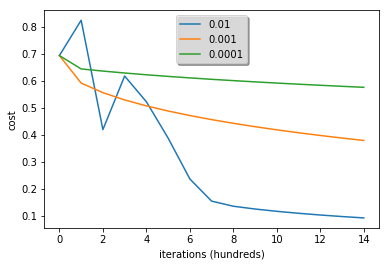

In [28]:
learning_rates = [0.01, 0.001, 0.0001]
models = {}
for i in learning_rates:
    print ("learning rate is: " + str(i))
    models[str(i)] = model(train_set_x, train_set_y, test_set_x, test_set_y, num_iterations = 1500, learning_rate = i, print_cost = False)
    print ('\n' + "-------------------------------------------------------" + '\n')

for i in learning_rates:
    plt.plot(np.squeeze(models[str(i)]["costs"]), label= str(models[str(i)]["learning_rate"]))

plt.ylabel('cost')
plt.xlabel('iterations (hundreds)')

legend = plt.legend(loc='upper center', shadow=True)
frame = legend.get_frame()
frame.set_facecolor('0.90')
plt.show()

**Interpretation**: 
- Different learning rates give different costs and thus different predictions results.
- If the learning rate is too large (0.01), the cost may oscillate up and down. It may even diverge (though in this example, using 0.01 still eventually ends up at a good value for the cost). 
- A lower cost doesn't mean a better model. You have to check if there is possibly overfitting. It happens when the training accuracy is a lot higher than the test accuracy.
- In deep learning, we usually recommend that you: 
    - Choose the learning rate that better minimizes the cost function.
    - If your model overfits, use other techniques to reduce overfitting. (We'll talk about this in later videos.) 


## 7 - Test with your own image (optional/ungraded exercise) ##

Congratulations on finishing this assignment. You can use your own image and see the output of your model. To do that:
    1. Click on "File" in the upper bar of this notebook, then click "Open" to go on your Coursera Hub.
    2. Add your image to this Jupyter Notebook's directory, in the "images" folder
    3. Change your image's name in the following code
    4. Run the code and check if the algorithm is right (1 = cat, 0 = non-cat)!

y = 0.0, your algorithm predicts a "non-cat" picture.


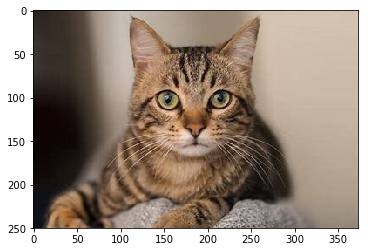

In [29]:
## START CODE HERE ## (PUT YOUR IMAGE NAME) 
my_image = "cat_1_image.jpg"   # change this to the name of your image file 
## END CODE HERE ##

# We preprocess the image to fit your algorithm.
fname = "images/" + my_image
image = np.array(ndimage.imread(fname, flatten=False))
image = image/255.
my_image = scipy.misc.imresize(image, size=(num_px,num_px)).reshape((1, num_px*num_px*3)).T
my_predicted_image = predict(d["w"], d["b"], my_image)

plt.imshow(image)
print("y = " + str(np.squeeze(my_predicted_image)) + ", your algorithm predicts a \"" + classes[int(np.squeeze(my_predicted_image)),].decode("utf-8") +  "\" picture.")

<font color='blue'>
**What to remember from this assignment:**
1. Preprocessing the dataset is important.
2. You implemented each function separately: initialize(), propagate(), optimize(). Then you built a model().
3. Tuning the learning rate (which is an example of a "hyperparameter") can make a big difference to the algorithm. You will see more examples of this later in this course!

Finally, if you'd like, we invite you to try different things on this Notebook. Make sure you submit before trying anything. Once you submit, things you can play with include:
    - Play with the learning rate and the number of iterations
    - Try different initialization methods and compare the results
    - Test other preprocessings (center the data, or divide each row by its standard deviation)

Bibliography:
- http://www.wildml.com/2015/09/implementing-a-neural-network-from-scratch/
- https://stats.stackexchange.com/questions/211436/why-do-we-normalize-images-by-subtracting-the-datasets-image-mean-and-not-the-c